In [1]:
import matplotlib.pyplot as plt
%matplotlib inline

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils as utils
import torchvision.transforms as transforms

from torch.autograd import Variable

import os
import time

from PIL.Image import BICUBIC
from torchvision.datasets import MNIST
from ram import RecurrentAttentionModel
from trainer import *

### MNIST dataset
Testing out this model and training algorithm implementation on the basic MNIST dataset, which is pretty simple so hopefully everything goes well.

In [2]:
num_train_data_copies = 1  # Number of times to load the training dataset (with augmentation)
num_eval_data_copies = 1   # Number of times to load the evaluation dataset (with augmentation)
test_val_split = 0.5       # Percentage of the test set to use as validation data
batch_size = 20            # Batch size for training
eval_batch_size = 20       # Batch size for validation and testing

# Image parameters
num_classes = 10       # Digits 0-9
image_size = 28        # MNIST images are 28x28 b/w images
in_channels = 1        # Number of color channels in the inputs (MNIST dataset is grayscale)

glimpse_sizes = [8]  #[5, 10, 18]
padding = int(np.ceil(glimpse_sizes[-1] / 2))
padded_img_size = image_size + 2*padding

In [3]:
# Down/load MNIST data
mnist_data_loc = os.path.join('data', 'mnist')
data_transforms = transforms.Compose([ # Keep things pretty basic for now
    # Pad images with 0s so the GlimpseSensor won't have to
    transforms.Pad(padding = padding),
    # Converts a PIL Image or numpy.ndarray (H x W x C) in the range [0, 255]
    # to a torch.FloatTensor of shape (C x H x W) in the range [0.0, 1.0]
    transforms.ToTensor(),
])

'''
Can increase the number of images in each dataset by loading up the data again,
applying the (random) transformations, then concatenating it all together
'''
### Training Dataset and DataLoader
all_train_datasets = [
    MNIST(
        root = mnist_data_loc, train = True,
        download = True, transform = data_transforms
    ) for _ in range(num_train_data_copies)
]
train_datasets = utils.data.ConcatDataset(all_train_datasets)
train_data = utils.data.DataLoader(train_datasets, batch_size = batch_size, shuffle = True)
num_train_data = len(train_datasets)
num_train_batches = len(train_data)

### Validation and Test Dataset and DataLoader
all_eval_datasets = [
    MNIST(
        root = mnist_data_loc, train = False,
        download = True, transform = data_transforms
    ) for _ in range(num_eval_data_copies)
]
eval_datasets = utils.data.ConcatDataset(all_eval_datasets)
num_eval_data = len(eval_datasets)

eval_split_pt = int(test_val_split * num_eval_data)
eval_idx = list(range(num_eval_data))
np.random.shuffle(eval_idx)

val_idx, test_idx = eval_idx[:eval_split_pt], eval_idx[eval_split_pt:]

val_sampler = utils.data.sampler.SubsetRandomSampler(val_idx)
val_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = val_sampler
)
num_val_data = len(val_sampler)
num_val_batches = len(val_data)

test_sampler = utils.data.sampler.SubsetRandomSampler(test_idx)
test_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = test_sampler
)
num_test_data = len(test_sampler)
num_test_batches = len(test_data)

print('Num:\n- train data: %d (%d batches)\n- val data: %d (%d batches)\n- test data: %d (%d batches)' % (
    num_train_data, num_train_batches, num_val_data, num_val_batches, num_test_data, num_test_batches
))

Num:
- train data: 60000 (3000 batches)
- val data: 5000 (250 batches)
- test data: 5000 (250 batches)


In [4]:
# Basic training hyperparameters
lr = 1e-3
grad_clip = 2
lr_step_size = 1
steps_per_epoch = int(num_train_data_copies * 15)  # Number of times to step the lr scheduler in an epoch
decay_rate = 0.999

# RL training hyperparameters
end_train_ep_early = False     # End each training episode early after a correct classification
assert (end_train_ep_early and batch_size == 1) or not end_train_ep_early
max_ep_len = 6                 # Maximum number of glimpses per episode
num_epochs = 400               # Number of times to go through all of the training examples
early_stopping = int(num_epochs * 0.02)

random_start_loc = True
error_penalty = -0.1  # Amount of penalty to apply each time the agent makes an incorrect classification (<= 0.)
gamma = 0.5           # Reward discount factor

# Etc
log_freq = num_train_batches // 10    # How often to print a training log in an epoch
viz_freq = num_train_batches // 5     # How often to visualize the glimpses in an epoch
eval_viz_freq = num_val_batches // 2  # How often to visualize the glimpses in an epoch

### Model
Need to modify class implementation so that any recurrent `nn.Module` instance can be passed in when initializing a new `RecurrentAttentionModel` to make it easier to try this visual attention mechanism out with different core recurrent networks.

In [5]:
# Model hyperparameters
glimpse_g_size = 128    # Size of the transformed Glimpse representation in the GlimpseNetwork
loc_g_size = 128        # Size of the transformed location representation in the GlimpseNetwork
glimpse_net_size = 256  # Size of the GlimpseNetwork output
rnn_state_size = 256
sensor_size = 8         # Size of the glimpses after resizing
g_rep_op = 'mul'

dropout = 0.0
# Standard deviation to use when sampling the glimpse location coordinates from a normal distribution
loc_std = 0.22

In [6]:
# Initialize the network
model = RecurrentAttentionModel(
    image_size = image_size, in_channels = in_channels,
    glimpse_g_size = glimpse_g_size, loc_g_size = loc_g_size,
    glimpse_net_size = glimpse_net_size, g_rep_op = g_rep_op,
    rnn_state_size = rnn_state_size, num_actions = num_classes,
    sensor_size = sensor_size, glimpse_sizes = glimpse_sizes,
    pad_imgs = False, padding = padding, dropout = dropout
)
num_parameters = sum([p.numel() for p in model.parameters()])
print('Model has %d parameters' % num_parameters)

# Criterion, optimizer, learning rate scheduler
class_criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr = lr)
lr_scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma = decay_rate)

Model has 547085 parameters


Epoch   1/400) lr = 0.001
 b    300/  3000 >> 156.0 ms/b | lr: 9.99e-04 | grad 2norm:  6.20 | grad inf norm:  4.036
         Weights || abs max:  0.36 ( 2809.49) | mean: -4.62e-04 ( 0.02) | var: 2.06e-03 (   89.38)
          Biases || abs max:  0.10 ( 3908.09) | mean:  1.36e-02 ( 3.09) | var: 5.14e-04 (453824.75)
                    class loss: 1.970 | steps: 4.521 | reward:  0.924 | acc.: 28.82%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.9 ms/b | lr: 9.98e-04 | grad 2norm:  9.07 | grad inf norm:  4.043
         Weights || abs max:  0.46 ( 9649.41) | mean: -1.15e-03 ( 0.04) | var: 4.27e-03 (15040.64)
          Biases || abs max:  0.25 ( 1060.03) | mean:  1.99e-02 ( 1.24) | var: 1.09e-03 (13123.51)
                    class loss: 1.618 | steps: 4.111 | reward:  1.601 | acc.: 43.67%

	Target class: 0 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]
	                | Baseline rewards:   [

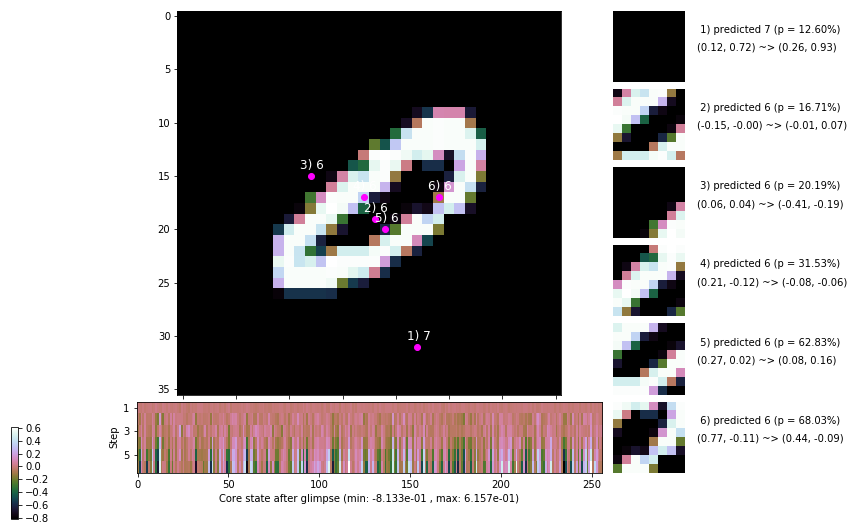

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 157.4 ms/b | lr: 9.96e-04 | grad 2norm: 10.75 | grad inf norm:  3.939
         Weights || abs max:  0.57 ( 7327.97) | mean: -9.07e-04 ( 0.03) | var: 5.75e-03 ( 3691.65)
          Biases || abs max:  0.35 (  620.28) | mean:  2.09e-02 ( 0.89) | var: 1.47e-03 (13614.05)
                    class loss: 1.445 | steps: 3.781 | reward:  2.002 | acc.: 50.28%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 187.8 ms/b | lr: 9.95e-04 | grad 2norm: 11.69 | grad inf norm:  3.896
         Weights || abs max:  0.61 (15039.98) | mean: -6.19e-04 ( 0.05) | var: 6.69e-03 (20776.52)
          Biases || abs max:  0.43 ( 5973.24) | mean:  2.06e-02 ( 4.82) | var: 1.83e-03 (6359319.00)
                    class loss: 1.325 | steps: 3.683 | reward:  2.132 | acc.: 53.12%

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1

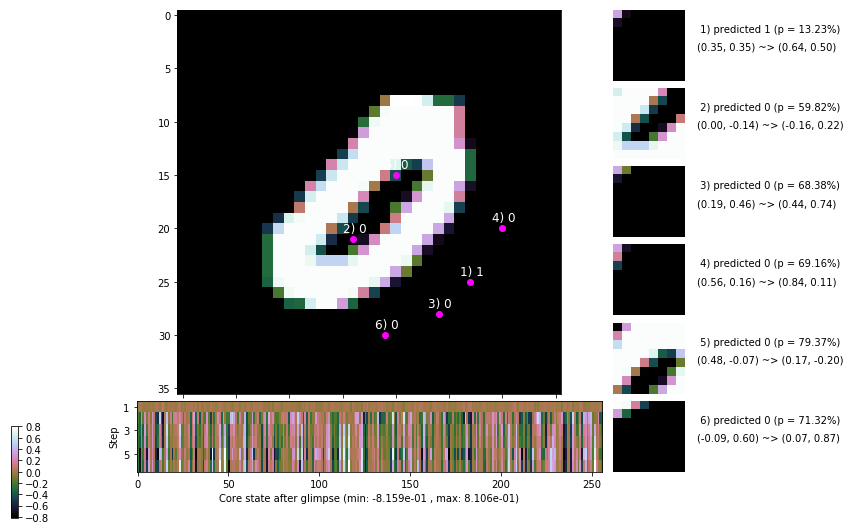

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 171.9 ms/b | lr: 9.93e-04 | grad 2norm: 12.25 | grad inf norm:  3.851
         Weights || abs max:  0.65 ( 4888.70) | mean: -5.88e-04 ( 0.03) | var: 7.47e-03 (  696.19)
          Biases || abs max:  0.50 (  489.89) | mean:  2.05e-02 ( 0.59) | var: 2.17e-03 ( 3908.95)
                    class loss: 1.205 | steps: 3.540 | reward:  2.362 | acc.: 57.72%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 175.6 ms/b | lr: 9.92e-04 | grad 2norm: 12.44 | grad inf norm:  3.731
         Weights || abs max:  0.70 ( 5976.13) | mean: -5.89e-04 ( 0.03) | var: 8.23e-03 ( 2228.17)
          Biases || abs max:  0.56 ( 1226.36) | mean:  1.98e-02 ( 0.93) | var: 2.53e-03 (39358.19)
                    class loss: 1.146 | steps: 3.445 | reward:  2.503 | acc.: 60.18%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

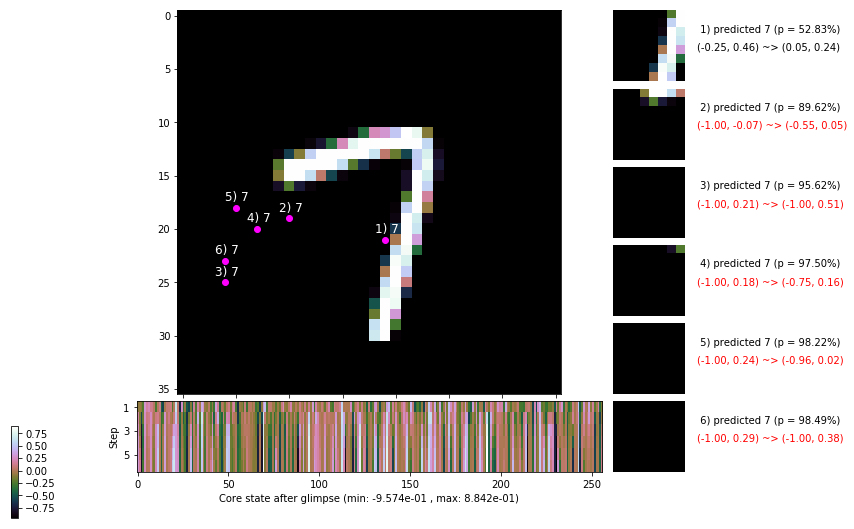

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 167.6 ms/b | lr: 9.90e-04 | grad 2norm: 13.01 | grad inf norm:  3.822
         Weights || abs max:  0.71 ( 5204.65) | mean: -5.76e-04 ( 0.03) | var: 8.93e-03 (  441.14)
          Biases || abs max:  0.59 (  400.29) | mean:  1.78e-02 ( 0.53) | var: 2.88e-03 (  719.78)
                    class loss: 1.159 | steps: 3.426 | reward:  2.513 | acc.: 60.00%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.8 ms/b | lr: 9.89e-04 | grad 2norm: 13.61 | grad inf norm:  3.866
         Weights || abs max:  0.75 ( 3980.95) | mean: -4.97e-04 ( 0.02) | var: 9.52e-03 (  227.50)
          Biases || abs max:  0.62 (  800.21) | mean:  1.56e-02 ( 0.75) | var: 3.22e-03 ( 6621.10)
                    class loss: 1.115 | steps: 3.330 | reward:  2.621 | acc.: 61.38%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

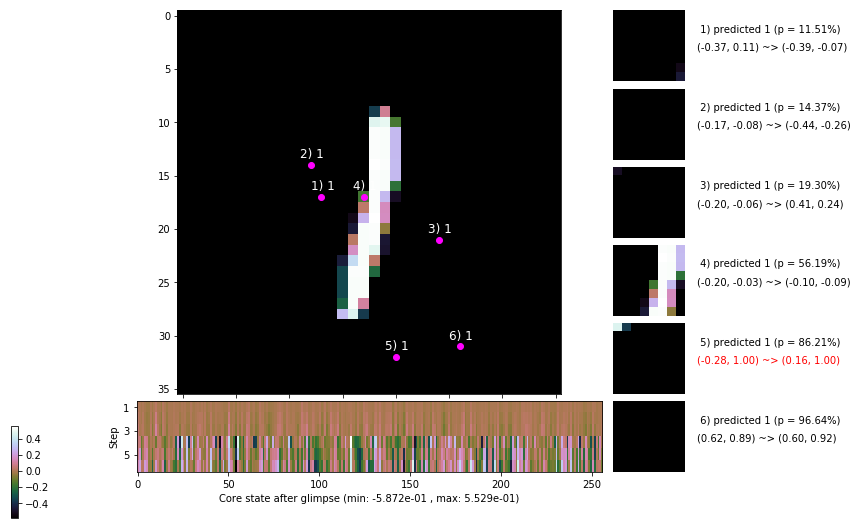

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.1 ms/b | lr: 9.87e-04 | grad 2norm: 13.51 | grad inf norm:  3.906
         Weights || abs max:  0.77 ( 6404.75) | mean: -4.25e-04 ( 0.03) | var: 1.00e-02 ( 1098.51)
          Biases || abs max:  0.65 ( 1553.56) | mean:  1.40e-02 ( 1.41) | var: 3.56e-03 (281290.00)
                    class loss: 1.070 | steps: 3.286 | reward:  2.728 | acc.: 62.85%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 159.2 ms/b | lr: 9.86e-04 | grad 2norm: 13.57 | grad inf norm:  3.807
         Weights || abs max:  0.82 ( 4782.90) | mean: -4.53e-04 ( 0.03) | var: 1.05e-02 (  824.16)
          Biases || abs max:  0.67 (  420.62) | mean:  1.21e-02 ( 0.53) | var: 3.93e-03 ( 1983.84)
                    class loss: 1.043 | steps: 3.236 | reward:  2.811 | acc.: 63.88%

	Target class: 9 | Discounted rewards: [-0.197, -0.194, 

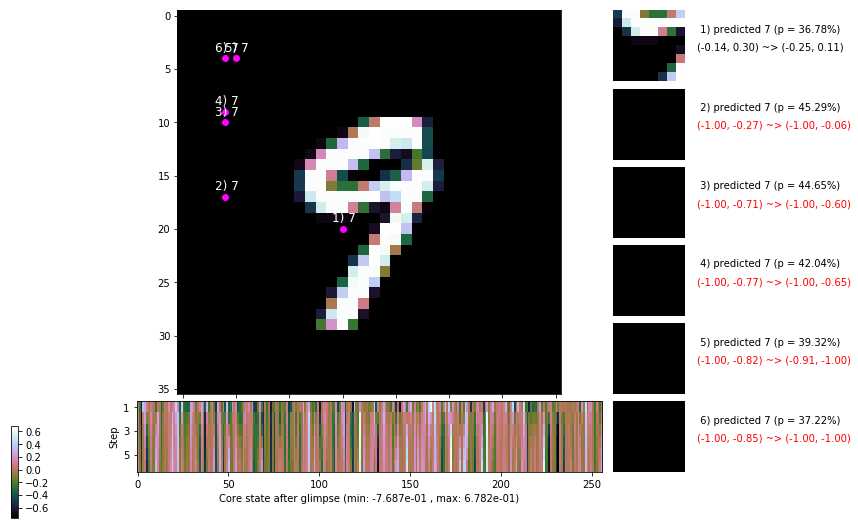

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


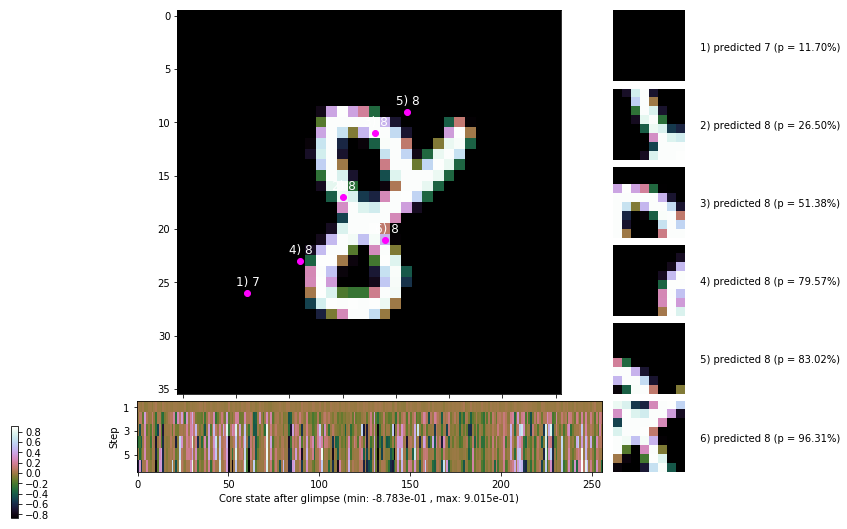


	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


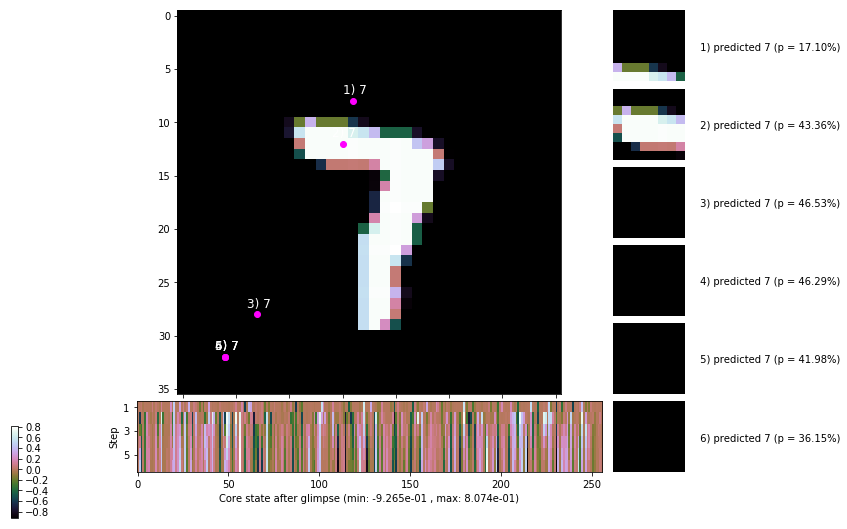

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


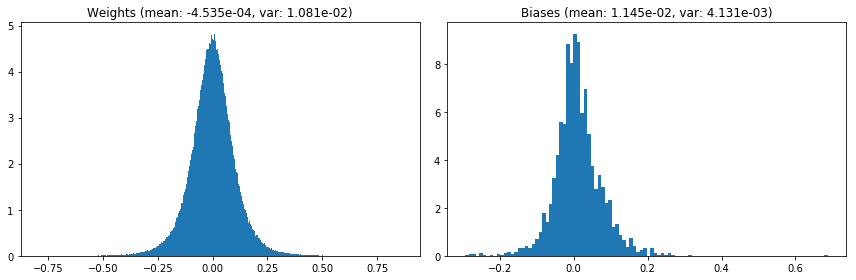

                                      Location network weights and biases


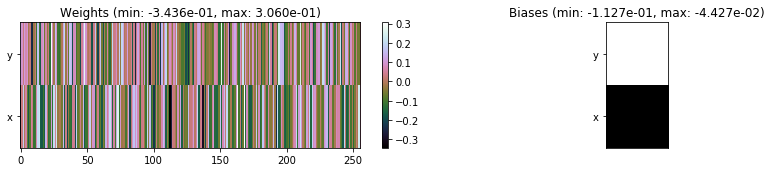

---------------------------------------------------------------------------------------------------------------
Elapsed time:  491.77 sec | TRAIN >> class loss: 1.3097 | steps:  3.636    | reward:  2.2198    | acc.: 54.190% 
                          | VAL   >> class loss: 1.0169 | steps:  3.140    | reward:  2.9297    | acc.: 65.120% 


Epoch   2/400) lr = 0.0009851
 b    300/  3000 >> 152.5 ms/b | lr: 9.84e-04 | grad 2norm: 13.59 | grad inf norm:  3.817
         Weights || abs max:  0.87 ( 5098.53) | mean: -4.61e-04 ( 0.03) | var: 1.11e-02 ( 1401.26)
          Biases || abs max:  0.70 (  329.32) | mean:  1.05e-02 ( 0.46) | var: 4.35e-03 (  786.34)
                    class loss: 1.007 | steps: 3.197 | reward:  2.870 | acc.: 65.13%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 154.6 ms/b | lr: 9.83e-04 | grad 2norm: 13.78 | grad inf norm:  3.828
         Weights || abs max:  0.90 ( 4094.89) | mean: -4.84e-04 ( 0.0

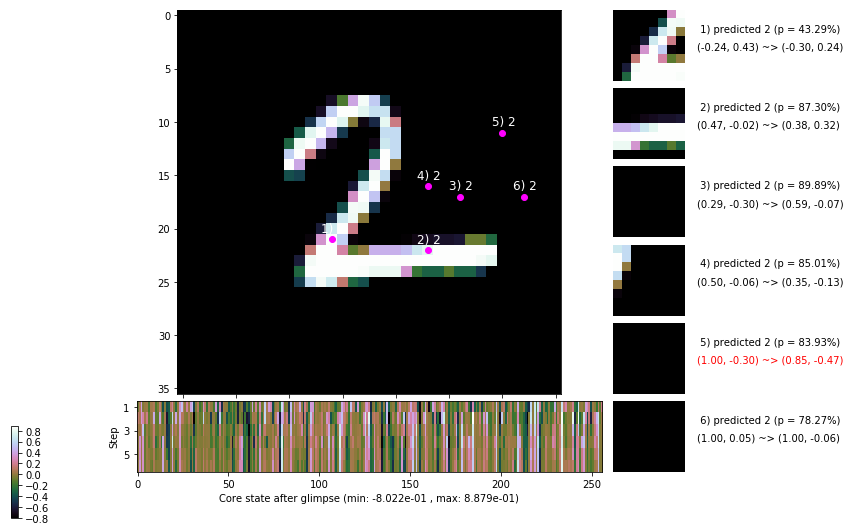

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.1 ms/b | lr: 9.81e-04 | grad 2norm: 13.68 | grad inf norm:  3.816
         Weights || abs max:  0.91 ( 4815.39) | mean: -5.53e-04 ( 0.03) | var: 1.20e-02 (  752.72)
          Biases || abs max:  0.75 (  681.04) | mean:  5.89e-03 ( 0.72) | var: 5.10e-03 (16660.66)
                    class loss: 0.983 | steps: 3.137 | reward:  2.944 | acc.: 66.22%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 149.2 ms/b | lr: 9.80e-04 | grad 2norm: 13.80 | grad inf norm:  3.759
         Weights || abs max:  0.92 ( 5144.65) | mean: -5.39e-04 ( 0.03) | var: 1.24e-02 (  817.58)
          Biases || abs max:  0.76 (  988.45) | mean:  4.04e-03 ( 0.90) | var: 5.54e-03 (33498.07)
                    class loss: 0.937 | steps: 3.097 | reward:  3.043 | acc.: 68.23%

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.8

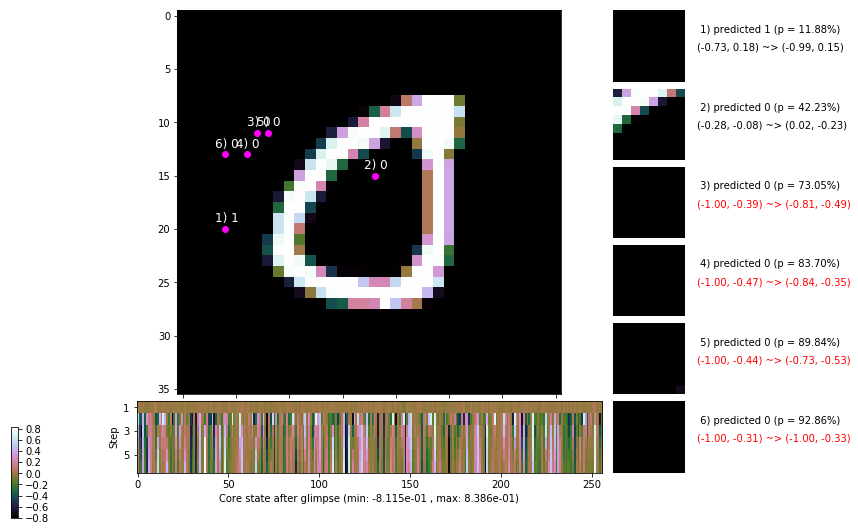

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 152.9 ms/b | lr: 9.78e-04 | grad 2norm: 13.83 | grad inf norm:  3.841
         Weights || abs max:  0.94 ( 4115.26) | mean: -5.38e-04 ( 0.02) | var: 1.29e-02 (  414.19)
          Biases || abs max:  0.78 (  214.67) | mean:  1.82e-03 ( 0.33) | var: 5.93e-03 (  172.40)
                    class loss: 0.927 | steps: 3.063 | reward:  3.056 | acc.: 68.05%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 149.8 ms/b | lr: 9.77e-04 | grad 2norm: 14.07 | grad inf norm:  3.755
         Weights || abs max:  0.96 ( 4466.88) | mean: -5.90e-04 ( 0.02) | var: 1.33e-02 (  867.72)
          Biases || abs max:  0.80 (  266.65) | mean:  3.07e-04 ( 0.37) | var: 6.30e-03 ( 1720.81)
                    class loss: 0.894 | steps: 3.004 | reward:  3.121 | acc.: 69.13%

	Target class: 6 | Discounted rewards: [-0.197, -0.194, -

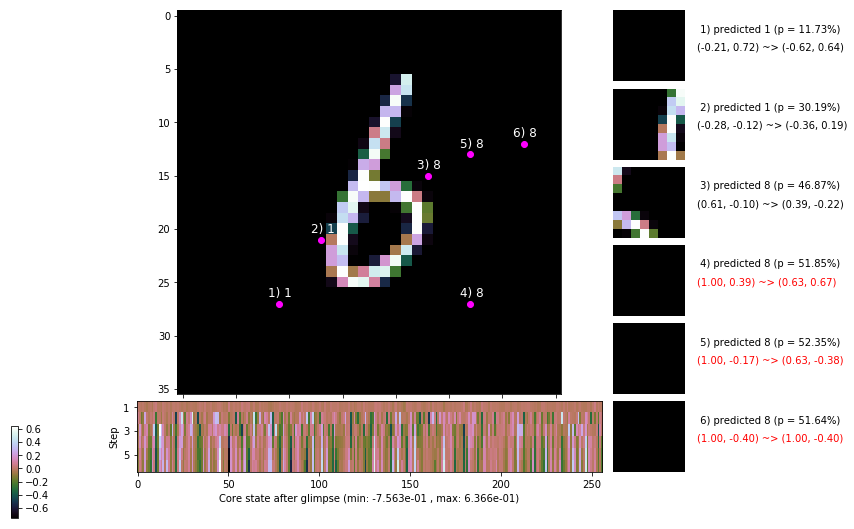

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 152.8 ms/b | lr: 9.75e-04 | grad 2norm: 14.07 | grad inf norm:  3.970
         Weights || abs max:  0.97 (12792.60) | mean: -6.25e-04 ( 0.04) | var: 1.37e-02 (20704.31)
          Biases || abs max:  0.81 (  240.31) | mean: -1.96e-03 ( 0.31) | var: 6.68e-03 (  551.72)
                    class loss: 0.903 | steps: 3.073 | reward:  3.067 | acc.: 68.80%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 149.1 ms/b | lr: 9.74e-04 | grad 2norm: 14.03 | grad inf norm:  3.826
         Weights || abs max:  0.98 ( 3045.25) | mean: -5.90e-04 ( 0.02) | var: 1.41e-02 (  161.79)
          Biases || abs max:  0.82 (  198.77) | mean: -4.03e-03 ( 0.28) | var: 7.00e-03 (  102.79)
                    class loss: 0.882 | steps: 3.016 | reward:  3.102 | acc.: 69.47%

	Target class: 1 | Discounted rewards: [0.869, 1.938, 1.8

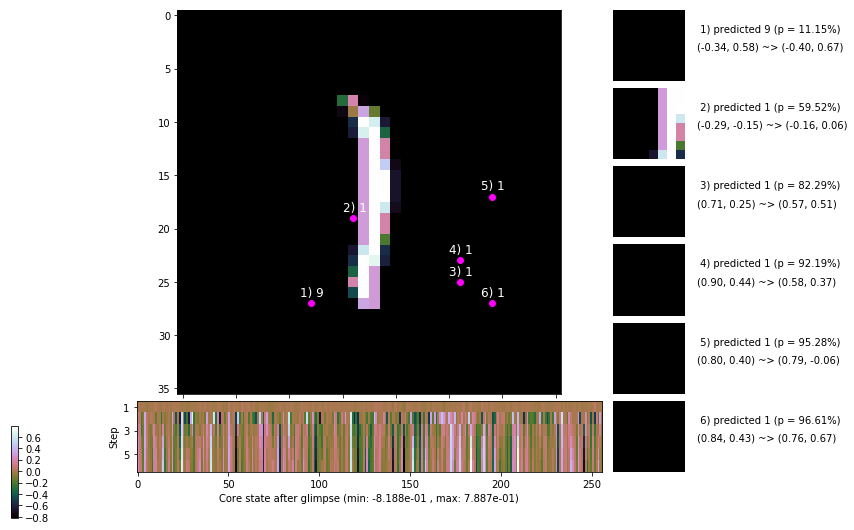

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 152.1 ms/b | lr: 9.72e-04 | grad 2norm: 13.91 | grad inf norm:  3.900
         Weights || abs max:  0.99 ( 3126.14) | mean: -5.75e-04 ( 0.02) | var: 1.45e-02 (  131.28)
          Biases || abs max:  0.83 (  438.09) | mean: -5.12e-03 ( 0.47) | var: 7.42e-03 ( 4166.86)
                    class loss: 0.903 | steps: 3.021 | reward:  3.109 | acc.: 69.05%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 150.1 ms/b | lr: 9.71e-04 | grad 2norm: 13.76 | grad inf norm:  3.739
         Weights || abs max:  1.00 ( 4373.35) | mean: -5.41e-04 ( 0.02) | var: 1.49e-02 (  428.83)
          Biases || abs max:  0.83 (  376.15) | mean: -6.91e-03 ( 0.38) | var: 7.88e-03 ( 1288.66)
                    class loss: 0.873 | steps: 2.970 | reward:  3.159 | acc.: 70.22%

	Target class: 1 | Discounted rewards: [0.869, 1.938, 1.8

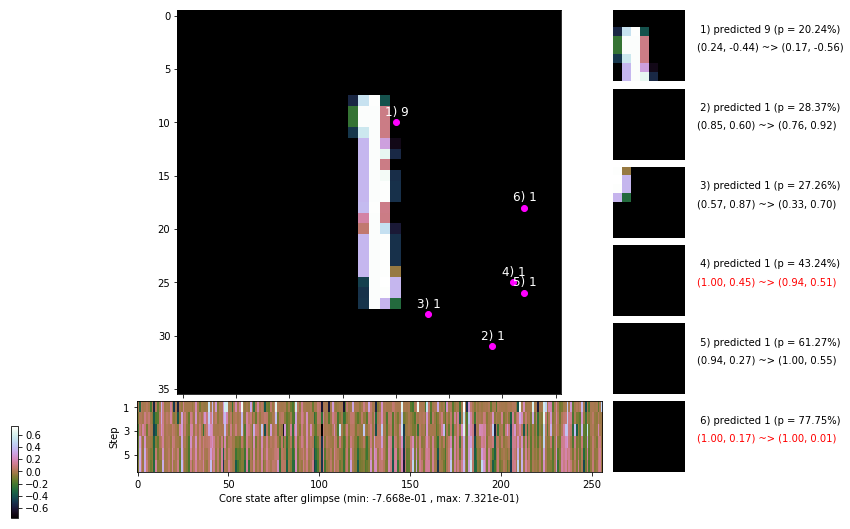

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


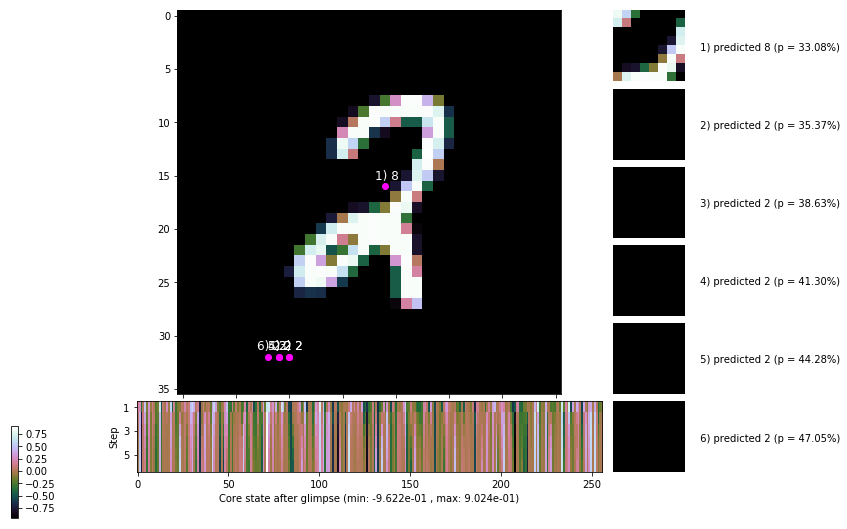


	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


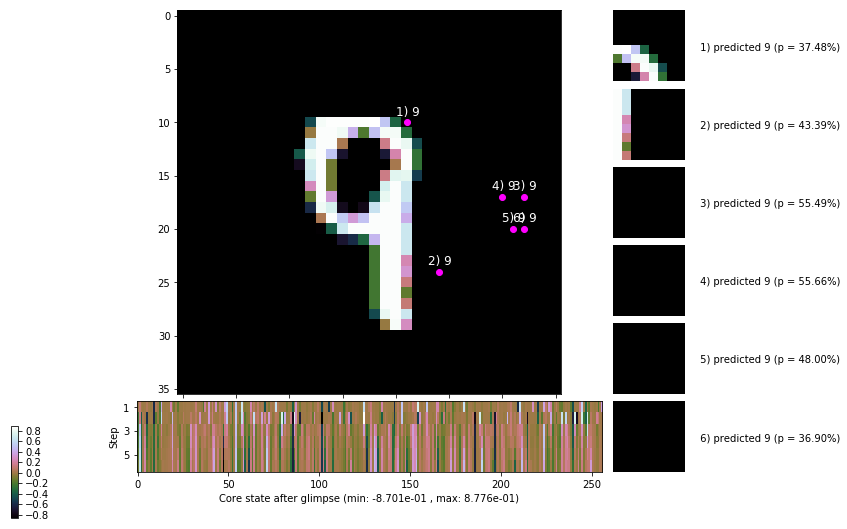

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


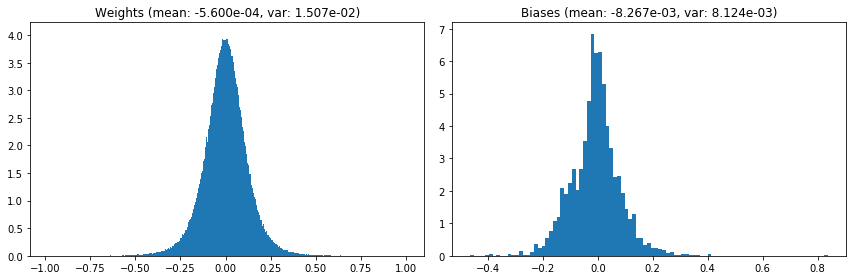

                                      Location network weights and biases


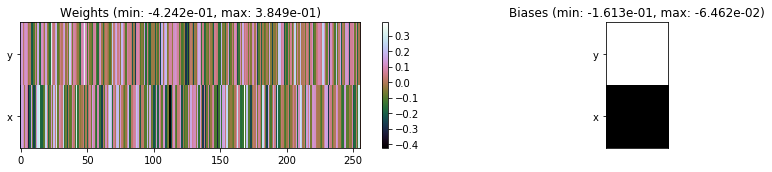

---------------------------------------------------------------------------------------------------------------
Elapsed time:  455.52 sec | TRAIN >> class loss: 0.9285 | steps:  3.072    | reward:  3.0396    | acc.: 67.988% 
                          | VAL   >> class loss: 0.8942 | steps:  2.920    | reward:  3.2135    | acc.: 69.760% 


Epoch   3/400) lr = 0.0009704
 b    300/  3000 >> 146.0 ms/b | lr: 9.69e-04 | grad 2norm: 14.07 | grad inf norm:  3.749
         Weights || abs max:  1.01 (24125.30) | mean: -5.72e-04 ( 0.06) | var: 1.53e-02 (177449.59)
          Biases || abs max:  0.84 (  261.19) | mean: -9.16e-03 ( 0.32) | var: 8.35e-03 (  658.83)
                    class loss: 0.864 | steps: 2.984 | reward:  3.156 | acc.: 70.08%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.8 ms/b | lr: 9.68e-04 | grad 2norm: 13.97 | grad inf norm:  3.789
         Weights || abs max:  1.03 ( 7827.11) | mean: -6.13e-04 ( 0.

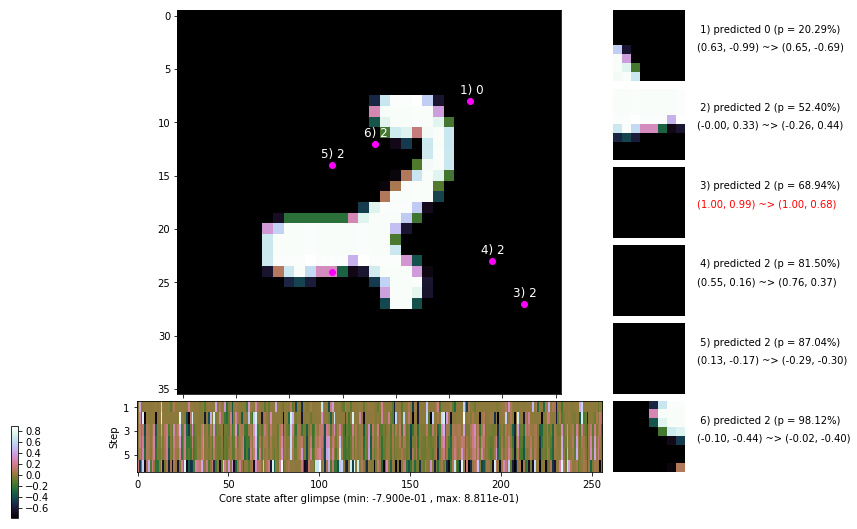

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.1 ms/b | lr: 9.67e-04 | grad 2norm: 13.84 | grad inf norm:  3.621
         Weights || abs max:  1.02 ( 4970.38) | mean: -6.25e-04 ( 0.02) | var: 1.60e-02 (  499.89)
          Biases || abs max:  0.85 ( 2639.95) | mean: -1.24e-02 ( 1.22) | var: 9.09e-03 (667549.00)
                    class loss: 0.824 | steps: 2.942 | reward:  3.227 | acc.: 71.37%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 147.7 ms/b | lr: 9.66e-04 | grad 2norm: 14.00 | grad inf norm:  3.799
         Weights || abs max:  1.03 ( 6542.51) | mean: -6.09e-04 ( 0.03) | var: 1.64e-02 ( 3299.25)
          Biases || abs max:  0.86 (  123.94) | mean: -1.44e-02 ( 0.20) | var: 9.57e-03 (   55.05)
                    class loss: 0.825 | steps: 2.903 | reward:  3.279 | acc.: 72.30%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.

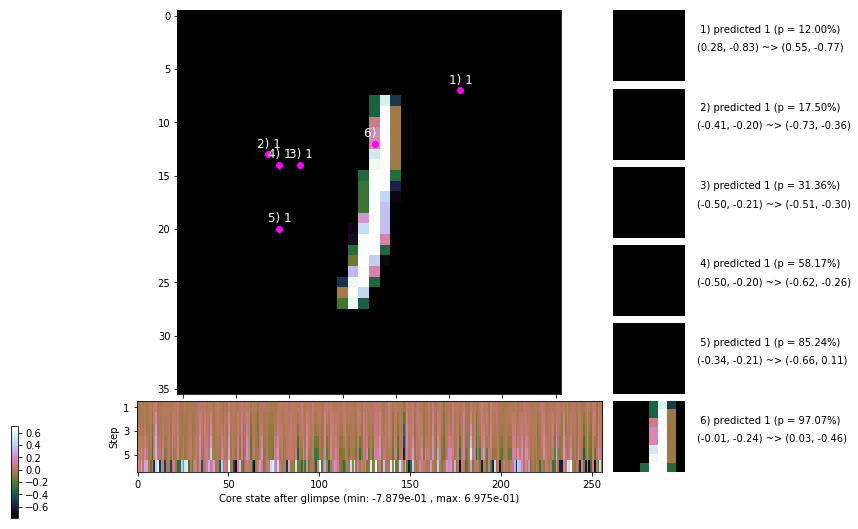

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 150.8 ms/b | lr: 9.64e-04 | grad 2norm: 13.84 | grad inf norm:  3.731
         Weights || abs max:  1.05 ( 5517.61) | mean: -6.19e-04 ( 0.02) | var: 1.67e-02 ( 1571.48)
          Biases || abs max:  0.86 (  205.60) | mean: -1.64e-02 ( 0.25) | var: 9.95e-03 (  117.95)
                    class loss: 0.825 | steps: 2.924 | reward:  3.253 | acc.: 72.03%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 147.5 ms/b | lr: 9.63e-04 | grad 2norm: 14.24 | grad inf norm:  3.731
         Weights || abs max:  1.05 ( 5389.98) | mean: -6.28e-04 ( 0.02) | var: 1.71e-02 ( 2920.89)
          Biases || abs max:  0.87 (  316.55) | mean: -1.73e-02 ( 0.30) | var: 1.03e-02 ( 1018.64)
                    class loss: 0.815 | steps: 2.902 | reward:  3.224 | acc.: 71.65%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

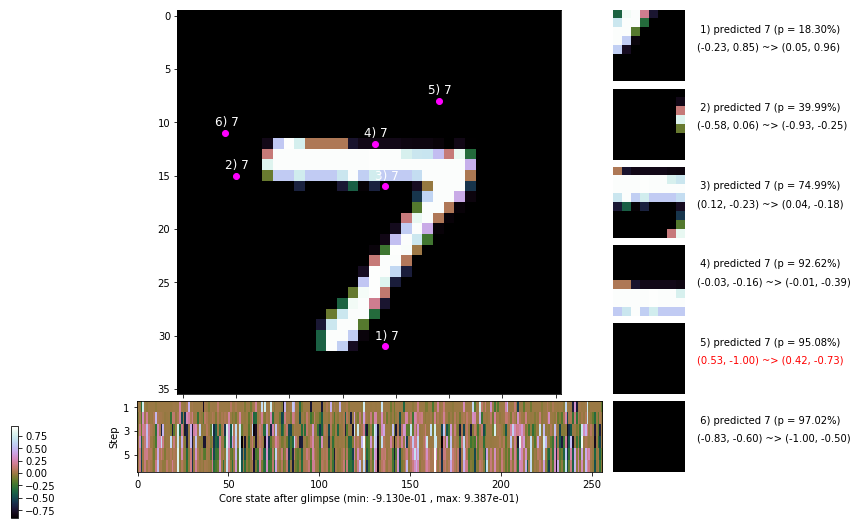

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 150.8 ms/b | lr: 9.61e-04 | grad 2norm: 13.94 | grad inf norm:  3.707
         Weights || abs max:  1.07 ( 4323.16) | mean: -6.33e-04 ( 0.02) | var: 1.74e-02 (  592.45)
          Biases || abs max:  0.87 (  282.44) | mean: -1.92e-02 ( 0.28) | var: 1.07e-02 (  454.25)
                    class loss: 0.799 | steps: 2.876 | reward:  3.263 | acc.: 72.30%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 149.4 ms/b | lr: 9.60e-04 | grad 2norm: 13.95 | grad inf norm:  3.731
         Weights || abs max:  1.09 ( 3917.10) | mean: -5.92e-04 ( 0.02) | var: 1.77e-02 (  521.35)
          Biases || abs max:  0.88 (  342.22) | mean: -2.12e-02 ( 0.36) | var: 1.12e-02 ( 5551.13)
                    class loss: 0.804 | steps: 2.894 | reward:  3.268 | acc.: 72.52%

	Target class: 5 | Discounted rewards: [1.453, 0.906, -0.

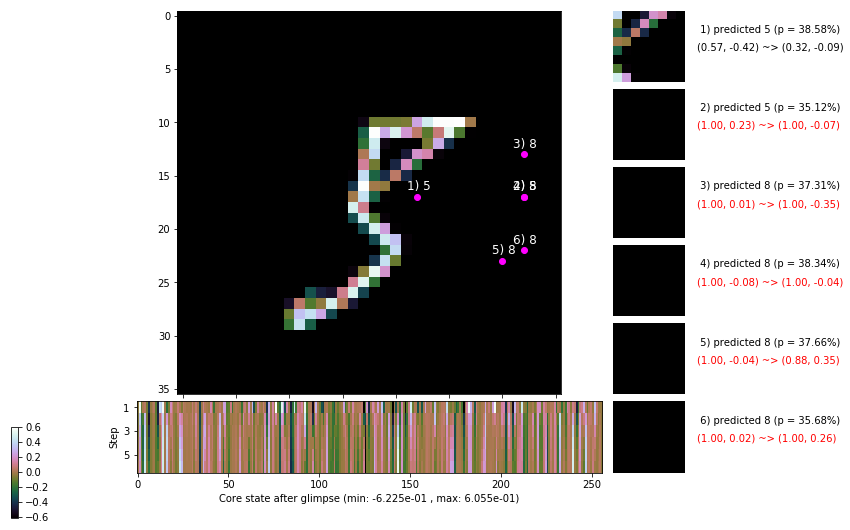

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 152.8 ms/b | lr: 9.58e-04 | grad 2norm: 14.20 | grad inf norm:  3.759
         Weights || abs max:  1.09 ( 4109.69) | mean: -5.77e-04 ( 0.02) | var: 1.81e-02 (  287.40)
          Biases || abs max:  0.88 (  430.85) | mean: -2.22e-02 ( 0.40) | var: 1.17e-02 ( 3701.45)
                    class loss: 0.801 | steps: 2.852 | reward:  3.303 | acc.: 72.13%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.5 ms/b | lr: 9.57e-04 | grad 2norm: 14.14 | grad inf norm:  3.779
         Weights || abs max:  1.11 ( 8395.27) | mean: -5.37e-04 ( 0.03) | var: 1.84e-02 ( 3792.35)
          Biases || abs max:  0.89 (  267.67) | mean: -2.27e-02 ( 0.29) | var: 1.21e-02 (  691.36)
                    class loss: 0.776 | steps: 2.824 | reward:  3.400 | acc.: 73.50%

	Target class: 3 | Discounted rewards: [0.869, 1.938, 1.8

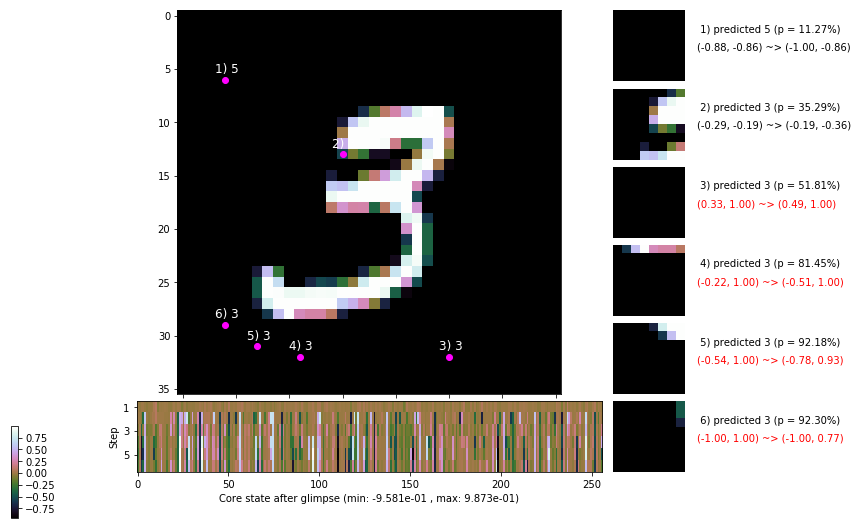

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


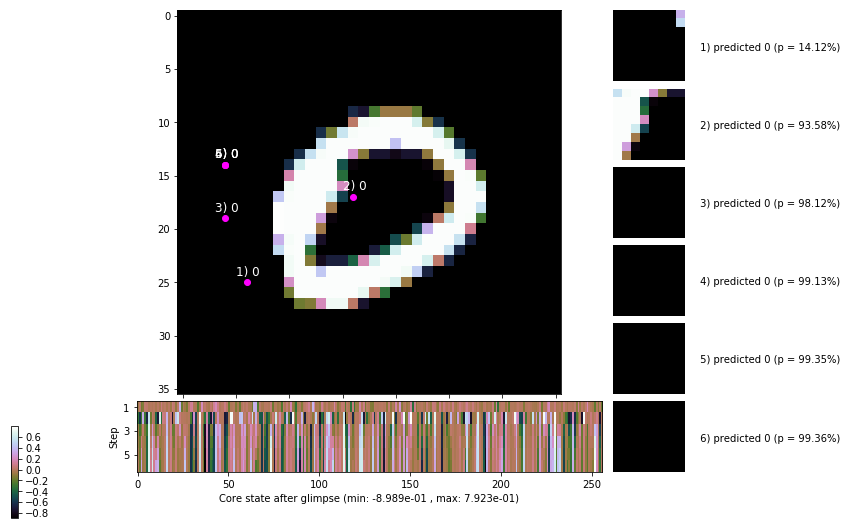


	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


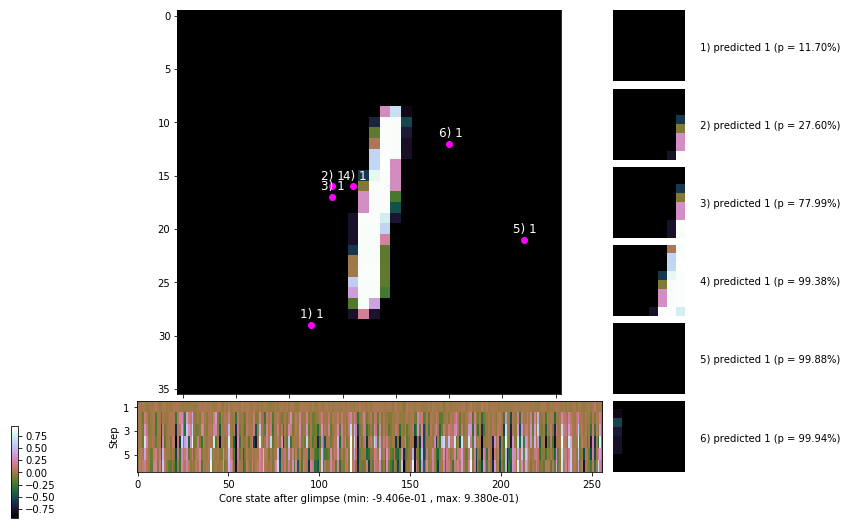

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


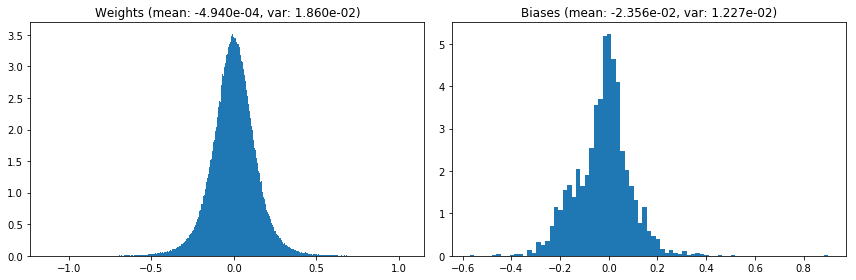

                                      Location network weights and biases


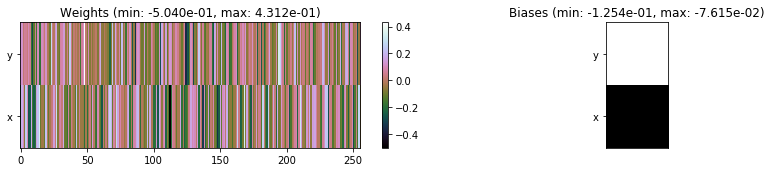

---------------------------------------------------------------------------------------------------------------
Elapsed time:  450.42 sec | TRAIN >> class loss: 0.8206 | steps:  2.909    | reward:  3.2522    | acc.: 71.753% 
                          | VAL   >> class loss: 0.7844 | steps:  2.749    | reward:  3.4381    | acc.: 72.820% 


Epoch   4/400) lr = 0.000956
 b    300/  3000 >> 148.4 ms/b | lr: 9.55e-04 | grad 2norm: 14.25 | grad inf norm:  3.806
         Weights || abs max:  1.11 (29551.97) | mean: -5.30e-04 ( 0.07) | var: 1.87e-02 (293628.28)
          Biases || abs max:  0.90 (  209.02) | mean: -2.46e-02 ( 0.25) | var: 1.25e-02 (  377.25)
                    class loss: 0.778 | steps: 2.807 | reward:  3.410 | acc.: 73.33%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.3 ms/b | lr: 9.54e-04 | grad 2norm: 13.98 | grad inf norm:  3.718
         Weights || abs max:  1.11 ( 5665.24) | mean: -5.56e-04 ( 0.0

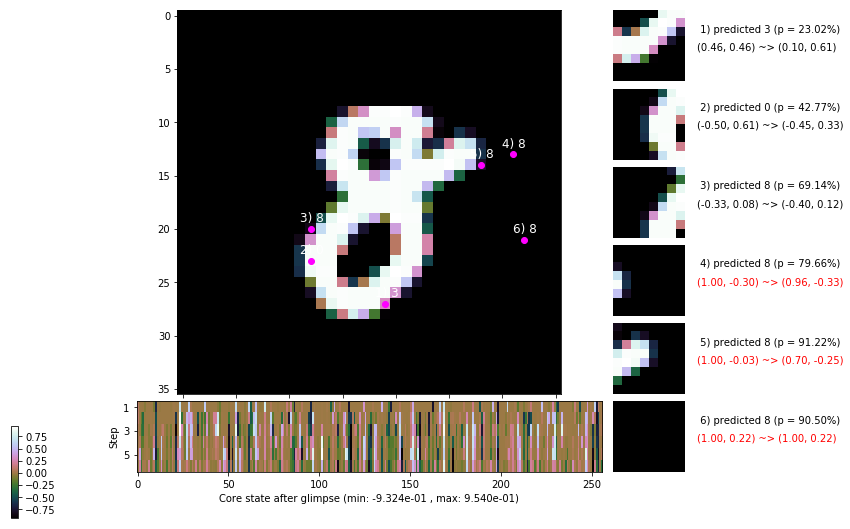

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 147.6 ms/b | lr: 9.52e-04 | grad 2norm: 14.09 | grad inf norm:  3.562
         Weights || abs max:  1.12 ( 5648.26) | mean: -5.94e-04 ( 0.02) | var: 1.94e-02 ( 1804.49)
          Biases || abs max:  0.90 (  276.44) | mean: -2.65e-02 ( 0.26) | var: 1.32e-02 (  919.59)
                    class loss: 0.763 | steps: 2.829 | reward:  3.371 | acc.: 74.03%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.6 ms/b | lr: 9.51e-04 | grad 2norm: 13.91 | grad inf norm:  3.509
         Weights || abs max:  1.12 ( 2706.91) | mean: -6.34e-04 ( 0.02) | var: 1.97e-02 (  146.48)
          Biases || abs max:  0.91 (  275.22) | mean: -2.77e-02 ( 0.27) | var: 1.36e-02 (  441.36)
                    class loss: 0.748 | steps: 2.791 | reward:  3.412 | acc.: 74.32%

	Target class: 6 | Discounted rewards: [0.869, 1.938, 1.8

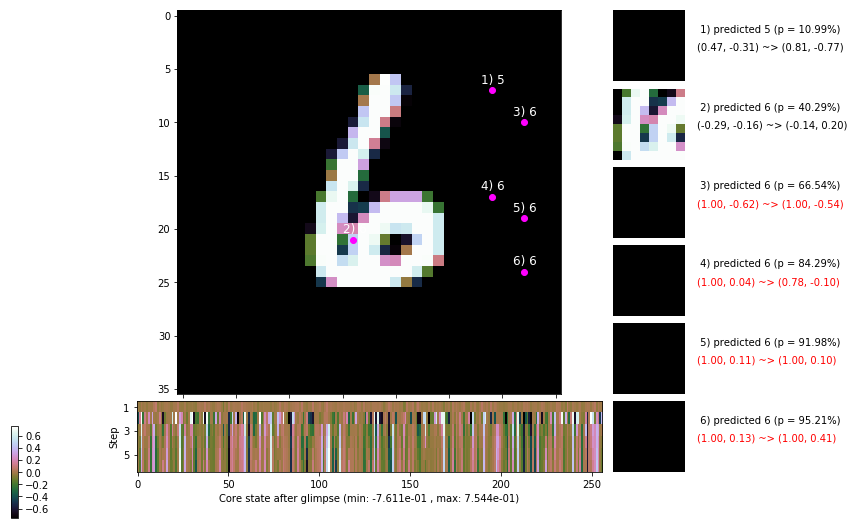

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 148.2 ms/b | lr: 9.49e-04 | grad 2norm: 14.10 | grad inf norm:  3.714
         Weights || abs max:  1.13 ( 8991.30) | mean: -6.01e-04 ( 0.03) | var: 2.01e-02 (16487.64)
          Biases || abs max:  0.91 (  389.26) | mean: -2.91e-02 ( 0.35) | var: 1.41e-02 ( 2737.06)
                    class loss: 0.782 | steps: 2.793 | reward:  3.410 | acc.: 73.48%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 143.9 ms/b | lr: 9.48e-04 | grad 2norm: 13.97 | grad inf norm:  3.647
         Weights || abs max:  1.12 ( 7333.81) | mean: -6.02e-04 ( 0.03) | var: 2.04e-02 ( 7422.29)
          Biases || abs max:  0.91 (  116.05) | mean: -3.12e-02 ( 0.18) | var: 1.45e-02 (   28.86)
                    class loss: 0.783 | steps: 2.830 | reward:  3.358 | acc.: 72.60%

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.8

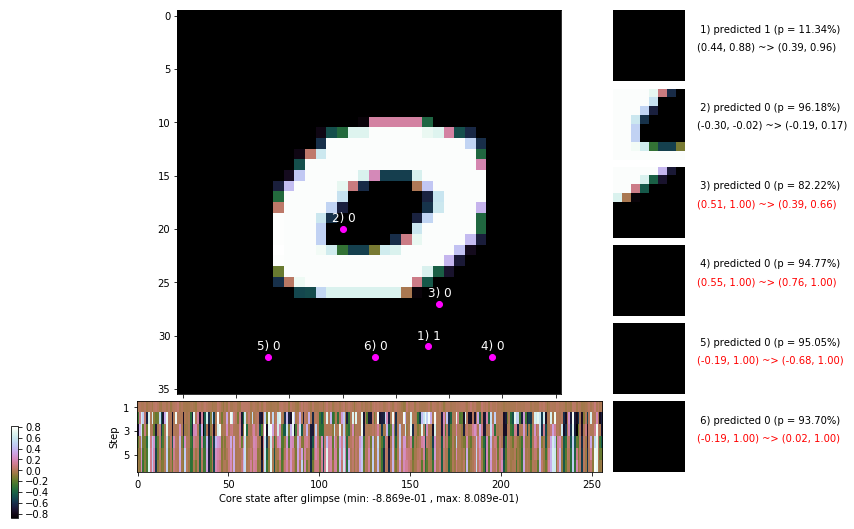

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 145.7 ms/b | lr: 9.46e-04 | grad 2norm: 14.00 | grad inf norm:  3.693
         Weights || abs max:  1.15 ( 6473.53) | mean: -6.06e-04 ( 0.02) | var: 2.07e-02 ( 3617.31)
          Biases || abs max:  0.91 ( 1032.95) | mean: -3.22e-02 ( 0.88) | var: 1.48e-02 (180288.33)
                    class loss: 0.734 | steps: 2.775 | reward:  3.438 | acc.: 74.32%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.8 ms/b | lr: 9.46e-04 | grad 2norm: 14.22 | grad inf norm:  3.695
         Weights || abs max:  1.15 ( 8860.60) | mean: -6.15e-04 ( 0.03) | var: 2.10e-02 (17865.59)
          Biases || abs max:  0.93 (  103.06) | mean: -3.30e-02 ( 0.14) | var: 1.51e-02 (   61.67)
                    class loss: 0.741 | steps: 2.766 | reward:  3.475 | acc.: 74.93%

	Target class: 2 | Discounted rewards: [-0.162, -0.125, 

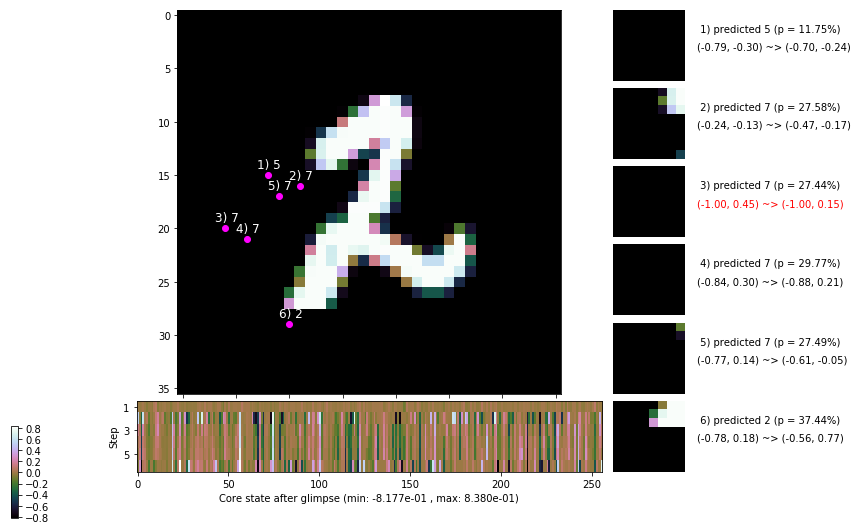

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 144.6 ms/b | lr: 9.44e-04 | grad 2norm: 14.29 | grad inf norm:  3.663
         Weights || abs max:  1.17 ( 8348.21) | mean: -6.30e-04 ( 0.03) | var: 2.12e-02 (17631.74)
          Biases || abs max:  0.92 (  162.32) | mean: -3.38e-02 ( 0.18) | var: 1.55e-02 (  215.83)
                    class loss: 0.728 | steps: 2.754 | reward:  3.499 | acc.: 75.10%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.5 ms/b | lr: 9.43e-04 | grad 2norm: 14.01 | grad inf norm:  3.553
         Weights || abs max:  1.19 (15480.65) | mean: -6.64e-04 ( 0.04) | var: 2.15e-02 (49556.98)
          Biases || abs max:  0.93 (  183.15) | mean: -3.48e-02 ( 0.19) | var: 1.59e-02 (  239.18)
                    class loss: 0.686 | steps: 2.725 | reward:  3.554 | acc.: 76.55%

	Target class: 5 | Discounted rewards: [0.869, 1.938, 1.8

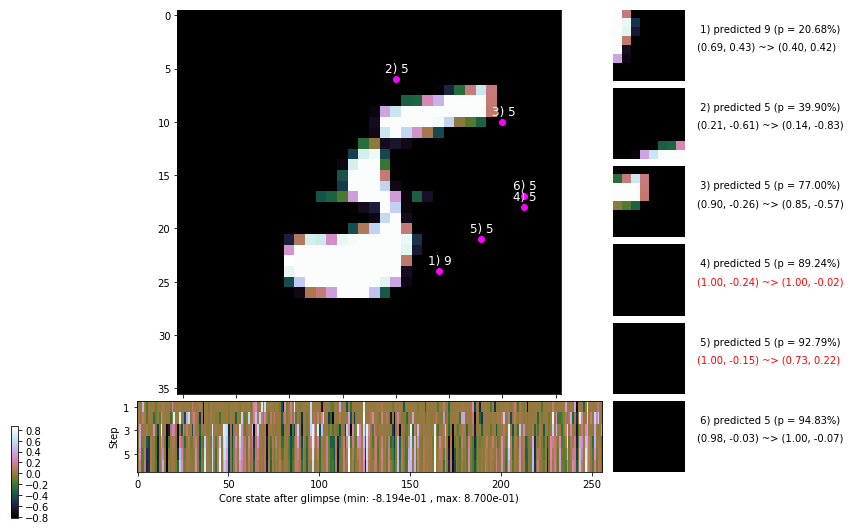

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


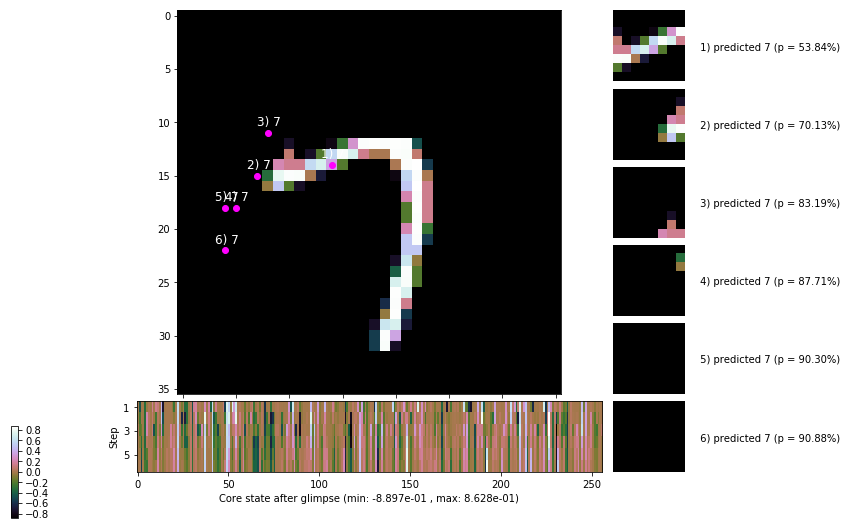


	Target class: 8 | Discounted rewards: [0.044, 0.287, 0.775, 1.750, 1.500, 1.000]


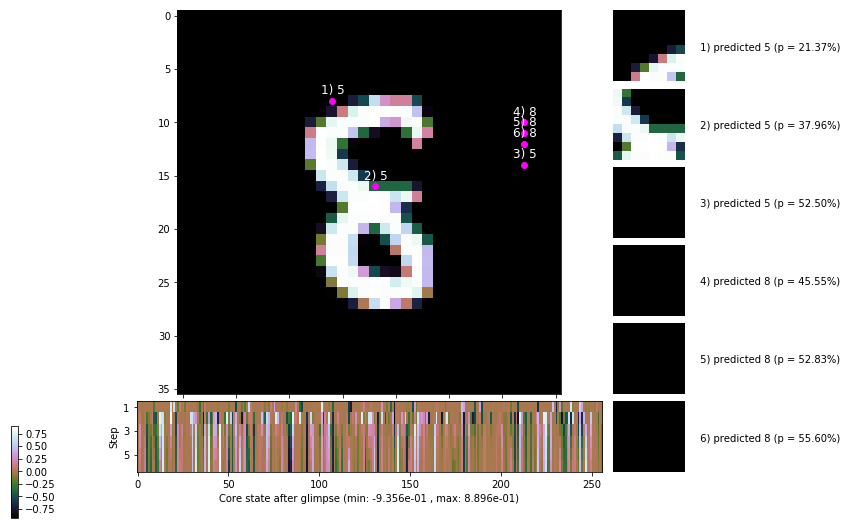

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


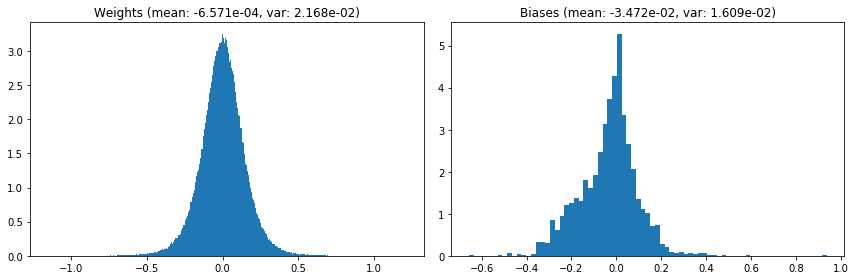

                                      Location network weights and biases


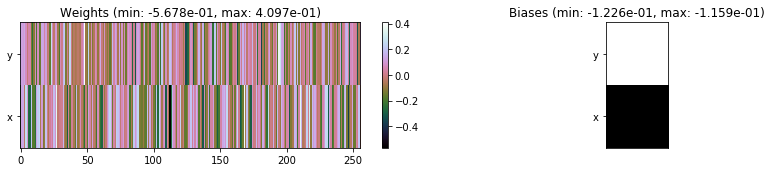

---------------------------------------------------------------------------------------------------------------
Elapsed time:  436.98 sec | TRAIN >> class loss: 0.7526 | steps:  2.787    | reward:  3.4332    | acc.: 74.263% 
                          | VAL   >> class loss: 0.6559 | steps:  2.629    | reward:  3.7153    | acc.: 77.960% 


Epoch   5/400) lr = 0.0009417
 b    300/  3000 >> 144.0 ms/b | lr: 9.41e-04 | grad 2norm: 13.96 | grad inf norm:  3.569
         Weights || abs max:  1.21 ( 5758.30) | mean: -6.42e-04 ( 0.02) | var: 2.18e-02 ( 2306.77)
          Biases || abs max:  0.94 (  214.86) | mean: -3.54e-02 ( 0.20) | var: 1.63e-02 (  551.21)
                    class loss: 0.705 | steps: 2.718 | reward:  3.565 | acc.: 76.22%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.3 ms/b | lr: 9.40e-04 | grad 2norm: 13.94 | grad inf norm:  3.696
         Weights || abs max:  1.25 ( 6534.49) | mean: -7.04e-04 ( 0.0

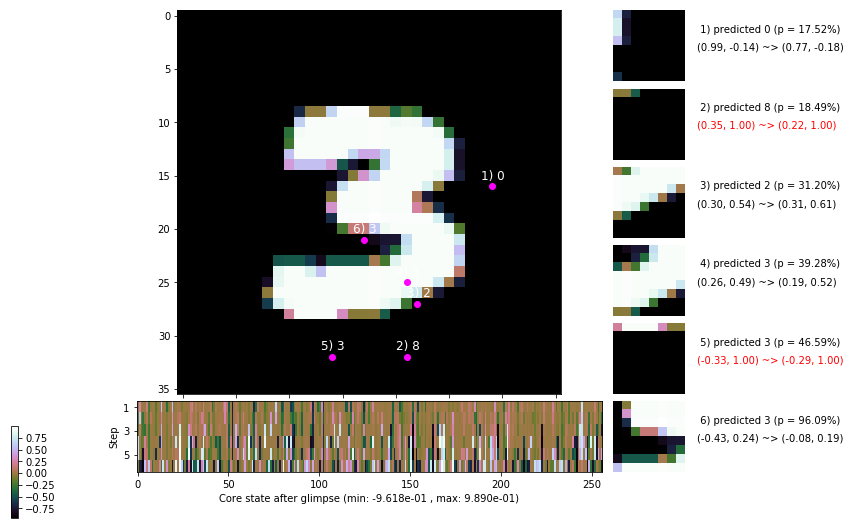

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.1 ms/b | lr: 9.38e-04 | grad 2norm: 13.75 | grad inf norm:  3.570
         Weights || abs max:  1.27 ( 4063.05) | mean: -7.18e-04 ( 0.02) | var: 2.24e-02 (  317.51)
          Biases || abs max:  0.94 (  263.61) | mean: -3.65e-02 ( 0.25) | var: 1.69e-02 (  844.01)
                    class loss: 0.718 | steps: 2.740 | reward:  3.517 | acc.: 75.82%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.7 ms/b | lr: 9.37e-04 | grad 2norm: 14.13 | grad inf norm:  3.802
         Weights || abs max:  1.27 ( 6000.87) | mean: -7.06e-04 ( 0.02) | var: 2.27e-02 ( 1412.13)
          Biases || abs max:  0.95 (  206.95) | mean: -3.79e-02 ( 0.22) | var: 1.74e-02 (  307.40)
                    class loss: 0.700 | steps: 2.705 | reward:  3.560 | acc.: 76.42%

	Target class: 2 | Discounted rewards: [0.628, 1.456, 0.9

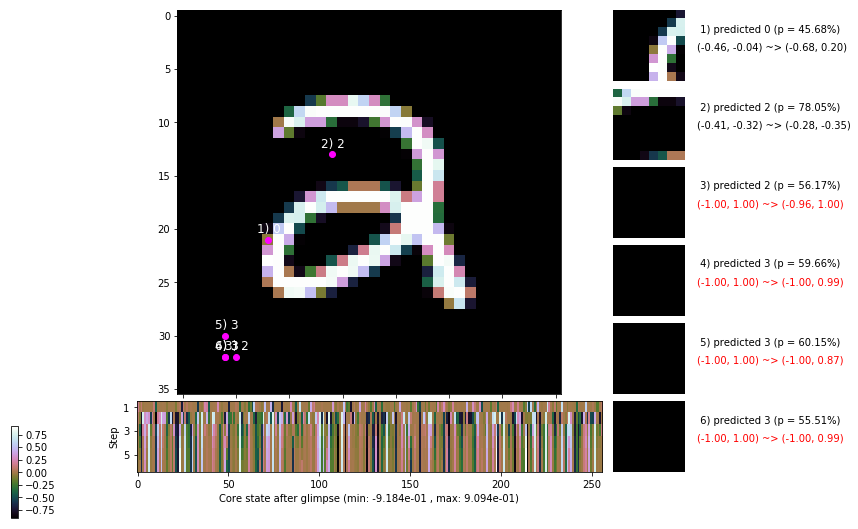

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.5 ms/b | lr: 9.35e-04 | grad 2norm: 14.12 | grad inf norm:  3.636
         Weights || abs max:  1.29 ( 4436.49) | mean: -7.49e-04 ( 0.02) | var: 2.30e-02 (  368.75)
          Biases || abs max:  0.95 (  176.91) | mean: -3.80e-02 ( 0.19) | var: 1.77e-02 (  407.86)
                    class loss: 0.665 | steps: 2.734 | reward:  3.553 | acc.: 77.10%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.1 ms/b | lr: 9.34e-04 | grad 2norm: 13.93 | grad inf norm:  3.493
         Weights || abs max:  1.31 ( 4409.96) | mean: -6.85e-04 ( 0.02) | var: 2.33e-02 (  406.81)
          Biases || abs max:  0.95 (  205.24) | mean: -3.89e-02 ( 0.23) | var: 1.81e-02 (  723.16)
                    class loss: 0.713 | steps: 2.731 | reward:  3.531 | acc.: 75.85%

	Target class: 5 | Discounted rewards: [-0.197, -0.194, -

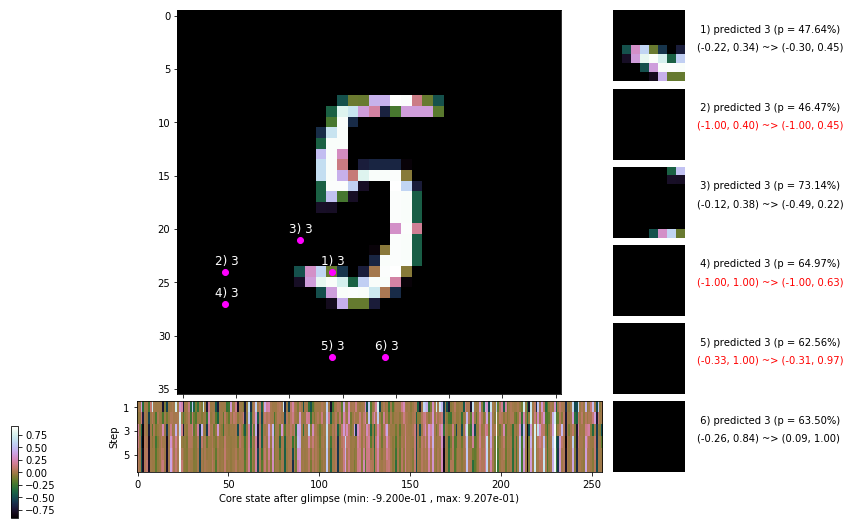

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 145.3 ms/b | lr: 9.32e-04 | grad 2norm: 13.74 | grad inf norm:  3.418
         Weights || abs max:  1.33 ( 4705.46) | mean: -6.67e-04 ( 0.02) | var: 2.36e-02 ( 1043.14)
          Biases || abs max:  0.95 (  139.30) | mean: -4.01e-02 ( 0.19) | var: 1.86e-02 (  287.13)
                    class loss: 0.686 | steps: 2.702 | reward:  3.552 | acc.: 76.40%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.3 ms/b | lr: 9.31e-04 | grad 2norm: 13.96 | grad inf norm:  3.552
         Weights || abs max:  1.35 ( 3535.33) | mean: -6.24e-04 ( 0.02) | var: 2.38e-02 (  256.84)
          Biases || abs max:  0.95 (  297.85) | mean: -4.10e-02 ( 0.25) | var: 1.90e-02 (  763.96)
                    class loss: 0.693 | steps: 2.744 | reward:  3.534 | acc.: 76.68%

	Target class: 6 | Discounted rewards: [0.044, 0.287, 0.7

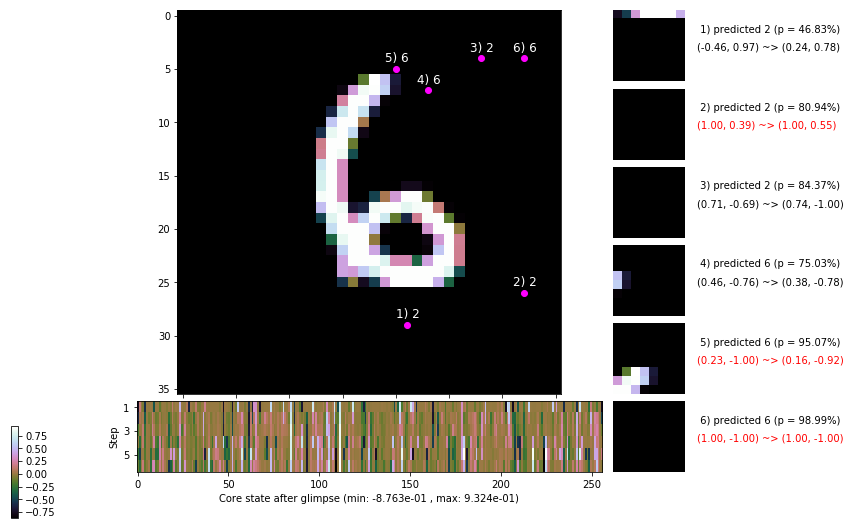

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.8 ms/b | lr: 9.30e-04 | grad 2norm: 13.91 | grad inf norm:  3.570
         Weights || abs max:  1.37 ( 3526.46) | mean: -6.23e-04 ( 0.02) | var: 2.41e-02 (  267.28)
          Biases || abs max:  0.96 (  347.17) | mean: -4.18e-02 ( 0.29) | var: 1.92e-02 ( 1116.50)
                    class loss: 0.662 | steps: 2.704 | reward:  3.539 | acc.: 76.45%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.4 ms/b | lr: 9.29e-04 | grad 2norm: 14.42 | grad inf norm:  3.642
         Weights || abs max:  1.39 ( 5187.12) | mean: -6.25e-04 ( 0.02) | var: 2.44e-02 ( 3260.80)
          Biases || abs max:  0.96 (  101.34) | mean: -4.24e-02 ( 0.16) | var: 1.95e-02 (   27.79)
                    class loss: 0.693 | steps: 2.697 | reward:  3.537 | acc.: 76.00%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

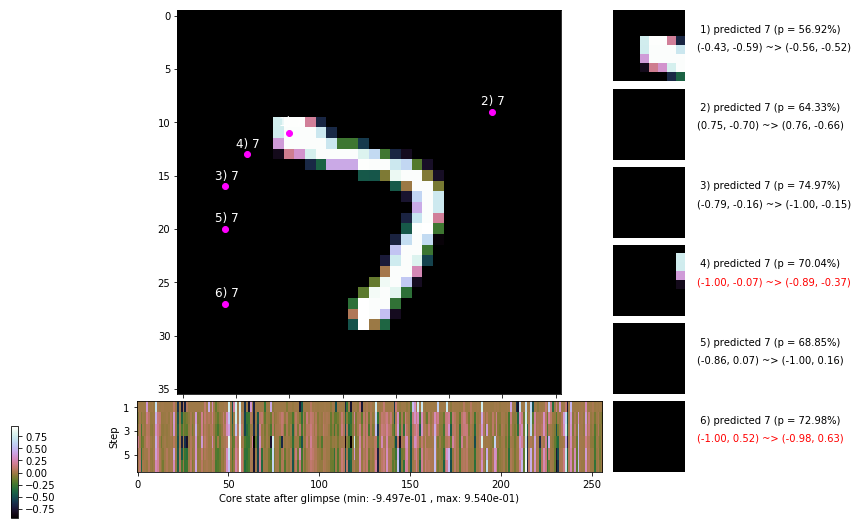

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.319, 0.837, 1.875, 1.750, 1.500, 1.000]


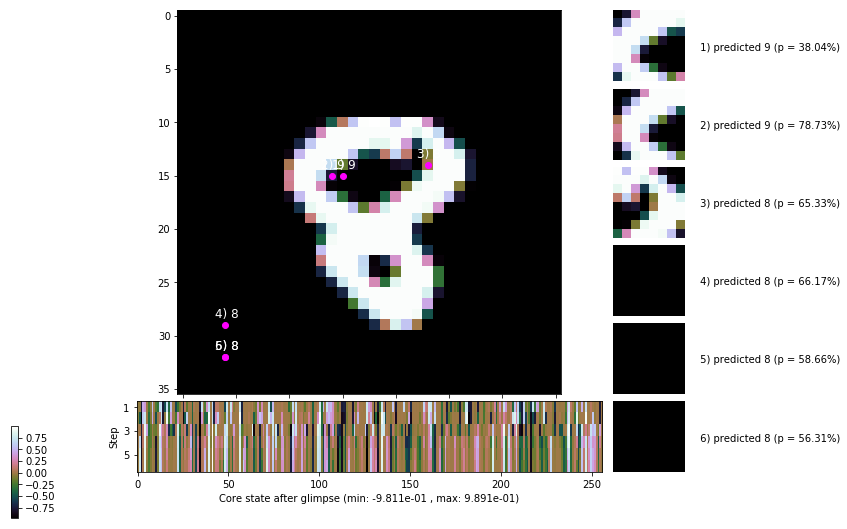


	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


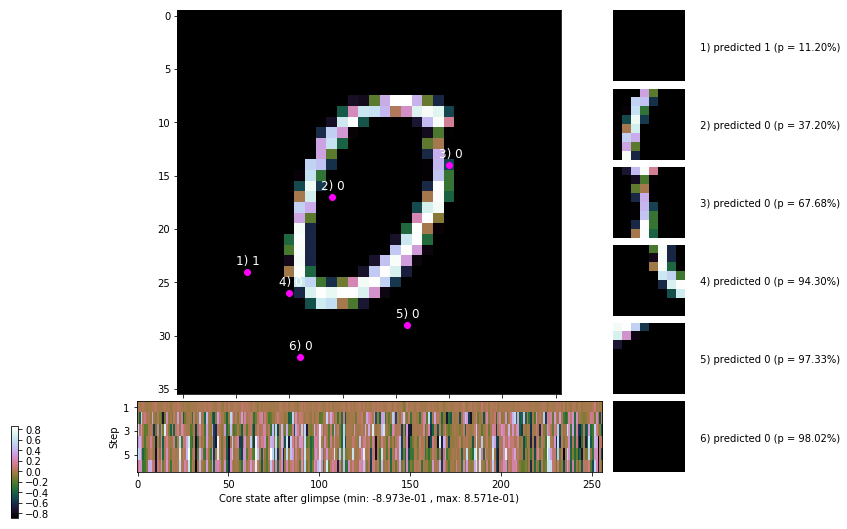

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


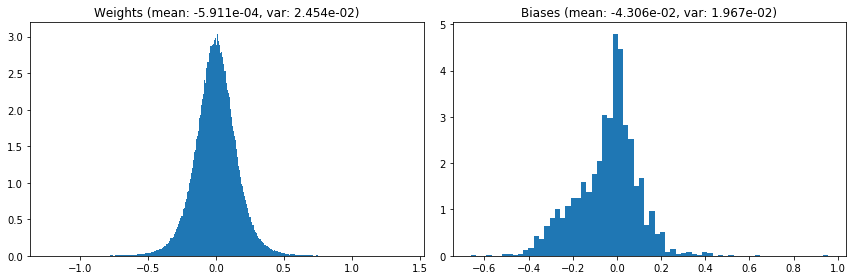

                                      Location network weights and biases


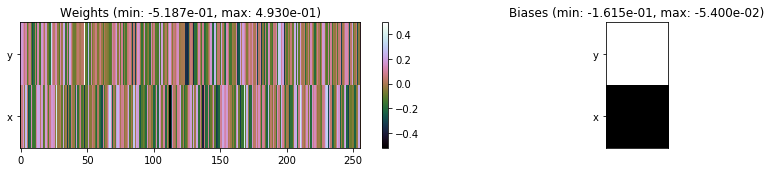

---------------------------------------------------------------------------------------------------------------
Elapsed time:  430.48 sec | TRAIN >> class loss: 0.6949 | steps:  2.720    | reward:  3.5409    | acc.: 76.272% 
                          | VAL   >> class loss: 0.6730 | steps:  2.603    | reward:  3.6645 :( | acc.: 76.140% :(


Epoch   6/400) lr = 0.0009277
 b    300/  3000 >> 143.4 ms/b | lr: 9.27e-04 | grad 2norm: 14.19 | grad inf norm:  3.585
         Weights || abs max:  1.42 ( 3999.30) | mean: -6.12e-04 ( 0.02) | var: 2.47e-02 (  336.90)
          Biases || abs max:  0.95 (  123.33) | mean: -4.36e-02 ( 0.16) | var: 1.98e-02 (   89.91)
                    class loss: 0.675 | steps: 2.718 | reward:  3.553 | acc.: 76.73%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.3 ms/b | lr: 9.26e-04 | grad 2norm: 14.05 | grad inf norm:  3.595
         Weights || abs max:  1.41 ( 2336.14) | mean: -6.12e-04 ( 0

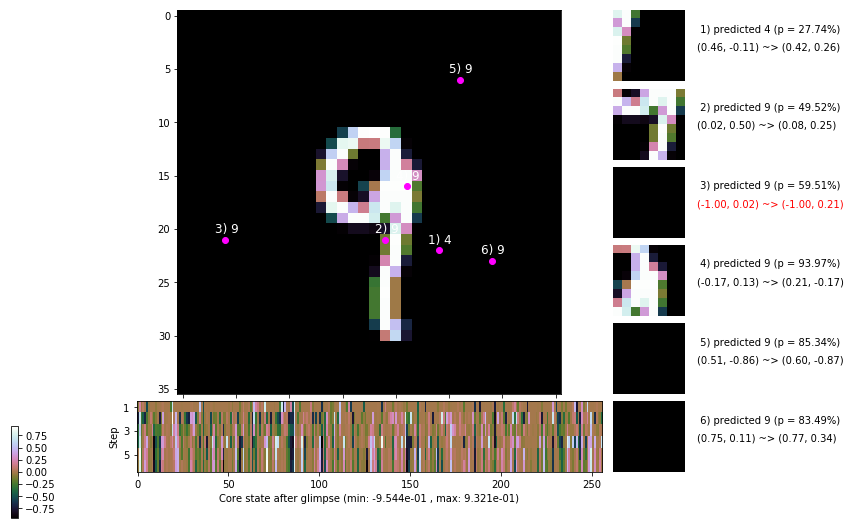

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.9 ms/b | lr: 9.24e-04 | grad 2norm: 14.03 | grad inf norm:  3.755
         Weights || abs max:  1.41 ( 3276.46) | mean: -6.34e-04 ( 0.02) | var: 2.52e-02 (  234.55)
          Biases || abs max:  0.97 (  175.05) | mean: -4.52e-02 ( 0.18) | var: 2.06e-02 (  172.73)
                    class loss: 0.667 | steps: 2.707 | reward:  3.592 | acc.: 77.02%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.6 ms/b | lr: 9.23e-04 | grad 2norm: 14.00 | grad inf norm:  3.583
         Weights || abs max:  1.44 ( 3918.41) | mean: -6.26e-04 ( 0.02) | var: 2.54e-02 (  464.65)
          Biases || abs max:  0.98 (  337.14) | mean: -4.62e-02 ( 0.29) | var: 2.09e-02 ( 2109.63)
                    class loss: 0.658 | steps: 2.670 | reward:  3.606 | acc.: 76.92%

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.8

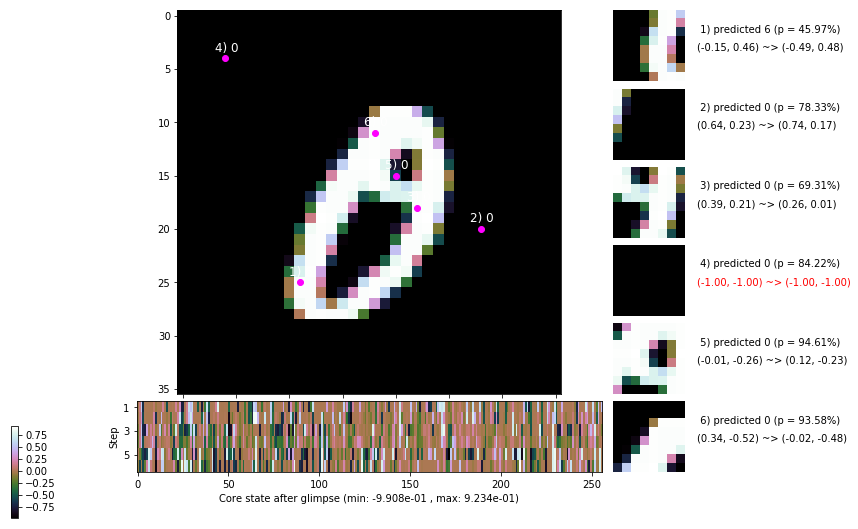

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 144.1 ms/b | lr: 9.21e-04 | grad 2norm: 13.83 | grad inf norm:  3.657
         Weights || abs max:  1.45 ( 3016.59) | mean: -5.91e-04 ( 0.02) | var: 2.57e-02 (  247.12)
          Biases || abs max:  0.99 (  204.62) | mean: -4.65e-02 ( 0.19) | var: 2.12e-02 (  462.97)
                    class loss: 0.661 | steps: 2.708 | reward:  3.570 | acc.: 77.43%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.7 ms/b | lr: 9.20e-04 | grad 2norm: 14.13 | grad inf norm:  3.638
         Weights || abs max:  1.47 ( 3967.67) | mean: -5.58e-04 ( 0.02) | var: 2.59e-02 (  408.82)
          Biases || abs max:  0.99 (   93.61) | mean: -4.70e-02 ( 0.13) | var: 2.16e-02 (   37.12)
                    class loss: 0.644 | steps: 2.660 | reward:  3.624 | acc.: 78.35%

	Target class: 8 | Discounted rewards: [-0.197, -0.194, -

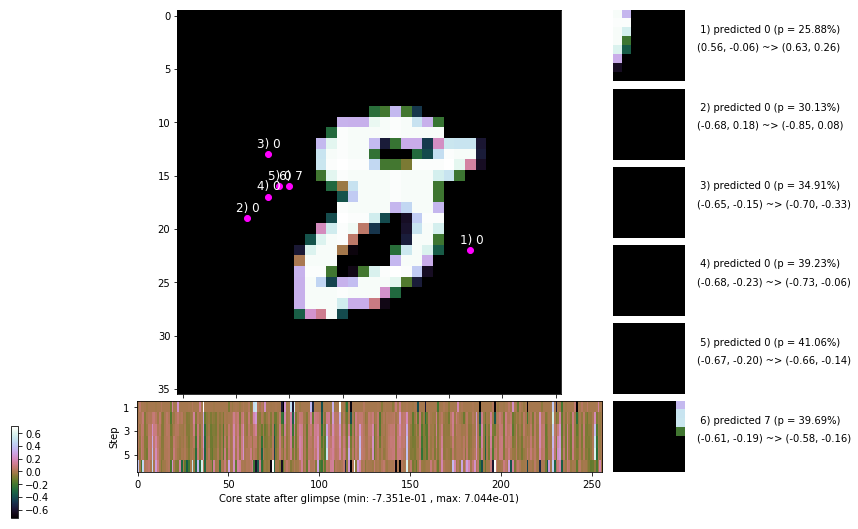

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.9 ms/b | lr: 9.18e-04 | grad 2norm: 13.99 | grad inf norm:  3.585
         Weights || abs max:  1.49 ( 2130.00) | mean: -5.67e-04 ( 0.01) | var: 2.62e-02 (   91.03)
          Biases || abs max:  0.99 (   97.01) | mean: -4.87e-02 ( 0.13) | var: 2.19e-02 (   92.18)
                    class loss: 0.643 | steps: 2.652 | reward:  3.622 | acc.: 78.45%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 142.3 ms/b | lr: 9.18e-04 | grad 2norm: 13.72 | grad inf norm:  3.413
         Weights || abs max:  1.48 ( 5498.97) | mean: -6.00e-04 ( 0.02) | var: 2.64e-02 ( 1053.79)
          Biases || abs max:  0.98 (  155.09) | mean: -4.94e-02 ( 0.16) | var: 2.22e-02 (  234.54)
                    class loss: 0.634 | steps: 2.636 | reward:  3.647 | acc.: 78.50%

	Target class: 3 | Discounted rewards: [0.869, 1.938, 1.8

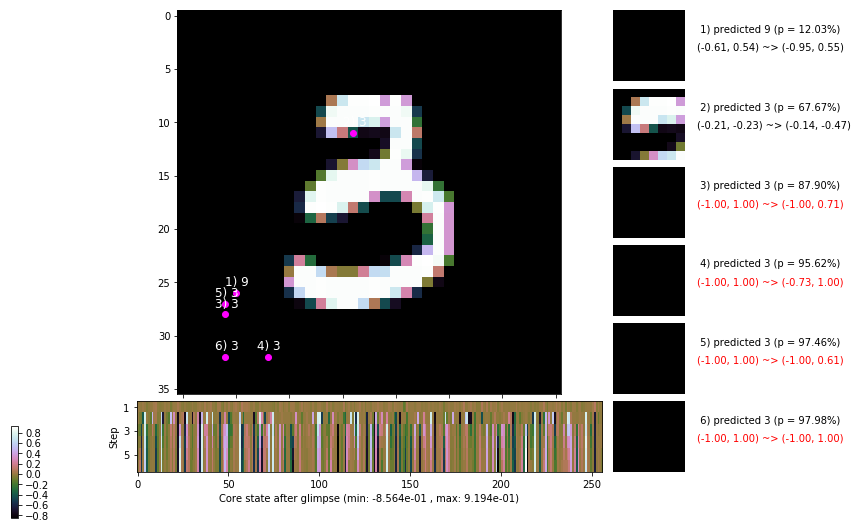

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.2 ms/b | lr: 9.16e-04 | grad 2norm: 14.11 | grad inf norm:  3.511
         Weights || abs max:  1.48 ( 3602.52) | mean: -6.25e-04 ( 0.02) | var: 2.67e-02 (  356.61)
          Biases || abs max:  0.99 (   92.90) | mean: -4.97e-02 ( 0.14) | var: 2.25e-02 (   56.79)
                    class loss: 0.618 | steps: 2.612 | reward:  3.676 | acc.: 79.12%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.9 ms/b | lr: 9.15e-04 | grad 2norm: 14.11 | grad inf norm:  3.617
         Weights || abs max:  1.48 (14047.15) | mean: -6.21e-04 ( 0.04) | var: 2.69e-02 (60458.93)
          Biases || abs max:  0.99 (  122.38) | mean: -5.09e-02 ( 0.14) | var: 2.28e-02 (  339.67)
                    class loss: 0.596 | steps: 2.611 | reward:  3.699 | acc.: 79.83%

	Target class: 3 | Discounted rewards: [-0.094, 0.012, 0.

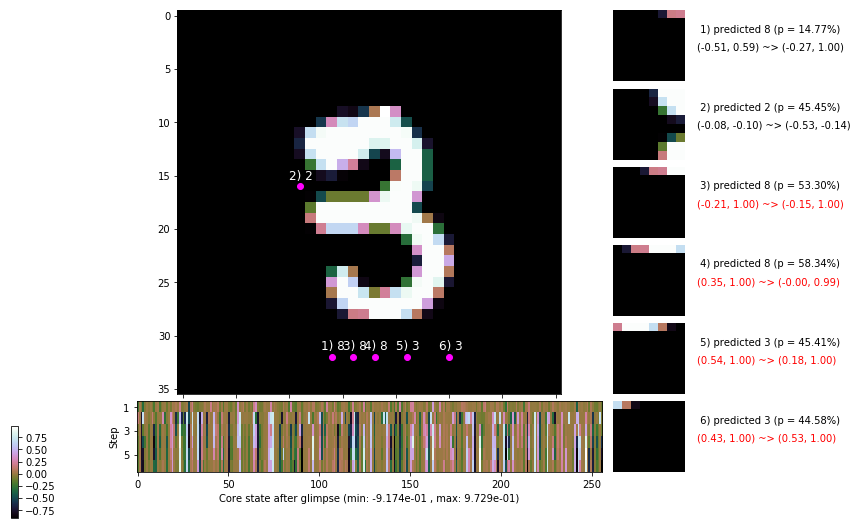

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


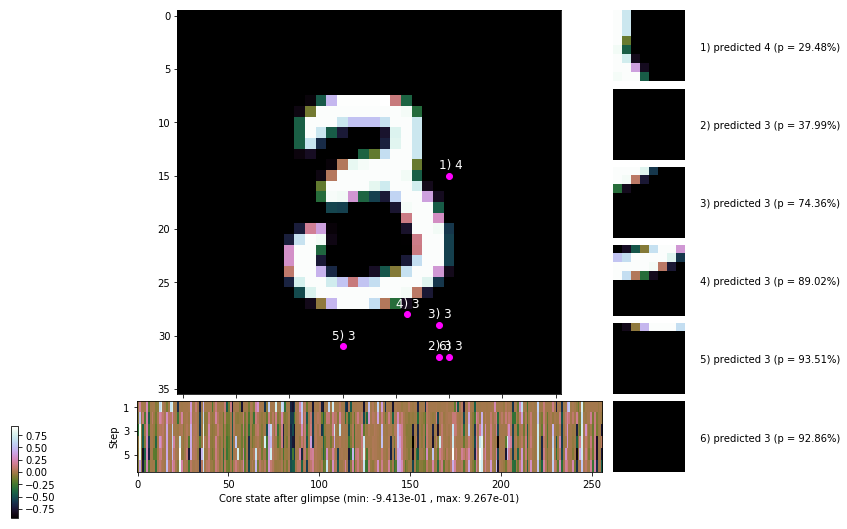


	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


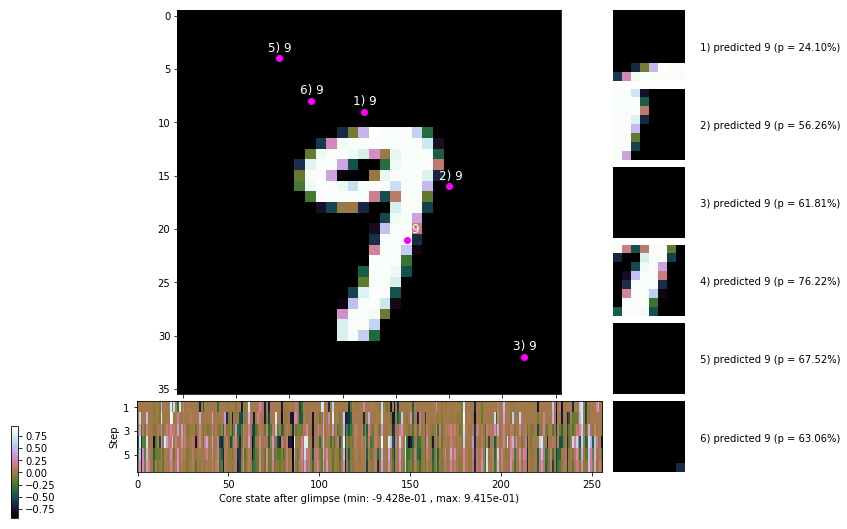

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


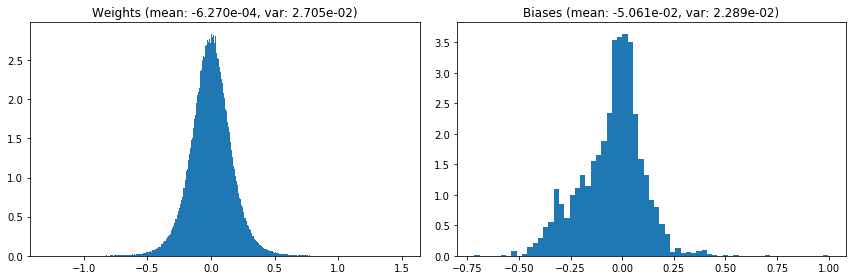

                                      Location network weights and biases


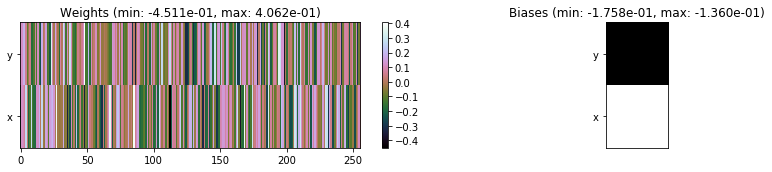

---------------------------------------------------------------------------------------------------------------
Elapsed time:  430.88 sec | TRAIN >> class loss: 0.6462 | steps:  2.664    | reward:  3.6198    | acc.: 77.918% 
                          | VAL   >> class loss: 0.5869 | steps:  2.538    | reward:  3.7987    | acc.: 80.120% 


Epoch   7/400) lr = 0.0009139
 b    300/  3000 >> 141.8 ms/b | lr: 9.13e-04 | grad 2norm: 13.94 | grad inf norm:  3.581
         Weights || abs max:  1.52 ( 3219.60) | mean: -6.27e-04 ( 0.02) | var: 2.72e-02 (  225.28)
          Biases || abs max:  1.00 (  645.16) | mean: -5.13e-02 ( 0.40) | var: 2.31e-02 (19850.20)
                    class loss: 0.575 | steps: 2.593 | reward:  3.752 | acc.: 80.68%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.2 ms/b | lr: 9.12e-04 | grad 2norm: 14.00 | grad inf norm:  3.496
         Weights || abs max:  1.53 ( 5434.13) | mean: -6.19e-04 ( 0.0

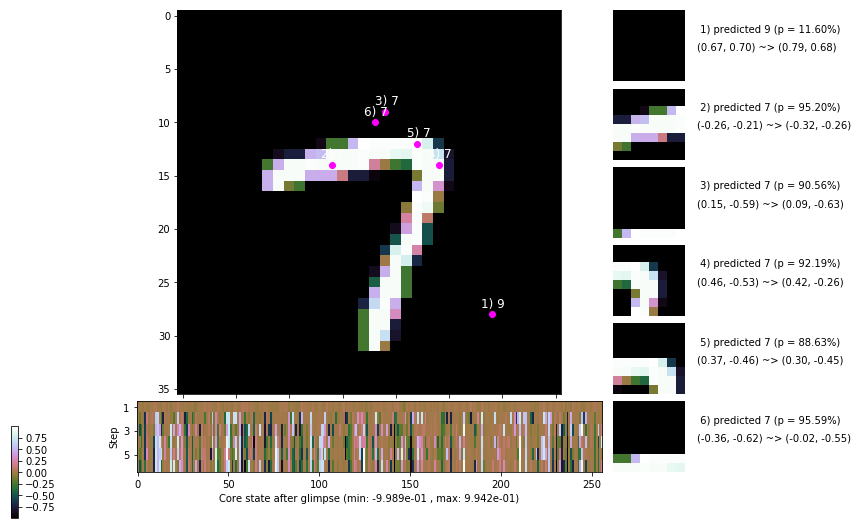

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 145.1 ms/b | lr: 9.10e-04 | grad 2norm: 14.00 | grad inf norm:  3.530
         Weights || abs max:  1.54 ( 3954.67) | mean: -6.43e-04 ( 0.02) | var: 2.77e-02 (  300.90)
          Biases || abs max:  1.00 (   83.01) | mean: -5.26e-02 ( 0.11) | var: 2.36e-02 (   41.94)
                    class loss: 0.592 | steps: 2.614 | reward:  3.725 | acc.: 80.47%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 142.6 ms/b | lr: 9.09e-04 | grad 2norm: 13.90 | grad inf norm:  3.397
         Weights || abs max:  1.55 ( 3139.40) | mean: -6.17e-04 ( 0.02) | var: 2.79e-02 (  117.14)
          Biases || abs max:  1.01 (   68.77) | mean: -5.34e-02 ( 0.11) | var: 2.39e-02 (   14.31)
                    class loss: 0.593 | steps: 2.635 | reward:  3.707 | acc.: 80.07%

	Target class: 9 | Discounted rewards: [0.319, 0.837, 1.8

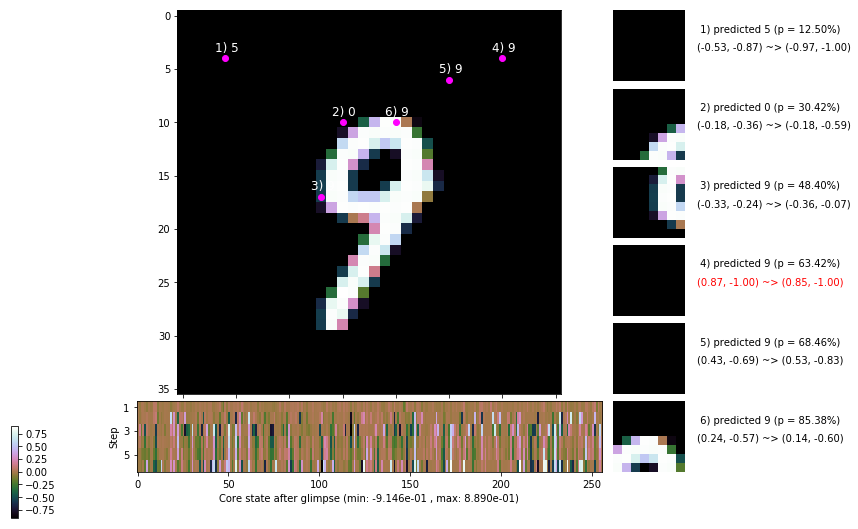

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 144.3 ms/b | lr: 9.08e-04 | grad 2norm: 13.70 | grad inf norm:  3.434
         Weights || abs max:  1.57 ( 3306.48) | mean: -5.95e-04 ( 0.02) | var: 2.82e-02 (  395.34)
          Biases || abs max:  1.01 (   84.68) | mean: -5.42e-02 ( 0.12) | var: 2.42e-02 (   52.48)
                    class loss: 0.589 | steps: 2.622 | reward:  3.720 | acc.: 80.45%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.6 ms/b | lr: 9.07e-04 | grad 2norm: 13.93 | grad inf norm:  3.425
         Weights || abs max:  1.57 (16938.24) | mean: -5.78e-04 ( 0.04) | var: 2.84e-02 (89325.82)
          Biases || abs max:  1.02 (  147.48) | mean: -5.46e-02 ( 0.15) | var: 2.46e-02 (  233.84)
                    class loss: 0.585 | steps: 2.639 | reward:  3.724 | acc.: 80.77%

	Target class: 8 | Discounted rewards: [-0.094, 0.012, 0.

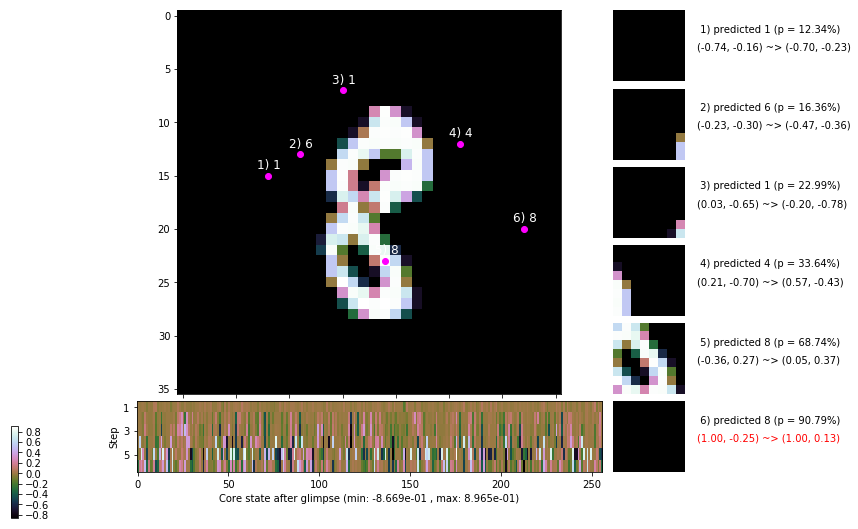

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 143.9 ms/b | lr: 9.05e-04 | grad 2norm: 14.02 | grad inf norm:  3.453
         Weights || abs max:  1.60 ( 3318.04) | mean: -5.87e-04 ( 0.02) | var: 2.86e-02 (  130.39)
          Biases || abs max:  1.02 (  136.53) | mean: -5.51e-02 ( 0.13) | var: 2.49e-02 (  295.27)
                    class loss: 0.591 | steps: 2.653 | reward:  3.699 | acc.: 79.65%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 143.3 ms/b | lr: 9.04e-04 | grad 2norm: 13.76 | grad inf norm:  3.472
         Weights || abs max:  1.61 ( 3976.23) | mean: -6.22e-04 ( 0.02) | var: 2.89e-02 (  349.94)
          Biases || abs max:  1.02 (  137.39) | mean: -5.65e-02 ( 0.13) | var: 2.53e-02 (  319.00)
                    class loss: 0.570 | steps: 2.623 | reward:  3.731 | acc.: 80.55%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

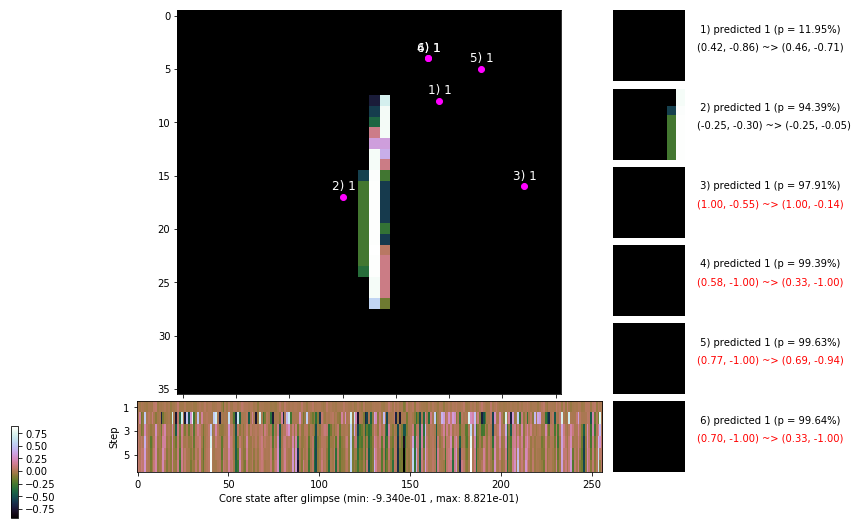

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.7 ms/b | lr: 9.02e-04 | grad 2norm: 14.07 | grad inf norm:  3.562
         Weights || abs max:  1.63 ( 9087.19) | mean: -6.36e-04 ( 0.03) | var: 2.91e-02 (12167.34)
          Biases || abs max:  1.02 (  159.11) | mean: -5.67e-02 ( 0.14) | var: 2.55e-02 (  491.84)
                    class loss: 0.613 | steps: 2.697 | reward:  3.637 | acc.: 79.10%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.1 ms/b | lr: 9.01e-04 | grad 2norm: 13.76 | grad inf norm:  3.491
         Weights || abs max:  1.64 ( 4927.73) | mean: -6.50e-04 ( 0.02) | var: 2.93e-02 ( 1291.43)
          Biases || abs max:  1.03 (  446.54) | mean: -5.72e-02 ( 0.36) | var: 2.58e-02 (15561.86)
                    class loss: 0.576 | steps: 2.623 | reward:  3.722 | acc.: 81.05%

	Target class: 4 | Discounted rewards: [-0.025, 0.150, 0.

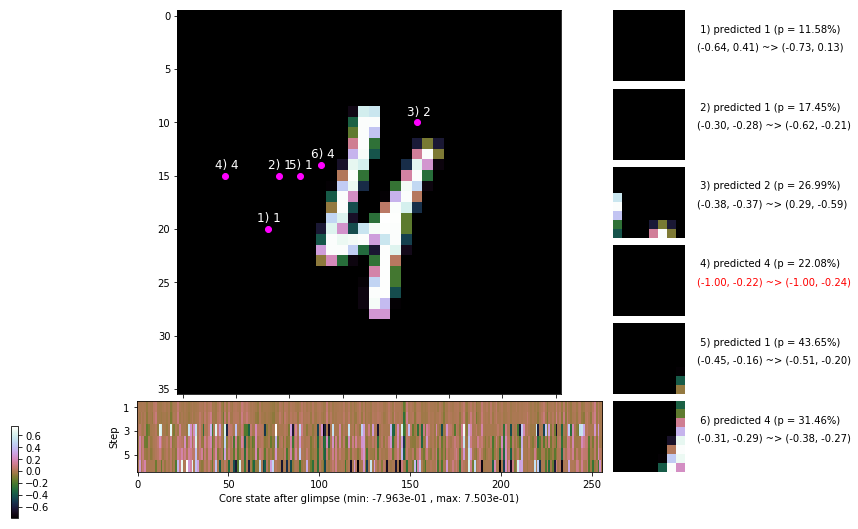

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


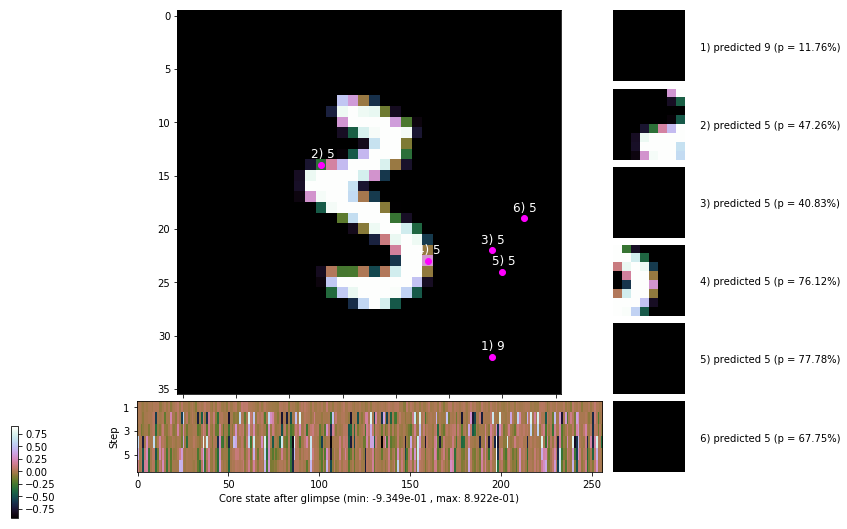


	Target class: 1 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


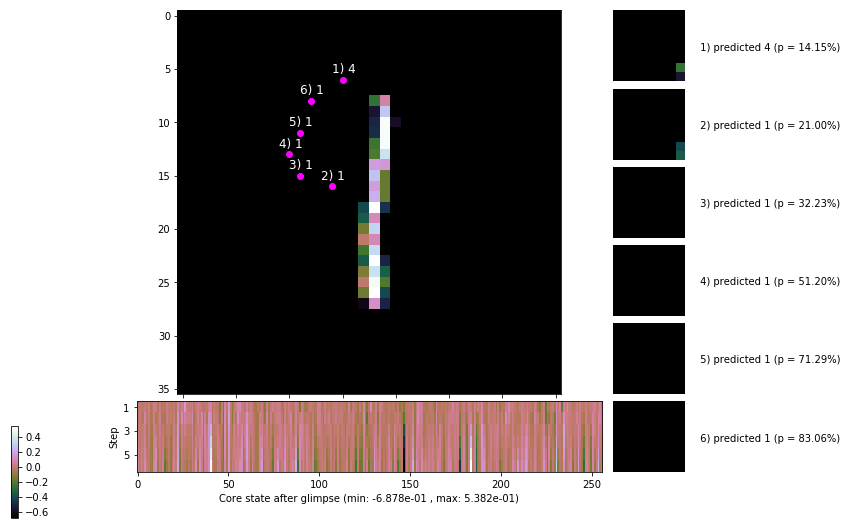

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


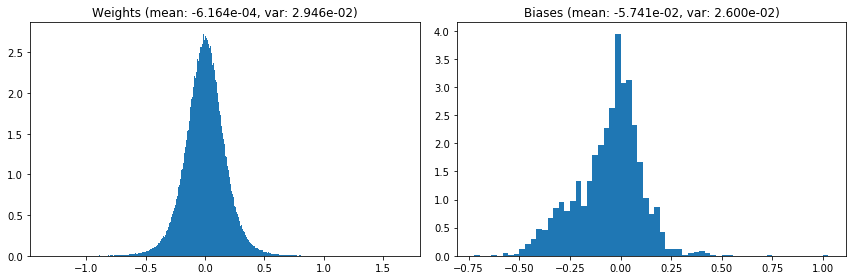

                                      Location network weights and biases


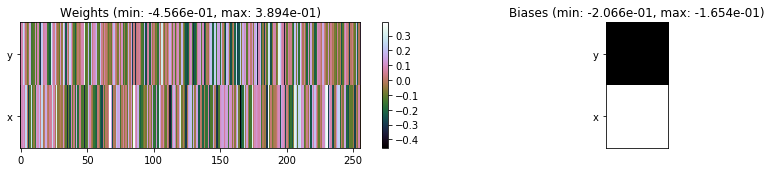

---------------------------------------------------------------------------------------------------------------
Elapsed time:  431.03 sec | TRAIN >> class loss: 0.5908 | steps:  2.632    | reward:  3.7105    | acc.: 80.252% 
                          | VAL   >> class loss: 0.5709 | steps:  2.551 :( | reward:  3.7967 :( | acc.: 80.700% 


Epoch   8/400) lr = 0.0009003
 b    300/  3000 >> 142.3 ms/b | lr: 8.99e-04 | grad 2norm: 13.56 | grad inf norm:  3.398
         Weights || abs max:  1.67 ( 3654.36) | mean: -6.36e-04 ( 0.02) | var: 2.96e-02 (  320.50)
          Biases || abs max:  1.03 (  259.11) | mean: -5.78e-02 ( 0.18) | var: 2.62e-02 ( 1430.69)
                    class loss: 0.568 | steps: 2.577 | reward:  3.769 | acc.: 80.60%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.0 ms/b | lr: 8.98e-04 | grad 2norm: 13.66 | grad inf norm:  3.364
         Weights || abs max:  1.69 ( 4743.53) | mean: -6.73e-04 ( 0.0

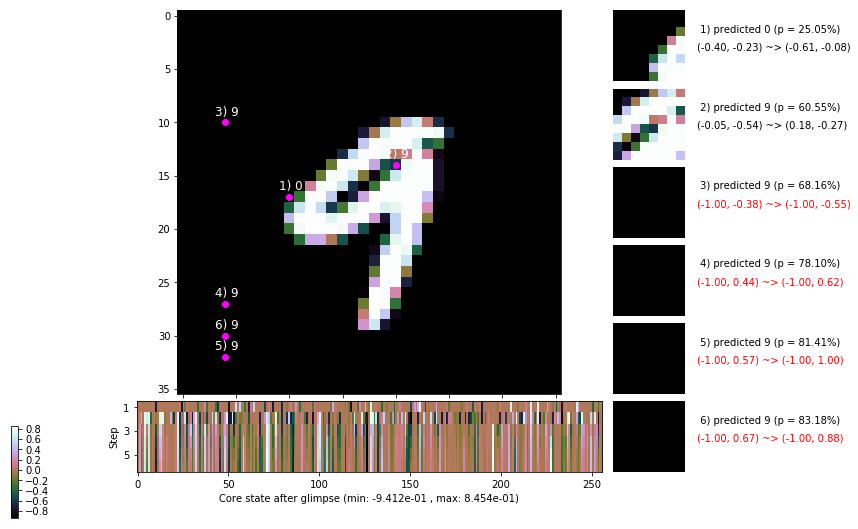

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.9 ms/b | lr: 8.97e-04 | grad 2norm: 14.10 | grad inf norm:  3.543
         Weights || abs max:  1.71 ( 3973.25) | mean: -6.36e-04 ( 0.02) | var: 3.01e-02 ( 1578.95)
          Biases || abs max:  1.03 ( 1586.47) | mean: -5.88e-02 ( 0.71) | var: 2.67e-02 (158838.55)
                    class loss: 0.582 | steps: 2.653 | reward:  3.693 | acc.: 79.88%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.2 ms/b | lr: 8.96e-04 | grad 2norm: 13.93 | grad inf norm:  3.496
         Weights || abs max:  1.70 ( 5625.97) | mean: -5.40e-04 ( 0.02) | var: 3.03e-02 ( 2212.22)
          Biases || abs max:  1.04 (  386.44) | mean: -5.99e-02 ( 0.24) | var: 2.71e-02 ( 8095.50)
                    class loss: 0.563 | steps: 2.563 | reward:  3.759 | acc.: 80.70%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.

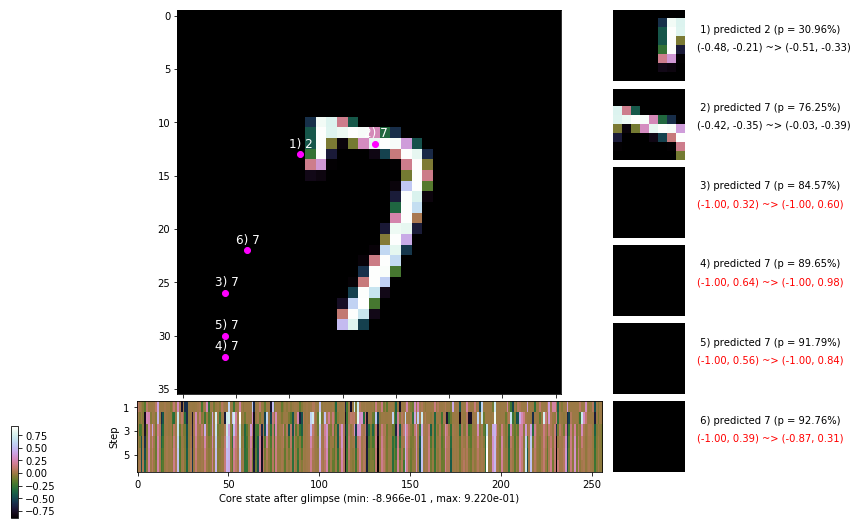

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 144.5 ms/b | lr: 8.94e-04 | grad 2norm: 14.13 | grad inf norm:  3.623
         Weights || abs max:  1.73 ( 5254.89) | mean: -5.42e-04 ( 0.02) | var: 3.05e-02 ( 1016.02)
          Biases || abs max:  1.03 (  194.24) | mean: -6.05e-02 ( 0.17) | var: 2.75e-02 (  381.27)
                    class loss: 0.593 | steps: 2.634 | reward:  3.704 | acc.: 79.77%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 148.7 ms/b | lr: 8.93e-04 | grad 2norm: 13.84 | grad inf norm:  3.558
         Weights || abs max:  1.74 ( 8605.38) | mean: -5.91e-04 ( 0.03) | var: 3.07e-02 (12605.14)
          Biases || abs max:  1.04 (   84.01) | mean: -6.14e-02 ( 0.11) | var: 2.78e-02 (   49.48)
                    class loss: 0.586 | steps: 2.606 | reward:  3.740 | acc.: 79.95%

	Target class: 0 | Discounted rewards: [0.594, 1.388, 0.7

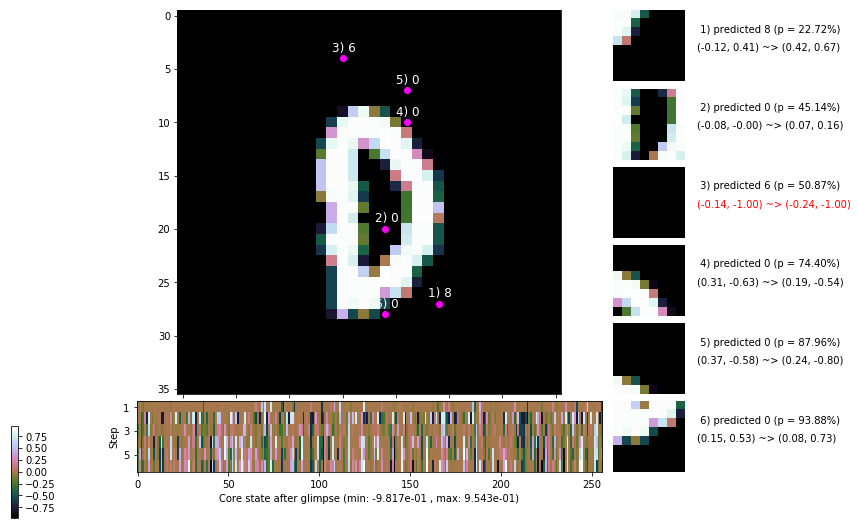

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 145.2 ms/b | lr: 8.91e-04 | grad 2norm: 13.64 | grad inf norm:  3.471
         Weights || abs max:  1.75 ( 5604.28) | mean: -6.29e-04 ( 0.02) | var: 3.10e-02 (  863.52)
          Biases || abs max:  1.05 (  121.33) | mean: -6.17e-02 ( 0.12) | var: 2.83e-02 (   59.99)
                    class loss: 0.554 | steps: 2.578 | reward:  3.814 | acc.: 81.67%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.9 ms/b | lr: 8.90e-04 | grad 2norm: 13.63 | grad inf norm:  3.393
         Weights || abs max:  1.77 ( 4659.97) | mean: -5.90e-04 ( 0.02) | var: 3.12e-02 (  533.70)
          Biases || abs max:  1.05 (  363.31) | mean: -6.27e-02 ( 0.22) | var: 2.87e-02 ( 3954.58)
                    class loss: 0.567 | steps: 2.601 | reward:  3.775 | acc.: 81.17%

	Target class: 3 | Discounted rewards: [0.319, 0.837, 1.8

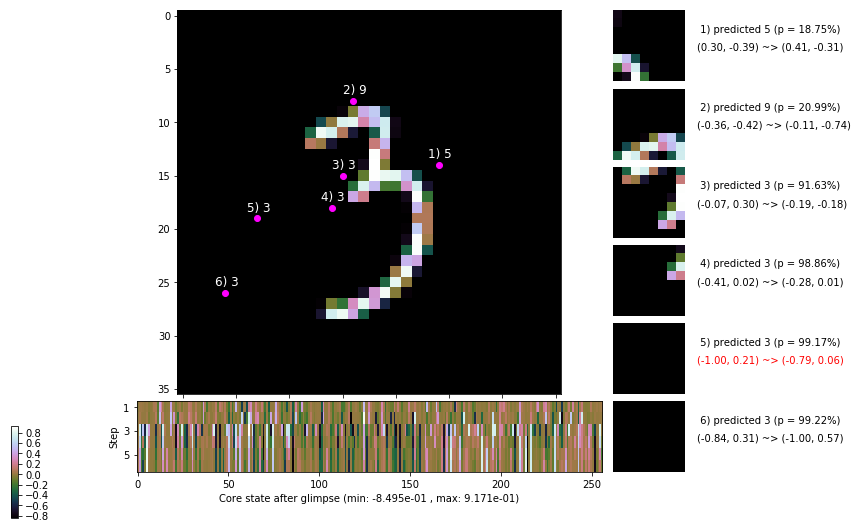

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.3 ms/b | lr: 8.89e-04 | grad 2norm: 13.77 | grad inf norm:  3.497
         Weights || abs max:  1.78 ( 4290.09) | mean: -5.81e-04 ( 0.02) | var: 3.14e-02 (  262.08)
          Biases || abs max:  1.05 (  243.03) | mean: -6.27e-02 ( 0.18) | var: 2.89e-02 (  865.89)
                    class loss: 0.580 | steps: 2.611 | reward:  3.782 | acc.: 80.77%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.2 ms/b | lr: 8.88e-04 | grad 2norm: 13.87 | grad inf norm:  3.611
         Weights || abs max:  1.80 ( 5862.37) | mean: -5.82e-04 ( 0.02) | var: 3.16e-02 (  858.49)
          Biases || abs max:  1.05 (  177.81) | mean: -6.32e-02 ( 0.16) | var: 2.92e-02 (  251.80)
                    class loss: 0.582 | steps: 2.637 | reward:  3.721 | acc.: 80.62%

	Target class: 3 | Discounted rewards: [0.319, 0.837, 1.8

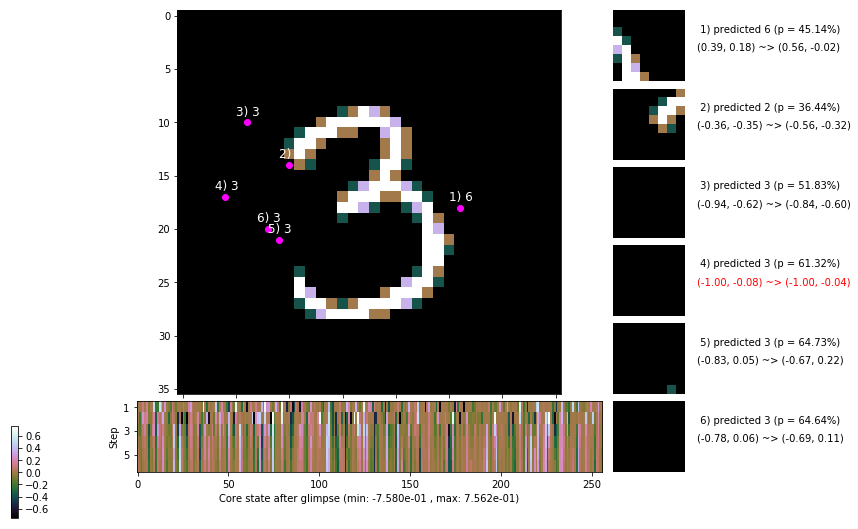

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


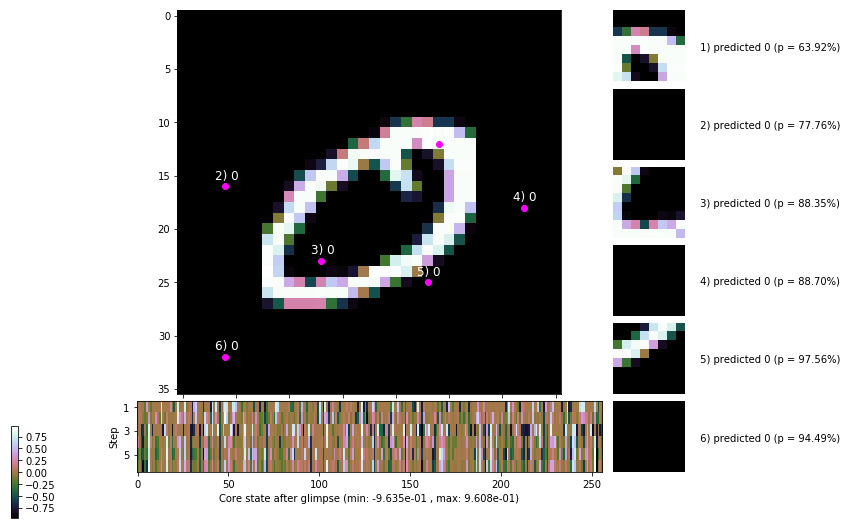


	Target class: 7 | Discounted rewards: [0.353, 0.906, -0.188, -0.175, -0.150, -0.100]


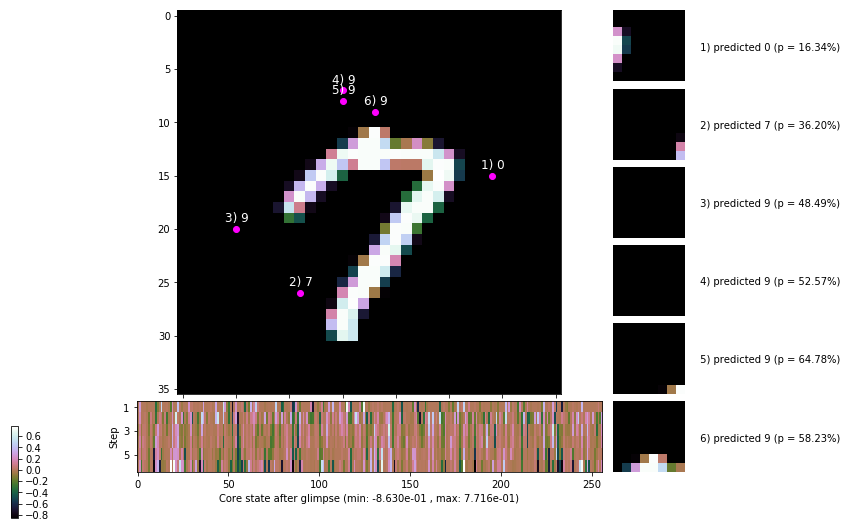

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


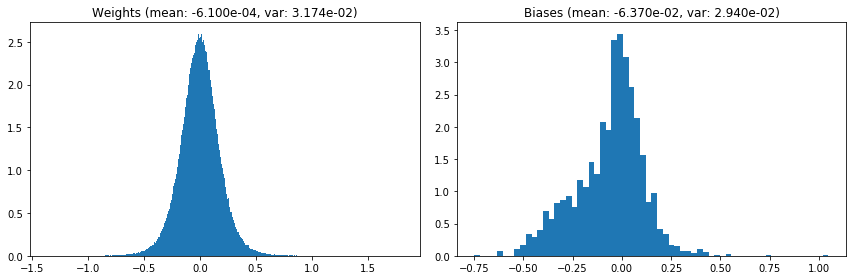

                                      Location network weights and biases


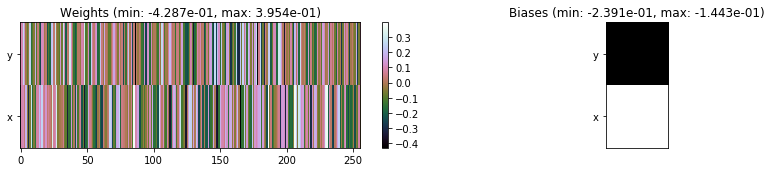

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.95 sec | TRAIN >> class loss: 0.5748 | steps:  2.605    | reward:  3.7513    | acc.: 80.627% 
                          | VAL   >> class loss: 0.5971 | steps:  2.558 :( | reward:  3.8158    | acc.: 79.740% :(


Epoch   9/400) lr = 0.0008869


H:\Users\Andrew\Anaconda3\envs\conda_jupyter\lib\site-packages\numpy\lib\nanfunctions.py:1315: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe')


 b    300/  3000 >> 143.2 ms/b | lr: 8.86e-04 | grad 2norm: 13.69 | grad inf norm:  3.486
         Weights || abs max:  1.82 (     inf) | mean: -6.23e-04 (  inf) | var: 3.18e-02 (     nan)
          Biases || abs max:  1.05 (  237.16) | mean: -6.45e-02 ( 0.17) | var: 2.96e-02 (  708.69)
                    class loss: 0.592 | steps: 2.616 | reward:  3.768 | acc.: 80.05%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.0 ms/b | lr: 8.85e-04 | grad 2norm: 13.64 | grad inf norm:  3.454
         Weights || abs max:  1.83 ( 5219.95) | mean: -6.20e-04 ( 0.02) | var: 3.20e-02 ( 3251.98)
          Biases || abs max:  1.05 (  111.26) | mean: -6.55e-02 ( 0.11) | var: 2.99e-02 (   56.97)
                    class loss: 0.578 | steps: 2.632 | reward:  3.740 | acc.: 80.35%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]
	                | Baseline rewards:   [1.112, 1.010, 0.933, 0.904, 1.564

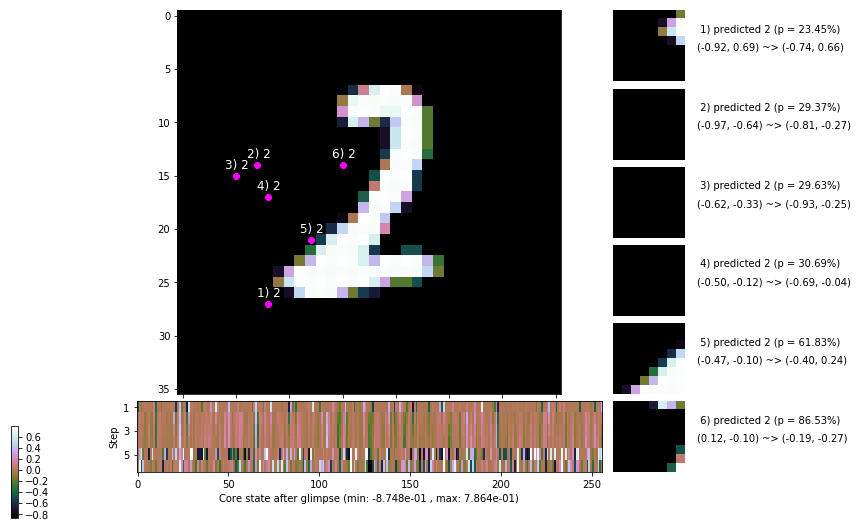

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 145.5 ms/b | lr: 8.83e-04 | grad 2norm: 13.52 | grad inf norm:  3.371
         Weights || abs max:  1.85 ( 7360.53) | mean: -5.85e-04 ( 0.02) | var: 3.23e-02 ( 3588.10)
          Biases || abs max:  1.05 (  554.75) | mean: -6.55e-02 ( 0.29) | var: 3.01e-02 (20546.13)
                    class loss: 0.584 | steps: 2.570 | reward:  3.787 | acc.: 80.82%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 142.8 ms/b | lr: 8.82e-04 | grad 2norm: 13.68 | grad inf norm:  3.537
         Weights || abs max:  1.86 ( 9106.01) | mean: -5.20e-04 ( 0.03) | var: 3.25e-02 (14987.40)
          Biases || abs max:  1.04 (   86.16) | mean: -6.62e-02 ( 0.10) | var: 3.05e-02 (   29.73)
                    class loss: 0.572 | steps: 2.586 | reward:  3.767 | acc.: 80.53%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

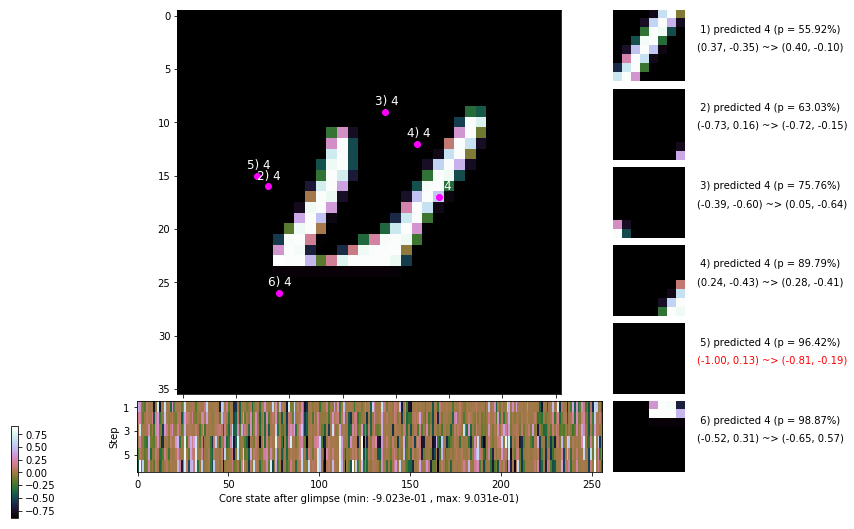

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 146.4 ms/b | lr: 8.81e-04 | grad 2norm: 13.58 | grad inf norm:  3.561
         Weights || abs max:  1.86 ( 4018.68) | mean: -5.22e-04 ( 0.02) | var: 3.27e-02 (  867.52)
          Biases || abs max:  1.04 (   78.71) | mean: -6.67e-02 ( 0.11) | var: 3.08e-02 (   15.37)
                    class loss: 0.546 | steps: 2.590 | reward:  3.773 | acc.: 81.43%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.6 ms/b | lr: 8.80e-04 | grad 2norm: 13.54 | grad inf norm:  3.481
         Weights || abs max:  1.86 ( 3855.29) | mean: -5.02e-04 ( 0.02) | var: 3.29e-02 (  409.55)
          Biases || abs max:  1.05 (  179.60) | mean: -6.75e-02 ( 0.14) | var: 3.11e-02 (  573.62)
                    class loss: 0.547 | steps: 2.570 | reward:  3.788 | acc.: 81.30%

	Target class: 3 | Discounted rewards: [0.181, 0.562, 1.3

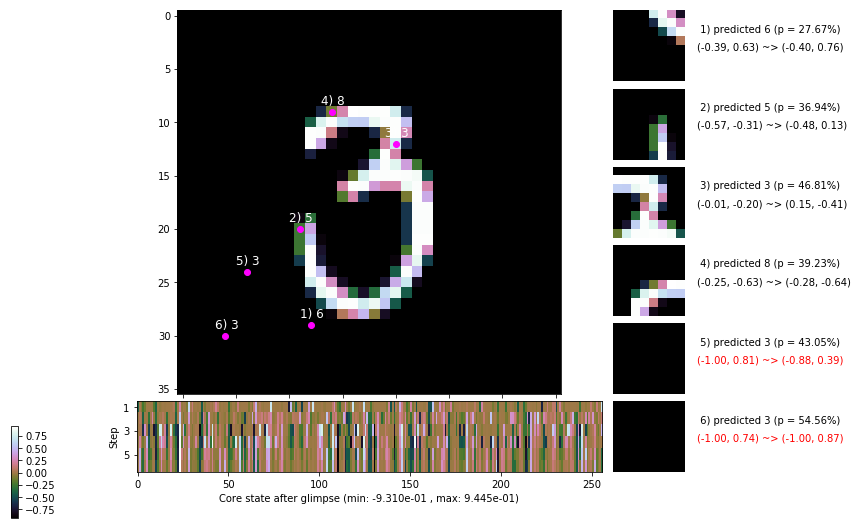

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.0 ms/b | lr: 8.78e-04 | grad 2norm: 13.34 | grad inf norm:  3.322
         Weights || abs max:  1.88 ( 4642.67) | mean: -4.57e-04 ( 0.02) | var: 3.32e-02 (  662.48)
          Biases || abs max:  1.04 (  102.53) | mean: -6.86e-02 ( 0.12) | var: 3.15e-02 (   34.75)
                    class loss: 0.576 | steps: 2.605 | reward:  3.763 | acc.: 80.40%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 144.5 ms/b | lr: 8.77e-04 | grad 2norm: 13.49 | grad inf norm:  3.536
         Weights || abs max:  1.88 ( 4640.10) | mean: -4.63e-04 ( 0.02) | var: 3.33e-02 ( 1702.94)
          Biases || abs max:  1.04 (  137.01) | mean: -6.90e-02 ( 0.12) | var: 3.19e-02 (  246.32)
                    class loss: 0.555 | steps: 2.570 | reward:  3.806 | acc.: 81.20%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.8

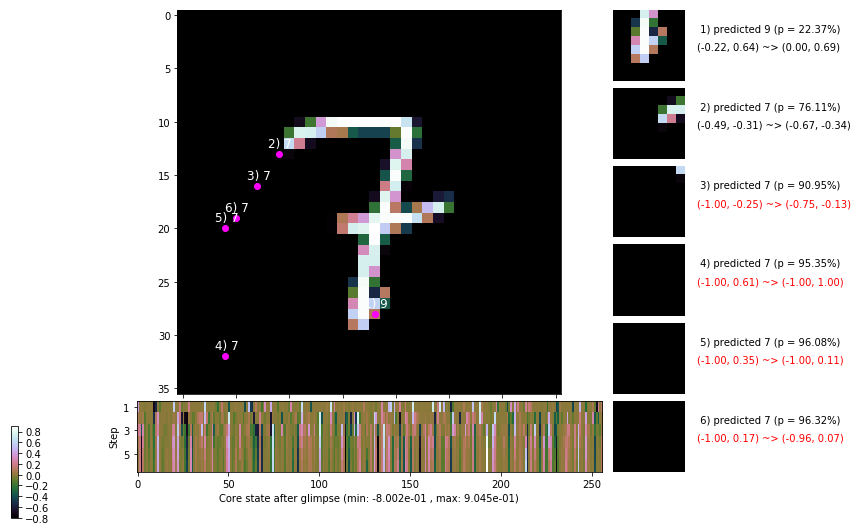

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.3 ms/b | lr: 8.75e-04 | grad 2norm: 13.73 | grad inf norm:  3.560
         Weights || abs max:  1.89 ( 4580.99) | mean: -4.84e-04 ( 0.02) | var: 3.36e-02 ( 1817.62)
          Biases || abs max:  1.05 (   51.62) | mean: -6.93e-02 ( 0.08) | var: 3.22e-02 (    6.42)
                    class loss: 0.570 | steps: 2.584 | reward:  3.796 | acc.: 80.75%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.1 ms/b | lr: 8.75e-04 | grad 2norm: 13.47 | grad inf norm:  3.491
         Weights || abs max:  1.89 ( 4845.00) | mean: -5.38e-04 ( 0.02) | var: 3.38e-02 ( 1871.53)
          Biases || abs max:  1.05 (  131.94) | mean: -7.00e-02 ( 0.13) | var: 3.27e-02 (  189.75)
                    class loss: 0.572 | steps: 2.547 | reward:  3.843 | acc.: 80.82%

	Target class: 2 | Discounted rewards: [-0.197, -0.194, -

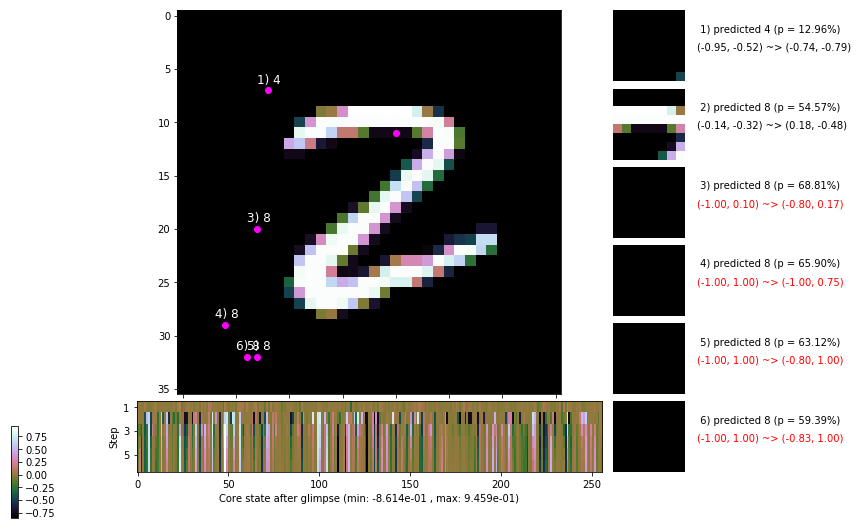

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


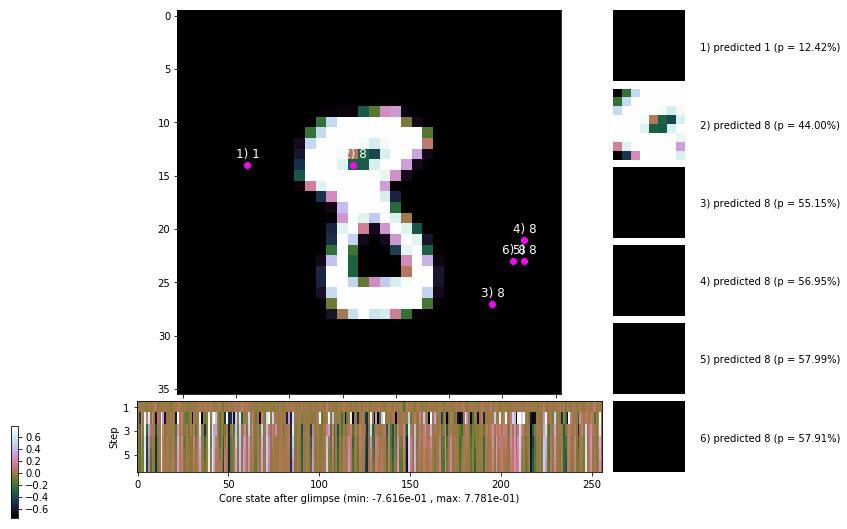


	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


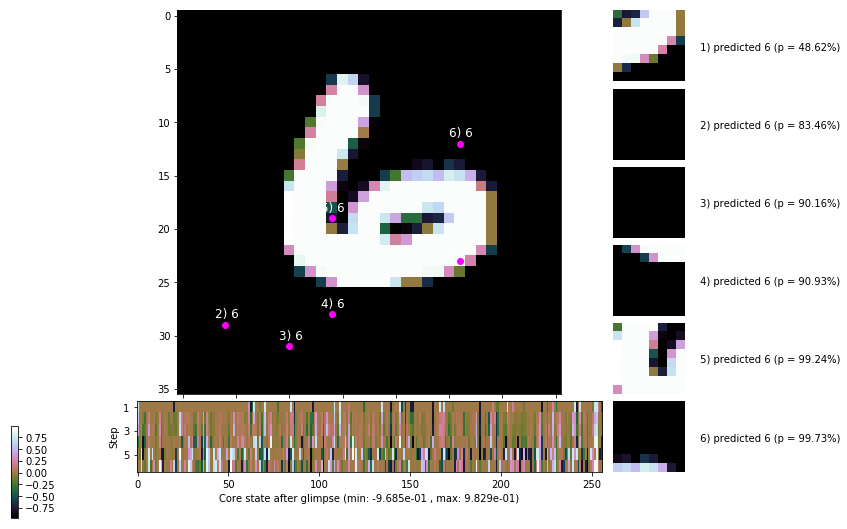

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


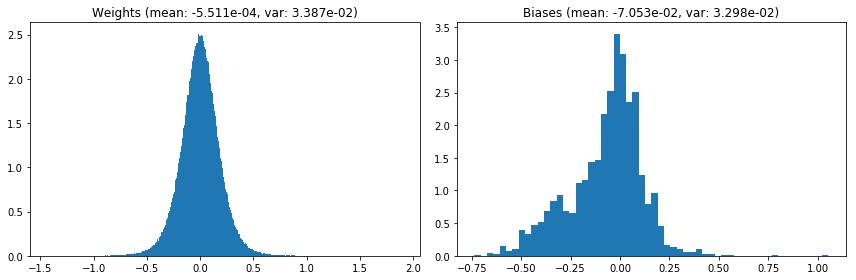

                                      Location network weights and biases


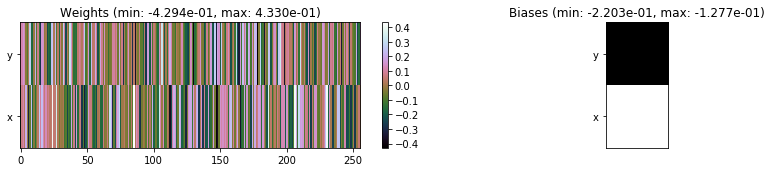

---------------------------------------------------------------------------------------------------------------
Elapsed time:  431.80 sec | TRAIN >> class loss: 0.5691 | steps:  2.587    | reward:  3.7829    | acc.: 80.765% 
                          | VAL   >> class loss: 0.5632 | steps:  2.462    | reward:  3.9217    | acc.: 80.080% :(


Epoch  10/400) lr = 0.0008737
 b    300/  3000 >> 143.9 ms/b | lr: 8.73e-04 | grad 2norm: 13.52 | grad inf norm:  3.580
         Weights || abs max:  1.90 ( 3570.89) | mean: -5.56e-04 ( 0.02) | var: 3.40e-02 (  375.66)
          Biases || abs max:  1.05 (  178.84) | mean: -7.08e-02 ( 0.15) | var: 3.31e-02 (  664.51)
                    class loss: 0.593 | steps: 2.611 | reward:  3.760 | acc.: 80.32%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.6 ms/b | lr: 8.72e-04 | grad 2norm: 13.36 | grad inf norm:  3.422
         Weights || abs max:  1.90 ( 5514.25) | mean: -5.80e-04 ( 0

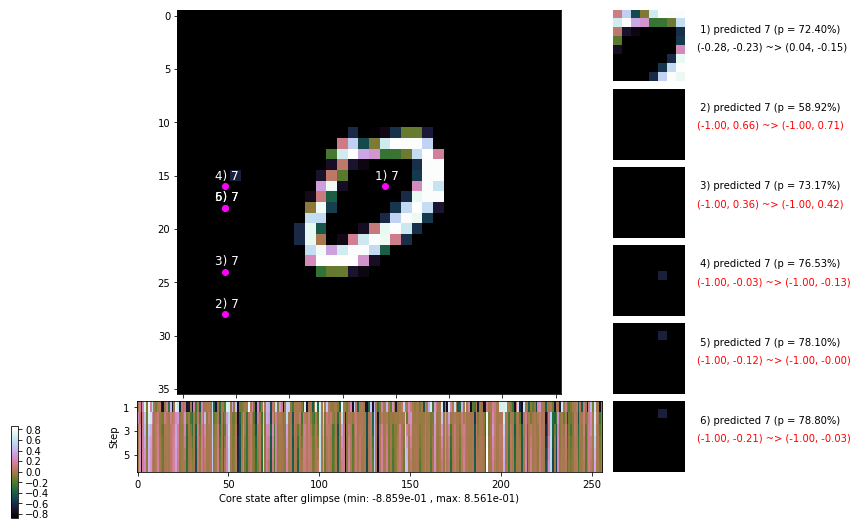

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.0 ms/b | lr: 8.70e-04 | grad 2norm: 13.43 | grad inf norm:  3.565
         Weights || abs max:  1.91 ( 2834.70) | mean: -5.68e-04 ( 0.01) | var: 3.44e-02 (  185.89)
          Biases || abs max:  1.05 ( 1222.72) | mean: -7.11e-02 ( 0.99) | var: 3.37e-02 (289986.16)
                    class loss: 0.582 | steps: 2.564 | reward:  3.804 | acc.: 80.73%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 142.3 ms/b | lr: 8.69e-04 | grad 2norm: 13.48 | grad inf norm:  3.470
         Weights || abs max:  1.91 (16582.49) | mean: -5.74e-04 ( 0.04) | var: 3.46e-02 (65347.17)
          Biases || abs max:  1.05 (  129.45) | mean: -7.16e-02 ( 0.13) | var: 3.40e-02 (   62.14)
                    class loss: 0.568 | steps: 2.589 | reward:  3.782 | acc.: 80.50%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.

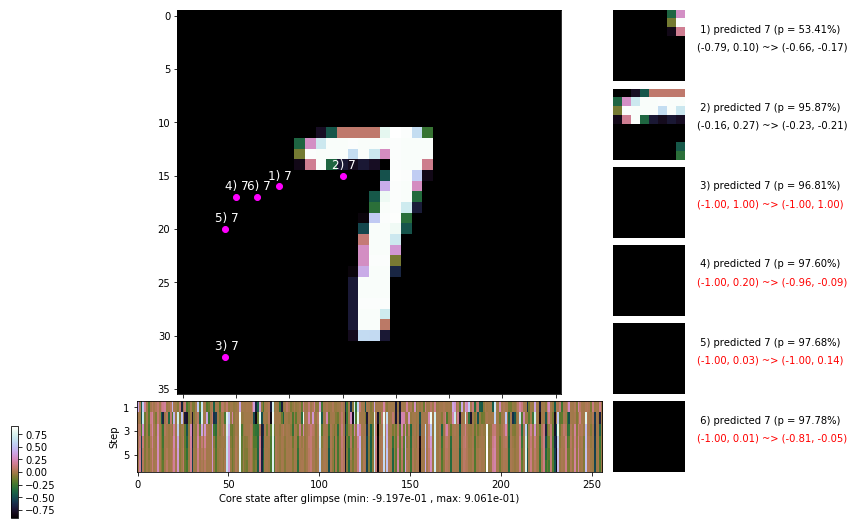

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 144.0 ms/b | lr: 8.68e-04 | grad 2norm: 13.37 | grad inf norm:  3.432
         Weights || abs max:  1.93 ( 3470.47) | mean: -5.86e-04 ( 0.02) | var: 3.48e-02 (  182.69)
          Biases || abs max:  1.05 (  200.01) | mean: -7.19e-02 ( 0.16) | var: 3.42e-02 (  526.21)
                    class loss: 0.573 | steps: 2.588 | reward:  3.763 | acc.: 80.68%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.2 ms/b | lr: 8.67e-04 | grad 2norm: 13.49 | grad inf norm:  3.606
         Weights || abs max:  1.93 ( 7206.71) | mean: -5.79e-04 ( 0.02) | var: 3.50e-02 ( 8362.25)
          Biases || abs max:  1.05 (  135.73) | mean: -7.24e-02 ( 0.13) | var: 3.44e-02 (  285.62)
                    class loss: 0.565 | steps: 2.554 | reward:  3.814 | acc.: 80.65%

	Target class: 2 | Discounted rewards: [-0.094, 0.012, 0.

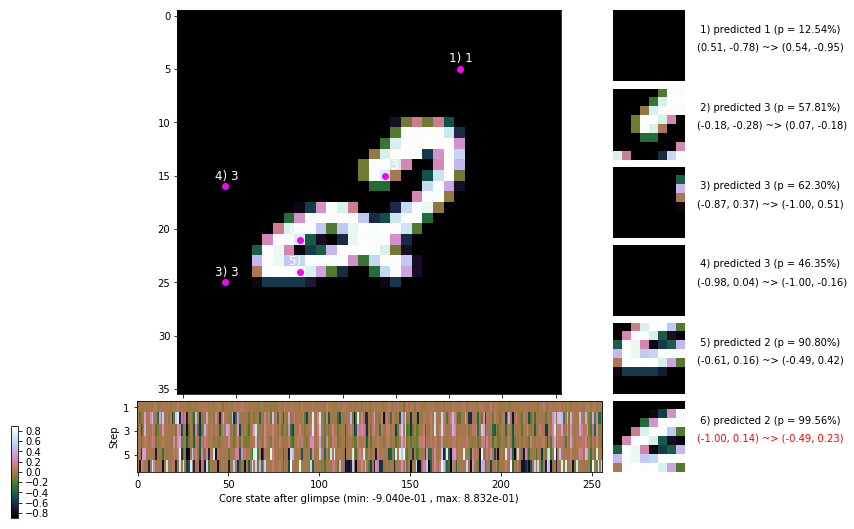

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 143.6 ms/b | lr: 8.65e-04 | grad 2norm: 13.45 | grad inf norm:  3.403
         Weights || abs max:  1.92 ( 3642.35) | mean: -5.68e-04 ( 0.02) | var: 3.53e-02 (  493.56)
          Biases || abs max:  1.05 (  151.07) | mean: -7.30e-02 ( 0.12) | var: 3.47e-02 (  622.24)
                    class loss: 0.557 | steps: 2.559 | reward:  3.799 | acc.: 80.82%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 142.2 ms/b | lr: 8.64e-04 | grad 2norm: 13.70 | grad inf norm:  3.577
         Weights || abs max:  1.92 ( 3878.46) | mean: -5.86e-04 ( 0.02) | var: 3.55e-02 (  324.24)
          Biases || abs max:  1.05 (   95.36) | mean: -7.32e-02 ( 0.11) | var: 3.50e-02 (   74.60)
                    class loss: 0.608 | steps: 2.584 | reward:  3.763 | acc.: 79.20%

	Target class: 4 | Discounted rewards: [0.662, 1.525, 1.0

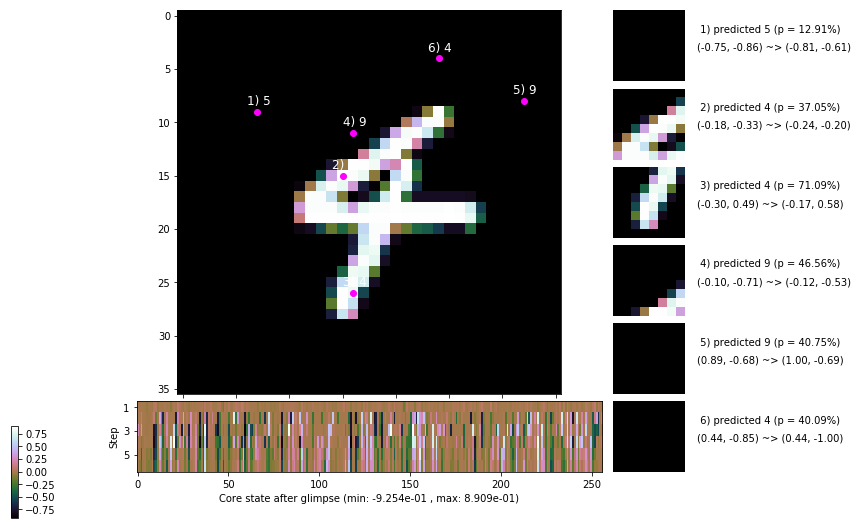

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 144.6 ms/b | lr: 8.62e-04 | grad 2norm: 13.76 | grad inf norm:  3.733
         Weights || abs max:  1.94 ( 5238.73) | mean: -5.90e-04 ( 0.02) | var: 3.57e-02 ( 2896.86)
          Biases || abs max:  1.04 (  134.30) | mean: -7.36e-02 ( 0.13) | var: 3.51e-02 (   91.14)
                    class loss: 0.606 | steps: 2.609 | reward:  3.741 | acc.: 79.77%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.2 ms/b | lr: 8.62e-04 | grad 2norm: 13.41 | grad inf norm:  3.428
         Weights || abs max:  1.95 ( 7478.41) | mean: -5.46e-04 ( 0.02) | var: 3.59e-02 ( 4694.62)
          Biases || abs max:  1.04 (   87.28) | mean: -7.42e-02 ( 0.11) | var: 3.54e-02 (   27.84)
                    class loss: 0.583 | steps: 2.573 | reward:  3.791 | acc.: 79.98%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

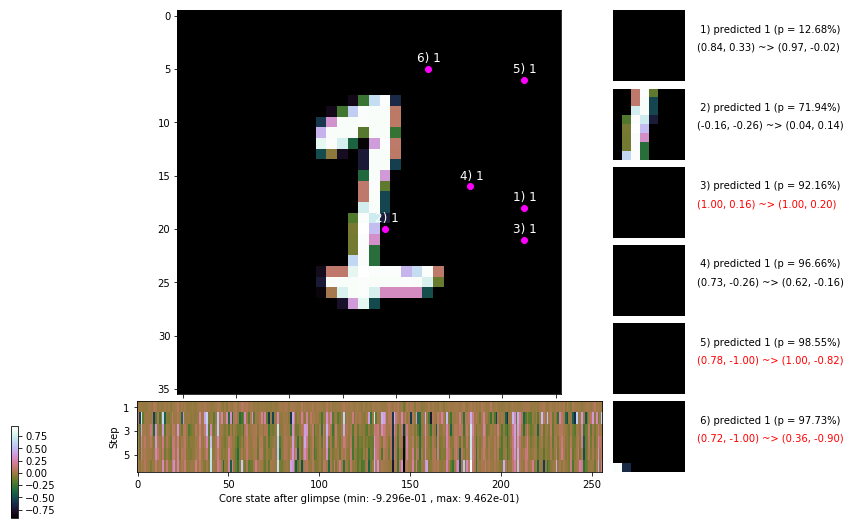

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.112, 0.425, 1.050, 0.100, 0.400, 1.000]


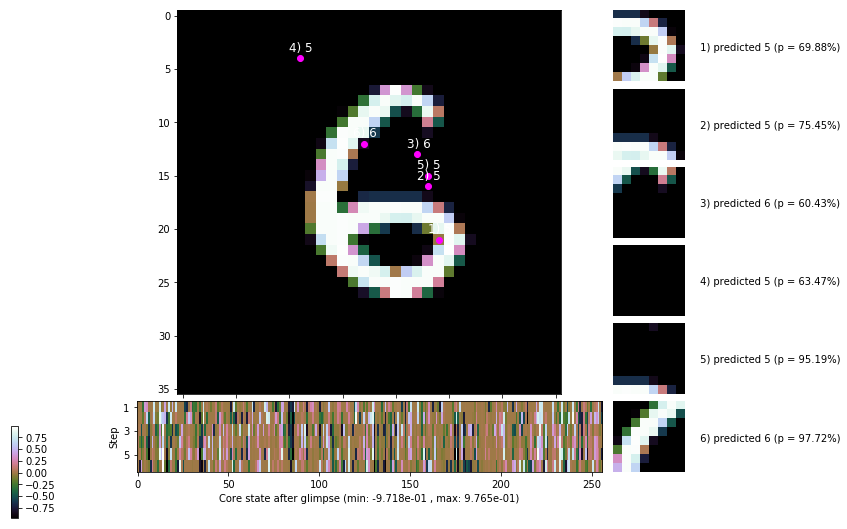


	Target class: 9 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


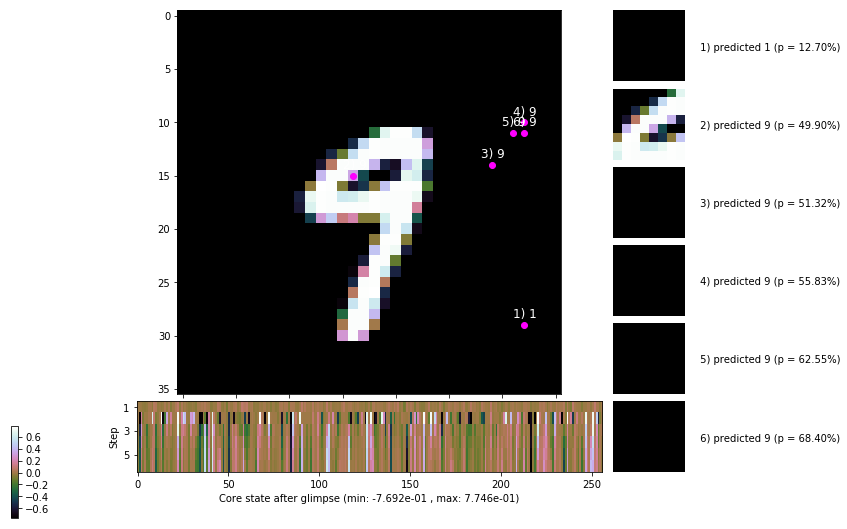

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


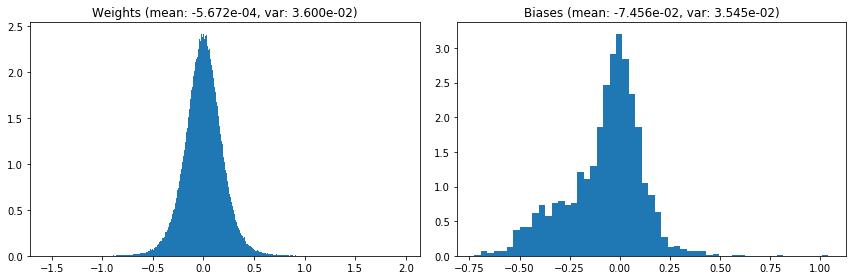

                                      Location network weights and biases


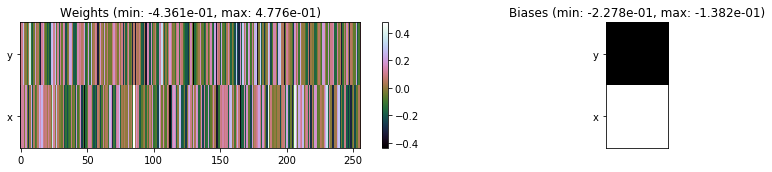

---------------------------------------------------------------------------------------------------------------
Elapsed time:  431.03 sec | TRAIN >> class loss: 0.5819 | steps:  2.578    | reward:  3.7800 :( | acc.: 80.252% :(
                          | VAL   >> class loss: 0.6051 | steps:  2.522 :( | reward:  3.8348 :( | acc.: 78.980% :(


Epoch  11/400) lr = 0.0008606
 b    300/  3000 >> 143.4 ms/b | lr: 8.60e-04 | grad 2norm: 13.56 | grad inf norm:  3.493
         Weights || abs max:  1.97 ( 5503.39) | mean: -6.02e-04 ( 0.02) | var: 3.61e-02 ( 2637.92)
          Biases || abs max:  1.05 (  112.76) | mean: -7.45e-02 ( 0.11) | var: 3.55e-02 (   65.26)
                    class loss: 0.578 | steps: 2.596 | reward:  3.782 | acc.: 80.33%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 140.5 ms/b | lr: 8.59e-04 | grad 2norm: 13.46 | grad inf norm:  3.266
         Weights || abs max:  1.98 ( 2605.52) | mean: -5.96e-04 (

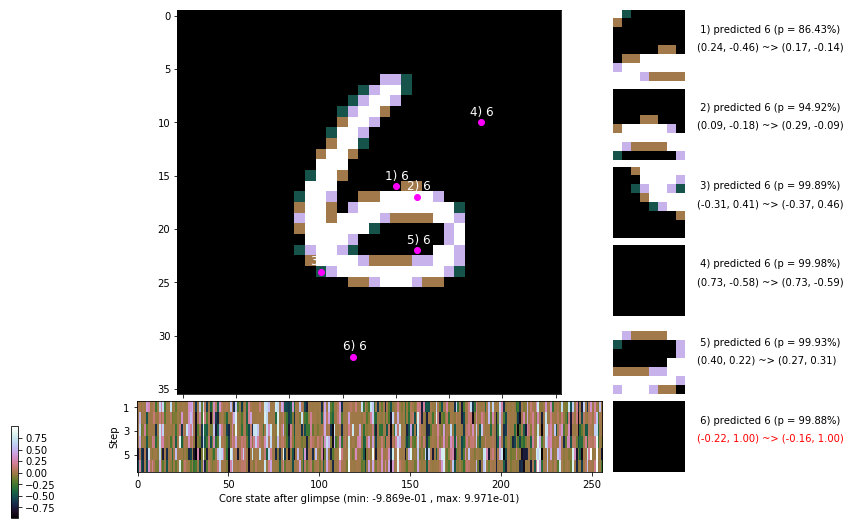

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.0 ms/b | lr: 8.57e-04 | grad 2norm: 13.52 | grad inf norm:  3.416
         Weights || abs max:  2.00 ( 3621.90) | mean: -5.60e-04 ( 0.02) | var: 3.65e-02 (  326.79)
          Biases || abs max:  1.05 (  146.51) | mean: -7.56e-02 ( 0.14) | var: 3.64e-02 (  271.21)
                    class loss: 0.573 | steps: 2.558 | reward:  3.794 | acc.: 80.10%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 142.7 ms/b | lr: 8.56e-04 | grad 2norm: 13.51 | grad inf norm:  3.536
         Weights || abs max:  2.00 ( 4764.06) | mean: -5.73e-04 ( 0.02) | var: 3.67e-02 ( 1775.61)
          Biases || abs max:  1.05 (  119.24) | mean: -7.63e-02 ( 0.12) | var: 3.67e-02 (   80.96)
                    class loss: 0.596 | steps: 2.579 | reward:  3.768 | acc.: 80.05%

	Target class: 0 | Discounted rewards: [-0.059, 0.081, 0.

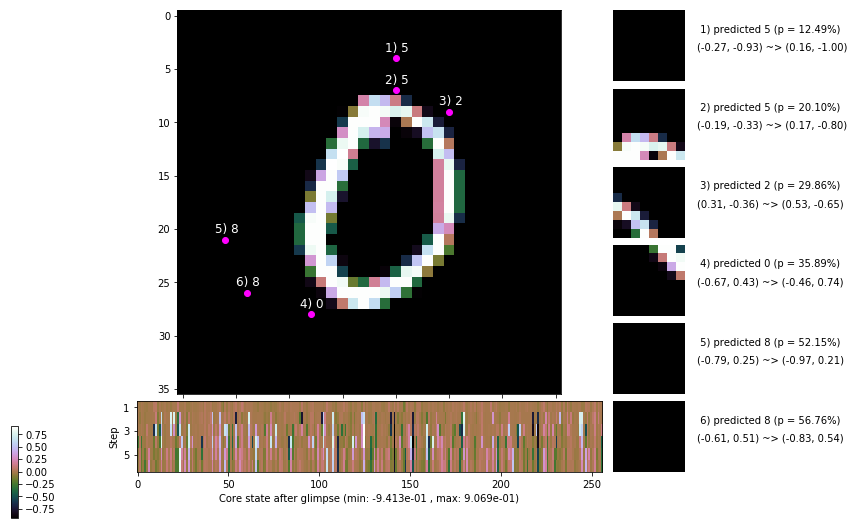

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.5 ms/b | lr: 8.55e-04 | grad 2norm: 13.55 | grad inf norm:  3.409
         Weights || abs max:  2.02 ( 2999.59) | mean: -5.79e-04 ( 0.02) | var: 3.69e-02 (  228.32)
          Biases || abs max:  1.05 (  173.31) | mean: -7.65e-02 ( 0.18) | var: 3.69e-02 ( 3027.42)
                    class loss: 0.555 | steps: 2.534 | reward:  3.852 | acc.: 81.22%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 143.6 ms/b | lr: 8.54e-04 | grad 2norm: 13.35 | grad inf norm:  3.494
         Weights || abs max:  2.04 ( 4229.72) | mean: -6.06e-04 ( 0.02) | var: 3.71e-02 ( 1246.11)
          Biases || abs max:  1.05 (  123.12) | mean: -7.67e-02 ( 0.13) | var: 3.70e-02 (   72.67)
                    class loss: 0.590 | steps: 2.607 | reward:  3.777 | acc.: 80.58%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

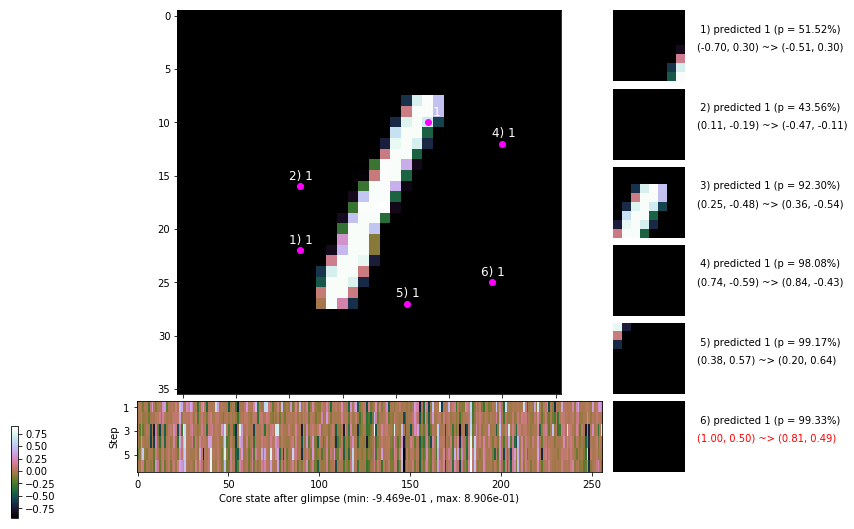

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.0 ms/b | lr: 8.52e-04 | grad 2norm: 13.56 | grad inf norm:  3.419
         Weights || abs max:  2.05 ( 4252.44) | mean: -6.25e-04 ( 0.02) | var: 3.73e-02 ( 3074.14)
          Biases || abs max:  1.06 (  122.36) | mean: -7.69e-02 ( 0.13) | var: 3.73e-02 (  237.81)
                    class loss: 0.537 | steps: 2.538 | reward:  3.861 | acc.: 81.73%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 142.9 ms/b | lr: 8.51e-04 | grad 2norm: 13.65 | grad inf norm:  3.420
         Weights || abs max:  2.07 ( 2558.62) | mean: -6.39e-04 ( 0.01) | var: 3.75e-02 (   55.65)
          Biases || abs max:  1.07 (  276.58) | mean: -7.74e-02 ( 0.21) | var: 3.75e-02 ( 1999.63)
                    class loss: 0.546 | steps: 2.558 | reward:  3.818 | acc.: 81.68%

	Target class: 9 | Discounted rewards: [0.869, 1.938, 1.8

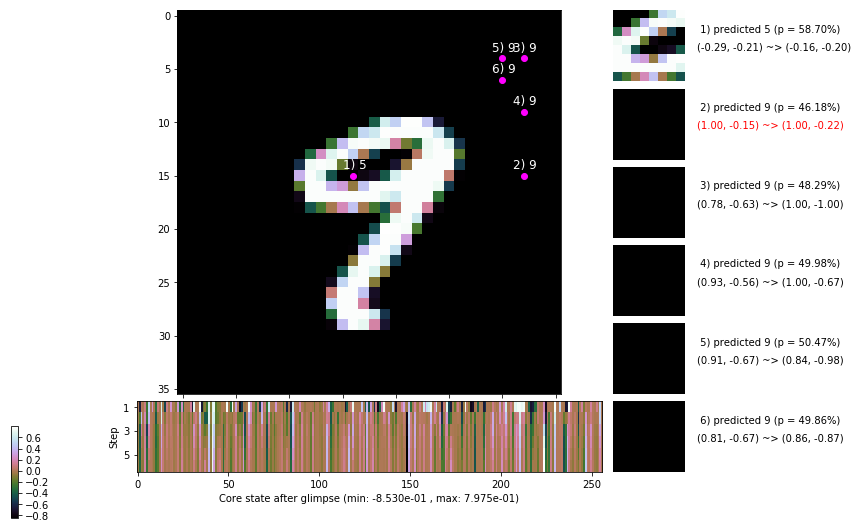

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 144.7 ms/b | lr: 8.50e-04 | grad 2norm: 13.55 | grad inf norm:  3.411
         Weights || abs max:  2.09 ( 3118.95) | mean: -6.48e-04 ( 0.02) | var: 3.76e-02 (  256.67)
          Biases || abs max:  1.06 (  980.29) | mean: -7.82e-02 ( 0.74) | var: 3.75e-02 (128838.03)
                    class loss: 0.536 | steps: 2.558 | reward:  3.850 | acc.: 82.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.0 ms/b | lr: 8.49e-04 | grad 2norm: 13.60 | grad inf norm:  3.342
         Weights || abs max:  2.09 ( 2812.40) | mean: -6.58e-04 ( 0.01) | var: 3.78e-02 (  134.71)
          Biases || abs max:  1.07 (  137.03) | mean: -7.88e-02 ( 0.12) | var: 3.75e-02 (  176.80)
                    class loss: 0.531 | steps: 2.553 | reward:  3.872 | acc.: 82.65%

	Target class: 9 | Discounted rewards: [-0.197, -0.194, 

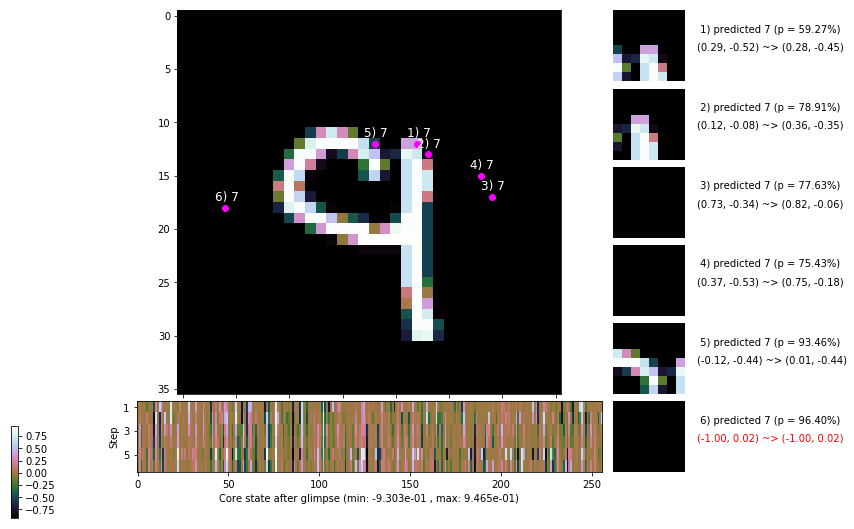

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


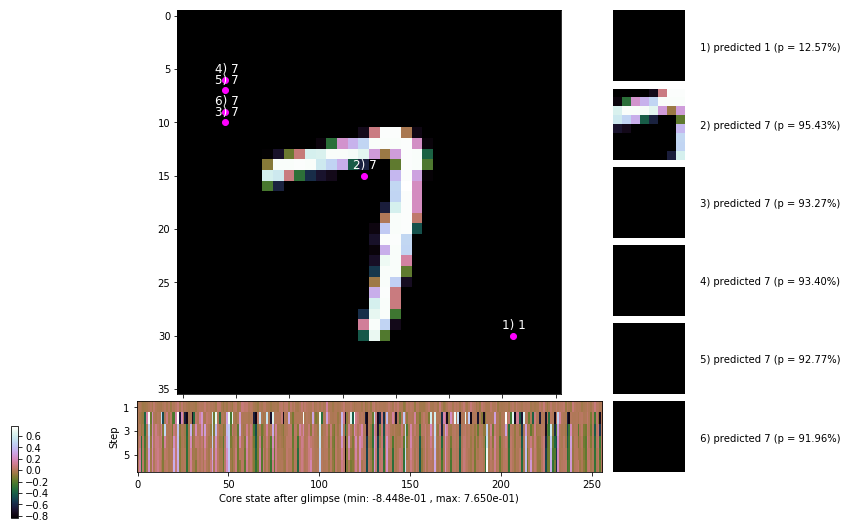


	Target class: 2 | Discounted rewards: [0.319, 0.837, 1.875, 1.750, 1.500, 1.000]


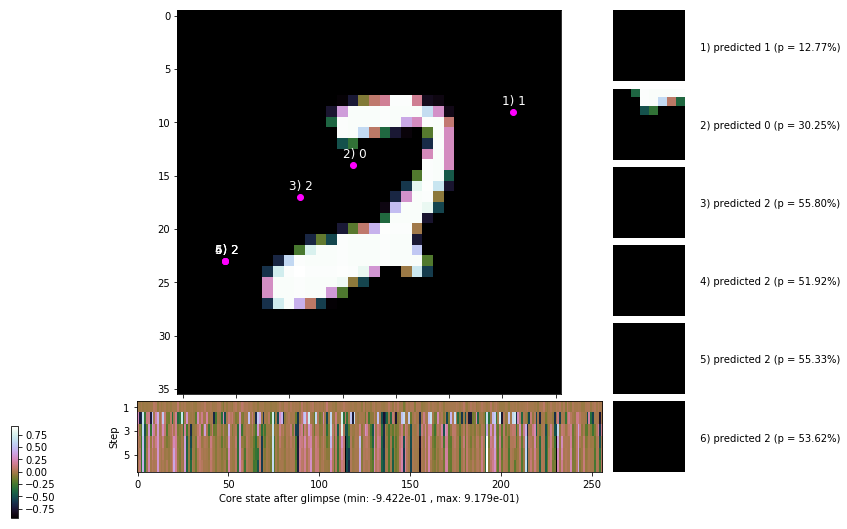

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


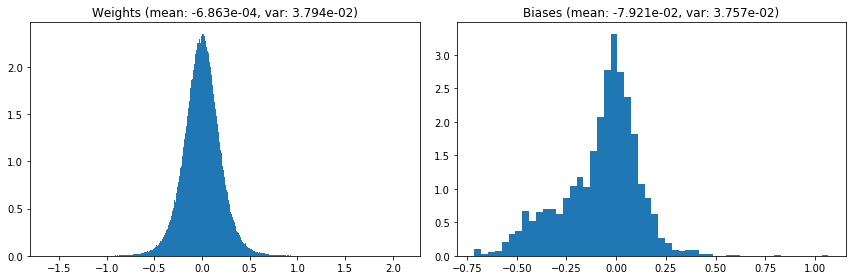

                                      Location network weights and biases


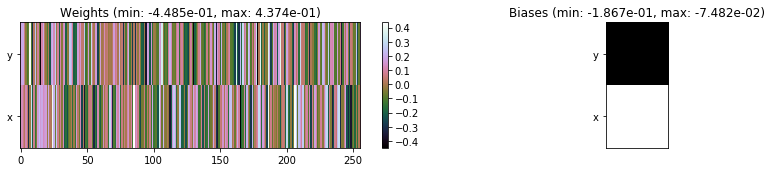

---------------------------------------------------------------------------------------------------------------
Elapsed time:  431.69 sec | TRAIN >> class loss: 0.5639 | steps:  2.567    | reward:  3.8132    | acc.: 80.998% 
                          | VAL   >> class loss: 0.5317 | steps:  2.452    | reward:  3.9646    | acc.: 81.580% 


Epoch  12/400) lr = 0.0008478
 b    300/  3000 >> 142.6 ms/b | lr: 8.47e-04 | grad 2norm: 13.52 | grad inf norm:  3.391
         Weights || abs max:  2.09 ( 6639.48) | mean: -6.88e-04 ( 0.02) | var: 3.80e-02 ( 3483.15)
          Biases || abs max:  1.07 (   94.24) | mean: -7.94e-02 ( 0.10) | var: 3.78e-02 (   57.85)
                    class loss: 0.527 | steps: 2.529 | reward:  3.884 | acc.: 82.20%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.9 ms/b | lr: 8.46e-04 | grad 2norm: 13.51 | grad inf norm:  3.410
         Weights || abs max:  2.08 ( 2624.70) | mean: -6.94e-04 ( 0.0

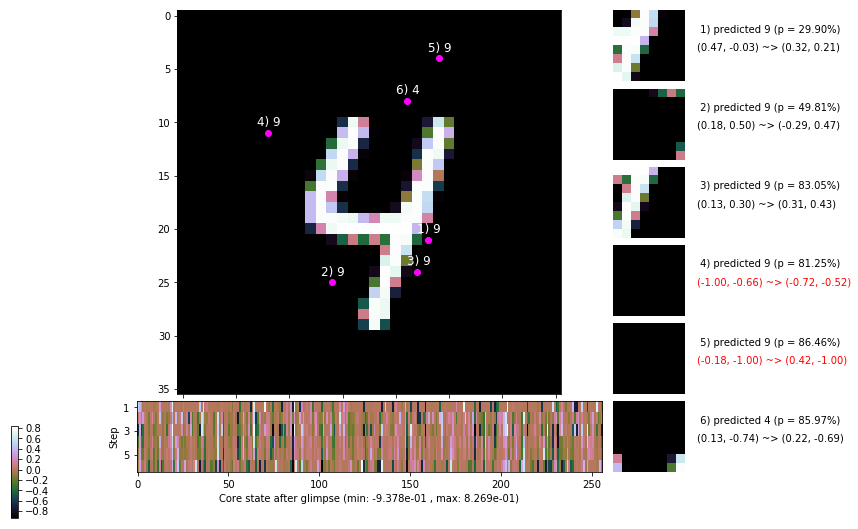

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.7 ms/b | lr: 8.44e-04 | grad 2norm: 13.37 | grad inf norm:  3.209
         Weights || abs max:  2.10 (     inf) | mean: -6.96e-04 (  inf) | var: 3.84e-02 (     nan)
          Biases || abs max:  1.08 (  101.29) | mean: -8.04e-02 ( 0.11) | var: 3.85e-02 (   52.27)
                    class loss: 0.501 | steps: 2.508 | reward:  3.907 | acc.: 83.38%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 142.1 ms/b | lr: 8.44e-04 | grad 2norm: 13.12 | grad inf norm:  3.271
         Weights || abs max:  2.11 ( 3092.40) | mean: -6.93e-04 ( 0.02) | var: 3.86e-02 (  226.72)
          Biases || abs max:  1.09 (   82.99) | mean: -8.08e-02 ( 0.10) | var: 3.85e-02 (   38.51)
                    class loss: 0.479 | steps: 2.480 | reward:  3.970 | acc.: 84.00%

	Target class: 2 | Discounted rewards: [0.869, 1.938, 1.8

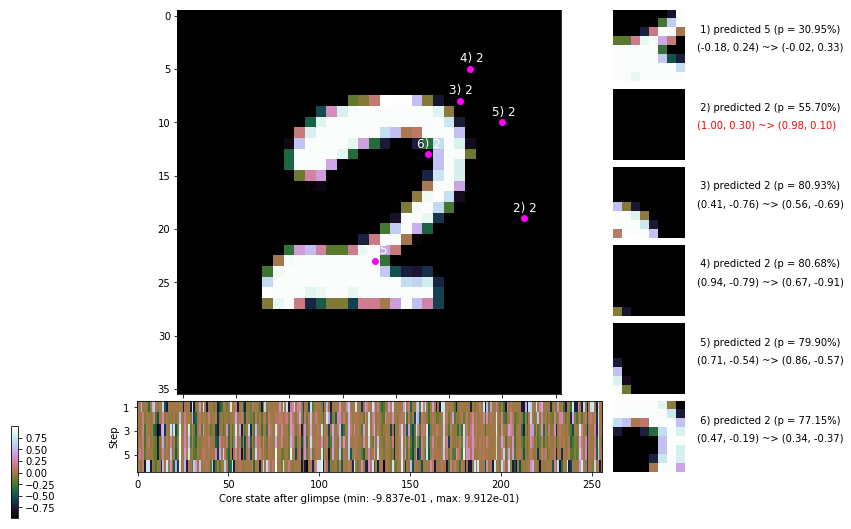

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.4 ms/b | lr: 8.42e-04 | grad 2norm: 13.52 | grad inf norm:  3.378
         Weights || abs max:  2.10 ( 5296.14) | mean: -6.94e-04 ( 0.02) | var: 3.88e-02 ( 2381.81)
          Biases || abs max:  1.09 (  198.44) | mean: -8.07e-02 ( 0.14) | var: 3.86e-02 ( 1141.39)
                    class loss: 0.517 | steps: 2.513 | reward:  3.889 | acc.: 82.57%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 143.2 ms/b | lr: 8.41e-04 | grad 2norm: 13.48 | grad inf norm:  3.423
         Weights || abs max:  2.12 ( 3962.06) | mean: -6.86e-04 ( 0.02) | var: 3.90e-02 (  695.59)
          Biases || abs max:  1.08 (   73.35) | mean: -8.15e-02 ( 0.09) | var: 3.88e-02 (   48.07)
                    class loss: 0.538 | steps: 2.550 | reward:  3.848 | acc.: 81.52%

	Target class: 5 | Discounted rewards: [0.869, 1.938, 1.8

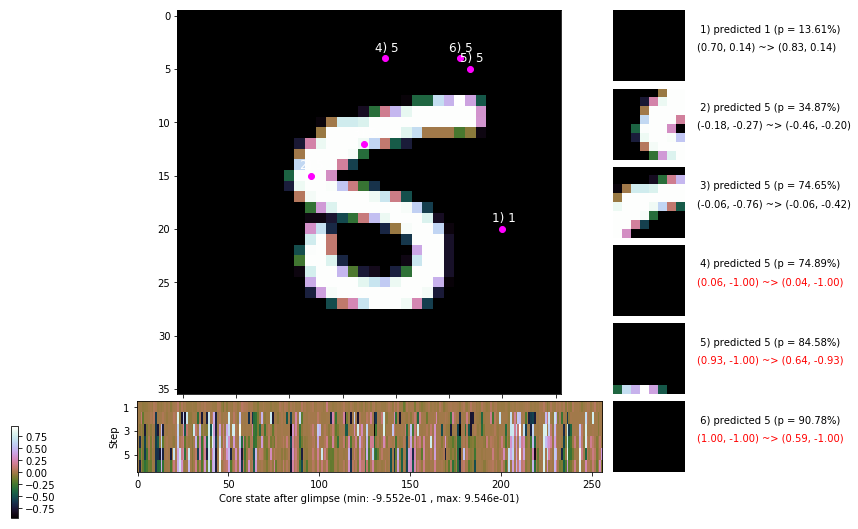

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 145.3 ms/b | lr: 8.39e-04 | grad 2norm: 13.18 | grad inf norm:  3.325
         Weights || abs max:  2.14 ( 3808.74) | mean: -6.66e-04 ( 0.02) | var: 3.91e-02 (  612.68)
          Biases || abs max:  1.08 (  196.35) | mean: -8.18e-02 ( 0.14) | var: 3.92e-02 (  482.57)
                    class loss: 0.509 | steps: 2.544 | reward:  3.862 | acc.: 82.45%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 142.4 ms/b | lr: 8.39e-04 | grad 2norm: 13.21 | grad inf norm:  3.331
         Weights || abs max:  2.15 ( 2807.04) | mean: -6.71e-04 ( 0.02) | var: 3.93e-02 (   88.30)
          Biases || abs max:  1.08 (   65.41) | mean: -8.20e-02 ( 0.08) | var: 3.95e-02 (   23.94)
                    class loss: 0.516 | steps: 2.516 | reward:  3.885 | acc.: 82.77%

	Target class: 0 | Discounted rewards: [1.419, 0.837, 1.8

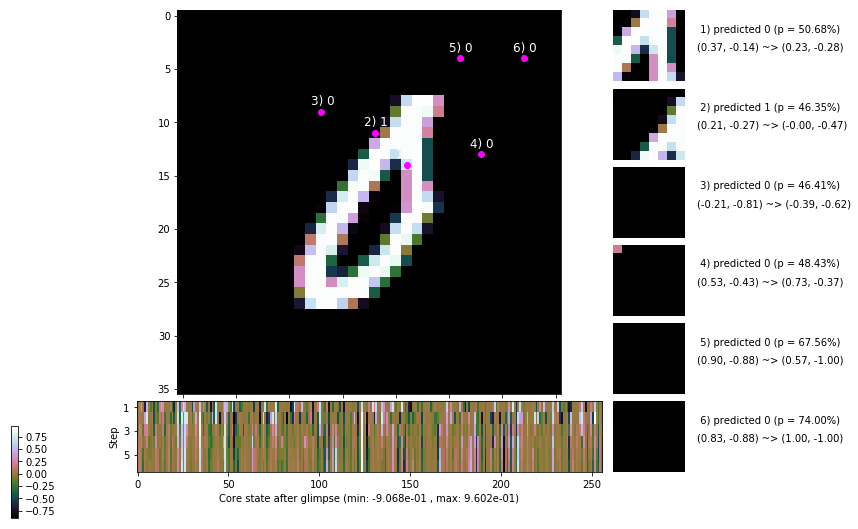

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.9 ms/b | lr: 8.37e-04 | grad 2norm: 13.27 | grad inf norm:  3.443
         Weights || abs max:  2.16 ( 2907.07) | mean: -6.73e-04 ( 0.02) | var: 3.95e-02 (  281.85)
          Biases || abs max:  1.08 (   71.75) | mean: -8.24e-02 ( 0.09) | var: 3.98e-02 (   22.34)
                    class loss: 0.539 | steps: 2.535 | reward:  3.862 | acc.: 82.10%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.6 ms/b | lr: 8.36e-04 | grad 2norm: 13.12 | grad inf norm:  3.246
         Weights || abs max:  2.17 ( 5321.92) | mean: -6.55e-04 ( 0.02) | var: 3.97e-02 ( 1137.79)
          Biases || abs max:  1.08 (   73.49) | mean: -8.23e-02 ( 0.09) | var: 4.00e-02 (   31.63)
                    class loss: 0.504 | steps: 2.521 | reward:  3.893 | acc.: 83.10%

	Target class: 4 | Discounted rewards: [0.009, 0.219, 0.6

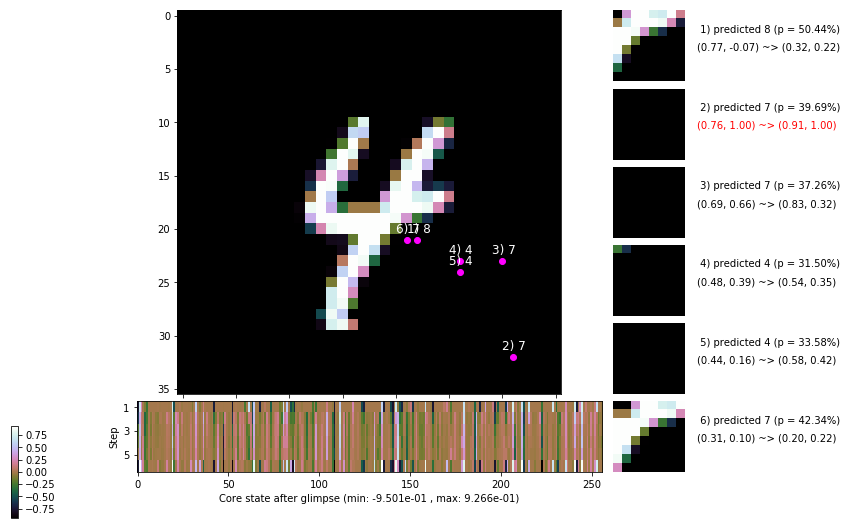

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


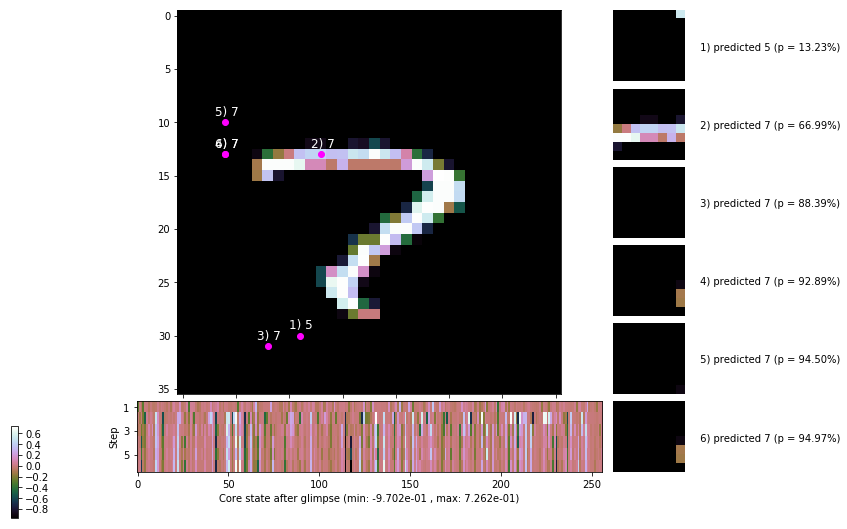


	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


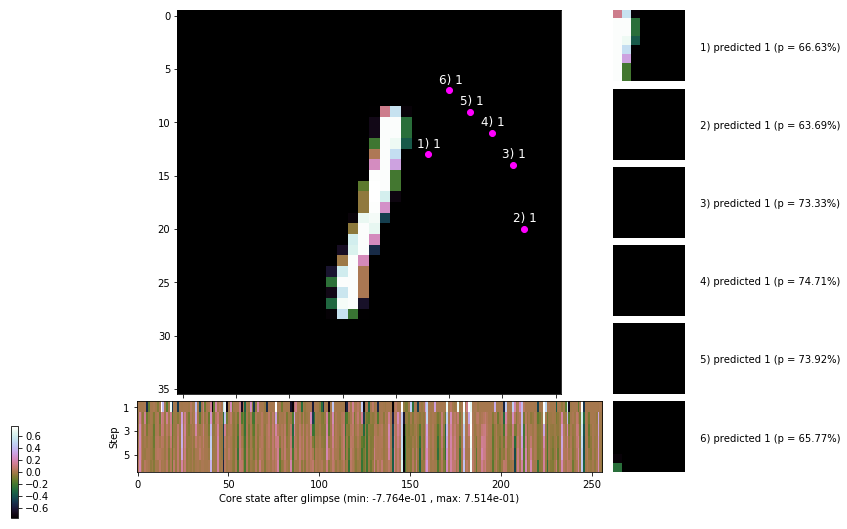

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


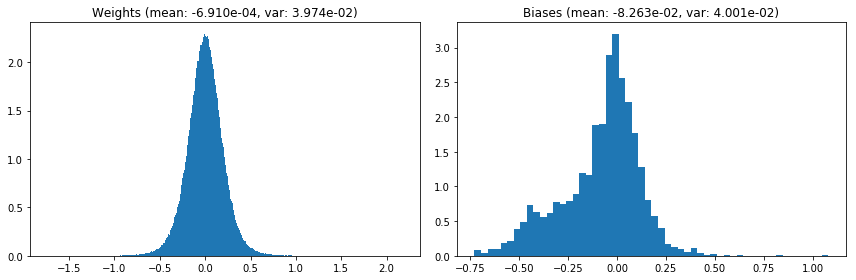

                                      Location network weights and biases


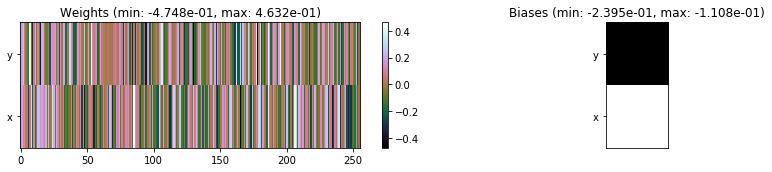

---------------------------------------------------------------------------------------------------------------
Elapsed time:  430.33 sec | TRAIN >> class loss: 0.5129 | steps:  2.519    | reward:  3.8917    | acc.: 82.750% 
                          | VAL   >> class loss: 0.4757 | steps:  2.390    | reward:  4.0653    | acc.: 84.220% 


Epoch  13/400) lr = 0.0008352
 b    300/  3000 >> 142.5 ms/b | lr: 8.34e-04 | grad 2norm: 13.07 | grad inf norm:  3.315
         Weights || abs max:  2.18 ( 2224.57) | mean: -7.16e-04 ( 0.01) | var: 3.98e-02 (  174.72)
          Biases || abs max:  1.08 (  151.90) | mean: -8.34e-02 ( 0.13) | var: 4.02e-02 (  506.46)
                    class loss: 0.469 | steps: 2.473 | reward:  3.956 | acc.: 84.52%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 141.5 ms/b | lr: 8.34e-04 | grad 2norm: 13.07 | grad inf norm:  3.440
         Weights || abs max:  2.19 ( 2878.87) | mean: -7.06e-04 ( 0.0

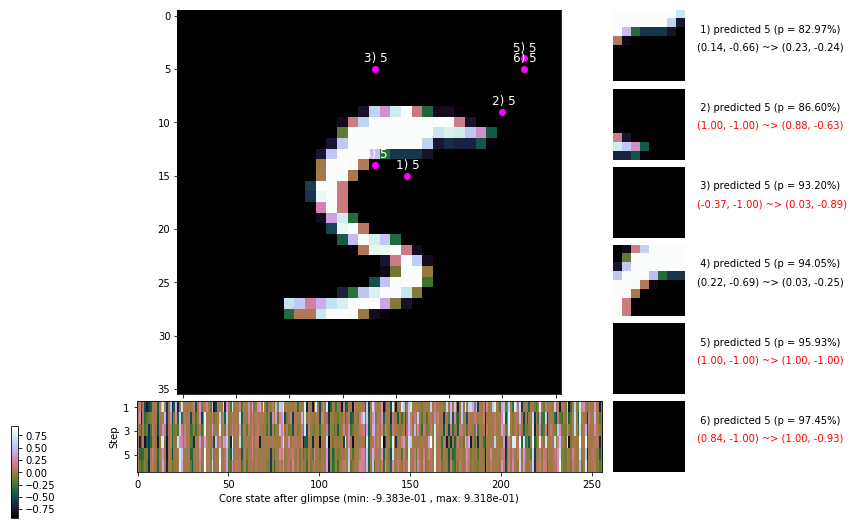

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 147.2 ms/b | lr: 8.32e-04 | grad 2norm: 13.20 | grad inf norm:  3.291
         Weights || abs max:  2.19 ( 2666.30) | mean: -6.96e-04 ( 0.02) | var: 4.02e-02 (  192.09)
          Biases || abs max:  1.09 (  170.92) | mean: -8.33e-02 ( 0.14) | var: 4.06e-02 (  652.04)
                    class loss: 0.501 | steps: 2.525 | reward:  3.913 | acc.: 83.08%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 142.9 ms/b | lr: 8.31e-04 | grad 2norm: 13.17 | grad inf norm:  3.301
         Weights || abs max:  2.19 ( 2966.23) | mean: -7.25e-04 ( 0.02) | var: 4.04e-02 (  229.35)
          Biases || abs max:  1.09 (   94.04) | mean: -8.35e-02 ( 0.10) | var: 4.10e-02 (   48.96)
                    class loss: 0.516 | steps: 2.524 | reward:  3.894 | acc.: 83.00%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

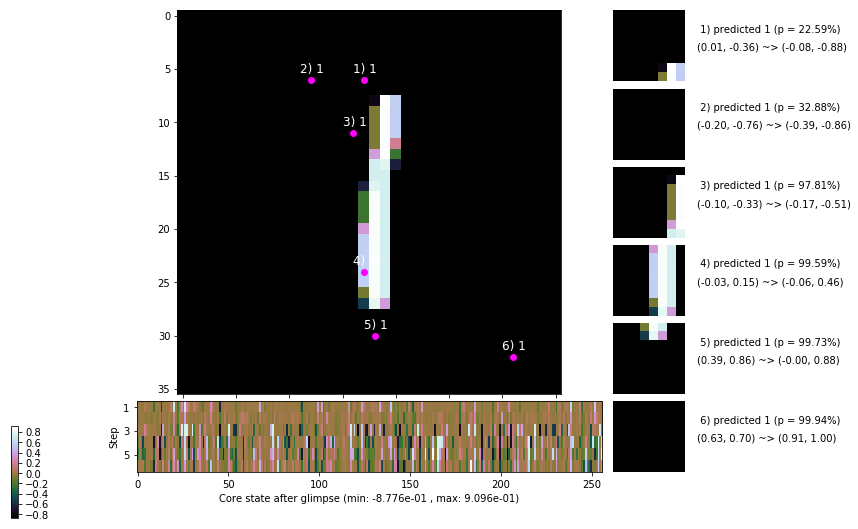

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 145.4 ms/b | lr: 8.29e-04 | grad 2norm: 13.07 | grad inf norm:  3.413
         Weights || abs max:  2.21 ( 2154.27) | mean: -7.72e-04 ( 0.01) | var: 4.06e-02 (   70.20)
          Biases || abs max:  1.09 (   62.86) | mean: -8.38e-02 ( 0.08) | var: 4.13e-02 (   20.96)
                    class loss: 0.495 | steps: 2.511 | reward:  3.920 | acc.: 82.85%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 144.4 ms/b | lr: 8.29e-04 | grad 2norm: 13.25 | grad inf norm:  3.414
         Weights || abs max:  2.23 ( 3722.08) | mean: -7.69e-04 ( 0.02) | var: 4.08e-02 (  512.67)
          Biases || abs max:  1.09 (   87.71) | mean: -8.46e-02 ( 0.09) | var: 4.17e-02 (   75.61)
                    class loss: 0.532 | steps: 2.573 | reward:  3.820 | acc.: 82.23%

	Target class: 6 | Discounted rewards: [0.319, 0.837, 1.8

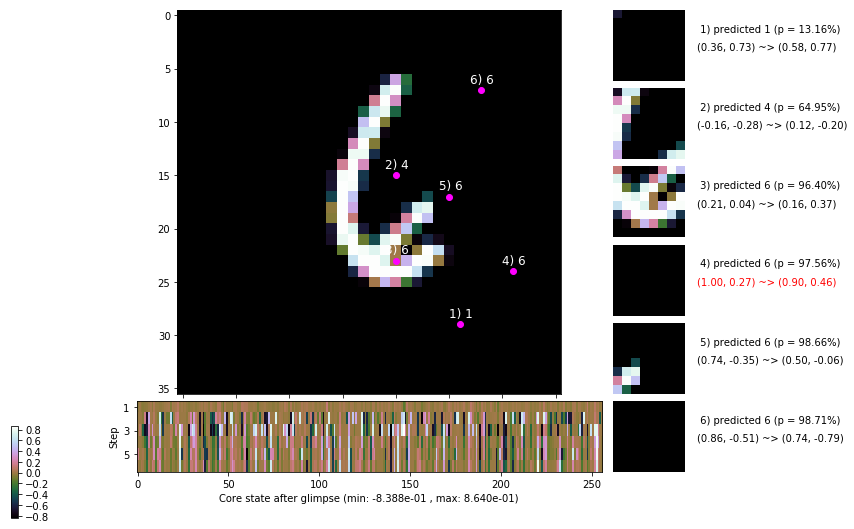

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 143.4 ms/b | lr: 8.27e-04 | grad 2norm: 13.16 | grad inf norm:  3.257
         Weights || abs max:  2.24 ( 9697.08) | mean: -7.97e-04 ( 0.03) | var: 4.09e-02 (22483.20)
          Biases || abs max:  1.09 (  143.48) | mean: -8.46e-02 ( 0.12) | var: 4.18e-02 (  210.84)
                    class loss: 0.498 | steps: 2.478 | reward:  3.937 | acc.: 83.10%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 143.6 ms/b | lr: 8.26e-04 | grad 2norm: 13.06 | grad inf norm:  3.392
         Weights || abs max:  2.25 ( 6573.73) | mean: -7.86e-04 ( 0.02) | var: 4.11e-02 ( 2081.99)
          Biases || abs max:  1.09 (  113.00) | mean: -8.44e-02 ( 0.10) | var: 4.20e-02 (   74.81)
                    class loss: 0.513 | steps: 2.531 | reward:  3.885 | acc.: 82.62%

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.8

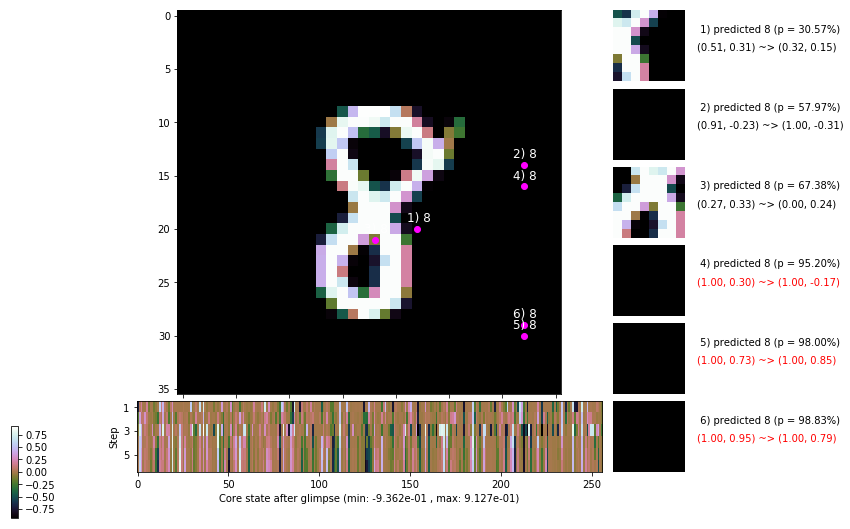

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.5 ms/b | lr: 8.24e-04 | grad 2norm: 13.20 | grad inf norm:  3.462
         Weights || abs max:  2.27 ( 3301.45) | mean: -8.15e-04 ( 0.02) | var: 4.13e-02 (  169.16)
          Biases || abs max:  1.09 (   44.62) | mean: -8.53e-02 ( 0.07) | var: 4.23e-02 (    8.89)
                    class loss: 0.533 | steps: 2.543 | reward:  3.850 | acc.: 81.98%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.7 ms/b | lr: 8.24e-04 | grad 2norm: 13.04 | grad inf norm:  3.226
         Weights || abs max:  2.29 ( 7947.83) | mean: -8.26e-04 ( 0.03) | var: 4.15e-02 ( 2466.26)
          Biases || abs max:  1.09 (   82.66) | mean: -8.60e-02 ( 0.09) | var: 4.26e-02 (   40.32)
                    class loss: 0.512 | steps: 2.475 | reward:  3.938 | acc.: 82.85%

	Target class: 4 | Discounted rewards: [0.044, 0.287, 0.7

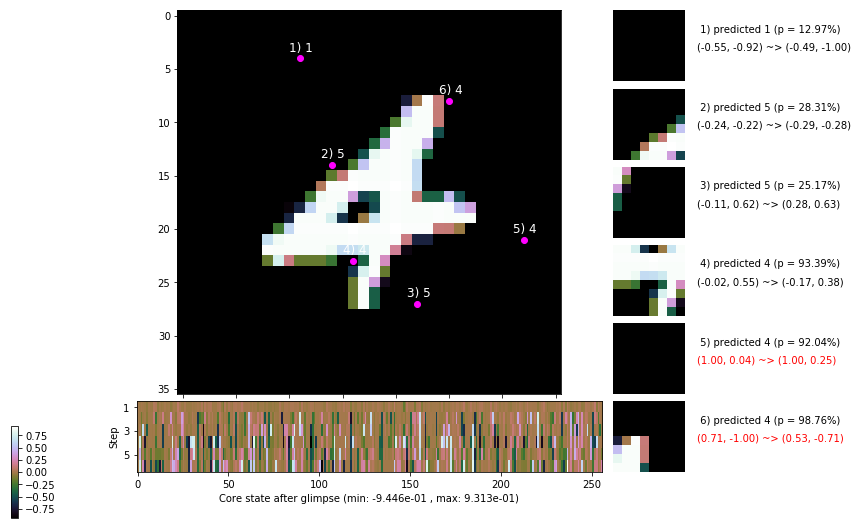

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


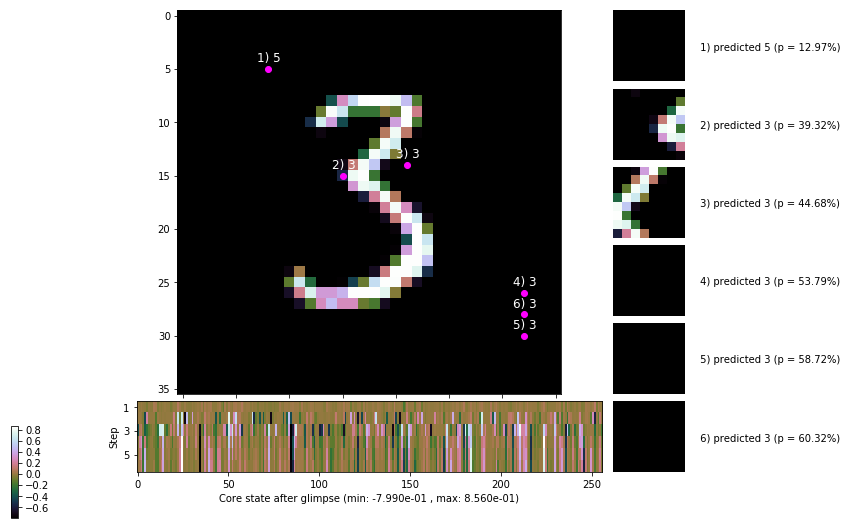


	Target class: 9 | Discounted rewards: [0.319, 0.837, 1.875, 1.750, 1.500, 1.000]


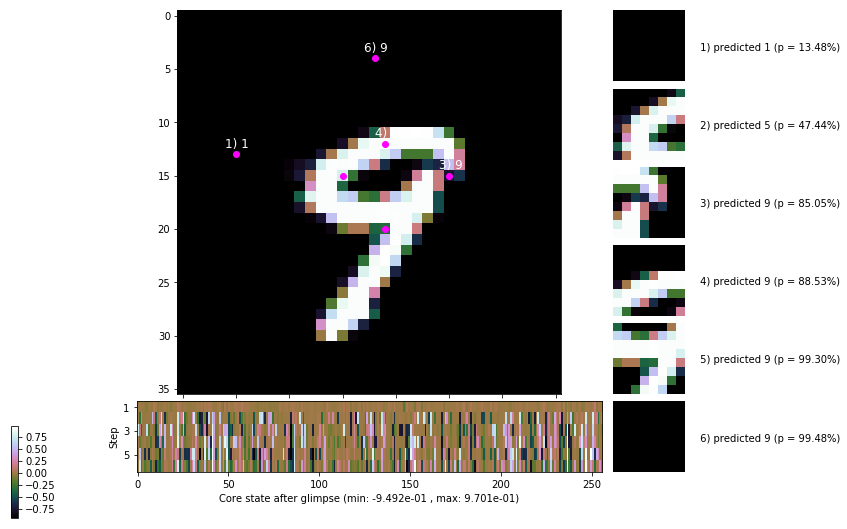

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


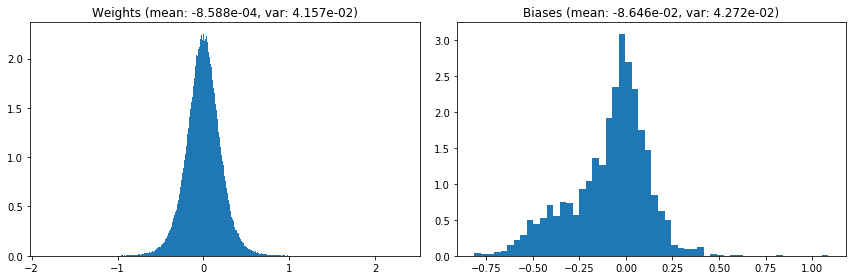

                                      Location network weights and biases


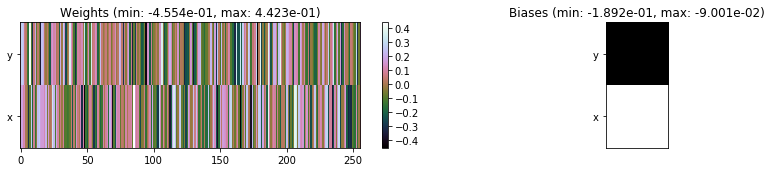

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.01 sec | TRAIN >> class loss: 0.5038 | steps:  2.508    | reward:  3.9100    | acc.: 83.087% 
                          | VAL   >> class loss: 0.5361 | steps:  2.438 :( | reward:  3.9800 :( | acc.: 81.720% :(


Epoch  14/400) lr = 0.0008228
 b    300/  3000 >> 146.2 ms/b | lr: 8.22e-04 | grad 2norm: 13.33 | grad inf norm:  3.413
         Weights || abs max:  2.32 (16758.89) | mean: -8.45e-04 ( 0.04) | var: 4.17e-02 (38907.40)
          Biases || abs max:  1.09 (   93.70) | mean: -8.66e-02 ( 0.10) | var: 4.29e-02 (   22.76)
                    class loss: 0.506 | steps: 2.492 | reward:  3.927 | acc.: 83.07%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.1 ms/b | lr: 8.21e-04 | grad 2norm: 13.10 | grad inf norm:  3.438
         Weights || abs max:  2.31 ( 2196.00) | mean: -8.48e-04 ( 0

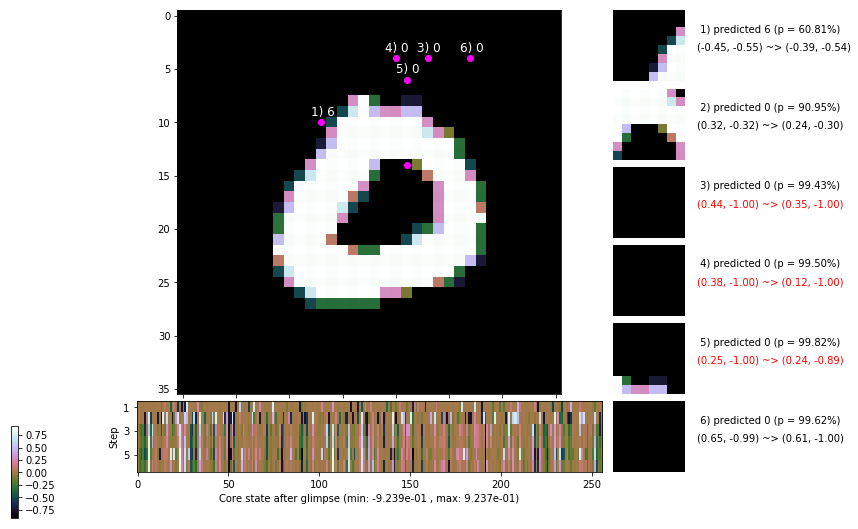

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.5 ms/b | lr: 8.19e-04 | grad 2norm: 13.29 | grad inf norm:  3.448
         Weights || abs max:  2.32 ( 4247.86) | mean: -8.57e-04 ( 0.02) | var: 4.20e-02 (  724.47)
          Biases || abs max:  1.09 (  173.85) | mean: -8.70e-02 ( 0.17) | var: 4.33e-02 ( 1627.82)
                    class loss: 0.523 | steps: 2.503 | reward:  3.885 | acc.: 82.05%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.4 ms/b | lr: 8.19e-04 | grad 2norm: 13.07 | grad inf norm:  3.423
         Weights || abs max:  2.33 ( 9760.76) | mean: -8.77e-04 ( 0.03) | var: 4.22e-02 (10872.95)
          Biases || abs max:  1.09 (  107.99) | mean: -8.80e-02 ( 0.11) | var: 4.37e-02 (   69.76)
                    class loss: 0.534 | steps: 2.500 | reward:  3.911 | acc.: 82.22%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

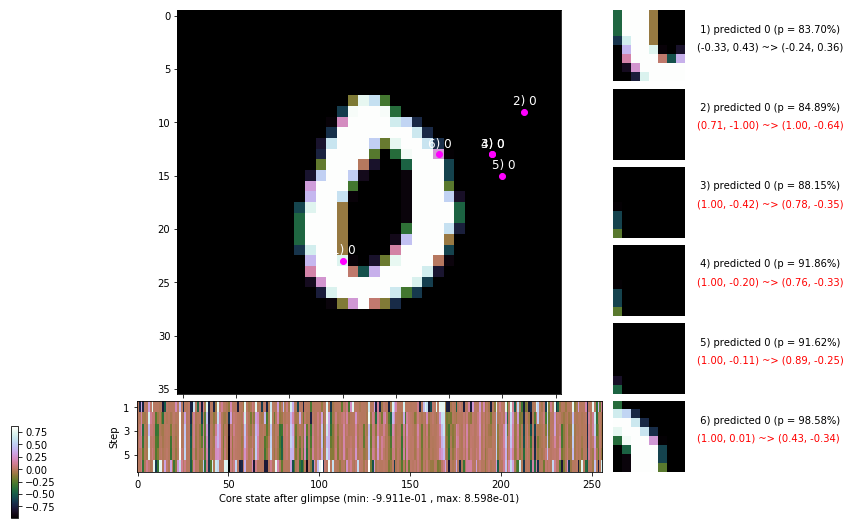

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 144.2 ms/b | lr: 8.17e-04 | grad 2norm: 13.23 | grad inf norm:  3.387
         Weights || abs max:  2.34 ( 7255.44) | mean: -8.62e-04 ( 0.02) | var: 4.23e-02 ( 3857.29)
          Biases || abs max:  1.09 (   96.75) | mean: -8.85e-02 ( 0.10) | var: 4.39e-02 (   91.18)
                    class loss: 0.512 | steps: 2.487 | reward:  3.944 | acc.: 82.97%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 144.2 ms/b | lr: 8.16e-04 | grad 2norm: 13.29 | grad inf norm:  3.331
         Weights || abs max:  2.35 ( 6924.97) | mean: -8.47e-04 ( 0.02) | var: 4.25e-02 ( 3810.27)
          Biases || abs max:  1.09 (  119.62) | mean: -8.82e-02 ( 0.11) | var: 4.40e-02 (   65.13)
                    class loss: 0.530 | steps: 2.511 | reward:  3.916 | acc.: 82.27%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

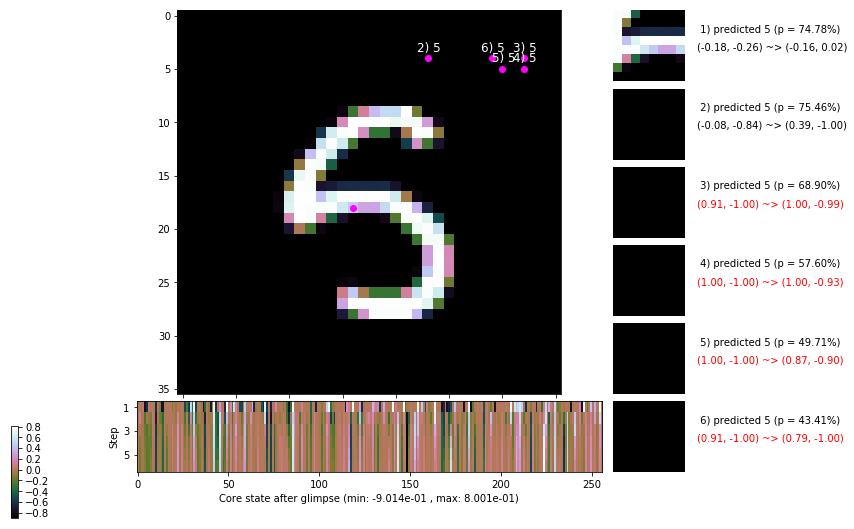

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 143.9 ms/b | lr: 8.15e-04 | grad 2norm: 13.16 | grad inf norm:  3.363
         Weights || abs max:  2.34 ( 3813.04) | mean: -8.07e-04 ( 0.02) | var: 4.27e-02 (  510.99)
          Biases || abs max:  1.09 (   53.58) | mean: -8.86e-02 ( 0.07) | var: 4.44e-02 (   20.05)
                    class loss: 0.486 | steps: 2.488 | reward:  3.956 | acc.: 83.72%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.8 ms/b | lr: 8.14e-04 | grad 2norm: 13.13 | grad inf norm:  3.339
         Weights || abs max:  2.36 ( 3912.40) | mean: -8.25e-04 ( 0.02) | var: 4.29e-02 (  314.04)
          Biases || abs max:  1.09 (  145.47) | mean: -8.88e-02 ( 0.12) | var: 4.47e-02 (  156.00)
                    class loss: 0.500 | steps: 2.494 | reward:  3.915 | acc.: 83.30%

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.8

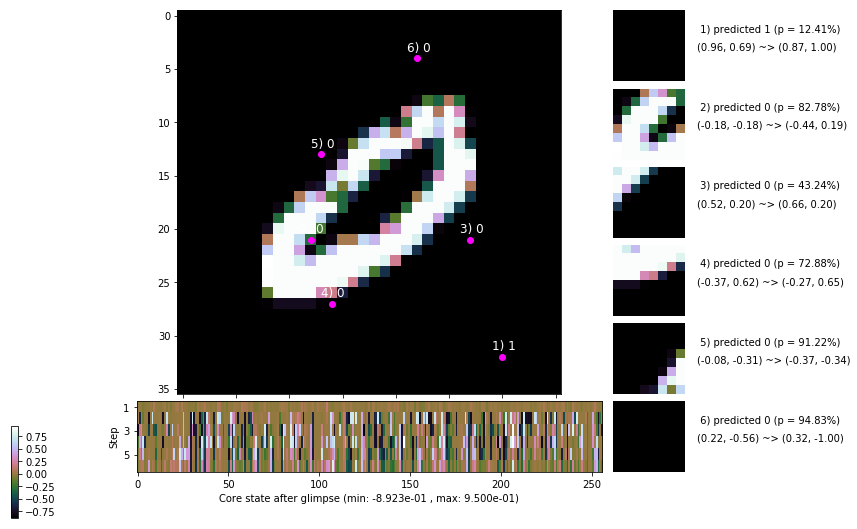

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.4 ms/b | lr: 8.12e-04 | grad 2norm: 12.93 | grad inf norm:  3.257
         Weights || abs max:  2.37 ( 4322.26) | mean: -8.34e-04 ( 0.02) | var: 4.30e-02 ( 2721.90)
          Biases || abs max:  1.10 (  637.41) | mean: -8.89e-02 ( 0.30) | var: 4.50e-02 (34933.60)
                    class loss: 0.454 | steps: 2.442 | reward:  4.019 | acc.: 84.63%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.6 ms/b | lr: 8.11e-04 | grad 2norm: 13.29 | grad inf norm:  3.508
         Weights || abs max:  2.38 ( 6754.55) | mean: -8.01e-04 ( 0.02) | var: 4.32e-02 ( 6116.25)
          Biases || abs max:  1.10 (   54.00) | mean: -8.93e-02 ( 0.07) | var: 4.53e-02 (   11.57)
                    class loss: 0.484 | steps: 2.467 | reward:  3.992 | acc.: 84.33%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

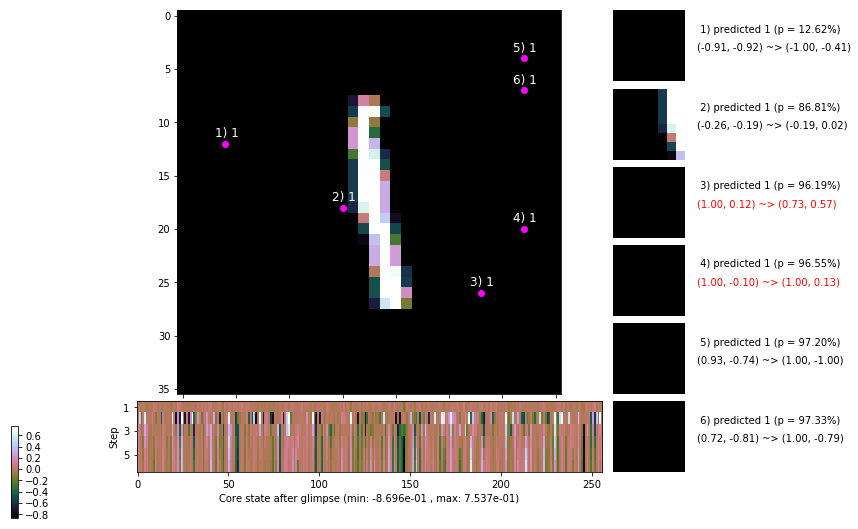

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


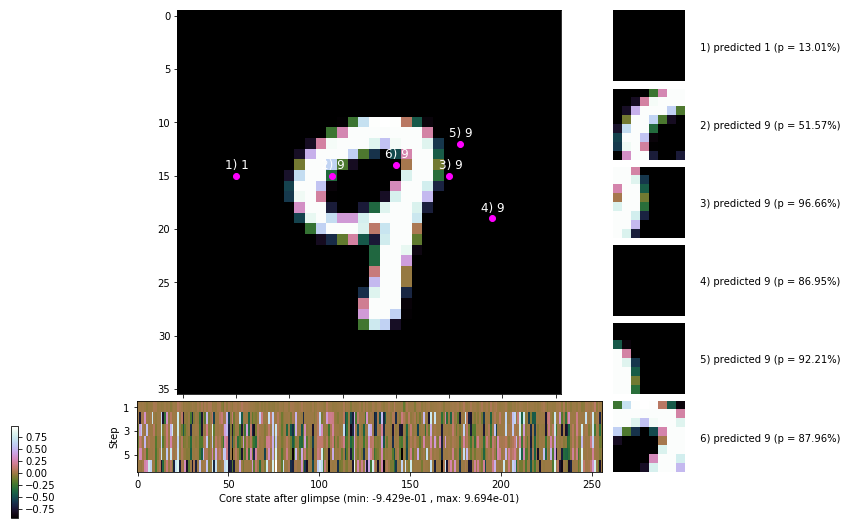


	Target class: 8 | Discounted rewards: [1.419, 0.837, 1.875, 1.750, 1.500, 1.000]


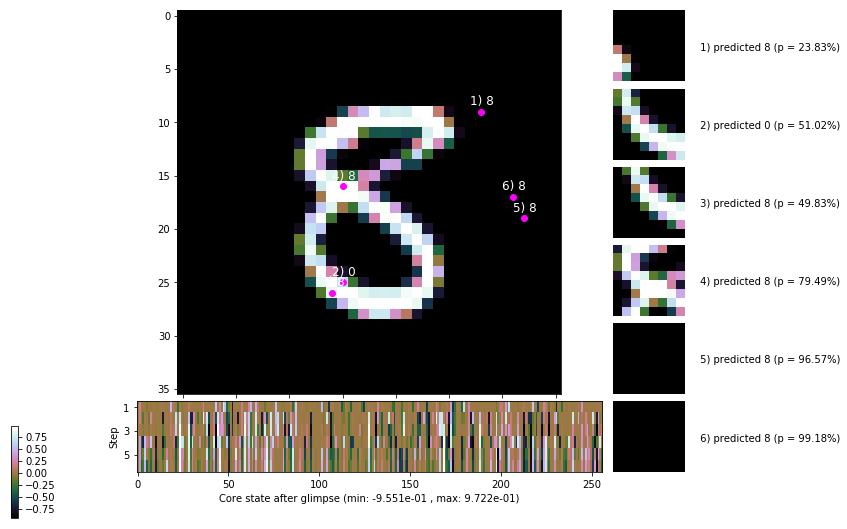

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


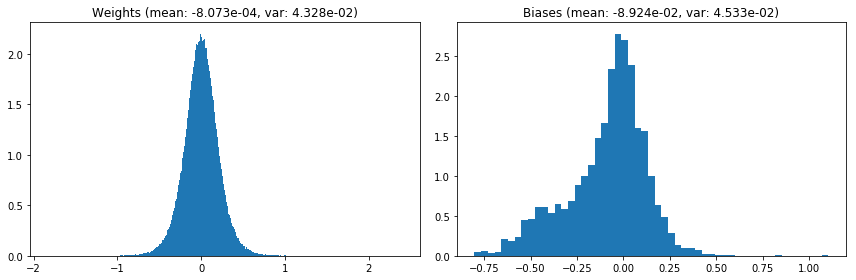

                                      Location network weights and biases


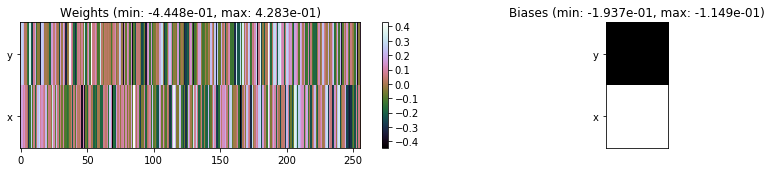

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.36 sec | TRAIN >> class loss: 0.5026 | steps:  2.486    | reward:  3.9411    | acc.: 83.193% 
                          | VAL   >> class loss: 0.4715 | steps:  2.391 :( | reward:  4.0523 :( | acc.: 83.800% :(


Epoch  15/400) lr = 0.0008105
 b    300/  3000 >> 143.3 ms/b | lr: 8.10e-04 | grad 2norm: 13.25 | grad inf norm:  3.225
         Weights || abs max:  2.39 ( 3182.40) | mean: -8.41e-04 ( 0.02) | var: 4.34e-02 (  172.58)
          Biases || abs max:  1.10 (   79.99) | mean: -8.94e-02 ( 0.09) | var: 4.57e-02 (   27.62)
                    class loss: 0.480 | steps: 2.483 | reward:  3.968 | acc.: 83.87%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.5 ms/b | lr: 8.09e-04 | grad 2norm: 13.19 | grad inf norm:  3.414
         Weights || abs max:  2.40 ( 4943.83) | mean: -8.55e-04 ( 0

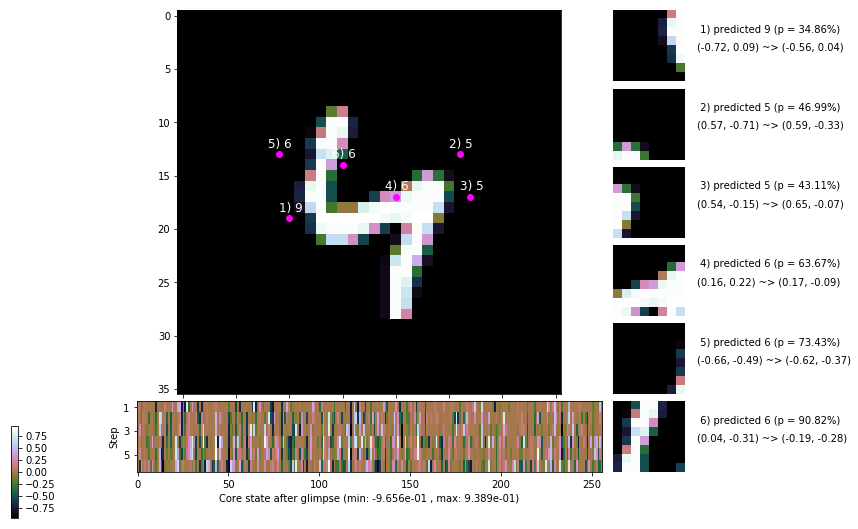

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 145.4 ms/b | lr: 8.07e-04 | grad 2norm: 13.15 | grad inf norm:  3.293
         Weights || abs max:  2.42 ( 4826.39) | mean: -8.62e-04 ( 0.02) | var: 4.37e-02 (  747.86)
          Biases || abs max:  1.11 (  109.22) | mean: -9.00e-02 ( 0.10) | var: 4.60e-02 (  172.11)
                    class loss: 0.463 | steps: 2.459 | reward:  3.991 | acc.: 84.53%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.1 ms/b | lr: 8.06e-04 | grad 2norm: 13.10 | grad inf norm:  3.327
         Weights || abs max:  2.43 ( 3550.39) | mean: -8.74e-04 ( 0.02) | var: 4.39e-02 (  280.32)
          Biases || abs max:  1.10 (  598.24) | mean: -9.04e-02 ( 0.50) | var: 4.61e-02 (65733.54)
                    class loss: 0.469 | steps: 2.503 | reward:  3.943 | acc.: 84.18%

	Target class: 2 | Discounted rewards: [0.319, 0.837, 1.8

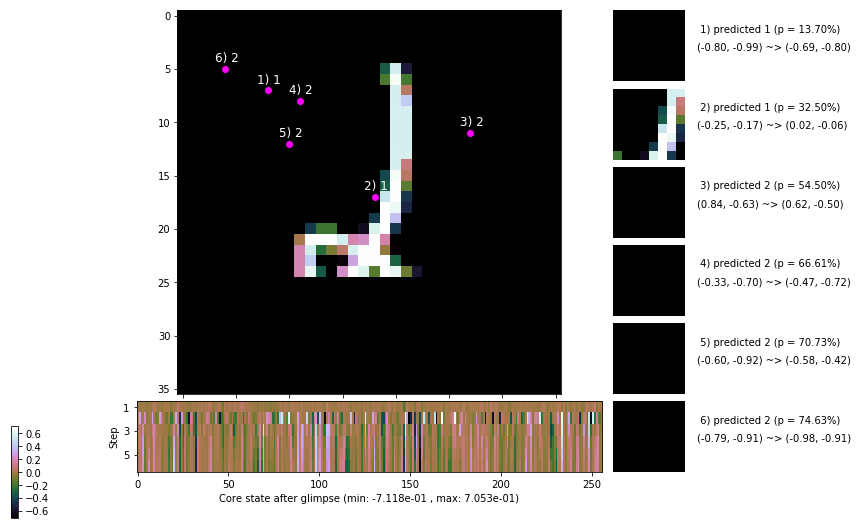

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 148.7 ms/b | lr: 8.05e-04 | grad 2norm: 12.95 | grad inf norm:  3.255
         Weights || abs max:  2.45 ( 5555.16) | mean: -8.56e-04 ( 0.02) | var: 4.40e-02 (  961.56)
          Biases || abs max:  1.10 (   87.20) | mean: -9.10e-02 ( 0.09) | var: 4.65e-02 (   24.22)
                    class loss: 0.454 | steps: 2.450 | reward:  4.024 | acc.: 85.10%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 144.7 ms/b | lr: 8.04e-04 | grad 2norm: 12.91 | grad inf norm:  3.306
         Weights || abs max:  2.46 ( 3814.93) | mean: -8.81e-04 ( 0.02) | var: 4.42e-02 (  261.12)
          Biases || abs max:  1.10 (   63.39) | mean: -9.16e-02 ( 0.08) | var: 4.66e-02 (   13.26)
                    class loss: 0.474 | steps: 2.462 | reward:  3.988 | acc.: 83.82%

	Target class: 6 | Discounted rewards: [0.869, 1.938, 1.8

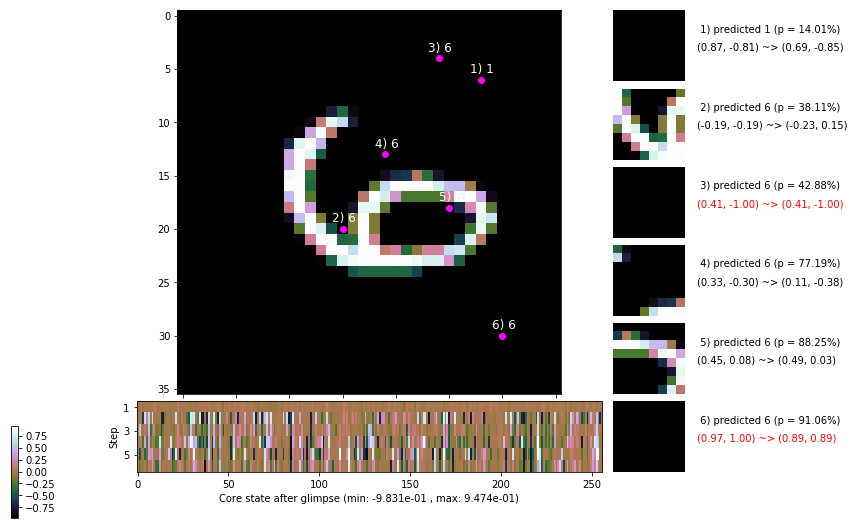

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.2 ms/b | lr: 8.02e-04 | grad 2norm: 12.94 | grad inf norm:  3.360
         Weights || abs max:  2.47 ( 3129.65) | mean: -8.97e-04 ( 0.02) | var: 4.43e-02 (  137.14)
          Biases || abs max:  1.10 (   84.31) | mean: -9.12e-02 ( 0.10) | var: 4.68e-02 (   31.67)
                    class loss: 0.463 | steps: 2.417 | reward:  4.039 | acc.: 85.03%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 144.2 ms/b | lr: 8.02e-04 | grad 2norm: 13.15 | grad inf norm:  3.449
         Weights || abs max:  2.48 ( 6189.09) | mean: -8.97e-04 ( 0.02) | var: 4.45e-02 ( 4915.15)
          Biases || abs max:  1.10 (   85.06) | mean: -9.19e-02 ( 0.09) | var: 4.70e-02 (   92.56)
                    class loss: 0.499 | steps: 2.453 | reward:  3.977 | acc.: 83.65%

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.8

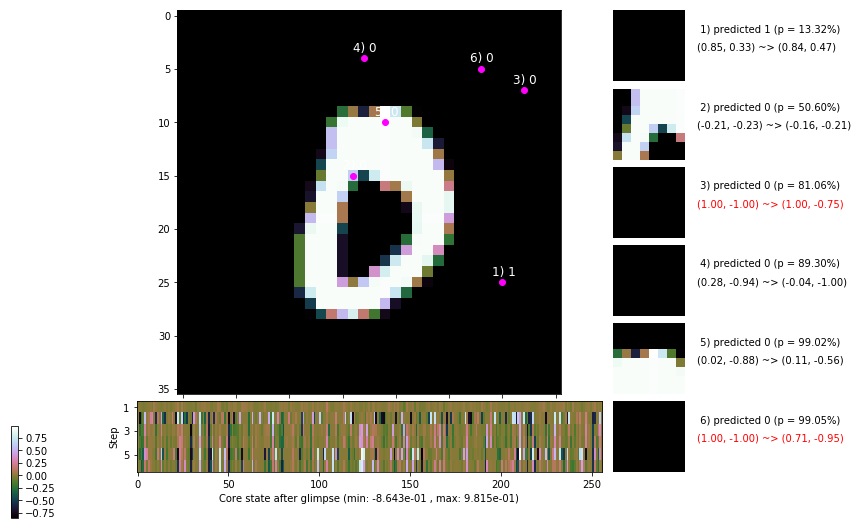

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.9 ms/b | lr: 8.00e-04 | grad 2norm: 13.27 | grad inf norm:  3.438
         Weights || abs max:  2.49 ( 5799.45) | mean: -9.00e-04 ( 0.02) | var: 4.47e-02 ( 3398.39)
          Biases || abs max:  1.10 (  134.83) | mean: -9.19e-02 ( 0.10) | var: 4.72e-02 (  506.66)
                    class loss: 0.478 | steps: 2.469 | reward:  3.971 | acc.: 83.53%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.1 ms/b | lr: 7.99e-04 | grad 2norm: 13.09 | grad inf norm:  3.296
         Weights || abs max:  2.50 ( 3645.27) | mean: -8.71e-04 ( 0.02) | var: 4.48e-02 (  332.19)
          Biases || abs max:  1.10 (   70.36) | mean: -9.22e-02 ( 0.08) | var: 4.75e-02 (   97.81)
                    class loss: 0.491 | steps: 2.460 | reward:  3.973 | acc.: 83.12%

	Target class: 5 | Discounted rewards: [0.869, 1.938, 1.8

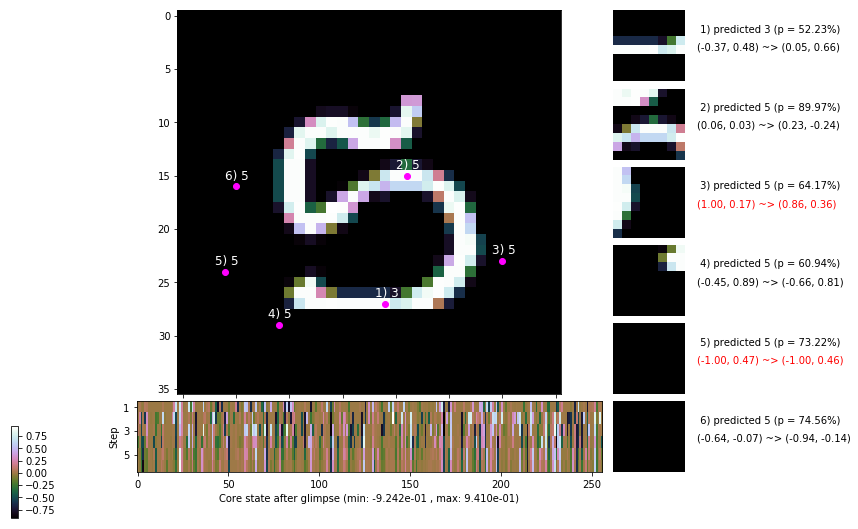

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


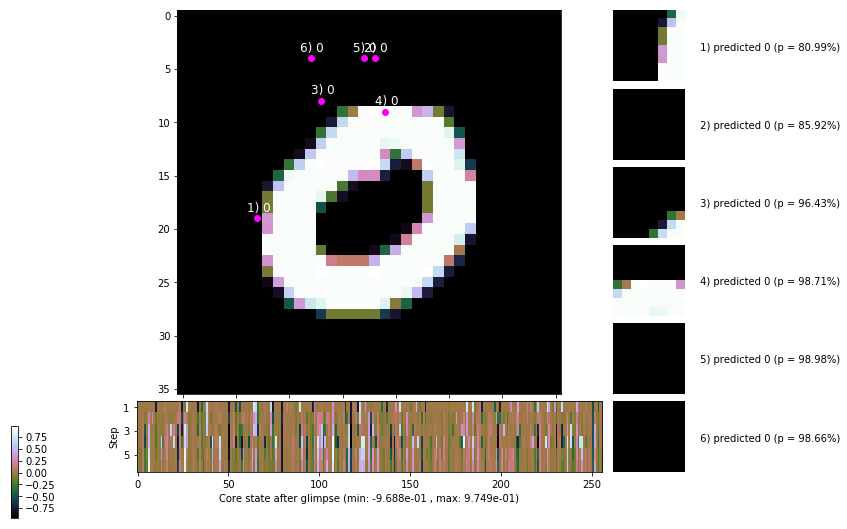


	Target class: 3 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


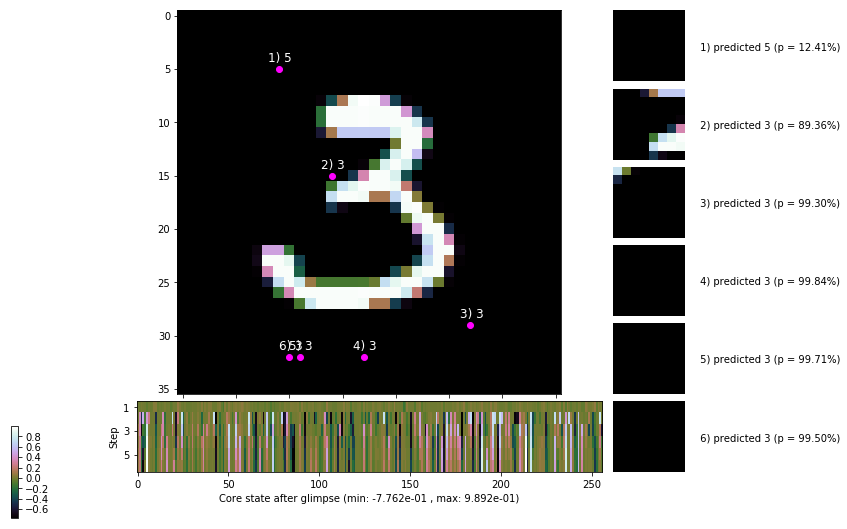

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


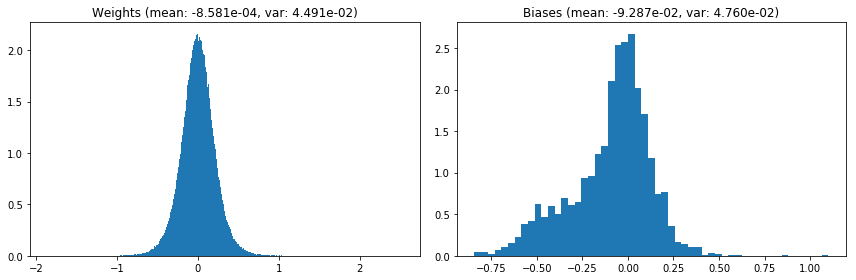

                                      Location network weights and biases


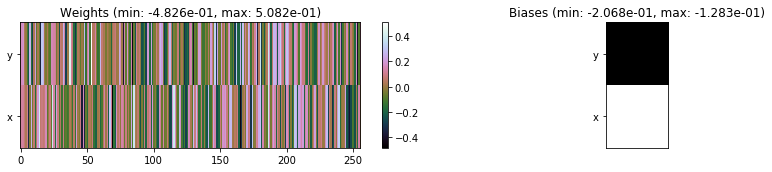

---------------------------------------------------------------------------------------------------------------
Elapsed time:  435.17 sec | TRAIN >> class loss: 0.4731 | steps:  2.459    | reward:  3.9880    | acc.: 84.137% 
                          | VAL   >> class loss: 0.4689 | steps:  2.388    | reward:  4.0713    | acc.: 84.180% :(


Epoch  16/400) lr = 0.0007984
 b    300/  3000 >> 142.0 ms/b | lr: 7.98e-04 | grad 2norm: 13.01 | grad inf norm:  3.468
         Weights || abs max:  2.53 ( 4938.27) | mean: -8.37e-04 ( 0.02) | var: 4.50e-02 (  586.98)
          Biases || abs max:  1.10 (   80.71) | mean: -9.35e-02 ( 0.09) | var: 4.77e-02 (   55.37)
                    class loss: 0.506 | steps: 2.501 | reward:  3.935 | acc.: 83.27%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.4 ms/b | lr: 7.97e-04 | grad 2norm: 13.32 | grad inf norm:  3.454
         Weights || abs max:  2.54 ( 5074.36) | mean: -8.35e-04 ( 0

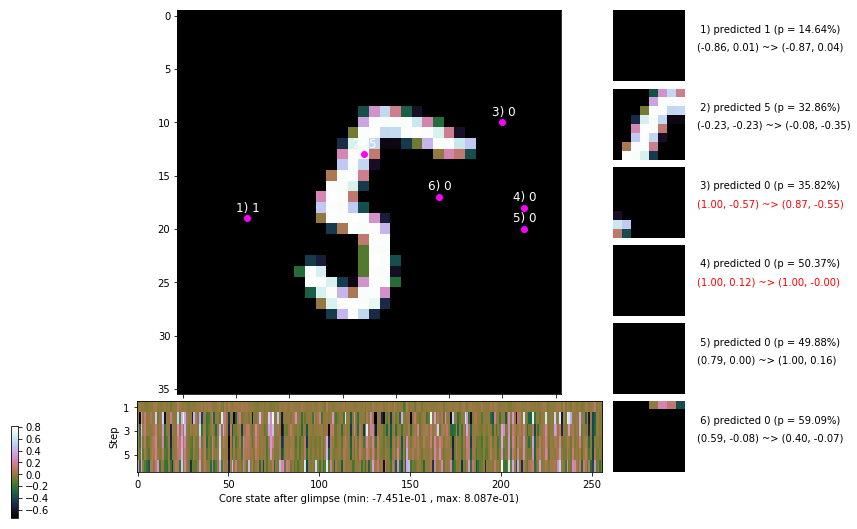

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.0 ms/b | lr: 7.95e-04 | grad 2norm: 13.14 | grad inf norm:  3.369
         Weights || abs max:  2.54 ( 3377.72) | mean: -7.80e-04 ( 0.02) | var: 4.53e-02 (  348.50)
          Biases || abs max:  1.10 (   51.48) | mean: -9.34e-02 ( 0.08) | var: 4.83e-02 (   11.09)
                    class loss: 0.481 | steps: 2.472 | reward:  3.972 | acc.: 83.75%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 144.7 ms/b | lr: 7.94e-04 | grad 2norm: 13.07 | grad inf norm:  3.230
         Weights || abs max:  2.53 ( 9912.59) | mean: -7.75e-04 ( 0.03) | var: 4.54e-02 (24860.18)
          Biases || abs max:  1.10 (   68.46) | mean: -9.36e-02 ( 0.08) | var: 4.86e-02 (   10.58)
                    class loss: 0.475 | steps: 2.453 | reward:  3.978 | acc.: 83.25%

	Target class: 5 | Discounted rewards: [0.869, 1.938, 1.8

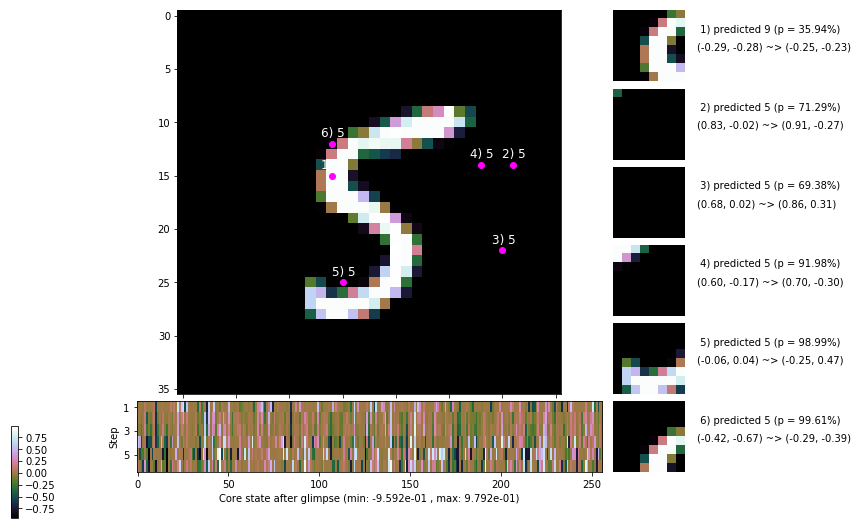

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 150.3 ms/b | lr: 7.93e-04 | grad 2norm: 13.20 | grad inf norm:  3.400
         Weights || abs max:  2.54 ( 3841.93) | mean: -7.97e-04 ( 0.02) | var: 4.56e-02 (  265.99)
          Biases || abs max:  1.10 (   71.72) | mean: -9.34e-02 ( 0.09) | var: 4.88e-02 (   23.21)
                    class loss: 0.465 | steps: 2.447 | reward:  4.015 | acc.: 84.18%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.7 ms/b | lr: 7.92e-04 | grad 2norm: 12.82 | grad inf norm:  3.166
         Weights || abs max:  2.54 ( 3457.99) | mean: -8.30e-04 ( 0.02) | var: 4.58e-02 (  236.32)
          Biases || abs max:  1.11 (  105.30) | mean: -9.35e-02 ( 0.10) | var: 4.88e-02 (  113.96)
                    class loss: 0.452 | steps: 2.398 | reward:  4.062 | acc.: 84.92%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

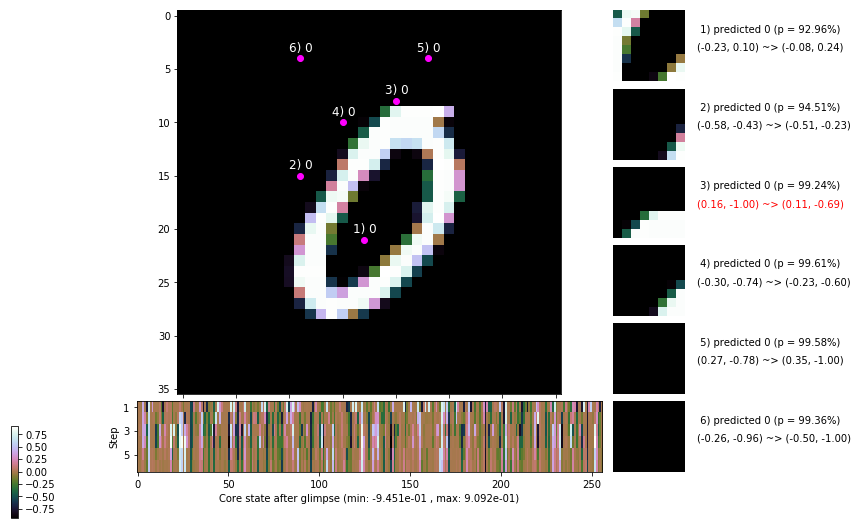

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.1 ms/b | lr: 7.90e-04 | grad 2norm: 13.09 | grad inf norm:  3.234
         Weights || abs max:  2.56 ( 3933.44) | mean: -8.32e-04 ( 0.02) | var: 4.59e-02 (  464.29)
          Biases || abs max:  1.11 (   77.48) | mean: -9.42e-02 ( 0.09) | var: 4.90e-02 (   31.64)
                    class loss: 0.471 | steps: 2.451 | reward:  4.010 | acc.: 84.33%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.8 ms/b | lr: 7.90e-04 | grad 2norm: 13.15 | grad inf norm:  3.386
         Weights || abs max:  2.58 ( 3864.00) | mean: -8.22e-04 ( 0.02) | var: 4.61e-02 (  164.00)
          Biases || abs max:  1.10 (  114.76) | mean: -9.49e-02 ( 0.10) | var: 4.93e-02 (   60.25)
                    class loss: 0.487 | steps: 2.465 | reward:  3.970 | acc.: 83.43%

	Target class: 5 | Discounted rewards: [0.938, -0.125, -0

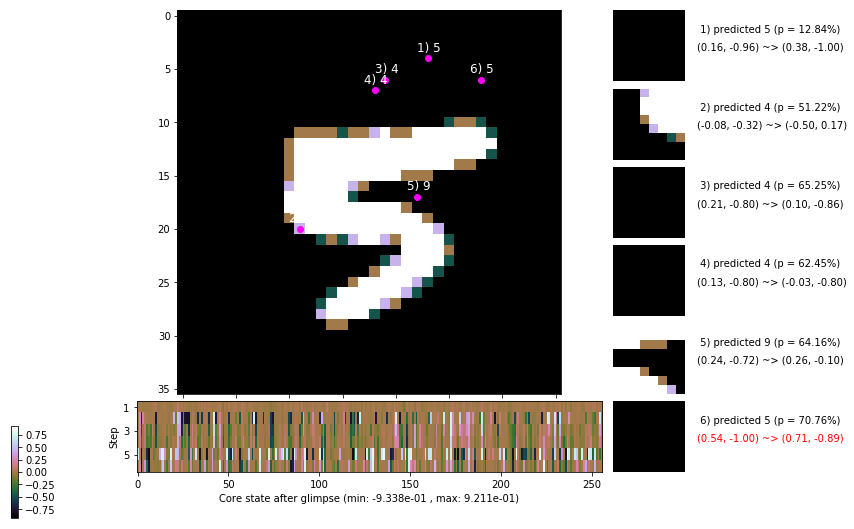

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.5 ms/b | lr: 7.88e-04 | grad 2norm: 13.18 | grad inf norm:  3.312
         Weights || abs max:  2.57 ( 2797.58) | mean: -8.07e-04 ( 0.01) | var: 4.62e-02 (  162.43)
          Biases || abs max:  1.10 (   74.97) | mean: -9.52e-02 ( 0.07) | var: 4.96e-02 (   36.78)
                    class loss: 0.495 | steps: 2.446 | reward:  3.975 | acc.: 83.55%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 156.4 ms/b | lr: 7.87e-04 | grad 2norm: 12.97 | grad inf norm:  3.416
         Weights || abs max:  2.59 ( 6781.65) | mean: -8.07e-04 ( 0.02) | var: 4.64e-02 ( 3759.91)
          Biases || abs max:  1.11 (  119.95) | mean: -9.49e-02 ( 0.11) | var: 4.97e-02 (  204.29)
                    class loss: 0.462 | steps: 2.410 | reward:  4.068 | acc.: 84.68%

	Target class: 1 | Discounted rewards: [0.319, 0.837, 1.8

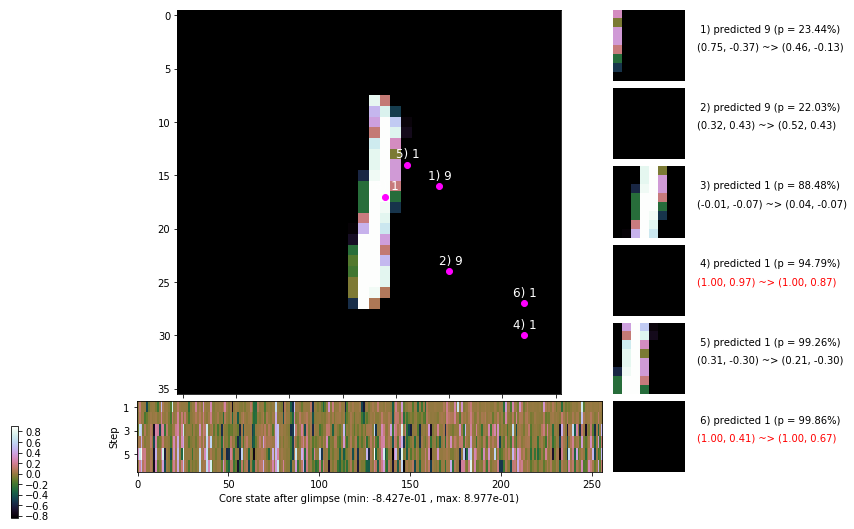

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.319, 0.837, 1.875, 1.750, 1.500, 1.000]


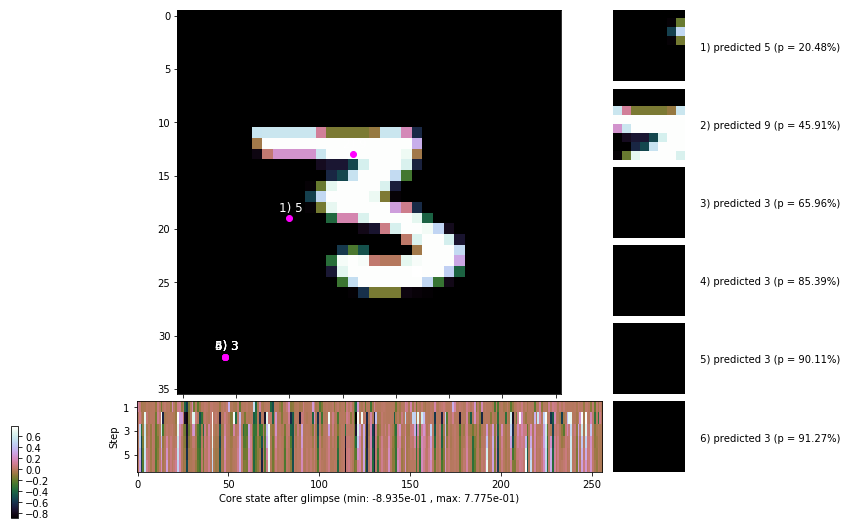


	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


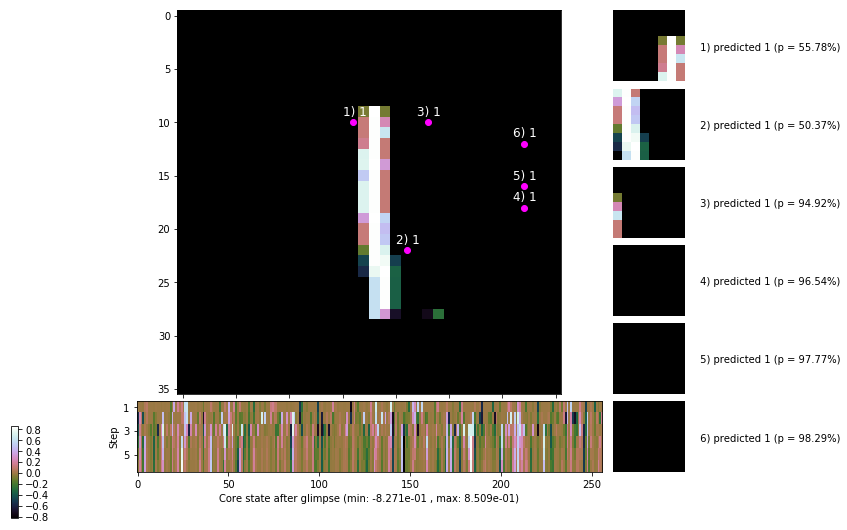

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


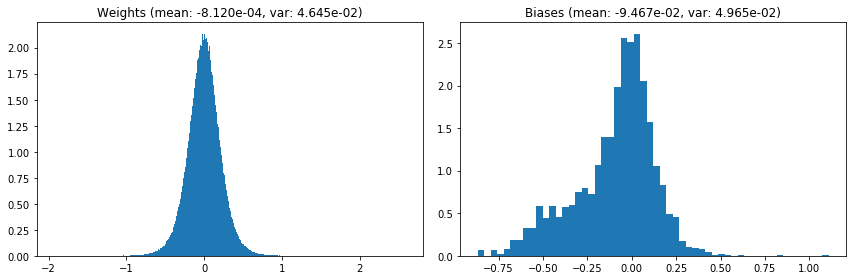

                                      Location network weights and biases


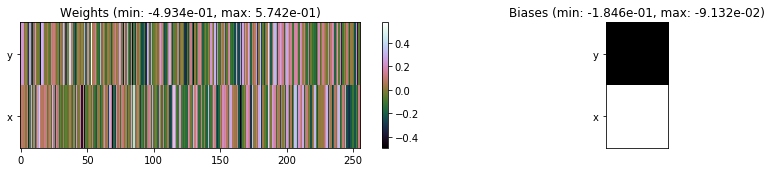

---------------------------------------------------------------------------------------------------------------
Elapsed time:  450.24 sec | TRAIN >> class loss: 0.4787 | steps:  2.452    | reward:  3.9973    | acc.: 83.920% :(
                          | VAL   >> class loss: 0.4694 | steps:  2.356    | reward:  4.1106    | acc.: 84.420% 


Epoch  17/400) lr = 0.0007865
 b    300/  3000 >> 155.9 ms/b | lr: 7.86e-04 | grad 2norm: 12.86 | grad inf norm:  3.408
         Weights || abs max:  2.59 ( 2982.84) | mean: -7.92e-04 ( 0.01) | var: 4.65e-02 (  245.76)
          Biases || abs max:  1.11 (  164.84) | mean: -9.49e-02 ( 0.13) | var: 4.97e-02 (  295.68)
                    class loss: 0.459 | steps: 2.423 | reward:  4.028 | acc.: 84.57%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 157.6 ms/b | lr: 7.85e-04 | grad 2norm: 13.33 | grad inf norm:  3.467
         Weights || abs max:  2.58 ( 3133.70) | mean: -7.92e-04 ( 0

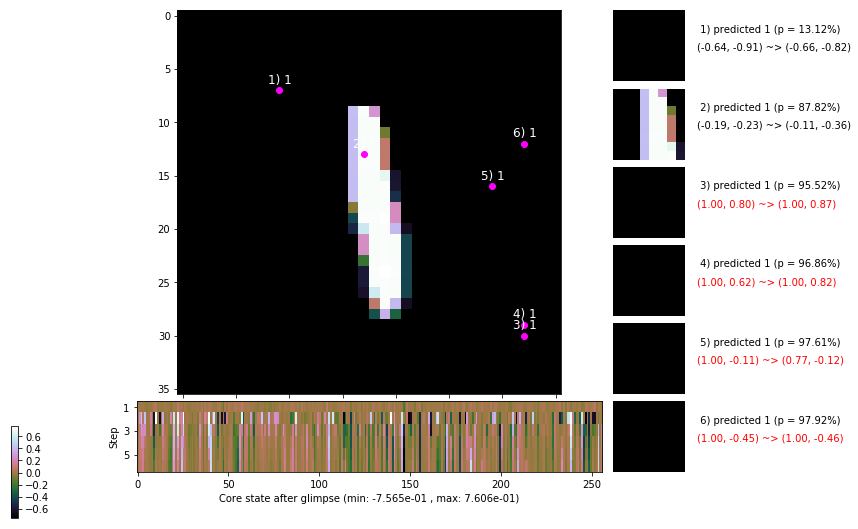

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.4 ms/b | lr: 7.83e-04 | grad 2norm: 12.94 | grad inf norm:  3.250
         Weights || abs max:  2.58 ( 3588.23) | mean: -7.88e-04 ( 0.02) | var: 4.68e-02 (  257.40)
          Biases || abs max:  1.12 (   85.39) | mean: -9.59e-02 ( 0.08) | var: 5.03e-02 (   35.83)
                    class loss: 0.441 | steps: 2.402 | reward:  4.060 | acc.: 85.25%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.6 ms/b | lr: 7.83e-04 | grad 2norm: 12.76 | grad inf norm:  3.355
         Weights || abs max:  2.57 ( 5248.70) | mean: -7.94e-04 ( 0.02) | var: 4.70e-02 ( 1316.20)
          Biases || abs max:  1.12 (  101.74) | mean: -9.61e-02 ( 0.09) | var: 5.04e-02 (  128.20)
                    class loss: 0.447 | steps: 2.401 | reward:  4.070 | acc.: 85.32%

	Target class: 4 | Discounted rewards: [0.319, 0.837, 1.8

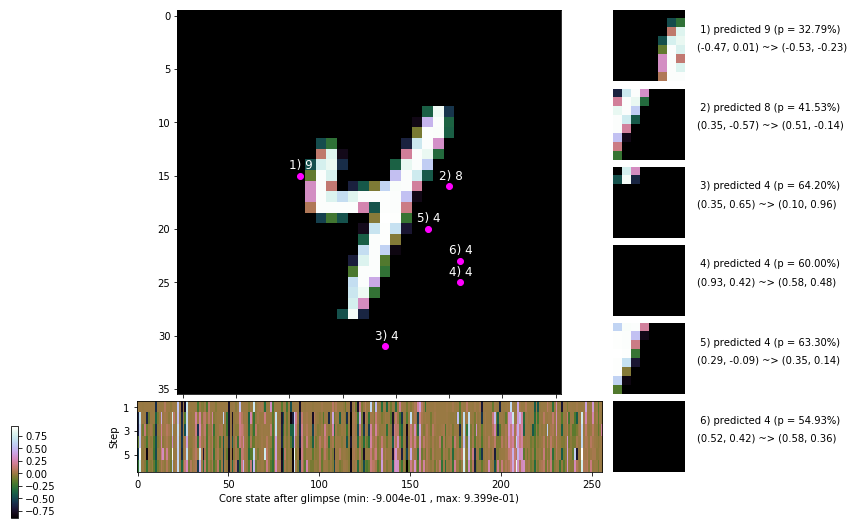

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 159.1 ms/b | lr: 7.81e-04 | grad 2norm: 12.99 | grad inf norm:  3.243
         Weights || abs max:  2.57 ( 9718.64) | mean: -7.82e-04 ( 0.03) | var: 4.71e-02 (10942.24)
          Biases || abs max:  1.11 (  114.09) | mean: -9.66e-02 ( 0.11) | var: 5.07e-02 (  282.76)
                    class loss: 0.442 | steps: 2.421 | reward:  4.034 | acc.: 85.32%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 159.4 ms/b | lr: 7.80e-04 | grad 2norm: 12.95 | grad inf norm:  3.193
         Weights || abs max:  2.58 ( 3189.13) | mean: -7.51e-04 ( 0.02) | var: 4.73e-02 (  283.53)
          Biases || abs max:  1.12 (   87.53) | mean: -9.69e-02 ( 0.09) | var: 5.09e-02 (   23.85)
                    class loss: 0.437 | steps: 2.401 | reward:  4.075 | acc.: 85.48%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

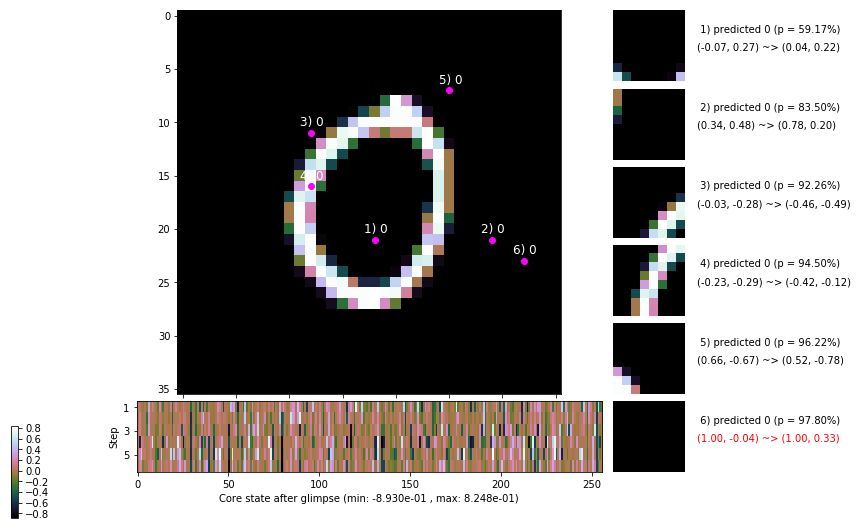

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 158.9 ms/b | lr: 7.79e-04 | grad 2norm: 13.00 | grad inf norm:  3.318
         Weights || abs max:  2.60 ( 9984.13) | mean: -7.34e-04 ( 0.03) | var: 4.74e-02 (33538.81)
          Biases || abs max:  1.11 (   97.75) | mean: -9.82e-02 ( 0.09) | var: 5.13e-02 (   72.56)
                    class loss: 0.465 | steps: 2.421 | reward:  4.041 | acc.: 84.95%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 156.6 ms/b | lr: 7.78e-04 | grad 2norm: 12.78 | grad inf norm:  3.225
         Weights || abs max:  2.62 ( 2949.88) | mean: -7.54e-04 ( 0.01) | var: 4.76e-02 (  251.62)
          Biases || abs max:  1.12 (   64.54) | mean: -9.80e-02 ( 0.08) | var: 5.14e-02 (   13.63)
                    class loss: 0.439 | steps: 2.391 | reward:  4.082 | acc.: 85.12%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

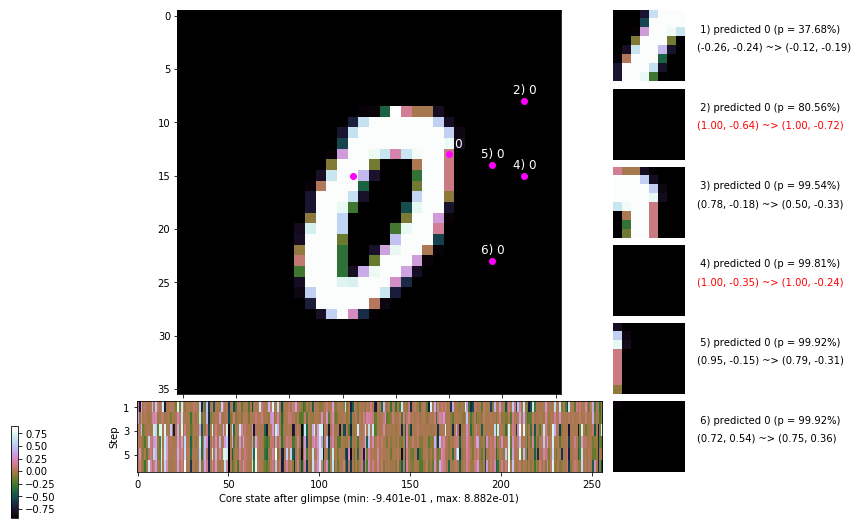

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 157.2 ms/b | lr: 7.76e-04 | grad 2norm: 13.05 | grad inf norm:  3.273
         Weights || abs max:  2.64 ( 2488.08) | mean: -7.48e-04 ( 0.01) | var: 4.77e-02 (  108.79)
          Biases || abs max:  1.11 (  145.34) | mean: -9.76e-02 ( 0.11) | var: 5.14e-02 (  524.00)
                    class loss: 0.450 | steps: 2.412 | reward:  4.049 | acc.: 84.93%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 159.9 ms/b | lr: 7.76e-04 | grad 2norm: 12.92 | grad inf norm:  3.243
         Weights || abs max:  2.64 ( 5076.83) | mean: -7.33e-04 ( 0.02) | var: 4.79e-02 (  833.90)
          Biases || abs max:  1.11 (  239.02) | mean: -9.85e-02 ( 0.15) | var: 5.18e-02 ( 2732.85)
                    class loss: 0.433 | steps: 2.401 | reward:  4.077 | acc.: 85.13%

	Target class: 2 | Discounted rewards: [0.869, 1.938, 1.8

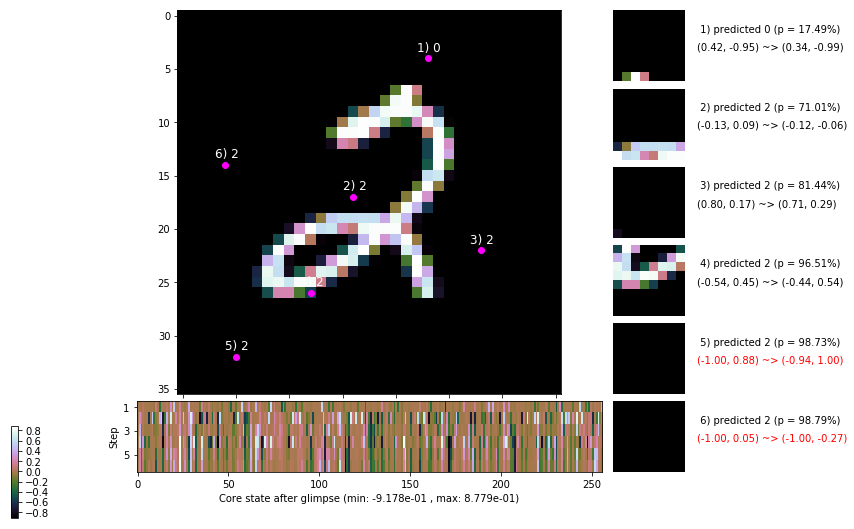

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


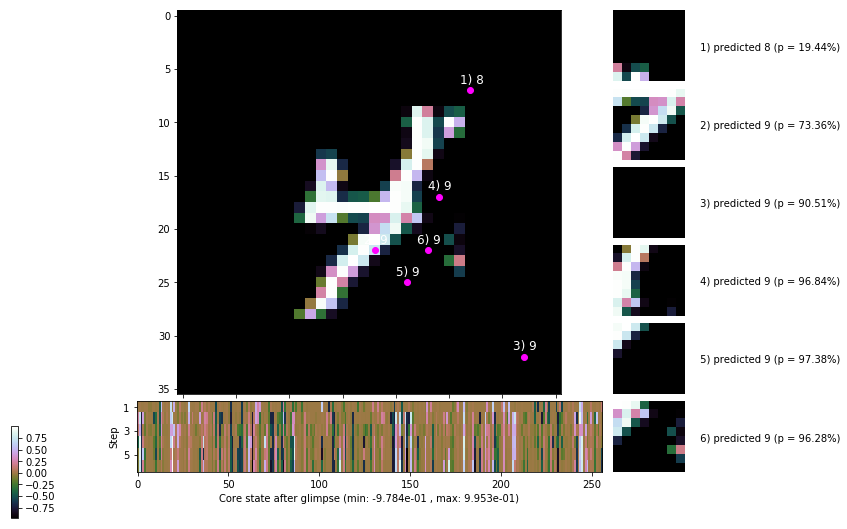


	Target class: 3 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


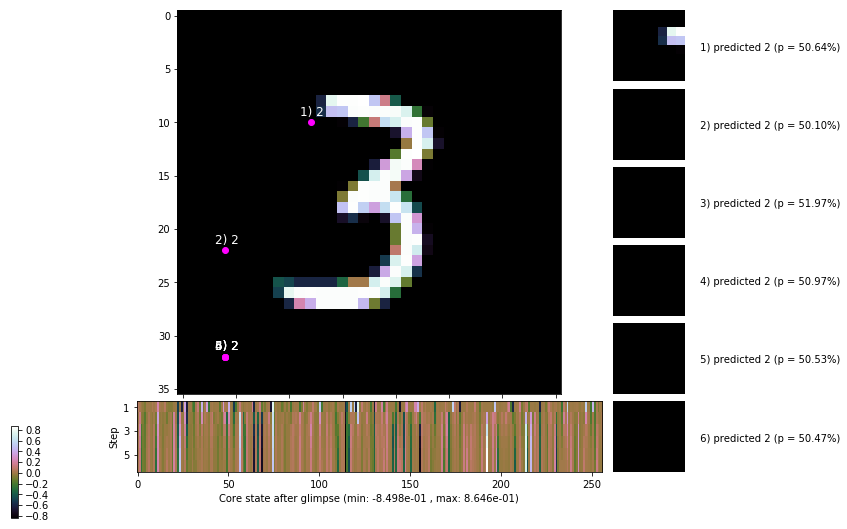

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


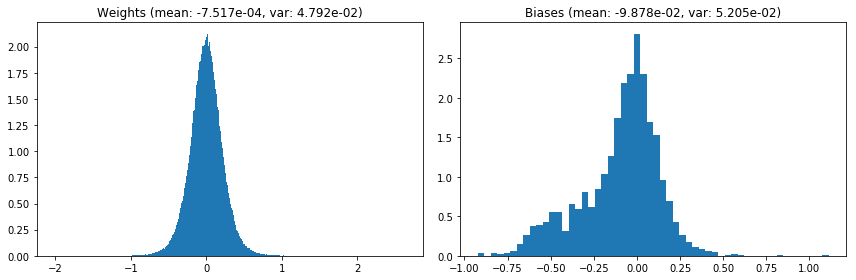

                                      Location network weights and biases


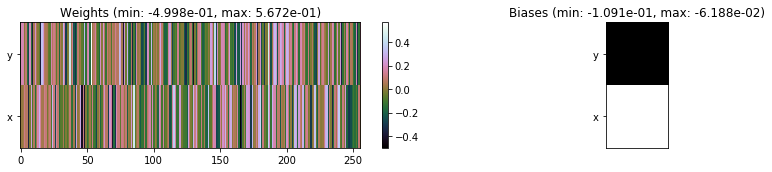

---------------------------------------------------------------------------------------------------------------
Elapsed time:  476.67 sec | TRAIN >> class loss: 0.4466 | steps:  2.408    | reward:  4.0565    | acc.: 85.048% 
                          | VAL   >> class loss: 0.4253 | steps:  2.309    | reward:  4.1846    | acc.: 85.560% 


Epoch  18/400) lr = 0.0007748
 b    300/  3000 >> 156.6 ms/b | lr: 7.74e-04 | grad 2norm: 13.01 | grad inf norm:  3.285
         Weights || abs max:  2.64 ( 9320.26) | mean: -7.64e-04 ( 0.03) | var: 4.80e-02 (27776.34)
          Biases || abs max:  1.11 (   82.68) | mean: -9.86e-02 ( 0.09) | var: 5.20e-02 (   48.50)
                    class loss: 0.439 | steps: 2.402 | reward:  4.065 | acc.: 85.20%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 156.7 ms/b | lr: 7.73e-04 | grad 2norm: 12.61 | grad inf norm:  3.242
         Weights || abs max:  2.63 ( 2575.43) | mean: -7.82e-04 ( 0.0

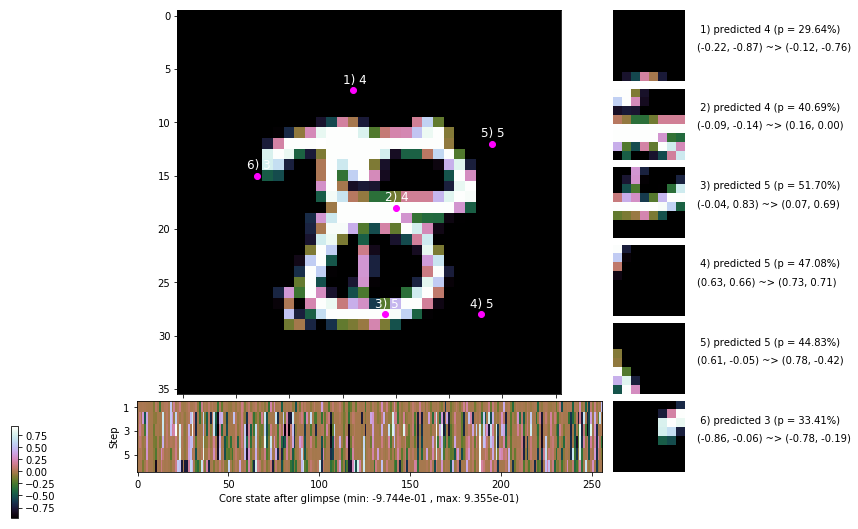

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.5 ms/b | lr: 7.72e-04 | grad 2norm: 12.92 | grad inf norm:  3.254
         Weights || abs max:  2.63 ( 5030.43) | mean: -8.38e-04 ( 0.02) | var: 4.83e-02 ( 1342.78)
          Biases || abs max:  1.12 (  147.44) | mean: -9.79e-02 ( 0.12) | var: 5.21e-02 (  538.26)
                    class loss: 0.420 | steps: 2.375 | reward:  4.101 | acc.: 85.87%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 151.5 ms/b | lr: 7.71e-04 | grad 2norm: 13.14 | grad inf norm:  3.358
         Weights || abs max:  2.63 ( 4385.48) | mean: -8.53e-04 ( 0.02) | var: 4.85e-02 (  973.11)
          Biases || abs max:  1.12 (   85.43) | mean: -9.85e-02 ( 0.09) | var: 5.24e-02 (   47.21)
                    class loss: 0.444 | steps: 2.401 | reward:  4.074 | acc.: 84.93%

	Target class: 9 | Discounted rewards: [0.044, 0.287, 0.7

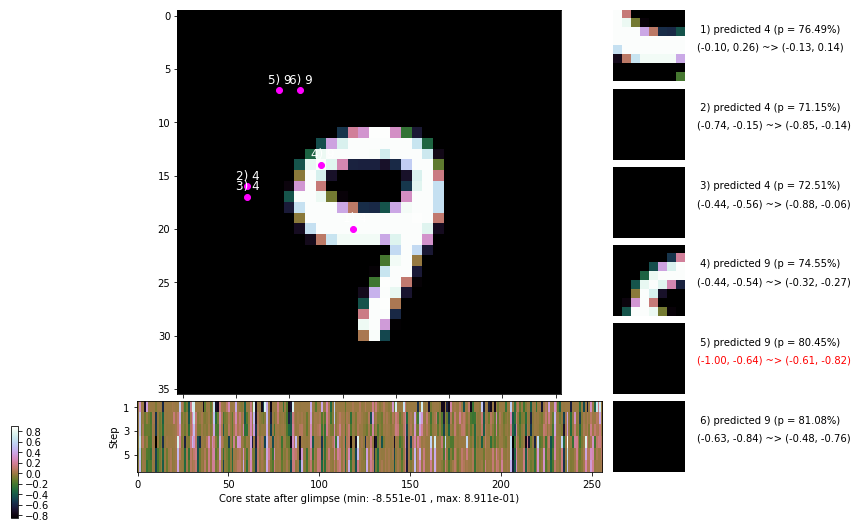

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 152.5 ms/b | lr: 7.69e-04 | grad 2norm: 12.88 | grad inf norm:  3.235
         Weights || abs max:  2.63 ( 2636.90) | mean: -8.22e-04 ( 0.01) | var: 4.86e-02 (  180.94)
          Biases || abs max:  1.12 (  261.19) | mean: -9.93e-02 ( 0.15) | var: 5.26e-02 ( 4660.28)
                    class loss: 0.446 | steps: 2.369 | reward:  4.119 | acc.: 85.12%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.0 ms/b | lr: 7.69e-04 | grad 2norm: 12.82 | grad inf norm:  3.370
         Weights || abs max:  2.64 ( 2873.98) | mean: -8.11e-04 ( 0.01) | var: 4.88e-02 (  132.16)
          Biases || abs max:  1.12 (  112.33) | mean: -9.95e-02 ( 0.11) | var: 5.30e-02 (  139.60)
                    class loss: 0.455 | steps: 2.389 | reward:  4.075 | acc.: 84.95%

	Target class: 6 | Discounted rewards: [-0.197, -0.194, -

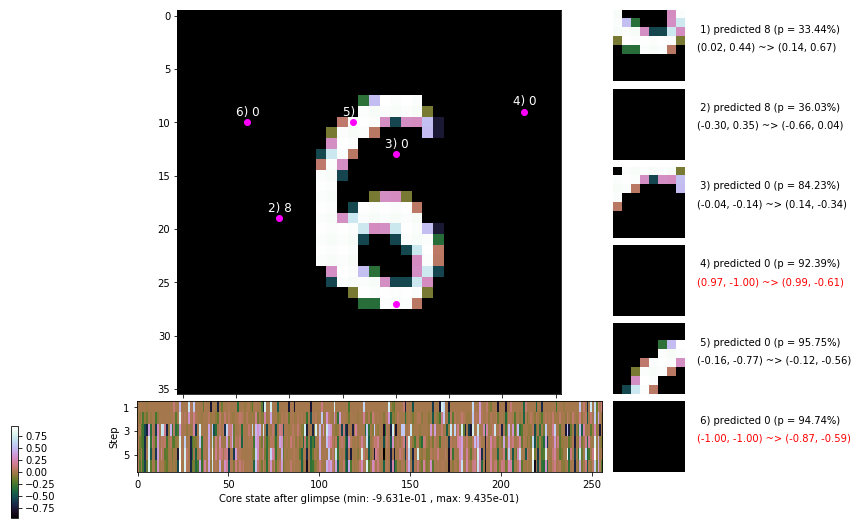

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 161.7 ms/b | lr: 7.67e-04 | grad 2norm: 13.02 | grad inf norm:  3.407
         Weights || abs max:  2.63 ( 3943.20) | mean: -8.25e-04 ( 0.02) | var: 4.89e-02 (  478.08)
          Biases || abs max:  1.12 (  180.99) | mean: -1.01e-01 ( 0.13) | var: 5.35e-02 (  216.74)
                    class loss: 0.477 | steps: 2.428 | reward:  4.025 | acc.: 83.92%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.2 ms/b | lr: 7.66e-04 | grad 2norm: 12.90 | grad inf norm:  3.335
         Weights || abs max:  2.63 ( 3829.85) | mean: -8.12e-04 ( 0.02) | var: 4.91e-02 (  281.10)
          Biases || abs max:  1.12 (   81.15) | mean: -1.00e-01 ( 0.10) | var: 5.36e-02 (  160.14)
                    class loss: 0.460 | steps: 2.405 | reward:  4.062 | acc.: 84.75%

	Target class: 6 | Discounted rewards: [0.044, 0.287, 0.7

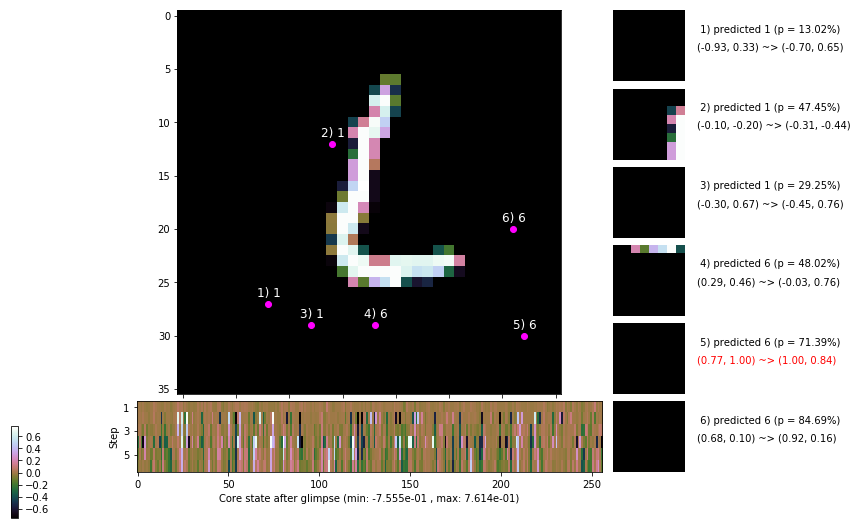

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.8 ms/b | lr: 7.65e-04 | grad 2norm: 12.76 | grad inf norm:  3.318
         Weights || abs max:  2.63 ( 3956.75) | mean: -7.93e-04 ( 0.02) | var: 4.92e-02 (  813.71)
          Biases || abs max:  1.12 (   60.57) | mean: -1.00e-01 ( 0.08) | var: 5.38e-02 (   14.31)
                    class loss: 0.452 | steps: 2.409 | reward:  4.040 | acc.: 84.55%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.9 ms/b | lr: 7.64e-04 | grad 2norm: 12.97 | grad inf norm:  3.291
         Weights || abs max:  2.64 ( 4525.32) | mean: -7.98e-04 ( 0.02) | var: 4.93e-02 (  784.39)
          Biases || abs max:  1.11 (   75.87) | mean: -1.01e-01 ( 0.08) | var: 5.40e-02 (   73.04)
                    class loss: 0.462 | steps: 2.415 | reward:  3.997 | acc.: 84.27%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.8

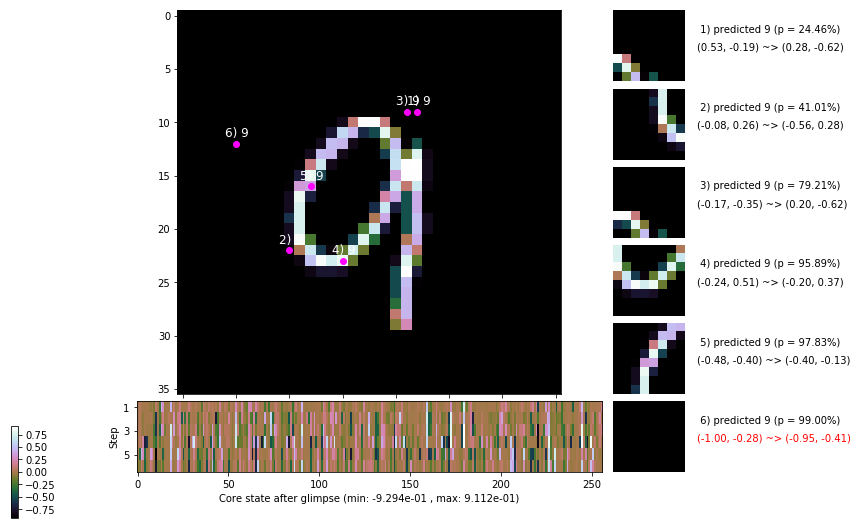

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.319, 0.837, 1.875, 1.750, 1.500, 1.000]


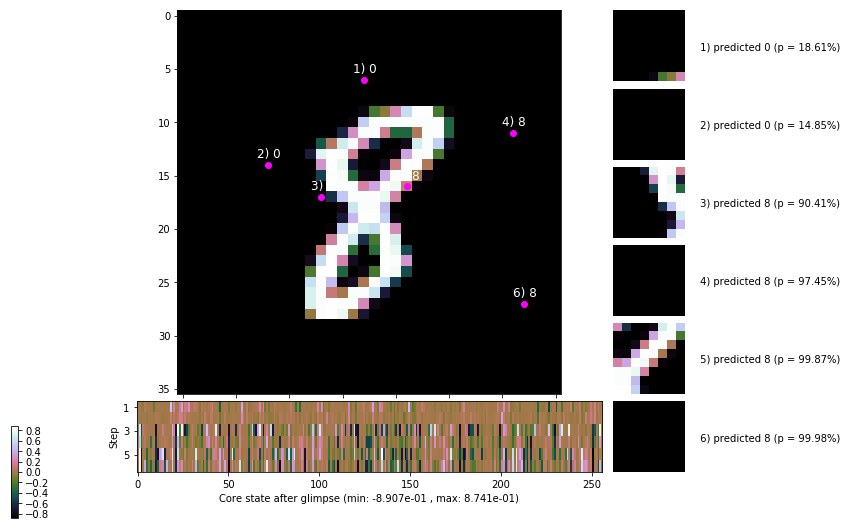


	Target class: 8 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


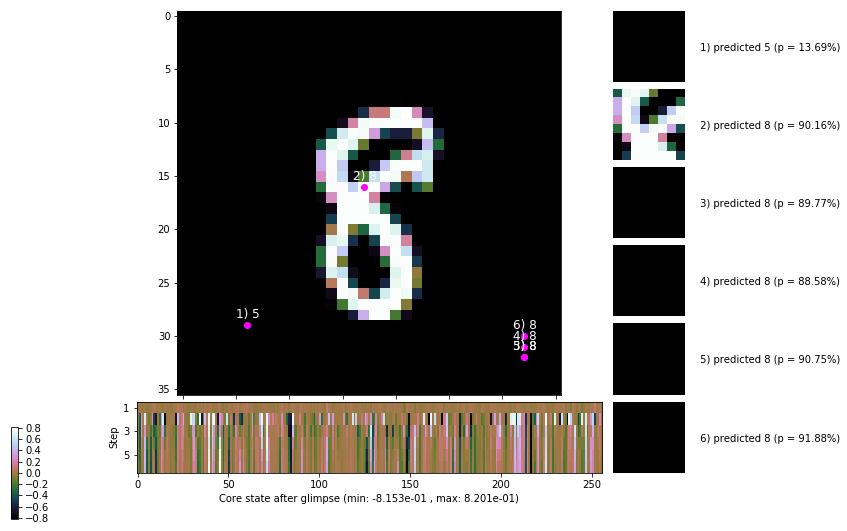

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


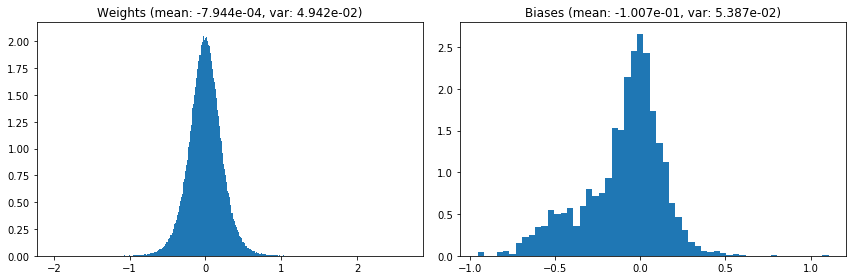

                                      Location network weights and biases


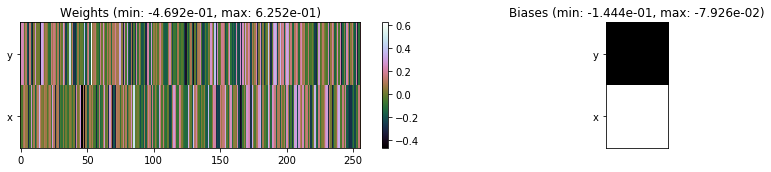

---------------------------------------------------------------------------------------------------------------
Elapsed time:  463.91 sec | TRAIN >> class loss: 0.4481 | steps:  2.395    | reward:  4.0677    | acc.: 84.933% :(
                          | VAL   >> class loss: 0.4444 | steps:  2.318 :( | reward:  4.1467 :( | acc.: 84.660% :(


Epoch  19/400) lr = 0.0007633
 b    300/  3000 >> 152.2 ms/b | lr: 7.63e-04 | grad 2norm: 12.88 | grad inf norm:  3.321
         Weights || abs max:  2.64 ( 9749.83) | mean: -7.93e-04 ( 0.03) | var: 4.95e-02 (25074.23)
          Biases || abs max:  1.10 (  119.74) | mean: -1.00e-01 ( 0.11) | var: 5.40e-02 (  233.20)
                    class loss: 0.442 | steps: 2.413 | reward:  4.026 | acc.: 84.73%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 150.0 ms/b | lr: 7.62e-04 | grad 2norm: 13.30 | grad inf norm:  3.433
         Weights || abs max:  2.66 (36729.50) | mean: -7.82e-04 (

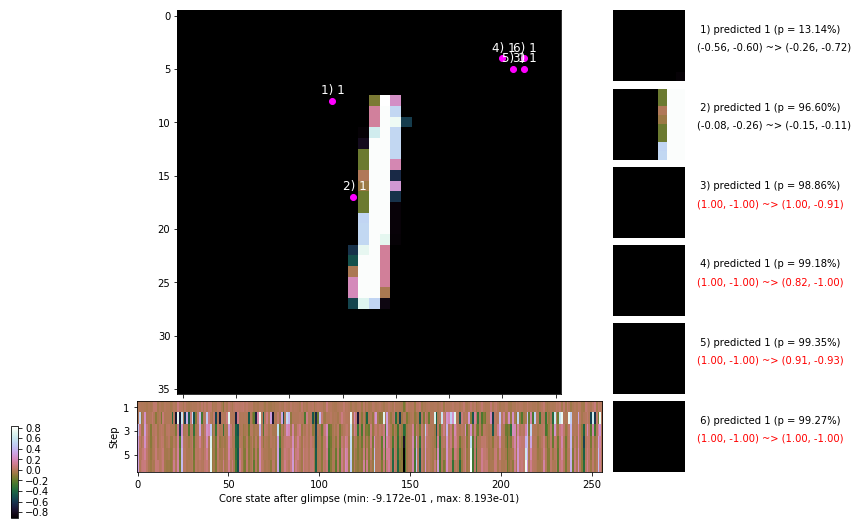

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.9 ms/b | lr: 7.60e-04 | grad 2norm: 12.60 | grad inf norm:  3.449
         Weights || abs max:  2.67 ( 3036.91) | mean: -7.90e-04 ( 0.01) | var: 4.98e-02 (  185.50)
          Biases || abs max:  1.10 (  127.32) | mean: -1.01e-01 ( 0.10) | var: 5.46e-02 (  165.35)
                    class loss: 0.451 | steps: 2.403 | reward:  4.055 | acc.: 85.18%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 151.3 ms/b | lr: 7.59e-04 | grad 2norm: 12.73 | grad inf norm:  3.353
         Weights || abs max:  2.67 ( 3036.79) | mean: -7.87e-04 ( 0.02) | var: 4.99e-02 (  172.74)
          Biases || abs max:  1.10 (  141.68) | mean: -1.02e-01 ( 0.12) | var: 5.49e-02 (  161.73)
                    class loss: 0.448 | steps: 2.430 | reward:  4.030 | acc.: 84.77%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

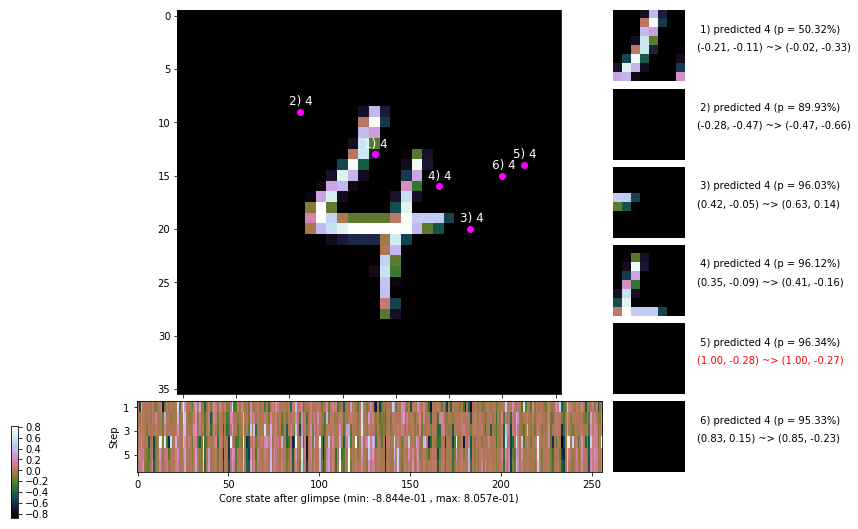

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.9 ms/b | lr: 7.58e-04 | grad 2norm: 12.74 | grad inf norm:  3.303
         Weights || abs max:  2.65 ( 4063.56) | mean: -7.31e-04 ( 0.02) | var: 5.01e-02 ( 1165.03)
          Biases || abs max:  1.11 (  107.43) | mean: -1.02e-01 ( 0.10) | var: 5.51e-02 (   48.25)
                    class loss: 0.462 | steps: 2.407 | reward:  4.044 | acc.: 84.82%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.8 ms/b | lr: 7.57e-04 | grad 2norm: 12.50 | grad inf norm:  3.094
         Weights || abs max:  2.65 ( 5123.91) | mean: -7.23e-04 ( 0.02) | var: 5.02e-02 ( 1544.02)
          Biases || abs max:  1.10 (  124.49) | mean: -1.02e-01 ( 0.13) | var: 5.55e-02 (  163.79)
                    class loss: 0.453 | steps: 2.420 | reward:  4.005 | acc.: 84.13%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.8

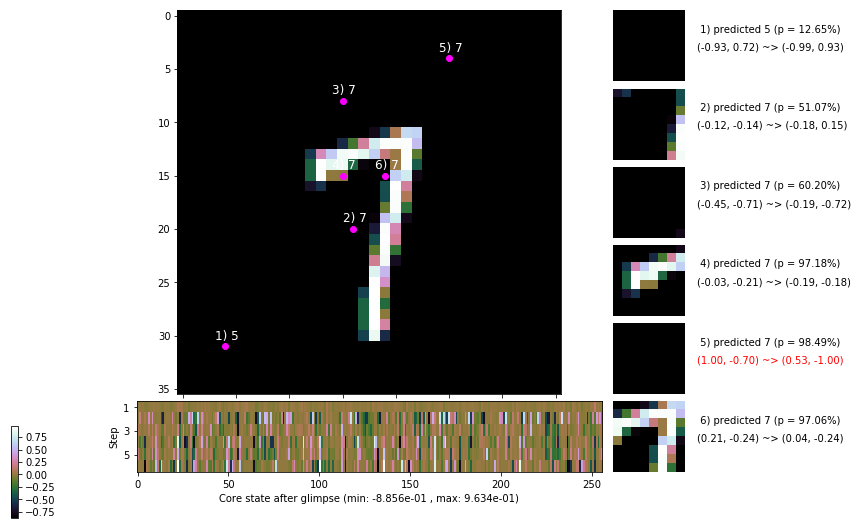

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.7 ms/b | lr: 7.56e-04 | grad 2norm: 12.53 | grad inf norm:  3.196
         Weights || abs max:  2.65 ( 3989.31) | mean: -7.31e-04 ( 0.02) | var: 5.03e-02 (  300.68)
          Biases || abs max:  1.10 (  188.57) | mean: -1.02e-01 ( 0.12) | var: 5.56e-02 ( 1507.80)
                    class loss: 0.443 | steps: 2.394 | reward:  4.065 | acc.: 85.18%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.8 ms/b | lr: 7.55e-04 | grad 2norm: 12.58 | grad inf norm:  3.230
         Weights || abs max:  2.65 (14721.44) | mean: -7.50e-04 ( 0.04) | var: 5.05e-02 (77712.60)
          Biases || abs max:  1.11 (   56.04) | mean: -1.02e-01 ( 0.08) | var: 5.56e-02 (    8.61)
                    class loss: 0.447 | steps: 2.375 | reward:  4.092 | acc.: 85.08%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

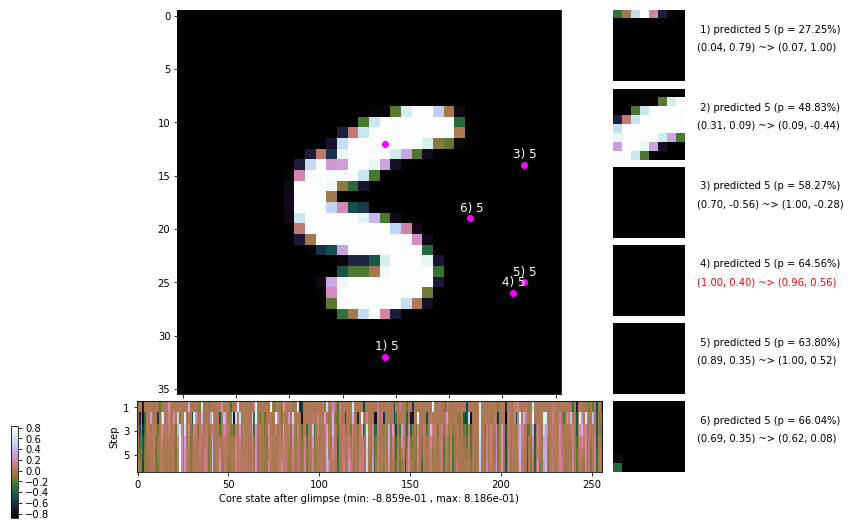

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 153.6 ms/b | lr: 7.53e-04 | grad 2norm: 12.76 | grad inf norm:  3.267
         Weights || abs max:  2.64 ( 3358.65) | mean: -7.47e-04 ( 0.02) | var: 5.06e-02 (  190.50)
          Biases || abs max:  1.10 (   81.67) | mean: -1.03e-01 ( 0.10) | var: 5.60e-02 (   14.11)
                    class loss: 0.459 | steps: 2.407 | reward:  4.063 | acc.: 84.75%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.7 ms/b | lr: 7.53e-04 | grad 2norm: 12.77 | grad inf norm:  3.296
         Weights || abs max:  2.65 ( 3978.43) | mean: -7.24e-04 ( 0.02) | var: 5.08e-02 (  443.42)
          Biases || abs max:  1.11 (  202.46) | mean: -1.03e-01 ( 0.18) | var: 5.60e-02 ( 3198.94)
                    class loss: 0.436 | steps: 2.389 | reward:  4.085 | acc.: 85.22%

	Target class: 9 | Discounted rewards: [0.319, 0.837, 1.8

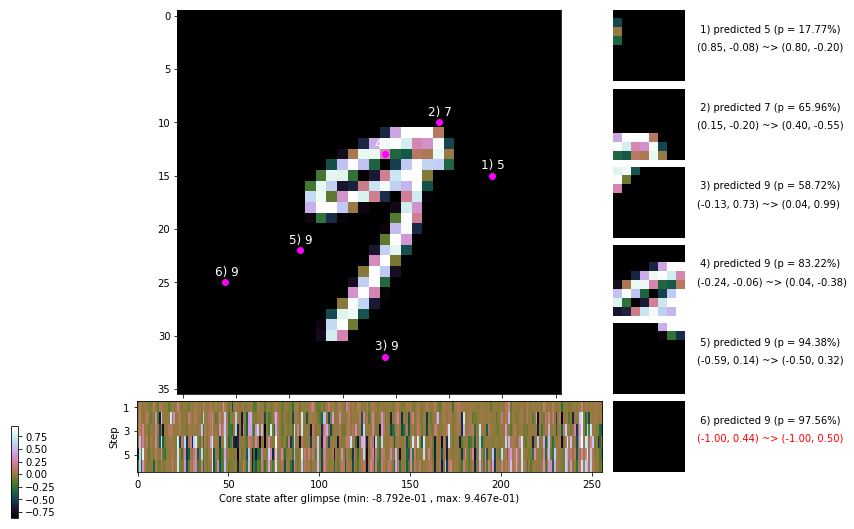

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


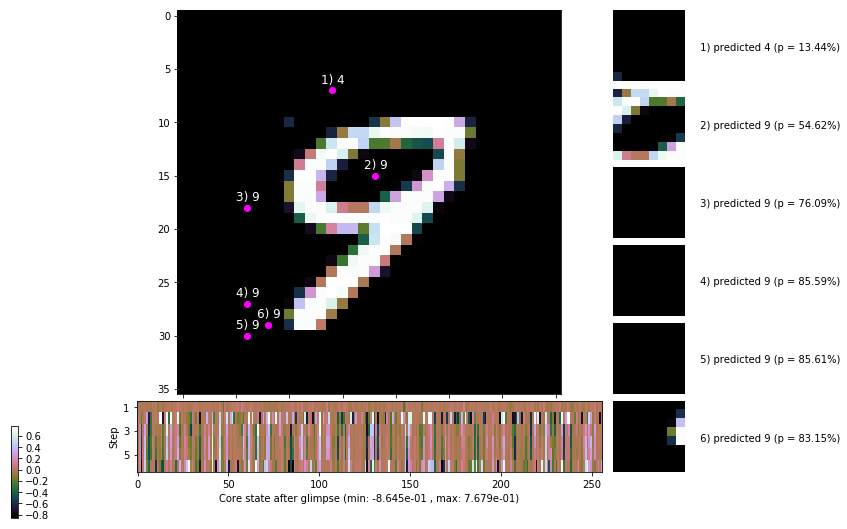


	Target class: 3 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


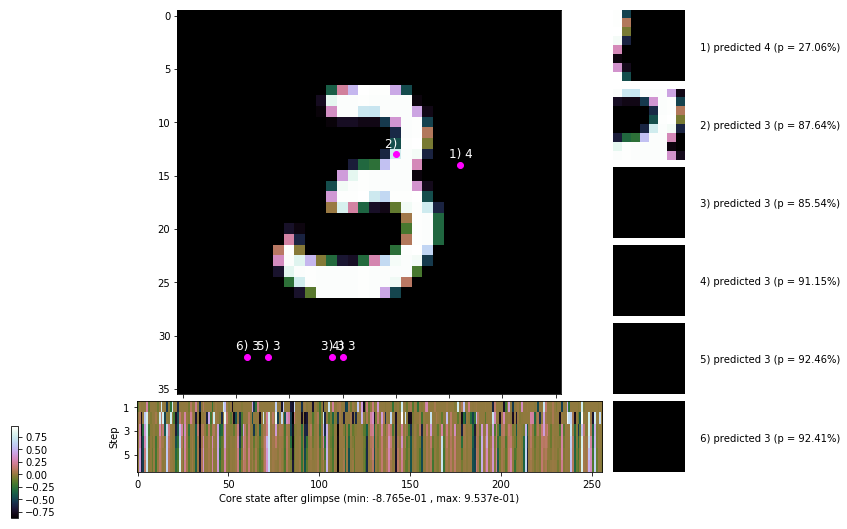

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


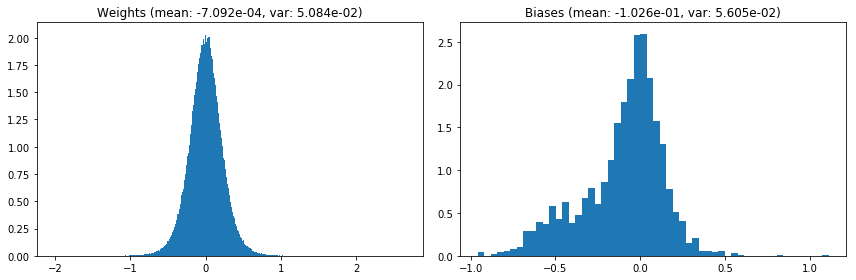

                                      Location network weights and biases


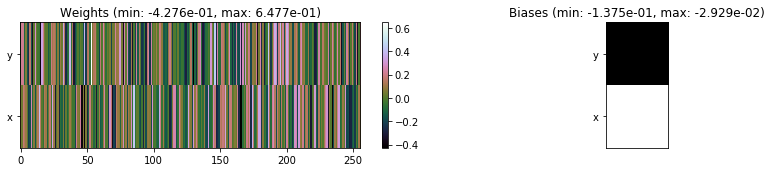

---------------------------------------------------------------------------------------------------------------
Elapsed time:  461.20 sec | TRAIN >> class loss: 0.4501 | steps:  2.410 :( | reward:  4.0442 :( | acc.: 84.850% :(
                          | VAL   >> class loss: 0.4435 | steps:  2.317 :( | reward:  4.1788 :( | acc.: 85.160% :(


Epoch  20/400) lr = 0.0007519
 b    300/  3000 >> 153.7 ms/b | lr: 7.51e-04 | grad 2norm: 12.48 | grad inf norm:  3.107
         Weights || abs max:  2.65 ( 3772.17) | mean: -6.96e-04 ( 0.02) | var: 5.09e-02 (  499.21)
          Biases || abs max:  1.11 (   83.55) | mean: -1.03e-01 ( 0.09) | var: 5.62e-02 (   22.64)
                    class loss: 0.448 | steps: 2.410 | reward:  4.054 | acc.: 85.27%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 154.3 ms/b | lr: 7.50e-04 | grad 2norm: 12.44 | grad inf norm:  3.294
         Weights || abs max:  2.66 ( 4317.45) | mean: -6.35e-04 (

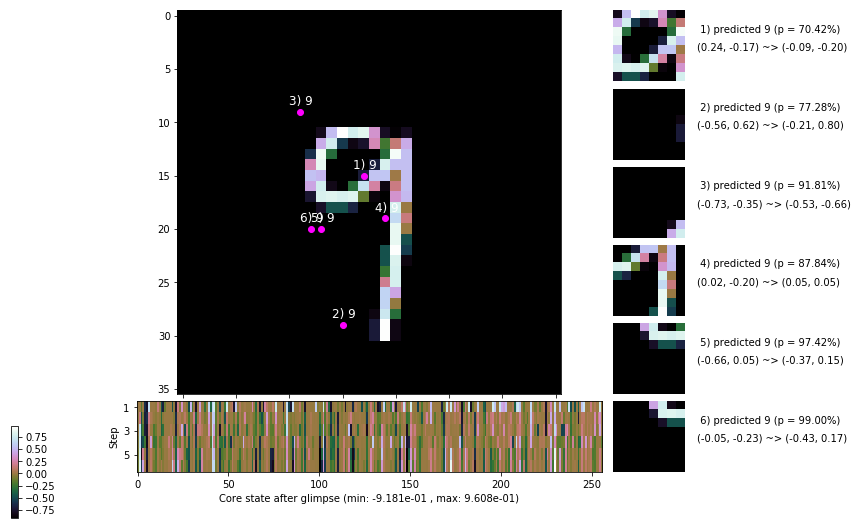

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.9 ms/b | lr: 7.49e-04 | grad 2norm: 12.56 | grad inf norm:  3.189
         Weights || abs max:  2.66 (10055.26) | mean: -6.12e-04 ( 0.03) | var: 5.12e-02 (11398.94)
          Biases || abs max:  1.10 (  168.34) | mean: -1.03e-01 ( 0.13) | var: 5.66e-02 (  326.59)
                    class loss: 0.459 | steps: 2.377 | reward:  4.094 | acc.: 84.67%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 155.1 ms/b | lr: 7.48e-04 | grad 2norm: 12.56 | grad inf norm:  3.228
         Weights || abs max:  2.67 ( 4854.17) | mean: -6.29e-04 ( 0.02) | var: 5.13e-02 ( 2012.21)
          Biases || abs max:  1.10 (  248.56) | mean: -1.03e-01 ( 0.16) | var: 5.67e-02 ( 1471.37)
                    class loss: 0.457 | steps: 2.448 | reward:  3.995 | acc.: 84.37%

	Target class: 3 | Discounted rewards: [-0.197, -0.194, -

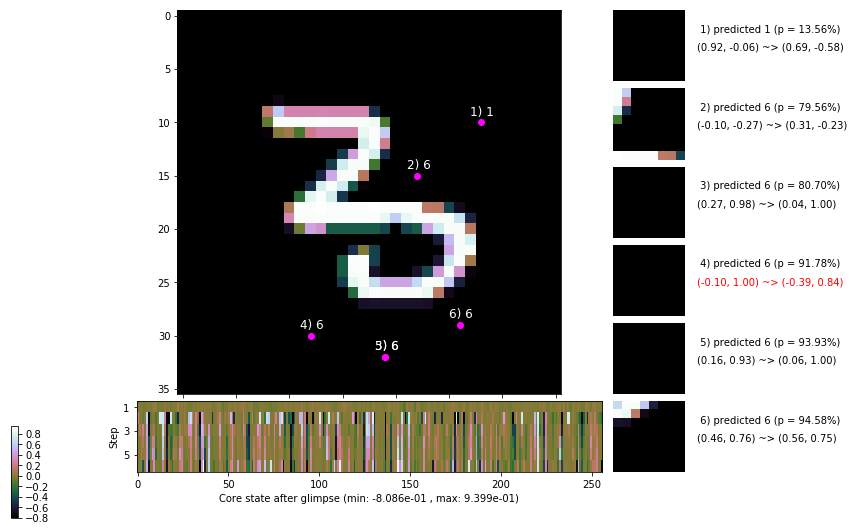

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.8 ms/b | lr: 7.47e-04 | grad 2norm: 12.45 | grad inf norm:  3.311
         Weights || abs max:  2.69 ( 3882.89) | mean: -6.59e-04 ( 0.02) | var: 5.15e-02 (  277.72)
          Biases || abs max:  1.10 (  126.90) | mean: -1.03e-01 ( 0.12) | var: 5.68e-02 (  121.68)
                    class loss: 0.442 | steps: 2.386 | reward:  4.072 | acc.: 85.37%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.7 ms/b | lr: 7.46e-04 | grad 2norm: 12.66 | grad inf norm:  3.203
         Weights || abs max:  2.69 ( 5507.30) | mean: -7.01e-04 ( 0.02) | var: 5.16e-02 ( 2169.60)
          Biases || abs max:  1.10 (  229.24) | mean: -1.04e-01 ( 0.16) | var: 5.71e-02 ( 1025.29)
                    class loss: 0.453 | steps: 2.428 | reward:  4.024 | acc.: 84.83%

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.8

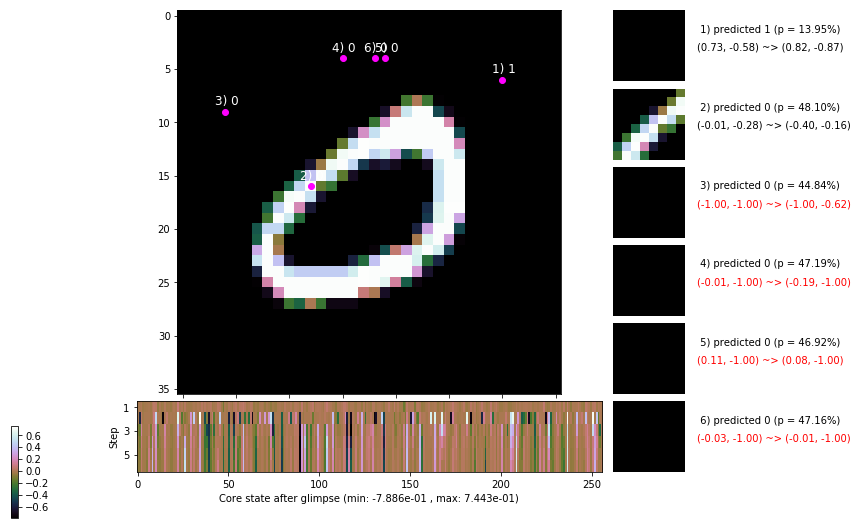

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.4 ms/b | lr: 7.44e-04 | grad 2norm: 12.51 | grad inf norm:  3.263
         Weights || abs max:  2.69 ( 2962.97) | mean: -7.10e-04 ( 0.02) | var: 5.17e-02 (  131.52)
          Biases || abs max:  1.10 (  117.88) | mean: -1.04e-01 ( 0.11) | var: 5.72e-02 (  161.87)
                    class loss: 0.452 | steps: 2.410 | reward:  4.049 | acc.: 84.45%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.1 ms/b | lr: 7.44e-04 | grad 2norm: 12.72 | grad inf norm:  3.218
         Weights || abs max:  2.69 ( 2897.44) | mean: -6.79e-04 ( 0.01) | var: 5.19e-02 (  200.54)
          Biases || abs max:  1.10 (  136.56) | mean: -1.04e-01 ( 0.12) | var: 5.73e-02 (  137.41)
                    class loss: 0.479 | steps: 2.458 | reward:  3.991 | acc.: 83.93%

	Target class: 2 | Discounted rewards: [0.869, 1.938, 1.8

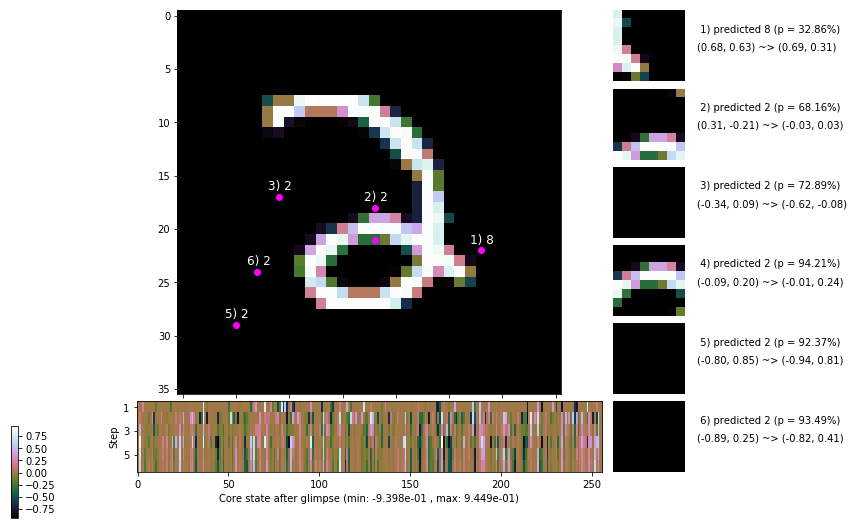

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 151.1 ms/b | lr: 7.42e-04 | grad 2norm: 12.60 | grad inf norm:  3.349
         Weights || abs max:  2.69 ( 3214.97) | mean: -6.94e-04 ( 0.02) | var: 5.20e-02 (  220.70)
          Biases || abs max:  1.10 (  196.52) | mean: -1.05e-01 ( 0.13) | var: 5.77e-02 (  692.10)
                    class loss: 0.440 | steps: 2.403 | reward:  4.077 | acc.: 85.40%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 149.2 ms/b | lr: 7.41e-04 | grad 2norm: 12.33 | grad inf norm:  3.269
         Weights || abs max:  2.69 ( 3110.78) | mean: -7.34e-04 ( 0.02) | var: 5.21e-02 (  144.09)
          Biases || abs max:  1.11 (  196.07) | mean: -1.04e-01 ( 0.14) | var: 5.76e-02 ( 1413.17)
                    class loss: 0.420 | steps: 2.353 | reward:  4.139 | acc.: 86.15%

	Target class: 2 | Discounted rewards: [-0.197, -0.194, -

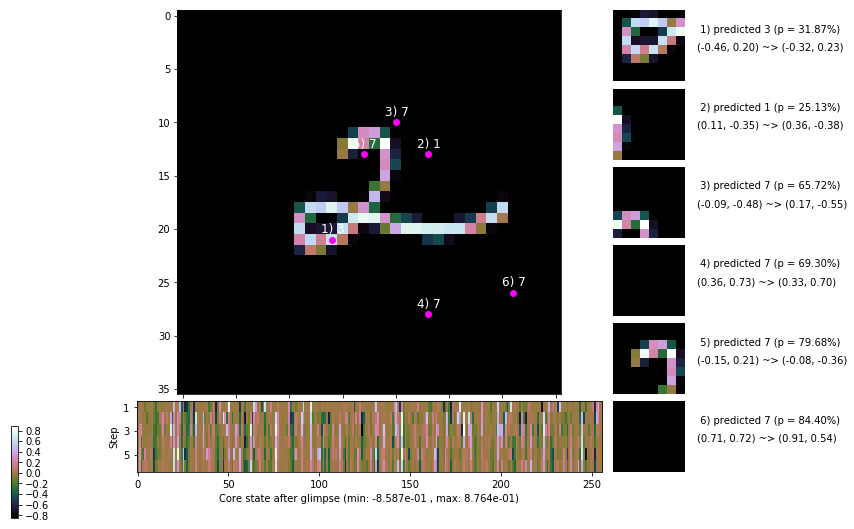

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.831, 1.663, 1.325, 0.650, 1.500, 1.000]


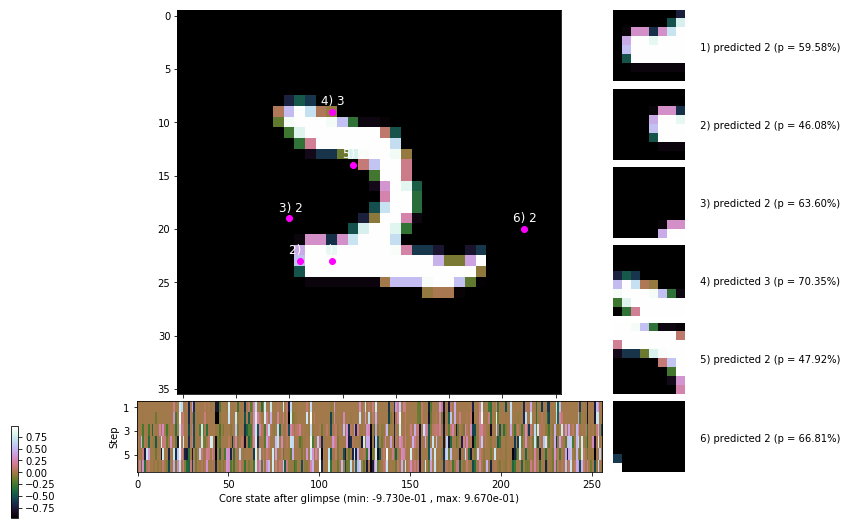


	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


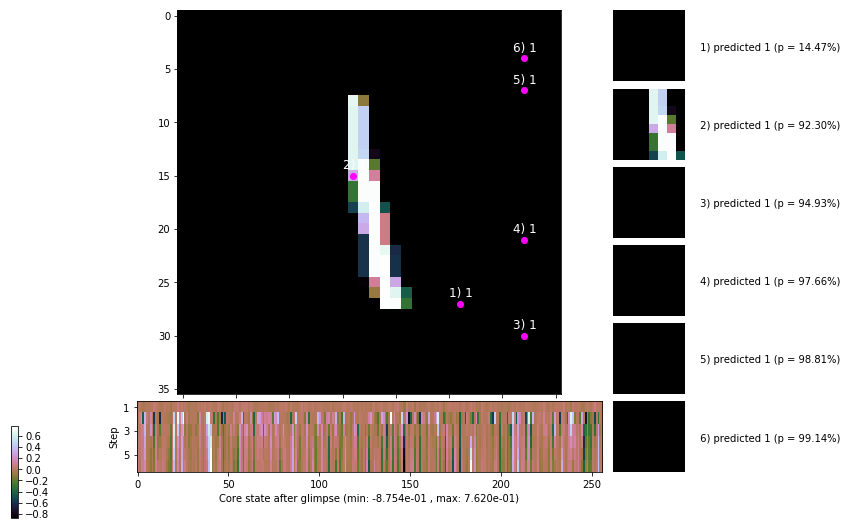

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


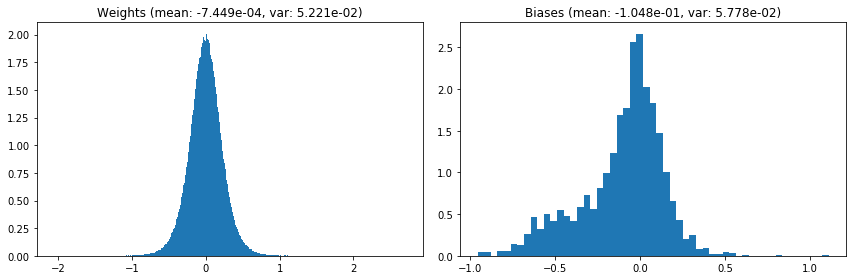

                                      Location network weights and biases


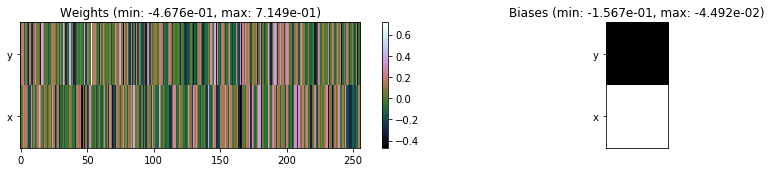

---------------------------------------------------------------------------------------------------------------
Elapsed time:  462.93 sec | TRAIN >> class loss: 0.4497 | steps:  2.407 :( | reward:  4.0551 :( | acc.: 84.973% :(
                          | VAL   >> class loss: 0.4330 | steps:  2.327 :( | reward:  4.1590 :( | acc.: 85.200% :(


Epoch  21/400) lr = 0.0007407
 b    300/  3000 >> 148.3 ms/b | lr: 7.40e-04 | grad 2norm: 12.72 | grad inf norm:  3.132
         Weights || abs max:  2.69 ( 3465.33) | mean: -7.51e-04 ( 0.02) | var: 5.23e-02 (  153.79)
          Biases || abs max:  1.11 (   72.88) | mean: -1.05e-01 ( 0.08) | var: 5.78e-02 (   17.07)
                    class loss: 0.436 | steps: 2.375 | reward:  4.105 | acc.: 85.53%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 149.2 ms/b | lr: 7.39e-04 | grad 2norm: 12.66 | grad inf norm:  3.251
         Weights || abs max:  2.70 ( 3419.67) | mean: -7.61e-04 (

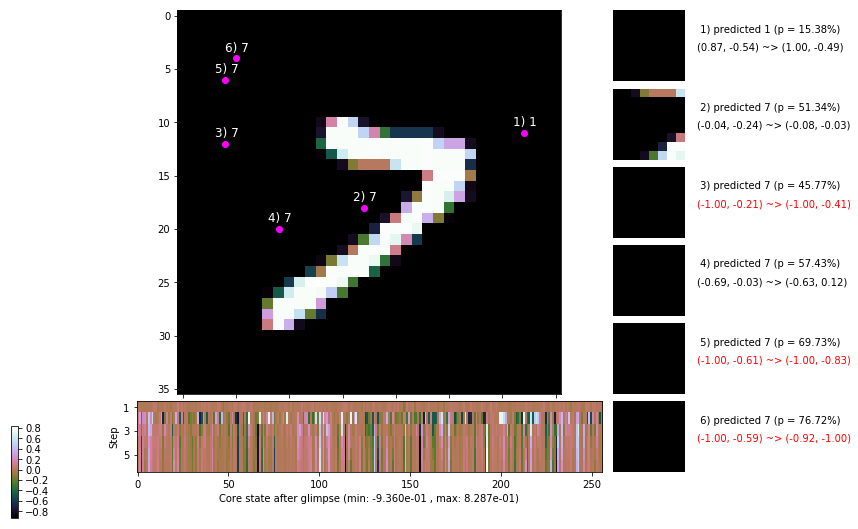

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 150.2 ms/b | lr: 7.38e-04 | grad 2norm: 12.55 | grad inf norm:  3.254
         Weights || abs max:  2.68 ( 2970.65) | mean: -8.10e-04 ( 0.01) | var: 5.25e-02 (  375.76)
          Biases || abs max:  1.12 (   59.93) | mean: -1.06e-01 ( 0.08) | var: 5.82e-02 (   12.80)
                    class loss: 0.442 | steps: 2.378 | reward:  4.101 | acc.: 85.18%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 148.2 ms/b | lr: 7.37e-04 | grad 2norm: 12.61 | grad inf norm:  3.329
         Weights || abs max:  2.68 ( 3050.42) | mean: -8.50e-04 ( 0.01) | var: 5.26e-02 (  162.88)
          Biases || abs max:  1.12 (   63.71) | mean: -1.05e-01 ( 0.08) | var: 5.81e-02 (   15.89)
                    class loss: 0.443 | steps: 2.397 | reward:  4.084 | acc.: 85.42%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

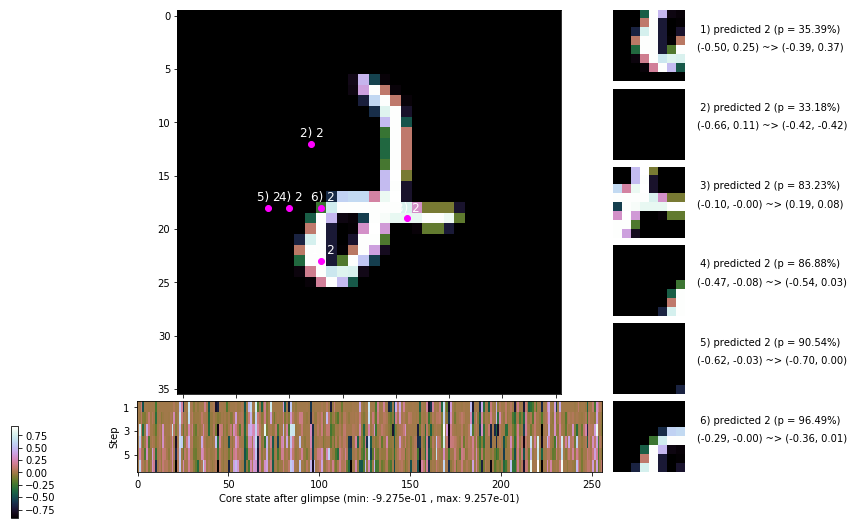

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.1 ms/b | lr: 7.36e-04 | grad 2norm: 12.40 | grad inf norm:  3.267
         Weights || abs max:  2.69 ( 4115.11) | mean: -8.61e-04 ( 0.02) | var: 5.28e-02 (  485.43)
          Biases || abs max:  1.11 (  316.17) | mean: -1.05e-01 ( 0.23) | var: 5.84e-02 ( 4694.03)
                    class loss: 0.439 | steps: 2.380 | reward:  4.103 | acc.: 85.60%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 146.6 ms/b | lr: 7.35e-04 | grad 2norm: 12.77 | grad inf norm:  3.460
         Weights || abs max:  2.69 ( 1888.77) | mean: -8.66e-04 ( 0.01) | var: 5.29e-02 (   26.14)
          Biases || abs max:  1.12 (   69.06) | mean: -1.05e-01 ( 0.08) | var: 5.85e-02 (   24.64)
                    class loss: 0.433 | steps: 2.397 | reward:  4.085 | acc.: 85.02%

	Target class: 2 | Discounted rewards: [0.869, 1.938, 1.8

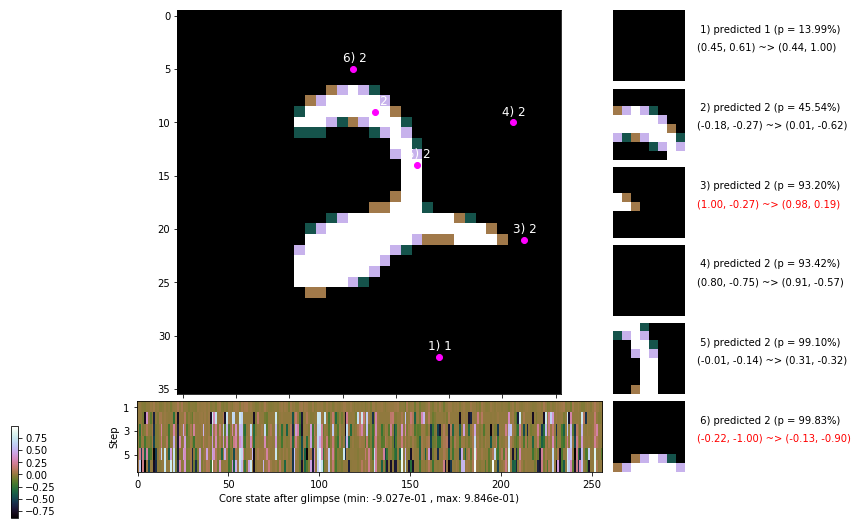

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 148.8 ms/b | lr: 7.33e-04 | grad 2norm: 12.87 | grad inf norm:  3.453
         Weights || abs max:  2.70 ( 3542.14) | mean: -8.51e-04 ( 0.02) | var: 5.30e-02 (  277.06)
          Biases || abs max:  1.11 (   97.71) | mean: -1.06e-01 ( 0.10) | var: 5.87e-02 (   40.61)
                    class loss: 0.478 | steps: 2.434 | reward:  4.004 | acc.: 83.82%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.0 ms/b | lr: 7.33e-04 | grad 2norm: 12.68 | grad inf norm:  3.237
         Weights || abs max:  2.70 ( 2941.11) | mean: -9.15e-04 ( 0.01) | var: 5.31e-02 (  235.95)
          Biases || abs max:  1.11 (  122.64) | mean: -1.06e-01 ( 0.11) | var: 5.89e-02 (  134.07)
                    class loss: 0.465 | steps: 2.414 | reward:  4.044 | acc.: 84.35%

	Target class: 9 | Discounted rewards: [0.044, 0.287, 0.7

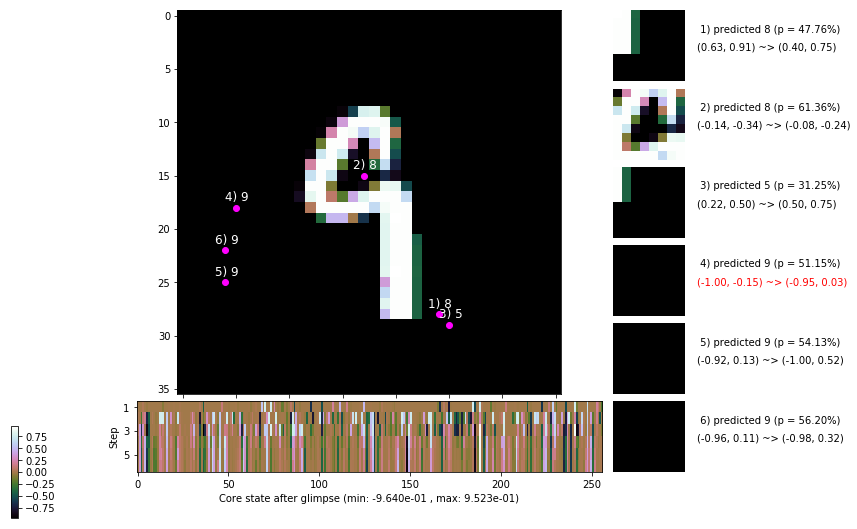

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 149.6 ms/b | lr: 7.31e-04 | grad 2norm: 12.45 | grad inf norm:  3.295
         Weights || abs max:  2.70 ( 3063.33) | mean: -9.07e-04 ( 0.02) | var: 5.33e-02 (  174.87)
          Biases || abs max:  1.11 (   87.89) | mean: -1.06e-01 ( 0.09) | var: 5.90e-02 (   30.01)
                    class loss: 0.462 | steps: 2.433 | reward:  4.040 | acc.: 84.80%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 145.3 ms/b | lr: 7.30e-04 | grad 2norm: 12.25 | grad inf norm:  3.270
         Weights || abs max:  2.69 (133327.69) | mean: -9.13e-04 ( 0.25) | var: 5.34e-02 (8907050.00)
          Biases || abs max:  1.11 (  144.25) | mean: -1.06e-01 ( 0.12) | var: 5.92e-02 (  160.19)
                    class loss: 0.447 | steps: 2.401 | reward:  4.073 | acc.: 85.18%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 

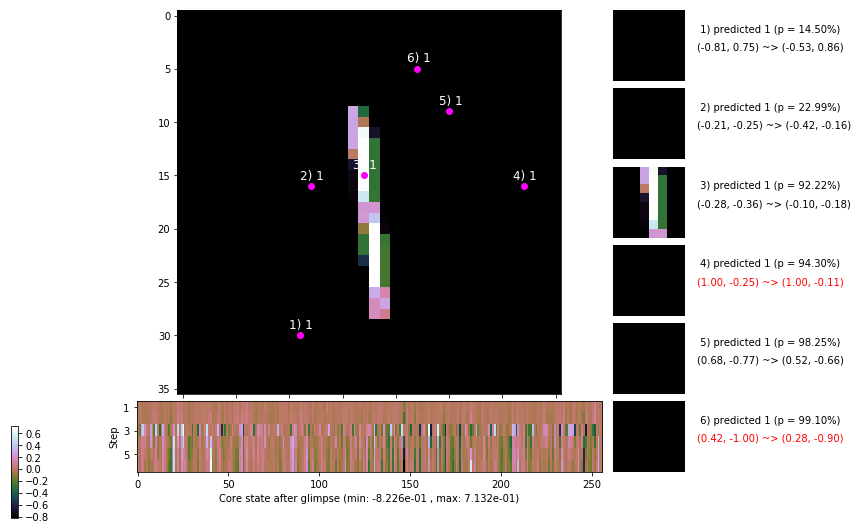

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


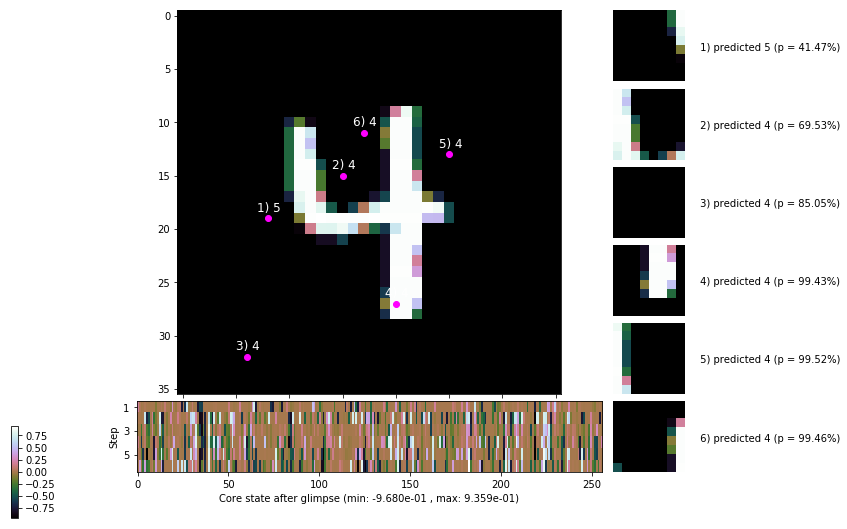


	Target class: 8 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


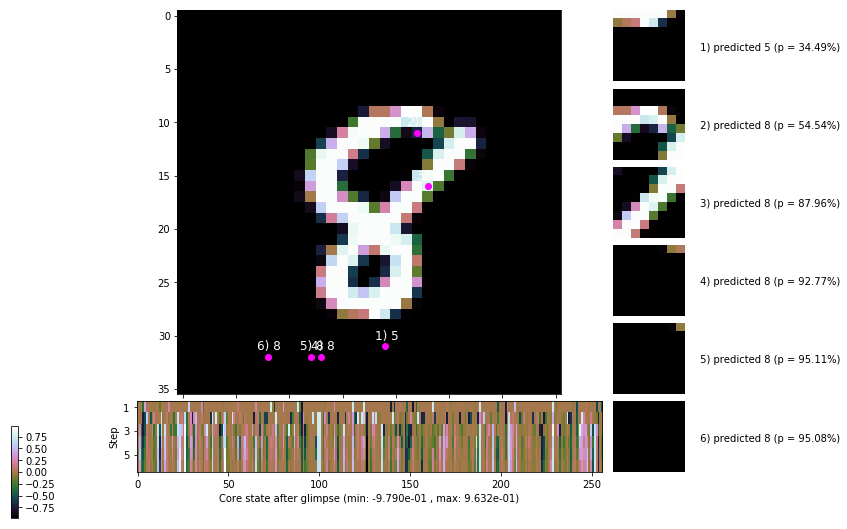

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


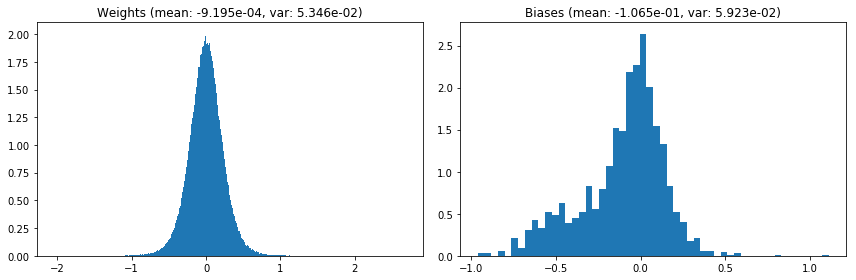

                                      Location network weights and biases


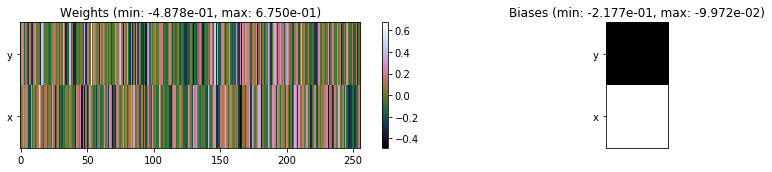

---------------------------------------------------------------------------------------------------------------
Elapsed time:  446.61 sec | TRAIN >> class loss: 0.4495 | steps:  2.397 :( | reward:  4.0733    | acc.: 85.020% :(
                          | VAL   >> class loss: 0.4509 | steps:  2.315 :( | reward:  4.1883    | acc.: 85.380% :(


Epoch  22/400) lr = 0.0007297
 b    300/  3000 >> 144.6 ms/b | lr: 7.29e-04 | grad 2norm: 12.28 | grad inf norm:  3.138
         Weights || abs max:  2.69 ( 2755.29) | mean: -9.21e-04 ( 0.01) | var: 5.35e-02 (  111.22)
          Biases || abs max:  1.11 (   93.95) | mean: -1.07e-01 ( 0.09) | var: 5.95e-02 (   34.14)
                    class loss: 0.456 | steps: 2.384 | reward:  4.076 | acc.: 84.95%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 146.5 ms/b | lr: 7.28e-04 | grad 2norm: 12.37 | grad inf norm:  3.290
         Weights || abs max:  2.70 ( 3976.58) | mean: -8.96e-04 (

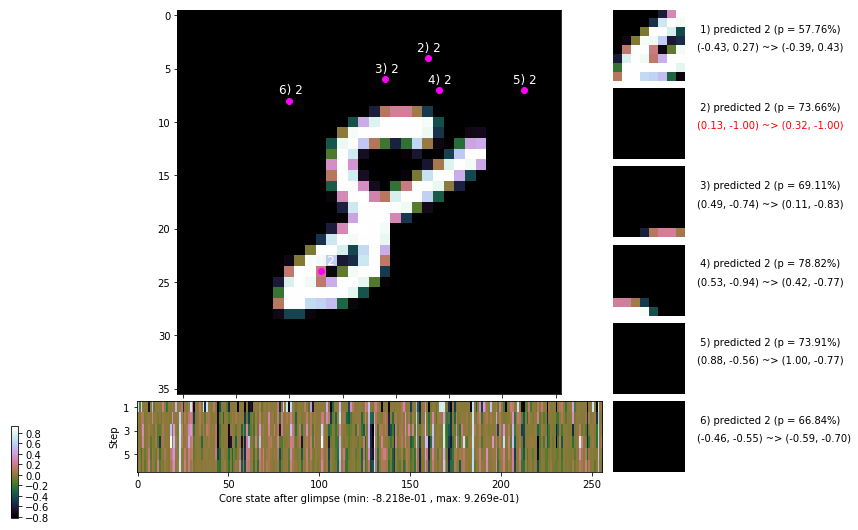

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 149.9 ms/b | lr: 7.27e-04 | grad 2norm: 12.46 | grad inf norm:  3.346
         Weights || abs max:  2.70 ( 3468.75) | mean: -8.83e-04 ( 0.02) | var: 5.38e-02 (  400.63)
          Biases || abs max:  1.11 (  565.85) | mean: -1.06e-01 ( 0.28) | var: 5.96e-02 (13779.20)
                    class loss: 0.461 | steps: 2.428 | reward:  4.032 | acc.: 84.45%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 145.9 ms/b | lr: 7.26e-04 | grad 2norm: 12.51 | grad inf norm:  3.268
         Weights || abs max:  2.70 ( 4322.37) | mean: -8.93e-04 ( 0.02) | var: 5.39e-02 (  733.59)
          Biases || abs max:  1.11 (   79.67) | mean: -1.07e-01 ( 0.09) | var: 5.99e-02 (   59.22)
                    class loss: 0.473 | steps: 2.413 | reward:  4.048 | acc.: 84.23%

	Target class: 1 | Discounted rewards: [0.869, 1.938, 1.8

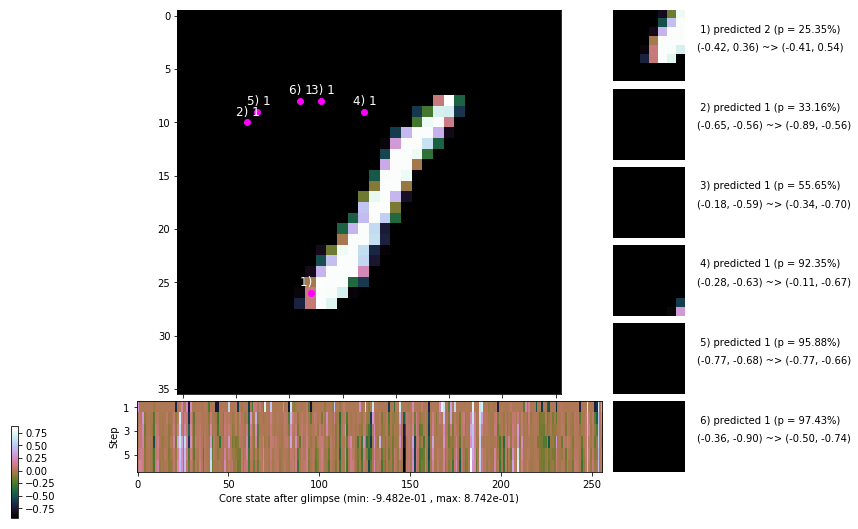

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 146.0 ms/b | lr: 7.25e-04 | grad 2norm: 12.67 | grad inf norm:  3.406
         Weights || abs max:  2.72 ( 9730.03) | mean: -8.90e-04 ( 0.03) | var: 5.40e-02 ( 6450.31)
          Biases || abs max:  1.11 (  126.47) | mean: -1.07e-01 ( 0.11) | var: 5.98e-02 (  188.25)
                    class loss: 0.463 | steps: 2.420 | reward:  4.034 | acc.: 84.20%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 146.4 ms/b | lr: 7.24e-04 | grad 2norm: 12.25 | grad inf norm:  3.164
         Weights || abs max:  2.73 ( 3329.42) | mean: -9.04e-04 ( 0.02) | var: 5.42e-02 (  223.78)
          Biases || abs max:  1.11 (   68.26) | mean: -1.08e-01 ( 0.08) | var: 6.00e-02 (   25.75)
                    class loss: 0.450 | steps: 2.381 | reward:  4.078 | acc.: 84.95%

	Target class: 6 | Discounted rewards: [0.319, 0.837, 1.8

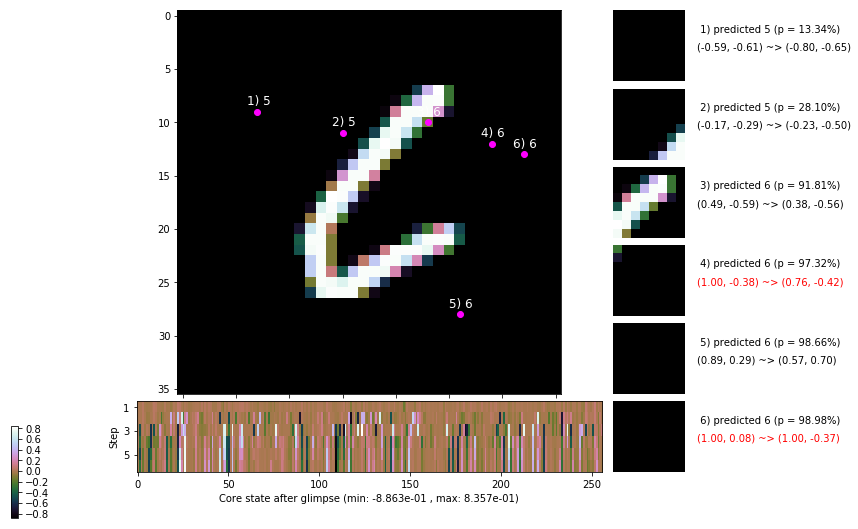

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 149.6 ms/b | lr: 7.22e-04 | grad 2norm: 12.57 | grad inf norm:  3.246
         Weights || abs max:  2.74 ( 7830.11) | mean: -9.20e-04 ( 0.02) | var: 5.43e-02 (13698.53)
          Biases || abs max:  1.12 (   90.65) | mean: -1.08e-01 ( 0.10) | var: 6.02e-02 (   48.61)
                    class loss: 0.458 | steps: 2.409 | reward:  4.051 | acc.: 84.27%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 146.9 ms/b | lr: 7.22e-04 | grad 2norm: 12.39 | grad inf norm:  3.439
         Weights || abs max:  2.74 ( 6314.62) | mean: -8.92e-04 ( 0.02) | var: 5.44e-02 ( 3055.17)
          Biases || abs max:  1.13 (   60.39) | mean: -1.07e-01 ( 0.07) | var: 6.03e-02 (    7.88)
                    class loss: 0.438 | steps: 2.350 | reward:  4.129 | acc.: 85.30%

	Target class: 2 | Discounted rewards: [0.869, 1.938, 1.8

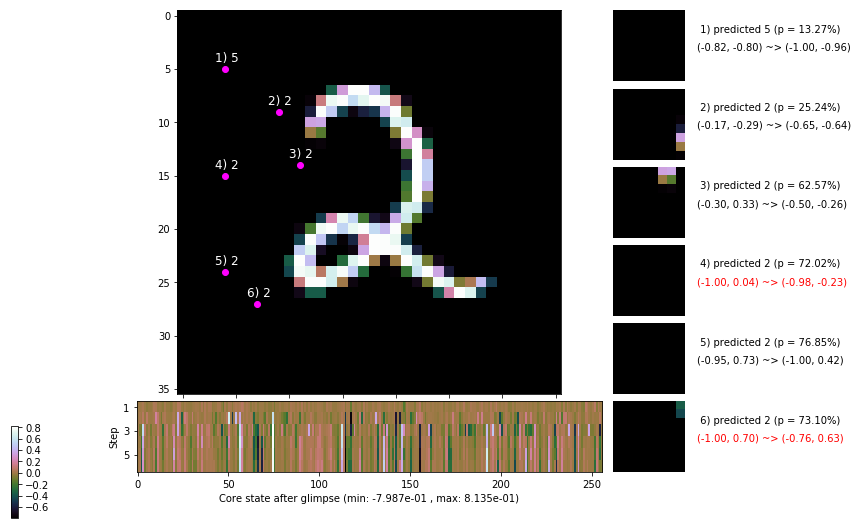

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 147.6 ms/b | lr: 7.20e-04 | grad 2norm: 12.36 | grad inf norm:  3.286
         Weights || abs max:  2.75 ( 3209.76) | mean: -8.75e-04 ( 0.01) | var: 5.45e-02 (  396.04)
          Biases || abs max:  1.14 (  506.50) | mean: -1.08e-01 ( 0.25) | var: 6.07e-02 (18063.08)
                    class loss: 0.447 | steps: 2.398 | reward:  4.090 | acc.: 85.25%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.0 ms/b | lr: 7.20e-04 | grad 2norm: 12.37 | grad inf norm:  3.288
         Weights || abs max:  2.75 ( 2863.48) | mean: -8.76e-04 ( 0.01) | var: 5.47e-02 (  194.51)
          Biases || abs max:  1.13 (   73.79) | mean: -1.08e-01 ( 0.09) | var: 6.08e-02 (   10.77)
                    class loss: 0.441 | steps: 2.392 | reward:  4.079 | acc.: 84.97%

	Target class: 0 | Discounted rewards: [0.319, 0.837, 1.8

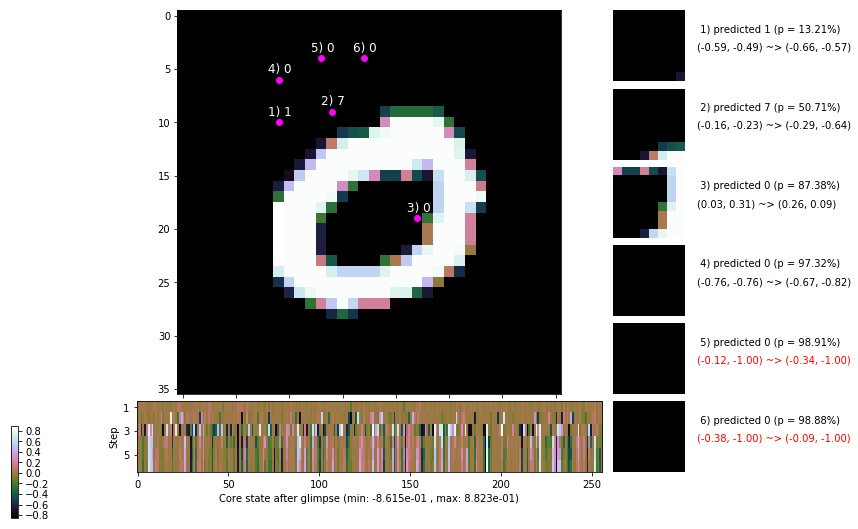

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


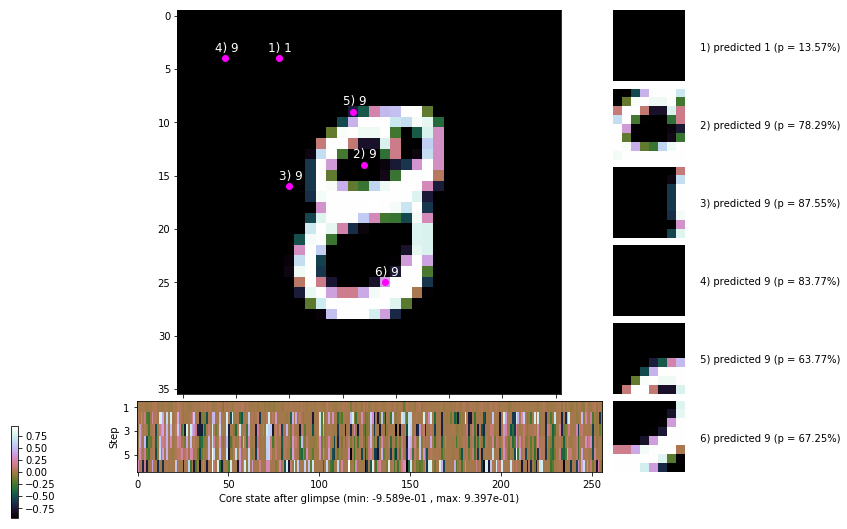


	Target class: 7 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


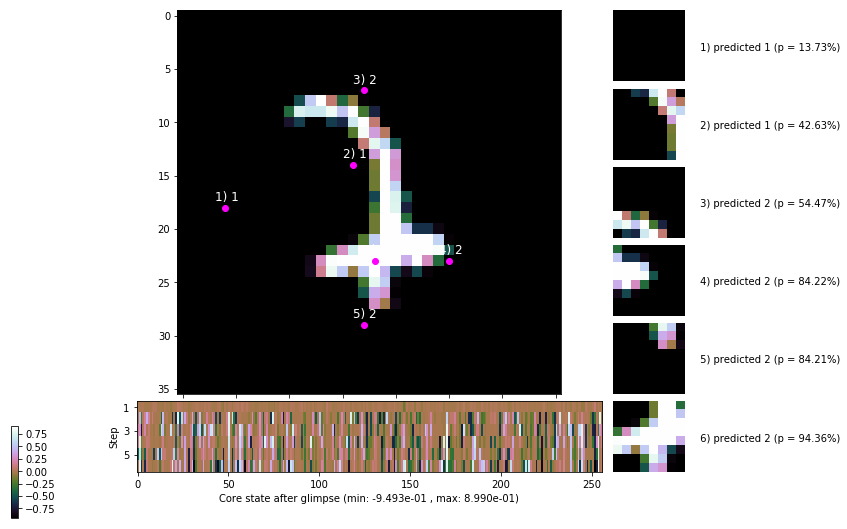

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


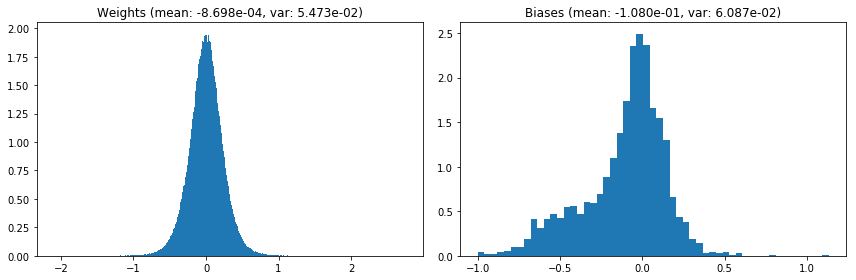

                                      Location network weights and biases


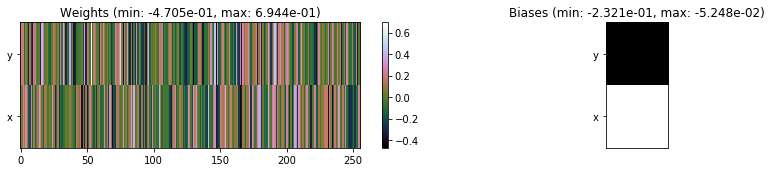

---------------------------------------------------------------------------------------------------------------
Elapsed time:  440.20 sec | TRAIN >> class loss: 0.4539 | steps:  2.400 :( | reward:  4.0668 :( | acc.: 84.727% :(
                          | VAL   >> class loss: 0.4626 | steps:  2.335 :( | reward:  4.1571 :( | acc.: 83.860% :(


Epoch  23/400) lr = 0.0007188
 b    300/  3000 >> 142.3 ms/b | lr: 7.18e-04 | grad 2norm: 12.42 | grad inf norm:  3.502
         Weights || abs max:  2.74 ( 2184.05) | mean: -8.71e-04 ( 0.01) | var: 5.48e-02 (   66.97)
          Biases || abs max:  1.13 (   77.57) | mean: -1.08e-01 ( 0.08) | var: 6.10e-02 (   18.30)
                    class loss: 0.439 | steps: 2.400 | reward:  4.067 | acc.: 84.98%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 141.1 ms/b | lr: 7.17e-04 | grad 2norm: 12.34 | grad inf norm:  3.266
         Weights || abs max:  2.75 ( 7681.70) | mean: -8.89e-04 (

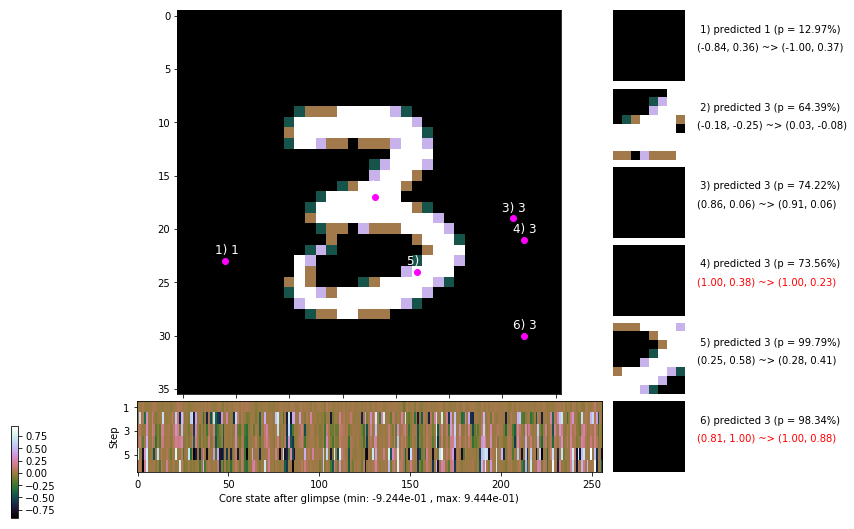

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 148.1 ms/b | lr: 7.16e-04 | grad 2norm: 12.18 | grad inf norm:  3.198
         Weights || abs max:  2.76 ( 2704.04) | mean: -9.10e-04 ( 0.01) | var: 5.50e-02 (   84.53)
          Biases || abs max:  1.13 (  100.70) | mean: -1.08e-01 ( 0.10) | var: 6.14e-02 (   48.04)
                    class loss: 0.445 | steps: 2.367 | reward:  4.119 | acc.: 85.30%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 147.1 ms/b | lr: 7.15e-04 | grad 2norm: 12.52 | grad inf norm:  3.351
         Weights || abs max:  2.78 ( 2197.02) | mean: -8.91e-04 ( 0.01) | var: 5.51e-02 (   61.41)
          Biases || abs max:  1.12 (  291.83) | mean: -1.08e-01 ( 0.20) | var: 6.16e-02 ( 2472.16)
                    class loss: 0.463 | steps: 2.422 | reward:  4.029 | acc.: 84.42%

	Target class: 4 | Discounted rewards: [0.319, 0.837, 1.8

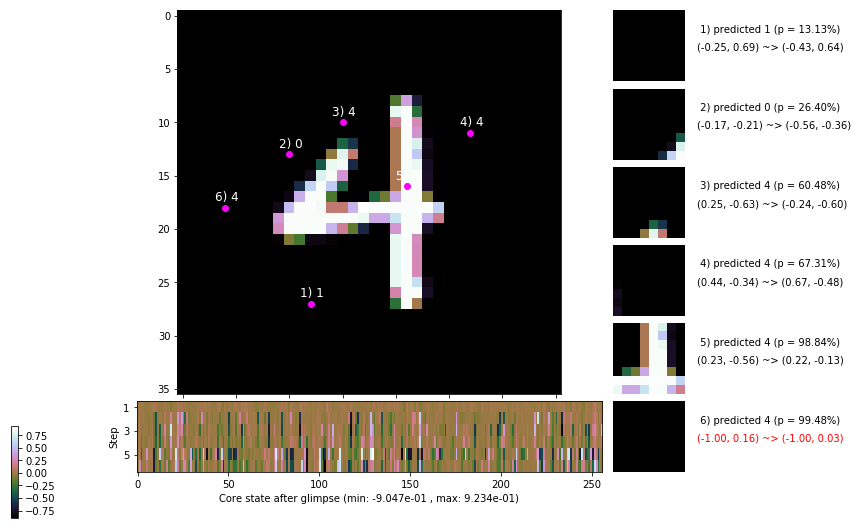

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 144.1 ms/b | lr: 7.14e-04 | grad 2norm: 12.49 | grad inf norm:  3.254
         Weights || abs max:  2.80 (56366.42) | mean: -8.84e-04 ( 0.11) | var: 5.53e-02 (1418871.38)
          Biases || abs max:  1.12 (  101.82) | mean: -1.09e-01 ( 0.11) | var: 6.20e-02 (   97.79)
                    class loss: 0.453 | steps: 2.426 | reward:  4.048 | acc.: 84.67%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 143.6 ms/b | lr: 7.13e-04 | grad 2norm: 12.41 | grad inf norm:  3.340
         Weights || abs max:  2.80 ( 3886.20) | mean: -8.81e-04 ( 0.02) | var: 5.54e-02 (  525.09)
          Biases || abs max:  1.12 (  113.67) | mean: -1.09e-01 ( 0.10) | var: 6.19e-02 (  145.67)
                    class loss: 0.476 | steps: 2.419 | reward:  4.046 | acc.: 83.98%

	Target class: 3 | Discounted rewards: [0.869, 1.938, 1

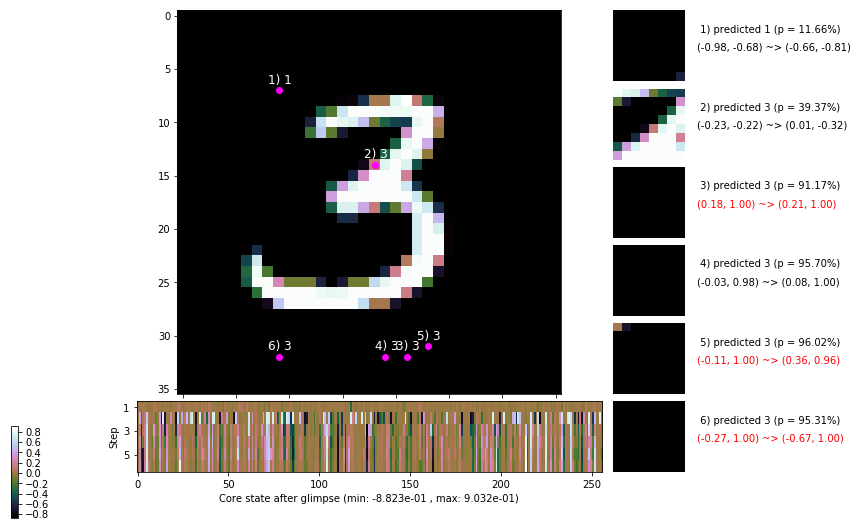

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 149.1 ms/b | lr: 7.12e-04 | grad 2norm: 12.46 | grad inf norm:  3.282
         Weights || abs max:  2.81 ( 3774.35) | mean: -8.53e-04 ( 0.02) | var: 5.55e-02 ( 1214.52)
          Biases || abs max:  1.12 (  100.53) | mean: -1.09e-01 ( 0.10) | var: 6.21e-02 (   62.43)
                    class loss: 0.486 | steps: 2.428 | reward:  4.025 | acc.: 83.53%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 143.3 ms/b | lr: 7.11e-04 | grad 2norm: 12.52 | grad inf norm:  3.325
         Weights || abs max:  2.82 ( 9791.75) | mean: -8.62e-04 ( 0.03) | var: 5.56e-02 ( 9245.79)
          Biases || abs max:  1.12 (  826.63) | mean: -1.10e-01 ( 0.38) | var: 6.24e-02 (35826.97)
                    class loss: 0.499 | steps: 2.455 | reward:  4.000 | acc.: 83.15%

	Target class: 0 | Discounted rewards: [1.728, 1.456, 0.9

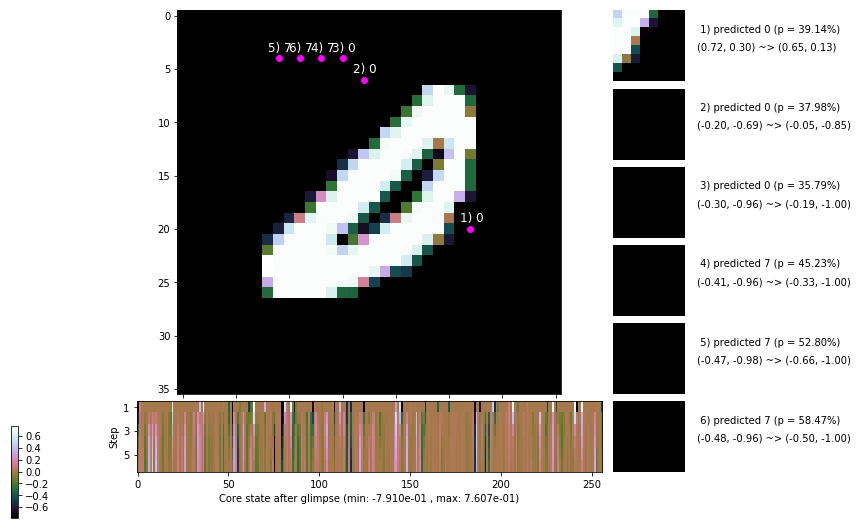

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.0 ms/b | lr: 7.10e-04 | grad 2norm: 12.42 | grad inf norm:  3.355
         Weights || abs max:  2.83 ( 2793.46) | mean: -8.63e-04 ( 0.01) | var: 5.58e-02 (  115.79)
          Biases || abs max:  1.12 (   89.63) | mean: -1.10e-01 ( 0.09) | var: 6.26e-02 (   53.91)
                    class loss: 0.482 | steps: 2.449 | reward:  4.009 | acc.: 84.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.3 ms/b | lr: 7.09e-04 | grad 2norm: 12.44 | grad inf norm:  3.271
         Weights || abs max:  2.84 ( 3501.11) | mean: -8.51e-04 ( 0.02) | var: 5.59e-02 (  295.74)
          Biases || abs max:  1.11 (  129.05) | mean: -1.10e-01 ( 0.10) | var: 6.28e-02 (  117.03)
                    class loss: 0.467 | steps: 2.422 | reward:  4.054 | acc.: 84.48%

	Target class: 5 | Discounted rewards: [0.869, 1.938, 1.8

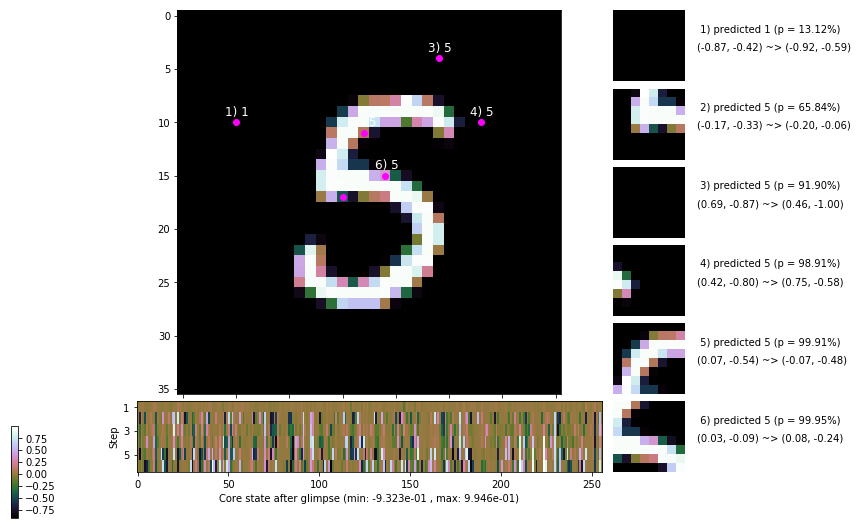

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [1.934, 1.869, 1.737, 1.475, 0.950, -0.100]


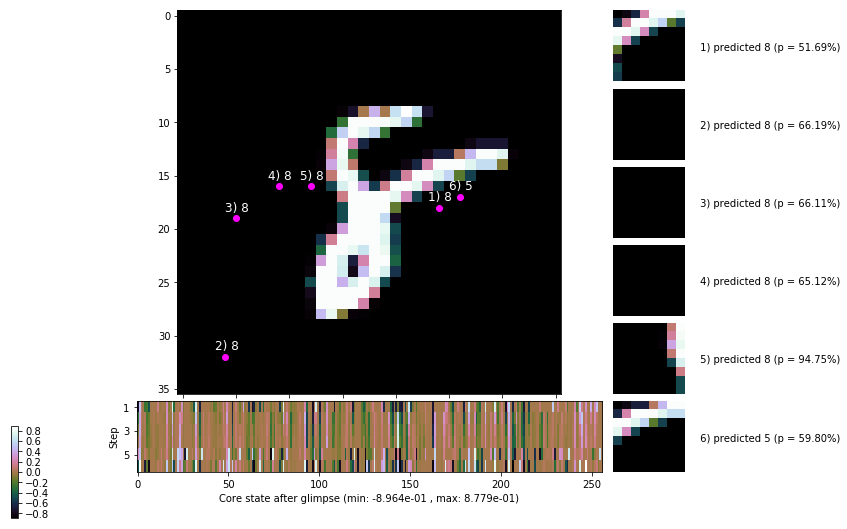


	Target class: 3 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


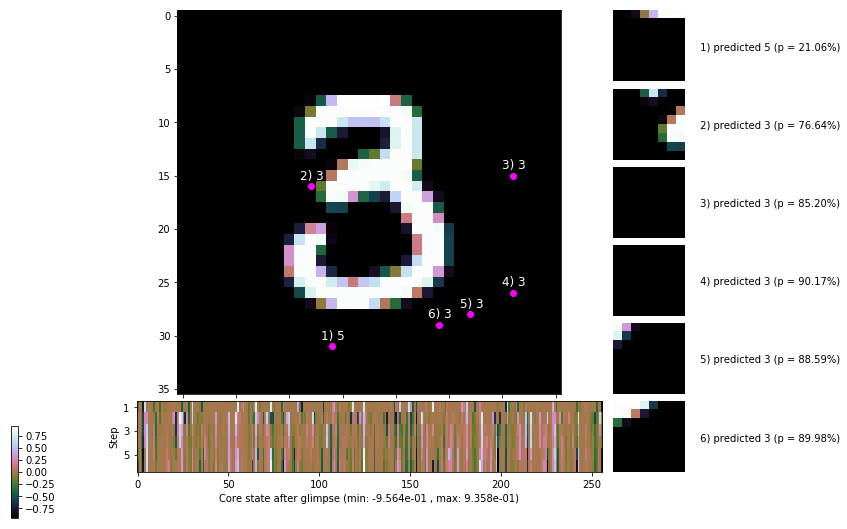

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


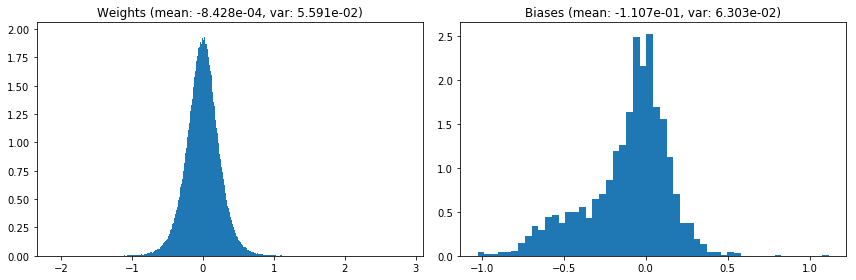

                                      Location network weights and biases


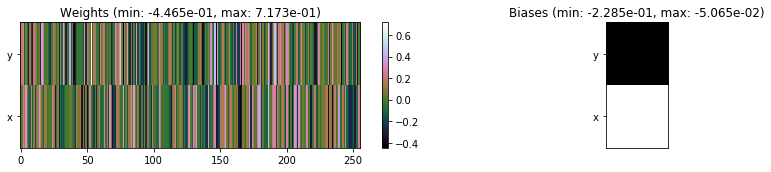

---------------------------------------------------------------------------------------------------------------
Elapsed time:  435.11 sec | TRAIN >> class loss: 0.4662 | steps:  2.418 :( | reward:  4.0474 :( | acc.: 84.372% :(
                          | VAL   >> class loss: 0.4730 | steps:  2.331 :( | reward:  4.1399 :( | acc.: 83.780% :(


Epoch  24/400) lr = 0.0007081
 b    300/  3000 >> 141.6 ms/b | lr: 7.07e-04 | grad 2norm: 12.62 | grad inf norm:  3.381
         Weights || abs max:  2.86 ( 6797.61) | mean: -8.31e-04 ( 0.02) | var: 5.60e-02 ( 7702.10)
          Biases || abs max:  1.11 ( 7050.77) | mean: -1.11e-01 ( 2.80) | var: 6.31e-02 (5514287.00)
                    class loss: 0.489 | steps: 2.424 | reward:  4.007 | acc.: 83.05%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 140.4 ms/b | lr: 7.07e-04 | grad 2norm: 12.12 | grad inf norm:  3.253
         Weights || abs max:  2.87 ( 4737.64) | mean: -8.04e-04

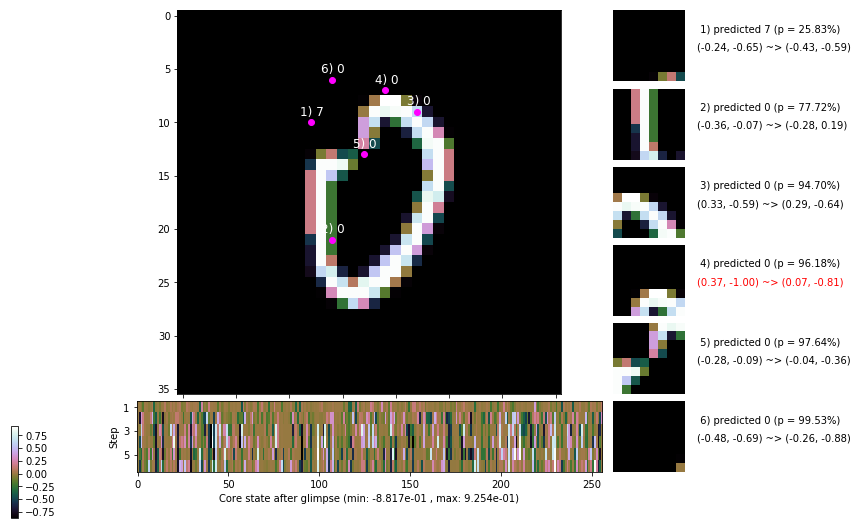

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.2 ms/b | lr: 7.05e-04 | grad 2norm: 12.45 | grad inf norm:  3.442
         Weights || abs max:  2.89 ( 2294.94) | mean: -7.83e-04 ( 0.01) | var: 5.62e-02 (   87.91)
          Biases || abs max:  1.11 (  141.59) | mean: -1.11e-01 ( 0.12) | var: 6.34e-02 (  106.94)
                    class loss: 0.498 | steps: 2.453 | reward:  3.984 | acc.: 83.08%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 140.0 ms/b | lr: 7.05e-04 | grad 2norm: 12.29 | grad inf norm:  3.233
         Weights || abs max:  2.91 ( 2852.10) | mean: -8.17e-04 ( 0.01) | var: 5.63e-02 (  527.19)
          Biases || abs max:  1.11 (  490.11) | mean: -1.11e-01 ( 0.25) | var: 6.36e-02 (15834.22)
                    class loss: 0.495 | steps: 2.455 | reward:  4.006 | acc.: 83.67%

	Target class: 3 | Discounted rewards: [-0.197, -0.194, -

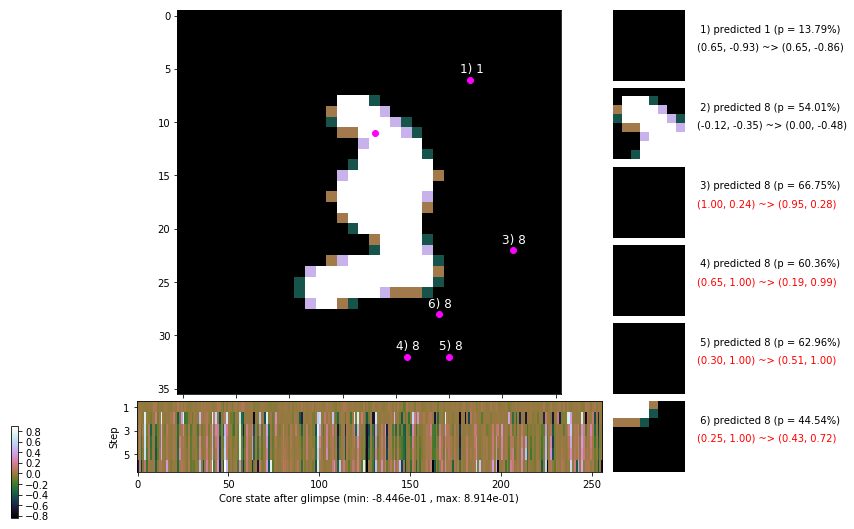

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 141.3 ms/b | lr: 7.03e-04 | grad 2norm: 12.30 | grad inf norm:  3.299
         Weights || abs max:  2.92 ( 5111.23) | mean: -8.27e-04 ( 0.02) | var: 5.64e-02 (  773.78)
          Biases || abs max:  1.11 (  225.85) | mean: -1.11e-01 ( 0.16) | var: 6.36e-02 (  755.52)
                    class loss: 0.485 | steps: 2.430 | reward:  4.009 | acc.: 83.58%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.9 ms/b | lr: 7.02e-04 | grad 2norm: 12.50 | grad inf norm:  3.318
         Weights || abs max:  2.92 ( 3039.14) | mean: -7.87e-04 ( 0.01) | var: 5.66e-02 (  305.97)
          Biases || abs max:  1.11 (  104.83) | mean: -1.12e-01 ( 0.09) | var: 6.37e-02 (   63.80)
                    class loss: 0.502 | steps: 2.478 | reward:  3.982 | acc.: 83.67%

	Target class: 8 | Discounted rewards: [-0.197, -0.194, -

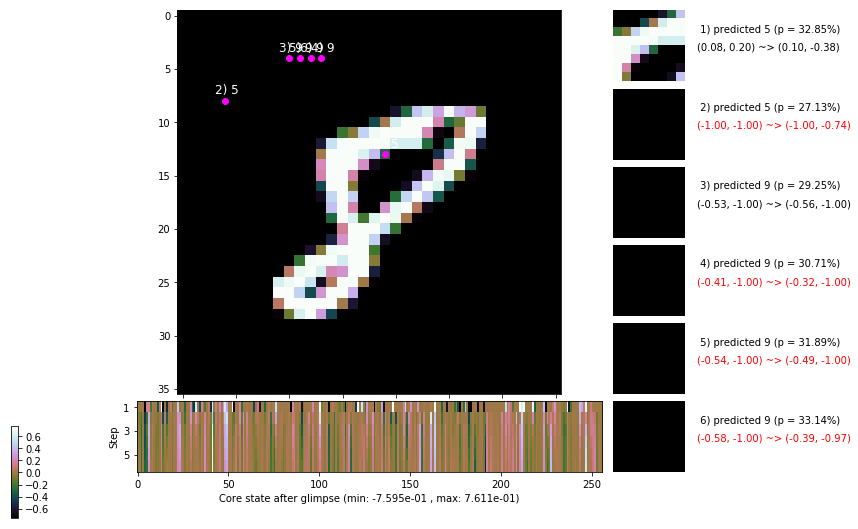

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.9 ms/b | lr: 7.01e-04 | grad 2norm: 12.27 | grad inf norm:  3.207
         Weights || abs max:  2.93 ( 2167.64) | mean: -7.92e-04 ( 0.01) | var: 5.67e-02 (   50.96)
          Biases || abs max:  1.11 (  107.09) | mean: -1.13e-01 ( 0.09) | var: 6.40e-02 (   69.45)
                    class loss: 0.471 | steps: 2.401 | reward:  4.062 | acc.: 84.42%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 144.0 ms/b | lr: 7.00e-04 | grad 2norm: 12.21 | grad inf norm:  3.167
         Weights || abs max:  2.93 ( 5308.02) | mean: -8.06e-04 ( 0.02) | var: 5.68e-02 ( 1219.01)
          Biases || abs max:  1.12 (   90.35) | mean: -1.13e-01 ( 0.09) | var: 6.41e-02 (   86.22)
                    class loss: 0.452 | steps: 2.374 | reward:  4.101 | acc.: 84.88%

	Target class: 2 | Discounted rewards: [0.044, 0.287, 0.7

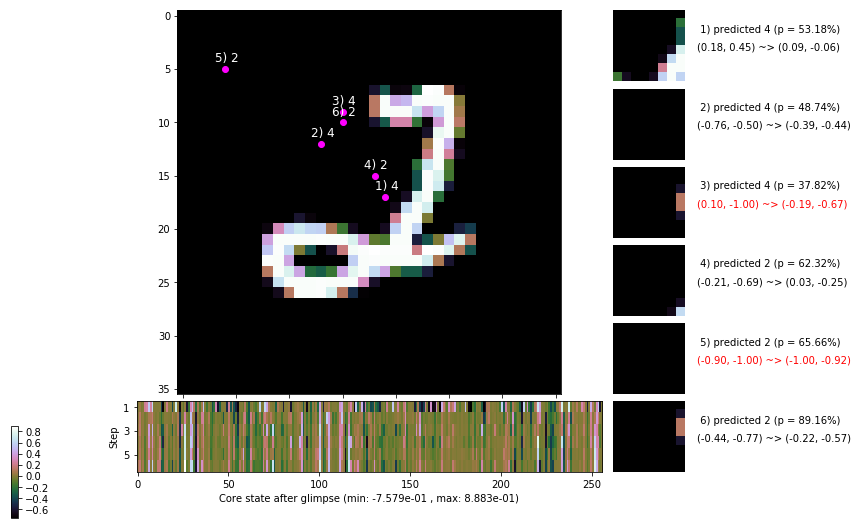

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 147.0 ms/b | lr: 6.99e-04 | grad 2norm: 12.55 | grad inf norm:  3.328
         Weights || abs max:  2.93 ( 2363.62) | mean: -8.35e-04 ( 0.01) | var: 5.69e-02 (   86.82)
          Biases || abs max:  1.12 (  111.66) | mean: -1.13e-01 ( 0.11) | var: 6.44e-02 (  192.00)
                    class loss: 0.458 | steps: 2.370 | reward:  4.087 | acc.: 84.55%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 145.3 ms/b | lr: 6.98e-04 | grad 2norm: 12.37 | grad inf norm:  3.242
         Weights || abs max:  2.92 ( 4457.05) | mean: -8.30e-04 ( 0.02) | var: 5.70e-02 (  667.21)
          Biases || abs max:  1.12 (  167.48) | mean: -1.13e-01 ( 0.13) | var: 6.46e-02 (  431.32)
                    class loss: 0.472 | steps: 2.415 | reward:  4.054 | acc.: 84.47%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

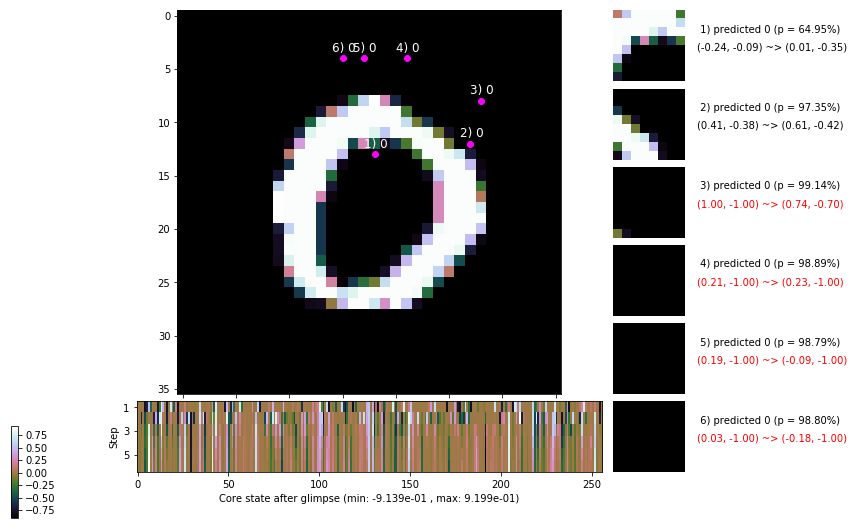

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


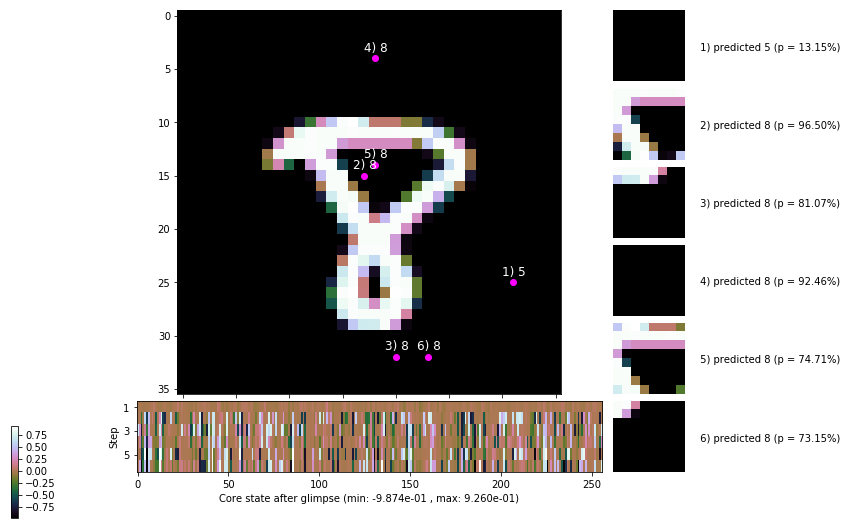


	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


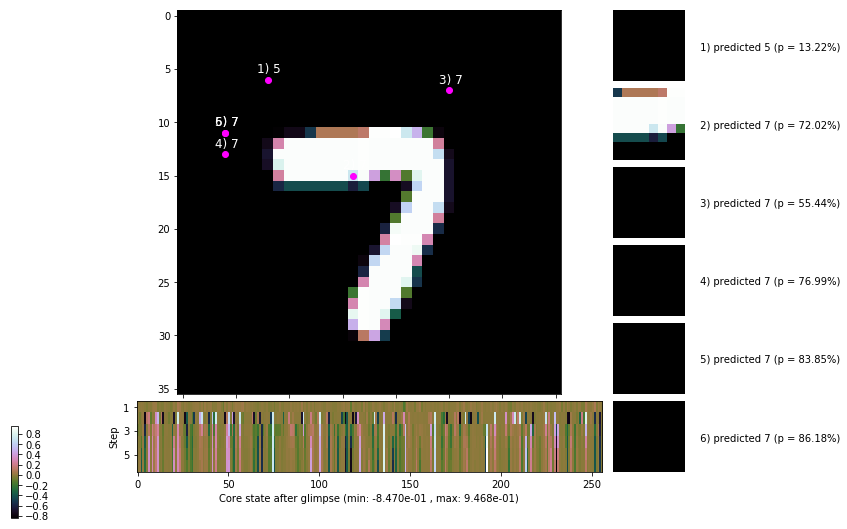

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


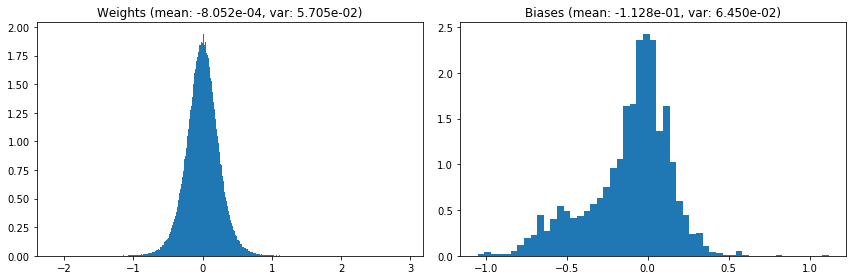

                                      Location network weights and biases


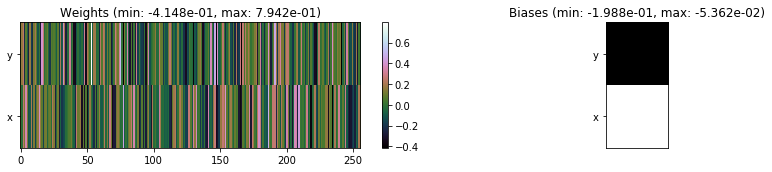

---------------------------------------------------------------------------------------------------------------
Elapsed time:  429.75 sec | TRAIN >> class loss: 0.4783 | steps:  2.421 :( | reward:  4.0360 :( | acc.: 84.037% :(
                          | VAL   >> class loss: 0.4463 | steps:  2.292    | reward:  4.1923    | acc.: 85.280% :(


Epoch  25/400) lr = 0.0006976
 b    300/  3000 >> 143.1 ms/b | lr: 6.97e-04 | grad 2norm: 12.36 | grad inf norm:  3.240
         Weights || abs max:  2.93 ( 3413.57) | mean: -7.96e-04 ( 0.02) | var: 5.71e-02 (  205.23)
          Biases || abs max:  1.12 (  125.04) | mean: -1.13e-01 ( 0.11) | var: 6.47e-02 (  240.88)
                    class loss: 0.444 | steps: 2.380 | reward:  4.093 | acc.: 84.87%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 146.1 ms/b | lr: 6.96e-04 | grad 2norm: 12.35 | grad inf norm:  3.187
         Weights || abs max:  2.94 ( 3346.84) | mean: -8.28e-04 (

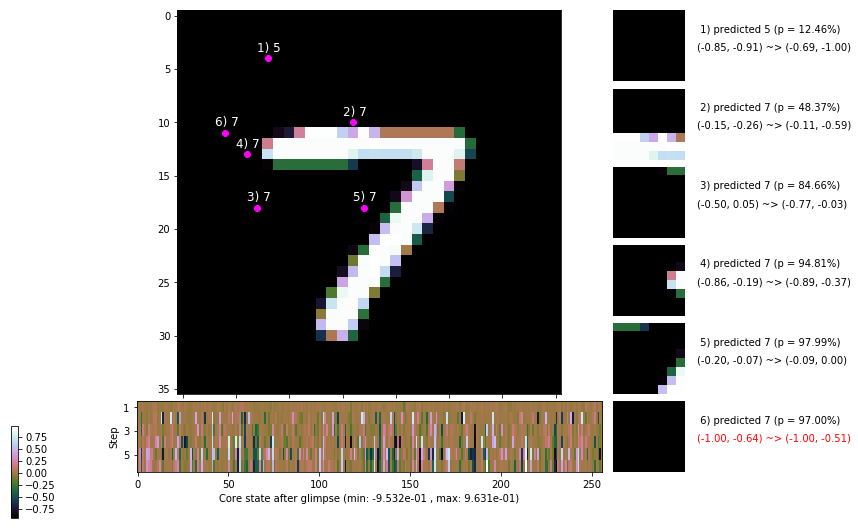

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.2 ms/b | lr: 6.95e-04 | grad 2norm: 12.56 | grad inf norm:  3.259
         Weights || abs max:  2.94 ( 7592.27) | mean: -8.13e-04 ( 0.02) | var: 5.73e-02 ( 6111.62)
          Biases || abs max:  1.11 (   63.13) | mean: -1.14e-01 ( 0.08) | var: 6.53e-02 (    9.55)
                    class loss: 0.491 | steps: 2.450 | reward:  3.991 | acc.: 83.32%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.8 ms/b | lr: 6.94e-04 | grad 2norm: 12.29 | grad inf norm:  3.309
         Weights || abs max:  2.95 ( 5487.14) | mean: -8.47e-04 ( 0.02) | var: 5.74e-02 (  926.19)
          Biases || abs max:  1.12 (  275.82) | mean: -1.14e-01 ( 0.17) | var: 6.53e-02 ( 3026.92)
                    class loss: 0.463 | steps: 2.395 | reward:  4.082 | acc.: 84.42%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

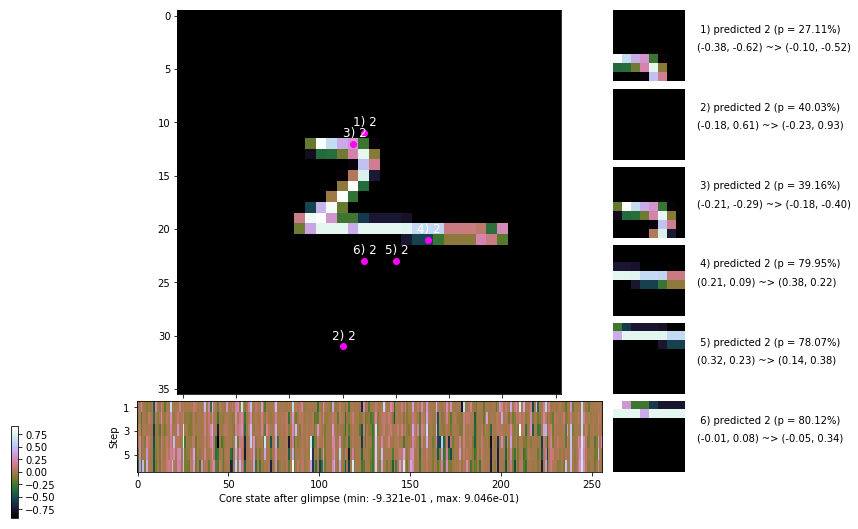

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 141.3 ms/b | lr: 6.93e-04 | grad 2norm: 12.11 | grad inf norm:  3.068
         Weights || abs max:  2.96 ( 2352.96) | mean: -8.48e-04 ( 0.01) | var: 5.76e-02 (  102.55)
          Biases || abs max:  1.12 (  145.32) | mean: -1.15e-01 ( 0.12) | var: 6.54e-02 (  252.14)
                    class loss: 0.454 | steps: 2.389 | reward:  4.086 | acc.: 84.38%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 139.4 ms/b | lr: 6.92e-04 | grad 2norm: 12.29 | grad inf norm:  3.339
         Weights || abs max:  2.96 ( 2472.52) | mean: -8.54e-04 ( 0.01) | var: 5.77e-02 (  147.45)
          Biases || abs max:  1.12 (   76.28) | mean: -1.14e-01 ( 0.09) | var: 6.57e-02 (   25.80)
                    class loss: 0.465 | steps: 2.429 | reward:  4.047 | acc.: 84.42%

	Target class: 8 | Discounted rewards: [0.869, 1.938, 1.8

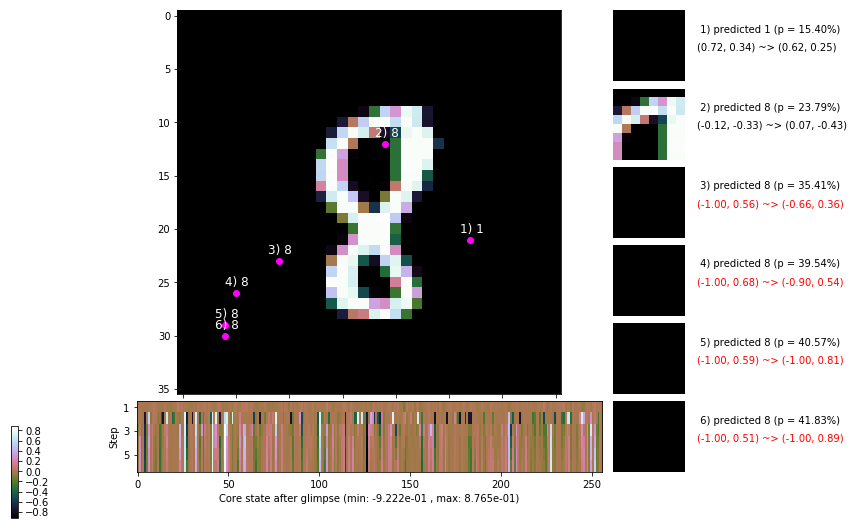

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.1 ms/b | lr: 6.91e-04 | grad 2norm: 12.51 | grad inf norm:  3.489
         Weights || abs max:  2.96 ( 4542.06) | mean: -8.70e-04 ( 0.02) | var: 5.78e-02 (  748.73)
          Biases || abs max:  1.12 (  104.60) | mean: -1.15e-01 ( 0.10) | var: 6.59e-02 (   86.91)
                    class loss: 0.479 | steps: 2.476 | reward:  3.982 | acc.: 83.55%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 140.7 ms/b | lr: 6.90e-04 | grad 2norm: 12.17 | grad inf norm:  3.234
         Weights || abs max:  2.97 ( 2779.54) | mean: -8.68e-04 ( 0.01) | var: 5.79e-02 (  148.68)
          Biases || abs max:  1.12 (   68.07) | mean: -1.15e-01 ( 0.08) | var: 6.59e-02 (   22.71)
                    class loss: 0.451 | steps: 2.370 | reward:  4.095 | acc.: 84.97%

	Target class: 1 | Discounted rewards: [0.869, 1.938, 1.8

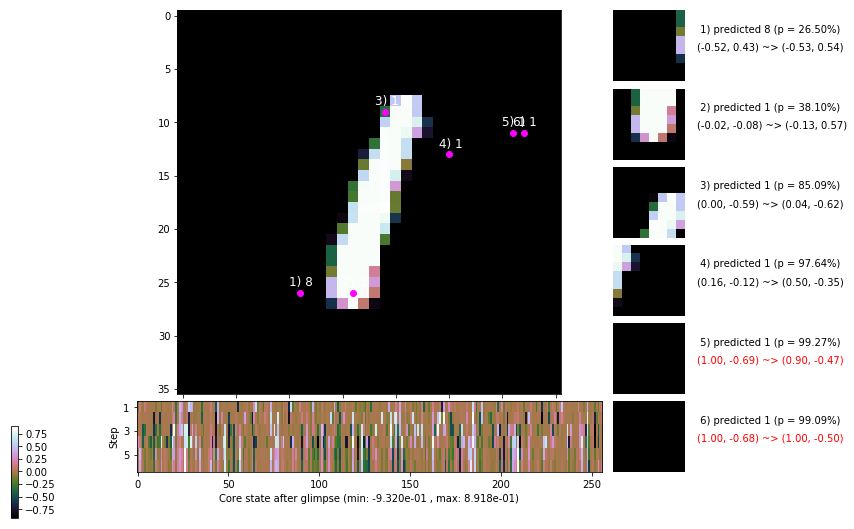

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 141.1 ms/b | lr: 6.89e-04 | grad 2norm: 12.33 | grad inf norm:  3.429
         Weights || abs max:  3.00 ( 2834.77) | mean: -8.77e-04 ( 0.01) | var: 5.80e-02 (  196.60)
          Biases || abs max:  1.13 (   87.40) | mean: -1.14e-01 ( 0.09) | var: 6.60e-02 (   59.71)
                    class loss: 0.465 | steps: 2.394 | reward:  4.074 | acc.: 84.35%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.4 ms/b | lr: 6.88e-04 | grad 2norm: 12.20 | grad inf norm:  3.286
         Weights || abs max:  3.01 ( 2962.85) | mean: -8.70e-04 ( 0.01) | var: 5.81e-02 (  300.99)
          Biases || abs max:  1.13 (  101.44) | mean: -1.15e-01 ( 0.09) | var: 6.61e-02 (   76.03)
                    class loss: 0.459 | steps: 2.383 | reward:  4.083 | acc.: 85.08%

	Target class: 8 | Discounted rewards: [0.044, 0.287, 0.7

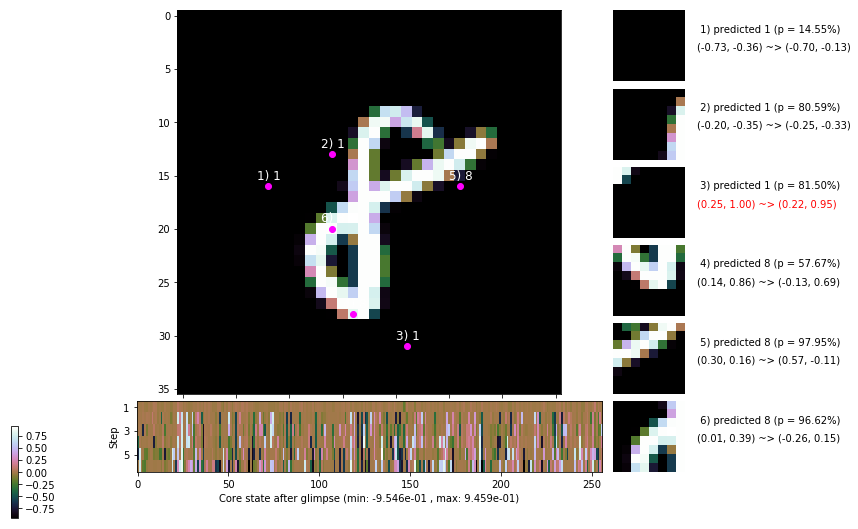

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


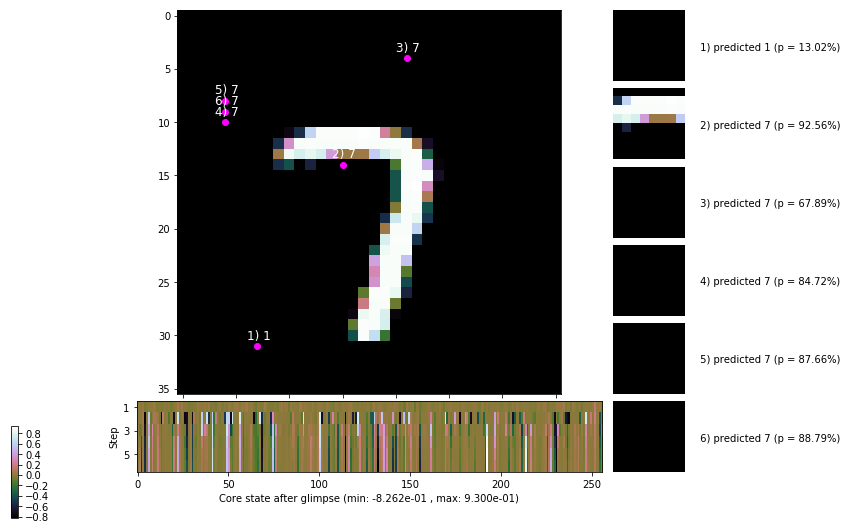


	Target class: 4 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


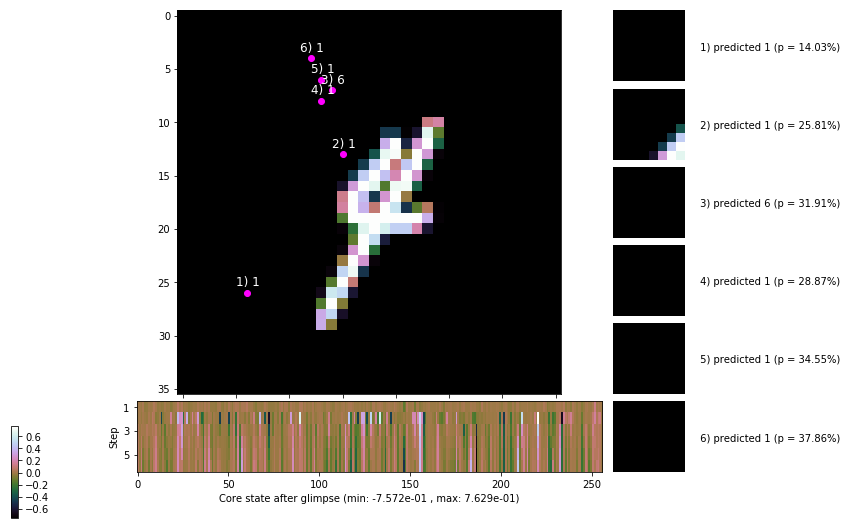

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


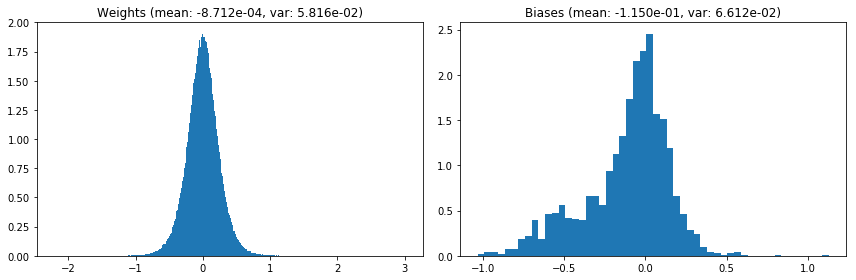

                                      Location network weights and biases


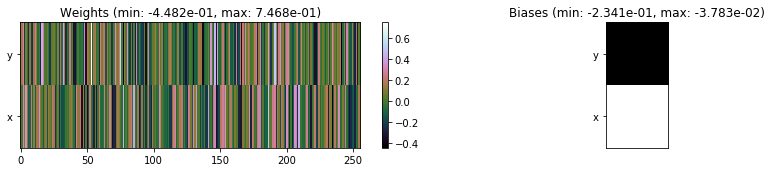

---------------------------------------------------------------------------------------------------------------
Elapsed time:  427.71 sec | TRAIN >> class loss: 0.4638 | steps:  2.405 :( | reward:  4.0597 :( | acc.: 84.382% :(
                          | VAL   >> class loss: 0.4510 | steps:  2.307 :( | reward:  4.1905 :( | acc.: 84.620% :(


Epoch  26/400) lr = 0.0006872
 b    300/  3000 >> 145.3 ms/b | lr: 6.86e-04 | grad 2norm: 12.32 | grad inf norm:  3.367
         Weights || abs max:  3.00 ( 3899.75) | mean: -8.81e-04 ( 0.02) | var: 5.82e-02 (  324.35)
          Biases || abs max:  1.12 (  103.42) | mean: -1.16e-01 ( 0.11) | var: 6.63e-02 (   30.05)
                    class loss: 0.468 | steps: 2.427 | reward:  4.028 | acc.: 83.87%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 141.7 ms/b | lr: 6.86e-04 | grad 2norm: 12.10 | grad inf norm:  3.303
         Weights || abs max:  2.99 ( 3559.89) | mean: -8.63e-04 (

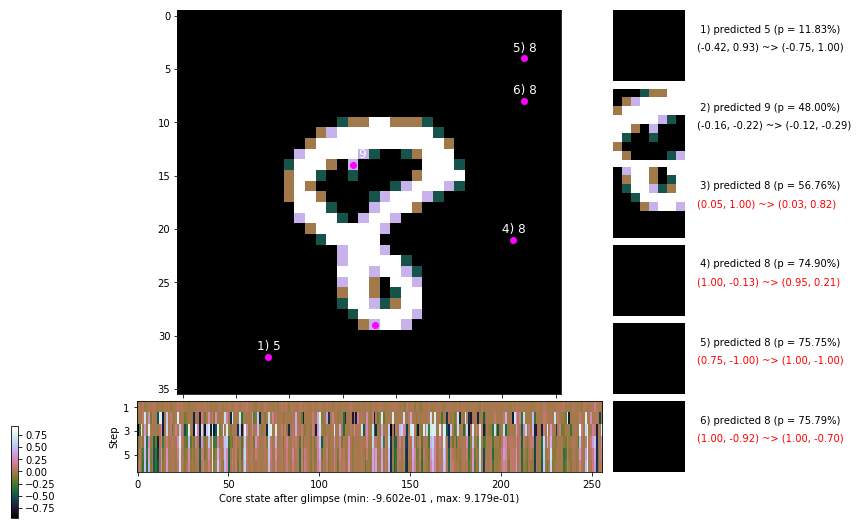

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 148.3 ms/b | lr: 6.84e-04 | grad 2norm: 12.15 | grad inf norm:  3.330
         Weights || abs max:  3.00 ( 3148.37) | mean: -8.75e-04 ( 0.01) | var: 5.84e-02 (  469.87)
          Biases || abs max:  1.12 (  110.95) | mean: -1.15e-01 ( 0.11) | var: 6.66e-02 (   52.98)
                    class loss: 0.467 | steps: 2.416 | reward:  4.032 | acc.: 84.08%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 147.3 ms/b | lr: 6.84e-04 | grad 2norm: 11.99 | grad inf norm:  3.319
         Weights || abs max:  3.02 ( 3250.66) | mean: -8.92e-04 ( 0.01) | var: 5.86e-02 (  167.83)
          Biases || abs max:  1.12 (  163.28) | mean: -1.15e-01 ( 0.14) | var: 6.68e-02 (  118.76)
                    class loss: 0.450 | steps: 2.374 | reward:  4.110 | acc.: 84.93%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

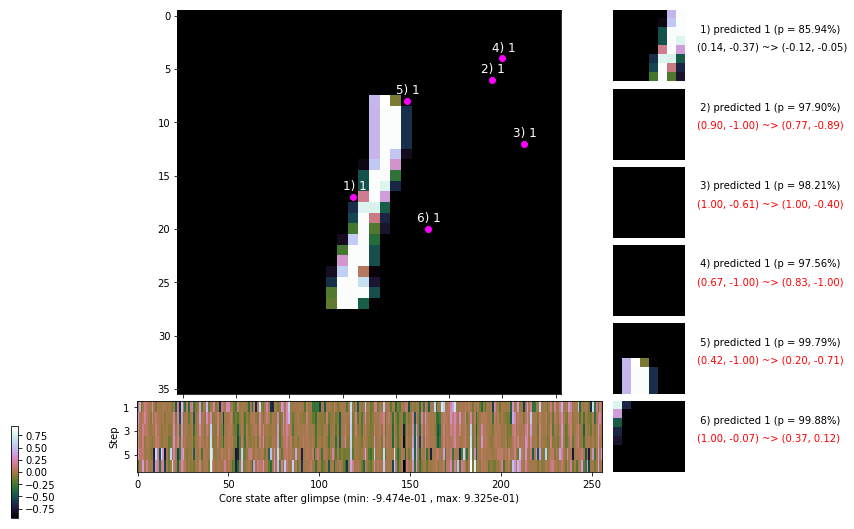

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 146.2 ms/b | lr: 6.82e-04 | grad 2norm: 12.42 | grad inf norm:  3.361
         Weights || abs max:  3.00 ( 3950.24) | mean: -8.87e-04 ( 0.02) | var: 5.87e-02 (  406.50)
          Biases || abs max:  1.11 (  299.54) | mean: -1.16e-01 ( 0.19) | var: 6.70e-02 ( 2787.03)
                    class loss: 0.489 | steps: 2.448 | reward:  4.001 | acc.: 83.50%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.8 ms/b | lr: 6.82e-04 | grad 2norm: 12.08 | grad inf norm:  3.378
         Weights || abs max:  2.99 ( 2410.76) | mean: -8.65e-04 ( 0.01) | var: 5.88e-02 (   90.98)
          Biases || abs max:  1.11 (  590.03) | mean: -1.16e-01 ( 0.30) | var: 6.71e-02 (22009.44)
                    class loss: 0.476 | steps: 2.429 | reward:  4.044 | acc.: 84.37%

	Target class: 5 | Discounted rewards: [0.353, 0.906, -0.

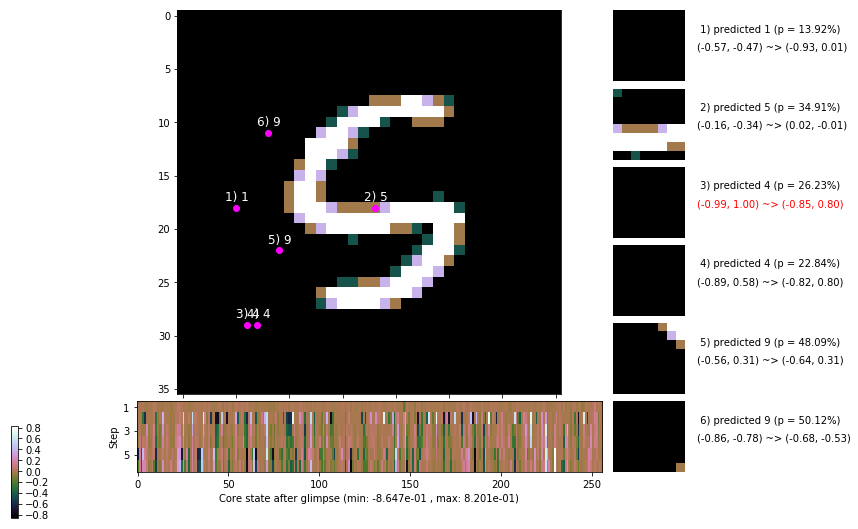

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.7 ms/b | lr: 6.80e-04 | grad 2norm: 12.05 | grad inf norm:  3.388
         Weights || abs max:  3.01 ( 2922.34) | mean: -8.65e-04 ( 0.01) | var: 5.89e-02 (  302.14)
          Biases || abs max:  1.11 (  723.28) | mean: -1.15e-01 ( 0.37) | var: 6.73e-02 (27795.28)
                    class loss: 0.494 | steps: 2.418 | reward:  4.054 | acc.: 83.73%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 142.0 ms/b | lr: 6.80e-04 | grad 2norm: 12.11 | grad inf norm:  3.300
         Weights || abs max:  3.01 ( 8346.25) | mean: -8.38e-04 ( 0.02) | var: 5.90e-02 ( 6657.31)
          Biases || abs max:  1.11 (  404.12) | mean: -1.16e-01 ( 0.23) | var: 6.75e-02 ( 3367.69)
                    class loss: 0.484 | steps: 2.458 | reward:  4.006 | acc.: 83.75%

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.8

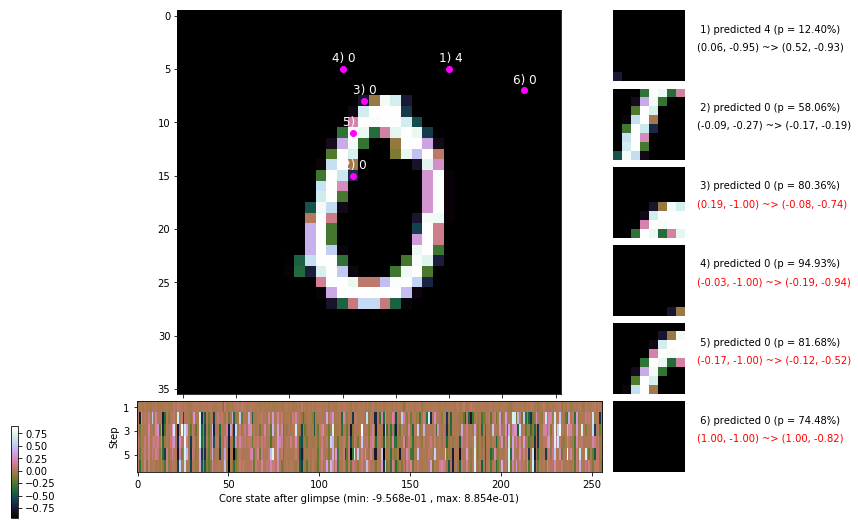

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 144.3 ms/b | lr: 6.78e-04 | grad 2norm: 12.37 | grad inf norm:  3.338
         Weights || abs max:  3.02 ( 5650.77) | mean: -8.31e-04 ( 0.02) | var: 5.91e-02 ( 2426.39)
          Biases || abs max:  1.11 (  102.66) | mean: -1.16e-01 ( 0.11) | var: 6.74e-02 (   47.06)
                    class loss: 0.495 | steps: 2.416 | reward:  4.023 | acc.: 83.45%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.4 ms/b | lr: 6.78e-04 | grad 2norm: 12.11 | grad inf norm:  3.266
         Weights || abs max:  3.04 (27709.77) | mean: -8.54e-04 ( 0.06) | var: 5.92e-02 (339639.59)
          Biases || abs max:  1.11 (   67.59) | mean: -1.16e-01 ( 0.08) | var: 6.77e-02 (   10.13)
                    class loss: 0.477 | steps: 2.393 | reward:  4.060 | acc.: 83.90%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.

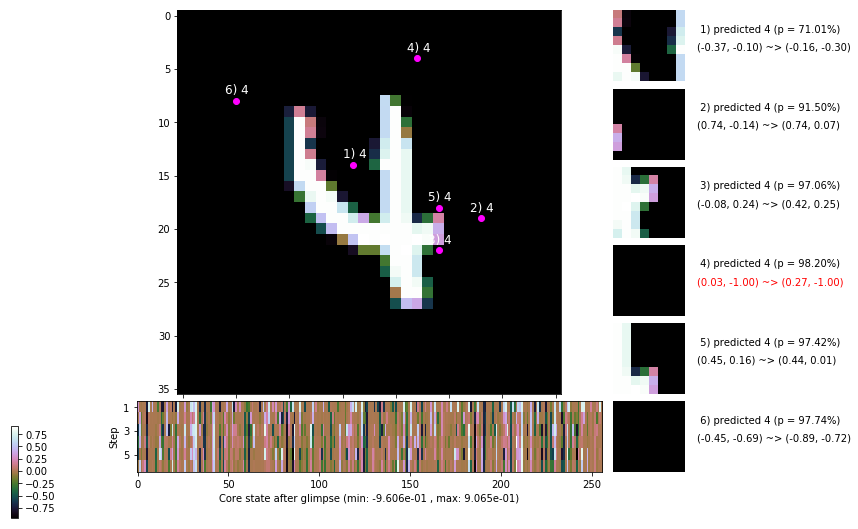

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


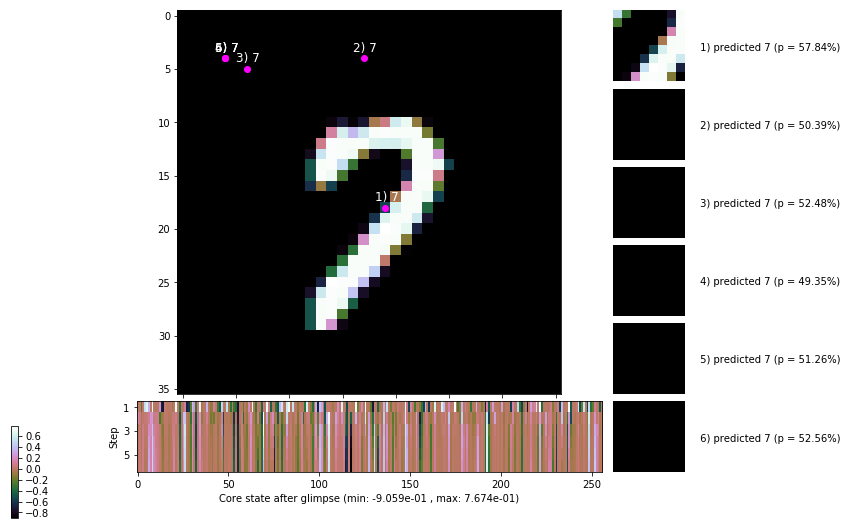


	Target class: 9 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


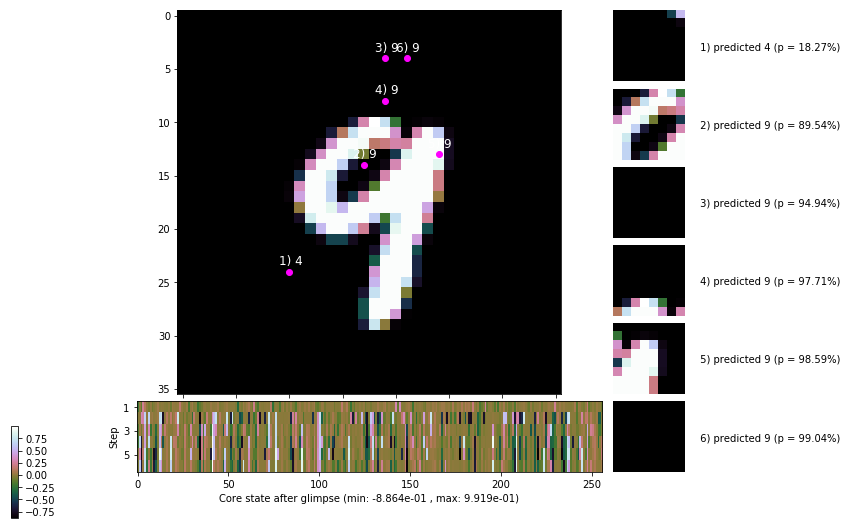

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


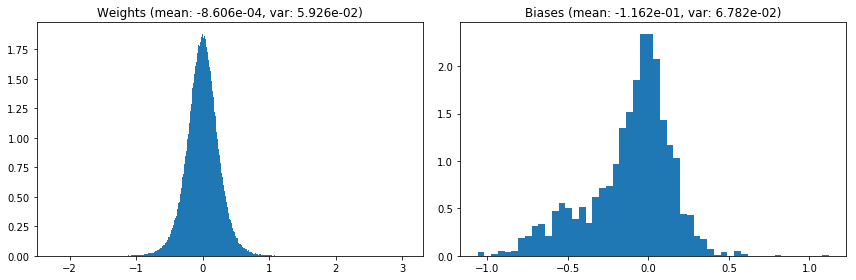

                                      Location network weights and biases


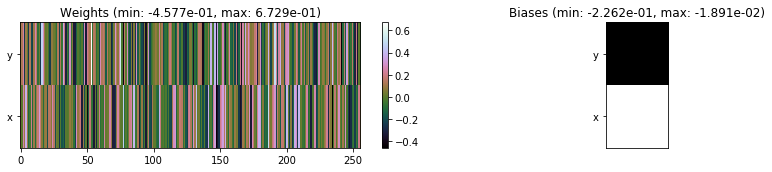

---------------------------------------------------------------------------------------------------------------
Elapsed time:  434.05 sec | TRAIN >> class loss: 0.4763 | steps:  2.419 :( | reward:  4.0418 :( | acc.: 84.002% :(
                          | VAL   >> class loss: 0.5060 | steps:  2.375 :( | reward:  4.0754 :( | acc.: 83.440% :(


Epoch  27/400) lr = 0.0006769
 b    300/  3000 >> 140.4 ms/b | lr: 6.76e-04 | grad 2norm: 12.03 | grad inf norm:  3.251
         Weights || abs max:  3.04 ( 6786.25) | mean: -8.52e-04 ( 0.02) | var: 5.93e-02 ( 7834.92)
          Biases || abs max:  1.11 (   83.14) | mean: -1.17e-01 ( 0.10) | var: 6.79e-02 (   21.42)
                    class loss: 0.493 | steps: 2.407 | reward:  4.038 | acc.: 83.50%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 139.1 ms/b | lr: 6.76e-04 | grad 2norm: 12.04 | grad inf norm:  3.113
         Weights || abs max:  3.04 ( 3818.00) | mean: -8.61e-04 (

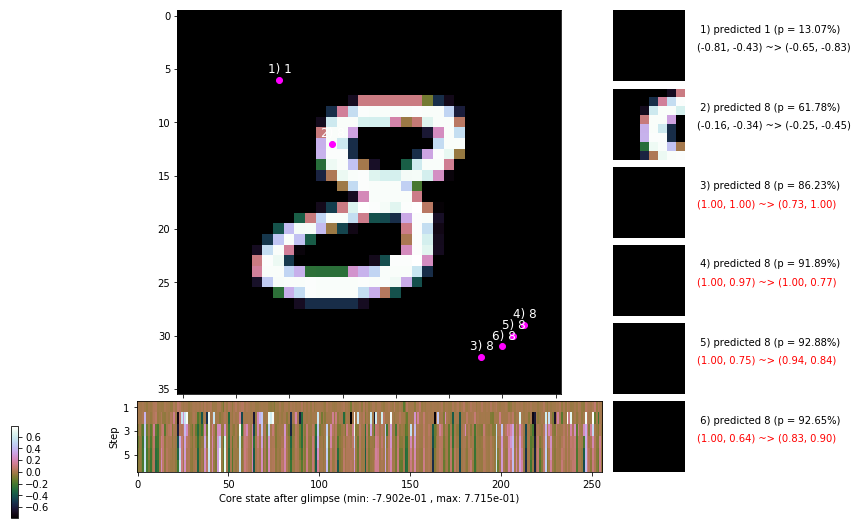

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.5 ms/b | lr: 6.74e-04 | grad 2norm: 12.20 | grad inf norm:  3.399
         Weights || abs max:  3.03 ( 6102.23) | mean: -8.58e-04 ( 0.02) | var: 5.95e-02 ( 2913.34)
          Biases || abs max:  1.11 (  126.40) | mean: -1.16e-01 ( 0.12) | var: 6.82e-02 (   88.55)
                    class loss: 0.490 | steps: 2.431 | reward:  4.024 | acc.: 83.17%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 146.4 ms/b | lr: 6.74e-04 | grad 2norm: 12.35 | grad inf norm:  3.378
         Weights || abs max:  3.05 (41542.67) | mean: -8.45e-04 ( 0.09) | var: 5.96e-02 (708352.00)
          Biases || abs max:  1.10 (  179.26) | mean: -1.17e-01 ( 0.14) | var: 6.83e-02 (  265.66)
                    class loss: 0.520 | steps: 2.436 | reward:  3.998 | acc.: 82.85%

	Target class: 0 | Discounted rewards: [1.419, 0.837, 1.

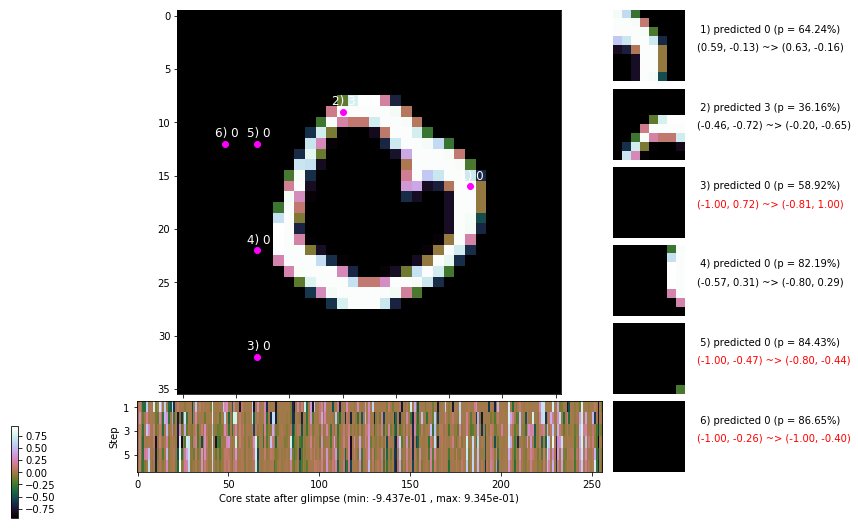

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 145.3 ms/b | lr: 6.72e-04 | grad 2norm: 12.18 | grad inf norm:  3.456
         Weights || abs max:  3.06 ( 2622.33) | mean: -8.52e-04 ( 0.01) | var: 5.98e-02 (   88.29)
          Biases || abs max:  1.10 (  175.89) | mean: -1.17e-01 ( 0.13) | var: 6.83e-02 (  650.53)
                    class loss: 0.489 | steps: 2.437 | reward:  4.004 | acc.: 82.98%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.1 ms/b | lr: 6.72e-04 | grad 2norm: 12.36 | grad inf norm:  3.471
         Weights || abs max:  3.06 ( 6846.82) | mean: -8.50e-04 ( 0.02) | var: 5.99e-02 ( 5518.59)
          Biases || abs max:  1.10 (  104.66) | mean: -1.17e-01 ( 0.10) | var: 6.84e-02 (  179.21)
                    class loss: 0.479 | steps: 2.425 | reward:  4.038 | acc.: 84.00%

	Target class: 5 | Discounted rewards: [0.903, -0.194, -0

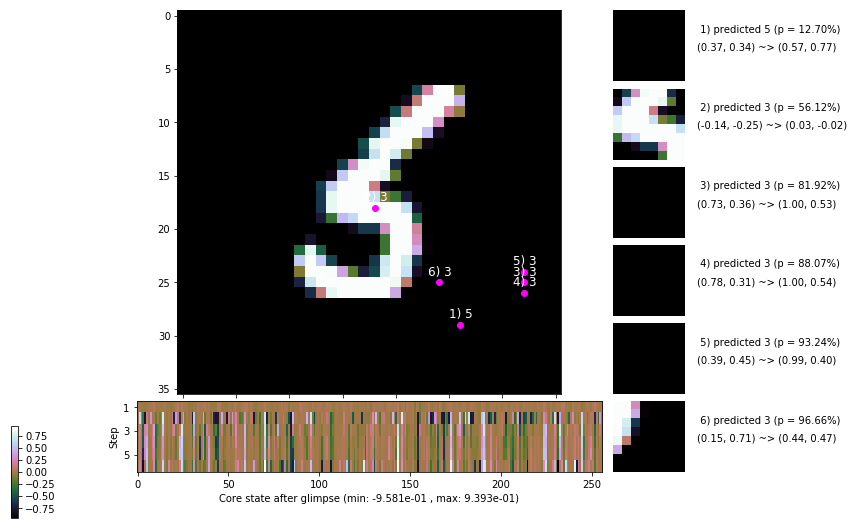

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 147.4 ms/b | lr: 6.70e-04 | grad 2norm: 12.25 | grad inf norm:  3.341
         Weights || abs max:  3.06 ( 3261.07) | mean: -8.32e-04 ( 0.02) | var: 6.00e-02 (  128.03)
          Biases || abs max:  1.11 (   87.43) | mean: -1.17e-01 ( 0.10) | var: 6.86e-02 (   76.54)
                    class loss: 0.471 | steps: 2.400 | reward:  4.065 | acc.: 84.03%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.6 ms/b | lr: 6.70e-04 | grad 2norm: 12.34 | grad inf norm:  3.411
         Weights || abs max:  3.06 ( 2059.19) | mean: -8.26e-04 ( 0.01) | var: 6.01e-02 (   69.36)
          Biases || abs max:  1.10 (  236.84) | mean: -1.17e-01 ( 0.15) | var: 6.88e-02 ( 1233.89)
                    class loss: 0.475 | steps: 2.412 | reward:  4.031 | acc.: 84.02%

	Target class: 6 | Discounted rewards: [0.869, 1.938, 1.8

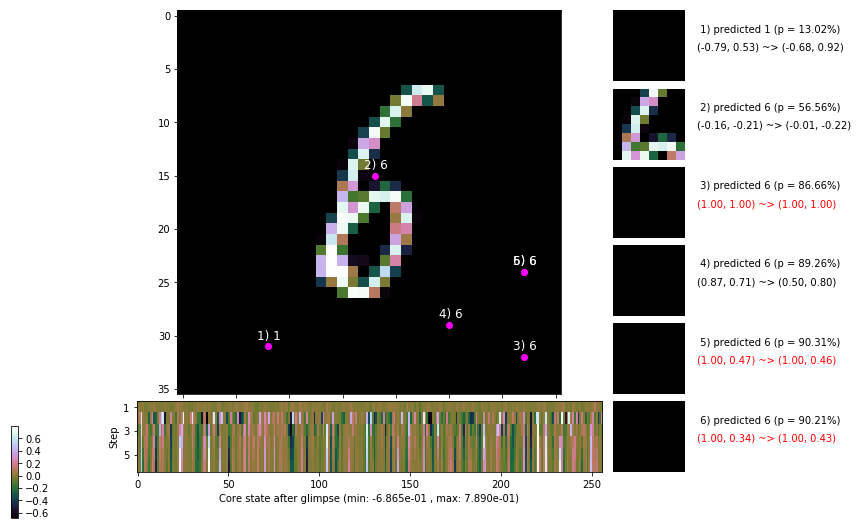

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.7 ms/b | lr: 6.68e-04 | grad 2norm: 12.41 | grad inf norm:  3.313
         Weights || abs max:  3.06 ( 2229.60) | mean: -8.09e-04 ( 0.01) | var: 6.02e-02 (   56.12)
          Biases || abs max:  1.11 (  107.16) | mean: -1.18e-01 ( 0.10) | var: 6.91e-02 (  125.65)
                    class loss: 0.456 | steps: 2.393 | reward:  4.070 | acc.: 84.48%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 145.9 ms/b | lr: 6.68e-04 | grad 2norm: 12.26 | grad inf norm:  3.256
         Weights || abs max:  3.08 ( 2949.22) | mean: -7.94e-04 ( 0.01) | var: 6.03e-02 (  171.27)
          Biases || abs max:  1.11 (  114.06) | mean: -1.17e-01 ( 0.11) | var: 6.93e-02 (   26.28)
                    class loss: 0.490 | steps: 2.425 | reward:  4.023 | acc.: 83.68%

	Target class: 5 | Discounted rewards: [0.044, 0.287, 0.7

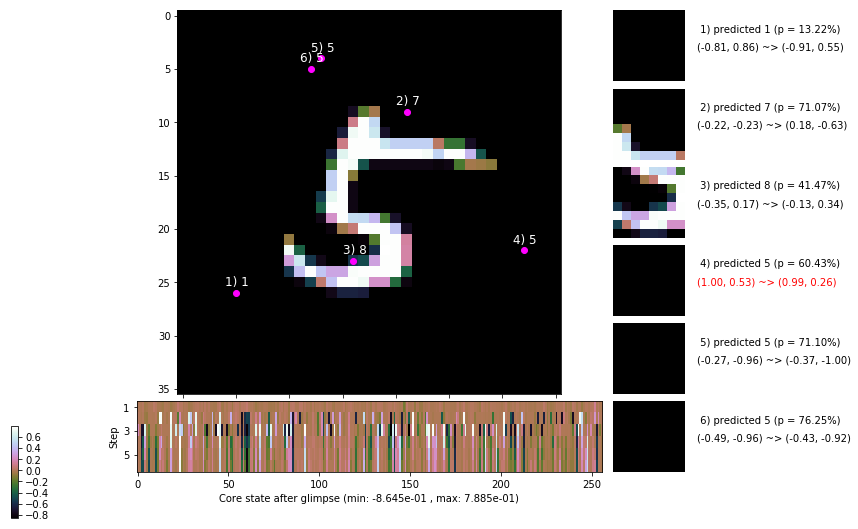

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


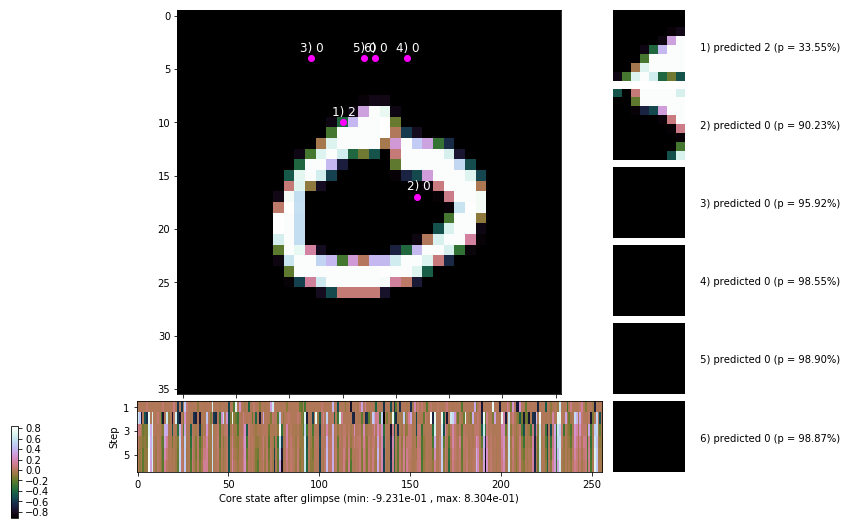


	Target class: 0 | Discounted rewards: [-0.094, 0.012, 0.225, 0.650, 1.500, 1.000]


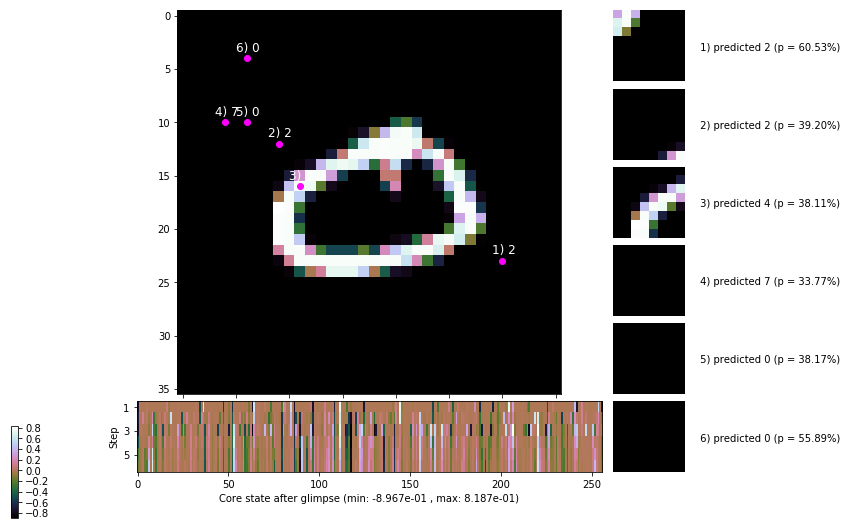

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


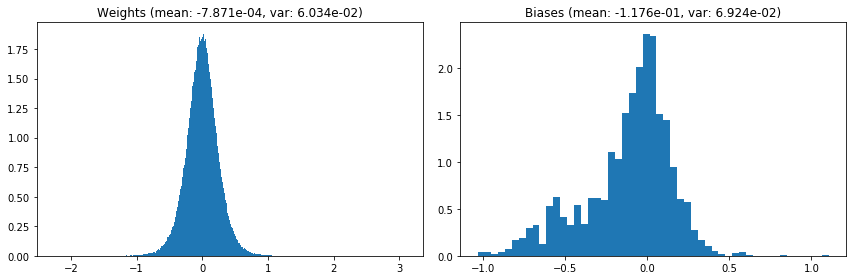

                                      Location network weights and biases


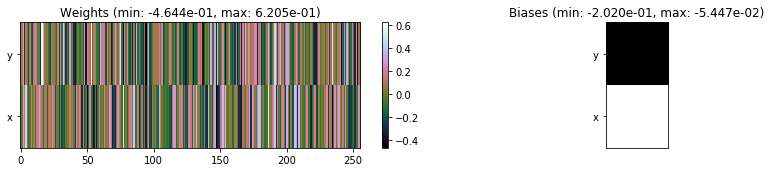

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.21 sec | TRAIN >> class loss: 0.4838 | steps:  2.416 :( | reward:  4.0351 :( | acc.: 83.670% :(
                          | VAL   >> class loss: 0.4571 | steps:  2.316 :( | reward:  4.1722 :( | acc.: 84.480% :(


Epoch  28/400) lr = 0.0006668
 b    300/  3000 >> 143.2 ms/b | lr: 6.66e-04 | grad 2norm: 12.36 | grad inf norm:  3.219
         Weights || abs max:  3.09 ( 2602.91) | mean: -8.01e-04 ( 0.01) | var: 6.04e-02 (  199.28)
          Biases || abs max:  1.11 (  111.12) | mean: -1.17e-01 ( 0.10) | var: 6.93e-02 (   91.23)
                    class loss: 0.473 | steps: 2.392 | reward:  4.045 | acc.: 83.93%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.0 ms/b | lr: 6.66e-04 | grad 2norm: 12.45 | grad inf norm:  3.251
         Weights || abs max:  3.09 ( 2598.50) | mean: -8.23e-04 (

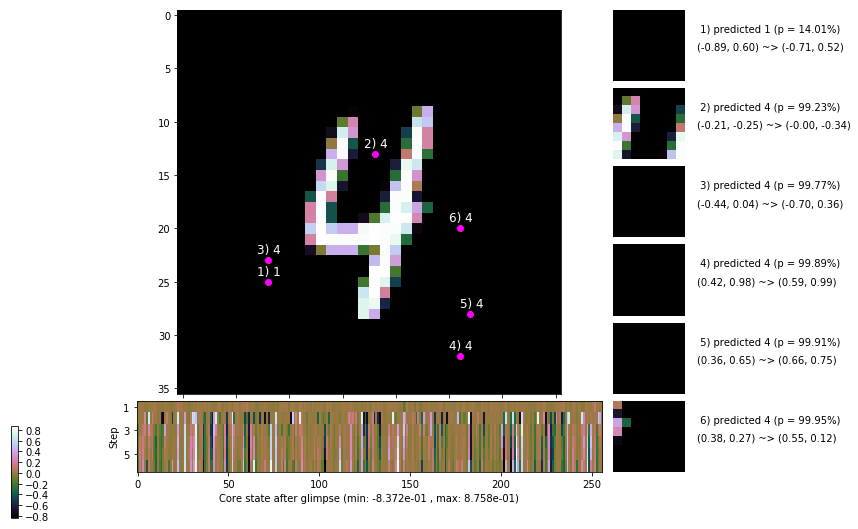

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 141.4 ms/b | lr: 6.64e-04 | grad 2norm: 12.26 | grad inf norm:  3.373
         Weights || abs max:  3.11 ( 5440.32) | mean: -7.93e-04 ( 0.02) | var: 6.06e-02 (  867.75)
          Biases || abs max:  1.12 (  140.17) | mean: -1.18e-01 ( 0.13) | var: 6.96e-02 (  116.61)
                    class loss: 0.507 | steps: 2.431 | reward:  4.029 | acc.: 83.38%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 138.6 ms/b | lr: 6.64e-04 | grad 2norm: 12.19 | grad inf norm:  3.211
         Weights || abs max:  3.12 (12520.01) | mean: -8.05e-04 ( 0.03) | var: 6.07e-02 (40521.86)
          Biases || abs max:  1.12 (   80.87) | mean: -1.17e-01 ( 0.08) | var: 6.98e-02 (   45.68)
                    class loss: 0.458 | steps: 2.405 | reward:  4.067 | acc.: 84.30%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

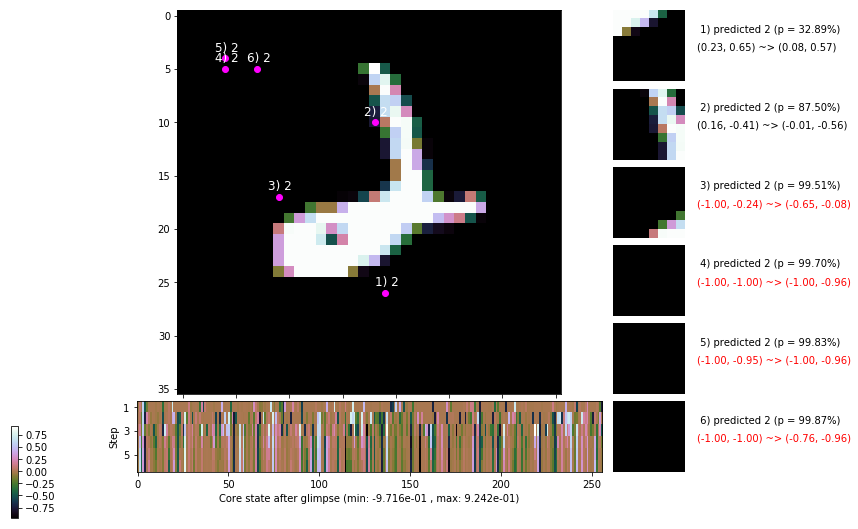

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.0 ms/b | lr: 6.62e-04 | grad 2norm: 12.07 | grad inf norm:  3.363
         Weights || abs max:  3.13 ( 2151.33) | mean: -7.90e-04 ( 0.01) | var: 6.08e-02 (   61.69)
          Biases || abs max:  1.12 (   69.49) | mean: -1.17e-01 ( 0.08) | var: 6.99e-02 (   19.38)
                    class loss: 0.455 | steps: 2.416 | reward:  4.050 | acc.: 84.40%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 138.5 ms/b | lr: 6.62e-04 | grad 2norm: 12.20 | grad inf norm:  3.297
         Weights || abs max:  3.14 ( 2229.80) | mean: -7.70e-04 ( 0.01) | var: 6.09e-02 (  137.86)
          Biases || abs max:  1.12 (  216.73) | mean: -1.17e-01 ( 0.14) | var: 7.01e-02 ( 1018.59)
                    class loss: 0.473 | steps: 2.400 | reward:  4.062 | acc.: 83.85%

	Target class: 9 | Discounted rewards: [0.731, 1.663, 1.3

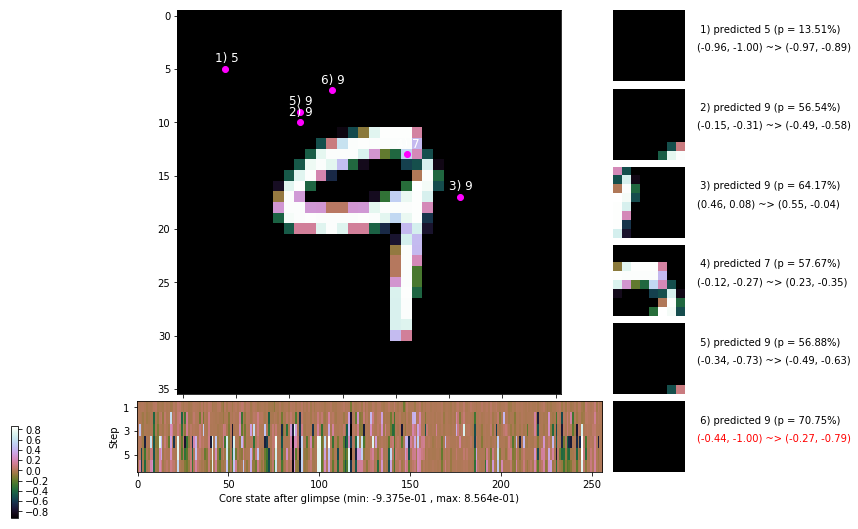

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.8 ms/b | lr: 6.60e-04 | grad 2norm: 11.88 | grad inf norm:  3.277
         Weights || abs max:  3.13 ( 2083.71) | mean: -7.60e-04 ( 0.01) | var: 6.10e-02 (   38.35)
          Biases || abs max:  1.11 (  112.11) | mean: -1.18e-01 ( 0.11) | var: 7.03e-02 (  165.87)
                    class loss: 0.460 | steps: 2.407 | reward:  4.070 | acc.: 85.13%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.9 ms/b | lr: 6.60e-04 | grad 2norm: 12.21 | grad inf norm:  3.191
         Weights || abs max:  3.13 ( 3017.40) | mean: -7.45e-04 ( 0.01) | var: 6.11e-02 (  285.12)
          Biases || abs max:  1.11 (  315.40) | mean: -1.18e-01 ( 0.18) | var: 7.05e-02 ( 6573.96)
                    class loss: 0.458 | steps: 2.393 | reward:  4.059 | acc.: 83.97%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

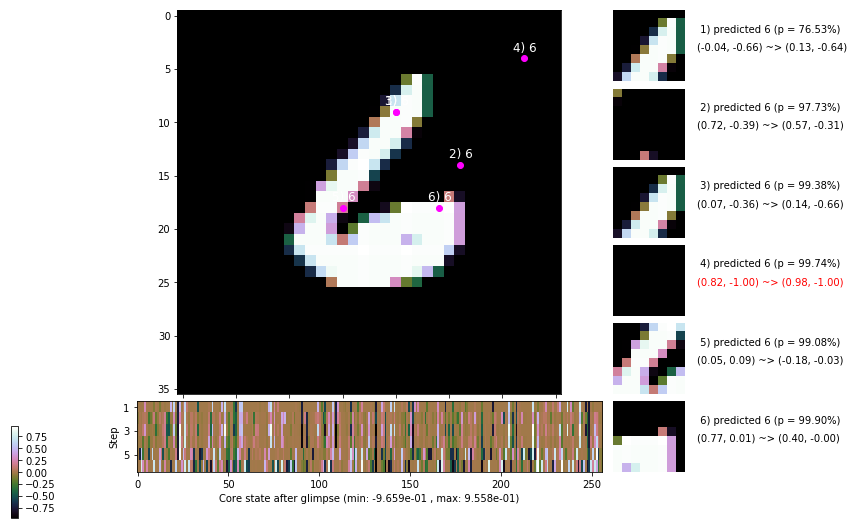

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 146.3 ms/b | lr: 6.58e-04 | grad 2norm: 11.86 | grad inf norm:  3.142
         Weights || abs max:  3.13 (19661.94) | mean: -7.37e-04 ( 0.05) | var: 6.12e-02 (142154.62)
          Biases || abs max:  1.12 (  122.91) | mean: -1.18e-01 ( 0.11) | var: 7.08e-02 (   62.04)
                    class loss: 0.470 | steps: 2.365 | reward:  4.100 | acc.: 84.10%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.5 ms/b | lr: 6.58e-04 | grad 2norm: 11.76 | grad inf norm:  3.119
         Weights || abs max:  3.12 (10492.88) | mean: -7.51e-04 ( 0.03) | var: 6.13e-02 (26010.51)
          Biases || abs max:  1.11 (  228.33) | mean: -1.18e-01 ( 0.17) | var: 7.09e-02 (  313.76)
                    class loss: 0.452 | steps: 2.377 | reward:  4.104 | acc.: 85.52%

	Target class: 2 | Discounted rewards: [0.319, 0.837, 1.

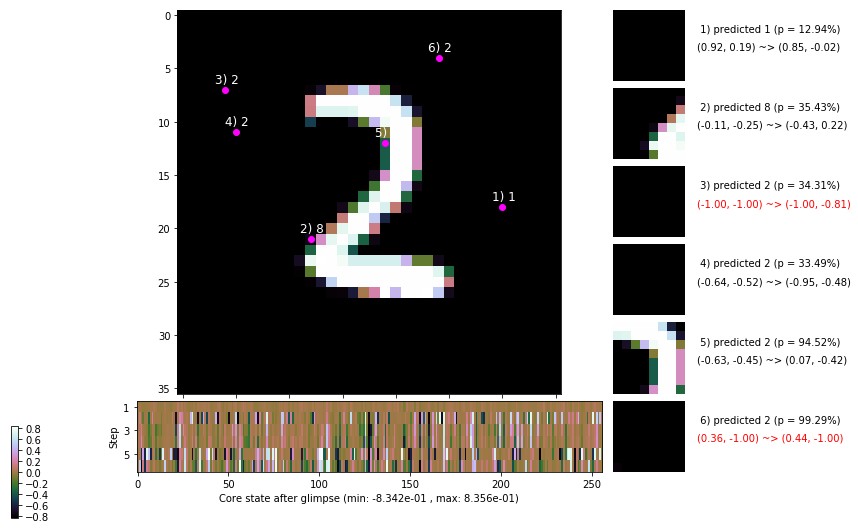

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


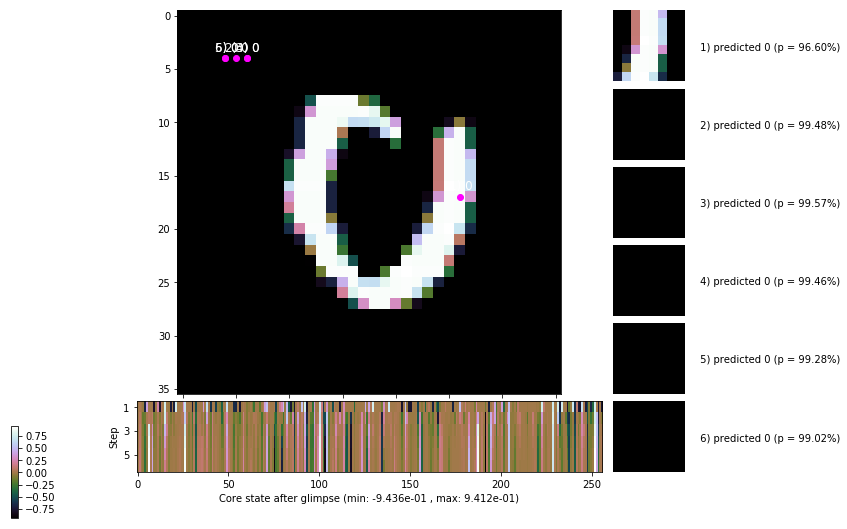


	Target class: 6 | Discounted rewards: [0.319, 0.837, 1.875, 1.750, 1.500, 1.000]


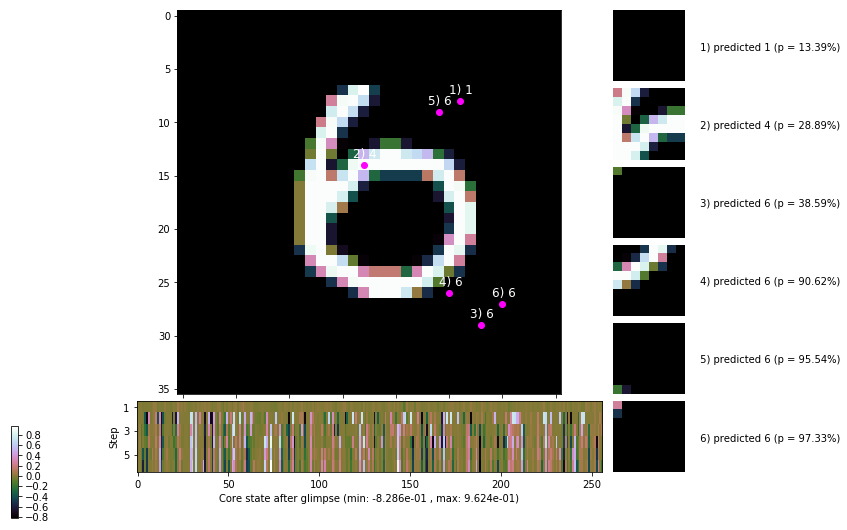

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


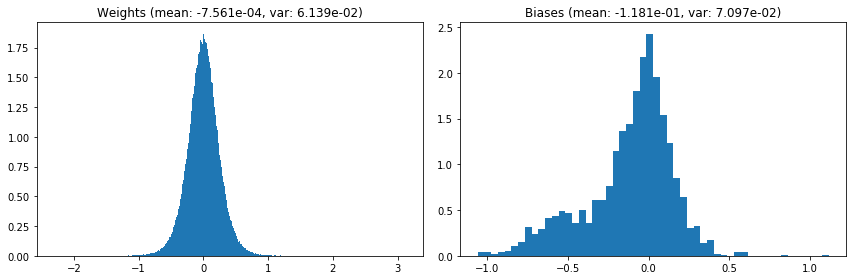

                                      Location network weights and biases


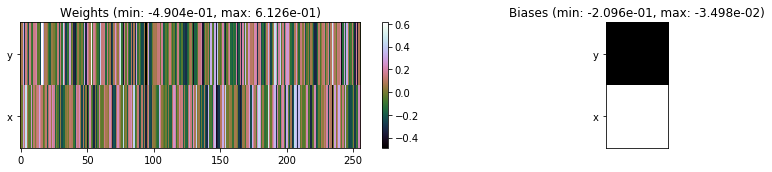

---------------------------------------------------------------------------------------------------------------
Elapsed time:  427.52 sec | TRAIN >> class loss: 0.4693 | steps:  2.404 :( | reward:  4.0578 :( | acc.: 84.183% :(
                          | VAL   >> class loss: 0.4605 | steps:  2.334 :( | reward:  4.1538 :( | acc.: 84.240% :(


Epoch  29/400) lr = 0.0006569
 b    300/  3000 >> 148.7 ms/b | lr: 6.56e-04 | grad 2norm: 12.06 | grad inf norm:  3.212
         Weights || abs max:  3.13 ( 3566.09) | mean: -7.62e-04 ( 0.01) | var: 6.14e-02 (  287.45)
          Biases || abs max:  1.11 (  204.17) | mean: -1.18e-01 ( 0.16) | var: 7.10e-02 (  412.13)
                    class loss: 0.462 | steps: 2.438 | reward:  4.036 | acc.: 84.83%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.8 ms/b | lr: 6.56e-04 | grad 2norm: 12.16 | grad inf norm:  3.329
         Weights || abs max:  3.15 ( 6555.12) | mean: -7.67e-04 (

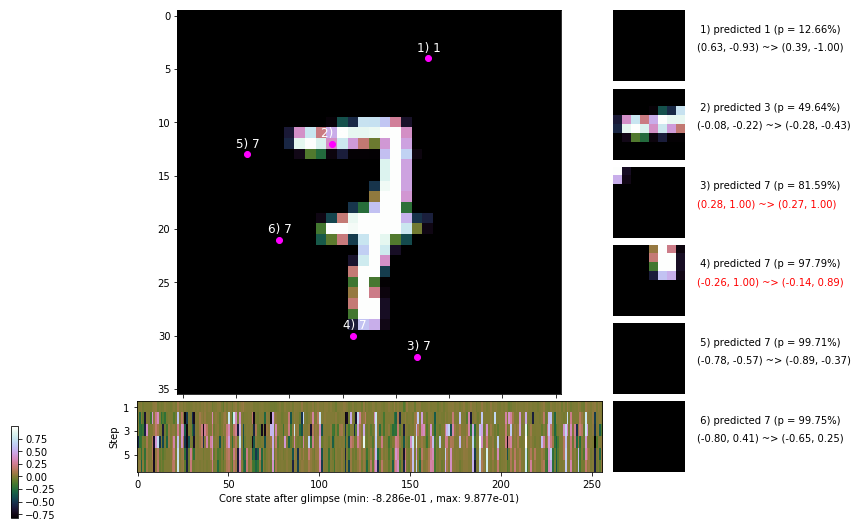

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.4 ms/b | lr: 6.54e-04 | grad 2norm: 11.82 | grad inf norm:  3.172
         Weights || abs max:  3.16 (14866.48) | mean: -7.79e-04 ( 0.04) | var: 6.16e-02 (68169.49)
          Biases || abs max:  1.11 (   96.78) | mean: -1.19e-01 ( 0.09) | var: 7.11e-02 (   79.87)
                    class loss: 0.442 | steps: 2.367 | reward:  4.128 | acc.: 85.90%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.0 ms/b | lr: 6.54e-04 | grad 2norm: 11.75 | grad inf norm:  3.030
         Weights || abs max:  3.16 (10315.77) | mean: -7.98e-04 ( 0.03) | var: 6.17e-02 (32691.12)
          Biases || abs max:  1.11 (  111.08) | mean: -1.19e-01 ( 0.10) | var: 7.12e-02 (   79.46)
                    class loss: 0.429 | steps: 2.368 | reward:  4.110 | acc.: 85.42%

	Target class: 8 | Discounted rewards: [0.319, 0.837, 1.8

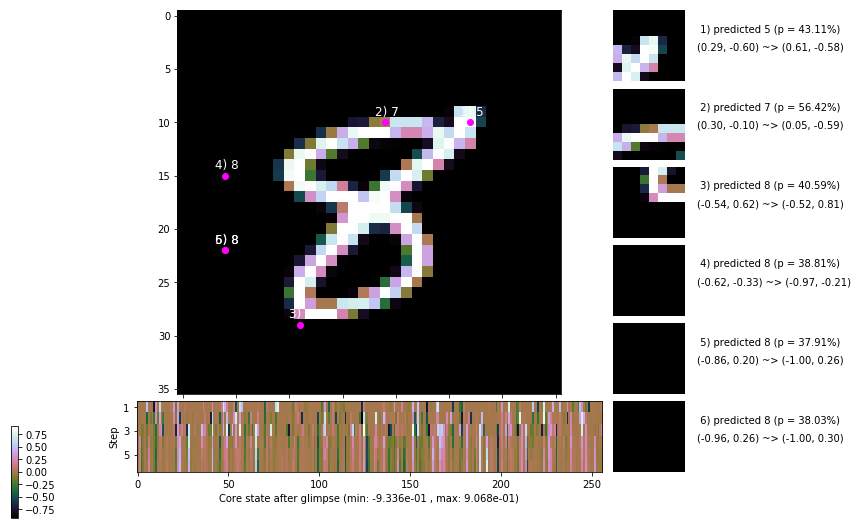

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 157.0 ms/b | lr: 6.52e-04 | grad 2norm: 11.98 | grad inf norm:  3.245
         Weights || abs max:  3.17 ( 2912.63) | mean: -8.03e-04 ( 0.01) | var: 6.18e-02 (   96.36)
          Biases || abs max:  1.11 (  104.05) | mean: -1.19e-01 ( 0.11) | var: 7.15e-02 (   91.29)
                    class loss: 0.470 | steps: 2.386 | reward:  4.077 | acc.: 84.53%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.9 ms/b | lr: 6.52e-04 | grad 2norm: 12.12 | grad inf norm:  3.208
         Weights || abs max:  3.17 ( 1890.36) | mean: -7.80e-04 ( 0.01) | var: 6.19e-02 (   63.53)
          Biases || abs max:  1.11 (   99.09) | mean: -1.20e-01 ( 0.10) | var: 7.18e-02 (   42.32)
                    class loss: 0.477 | steps: 2.389 | reward:  4.063 | acc.: 83.75%

	Target class: 6 | Discounted rewards: [0.903, -0.194, -0

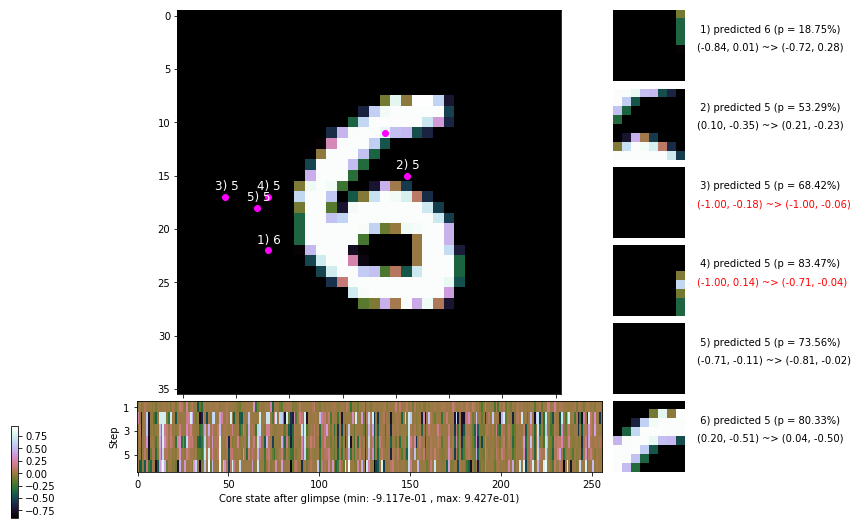

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 157.4 ms/b | lr: 6.50e-04 | grad 2norm: 11.69 | grad inf norm:  3.039
         Weights || abs max:  3.18 ( 3259.38) | mean: -7.51e-04 ( 0.02) | var: 6.20e-02 (  303.60)
          Biases || abs max:  1.12 (  106.54) | mean: -1.20e-01 ( 0.09) | var: 7.18e-02 (   76.35)
                    class loss: 0.439 | steps: 2.354 | reward:  4.147 | acc.: 85.67%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.6 ms/b | lr: 6.50e-04 | grad 2norm: 12.13 | grad inf norm:  3.419
         Weights || abs max:  3.18 ( 3498.35) | mean: -7.51e-04 ( 0.02) | var: 6.21e-02 (  737.90)
          Biases || abs max:  1.12 (  783.70) | mean: -1.20e-01 ( 0.37) | var: 7.18e-02 (38590.54)
                    class loss: 0.477 | steps: 2.385 | reward:  4.064 | acc.: 83.85%

	Target class: 7 | Discounted rewards: [-0.197, -0.194, -

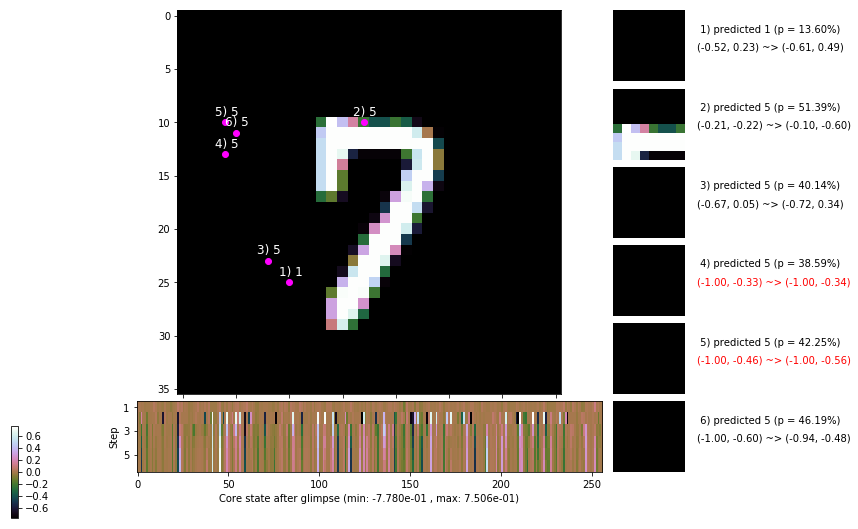

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.9 ms/b | lr: 6.48e-04 | grad 2norm: 12.14 | grad inf norm:  3.263
         Weights || abs max:  3.18 ( 2593.68) | mean: -7.31e-04 ( 0.01) | var: 6.22e-02 (   82.96)
          Biases || abs max:  1.12 ( 1055.17) | mean: -1.20e-01 ( 0.47) | var: 7.19e-02 (109317.18)
                    class loss: 0.474 | steps: 2.424 | reward:  4.056 | acc.: 84.08%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.3 ms/b | lr: 6.48e-04 | grad 2norm: 11.91 | grad inf norm:  3.312
         Weights || abs max:  3.17 (10432.53) | mean: -7.61e-04 ( 0.03) | var: 6.23e-02 (20622.82)
          Biases || abs max:  1.12 (  348.34) | mean: -1.20e-01 ( 0.31) | var: 7.19e-02 (19320.41)
                    class loss: 0.444 | steps: 2.374 | reward:  4.109 | acc.: 85.40%

	Target class: 4 | Discounted rewards: [0.903, -0.194, -

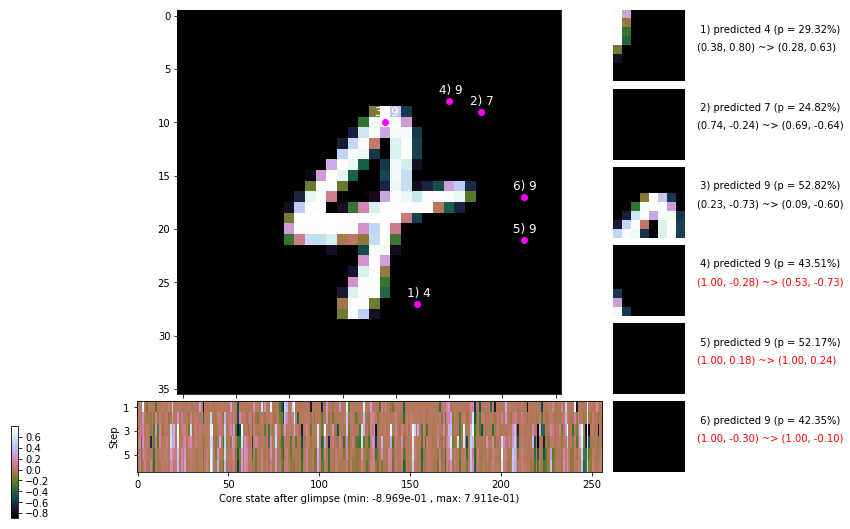

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [1.453, 0.906, -0.188, -0.175, -0.150, -0.100]


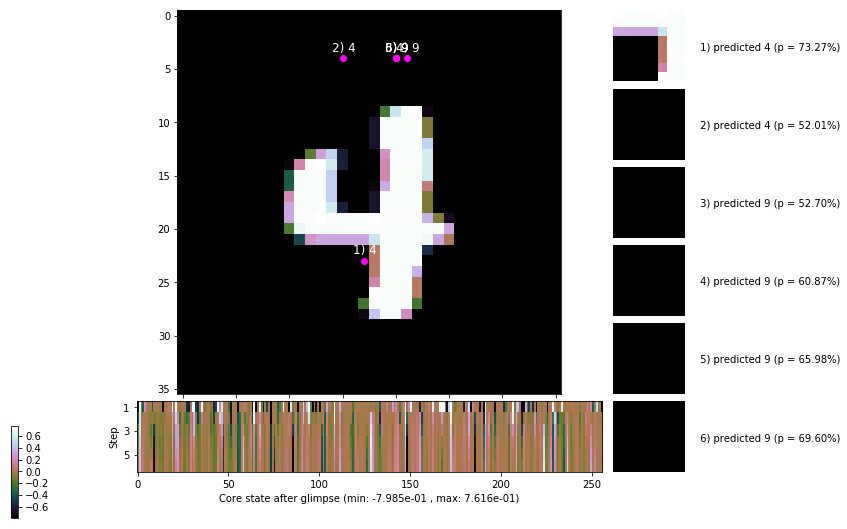


	Target class: 4 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


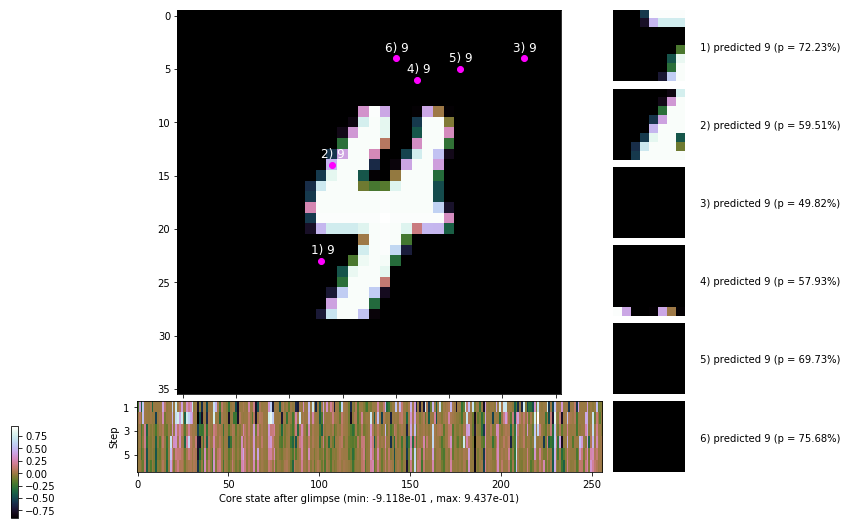

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


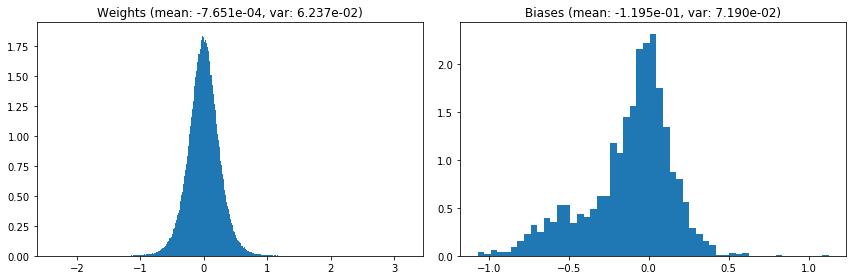

                                      Location network weights and biases


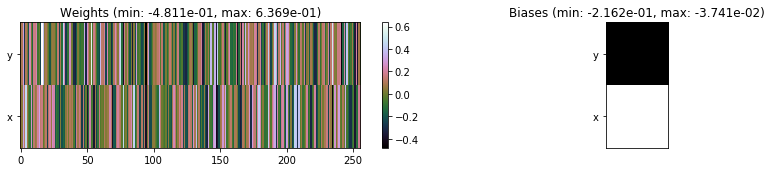

---------------------------------------------------------------------------------------------------------------
Elapsed time:  442.61 sec | TRAIN >> class loss: 0.4575 | steps:  2.384    | reward:  4.0874    | acc.: 84.748% :(
                          | VAL   >> class loss: 0.4955 | steps:  2.313 :( | reward:  4.1419 :( | acc.: 82.960% :(


Epoch  30/400) lr = 0.0006471
 b    300/  3000 >> 143.7 ms/b | lr: 6.46e-04 | grad 2norm: 12.01 | grad inf norm:  3.376
         Weights || abs max:  3.17 ( 5717.53) | mean: -7.60e-04 ( 0.02) | var: 6.24e-02 ( 1434.14)
          Biases || abs max:  1.12 (  139.63) | mean: -1.20e-01 ( 0.14) | var: 7.21e-02 (  503.31)
                    class loss: 0.476 | steps: 2.429 | reward:  4.040 | acc.: 84.20%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 146.1 ms/b | lr: 6.46e-04 | grad 2norm: 11.74 | grad inf norm:  3.277
         Weights || abs max:  3.18 (70598.82) | mean: -7.53e-04 (

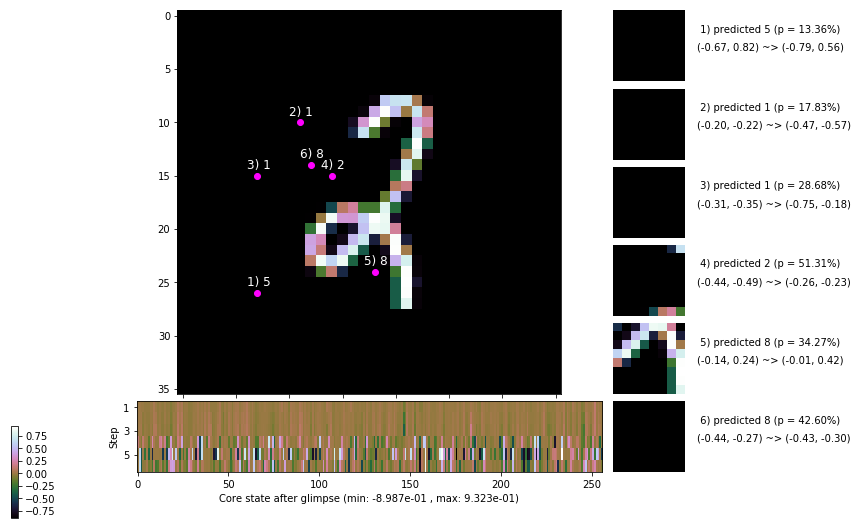

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.6 ms/b | lr: 6.45e-04 | grad 2norm: 12.39 | grad inf norm:  3.497
         Weights || abs max:  3.19 ( 9217.48) | mean: -7.42e-04 ( 0.03) | var: 6.26e-02 (14618.36)
          Biases || abs max:  1.12 (  183.65) | mean: -1.21e-01 ( 0.13) | var: 7.23e-02 (  360.85)
                    class loss: 0.483 | steps: 2.396 | reward:  4.041 | acc.: 83.78%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 148.4 ms/b | lr: 6.44e-04 | grad 2norm: 11.98 | grad inf norm:  3.298
         Weights || abs max:  3.17 (11612.05) | mean: -7.25e-04 ( 0.03) | var: 6.27e-02 (49082.43)
          Biases || abs max:  1.12 (  100.14) | mean: -1.21e-01 ( 0.10) | var: 7.26e-02 (   81.86)
                    class loss: 0.485 | steps: 2.404 | reward:  4.032 | acc.: 83.95%

	Target class: 0 | Discounted rewards: [0.044, 0.287, 0.7

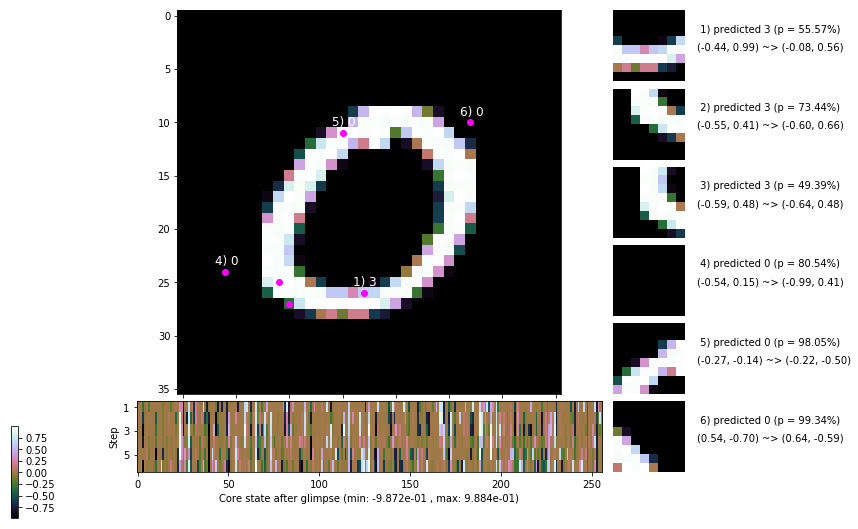

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 147.8 ms/b | lr: 6.43e-04 | grad 2norm: 11.84 | grad inf norm:  3.363
         Weights || abs max:  3.16 ( 3358.02) | mean: -7.09e-04 ( 0.02) | var: 6.28e-02 (  242.62)
          Biases || abs max:  1.11 (   92.51) | mean: -1.21e-01 ( 0.09) | var: 7.27e-02 (   30.63)
                    class loss: 0.477 | steps: 2.405 | reward:  4.019 | acc.: 83.77%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 144.5 ms/b | lr: 6.42e-04 | grad 2norm: 12.12 | grad inf norm:  3.286
         Weights || abs max:  3.16 ( 3532.63) | mean: -7.27e-04 ( 0.02) | var: 6.29e-02 (  580.66)
          Biases || abs max:  1.11 (  174.09) | mean: -1.21e-01 ( 0.13) | var: 7.28e-02 (  627.19)
                    class loss: 0.487 | steps: 2.403 | reward:  4.025 | acc.: 83.60%

	Target class: 4 | Discounted rewards: [0.869, 1.938, 1.8

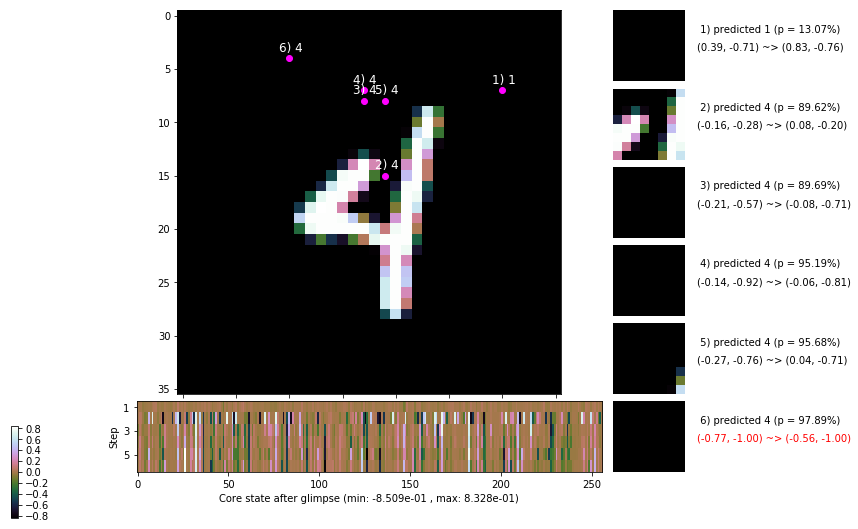

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.1 ms/b | lr: 6.41e-04 | grad 2norm: 11.86 | grad inf norm:  3.403
         Weights || abs max:  3.17 ( 6399.76) | mean: -6.94e-04 ( 0.02) | var: 6.30e-02 ( 2724.67)
          Biases || abs max:  1.12 (  161.36) | mean: -1.21e-01 ( 0.13) | var: 7.30e-02 (  284.84)
                    class loss: 0.489 | steps: 2.413 | reward:  4.026 | acc.: 83.30%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 140.7 ms/b | lr: 6.40e-04 | grad 2norm: 12.02 | grad inf norm:  3.392
         Weights || abs max:  3.18 (12073.56) | mean: -6.97e-04 ( 0.03) | var: 6.31e-02 (49510.85)
          Biases || abs max:  1.12 (   85.62) | mean: -1.21e-01 ( 0.10) | var: 7.32e-02 (   96.46)
                    class loss: 0.488 | steps: 2.371 | reward:  4.061 | acc.: 84.02%

	Target class: 3 | Discounted rewards: [0.319, 0.837, 1.8

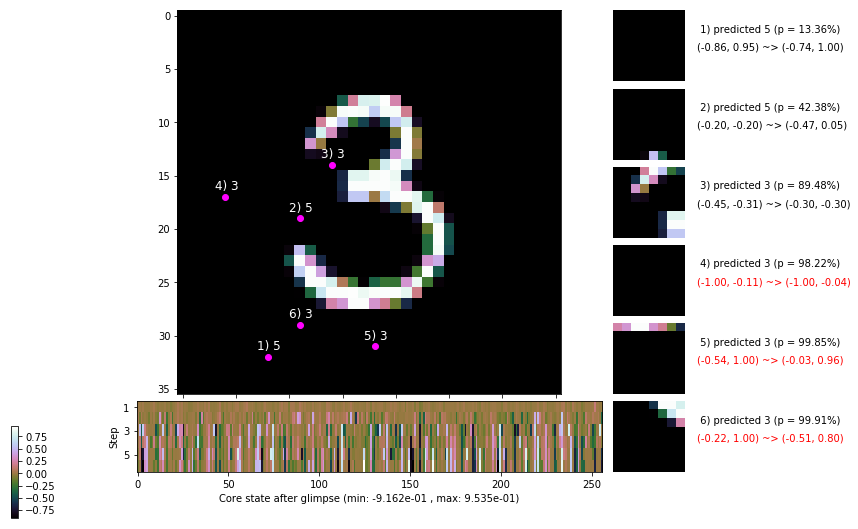

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.8 ms/b | lr: 6.39e-04 | grad 2norm: 12.24 | grad inf norm:  3.426
         Weights || abs max:  3.18 ( 2498.66) | mean: -6.95e-04 ( 0.01) | var: 6.32e-02 (  143.74)
          Biases || abs max:  1.12 (   86.04) | mean: -1.21e-01 ( 0.09) | var: 7.31e-02 (   49.31)
                    class loss: 0.495 | steps: 2.420 | reward:  4.020 | acc.: 83.58%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.4 ms/b | lr: 6.38e-04 | grad 2norm: 12.16 | grad inf norm:  3.418
         Weights || abs max:  3.19 ( 3421.06) | mean: -7.10e-04 ( 0.01) | var: 6.32e-02 (  555.73)
          Biases || abs max:  1.11 (   65.11) | mean: -1.22e-01 ( 0.08) | var: 7.33e-02 (   16.91)
                    class loss: 0.486 | steps: 2.401 | reward:  4.039 | acc.: 83.33%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

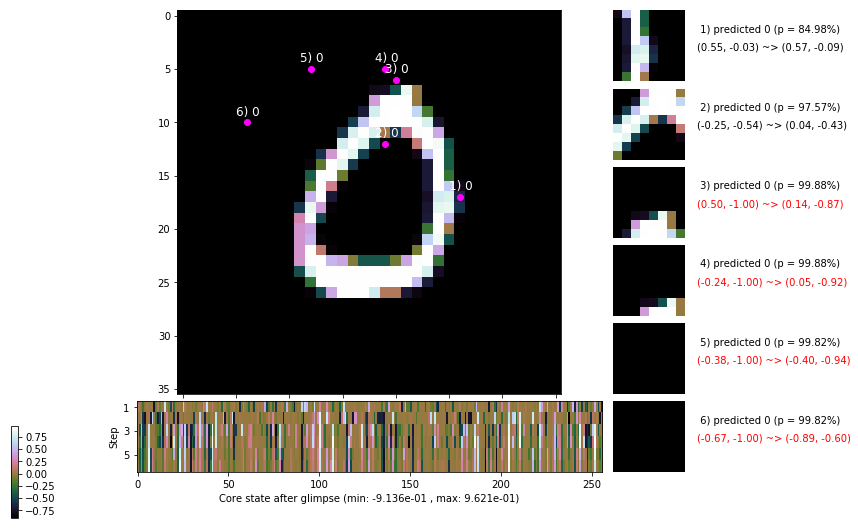

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


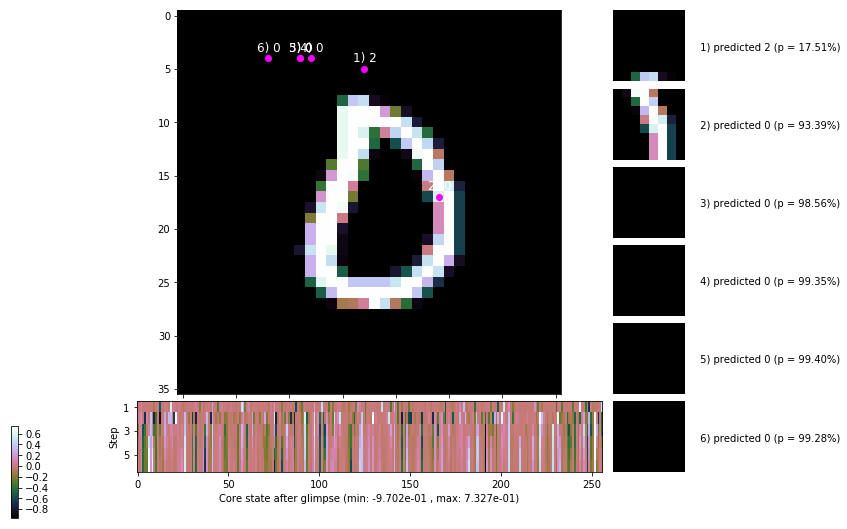


	Target class: 4 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


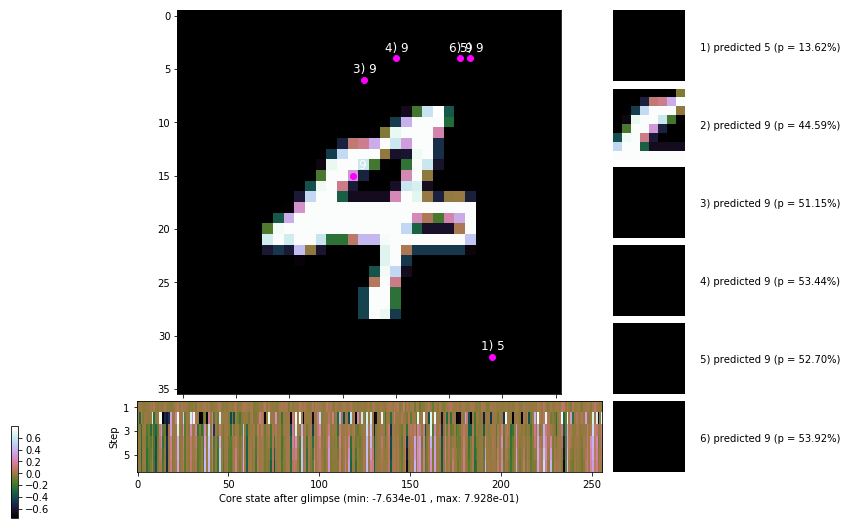

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


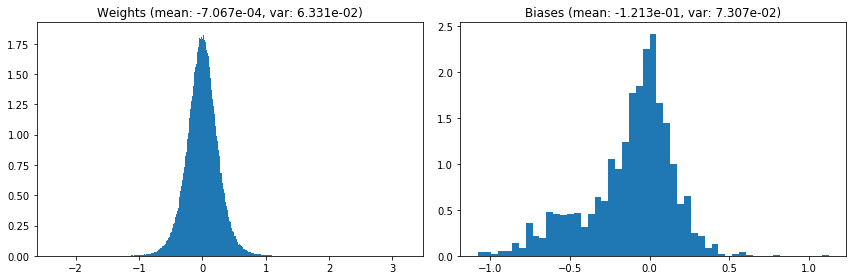

                                      Location network weights and biases


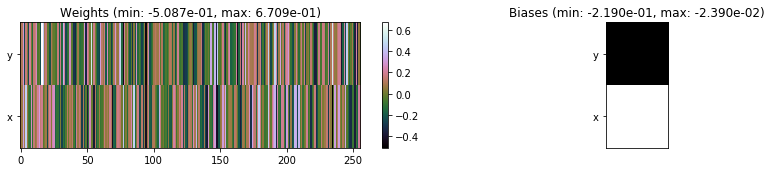

---------------------------------------------------------------------------------------------------------------
Elapsed time:  434.42 sec | TRAIN >> class loss: 0.4814 | steps:  2.402 :( | reward:  4.0391 :( | acc.: 83.820% :(
                          | VAL   >> class loss: 0.4554 | steps:  2.285    | reward:  4.1681 :( | acc.: 84.820% :(


Epoch  31/400) lr = 0.0006375
 b    300/  3000 >> 141.9 ms/b | lr: 6.37e-04 | grad 2norm: 12.22 | grad inf norm:  3.416
         Weights || abs max:  3.21 (367984.81) | mean: -6.79e-04 ( 0.68) | var: 6.34e-02 (73689552.00)
          Biases || abs max:  1.12 (  103.43) | mean: -1.22e-01 ( 0.10) | var: 7.33e-02 (   64.11)
                    class loss: 0.480 | steps: 2.431 | reward:  4.002 | acc.: 83.75%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 140.3 ms/b | lr: 6.36e-04 | grad 2norm: 12.08 | grad inf norm:  3.218
         Weights || abs max:  3.21 ( 4138.13) | mean: -6.76e-

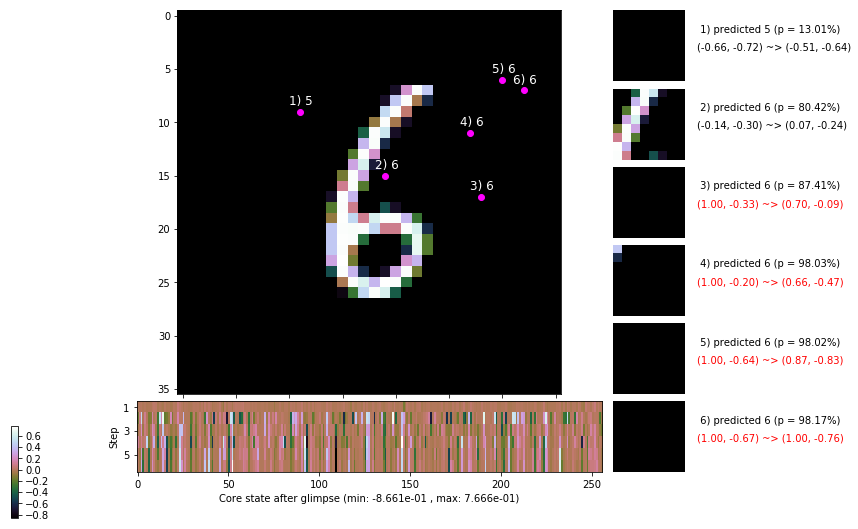

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.0 ms/b | lr: 6.35e-04 | grad 2norm: 11.82 | grad inf norm:  3.203
         Weights || abs max:  3.21 ( 5600.78) | mean: -6.78e-04 ( 0.02) | var: 6.35e-02 ( 2859.26)
          Biases || abs max:  1.11 (   81.03) | mean: -1.22e-01 ( 0.08) | var: 7.35e-02 (   36.38)
                    class loss: 0.473 | steps: 2.397 | reward:  4.057 | acc.: 84.18%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.1 ms/b | lr: 6.34e-04 | grad 2norm: 11.78 | grad inf norm:  3.133
         Weights || abs max:  3.22 ( 1836.41) | mean: -6.93e-04 ( 0.01) | var: 6.36e-02 (   35.40)
          Biases || abs max:  1.12 (152731.23) | mean: -1.22e-01 (59.42) | var: 7.35e-02 (2718563584.00)
                    class loss: 0.479 | steps: 2.380 | reward:  4.069 | acc.: 84.37%

	Target class: 1 | Discounted rewards: [0.869, 1.93

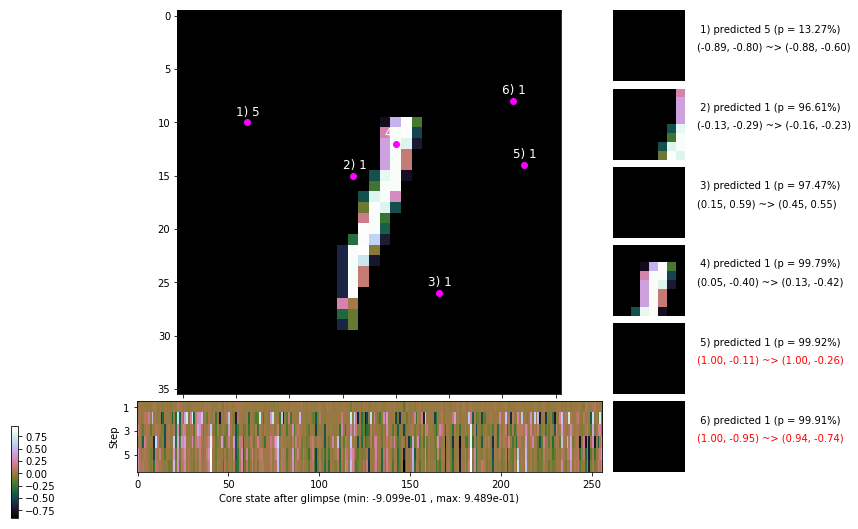

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 146.2 ms/b | lr: 6.33e-04 | grad 2norm: 11.56 | grad inf norm:  3.162
         Weights || abs max:  3.21 ( 5739.85) | mean: -7.42e-04 ( 0.02) | var: 6.37e-02 ( 2720.23)
          Biases || abs max:  1.12 (  507.92) | mean: -1.22e-01 ( 0.28) | var: 7.36e-02 ( 4235.04)
                    class loss: 0.445 | steps: 2.358 | reward:  4.113 | acc.: 85.03%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 144.0 ms/b | lr: 6.32e-04 | grad 2norm: 11.85 | grad inf norm:  3.182
         Weights || abs max:  3.21 ( 3908.92) | mean: -7.55e-04 ( 0.02) | var: 6.38e-02 ( 1629.24)
          Biases || abs max:  1.12 (  223.57) | mean: -1.22e-01 ( 0.16) | var: 7.37e-02 (  179.95)
                    class loss: 0.459 | steps: 2.354 | reward:  4.111 | acc.: 84.62%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.8

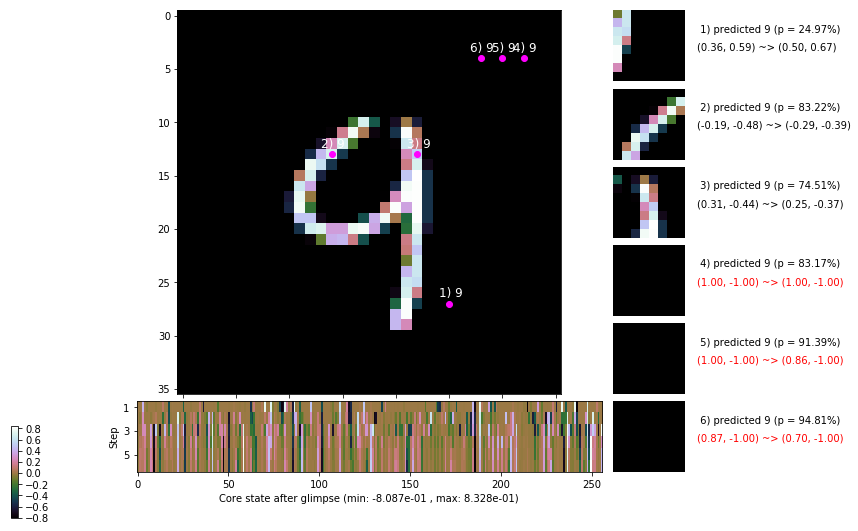

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 149.8 ms/b | lr: 6.31e-04 | grad 2norm: 11.70 | grad inf norm:  3.170
         Weights || abs max:  3.21 ( 3699.97) | mean: -7.41e-04 ( 0.02) | var: 6.39e-02 (  755.14)
          Biases || abs max:  1.13 (  162.01) | mean: -1.22e-01 ( 0.14) | var: 7.38e-02 (  535.85)
                    class loss: 0.448 | steps: 2.322 | reward:  4.149 | acc.: 85.03%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 146.8 ms/b | lr: 6.31e-04 | grad 2norm: 12.18 | grad inf norm:  3.381
         Weights || abs max:  3.21 ( 6743.50) | mean: -7.16e-04 ( 0.02) | var: 6.40e-02 ( 5439.71)
          Biases || abs max:  1.13 (  116.56) | mean: -1.22e-01 ( 0.12) | var: 7.43e-02 (   78.75)
                    class loss: 0.492 | steps: 2.413 | reward:  4.020 | acc.: 83.42%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

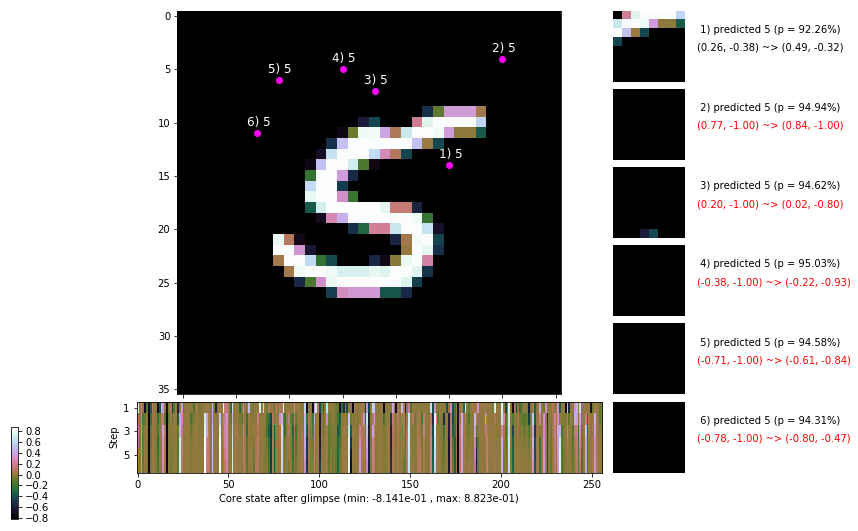

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 147.7 ms/b | lr: 6.29e-04 | grad 2norm: 11.84 | grad inf norm:  3.156
         Weights || abs max:  3.21 (13783.38) | mean: -6.99e-04 ( 0.03) | var: 6.41e-02 (25498.82)
          Biases || abs max:  1.13 (  240.16) | mean: -1.22e-01 ( 0.18) | var: 7.43e-02 (  164.53)
                    class loss: 0.465 | steps: 2.384 | reward:  4.083 | acc.: 84.58%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 147.2 ms/b | lr: 6.29e-04 | grad 2norm: 12.13 | grad inf norm:  3.328
         Weights || abs max:  3.23 ( 4302.53) | mean: -7.18e-04 ( 0.02) | var: 6.42e-02 ( 1267.81)
          Biases || abs max:  1.13 (  160.66) | mean: -1.22e-01 ( 0.16) | var: 7.45e-02 (  844.70)
                    class loss: 0.491 | steps: 2.408 | reward:  4.056 | acc.: 83.52%

	Target class: 3 | Discounted rewards: [-0.162, -0.125, -

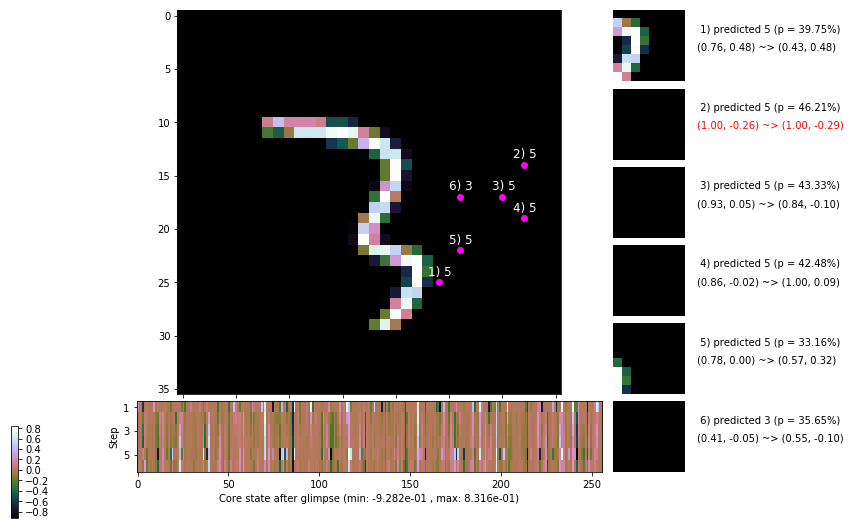

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


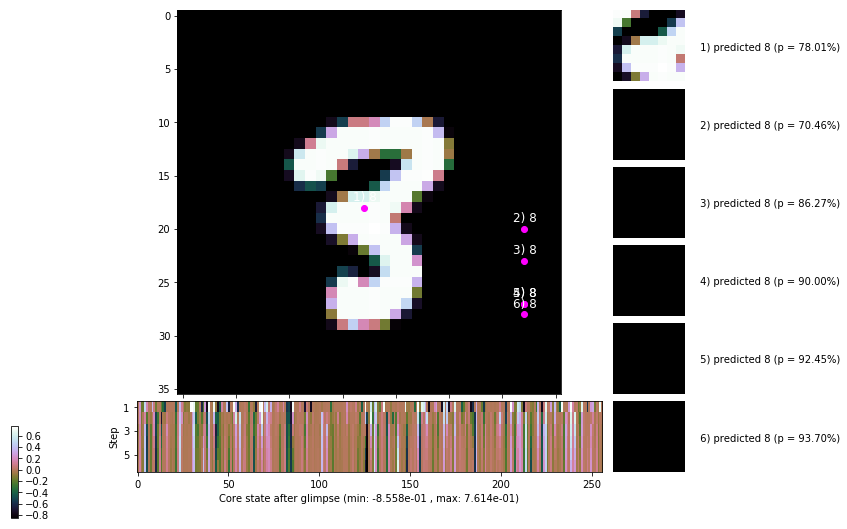


	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


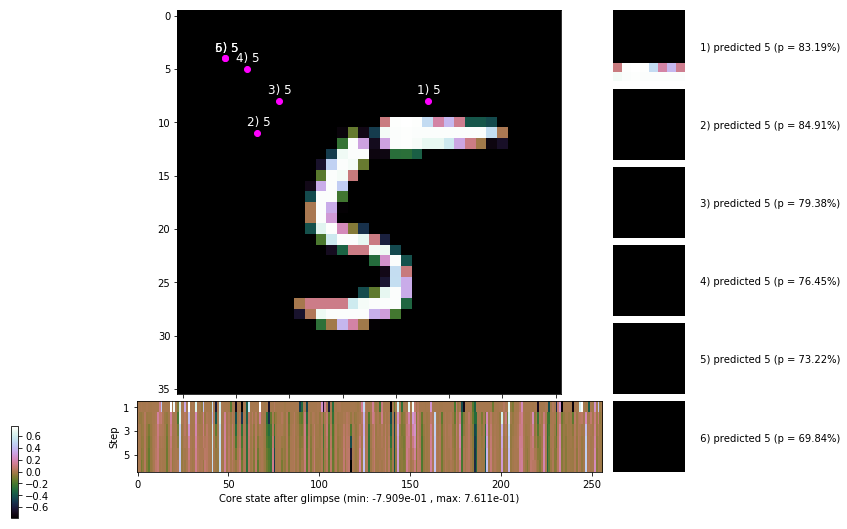

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


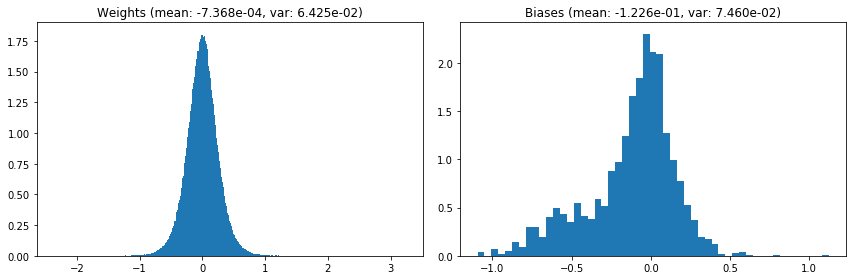

                                      Location network weights and biases


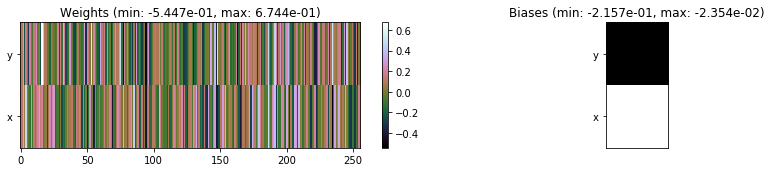

---------------------------------------------------------------------------------------------------------------
Elapsed time:  435.97 sec | TRAIN >> class loss: 0.4719 | steps:  2.383    | reward:  4.0703 :( | acc.: 84.212% :(
                          | VAL   >> class loss: 0.4913 | steps:  2.338 :( | reward:  4.1159 :( | acc.: 83.340% :(


Epoch  32/400) lr = 0.000628
 b    300/  3000 >> 142.0 ms/b | lr: 6.27e-04 | grad 2norm: 12.21 | grad inf norm:  3.361
         Weights || abs max:  3.22 ( 3435.70) | mean: -7.23e-04 ( 0.01) | var: 6.43e-02 ( 1204.94)
          Biases || abs max:  1.12 (   61.61) | mean: -1.22e-01 ( 0.08) | var: 7.47e-02 (   16.13)
                    class loss: 0.480 | steps: 2.391 | reward:  4.050 | acc.: 83.57%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.0 ms/b | lr: 6.27e-04 | grad 2norm: 12.15 | grad inf norm:  3.330
         Weights || abs max:  3.22 ( 4676.61) | mean: -7.20e-04 ( 

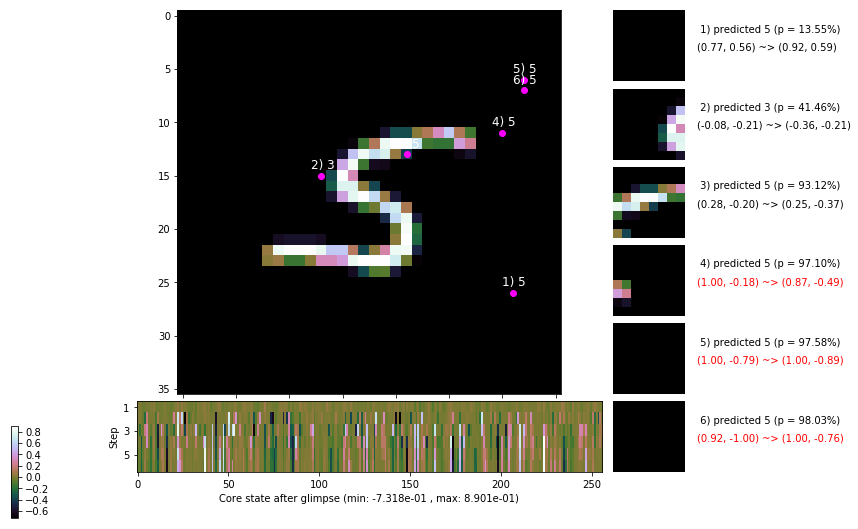

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.2 ms/b | lr: 6.25e-04 | grad 2norm: 11.83 | grad inf norm:  3.204
         Weights || abs max:  3.22 (39604.37) | mean: -7.06e-04 ( 0.08) | var: 6.45e-02 (676383.81)
          Biases || abs max:  1.12 (  125.57) | mean: -1.22e-01 ( 0.12) | var: 7.48e-02 (   61.74)
                    class loss: 0.484 | steps: 2.400 | reward:  4.061 | acc.: 84.43%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.6 ms/b | lr: 6.25e-04 | grad 2norm: 11.83 | grad inf norm:  3.301
         Weights || abs max:  3.22 ( 4421.61) | mean: -6.86e-04 ( 0.02) | var: 6.46e-02 ( 1148.82)
          Biases || abs max:  1.12 (  216.07) | mean: -1.22e-01 ( 0.15) | var: 7.50e-02 (  599.25)
                    class loss: 0.479 | steps: 2.402 | reward:  4.042 | acc.: 83.75%

	Target class: 8 | Discounted rewards: [-0.094, 0.012, 0

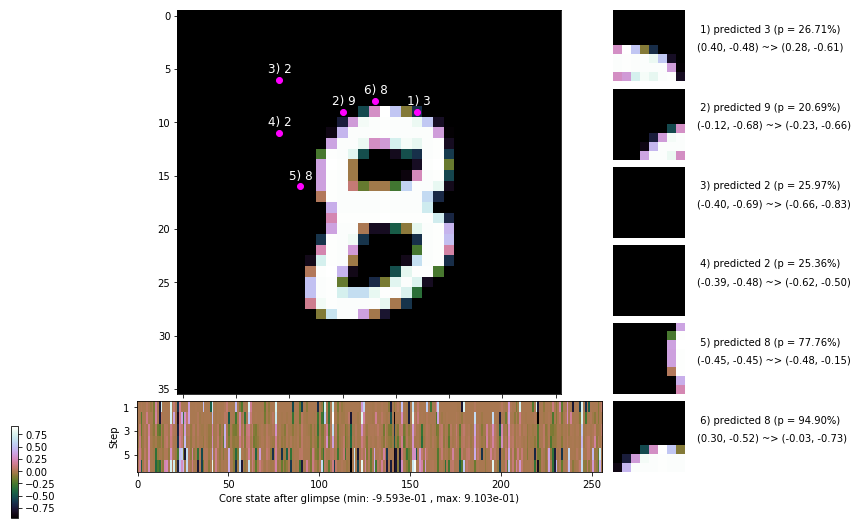

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 144.1 ms/b | lr: 6.24e-04 | grad 2norm: 11.81 | grad inf norm:  3.253
         Weights || abs max:  3.23 ( 4286.98) | mean: -7.03e-04 ( 0.02) | var: 6.47e-02 (  575.84)
          Biases || abs max:  1.12 (  357.06) | mean: -1.23e-01 ( 0.25) | var: 7.51e-02 ( 4977.50)
                    class loss: 0.479 | steps: 2.396 | reward:  4.081 | acc.: 84.33%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.6 ms/b | lr: 6.23e-04 | grad 2norm: 11.74 | grad inf norm:  3.265
         Weights || abs max:  3.22 ( 4062.14) | mean: -7.13e-04 ( 0.02) | var: 6.48e-02 (  607.83)
          Biases || abs max:  1.12 (  197.77) | mean: -1.22e-01 ( 0.14) | var: 7.51e-02 (  421.09)
                    class loss: 0.456 | steps: 2.390 | reward:  4.080 | acc.: 84.72%

	Target class: 5 | Discounted rewards: [0.044, 0.287, 0.7

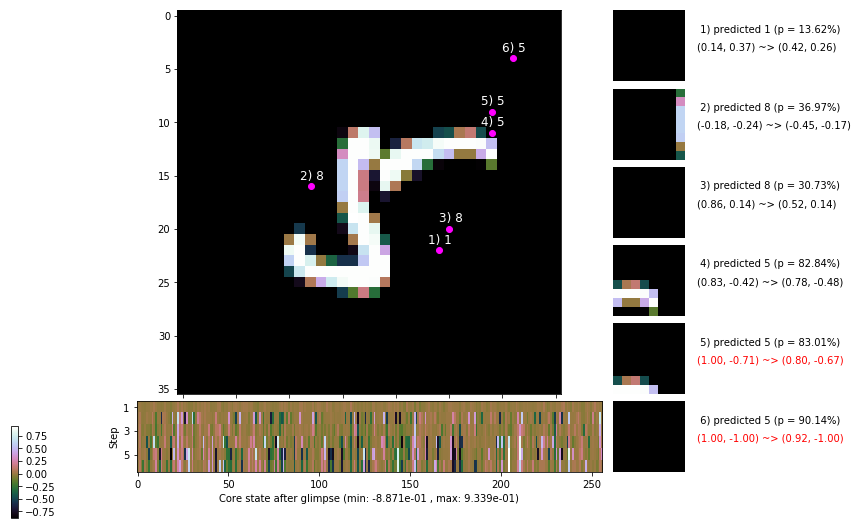

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 143.2 ms/b | lr: 6.22e-04 | grad 2norm: 11.77 | grad inf norm:  3.334
         Weights || abs max:  3.22 (39799.04) | mean: -7.29e-04 ( 0.08) | var: 6.48e-02 (702867.81)
          Biases || abs max:  1.13 (  232.85) | mean: -1.23e-01 ( 0.16) | var: 7.53e-02 ( 1299.96)
                    class loss: 0.468 | steps: 2.372 | reward:  4.101 | acc.: 84.25%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 144.6 ms/b | lr: 6.21e-04 | grad 2norm: 11.76 | grad inf norm:  3.261
         Weights || abs max:  3.23 ( 4673.60) | mean: -7.26e-04 ( 0.02) | var: 6.49e-02 ( 3183.45)
          Biases || abs max:  1.13 (  109.54) | mean: -1.22e-01 ( 0.11) | var: 7.55e-02 (   55.47)
                    class loss: 0.487 | steps: 2.393 | reward:  4.079 | acc.: 83.68%

	Target class: 2 | Discounted rewards: [0.594, 1.388, 0.

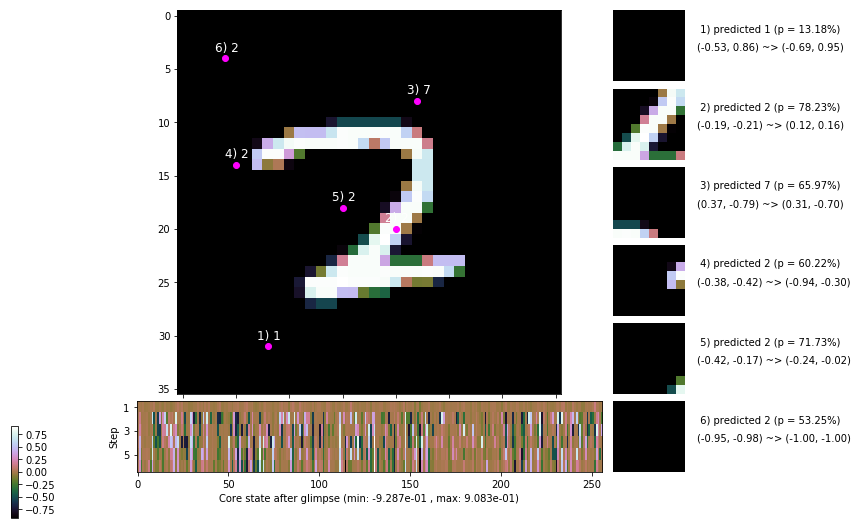

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 146.6 ms/b | lr: 6.20e-04 | grad 2norm: 11.65 | grad inf norm:  3.272
         Weights || abs max:  3.24 ( 2853.41) | mean: -7.09e-04 ( 0.01) | var: 6.50e-02 (  160.32)
          Biases || abs max:  1.13 (  177.31) | mean: -1.22e-01 ( 0.13) | var: 7.53e-02 (  772.82)
                    class loss: 0.475 | steps: 2.378 | reward:  4.108 | acc.: 84.53%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.0 ms/b | lr: 6.19e-04 | grad 2norm: 11.95 | grad inf norm:  3.316
         Weights || abs max:  3.24 ( 3351.02) | mean: -7.17e-04 ( 0.02) | var: 6.51e-02 (  207.11)
          Biases || abs max:  1.13 (  279.35) | mean: -1.22e-01 ( 0.17) | var: 7.54e-02 ( 2608.71)
                    class loss: 0.494 | steps: 2.415 | reward:  4.027 | acc.: 82.98%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

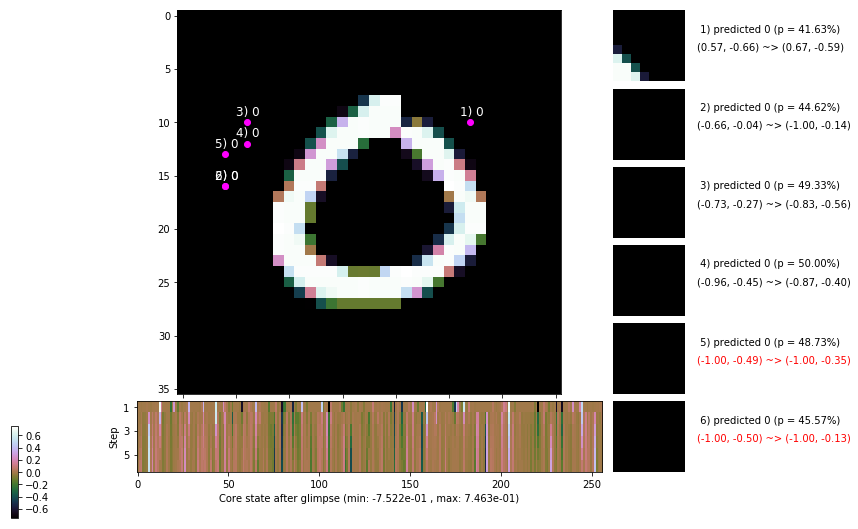

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


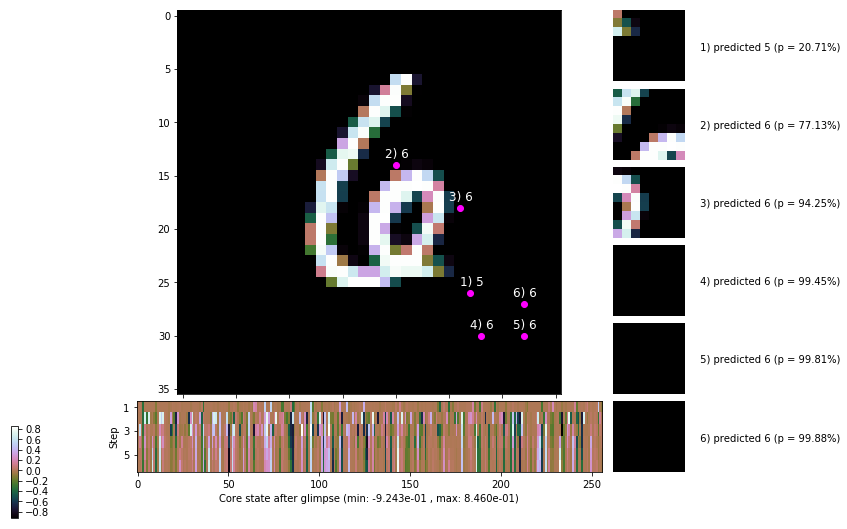


	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


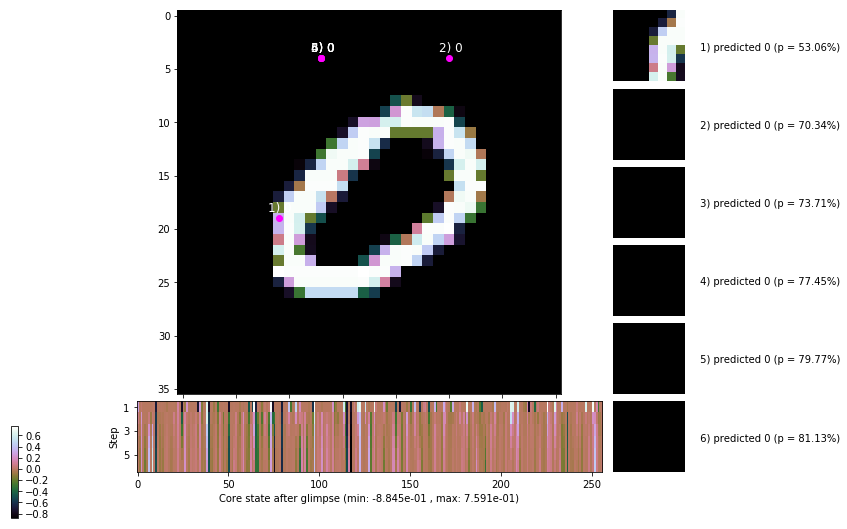

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


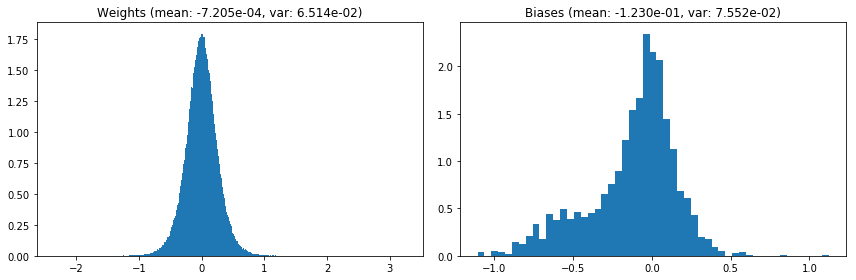

                                      Location network weights and biases


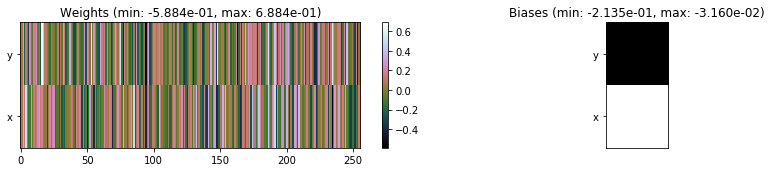

---------------------------------------------------------------------------------------------------------------
Elapsed time:  429.81 sec | TRAIN >> class loss: 0.4783 | steps:  2.393 :( | reward:  4.0688 :( | acc.: 83.993% :(
                          | VAL   >> class loss: 0.5198 | steps:  2.344 :( | reward:  4.1353 :( | acc.: 82.840% :(


Epoch  33/400) lr = 0.0006186
 b    300/  3000 >> 145.4 ms/b | lr: 6.18e-04 | grad 2norm: 11.56 | grad inf norm:  3.251
         Weights || abs max:  3.25 ( 5155.25) | mean: -7.14e-04 ( 0.02) | var: 6.52e-02 ( 2235.93)
          Biases || abs max:  1.12 (  140.42) | mean: -1.23e-01 ( 0.14) | var: 7.56e-02 (  293.66)
                    class loss: 0.472 | steps: 2.386 | reward:  4.078 | acc.: 84.30%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.9 ms/b | lr: 6.17e-04 | grad 2norm: 11.74 | grad inf norm:  3.329
         Weights || abs max:  3.24 ( 5176.19) | mean: -6.88e-04 (

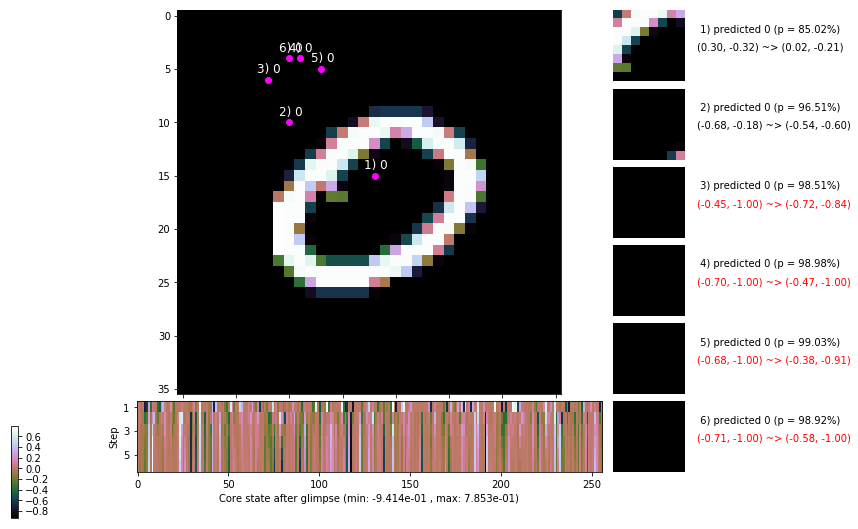

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 150.0 ms/b | lr: 6.16e-04 | grad 2norm: 11.78 | grad inf norm:  3.306
         Weights || abs max:  3.23 ( 3877.54) | mean: -6.85e-04 ( 0.02) | var: 6.54e-02 (  576.67)
          Biases || abs max:  1.12 (  125.34) | mean: -1.23e-01 ( 0.11) | var: 7.58e-02 (  169.43)
                    class loss: 0.468 | steps: 2.387 | reward:  4.079 | acc.: 84.00%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 144.3 ms/b | lr: 6.16e-04 | grad 2norm: 11.49 | grad inf norm:  3.138
         Weights || abs max:  3.23 ( 2280.76) | mean: -7.01e-04 ( 0.01) | var: 6.55e-02 (   60.67)
          Biases || abs max:  1.12 ( 2150.05) | mean: -1.23e-01 ( 0.89) | var: 7.60e-02 (443021.53)
                    class loss: 0.457 | steps: 2.387 | reward:  4.088 | acc.: 84.45%

	Target class: 2 | Discounted rewards: [-0.162, -0.125, 

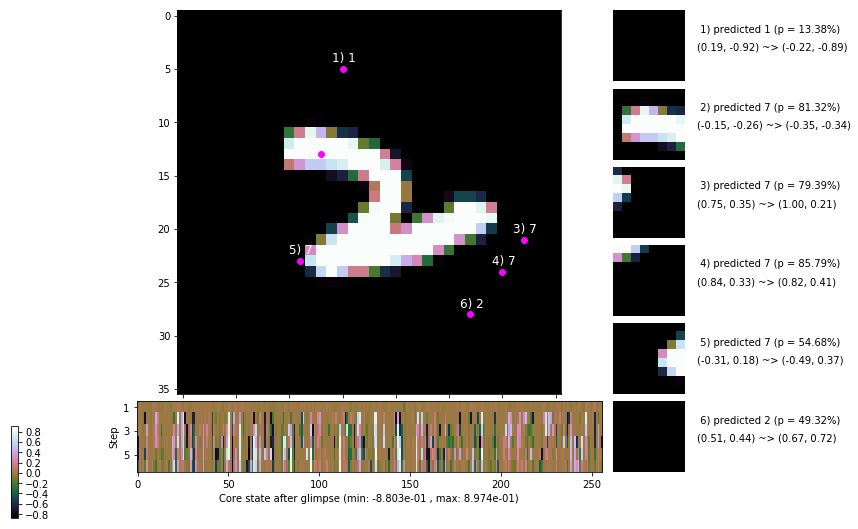

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.7 ms/b | lr: 6.14e-04 | grad 2norm: 11.65 | grad inf norm:  3.139
         Weights || abs max:  3.24 ( 6497.05) | mean: -7.08e-04 ( 0.02) | var: 6.56e-02 ( 6655.40)
          Biases || abs max:  1.11 (   56.32) | mean: -1.23e-01 ( 0.08) | var: 7.59e-02 (    5.08)
                    class loss: 0.460 | steps: 2.377 | reward:  4.063 | acc.: 83.88%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 139.9 ms/b | lr: 6.14e-04 | grad 2norm: 12.34 | grad inf norm:  3.642
         Weights || abs max:  3.23 (11459.60) | mean: -7.16e-04 ( 0.03) | var: 6.57e-02 (37664.22)
          Biases || abs max:  1.11 (  194.14) | mean: -1.23e-01 ( 0.14) | var: 7.63e-02 (  306.35)
                    class loss: 0.487 | steps: 2.390 | reward:  4.049 | acc.: 83.35%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.8

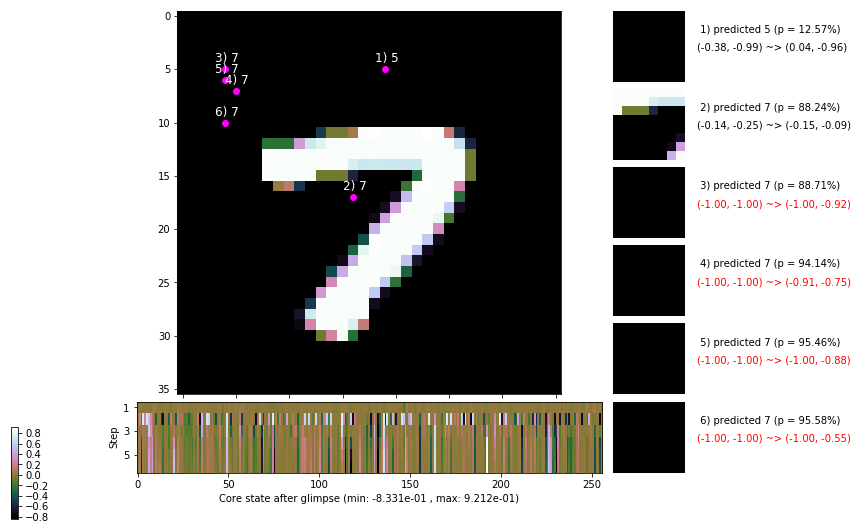

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.6 ms/b | lr: 6.12e-04 | grad 2norm: 11.70 | grad inf norm:  3.289
         Weights || abs max:  3.22 ( 2384.53) | mean: -6.98e-04 ( 0.01) | var: 6.57e-02 (   66.26)
          Biases || abs max:  1.11 (  113.71) | mean: -1.23e-01 ( 0.10) | var: 7.64e-02 (  205.28)
                    class loss: 0.458 | steps: 2.337 | reward:  4.141 | acc.: 84.43%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.2 ms/b | lr: 6.12e-04 | grad 2norm: 11.66 | grad inf norm:  3.194
         Weights || abs max:  3.22 ( 6104.53) | mean: -7.11e-04 ( 0.02) | var: 6.58e-02 ( 9888.65)
          Biases || abs max:  1.12 (  109.39) | mean: -1.23e-01 ( 0.10) | var: 7.65e-02 (   54.72)
                    class loss: 0.465 | steps: 2.384 | reward:  4.099 | acc.: 84.82%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

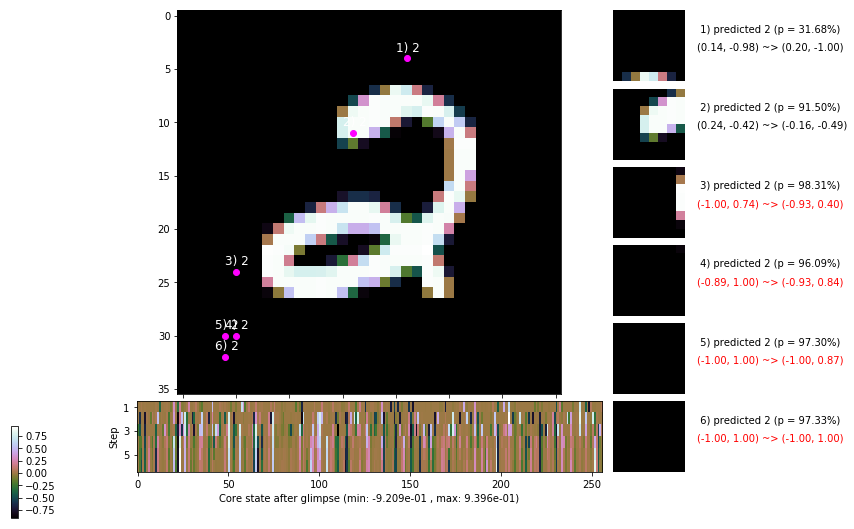

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.2 ms/b | lr: 6.11e-04 | grad 2norm: 11.89 | grad inf norm:  3.376
         Weights || abs max:  3.22 ( 3496.44) | mean: -6.76e-04 ( 0.01) | var: 6.59e-02 (  271.98)
          Biases || abs max:  1.12 (  110.52) | mean: -1.24e-01 ( 0.10) | var: 7.66e-02 (   88.57)
                    class loss: 0.476 | steps: 2.397 | reward:  4.074 | acc.: 84.27%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 139.7 ms/b | lr: 6.10e-04 | grad 2norm: 11.67 | grad inf norm:  3.189
         Weights || abs max:  3.22 ( 2961.12) | mean: -6.37e-04 ( 0.01) | var: 6.60e-02 (  335.19)
          Biases || abs max:  1.12 (  118.32) | mean: -1.24e-01 ( 0.11) | var: 7.66e-02 (  142.86)
                    class loss: 0.470 | steps: 2.358 | reward:  4.119 | acc.: 84.57%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

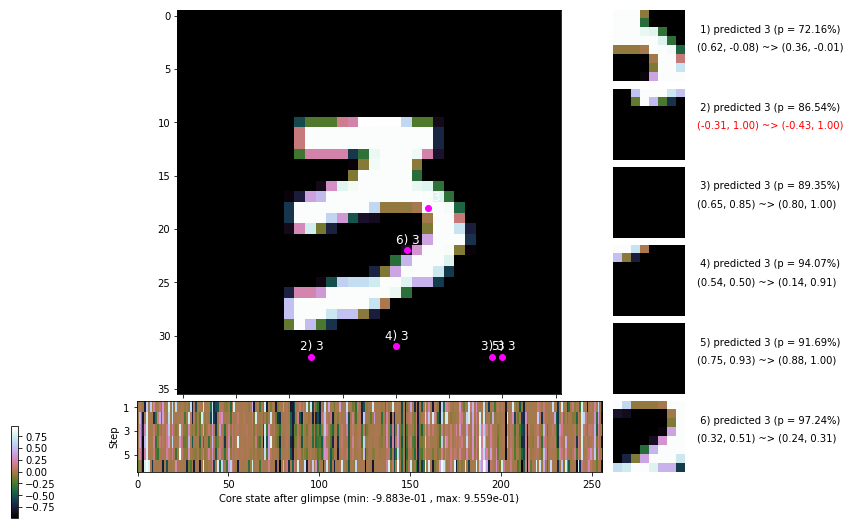

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


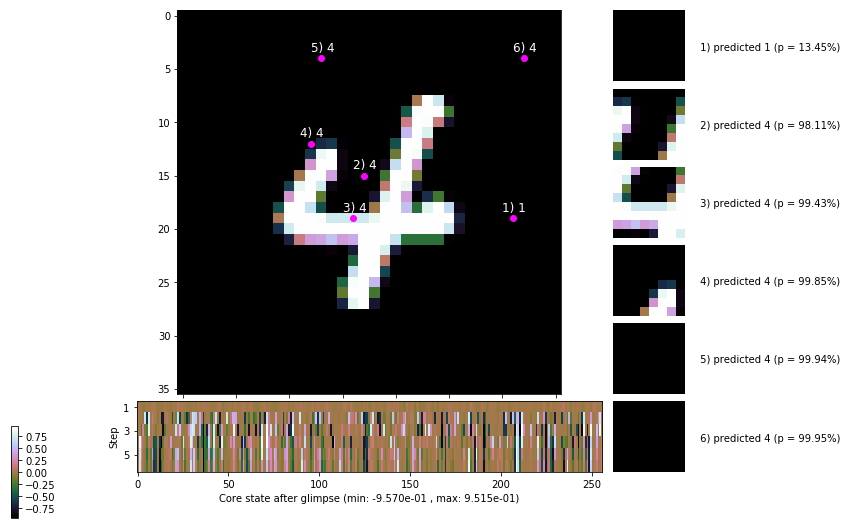


	Target class: 8 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


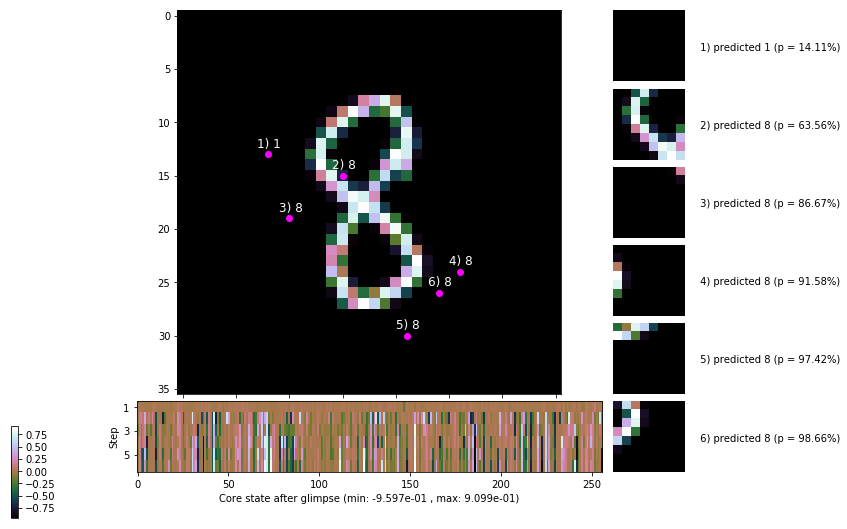

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


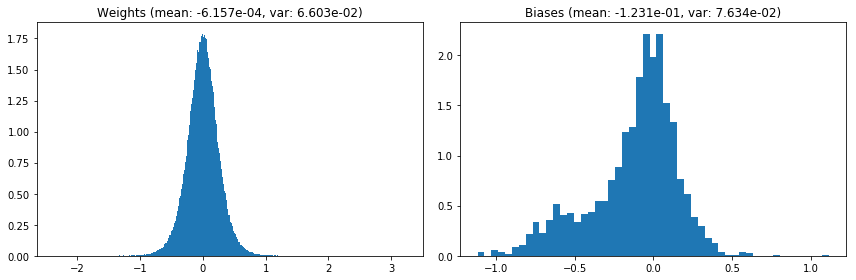

                                      Location network weights and biases


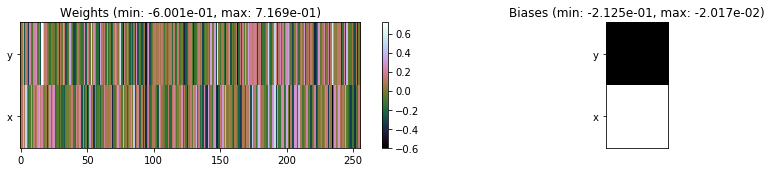

---------------------------------------------------------------------------------------------------------------
Elapsed time:  430.51 sec | TRAIN >> class loss: 0.4679 | steps:  2.379    | reward:  4.0875    | acc.: 84.260% :(
                          | VAL   >> class loss: 0.4977 | steps:  2.339 :( | reward:  4.1357 :( | acc.: 83.000% :(


Epoch  34/400) lr = 0.0006094
 b    300/  3000 >> 138.6 ms/b | lr: 6.09e-04 | grad 2norm: 11.99 | grad inf norm:  3.334
         Weights || abs max:  3.23 ( 3301.36) | mean: -6.26e-04 ( 0.01) | var: 6.61e-02 (  349.82)
          Biases || abs max:  1.12 (  408.85) | mean: -1.23e-01 ( 0.23) | var: 7.64e-02 ( 1136.27)
                    class loss: 0.472 | steps: 2.359 | reward:  4.080 | acc.: 83.62%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.2 ms/b | lr: 6.08e-04 | grad 2norm: 11.87 | grad inf norm:  3.226
         Weights || abs max:  3.23 ( 5360.70) | mean: -6.47e-04 (

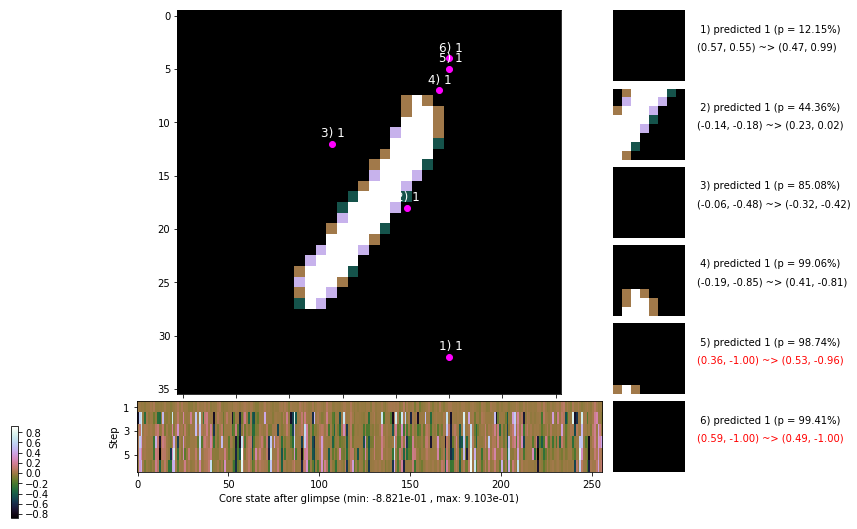

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 147.5 ms/b | lr: 6.07e-04 | grad 2norm: 11.56 | grad inf norm:  3.100
         Weights || abs max:  3.24 (18498.34) | mean: -6.42e-04 ( 0.04) | var: 6.62e-02 (143881.06)
          Biases || abs max:  1.11 (   77.82) | mean: -1.24e-01 ( 0.09) | var: 7.69e-02 (   20.12)
                    class loss: 0.465 | steps: 2.367 | reward:  4.118 | acc.: 84.53%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 148.8 ms/b | lr: 6.06e-04 | grad 2norm: 11.92 | grad inf norm:  3.465
         Weights || abs max:  3.26 ( 3436.13) | mean: -6.81e-04 ( 0.01) | var: 6.63e-02 (  468.74)
          Biases || abs max:  1.11 (   98.65) | mean: -1.24e-01 ( 0.10) | var: 7.71e-02 (   36.33)
                    class loss: 0.486 | steps: 2.396 | reward:  4.069 | acc.: 83.67%

	Target class: 9 | Discounted rewards: [0.869, 1.938, 1.

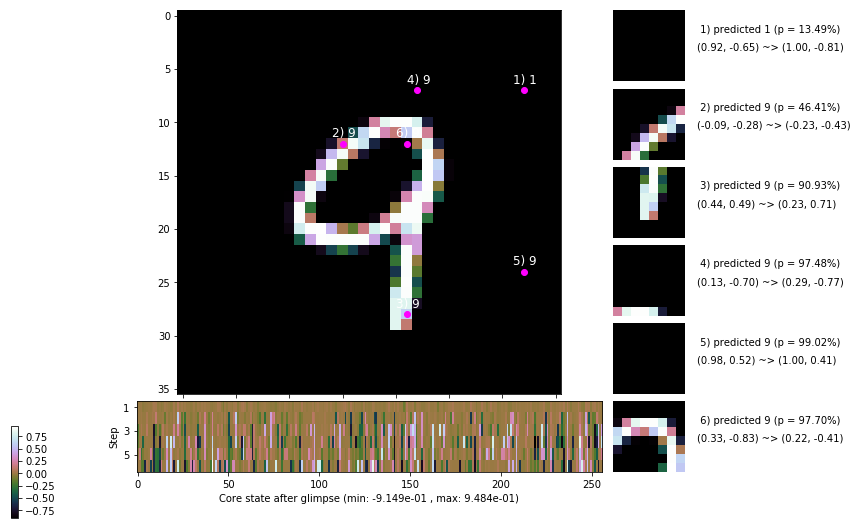

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 148.1 ms/b | lr: 6.05e-04 | grad 2norm: 11.77 | grad inf norm:  3.234
         Weights || abs max:  3.28 ( 3865.31) | mean: -6.68e-04 ( 0.02) | var: 6.64e-02 ( 1839.44)
          Biases || abs max:  1.12 (  298.91) | mean: -1.24e-01 ( 0.18) | var: 7.73e-02 ( 2456.35)
                    class loss: 0.461 | steps: 2.369 | reward:  4.095 | acc.: 84.12%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 147.0 ms/b | lr: 6.05e-04 | grad 2norm: 11.67 | grad inf norm:  3.238
         Weights || abs max:  3.28 ( 3180.77) | mean: -6.73e-04 ( 0.01) | var: 6.65e-02 (  230.43)
          Biases || abs max:  1.13 (  336.36) | mean: -1.24e-01 ( 0.21) | var: 7.72e-02 ( 1692.75)
                    class loss: 0.455 | steps: 2.350 | reward:  4.112 | acc.: 84.35%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.8

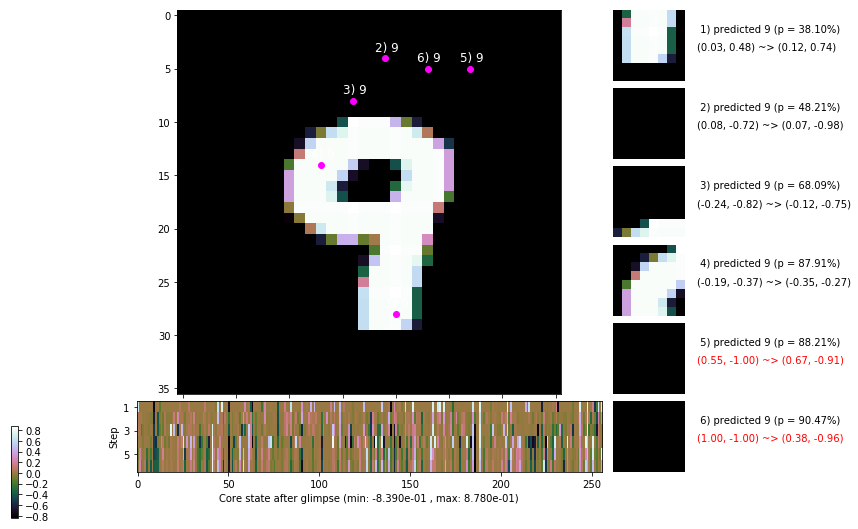

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 145.5 ms/b | lr: 6.03e-04 | grad 2norm: 11.93 | grad inf norm:  3.387
         Weights || abs max:  3.27 ( 3589.52) | mean: -6.61e-04 ( 0.01) | var: 6.66e-02 (  583.21)
          Biases || abs max:  1.13 (  140.25) | mean: -1.24e-01 ( 0.14) | var: 7.73e-02 (  108.08)
                    class loss: 0.482 | steps: 2.390 | reward:  4.082 | acc.: 84.10%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 140.7 ms/b | lr: 6.03e-04 | grad 2norm: 11.70 | grad inf norm:  3.160
         Weights || abs max:  3.28 ( 9149.35) | mean: -6.56e-04 ( 0.03) | var: 6.66e-02 ( 8420.04)
          Biases || abs max:  1.13 (   86.21) | mean: -1.24e-01 ( 0.10) | var: 7.75e-02 (   15.23)
                    class loss: 0.499 | steps: 2.394 | reward:  4.057 | acc.: 83.15%

	Target class: 8 | Discounted rewards: [-0.128, -0.056, 0

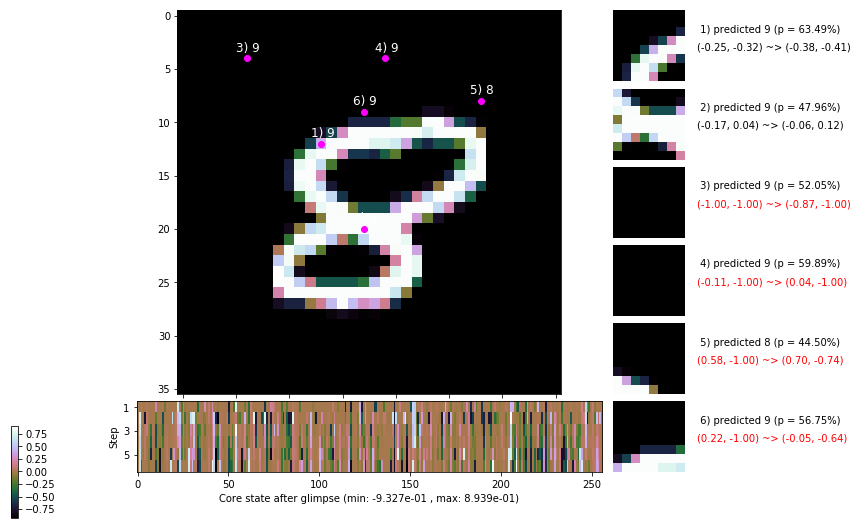

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.0 ms/b | lr: 6.02e-04 | grad 2norm: 11.96 | grad inf norm:  3.333
         Weights || abs max:  3.28 ( 5614.19) | mean: -6.42e-04 ( 0.02) | var: 6.67e-02 ( 4100.90)
          Biases || abs max:  1.13 (  170.50) | mean: -1.24e-01 ( 0.14) | var: 7.78e-02 (  362.72)
                    class loss: 0.473 | steps: 2.378 | reward:  4.073 | acc.: 83.97%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.6 ms/b | lr: 6.01e-04 | grad 2norm: 11.86 | grad inf norm:  3.227
         Weights || abs max:  3.27 ( 2977.96) | mean: -6.50e-04 ( 0.01) | var: 6.68e-02 (  441.08)
          Biases || abs max:  1.13 (  141.97) | mean: -1.24e-01 ( 0.12) | var: 7.79e-02 (  432.91)
                    class loss: 0.473 | steps: 2.388 | reward:  4.093 | acc.: 83.93%

	Target class: 6 | Discounted rewards: [0.869, 1.938, 1.8

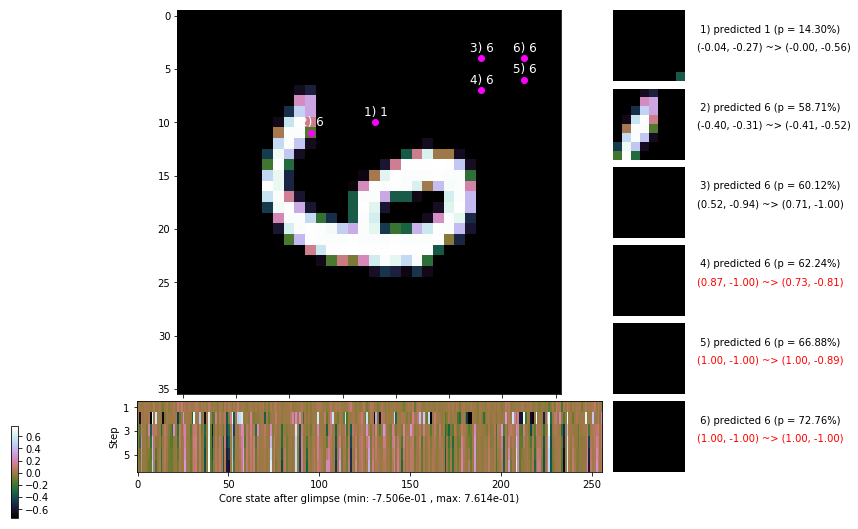

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.044, 0.287, 0.775, 1.750, 1.500, 1.000]


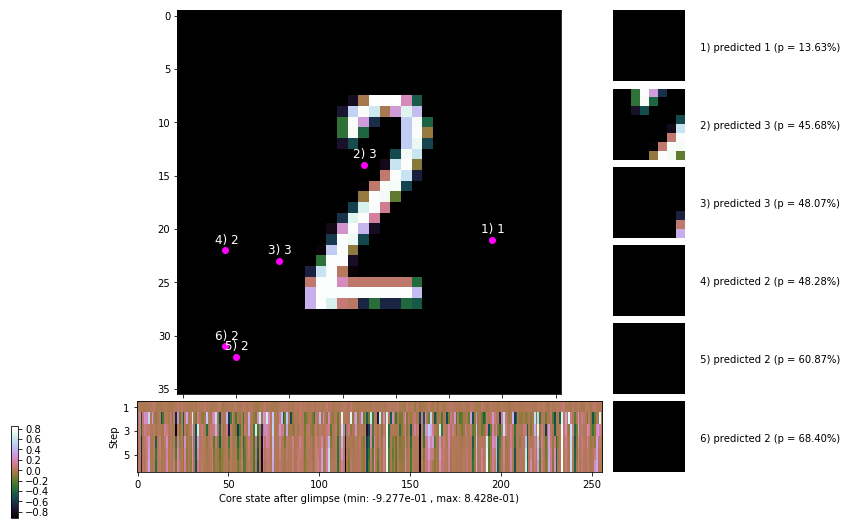


	Target class: 4 | Discounted rewards: [0.319, 0.837, 1.875, 1.750, 1.500, 1.000]


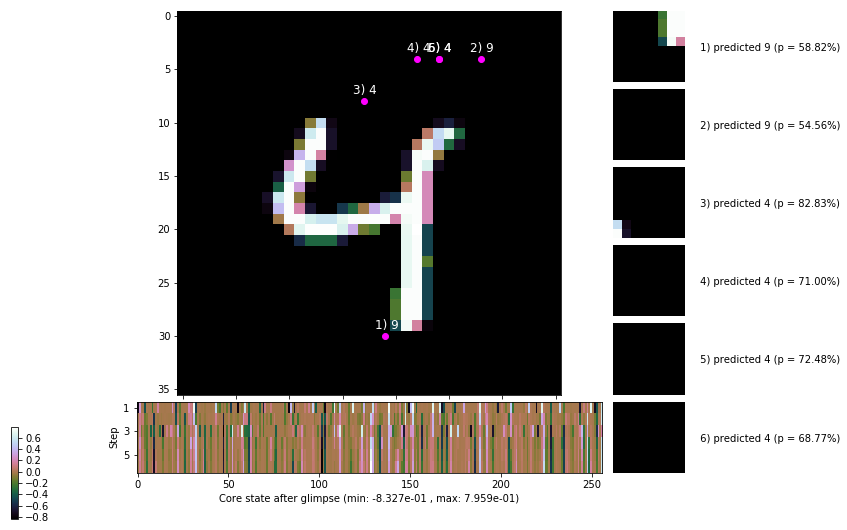

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


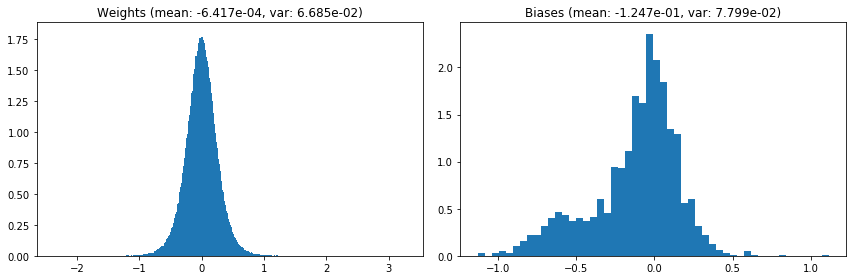

                                      Location network weights and biases


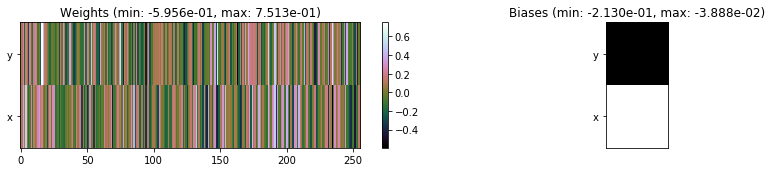

---------------------------------------------------------------------------------------------------------------
Elapsed time:  434.93 sec | TRAIN >> class loss: 0.4738 | steps:  2.376    | reward:  4.0871 :( | acc.: 83.935% :(
                          | VAL   >> class loss: 0.4653 | steps:  2.286 :( | reward:  4.1989    | acc.: 84.540% :(


Epoch  35/400) lr = 0.0006003
 b    300/  3000 >> 138.4 ms/b | lr: 6.00e-04 | grad 2norm: 11.87 | grad inf norm:  3.252
         Weights || abs max:  3.26 ( 7428.45) | mean: -6.59e-04 ( 0.02) | var: 6.69e-02 ( 6157.74)
          Biases || abs max:  1.13 (   60.51) | mean: -1.25e-01 ( 0.08) | var: 7.80e-02 (   23.07)
                    class loss: 0.463 | steps: 2.364 | reward:  4.107 | acc.: 84.42%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.0 ms/b | lr: 5.99e-04 | grad 2norm: 11.52 | grad inf norm:  3.170
         Weights || abs max:  3.26 ( 4845.62) | mean: -6.67e-04 (

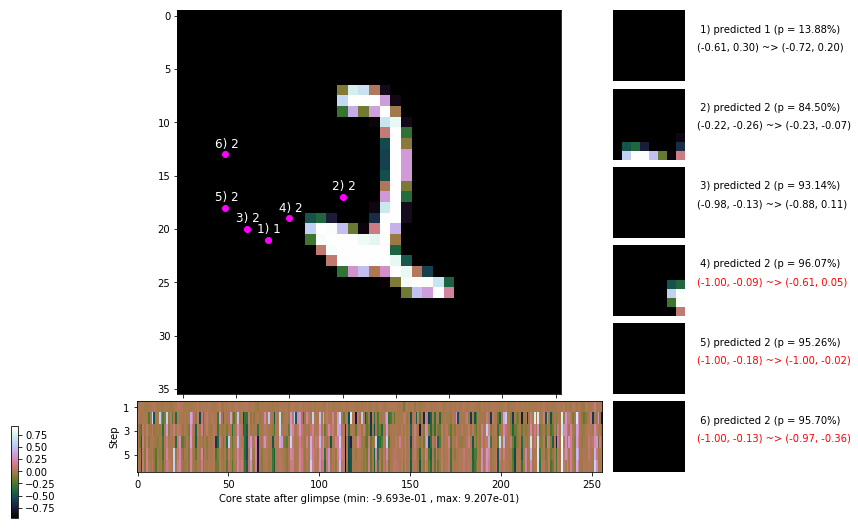

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.4 ms/b | lr: 5.98e-04 | grad 2norm: 11.84 | grad inf norm:  3.214
         Weights || abs max:  3.25 ( 3093.81) | mean: -6.68e-04 ( 0.01) | var: 6.70e-02 (  348.43)
          Biases || abs max:  1.12 (   47.44) | mean: -1.25e-01 ( 0.07) | var: 7.81e-02 (    7.99)
                    class loss: 0.475 | steps: 2.376 | reward:  4.065 | acc.: 84.02%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.9 ms/b | lr: 5.97e-04 | grad 2norm: 12.00 | grad inf norm:  3.390
         Weights || abs max:  3.26 ( 3617.18) | mean: -6.81e-04 ( 0.02) | var: 6.71e-02 (  433.14)
          Biases || abs max:  1.12 (   95.73) | mean: -1.25e-01 ( 0.10) | var: 7.83e-02 (   93.49)
                    class loss: 0.465 | steps: 2.364 | reward:  4.111 | acc.: 84.38%

	Target class: 2 | Discounted rewards: [0.869, 1.938, 1.8

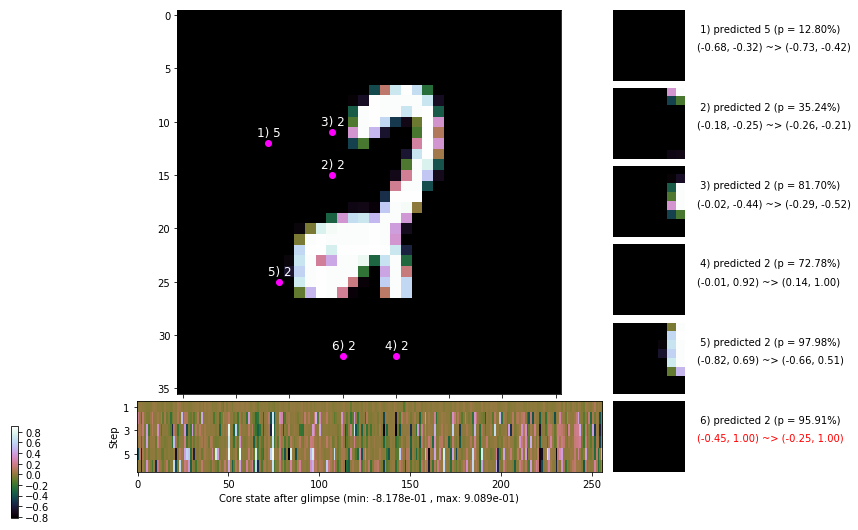

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 145.6 ms/b | lr: 5.96e-04 | grad 2norm: 11.81 | grad inf norm:  3.347
         Weights || abs max:  3.27 ( 9676.84) | mean: -7.03e-04 ( 0.03) | var: 6.72e-02 (26303.01)
          Biases || abs max:  1.12 ( 2798.53) | mean: -1.25e-01 ( 2.16) | var: 7.82e-02 (1565747.62)
                    class loss: 0.462 | steps: 2.387 | reward:  4.096 | acc.: 84.55%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 146.7 ms/b | lr: 5.96e-04 | grad 2norm: 11.53 | grad inf norm:  3.162
         Weights || abs max:  3.28 ( 5075.71) | mean: -7.18e-04 ( 0.02) | var: 6.73e-02 (  852.89)
          Biases || abs max:  1.13 (  158.88) | mean: -1.25e-01 ( 0.13) | var: 7.84e-02 (   85.62)
                    class loss: 0.451 | steps: 2.357 | reward:  4.127 | acc.: 84.83%

	Target class: 9 | Discounted rewards: [0.456, 1.112, 0

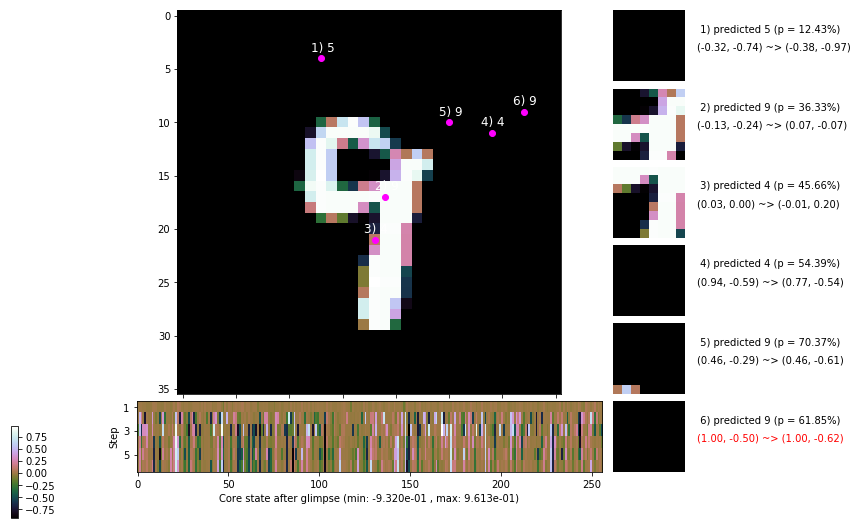

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 143.2 ms/b | lr: 5.94e-04 | grad 2norm: 11.58 | grad inf norm:  3.209
         Weights || abs max:  3.28 ( 2597.60) | mean: -7.22e-04 ( 0.01) | var: 6.74e-02 (   87.83)
          Biases || abs max:  1.13 (  164.46) | mean: -1.25e-01 ( 0.13) | var: 7.84e-02 (  607.79)
                    class loss: 0.472 | steps: 2.377 | reward:  4.097 | acc.: 84.22%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 146.8 ms/b | lr: 5.94e-04 | grad 2norm: 11.63 | grad inf norm:  3.231
         Weights || abs max:  3.29 ( 4355.17) | mean: -7.45e-04 ( 0.02) | var: 6.74e-02 (  654.50)
          Biases || abs max:  1.13 (  995.42) | mean: -1.25e-01 ( 0.43) | var: 7.87e-02 (105256.88)
                    class loss: 0.482 | steps: 2.384 | reward:  4.079 | acc.: 84.00%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.

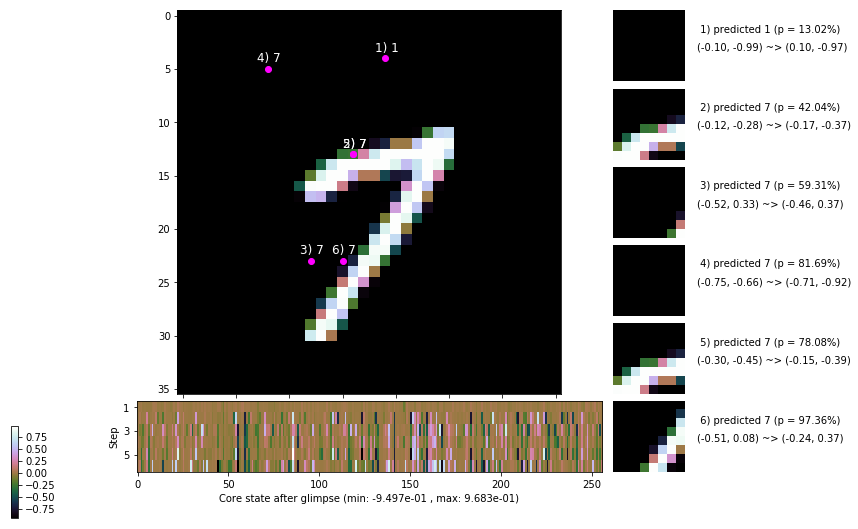

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 146.6 ms/b | lr: 5.93e-04 | grad 2norm: 11.49 | grad inf norm:  3.021
         Weights || abs max:  3.30 ( 3674.65) | mean: -7.39e-04 ( 0.02) | var: 6.75e-02 (  266.52)
          Biases || abs max:  1.14 (  108.49) | mean: -1.25e-01 ( 0.10) | var: 7.88e-02 (   96.12)
                    class loss: 0.469 | steps: 2.351 | reward:  4.101 | acc.: 84.42%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 146.5 ms/b | lr: 5.92e-04 | grad 2norm: 12.09 | grad inf norm:  3.407
         Weights || abs max:  3.31 ( 9798.11) | mean: -7.55e-04 ( 0.03) | var: 6.76e-02 (21014.45)
          Biases || abs max:  1.13 (   63.64) | mean: -1.25e-01 ( 0.08) | var: 7.88e-02 (    7.44)
                    class loss: 0.494 | steps: 2.425 | reward:  4.010 | acc.: 83.12%

	Target class: 3 | Discounted rewards: [0.250, 0.700, 1.6

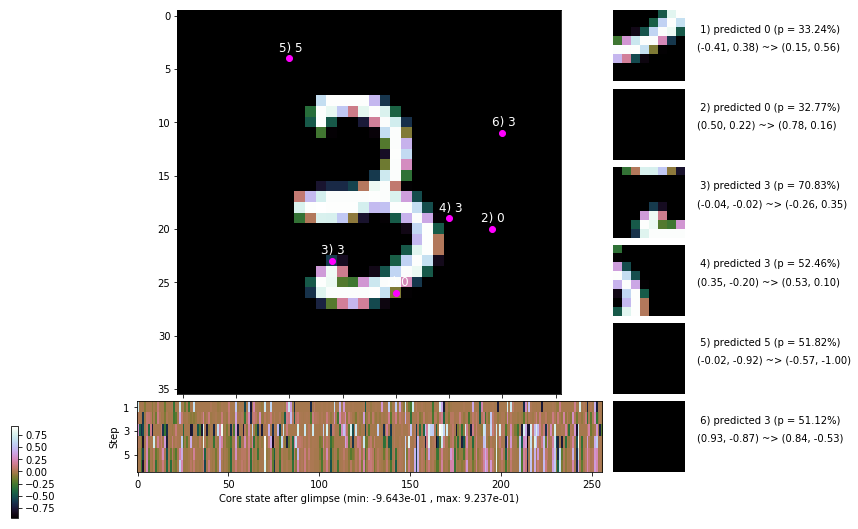

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


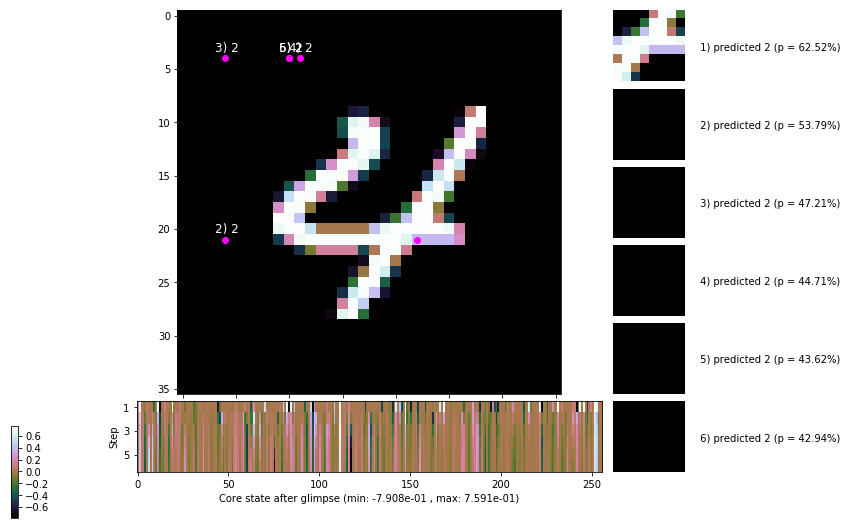


	Target class: 6 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


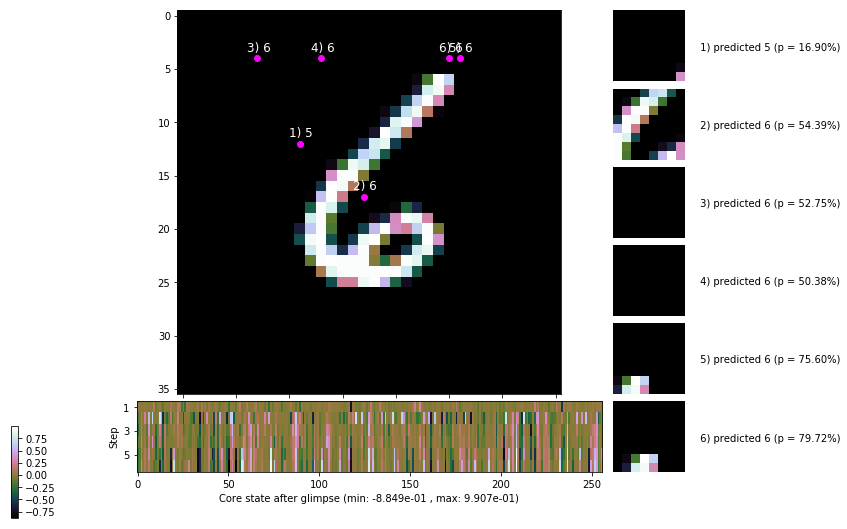

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


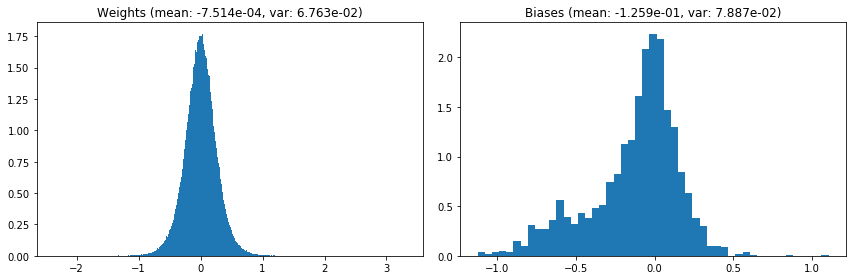

                                      Location network weights and biases


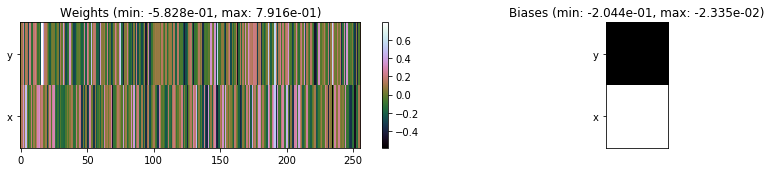

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.19 sec | TRAIN >> class loss: 0.4701 | steps:  2.377 :( | reward:  4.0877    | acc.: 84.190% :(
                          | VAL   >> class loss: 0.4664 | steps:  2.278    | reward:  4.1980 :( | acc.: 84.060% :(


Epoch  36/400) lr = 0.0005914
 b    300/  3000 >> 142.9 ms/b | lr: 5.91e-04 | grad 2norm: 11.57 | grad inf norm:  3.353
         Weights || abs max:  3.31 ( 3656.28) | mean: -7.40e-04 ( 0.02) | var: 6.77e-02 (  368.30)
          Biases || abs max:  1.12 (  130.00) | mean: -1.26e-01 ( 0.11) | var: 7.89e-02 (   54.18)
                    class loss: 0.467 | steps: 2.365 | reward:  4.125 | acc.: 84.48%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.2 ms/b | lr: 5.90e-04 | grad 2norm: 11.73 | grad inf norm:  3.263
         Weights || abs max:  3.31 ( 3041.35) | mean: -7.65e-04 (

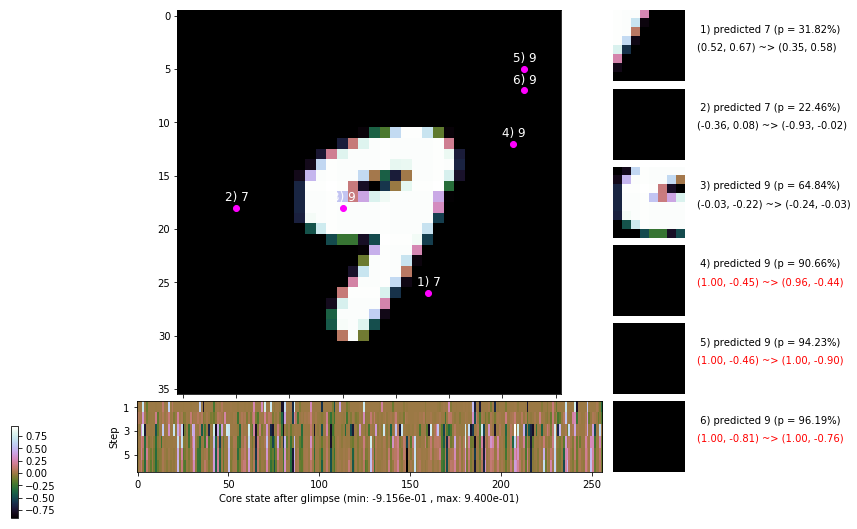

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.0 ms/b | lr: 5.89e-04 | grad 2norm: 11.56 | grad inf norm:  3.232
         Weights || abs max:  3.31 ( 4236.47) | mean: -7.73e-04 ( 0.02) | var: 6.78e-02 (  555.12)
          Biases || abs max:  1.12 (  246.03) | mean: -1.26e-01 ( 0.17) | var: 7.90e-02 (  523.35)
                    class loss: 0.464 | steps: 2.373 | reward:  4.097 | acc.: 84.42%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.1 ms/b | lr: 5.88e-04 | grad 2norm: 11.89 | grad inf norm:  3.327
         Weights || abs max:  3.31 ( 3981.93) | mean: -7.69e-04 ( 0.02) | var: 6.79e-02 (  478.00)
          Biases || abs max:  1.13 (  154.04) | mean: -1.25e-01 ( 0.13) | var: 7.92e-02 (  266.50)
                    class loss: 0.453 | steps: 2.392 | reward:  4.071 | acc.: 84.42%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.8

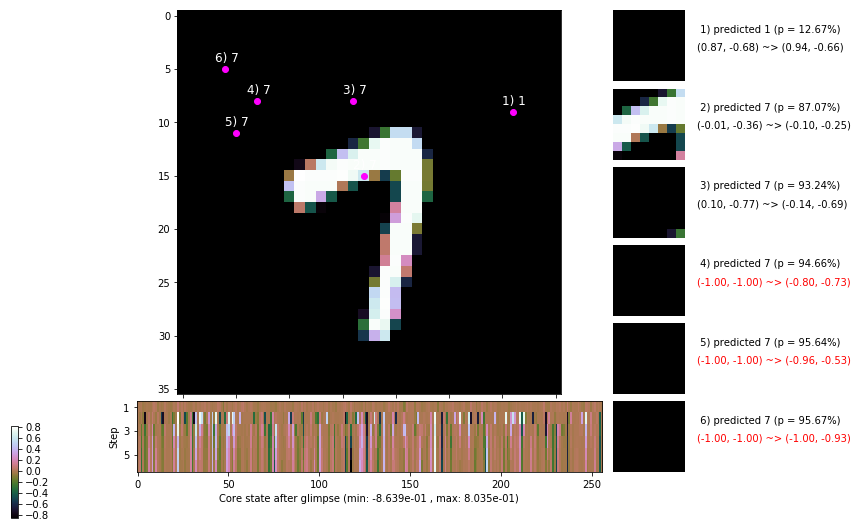

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.1 ms/b | lr: 5.87e-04 | grad 2norm: 11.74 | grad inf norm:  3.170
         Weights || abs max:  3.30 ( 6148.23) | mean: -7.99e-04 ( 0.02) | var: 6.80e-02 ( 7950.28)
          Biases || abs max:  1.13 (  244.96) | mean: -1.25e-01 ( 0.16) | var: 7.92e-02 (  281.04)
                    class loss: 0.455 | steps: 2.346 | reward:  4.118 | acc.: 84.78%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.9 ms/b | lr: 5.87e-04 | grad 2norm: 11.79 | grad inf norm:  3.208
         Weights || abs max:  3.29 ( 3782.18) | mean: -8.05e-04 ( 0.02) | var: 6.81e-02 (  440.33)
          Biases || abs max:  1.13 (   62.86) | mean: -1.26e-01 ( 0.08) | var: 7.93e-02 (   10.15)
                    class loss: 0.460 | steps: 2.357 | reward:  4.106 | acc.: 84.35%

	Target class: 3 | Discounted rewards: [0.869, 1.938, 1.8

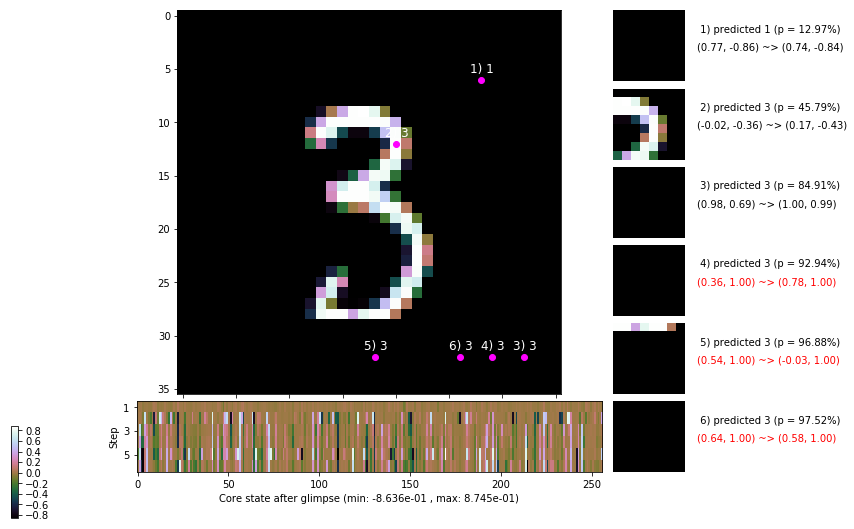

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 141.1 ms/b | lr: 5.86e-04 | grad 2norm: 11.62 | grad inf norm:  3.336
         Weights || abs max:  3.28 ( 6975.50) | mean: -7.94e-04 ( 0.02) | var: 6.82e-02 (11835.66)
          Biases || abs max:  1.13 (  100.16) | mean: -1.26e-01 ( 0.10) | var: 7.95e-02 (   72.89)
                    class loss: 0.451 | steps: 2.392 | reward:  4.087 | acc.: 84.58%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.7 ms/b | lr: 5.85e-04 | grad 2norm: 11.78 | grad inf norm:  3.238
         Weights || abs max:  3.29 ( 4149.44) | mean: -7.89e-04 ( 0.02) | var: 6.82e-02 (  590.13)
          Biases || abs max:  1.13 (  367.89) | mean: -1.26e-01 ( 0.20) | var: 7.95e-02 ( 9641.66)
                    class loss: 0.480 | steps: 2.381 | reward:  4.076 | acc.: 83.77%

	Target class: 2 | Discounted rewards: [-0.197, -0.194, -

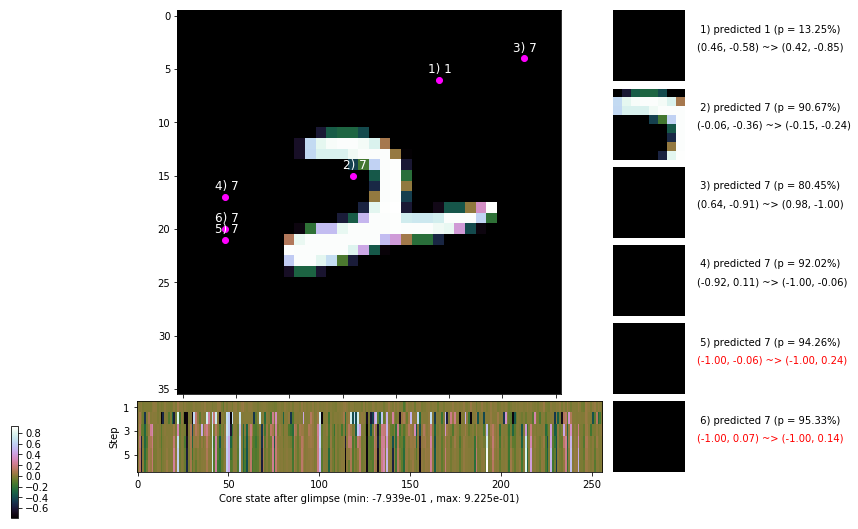

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 146.9 ms/b | lr: 5.84e-04 | grad 2norm: 11.71 | grad inf norm:  3.200
         Weights || abs max:  3.28 ( 5392.05) | mean: -7.63e-04 ( 0.02) | var: 6.83e-02 ( 2361.82)
          Biases || abs max:  1.13 (   96.76) | mean: -1.27e-01 ( 0.09) | var: 7.99e-02 (  133.49)
                    class loss: 0.482 | steps: 2.369 | reward:  4.113 | acc.: 84.38%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 146.4 ms/b | lr: 5.83e-04 | grad 2norm: 11.48 | grad inf norm:  3.120
         Weights || abs max:  3.28 (566817.25) | mean: -7.24e-04 ( 1.05) | var: 6.84e-02 (174840432.00)
          Biases || abs max:  1.14 (  135.24) | mean: -1.27e-01 ( 0.11) | var: 7.99e-02 (  144.09)
                    class loss: 0.445 | steps: 2.325 | reward:  4.150 | acc.: 85.23%

	Target class: 7 | Discounted rewards: [-0.197, -0.1

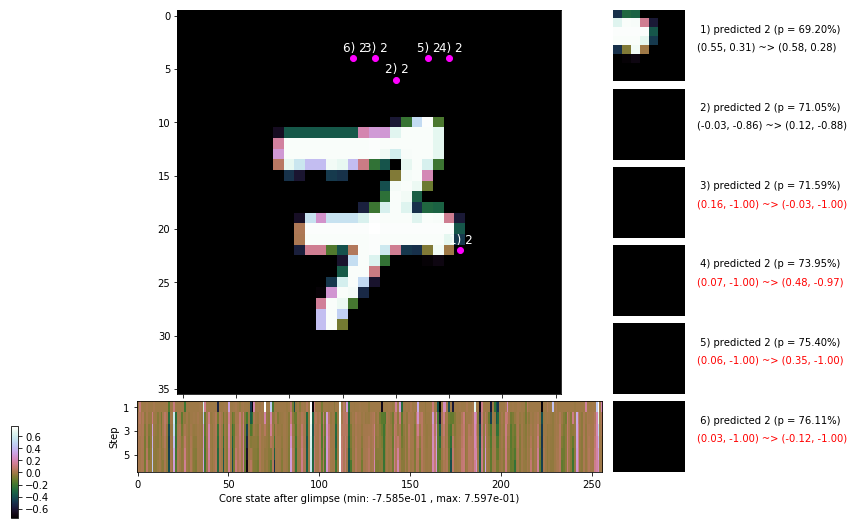

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.044, 0.287, 0.775, 1.750, 1.500, 1.000]


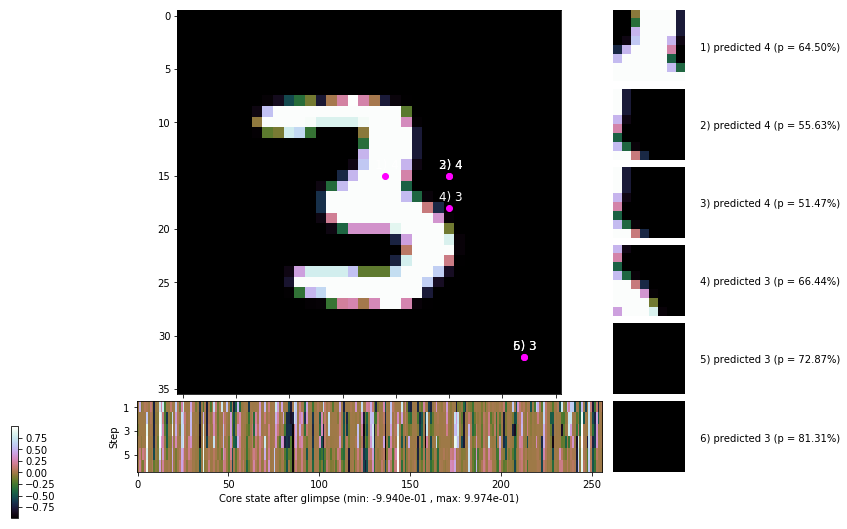


	Target class: 1 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


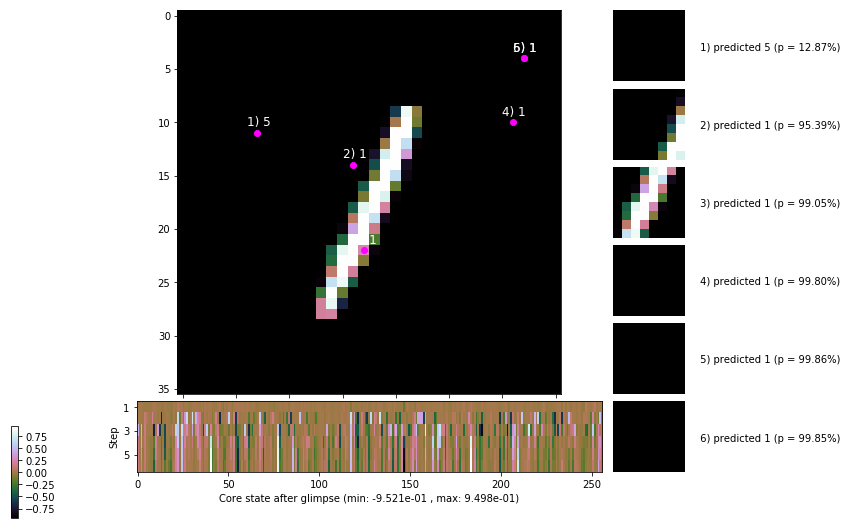

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


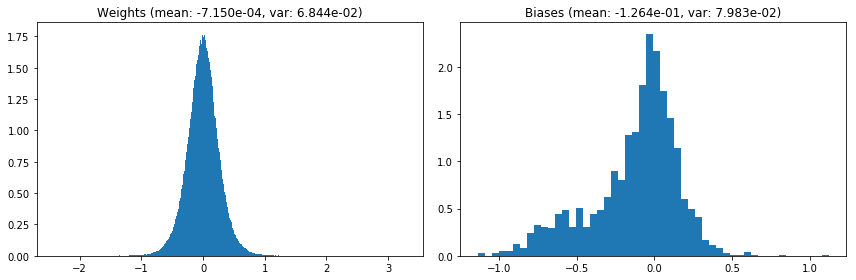

                                      Location network weights and biases


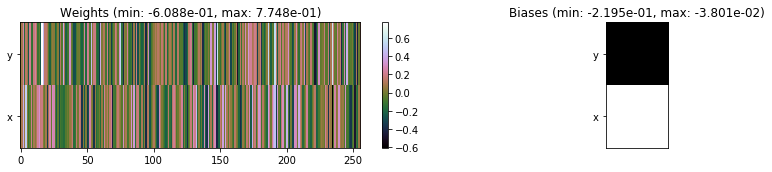

---------------------------------------------------------------------------------------------------------------
Elapsed time:  428.77 sec | TRAIN >> class loss: 0.4620 | steps:  2.368    | reward:  4.1045    | acc.: 84.507% :(
                          | VAL   >> class loss: 0.4381 | steps:  2.288 :( | reward:  4.2041    | acc.: 84.940% :(


Epoch  37/400) lr = 0.0005826
 b    300/  3000 >> 142.2 ms/b | lr: 5.82e-04 | grad 2norm: 11.47 | grad inf norm:  3.260
         Weights || abs max:  3.29 ( 3567.80) | mean: -7.00e-04 ( 0.02) | var: 6.85e-02 (  384.19)
          Biases || abs max:  1.13 (   68.97) | mean: -1.26e-01 ( 0.08) | var: 8.00e-02 (   16.64)
                    class loss: 0.475 | steps: 2.373 | reward:  4.106 | acc.: 84.78%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.9 ms/b | lr: 5.81e-04 | grad 2norm: 11.49 | grad inf norm:  3.214
         Weights || abs max:  3.28 ( 3343.21) | mean: -6.66e-04 (

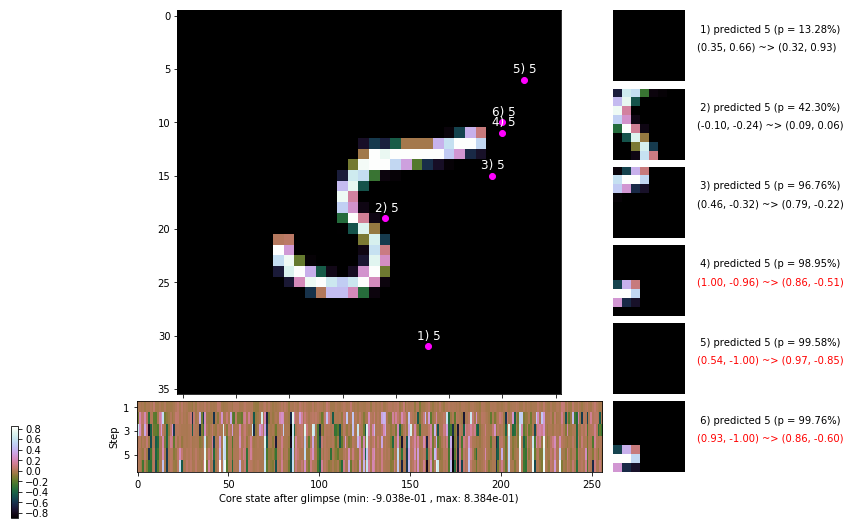

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 149.0 ms/b | lr: 5.80e-04 | grad 2norm: 11.75 | grad inf norm:  3.286
         Weights || abs max:  3.28 ( 3327.17) | mean: -6.70e-04 ( 0.02) | var: 6.86e-02 (  179.10)
          Biases || abs max:  1.13 (   87.99) | mean: -1.27e-01 ( 0.10) | var: 8.02e-02 (   25.61)
                    class loss: 0.462 | steps: 2.388 | reward:  4.072 | acc.: 84.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 146.3 ms/b | lr: 5.80e-04 | grad 2norm: 11.75 | grad inf norm:  3.421
         Weights || abs max:  3.28 ( 4059.84) | mean: -6.89e-04 ( 0.02) | var: 6.87e-02 (  802.99)
          Biases || abs max:  1.13 (  459.45) | mean: -1.27e-01 ( 0.25) | var: 8.05e-02 ( 2046.53)
                    class loss: 0.478 | steps: 2.372 | reward:  4.097 | acc.: 84.27%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

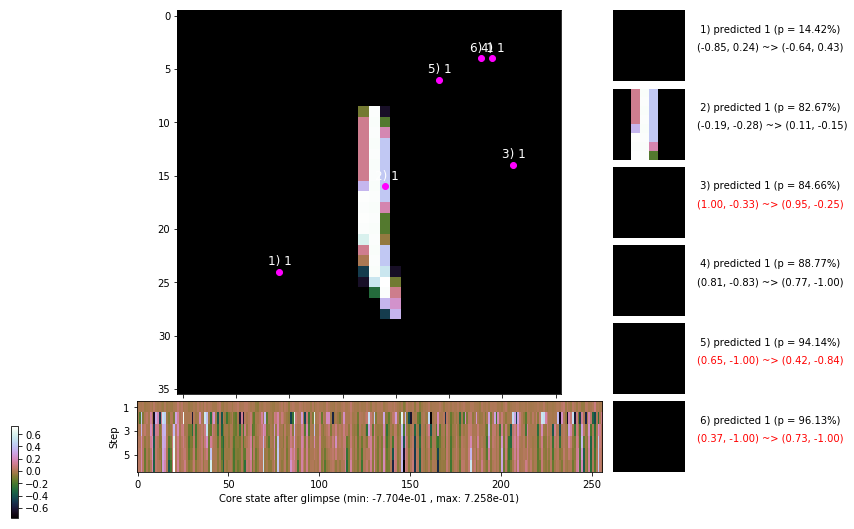

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 147.7 ms/b | lr: 5.79e-04 | grad 2norm: 11.70 | grad inf norm:  3.254
         Weights || abs max:  3.29 ( 4037.48) | mean: -6.82e-04 ( 0.02) | var: 6.88e-02 (  775.78)
          Biases || abs max:  1.13 (  161.07) | mean: -1.27e-01 ( 0.12) | var: 8.06e-02 (  524.61)
                    class loss: 0.473 | steps: 2.367 | reward:  4.102 | acc.: 84.38%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.3 ms/b | lr: 5.78e-04 | grad 2norm: 11.71 | grad inf norm:  3.258
         Weights || abs max:  3.30 ( 3245.76) | mean: -6.89e-04 ( 0.01) | var: 6.88e-02 (  178.23)
          Biases || abs max:  1.13 (  127.29) | mean: -1.27e-01 ( 0.11) | var: 8.06e-02 (   78.74)
                    class loss: 0.475 | steps: 2.388 | reward:  4.058 | acc.: 83.75%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.8

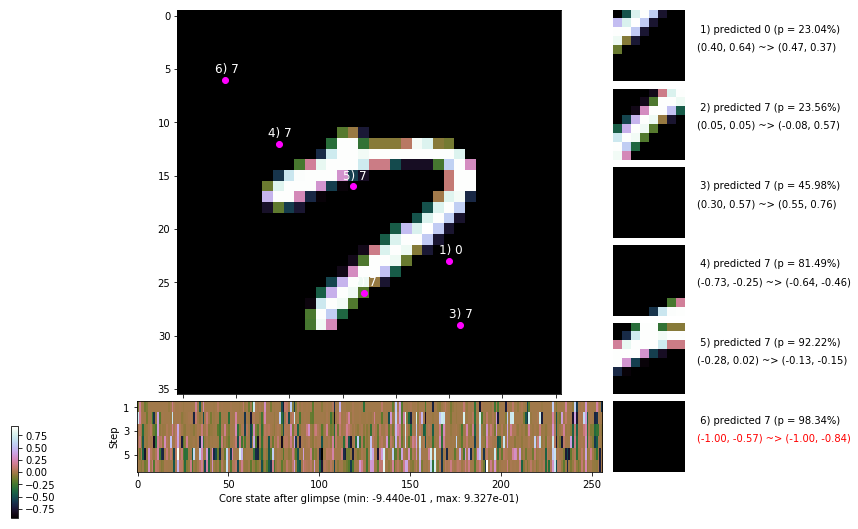

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 140.6 ms/b | lr: 5.77e-04 | grad 2norm: 11.66 | grad inf norm:  3.315
         Weights || abs max:  3.30 ( 8920.08) | mean: -7.03e-04 ( 0.02) | var: 6.89e-02 (11875.14)
          Biases || abs max:  1.13 (  117.59) | mean: -1.27e-01 ( 0.11) | var: 8.05e-02 (  115.54)
                    class loss: 0.471 | steps: 2.365 | reward:  4.092 | acc.: 84.50%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.9 ms/b | lr: 5.76e-04 | grad 2norm: 11.73 | grad inf norm:  3.383
         Weights || abs max:  3.28 ( 2190.34) | mean: -7.29e-04 ( 0.01) | var: 6.90e-02 (   57.83)
          Biases || abs max:  1.12 (   77.20) | mean: -1.27e-01 ( 0.09) | var: 8.06e-02 (   19.44)
                    class loss: 0.495 | steps: 2.403 | reward:  4.034 | acc.: 83.62%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.8

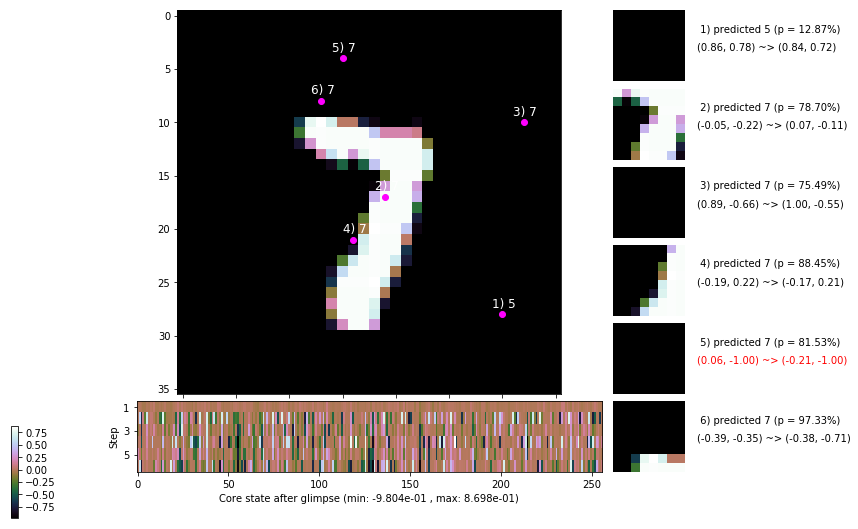

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.5 ms/b | lr: 5.75e-04 | grad 2norm: 11.58 | grad inf norm:  3.227
         Weights || abs max:  3.27 ( 2902.45) | mean: -7.07e-04 ( 0.01) | var: 6.91e-02 (  175.78)
          Biases || abs max:  1.13 (  111.41) | mean: -1.27e-01 ( 0.11) | var: 8.07e-02 (   19.64)
                    class loss: 0.479 | steps: 2.382 | reward:  4.070 | acc.: 83.83%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.0 ms/b | lr: 5.74e-04 | grad 2norm: 11.62 | grad inf norm:  3.157
         Weights || abs max:  3.28 ( 4016.64) | mean: -7.08e-04 ( 0.02) | var: 6.91e-02 (  369.69)
          Biases || abs max:  1.13 (  219.13) | mean: -1.27e-01 ( 0.15) | var: 8.09e-02 (  652.51)
                    class loss: 0.487 | steps: 2.385 | reward:  4.054 | acc.: 83.45%

	Target class: 9 | Discounted rewards: [0.319, 0.837, 1.8

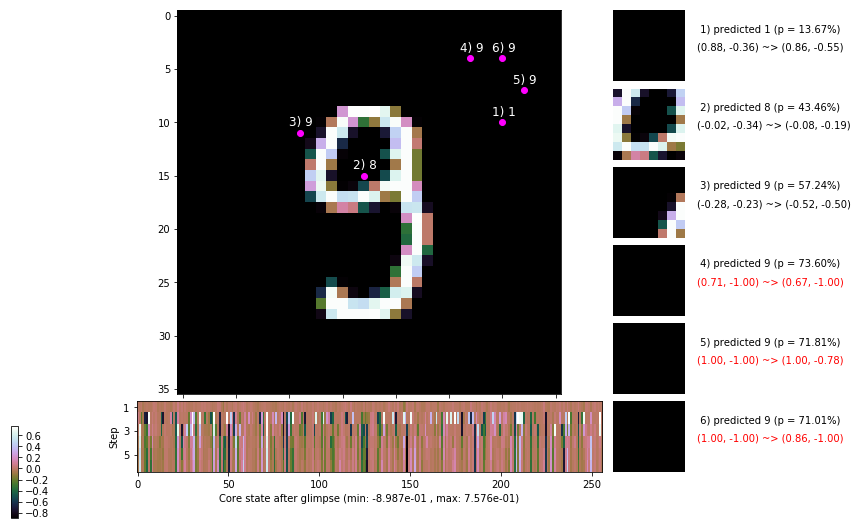

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.556, 1.112, 0.225, 0.650, 1.500, 1.000]


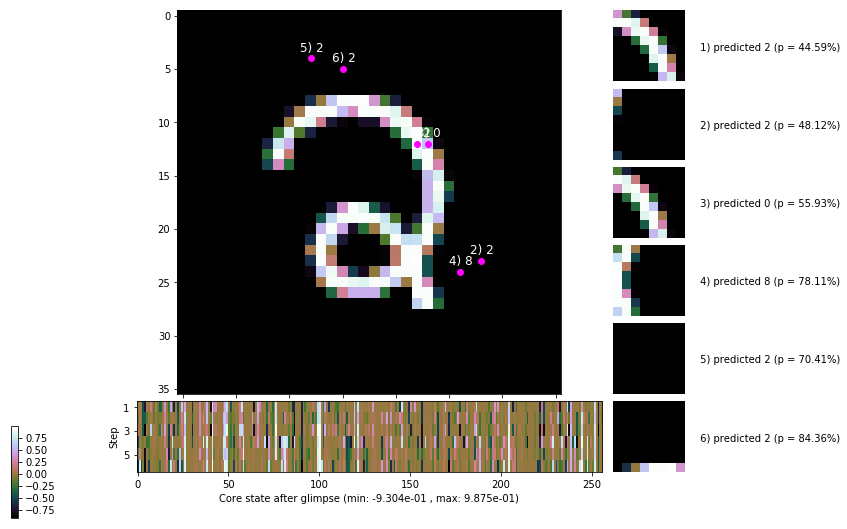


	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


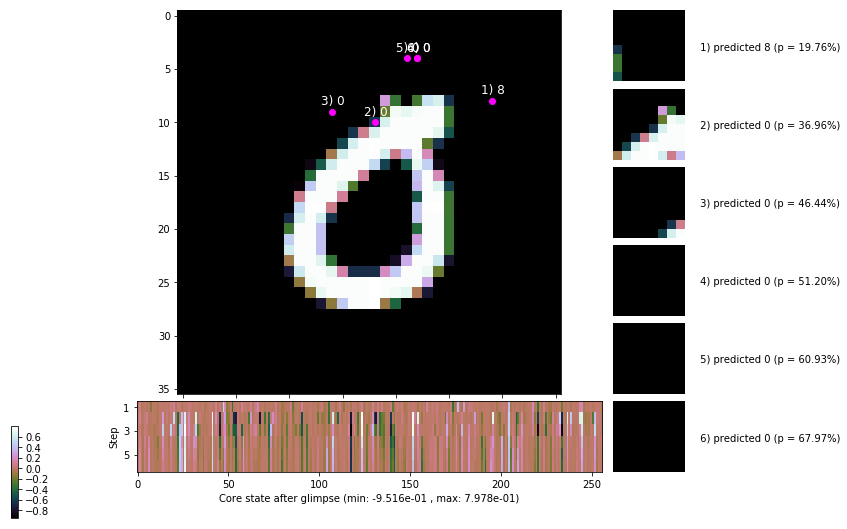

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


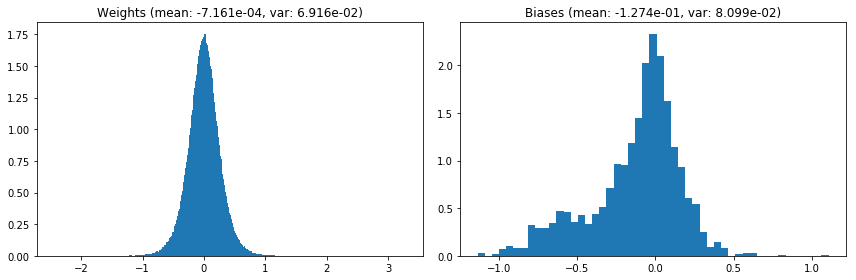

                                      Location network weights and biases


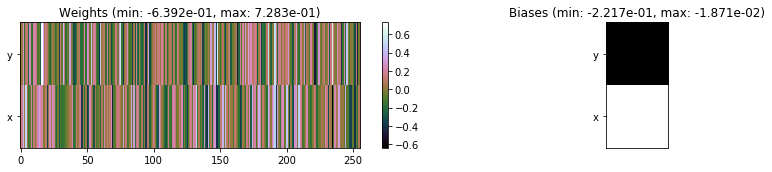

---------------------------------------------------------------------------------------------------------------
Elapsed time:  434.01 sec | TRAIN >> class loss: 0.4737 | steps:  2.379 :( | reward:  4.0782 :( | acc.: 84.227% :(
                          | VAL   >> class loss: 0.4672 | steps:  2.287 :( | reward:  4.2083    | acc.: 84.180% :(


Epoch  38/400) lr = 0.0005739
 b    300/  3000 >> 139.8 ms/b | lr: 5.73e-04 | grad 2norm: 11.72 | grad inf norm:  3.223
         Weights || abs max:  3.29 ( 4080.10) | mean: -7.24e-04 ( 0.02) | var: 6.92e-02 (  440.76)
          Biases || abs max:  1.14 (  110.16) | mean: -1.27e-01 ( 0.11) | var: 8.09e-02 (   35.53)
                    class loss: 0.486 | steps: 2.379 | reward:  4.056 | acc.: 83.37%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.3 ms/b | lr: 5.73e-04 | grad 2norm: 11.37 | grad inf norm:  3.115
         Weights || abs max:  3.30 ( 2804.93) | mean: -7.61e-04 (

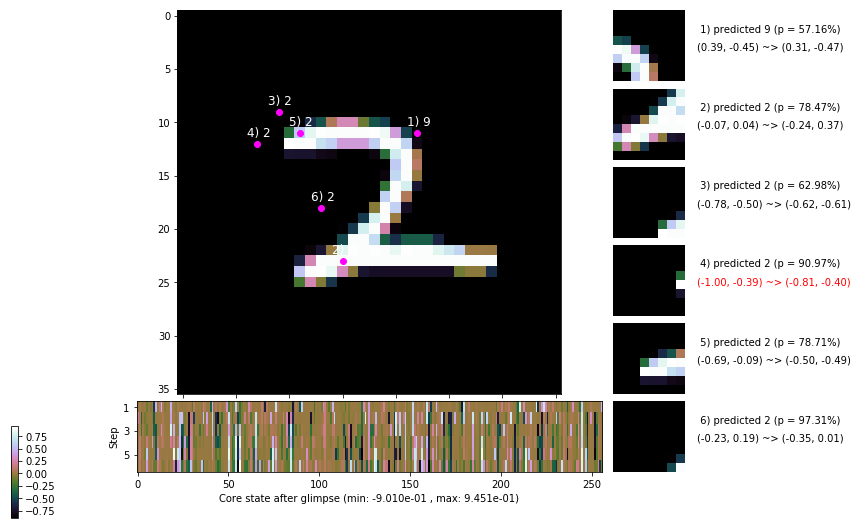

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 145.8 ms/b | lr: 5.72e-04 | grad 2norm: 11.70 | grad inf norm:  3.339
         Weights || abs max:  3.30 ( 6109.80) | mean: -7.74e-04 ( 0.02) | var: 6.94e-02 ( 5639.25)
          Biases || abs max:  1.15 (  349.26) | mean: -1.27e-01 ( 0.20) | var: 8.09e-02 ( 6353.72)
                    class loss: 0.492 | steps: 2.403 | reward:  4.049 | acc.: 83.37%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 144.2 ms/b | lr: 5.71e-04 | grad 2norm: 11.48 | grad inf norm:  3.320
         Weights || abs max:  3.30 ( 2814.27) | mean: -7.58e-04 ( 0.01) | var: 6.94e-02 (  206.39)
          Biases || abs max:  1.14 (  141.96) | mean: -1.27e-01 ( 0.13) | var: 8.11e-02 (   86.85)
                    class loss: 0.479 | steps: 2.413 | reward:  4.040 | acc.: 83.48%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.8

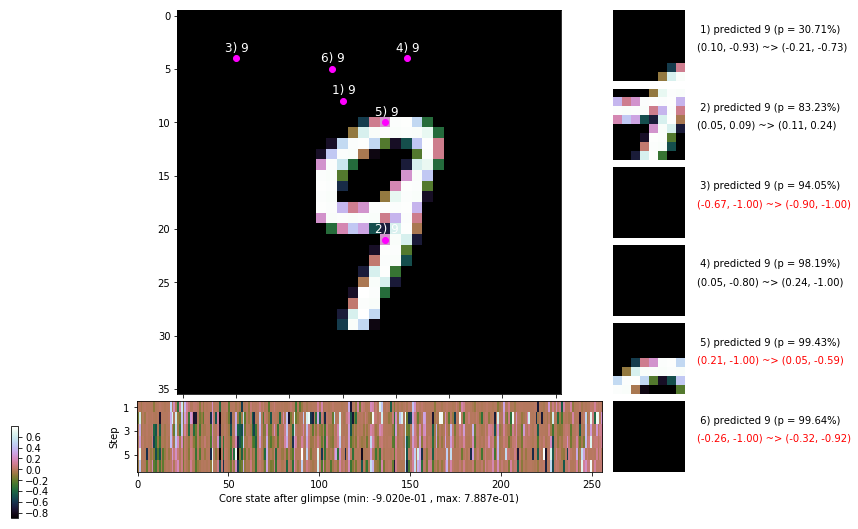

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 146.5 ms/b | lr: 5.70e-04 | grad 2norm: 11.59 | grad inf norm:  3.242
         Weights || abs max:  3.32 ( 4229.29) | mean: -7.35e-04 ( 0.02) | var: 6.95e-02 ( 1428.03)
          Biases || abs max:  1.14 (  155.15) | mean: -1.28e-01 ( 0.12) | var: 8.13e-02 (  288.19)
                    class loss: 0.483 | steps: 2.415 | reward:  4.043 | acc.: 83.53%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.4 ms/b | lr: 5.69e-04 | grad 2norm: 11.70 | grad inf norm:  3.334
         Weights || abs max:  3.31 ( 4339.91) | mean: -7.10e-04 ( 0.02) | var: 6.96e-02 (  628.46)
          Biases || abs max:  1.15 (   83.84) | mean: -1.28e-01 ( 0.09) | var: 8.15e-02 (   22.19)
                    class loss: 0.516 | steps: 2.432 | reward:  3.997 | acc.: 82.78%

	Target class: 6 | Discounted rewards: [0.869, 1.938, 1.8

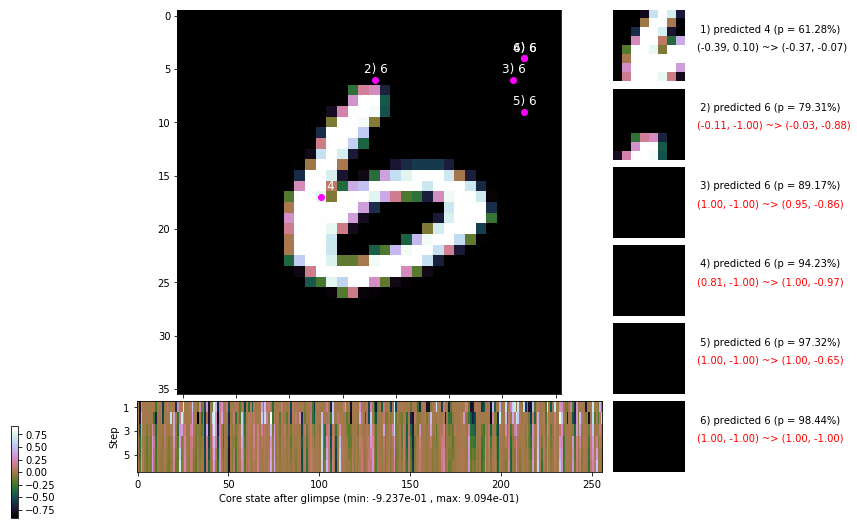

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.8 ms/b | lr: 5.68e-04 | grad 2norm: 11.45 | grad inf norm:  3.262
         Weights || abs max:  3.31 ( 2626.50) | mean: -7.00e-04 ( 0.01) | var: 6.96e-02 (   98.22)
          Biases || abs max:  1.15 (  152.72) | mean: -1.28e-01 ( 0.14) | var: 8.17e-02 (  426.71)
                    class loss: 0.490 | steps: 2.410 | reward:  4.026 | acc.: 83.28%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 144.9 ms/b | lr: 5.68e-04 | grad 2norm: 11.52 | grad inf norm:  3.196
         Weights || abs max:  3.31 ( 3154.67) | mean: -7.16e-04 ( 0.01) | var: 6.97e-02 (  327.41)
          Biases || abs max:  1.15 (  161.84) | mean: -1.28e-01 ( 0.13) | var: 8.18e-02 (  300.76)
                    class loss: 0.503 | steps: 2.395 | reward:  4.021 | acc.: 83.13%

	Target class: 5 | Discounted rewards: [1.900, 1.800, 1.6

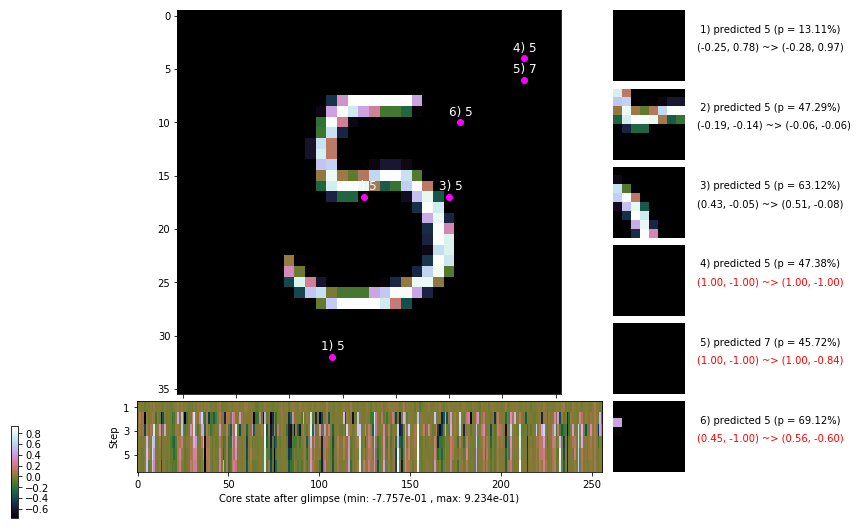

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 144.2 ms/b | lr: 5.66e-04 | grad 2norm: 11.51 | grad inf norm:  3.216
         Weights || abs max:  3.30 ( 3760.05) | mean: -7.30e-04 ( 0.01) | var: 6.98e-02 ( 1057.38)
          Biases || abs max:  1.14 (  152.93) | mean: -1.28e-01 ( 0.13) | var: 8.19e-02 (  394.78)
                    class loss: 0.488 | steps: 2.400 | reward:  4.046 | acc.: 83.48%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 138.9 ms/b | lr: 5.66e-04 | grad 2norm: 11.52 | grad inf norm:  3.273
         Weights || abs max:  3.32 ( 3949.49) | mean: -7.30e-04 ( 0.02) | var: 6.99e-02 (  631.04)
          Biases || abs max:  1.15 (  118.08) | mean: -1.28e-01 ( 0.12) | var: 8.19e-02 (   41.90)
                    class loss: 0.496 | steps: 2.391 | reward:  4.065 | acc.: 83.38%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.8

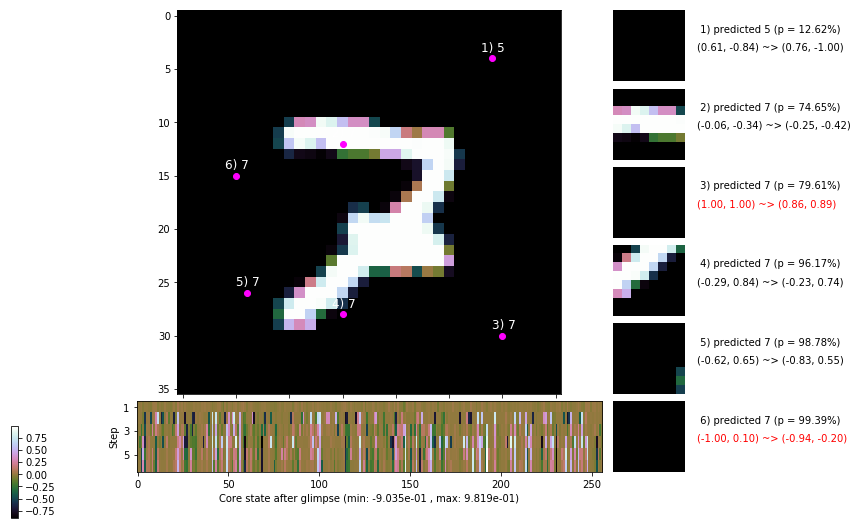

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


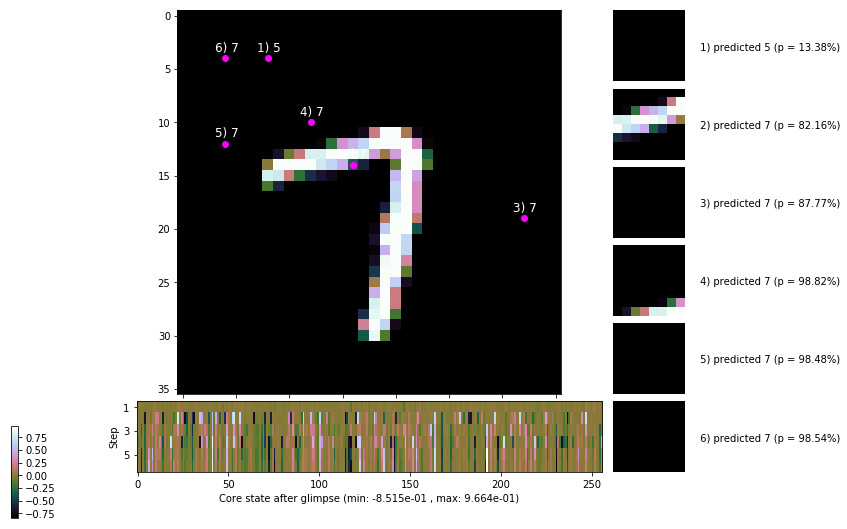


	Target class: 2 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


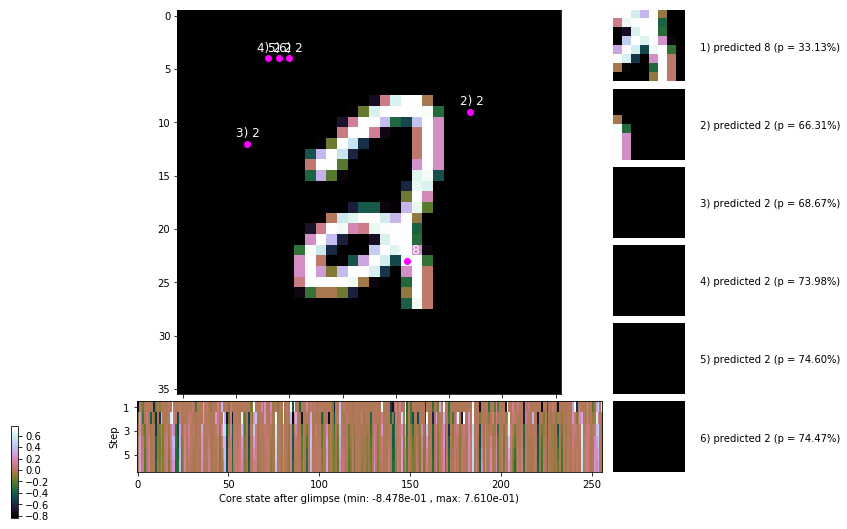

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


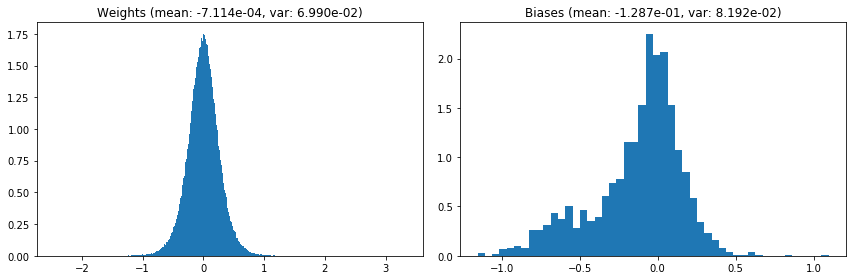

                                      Location network weights and biases


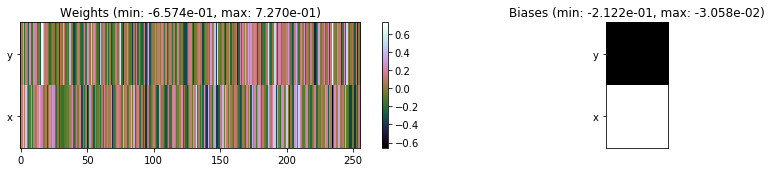

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.19 sec | TRAIN >> class loss: 0.4894 | steps:  2.402 :( | reward:  4.0441 :( | acc.: 83.432% :(
                          | VAL   >> class loss: 0.4634 | steps:  2.282 :( | reward:  4.1727 :( | acc.: 83.800% :(


Epoch  39/400) lr = 0.0005654
 b    300/  3000 >> 137.8 ms/b | lr: 5.65e-04 | grad 2norm: 11.41 | grad inf norm:  3.238
         Weights || abs max:  3.31 ( 2761.15) | mean: -7.11e-04 ( 0.01) | var: 6.99e-02 (  305.83)
          Biases || abs max:  1.15 (  131.05) | mean: -1.28e-01 ( 0.11) | var: 8.19e-02 (  346.34)
                    class loss: 0.484 | steps: 2.387 | reward:  4.076 | acc.: 84.12%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 139.4 ms/b | lr: 5.64e-04 | grad 2norm: 11.44 | grad inf norm:  3.173
         Weights || abs max:  3.32 ( 2778.28) | mean: -7.38e-04 (

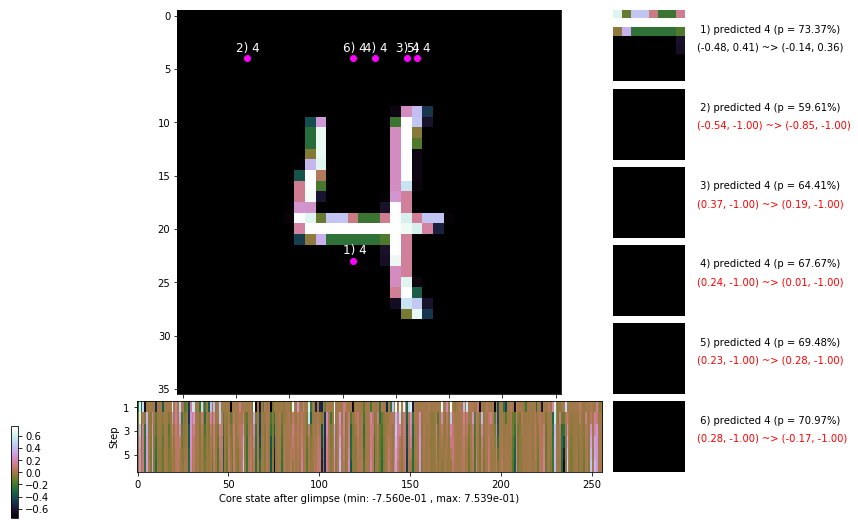

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 140.7 ms/b | lr: 5.63e-04 | grad 2norm: 12.02 | grad inf norm:  3.473
         Weights || abs max:  3.34 (32197.18) | mean: -7.74e-04 ( 0.07) | var: 7.01e-02 (386339.28)
          Biases || abs max:  1.16 (  356.08) | mean: -1.28e-01 ( 0.21) | var: 8.21e-02 ( 4849.70)
                    class loss: 0.515 | steps: 2.409 | reward:  4.012 | acc.: 82.32%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 138.9 ms/b | lr: 5.63e-04 | grad 2norm: 11.47 | grad inf norm:  3.306
         Weights || abs max:  3.36 ( 4465.93) | mean: -7.86e-04 ( 0.02) | var: 7.02e-02 ( 1580.13)
          Biases || abs max:  1.16 (  195.61) | mean: -1.28e-01 ( 0.14) | var: 8.22e-02 ( 1011.47)
                    class loss: 0.491 | steps: 2.412 | reward:  4.045 | acc.: 83.52%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.

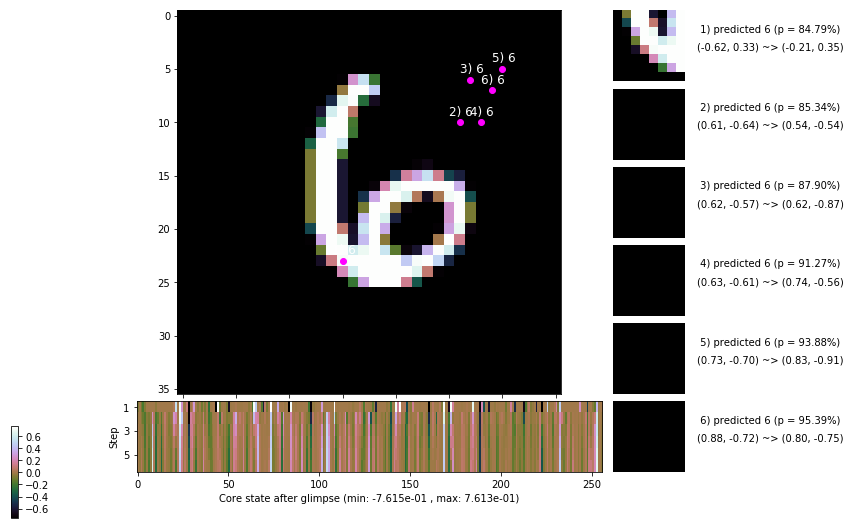

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.2 ms/b | lr: 5.61e-04 | grad 2norm: 11.44 | grad inf norm:  3.181
         Weights || abs max:  3.39 ( 2941.77) | mean: -7.72e-04 ( 0.01) | var: 7.03e-02 (  245.97)
          Biases || abs max:  1.16 (  145.84) | mean: -1.28e-01 ( 0.11) | var: 8.22e-02 (  412.05)
                    class loss: 0.471 | steps: 2.356 | reward:  4.105 | acc.: 83.83%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.5 ms/b | lr: 5.61e-04 | grad 2norm: 11.71 | grad inf norm:  3.418
         Weights || abs max:  3.38 ( 3195.76) | mean: -7.67e-04 ( 0.01) | var: 7.03e-02 (  428.16)
          Biases || abs max:  1.16 (  225.43) | mean: -1.28e-01 ( 0.16) | var: 8.22e-02 ( 1428.39)
                    class loss: 0.512 | steps: 2.421 | reward:  4.029 | acc.: 82.80%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

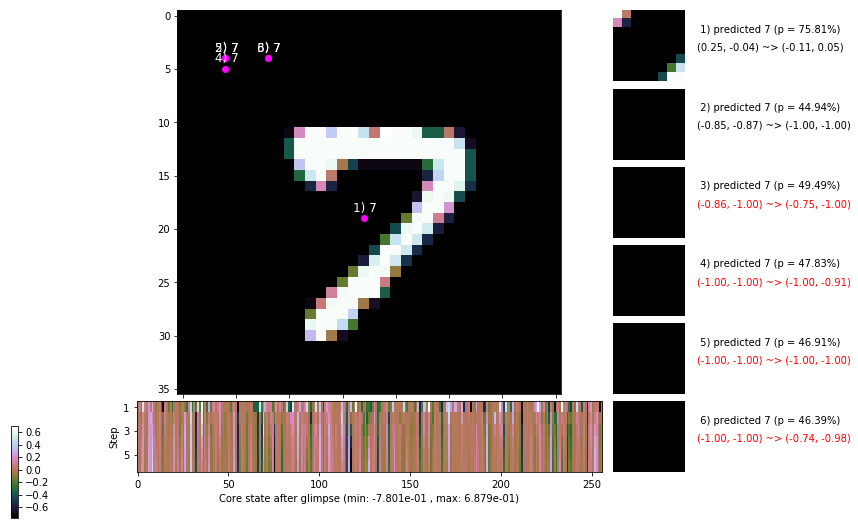

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.4 ms/b | lr: 5.60e-04 | grad 2norm: 11.33 | grad inf norm:  3.126
         Weights || abs max:  3.39 ( 2812.24) | mean: -7.66e-04 ( 0.01) | var: 7.04e-02 (  132.59)
          Biases || abs max:  1.16 (  117.70) | mean: -1.28e-01 ( 0.11) | var: 8.25e-02 (  111.74)
                    class loss: 0.501 | steps: 2.394 | reward:  4.059 | acc.: 83.73%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.0 ms/b | lr: 5.59e-04 | grad 2norm: 11.77 | grad inf norm:  3.379
         Weights || abs max:  3.41 ( 3033.51) | mean: -7.43e-04 ( 0.01) | var: 7.05e-02 (  228.26)
          Biases || abs max:  1.18 ( 1133.63) | mean: -1.28e-01 ( 0.83) | var: 8.24e-02 (159331.48)
                    class loss: 0.508 | steps: 2.423 | reward:  4.016 | acc.: 82.87%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.

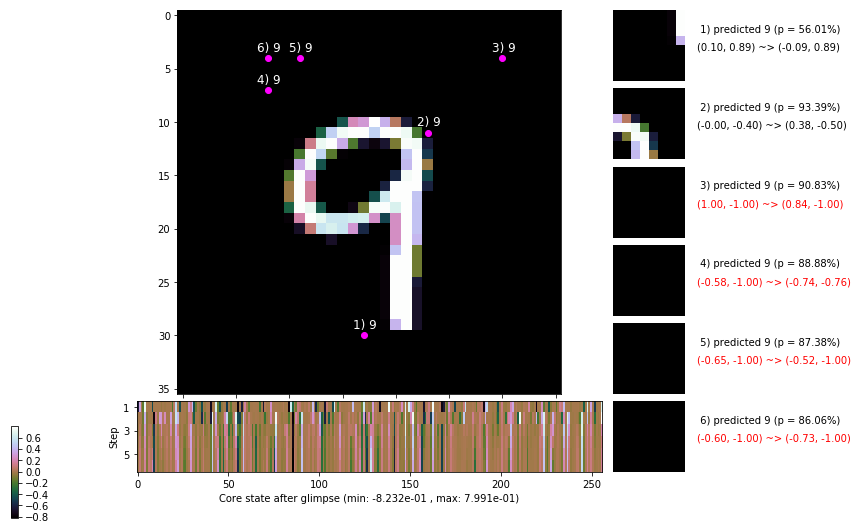

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 149.3 ms/b | lr: 5.58e-04 | grad 2norm: 11.47 | grad inf norm:  3.294
         Weights || abs max:  3.41 ( 3274.22) | mean: -7.53e-04 ( 0.01) | var: 7.05e-02 (  227.16)
          Biases || abs max:  1.18 (  156.82) | mean: -1.28e-01 ( 0.12) | var: 8.25e-02 (  125.47)
                    class loss: 0.506 | steps: 2.372 | reward:  4.073 | acc.: 83.58%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 145.0 ms/b | lr: 5.58e-04 | grad 2norm: 11.62 | grad inf norm:  3.297
         Weights || abs max:  3.41 ( 6369.96) | mean: -7.68e-04 ( 0.02) | var: 7.06e-02 ( 4344.31)
          Biases || abs max:  1.17 (  128.68) | mean: -1.28e-01 ( 0.11) | var: 8.26e-02 (  110.07)
                    class loss: 0.543 | steps: 2.414 | reward:  3.982 | acc.: 81.67%

	Target class: 1 | Discounted rewards: [0.869, 1.938, 1.8

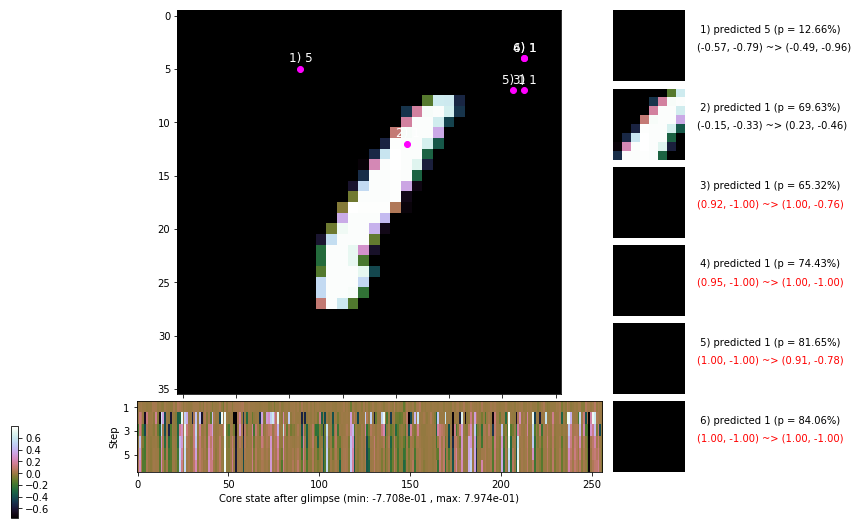

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


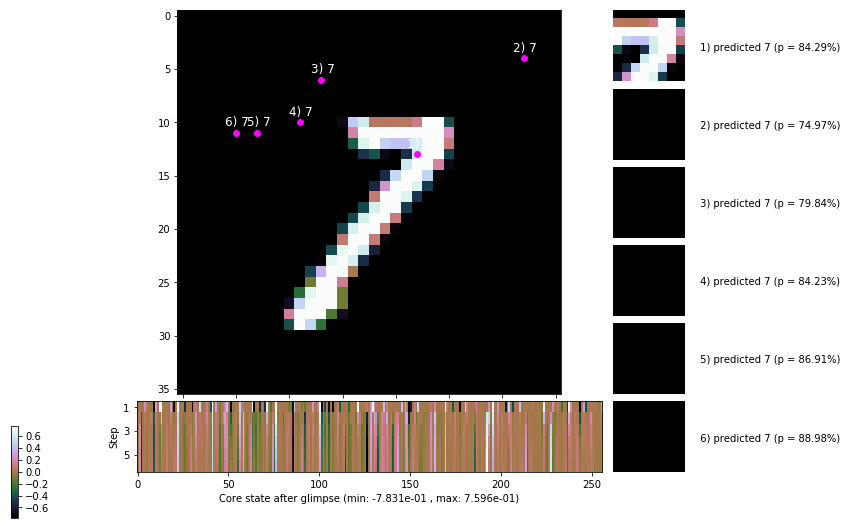


	Target class: 0 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


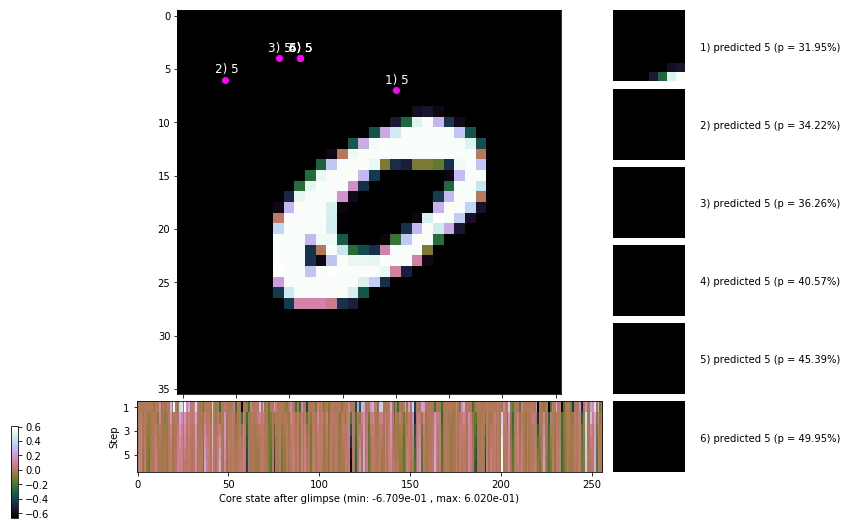

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


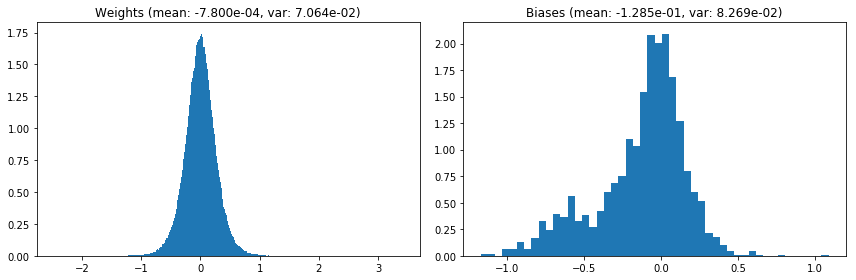

                                      Location network weights and biases


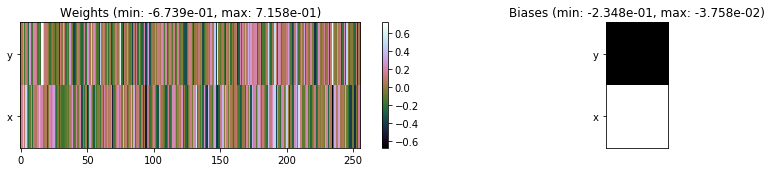

---------------------------------------------------------------------------------------------------------------
Elapsed time:  427.38 sec | TRAIN >> class loss: 0.5028 | steps:  2.398 :( | reward:  4.0433 :( | acc.: 83.148% :(
                          | VAL   >> class loss: 0.5115 | steps:  2.315 :( | reward:  4.1318 :( | acc.: 82.280% :(


Epoch  40/400) lr = 0.0005569
 b    300/  3000 >> 146.8 ms/b | lr: 5.56e-04 | grad 2norm: 11.60 | grad inf norm:  3.317
         Weights || abs max:  3.41 ( 4542.92) | mean: -7.73e-04 ( 0.02) | var: 7.07e-02 (  727.89)
          Biases || abs max:  1.18 (  129.46) | mean: -1.29e-01 ( 0.12) | var: 8.27e-02 (  100.34)
                    class loss: 0.522 | steps: 2.420 | reward:  4.012 | acc.: 82.10%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.4 ms/b | lr: 5.56e-04 | grad 2norm: 11.54 | grad inf norm:  3.274
         Weights || abs max:  3.41 (11978.26) | mean: -7.49e-04 (

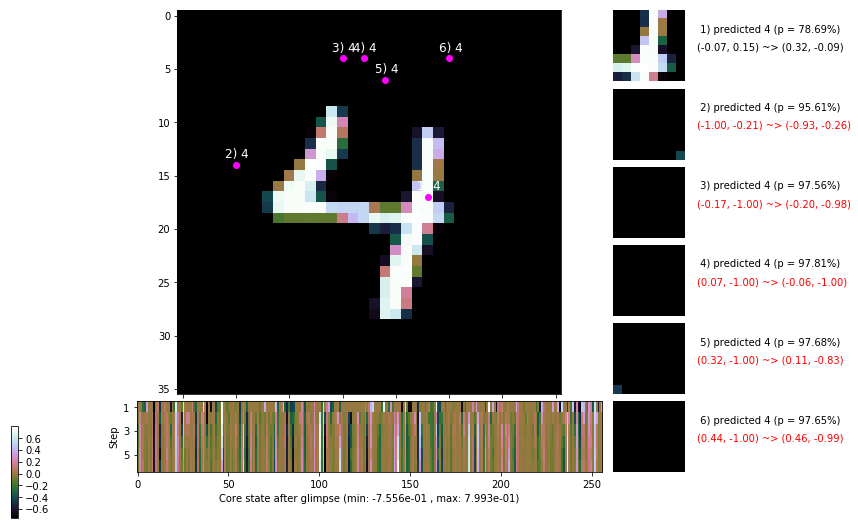

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.9 ms/b | lr: 5.55e-04 | grad 2norm: 11.42 | grad inf norm:  3.173
         Weights || abs max:  3.40 ( 3333.98) | mean: -7.22e-04 ( 0.01) | var: 7.08e-02 (  305.66)
          Biases || abs max:  1.19 (  344.75) | mean: -1.28e-01 ( 0.19) | var: 8.28e-02 ( 8381.02)
                    class loss: 0.498 | steps: 2.392 | reward:  4.058 | acc.: 83.28%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.8 ms/b | lr: 5.54e-04 | grad 2norm: 11.63 | grad inf norm:  3.332
         Weights || abs max:  3.41 ( 3726.52) | mean: -7.28e-04 ( 0.02) | var: 7.09e-02 (  529.11)
          Biases || abs max:  1.20 (  101.71) | mean: -1.28e-01 ( 0.10) | var: 8.28e-02 (   80.52)
                    class loss: 0.515 | steps: 2.425 | reward:  4.020 | acc.: 82.65%

	Target class: 9 | Discounted rewards: [0.044, 0.287, 0.7

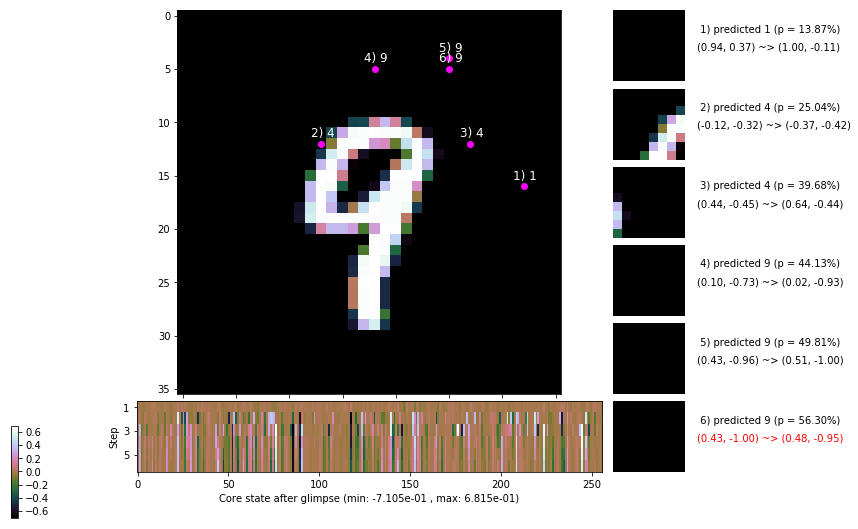

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.7 ms/b | lr: 5.53e-04 | grad 2norm: 11.67 | grad inf norm:  3.320
         Weights || abs max:  3.42 ( 2753.86) | mean: -7.04e-04 ( 0.01) | var: 7.10e-02 (  199.34)
          Biases || abs max:  1.20 (  109.70) | mean: -1.29e-01 ( 0.10) | var: 8.32e-02 (   62.86)
                    class loss: 0.511 | steps: 2.395 | reward:  4.050 | acc.: 82.42%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.5 ms/b | lr: 5.53e-04 | grad 2norm: 11.57 | grad inf norm:  3.300
         Weights || abs max:  3.42 ( 2642.62) | mean: -7.07e-04 ( 0.01) | var: 7.10e-02 (  217.26)
          Biases || abs max:  1.20 (  231.56) | mean: -1.29e-01 ( 0.16) | var: 8.33e-02 ( 1198.66)
                    class loss: 0.518 | steps: 2.418 | reward:  4.001 | acc.: 82.17%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.8

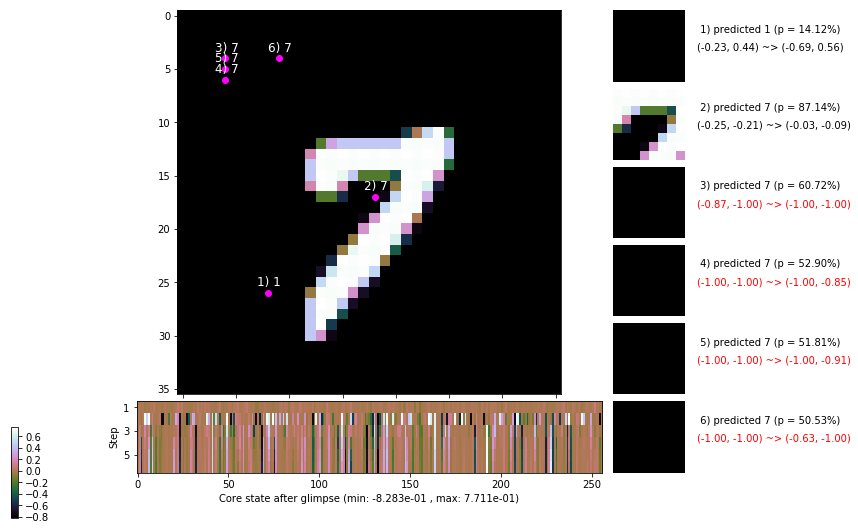

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 141.4 ms/b | lr: 5.51e-04 | grad 2norm: 11.73 | grad inf norm:  3.345
         Weights || abs max:  3.42 ( 3923.57) | mean: -7.32e-04 ( 0.02) | var: 7.11e-02 (  565.55)
          Biases || abs max:  1.21 (  195.25) | mean: -1.29e-01 ( 0.14) | var: 8.34e-02 (  693.95)
                    class loss: 0.531 | steps: 2.414 | reward:  4.016 | acc.: 81.88%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.6 ms/b | lr: 5.51e-04 | grad 2norm: 11.56 | grad inf norm:  3.383
         Weights || abs max:  3.42 ( 3409.76) | mean: -7.36e-04 ( 0.01) | var: 7.12e-02 (  915.88)
          Biases || abs max:  1.21 (  183.00) | mean: -1.29e-01 ( 0.15) | var: 8.35e-02 (  270.89)
                    class loss: 0.522 | steps: 2.393 | reward:  4.041 | acc.: 82.77%

	Target class: 8 | Discounted rewards: [0.319, 0.837, 1.8

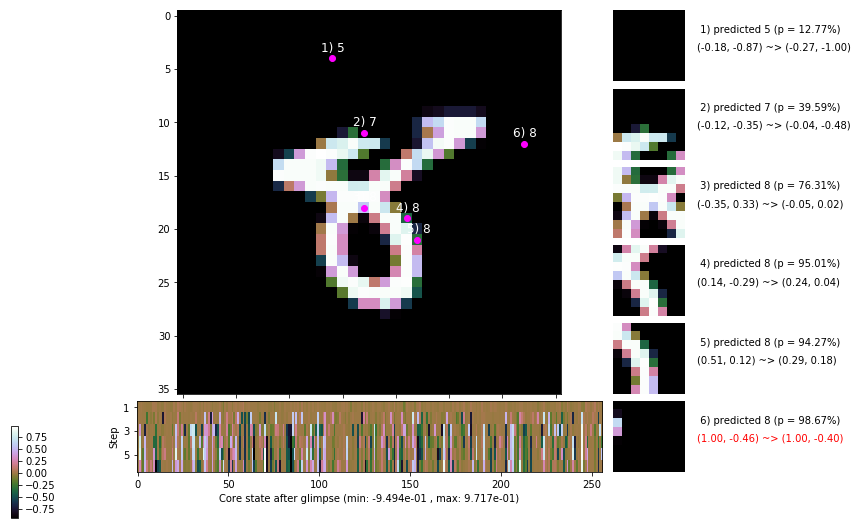

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.8 ms/b | lr: 5.50e-04 | grad 2norm: 11.20 | grad inf norm:  3.155
         Weights || abs max:  3.42 ( 2845.55) | mean: -7.36e-04 ( 0.01) | var: 7.12e-02 (  181.06)
          Biases || abs max:  1.20 (  249.94) | mean: -1.29e-01 ( 0.17) | var: 8.36e-02 ( 1073.23)
                    class loss: 0.492 | steps: 2.390 | reward:  4.062 | acc.: 83.32%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.7 ms/b | lr: 5.49e-04 | grad 2norm: 11.27 | grad inf norm:  3.155
         Weights || abs max:  3.43 ( 3233.95) | mean: -7.35e-04 ( 0.02) | var: 7.13e-02 (  231.95)
          Biases || abs max:  1.19 (  132.33) | mean: -1.29e-01 ( 0.12) | var: 8.37e-02 (  243.69)
                    class loss: 0.518 | steps: 2.414 | reward:  4.017 | acc.: 82.60%

	Target class: 2 | Discounted rewards: [-0.197, -0.194, -

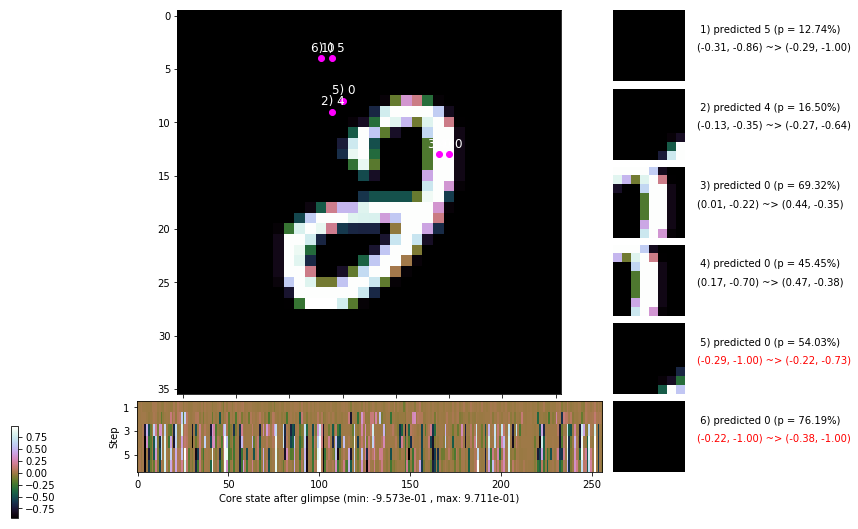

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


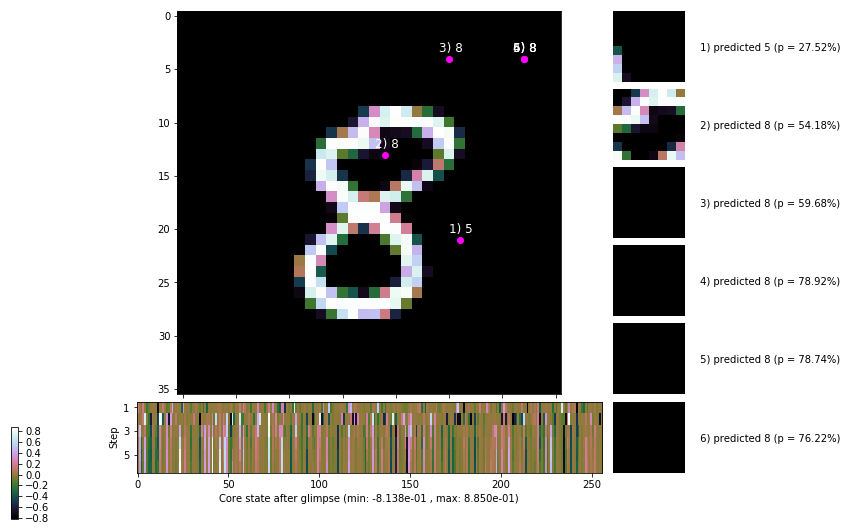


	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


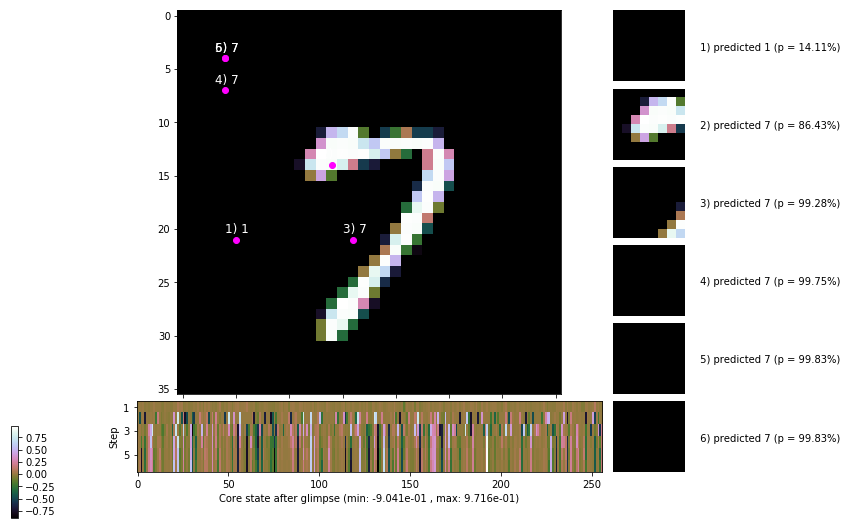

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


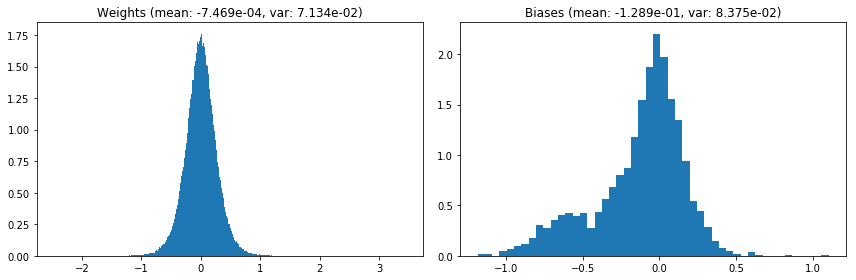

                                      Location network weights and biases


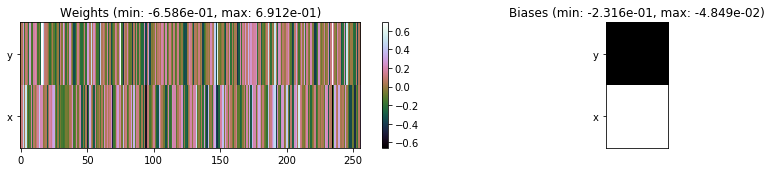

---------------------------------------------------------------------------------------------------------------
Elapsed time:  428.59 sec | TRAIN >> class loss: 0.5132 | steps:  2.403 :( | reward:  4.0346 :( | acc.: 82.643% :(
                          | VAL   >> class loss: 0.5258 | steps:  2.292 :( | reward:  4.1487 :( | acc.: 82.440% :(


Epoch  41/400) lr = 0.0005486
 b    300/  3000 >> 144.4 ms/b | lr: 5.48e-04 | grad 2norm: 11.32 | grad inf norm:  3.250
         Weights || abs max:  3.44 ( 2707.92) | mean: -7.36e-04 ( 0.01) | var: 7.14e-02 (  148.97)
          Biases || abs max:  1.18 (  278.56) | mean: -1.29e-01 ( 0.18) | var: 8.37e-02 ( 1227.46)
                    class loss: 0.514 | steps: 2.400 | reward:  4.025 | acc.: 82.28%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.5 ms/b | lr: 5.48e-04 | grad 2norm: 11.42 | grad inf norm:  3.291
         Weights || abs max:  3.44 ( 3712.07) | mean: -7.33e-04 (

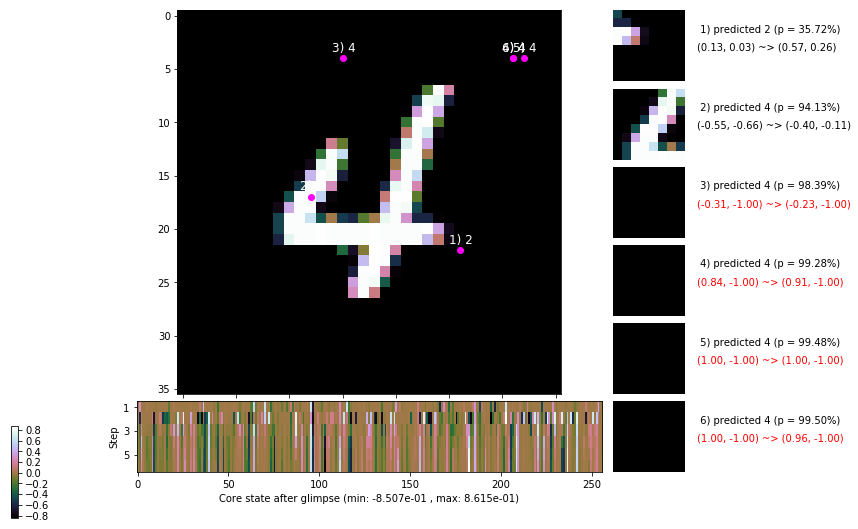

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 150.0 ms/b | lr: 5.46e-04 | grad 2norm: 11.71 | grad inf norm:  3.411
         Weights || abs max:  3.44 ( 2286.45) | mean: -7.41e-04 ( 0.01) | var: 7.15e-02 (  105.67)
          Biases || abs max:  1.18 (  161.00) | mean: -1.29e-01 ( 0.16) | var: 8.40e-02 ( 1298.40)
                    class loss: 0.545 | steps: 2.444 | reward:  3.978 | acc.: 81.85%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.3 ms/b | lr: 5.46e-04 | grad 2norm: 11.54 | grad inf norm:  3.406
         Weights || abs max:  3.44 ( 3623.10) | mean: -7.42e-04 ( 0.02) | var: 7.16e-02 (  275.84)
          Biases || abs max:  1.18 (  211.27) | mean: -1.29e-01 ( 0.17) | var: 8.41e-02 ( 1009.01)
                    class loss: 0.527 | steps: 2.426 | reward:  3.992 | acc.: 81.67%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

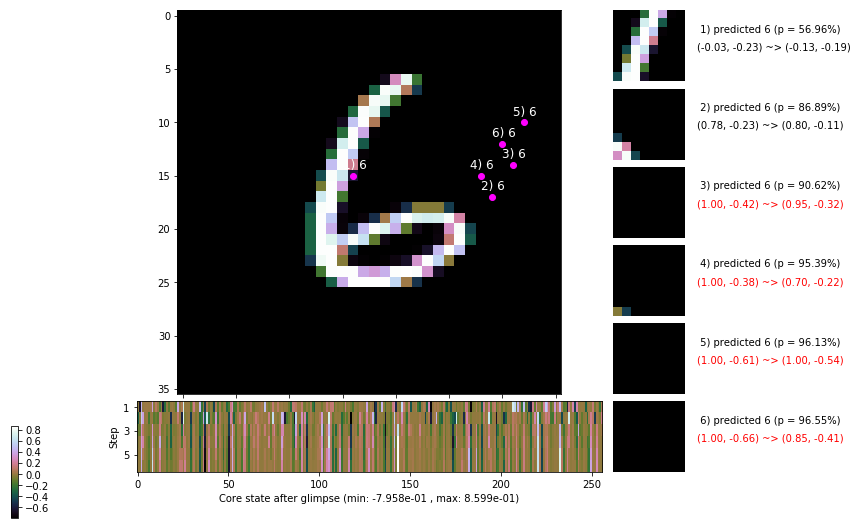

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 149.0 ms/b | lr: 5.45e-04 | grad 2norm: 11.68 | grad inf norm:  3.381
         Weights || abs max:  3.45 ( 6370.88) | mean: -7.24e-04 ( 0.02) | var: 7.16e-02 ( 7389.62)
          Biases || abs max:  1.19 ( 1027.82) | mean: -1.29e-01 ( 0.47) | var: 8.39e-02 (95196.39)
                    class loss: 0.534 | steps: 2.428 | reward:  3.983 | acc.: 81.65%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.1 ms/b | lr: 5.44e-04 | grad 2norm: 11.51 | grad inf norm:  3.454
         Weights || abs max:  3.46 ( 1818.91) | mean: -7.34e-04 ( 0.01) | var: 7.17e-02 (   44.71)
          Biases || abs max:  1.18 (  251.09) | mean: -1.29e-01 ( 0.19) | var: 8.37e-02 ( 1137.88)
                    class loss: 0.510 | steps: 2.384 | reward:  4.057 | acc.: 82.77%

	Target class: 0 | Discounted rewards: [-0.094, 0.012, 0.

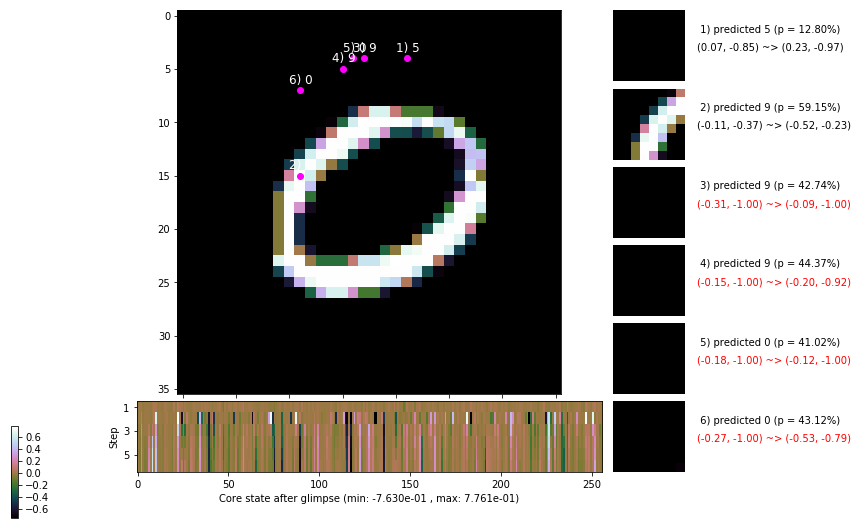

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.8 ms/b | lr: 5.43e-04 | grad 2norm: 11.78 | grad inf norm:  3.340
         Weights || abs max:  3.46 ( 4753.00) | mean: -7.44e-04 ( 0.02) | var: 7.18e-02 (  634.10)
          Biases || abs max:  1.18 (  307.90) | mean: -1.29e-01 ( 0.18) | var: 8.38e-02 ( 4642.79)
                    class loss: 0.520 | steps: 2.415 | reward:  4.015 | acc.: 82.42%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 138.6 ms/b | lr: 5.43e-04 | grad 2norm: 11.48 | grad inf norm:  3.406
         Weights || abs max:  3.47 ( 2535.60) | mean: -7.24e-04 ( 0.01) | var: 7.19e-02 (   84.29)
          Biases || abs max:  1.19 (  222.01) | mean: -1.29e-01 ( 0.18) | var: 8.39e-02 ( 1154.87)
                    class loss: 0.506 | steps: 2.407 | reward:  4.027 | acc.: 82.82%

	Target class: 9 | Discounted rewards: [-0.094, 0.012, 0.

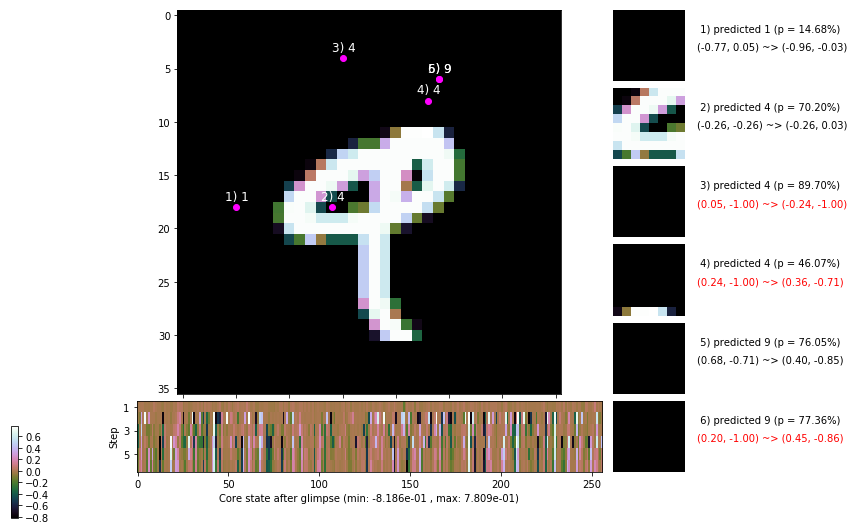

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.7 ms/b | lr: 5.42e-04 | grad 2norm: 11.60 | grad inf norm:  3.237
         Weights || abs max:  3.47 ( 6532.66) | mean: -7.18e-04 ( 0.02) | var: 7.19e-02 ( 6844.61)
          Biases || abs max:  1.19 (   57.40) | mean: -1.29e-01 ( 0.08) | var: 8.40e-02 (   14.22)
                    class loss: 0.507 | steps: 2.409 | reward:  4.028 | acc.: 82.92%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 139.5 ms/b | lr: 5.41e-04 | grad 2norm: 11.57 | grad inf norm:  3.444
         Weights || abs max:  3.46 ( 3317.14) | mean: -7.34e-04 ( 0.01) | var: 7.20e-02 (  246.46)
          Biases || abs max:  1.19 (  145.34) | mean: -1.29e-01 ( 0.14) | var: 8.42e-02 (   43.73)
                    class loss: 0.518 | steps: 2.398 | reward:  4.037 | acc.: 83.00%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.8

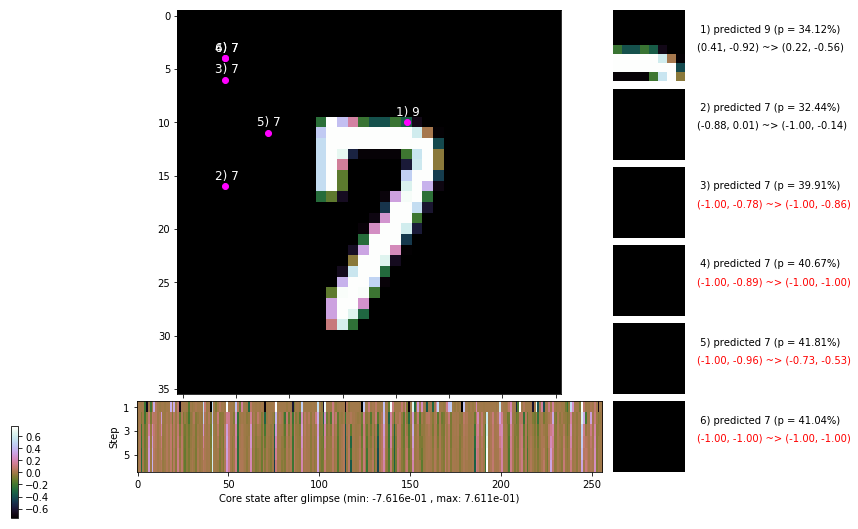

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.319, 0.837, 1.875, 1.750, 1.500, 1.000]


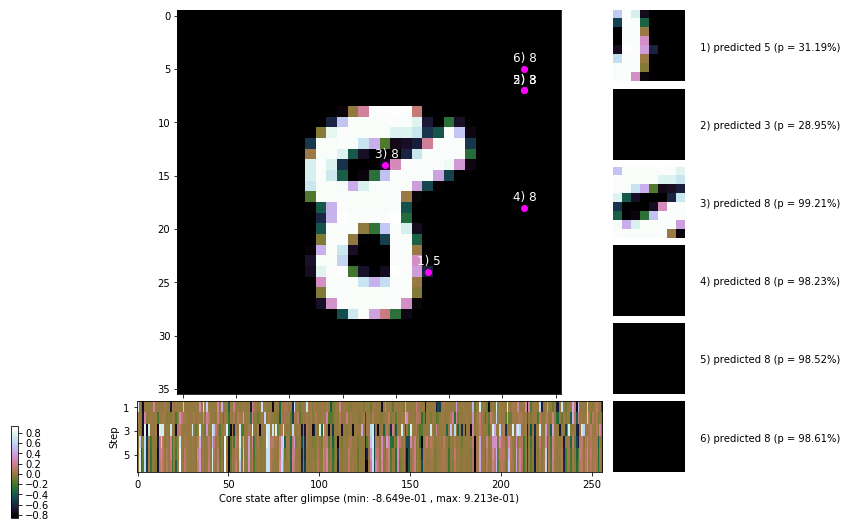


	Target class: 2 | Discounted rewards: [0.319, 0.837, 1.875, 1.750, 1.500, 1.000]


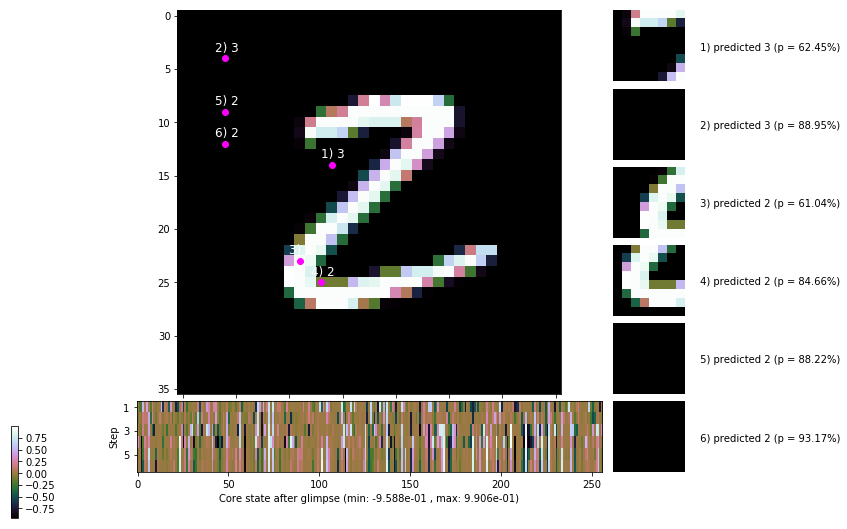

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


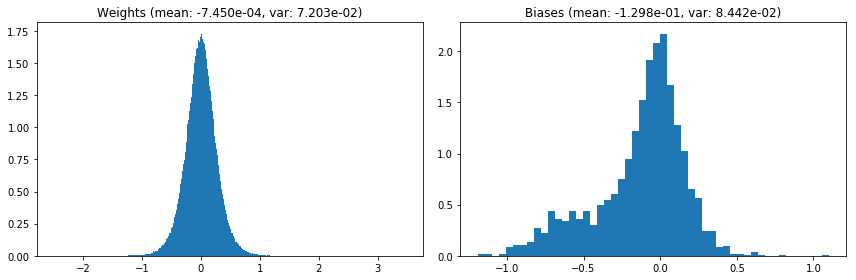

                                      Location network weights and biases


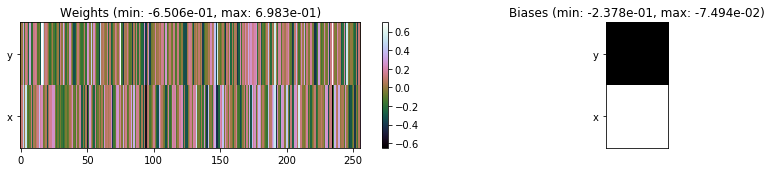

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.96 sec | TRAIN >> class loss: 0.5178 | steps:  2.409 :( | reward:  4.0221 :( | acc.: 82.455% :(
                          | VAL   >> class loss: 0.5486 | steps:  2.360 :( | reward:  4.0378 :( | acc.: 80.660% :(


Epoch  42/400) lr = 0.0005405
 b    300/  3000 >> 139.0 ms/b | lr: 5.40e-04 | grad 2norm: 11.48 | grad inf norm:  3.314
         Weights || abs max:  3.47 ( 2612.85) | mean: -7.52e-04 ( 0.01) | var: 7.21e-02 (  302.50)
          Biases || abs max:  1.19 (  130.83) | mean: -1.30e-01 ( 0.12) | var: 8.44e-02 (  119.11)
                    class loss: 0.529 | steps: 2.426 | reward:  4.015 | acc.: 82.87%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 138.9 ms/b | lr: 5.39e-04 | grad 2norm: 11.29 | grad inf norm:  3.380
         Weights || abs max:  3.47 (10641.31) | mean: -7.52e-04 (

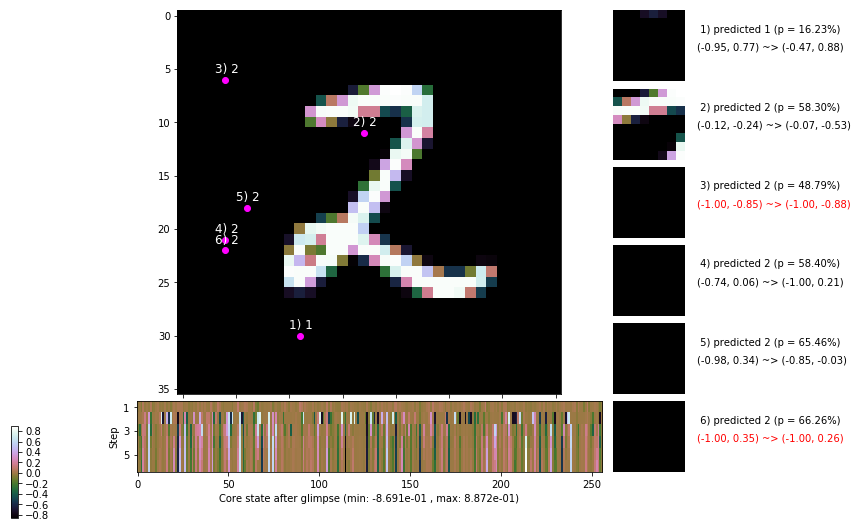

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.7 ms/b | lr: 5.38e-04 | grad 2norm: 11.25 | grad inf norm:  3.392
         Weights || abs max:  3.47 ( 3659.59) | mean: -7.65e-04 ( 0.02) | var: 7.22e-02 (  373.18)
          Biases || abs max:  1.21 (  203.14) | mean: -1.30e-01 ( 0.14) | var: 8.45e-02 (  598.23)
                    class loss: 0.519 | steps: 2.417 | reward:  4.029 | acc.: 82.88%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 145.6 ms/b | lr: 5.38e-04 | grad 2norm: 11.24 | grad inf norm:  3.133
         Weights || abs max:  3.47 ( 3664.27) | mean: -7.56e-04 ( 0.02) | var: 7.22e-02 (  317.12)
          Biases || abs max:  1.20 (  186.44) | mean: -1.30e-01 ( 0.14) | var: 8.44e-02 ( 1129.79)
                    class loss: 0.501 | steps: 2.425 | reward:  4.026 | acc.: 83.15%

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.8

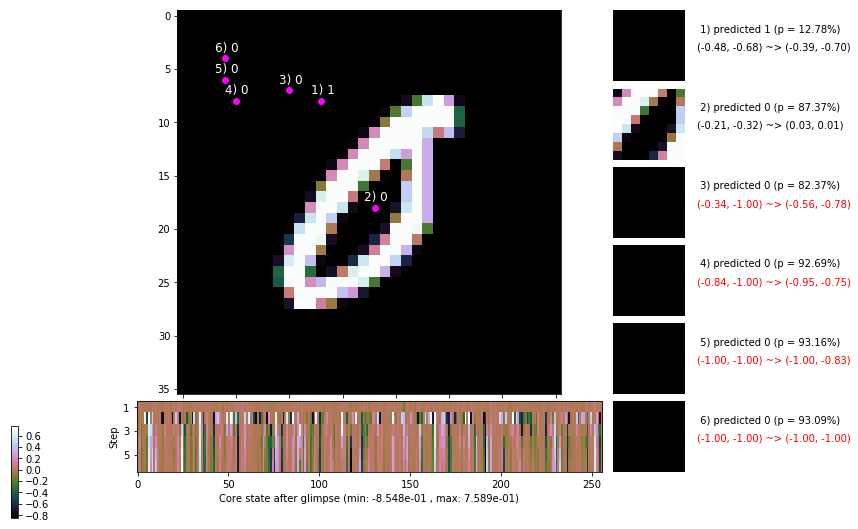

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 146.3 ms/b | lr: 5.37e-04 | grad 2norm: 11.69 | grad inf norm:  3.366
         Weights || abs max:  3.46 ( 3130.14) | mean: -7.56e-04 ( 0.01) | var: 7.23e-02 (  257.39)
          Biases || abs max:  1.20 (  132.90) | mean: -1.29e-01 ( 0.11) | var: 8.45e-02 (   66.15)
                    class loss: 0.528 | steps: 2.447 | reward:  3.978 | acc.: 81.95%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.2 ms/b | lr: 5.36e-04 | grad 2norm: 11.56 | grad inf norm:  3.322
         Weights || abs max:  3.48 (201690.36) | mean: -7.62e-04 ( 0.38) | var: 7.24e-02 (21674254.00)
          Biases || abs max:  1.21 (   94.35) | mean: -1.30e-01 ( 0.11) | var: 8.46e-02 (   50.50)
                    class loss: 0.533 | steps: 2.429 | reward:  4.008 | acc.: 82.27%

	Target class: 6 | Discounted rewards: [0.044, 0.287,

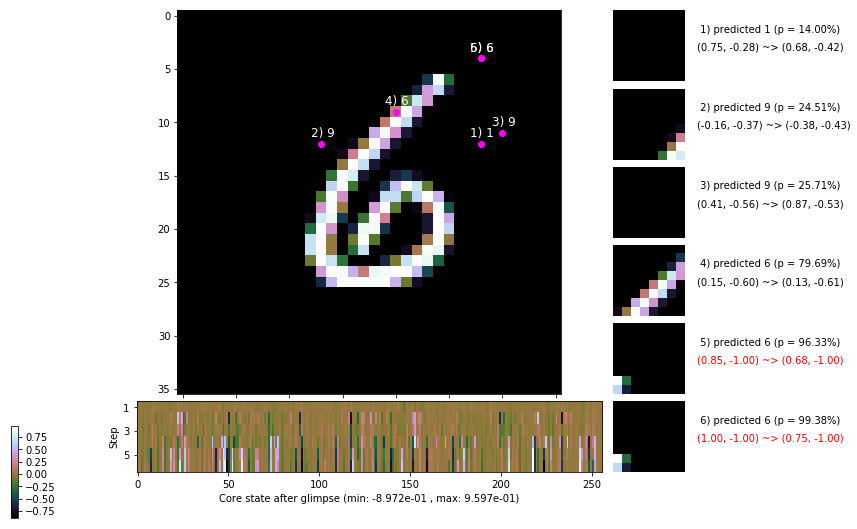

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 150.0 ms/b | lr: 5.35e-04 | grad 2norm: 11.54 | grad inf norm:  3.410
         Weights || abs max:  3.48 ( 8946.64) | mean: -7.55e-04 ( 0.02) | var: 7.24e-02 (20448.46)
          Biases || abs max:  1.20 (  360.19) | mean: -1.30e-01 ( 0.23) | var: 8.48e-02 ( 3793.86)
                    class loss: 0.513 | steps: 2.414 | reward:  4.028 | acc.: 82.70%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 146.5 ms/b | lr: 5.35e-04 | grad 2norm: 11.47 | grad inf norm:  3.197
         Weights || abs max:  3.48 ( 2644.06) | mean: -7.68e-04 ( 0.01) | var: 7.25e-02 (  149.65)
          Biases || abs max:  1.21 (  184.12) | mean: -1.30e-01 ( 0.14) | var: 8.49e-02 (  310.87)
                    class loss: 0.526 | steps: 2.395 | reward:  4.019 | acc.: 81.93%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

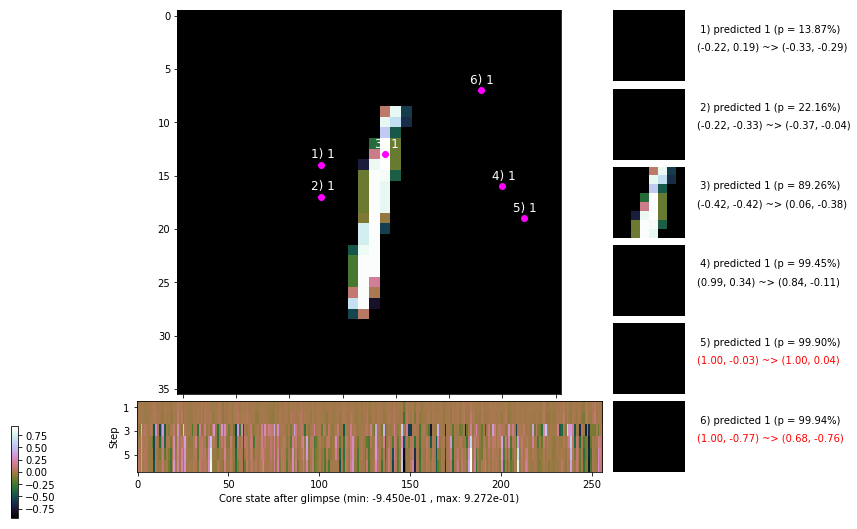

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 148.8 ms/b | lr: 5.33e-04 | grad 2norm: 11.44 | grad inf norm:  3.291
         Weights || abs max:  3.47 ( 6904.10) | mean: -7.75e-04 ( 0.02) | var: 7.26e-02 ( 6579.07)
          Biases || abs max:  1.20 ( 1494.87) | mean: -1.29e-01 ( 1.18) | var: 8.48e-02 (425632.53)
                    class loss: 0.502 | steps: 2.377 | reward:  4.076 | acc.: 83.30%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 145.2 ms/b | lr: 5.33e-04 | grad 2norm: 11.25 | grad inf norm:  3.294
         Weights || abs max:  3.48 ( 4326.37) | mean: -7.87e-04 ( 0.02) | var: 7.26e-02 ( 3536.43)
          Biases || abs max:  1.21 ( 2828.73) | mean: -1.29e-01 ( 1.17) | var: 8.48e-02 (845697.12)
                    class loss: 0.485 | steps: 2.361 | reward:  4.099 | acc.: 83.57%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1

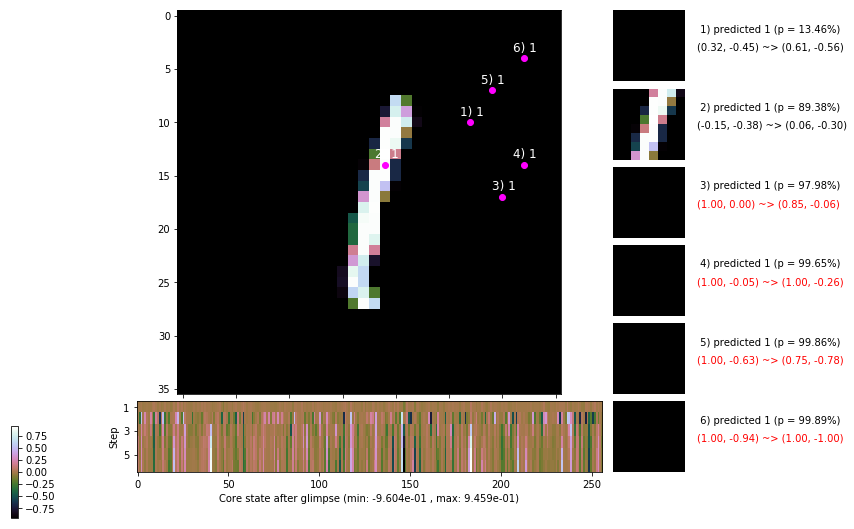

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


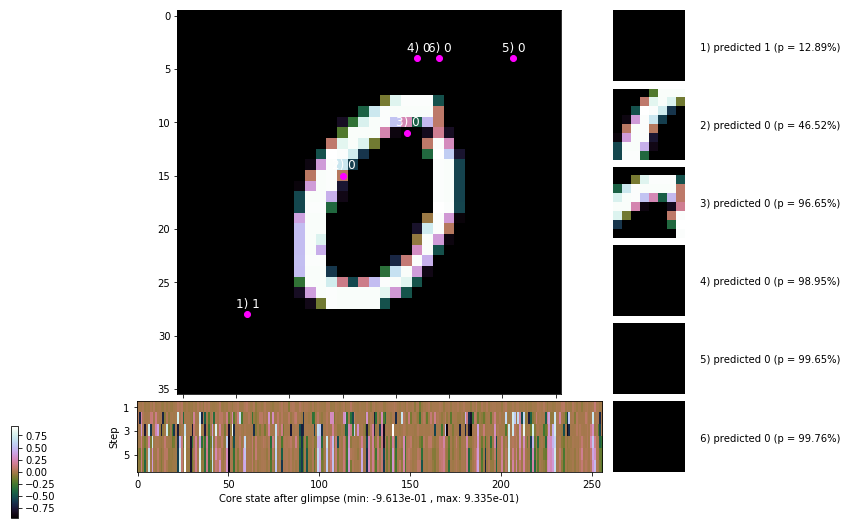


	Target class: 6 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


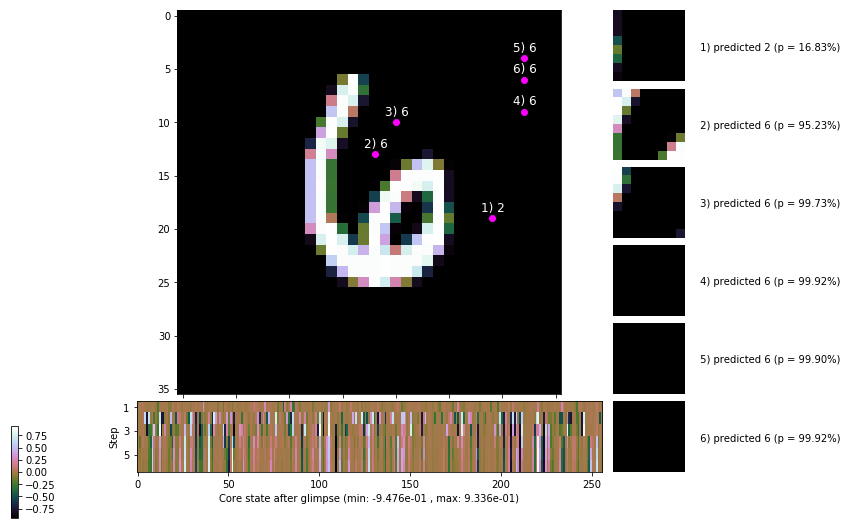

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


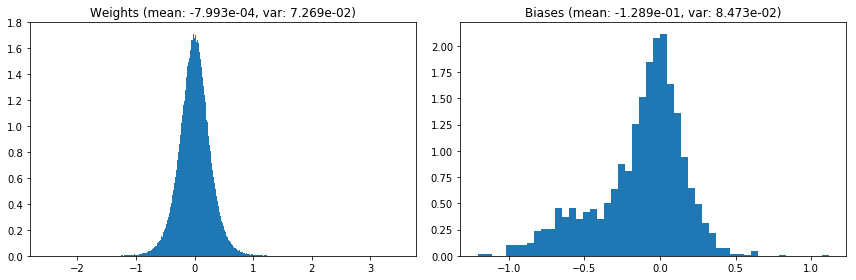

                                      Location network weights and biases


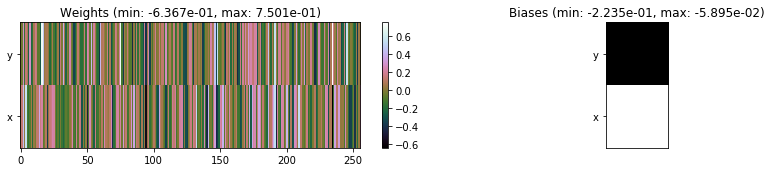

---------------------------------------------------------------------------------------------------------------
Elapsed time:  435.34 sec | TRAIN >> class loss: 0.5160 | steps:  2.412 :( | reward:  4.0275 :( | acc.: 82.715% :(
                          | VAL   >> class loss: 0.5174 | steps:  2.342 :( | reward:  4.1238 :( | acc.: 82.500% :(


Epoch  43/400) lr = 0.0005324
 b    300/  3000 >> 140.9 ms/b | lr: 5.32e-04 | grad 2norm: 11.44 | grad inf norm:  3.217
         Weights || abs max:  3.48 ( 2380.10) | mean: -8.11e-04 ( 0.01) | var: 7.27e-02 (  191.69)
          Biases || abs max:  1.21 (  200.88) | mean: -1.29e-01 ( 0.18) | var: 8.50e-02 (  614.61)
                    class loss: 0.513 | steps: 2.405 | reward:  4.039 | acc.: 82.67%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 140.0 ms/b | lr: 5.31e-04 | grad 2norm: 11.58 | grad inf norm:  3.258
         Weights || abs max:  3.46 ( 1832.97) | mean: -8.25e-04 (

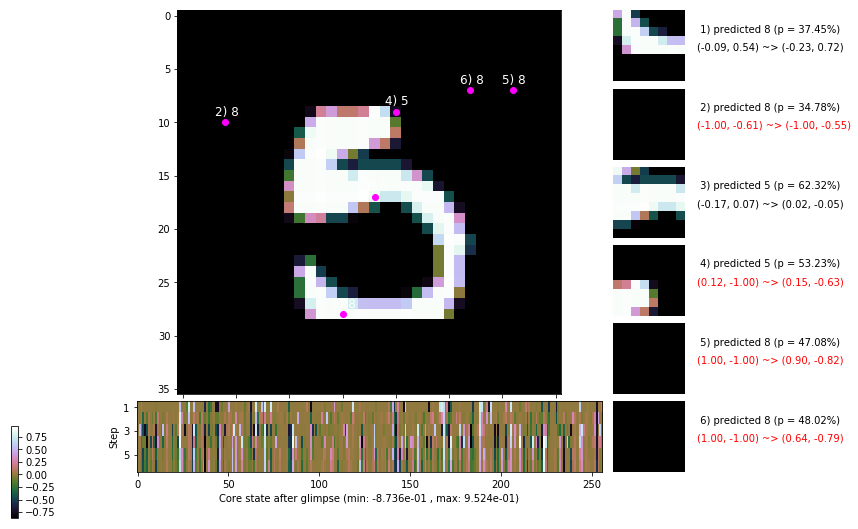

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.0 ms/b | lr: 5.30e-04 | grad 2norm: 11.19 | grad inf norm:  3.383
         Weights || abs max:  3.47 ( 5879.02) | mean: -8.59e-04 ( 0.02) | var: 7.28e-02 ( 2991.84)
          Biases || abs max:  1.21 (  171.99) | mean: -1.29e-01 ( 0.15) | var: 8.51e-02 (  118.58)
                    class loss: 0.497 | steps: 2.392 | reward:  4.050 | acc.: 82.98%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.2 ms/b | lr: 5.30e-04 | grad 2norm: 11.45 | grad inf norm:  3.462
         Weights || abs max:  3.47 ( 4228.70) | mean: -8.62e-04 ( 0.02) | var: 7.29e-02 ( 1260.15)
          Biases || abs max:  1.21 (  314.12) | mean: -1.29e-01 ( 0.23) | var: 8.51e-02 ( 1984.40)
                    class loss: 0.506 | steps: 2.410 | reward:  4.058 | acc.: 82.93%

	Target class: 5 | Discounted rewards: [1.728, 1.456, 0.9

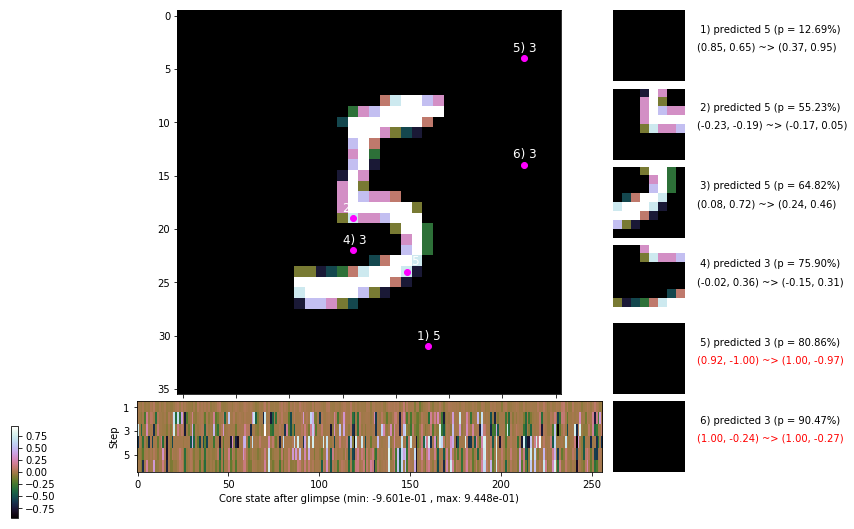

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 140.8 ms/b | lr: 5.29e-04 | grad 2norm: 11.31 | grad inf norm:  3.353
         Weights || abs max:  3.47 ( 1772.25) | mean: -8.55e-04 ( 0.01) | var: 7.30e-02 (   39.12)
          Biases || abs max:  1.21 (  151.19) | mean: -1.30e-01 ( 0.13) | var: 8.52e-02 (  170.42)
                    class loss: 0.499 | steps: 2.381 | reward:  4.082 | acc.: 83.42%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.1 ms/b | lr: 5.28e-04 | grad 2norm: 11.25 | grad inf norm:  3.187
         Weights || abs max:  3.48 ( 2932.48) | mean: -8.62e-04 ( 0.01) | var: 7.31e-02 (  323.10)
          Biases || abs max:  1.21 (  121.52) | mean: -1.29e-01 ( 0.12) | var: 8.51e-02 (   83.49)
                    class loss: 0.499 | steps: 2.408 | reward:  4.043 | acc.: 83.12%

	Target class: 8 | Discounted rewards: [0.869, 1.938, 1.8

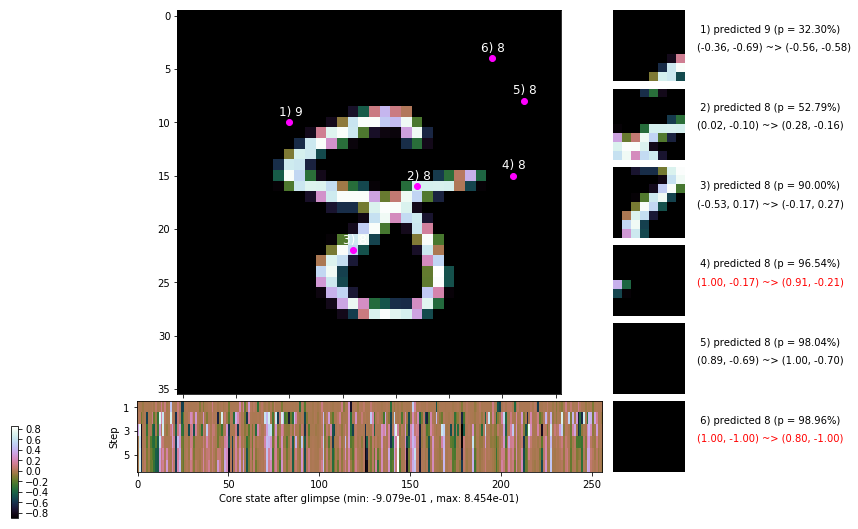

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 147.1 ms/b | lr: 5.27e-04 | grad 2norm: 11.23 | grad inf norm:  3.169
         Weights || abs max:  3.48 ( 2543.01) | mean: -8.74e-04 ( 0.01) | var: 7.31e-02 (  144.21)
          Biases || abs max:  1.22 (  216.49) | mean: -1.29e-01 ( 0.20) | var: 8.53e-02 ( 2801.69)
                    class loss: 0.474 | steps: 2.356 | reward:  4.083 | acc.: 83.72%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.3 ms/b | lr: 5.27e-04 | grad 2norm: 11.46 | grad inf norm:  3.371
         Weights || abs max:  3.49 ( 1598.78) | mean: -8.81e-04 ( 0.01) | var: 7.32e-02 (   42.85)
          Biases || abs max:  1.22 (  162.13) | mean: -1.30e-01 ( 0.13) | var: 8.53e-02 (  172.55)
                    class loss: 0.498 | steps: 2.379 | reward:  4.073 | acc.: 83.48%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

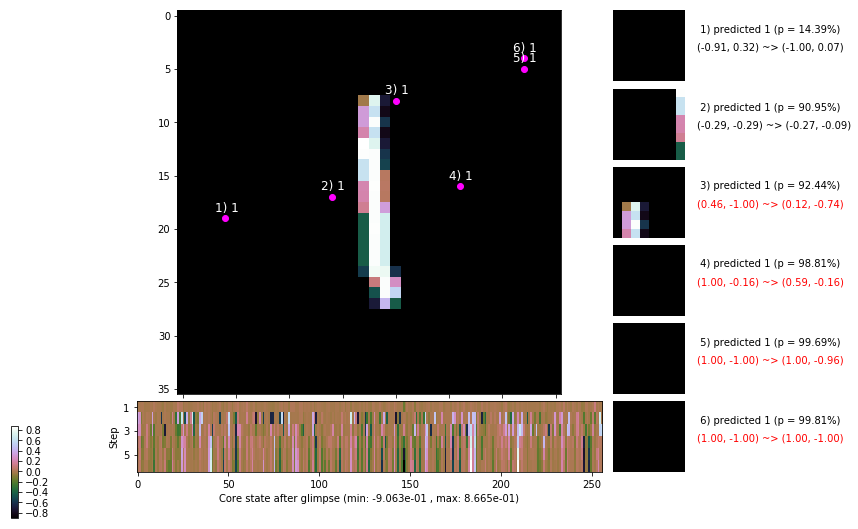

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.1 ms/b | lr: 5.26e-04 | grad 2norm: 11.52 | grad inf norm:  3.337
         Weights || abs max:  3.49 ( 5245.59) | mean: -8.90e-04 ( 0.02) | var: 7.32e-02 ( 1299.86)
          Biases || abs max:  1.22 (  196.87) | mean: -1.30e-01 ( 0.14) | var: 8.54e-02 (  923.43)
                    class loss: 0.502 | steps: 2.422 | reward:  4.035 | acc.: 83.07%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 147.5 ms/b | lr: 5.25e-04 | grad 2norm: 11.29 | grad inf norm:  3.257
         Weights || abs max:  3.49 ( 2459.82) | mean: -8.78e-04 ( 0.01) | var: 7.33e-02 (  115.24)
          Biases || abs max:  1.23 (  305.74) | mean: -1.30e-01 ( 0.19) | var: 8.55e-02 ( 3626.34)
                    class loss: 0.505 | steps: 2.394 | reward:  4.049 | acc.: 83.13%

	Target class: 2 | Discounted rewards: [0.078, 0.356, 0.9

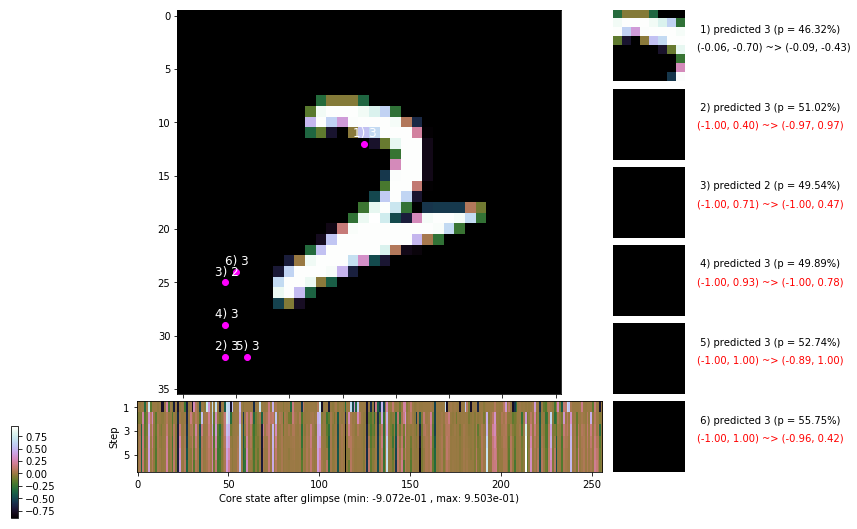

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


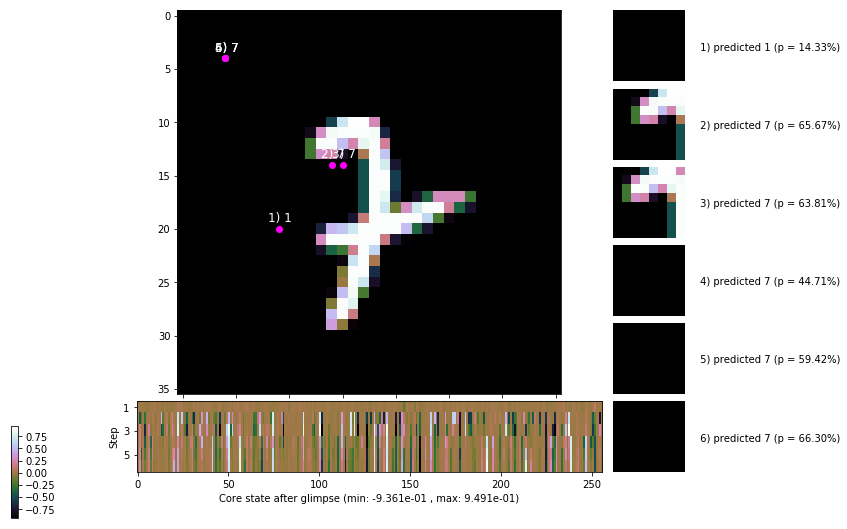


	Target class: 2 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


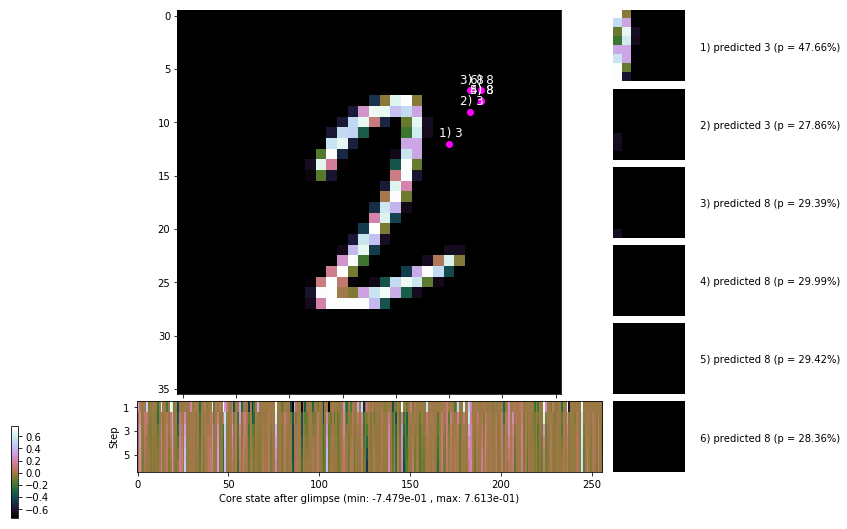

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


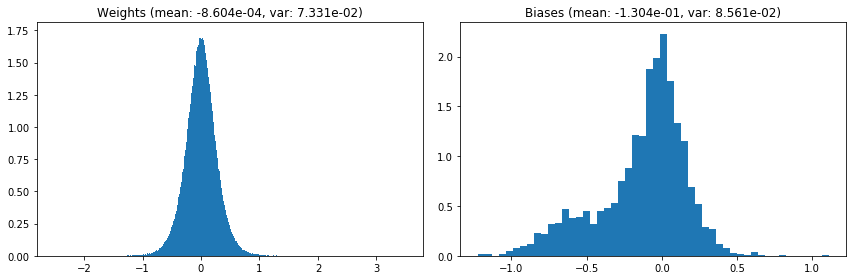

                                      Location network weights and biases


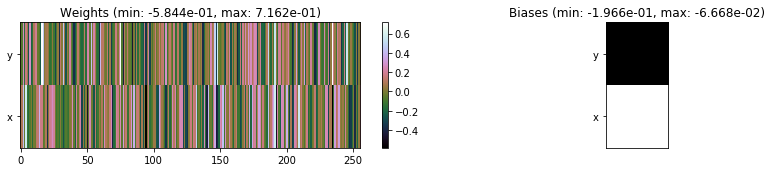

---------------------------------------------------------------------------------------------------------------
Elapsed time:  430.31 sec | TRAIN >> class loss: 0.5010 | steps:  2.397 :( | reward:  4.0529 :( | acc.: 83.115% :(
                          | VAL   >> class loss: 0.4806 | steps:  2.273    | reward:  4.1960 :( | acc.: 83.840% :(


Epoch  44/400) lr = 0.0005245
 b    300/  3000 >> 145.6 ms/b | lr: 5.24e-04 | grad 2norm: 11.13 | grad inf norm:  3.238
         Weights || abs max:  3.49 ( 2144.95) | mean: -8.65e-04 ( 0.01) | var: 7.33e-02 (   68.35)
          Biases || abs max:  1.23 (  164.52) | mean: -1.30e-01 ( 0.14) | var: 8.55e-02 (  106.36)
                    class loss: 0.488 | steps: 2.382 | reward:  4.099 | acc.: 83.98%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.5 ms/b | lr: 5.23e-04 | grad 2norm: 11.62 | grad inf norm:  3.296
         Weights || abs max:  3.50 ( 3312.05) | mean: -8.62e-04 (

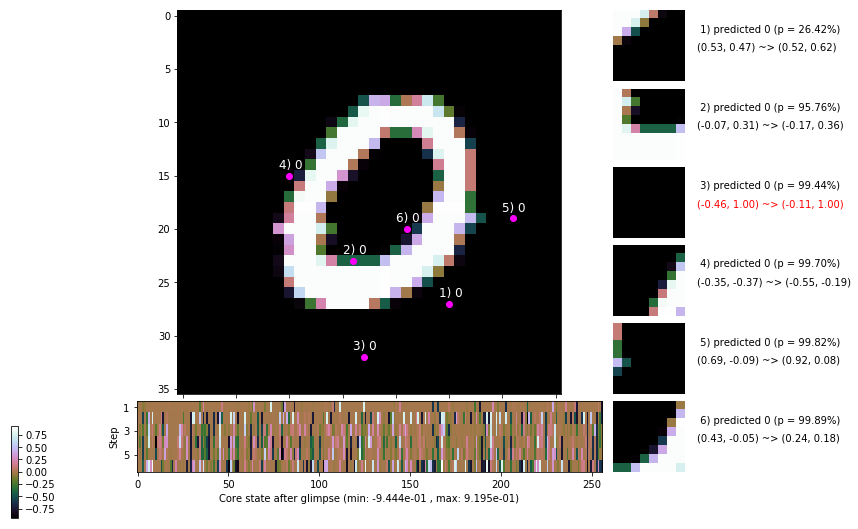

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 145.6 ms/b | lr: 5.22e-04 | grad 2norm: 11.31 | grad inf norm:  3.250
         Weights || abs max:  3.50 ( 3062.19) | mean: -8.85e-04 ( 0.01) | var: 7.35e-02 (  431.75)
          Biases || abs max:  1.22 (   79.04) | mean: -1.30e-01 ( 0.10) | var: 8.56e-02 (   14.59)
                    class loss: 0.477 | steps: 2.358 | reward:  4.110 | acc.: 83.70%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 145.0 ms/b | lr: 5.22e-04 | grad 2norm: 11.27 | grad inf norm:  3.157
         Weights || abs max:  3.51 ( 2623.61) | mean: -8.84e-04 ( 0.01) | var: 7.35e-02 (  252.06)
          Biases || abs max:  1.22 (  129.22) | mean: -1.30e-01 ( 0.13) | var: 8.57e-02 (  115.71)
                    class loss: 0.494 | steps: 2.372 | reward:  4.078 | acc.: 82.80%

	Target class: 8 | Discounted rewards: [0.319, 0.837, 1.8

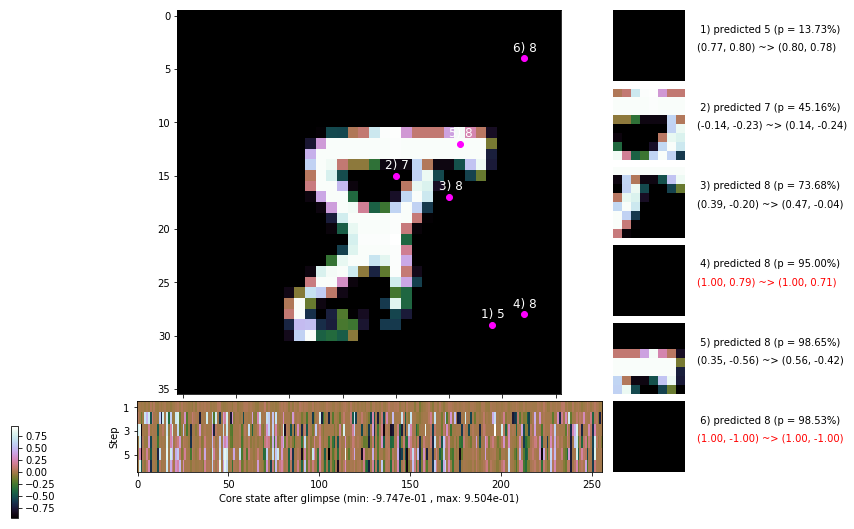

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.4 ms/b | lr: 5.21e-04 | grad 2norm: 11.33 | grad inf norm:  3.356
         Weights || abs max:  3.52 ( 5443.86) | mean: -8.64e-04 ( 0.02) | var: 7.36e-02 ( 1902.07)
          Biases || abs max:  1.22 (  126.67) | mean: -1.31e-01 ( 0.12) | var: 8.59e-02 (  125.51)
                    class loss: 0.491 | steps: 2.374 | reward:  4.099 | acc.: 83.82%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.3 ms/b | lr: 5.20e-04 | grad 2norm: 11.23 | grad inf norm:  3.195
         Weights || abs max:  3.52 ( 3656.46) | mean: -8.70e-04 ( 0.02) | var: 7.36e-02 (  363.57)
          Biases || abs max:  1.22 (   70.16) | mean: -1.31e-01 ( 0.09) | var: 8.60e-02 (   18.17)
                    class loss: 0.499 | steps: 2.380 | reward:  4.056 | acc.: 83.28%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

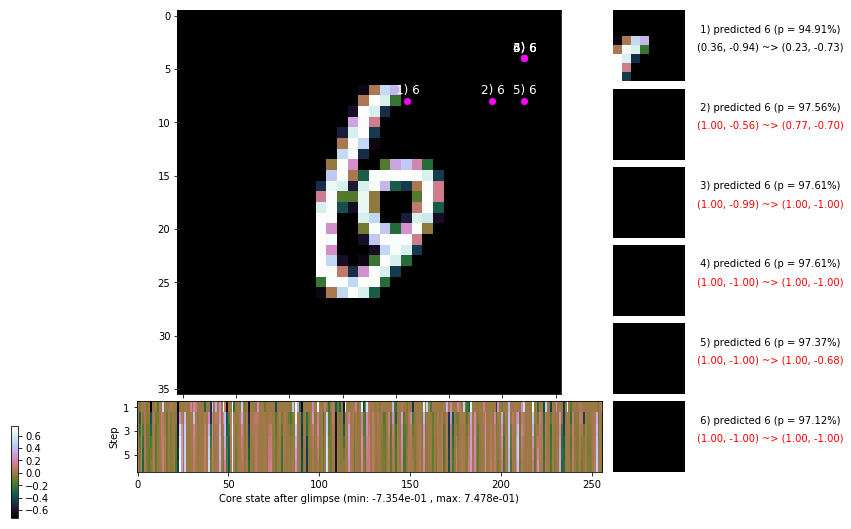

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.5 ms/b | lr: 5.19e-04 | grad 2norm: 11.40 | grad inf norm:  3.243
         Weights || abs max:  3.53 ( 1897.69) | mean: -8.83e-04 ( 0.01) | var: 7.37e-02 (   62.81)
          Biases || abs max:  1.21 (  208.22) | mean: -1.31e-01 ( 0.17) | var: 8.60e-02 (  500.33)
                    class loss: 0.480 | steps: 2.351 | reward:  4.103 | acc.: 83.63%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 140.4 ms/b | lr: 5.19e-04 | grad 2norm: 11.41 | grad inf norm:  3.294
         Weights || abs max:  3.53 ( 2267.32) | mean: -8.85e-04 ( 0.01) | var: 7.38e-02 (   48.78)
          Biases || abs max:  1.20 (  201.13) | mean: -1.31e-01 ( 0.15) | var: 8.60e-02 (  293.45)
                    class loss: 0.498 | steps: 2.392 | reward:  4.042 | acc.: 82.98%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.8

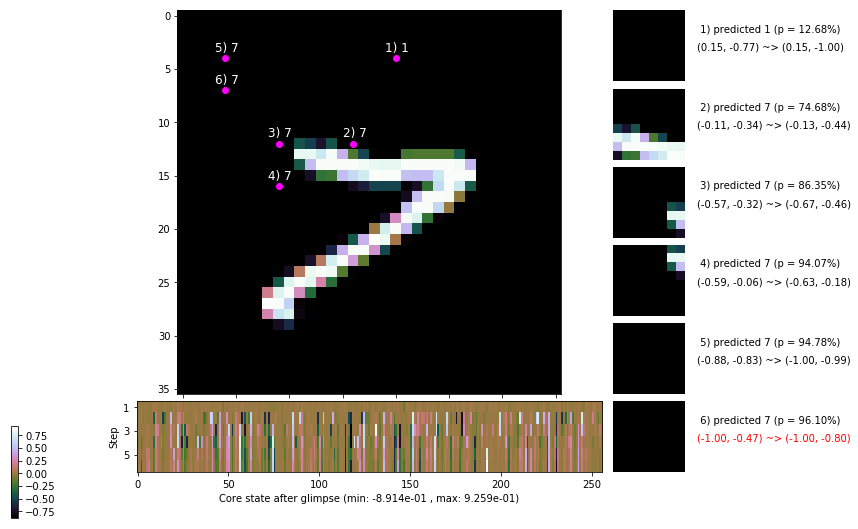

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 144.5 ms/b | lr: 5.18e-04 | grad 2norm: 11.35 | grad inf norm:  3.250
         Weights || abs max:  3.53 ( 2965.97) | mean: -8.60e-04 ( 0.01) | var: 7.38e-02 (  195.31)
          Biases || abs max:  1.21 (  172.69) | mean: -1.30e-01 ( 0.14) | var: 8.61e-02 (  407.12)
                    class loss: 0.481 | steps: 2.377 | reward:  4.080 | acc.: 83.55%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.5 ms/b | lr: 5.17e-04 | grad 2norm: 11.59 | grad inf norm:  3.331
         Weights || abs max:  3.54 ( 3501.32) | mean: -8.50e-04 ( 0.02) | var: 7.39e-02 (  240.89)
          Biases || abs max:  1.22 (  100.45) | mean: -1.30e-01 ( 0.10) | var: 8.62e-02 (   40.00)
                    class loss: 0.490 | steps: 2.408 | reward:  4.038 | acc.: 83.07%

	Target class: 9 | Discounted rewards: [0.869, 1.938, 1.8

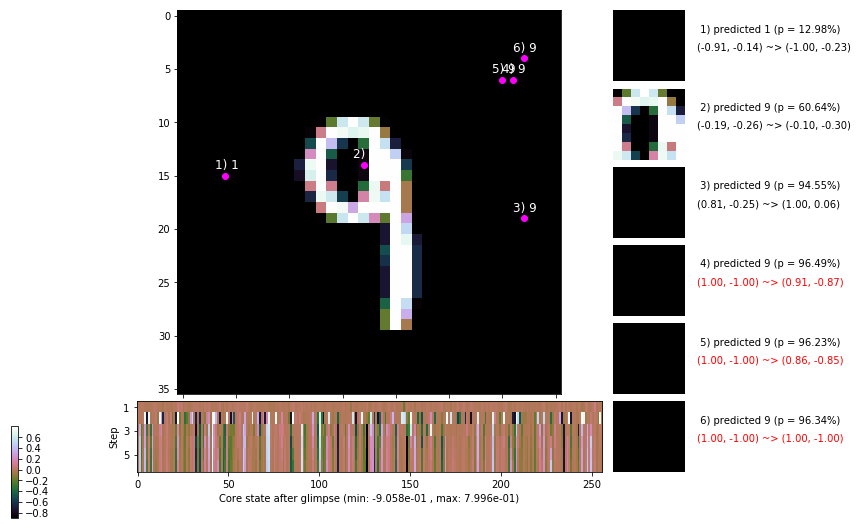

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


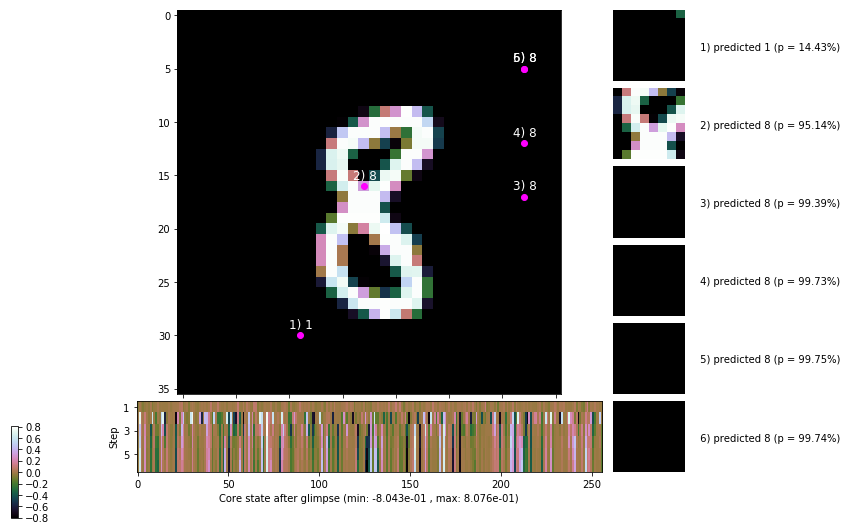


	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


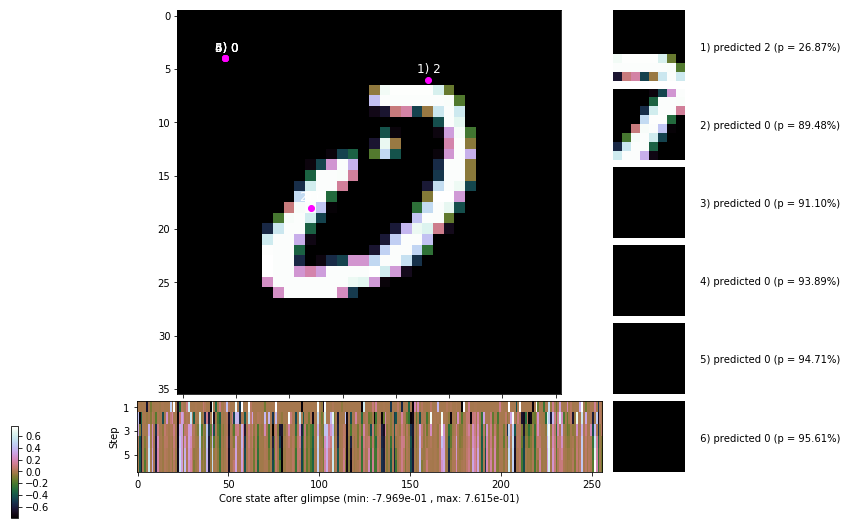

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


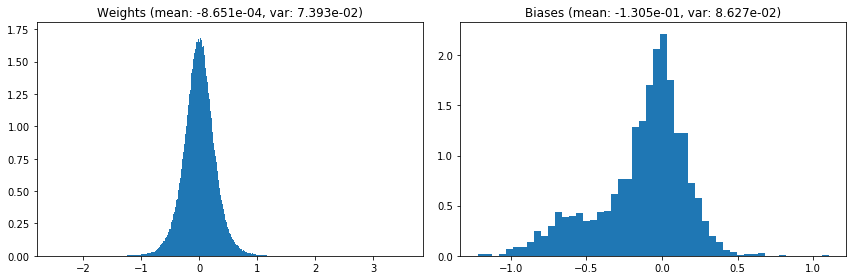

                                      Location network weights and biases


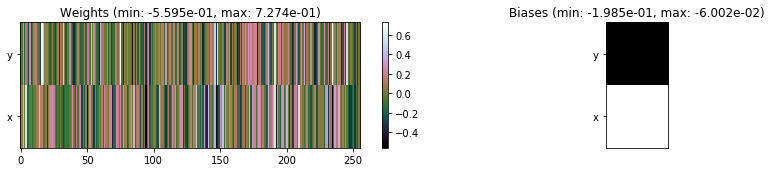

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.06 sec | TRAIN >> class loss: 0.4904 | steps:  2.378 :( | reward:  4.0754 :( | acc.: 83.358% :(
                          | VAL   >> class loss: 0.4893 | steps:  2.336 :( | reward:  4.1373 :( | acc.: 83.360% :(


Epoch  45/400) lr = 0.0005167
 b    300/  3000 >> 145.2 ms/b | lr: 5.16e-04 | grad 2norm: 11.48 | grad inf norm:  3.338
         Weights || abs max:  3.55 ( 3714.30) | mean: -8.62e-04 ( 0.02) | var: 7.40e-02 ( 1472.63)
          Biases || abs max:  1.22 (  175.25) | mean: -1.30e-01 ( 0.14) | var: 8.62e-02 (  390.77)
                    class loss: 0.482 | steps: 2.363 | reward:  4.097 | acc.: 83.58%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.0 ms/b | lr: 5.16e-04 | grad 2norm: 11.41 | grad inf norm:  3.498
         Weights || abs max:  3.55 ( 4948.63) | mean: -8.66e-04 (

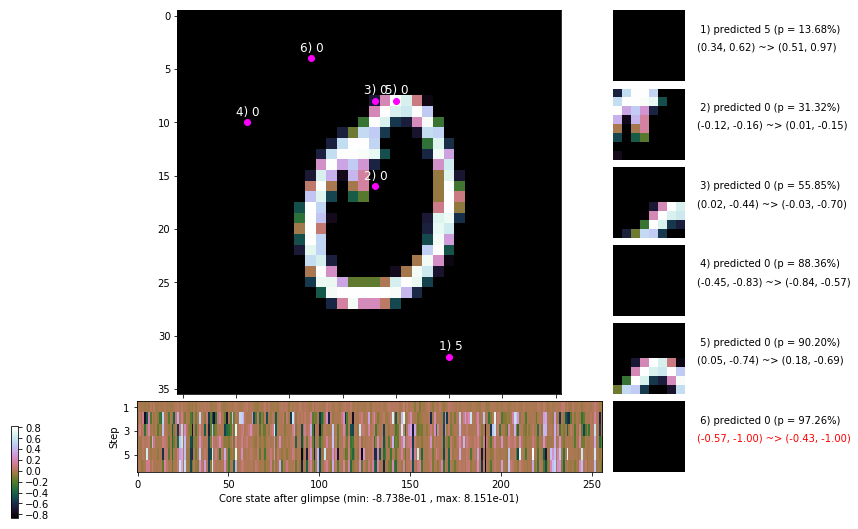

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.3 ms/b | lr: 5.15e-04 | grad 2norm: 11.15 | grad inf norm:  3.253
         Weights || abs max:  3.55 ( 7552.02) | mean: -8.86e-04 ( 0.02) | var: 7.41e-02 (14938.18)
          Biases || abs max:  1.23 (  153.29) | mean: -1.30e-01 ( 0.14) | var: 8.65e-02 (   68.24)
                    class loss: 0.490 | steps: 2.377 | reward:  4.079 | acc.: 83.45%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 148.7 ms/b | lr: 5.14e-04 | grad 2norm: 11.23 | grad inf norm:  3.135
         Weights || abs max:  3.55 ( 5800.28) | mean: -8.74e-04 ( 0.02) | var: 7.41e-02 ( 5819.38)
          Biases || abs max:  1.23 ( 1574.96) | mean: -1.31e-01 ( 0.70) | var: 8.65e-02 (119747.62)
                    class loss: 0.511 | steps: 2.375 | reward:  4.064 | acc.: 82.83%

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.

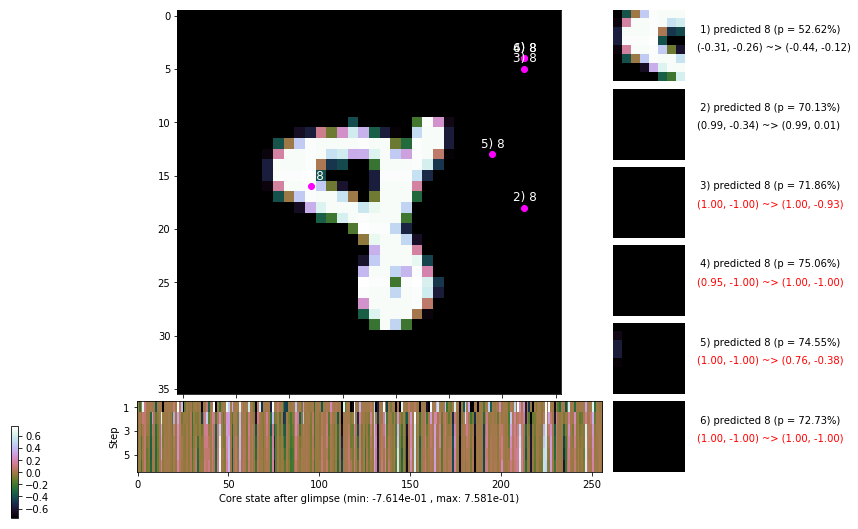

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 148.0 ms/b | lr: 5.13e-04 | grad 2norm: 11.26 | grad inf norm:  3.264
         Weights || abs max:  3.56 ( 1938.26) | mean: -8.53e-04 ( 0.01) | var: 7.42e-02 (  237.94)
          Biases || abs max:  1.22 (  168.23) | mean: -1.30e-01 ( 0.14) | var: 8.65e-02 (  381.96)
                    class loss: 0.493 | steps: 2.397 | reward:  4.039 | acc.: 83.12%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 143.2 ms/b | lr: 5.13e-04 | grad 2norm: 11.27 | grad inf norm:  3.389
         Weights || abs max:  3.56 ( 2165.90) | mean: -8.70e-04 ( 0.01) | var: 7.42e-02 (  136.69)
          Biases || abs max:  1.23 (  136.46) | mean: -1.31e-01 ( 0.13) | var: 8.67e-02 (   59.14)
                    class loss: 0.511 | steps: 2.387 | reward:  4.075 | acc.: 83.80%

	Target class: 6 | Discounted rewards: [0.319, 0.837, 1.8

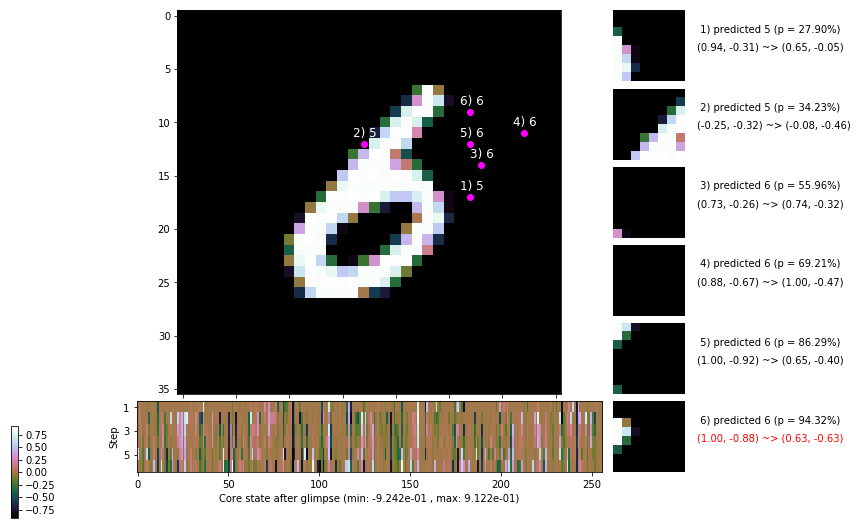

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 148.2 ms/b | lr: 5.12e-04 | grad 2norm: 11.53 | grad inf norm:  3.328
         Weights || abs max:  3.56 ( 2238.29) | mean: -8.85e-04 ( 0.01) | var: 7.43e-02 (  101.33)
          Biases || abs max:  1.23 (  145.57) | mean: -1.31e-01 ( 0.13) | var: 8.67e-02 (  220.51)
                    class loss: 0.516 | steps: 2.425 | reward:  4.009 | acc.: 82.75%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.6 ms/b | lr: 5.11e-04 | grad 2norm: 11.37 | grad inf norm:  3.390
         Weights || abs max:  3.56 ( 3193.76) | mean: -8.59e-04 ( 0.01) | var: 7.44e-02 (  598.26)
          Biases || abs max:  1.22 (  110.81) | mean: -1.32e-01 ( 0.10) | var: 8.68e-02 (  158.97)
                    class loss: 0.500 | steps: 2.419 | reward:  4.042 | acc.: 83.32%

	Target class: 3 | Discounted rewards: [0.319, 0.837, 1.8

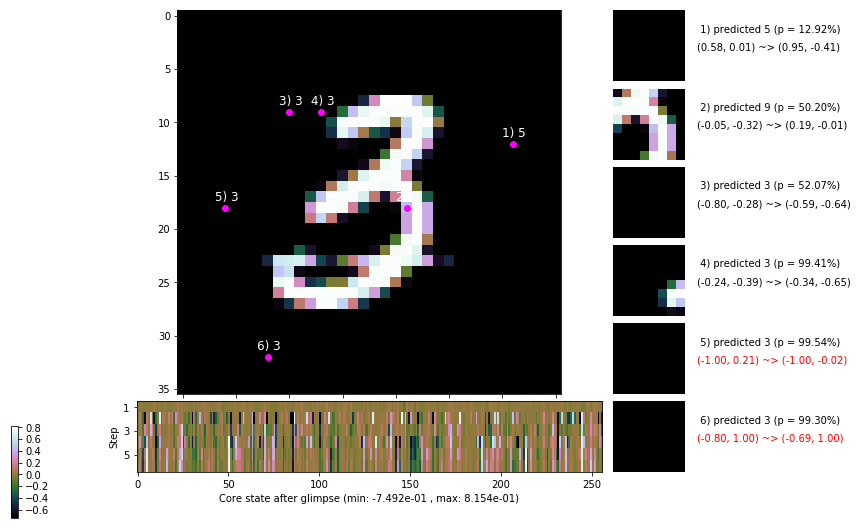

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.6 ms/b | lr: 5.10e-04 | grad 2norm: 11.08 | grad inf norm:  3.215
         Weights || abs max:  3.56 ( 5621.40) | mean: -8.41e-04 ( 0.02) | var: 7.44e-02 ( 1951.46)
          Biases || abs max:  1.22 (   49.97) | mean: -1.31e-01 ( 0.08) | var: 8.68e-02 (   10.18)
                    class loss: 0.488 | steps: 2.378 | reward:  4.076 | acc.: 83.07%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.3 ms/b | lr: 5.09e-04 | grad 2norm: 11.38 | grad inf norm:  3.307
         Weights || abs max:  3.57 ( 4846.47) | mean: -8.19e-04 ( 0.02) | var: 7.45e-02 ( 1300.03)
          Biases || abs max:  1.22 (   72.01) | mean: -1.31e-01 ( 0.10) | var: 8.68e-02 (   28.95)
                    class loss: 0.504 | steps: 2.397 | reward:  4.045 | acc.: 83.05%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

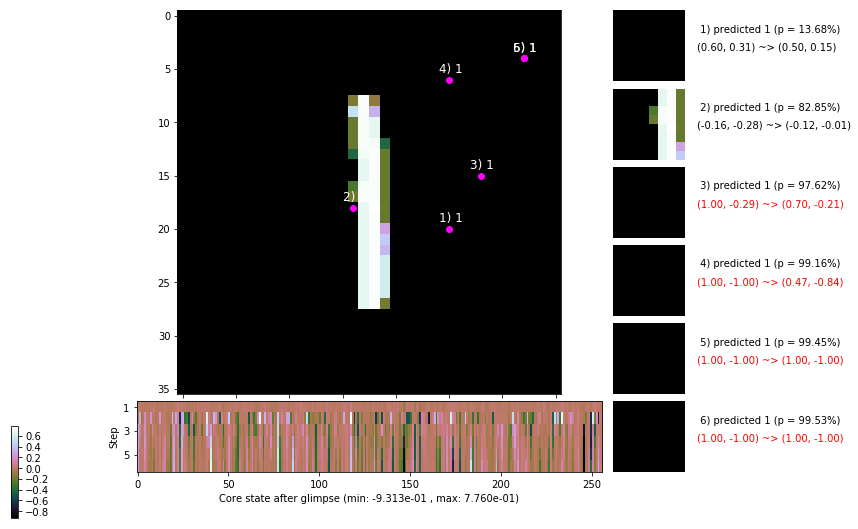

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.319, 0.837, 1.875, 1.750, 1.500, 1.000]


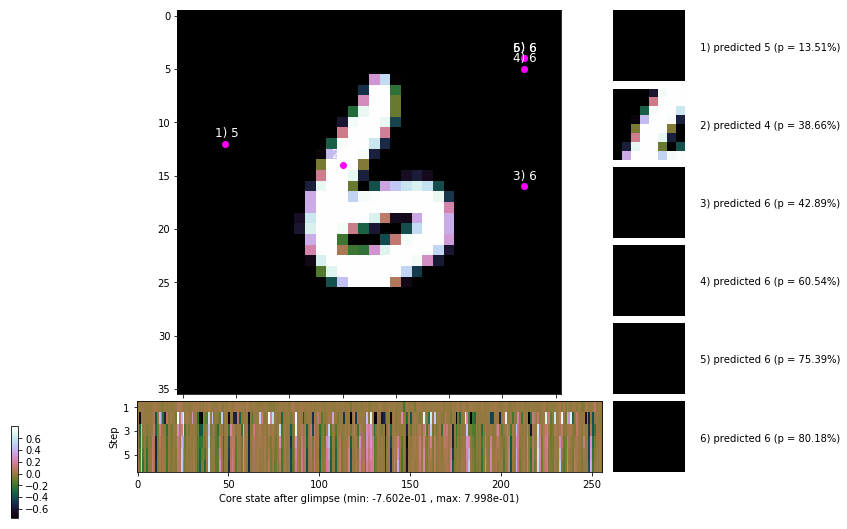


	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


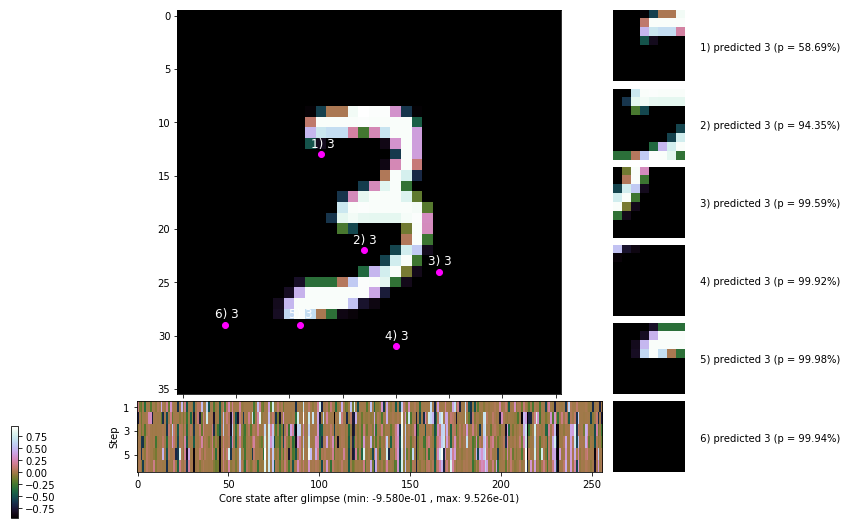

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


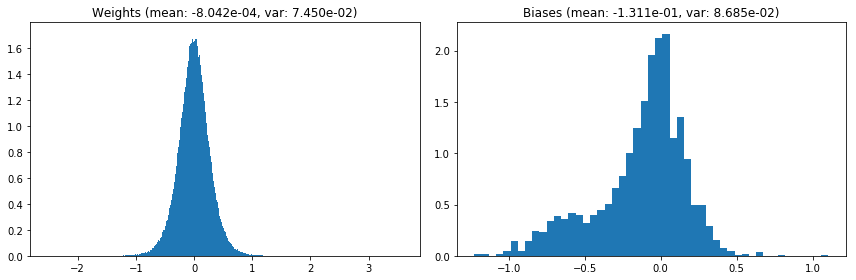

                                      Location network weights and biases


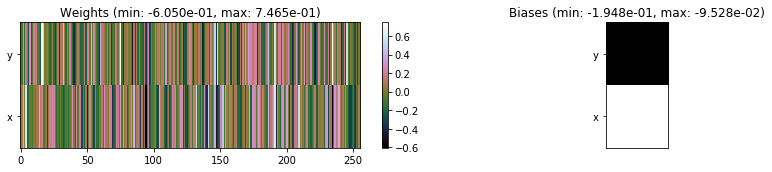

---------------------------------------------------------------------------------------------------------------
Elapsed time:  436.67 sec | TRAIN >> class loss: 0.4999 | steps:  2.395 :( | reward:  4.0543 :( | acc.: 83.145% :(
                          | VAL   >> class loss: 0.4942 | steps:  2.307 :( | reward:  4.1551 :( | acc.: 82.980% :(


Epoch  46/400) lr = 0.000509
 b    300/  3000 >> 141.3 ms/b | lr: 5.08e-04 | grad 2norm: 11.10 | grad inf norm:  3.145
         Weights || abs max:  3.57 (13476.83) | mean: -8.08e-04 ( 0.03) | var: 7.46e-02 (73169.30)
          Biases || abs max:  1.23 (  387.62) | mean: -1.31e-01 ( 0.23) | var: 8.67e-02 ( 7170.81)
                    class loss: 0.485 | steps: 2.408 | reward:  4.082 | acc.: 83.95%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 141.1 ms/b | lr: 5.08e-04 | grad 2norm: 11.51 | grad inf norm:  3.345
         Weights || abs max:  3.57 ( 4205.75) | mean: -8.18e-04 ( 

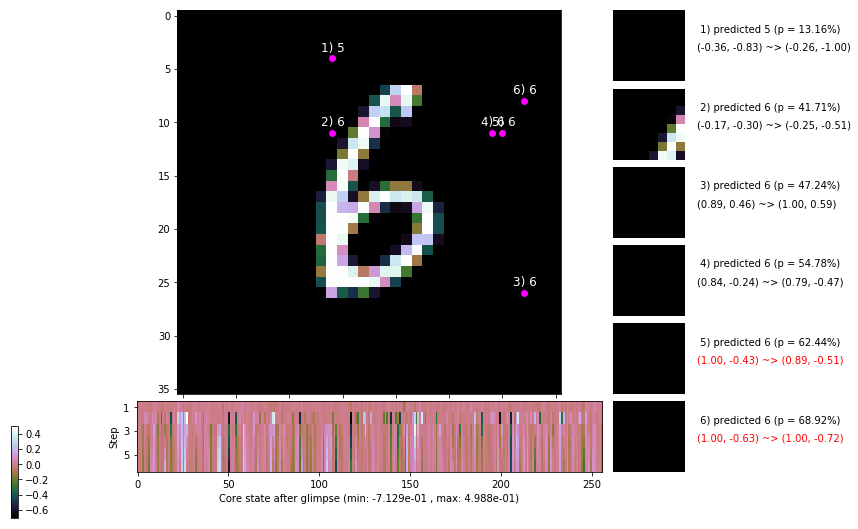

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.0 ms/b | lr: 5.07e-04 | grad 2norm: 11.09 | grad inf norm:  3.184
         Weights || abs max:  3.58 ( 2112.70) | mean: -8.20e-04 ( 0.01) | var: 7.47e-02 (   64.78)
          Biases || abs max:  1.23 (  177.61) | mean: -1.30e-01 ( 0.14) | var: 8.69e-02 (  185.31)
                    class loss: 0.476 | steps: 2.355 | reward:  4.092 | acc.: 84.12%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.4 ms/b | lr: 5.06e-04 | grad 2norm: 11.20 | grad inf norm:  3.216
         Weights || abs max:  3.59 ( 1822.33) | mean: -8.43e-04 ( 0.01) | var: 7.47e-02 (   91.43)
          Biases || abs max:  1.22 (  123.54) | mean: -1.30e-01 ( 0.13) | var: 8.69e-02 (  132.77)
                    class loss: 0.506 | steps: 2.400 | reward:  4.022 | acc.: 82.87%

	Target class: 4 | Discounted rewards: [0.869, 1.938, 1.8

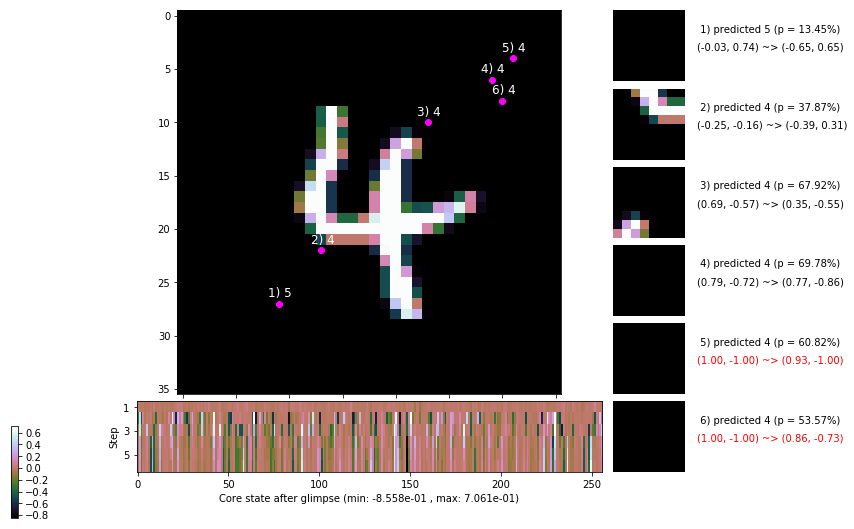

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 147.0 ms/b | lr: 5.05e-04 | grad 2norm: 11.11 | grad inf norm:  3.159
         Weights || abs max:  3.59 ( 2989.57) | mean: -8.39e-04 ( 0.01) | var: 7.48e-02 (  259.84)
          Biases || abs max:  1.23 (  162.60) | mean: -1.30e-01 ( 0.15) | var: 8.72e-02 (  256.78)
                    class loss: 0.526 | steps: 2.439 | reward:  3.981 | acc.: 82.13%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.6 ms/b | lr: 5.05e-04 | grad 2norm: 11.12 | grad inf norm:  3.207
         Weights || abs max:  3.59 ( 2167.12) | mean: -8.22e-04 ( 0.01) | var: 7.48e-02 (   86.46)
          Biases || abs max:  1.23 (  153.61) | mean: -1.31e-01 ( 0.14) | var: 8.75e-02 (  150.10)
                    class loss: 0.525 | steps: 2.402 | reward:  4.011 | acc.: 82.32%

	Target class: 4 | Discounted rewards: [0.319, 0.837, 1.8

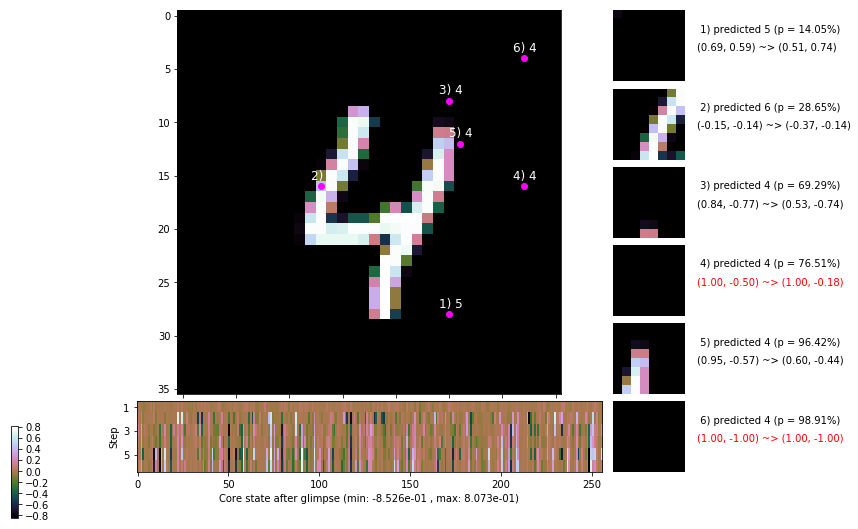

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 143.7 ms/b | lr: 5.04e-04 | grad 2norm: 11.40 | grad inf norm:  3.364
         Weights || abs max:  3.60 ( 2002.22) | mean: -8.07e-04 ( 0.01) | var: 7.49e-02 (   86.13)
          Biases || abs max:  1.24 (  159.79) | mean: -1.31e-01 ( 0.15) | var: 8.76e-02 (  427.37)
                    class loss: 0.529 | steps: 2.426 | reward:  3.994 | acc.: 82.22%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 147.8 ms/b | lr: 5.03e-04 | grad 2norm: 11.44 | grad inf norm:  3.305
         Weights || abs max:  3.61 ( 1311.68) | mean: -8.08e-04 ( 0.01) | var: 7.49e-02 (   12.24)
          Biases || abs max:  1.24 (   86.10) | mean: -1.31e-01 ( 0.10) | var: 8.76e-02 (   29.94)
                    class loss: 0.505 | steps: 2.389 | reward:  4.053 | acc.: 83.22%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

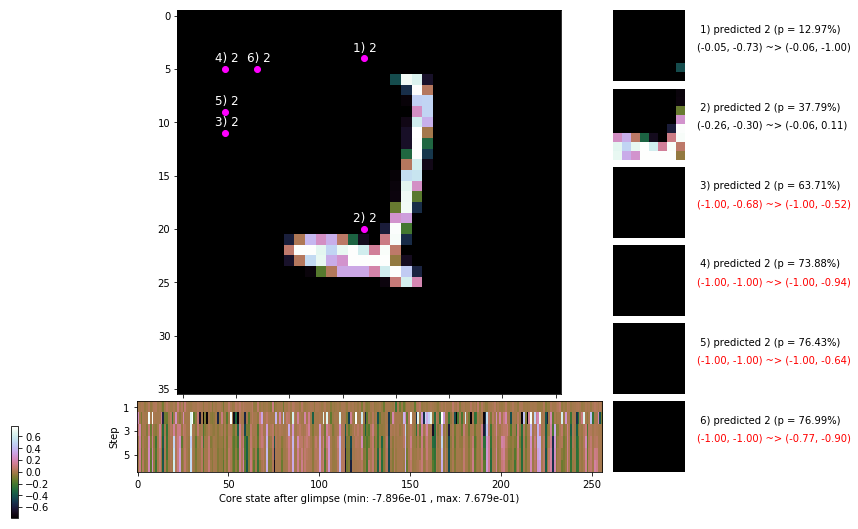

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.7 ms/b | lr: 5.02e-04 | grad 2norm: 11.28 | grad inf norm:  3.235
         Weights || abs max:  3.61 ( 4758.02) | mean: -8.10e-04 ( 0.02) | var: 7.50e-02 ( 3744.49)
          Biases || abs max:  1.24 (  118.14) | mean: -1.31e-01 ( 0.12) | var: 8.76e-02 (  248.33)
                    class loss: 0.497 | steps: 2.409 | reward:  4.036 | acc.: 83.25%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.3 ms/b | lr: 5.02e-04 | grad 2norm: 11.44 | grad inf norm:  3.381
         Weights || abs max:  3.61 ( 2085.78) | mean: -8.06e-04 ( 0.01) | var: 7.51e-02 (   82.92)
          Biases || abs max:  1.24 (  120.87) | mean: -1.31e-01 ( 0.11) | var: 8.77e-02 (  142.94)
                    class loss: 0.503 | steps: 2.383 | reward:  4.033 | acc.: 82.05%

	Target class: 8 | Discounted rewards: [0.869, 1.938, 1.8

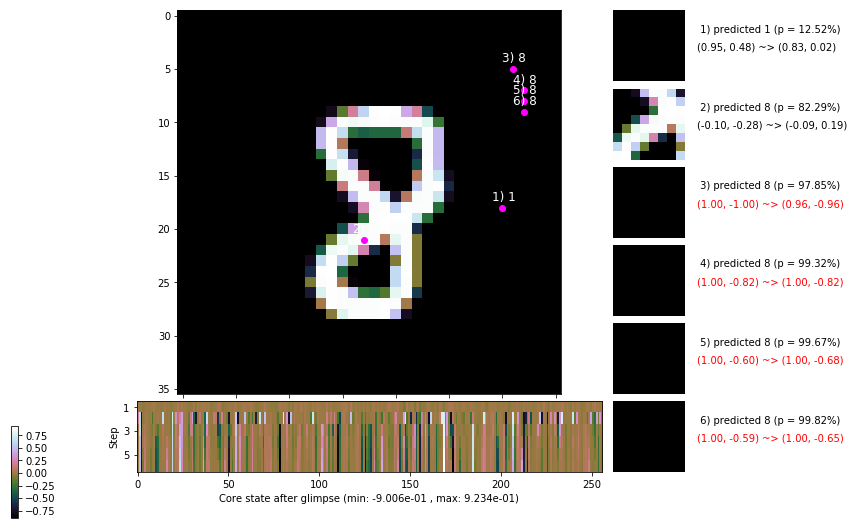

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


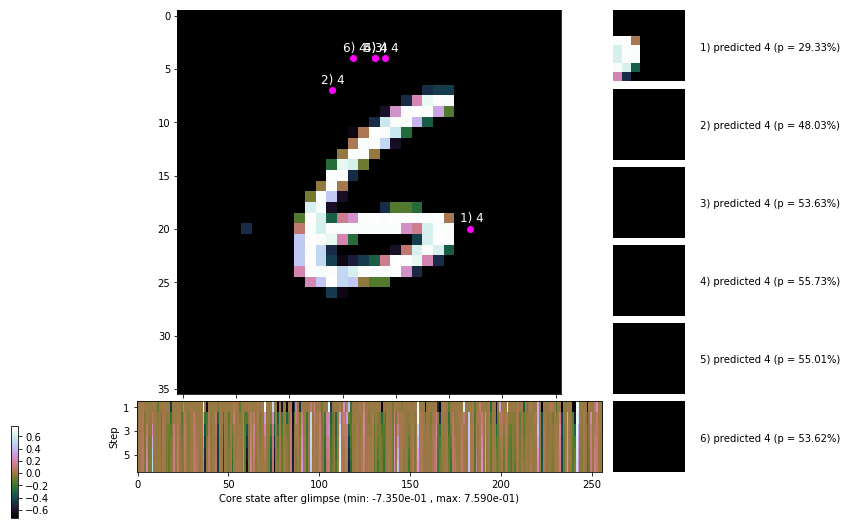


	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


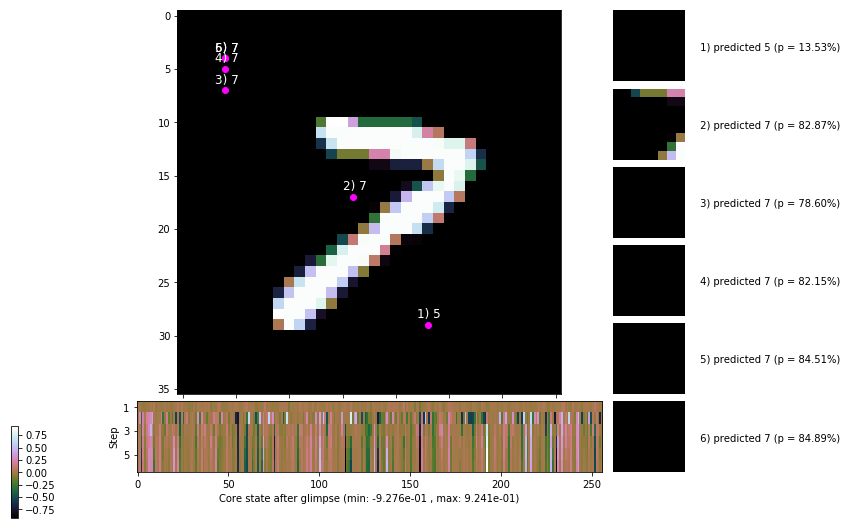

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


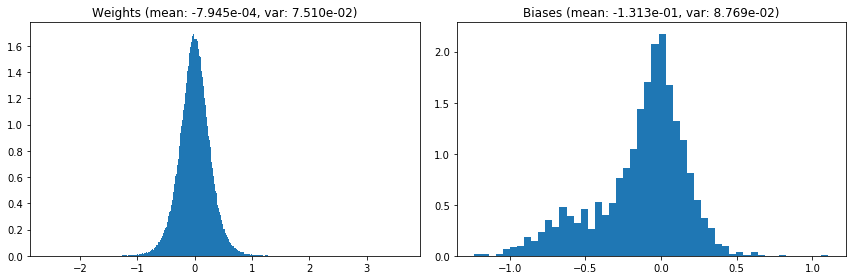

                                      Location network weights and biases


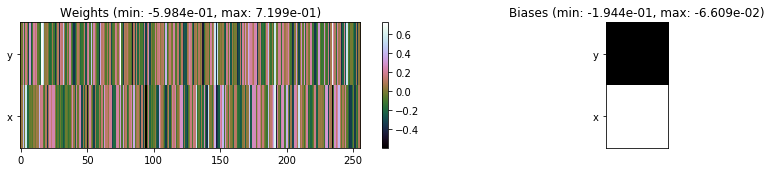

---------------------------------------------------------------------------------------------------------------
Elapsed time:  431.35 sec | TRAIN >> class loss: 0.5061 | steps:  2.400 :( | reward:  4.0344 :( | acc.: 82.892% :(
                          | VAL   >> class loss: 0.4963 | steps:  2.323 :( | reward:  4.1390 :( | acc.: 82.780% :(


Epoch  47/400) lr = 0.0005014
 b    300/  3000 >> 145.0 ms/b | lr: 5.01e-04 | grad 2norm: 11.40 | grad inf norm:  3.359
         Weights || abs max:  3.61 ( 4771.03) | mean: -7.88e-04 ( 0.02) | var: 7.51e-02 ( 2274.17)
          Biases || abs max:  1.23 (  129.40) | mean: -1.31e-01 ( 0.12) | var: 8.77e-02 (   87.40)
                    class loss: 0.519 | steps: 2.384 | reward:  4.041 | acc.: 82.35%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 145.0 ms/b | lr: 5.00e-04 | grad 2norm: 11.36 | grad inf norm:  3.337
         Weights || abs max:  3.62 ( 4291.13) | mean: -8.04e-04 (

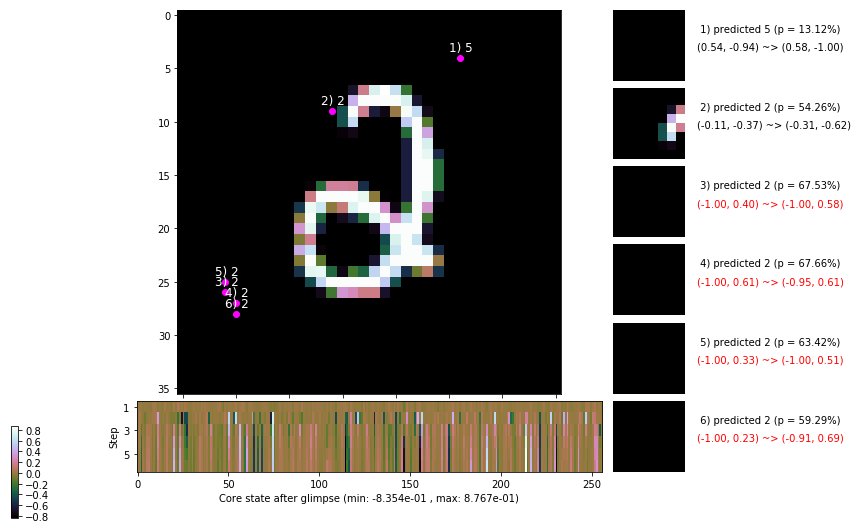

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.9 ms/b | lr: 4.99e-04 | grad 2norm: 11.48 | grad inf norm:  3.345
         Weights || abs max:  3.63 ( 2534.60) | mean: -8.12e-04 ( 0.01) | var: 7.52e-02 (  196.25)
          Biases || abs max:  1.23 (  192.10) | mean: -1.32e-01 ( 0.15) | var: 8.79e-02 (  284.74)
                    class loss: 0.509 | steps: 2.393 | reward:  4.034 | acc.: 82.62%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.7 ms/b | lr: 4.99e-04 | grad 2norm: 11.32 | grad inf norm:  3.204
         Weights || abs max:  3.63 ( 3385.15) | mean: -7.95e-04 ( 0.02) | var: 7.53e-02 (  503.90)
          Biases || abs max:  1.22 (  181.89) | mean: -1.32e-01 ( 0.16) | var: 8.80e-02 (  319.14)
                    class loss: 0.506 | steps: 2.400 | reward:  4.021 | acc.: 82.50%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

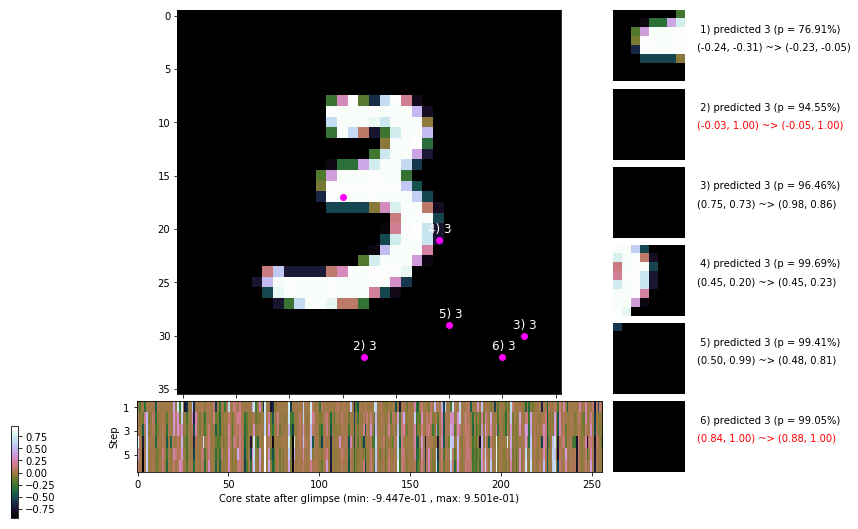

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 141.3 ms/b | lr: 4.98e-04 | grad 2norm: 11.39 | grad inf norm:  3.425
         Weights || abs max:  3.63 ( 3022.16) | mean: -7.97e-04 ( 0.01) | var: 7.53e-02 (  408.60)
          Biases || abs max:  1.22 (  170.02) | mean: -1.32e-01 ( 0.14) | var: 8.81e-02 (  195.31)
                    class loss: 0.493 | steps: 2.401 | reward:  4.038 | acc.: 82.92%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.3 ms/b | lr: 4.97e-04 | grad 2norm: 11.14 | grad inf norm:  3.274
         Weights || abs max:  3.63 ( 2880.40) | mean: -7.95e-04 ( 0.01) | var: 7.54e-02 (  496.33)
          Biases || abs max:  1.23 (  209.72) | mean: -1.31e-01 ( 0.16) | var: 8.80e-02 (  232.72)
                    class loss: 0.485 | steps: 2.339 | reward:  4.102 | acc.: 83.60%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.8

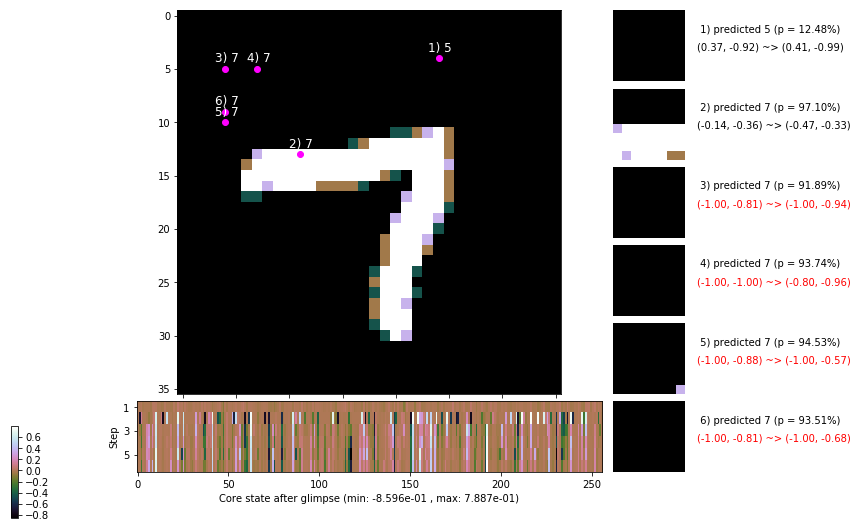

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.5 ms/b | lr: 4.96e-04 | grad 2norm: 11.52 | grad inf norm:  3.266
         Weights || abs max:  3.64 ( 3128.44) | mean: -7.94e-04 ( 0.01) | var: 7.55e-02 (  637.86)
          Biases || abs max:  1.23 (   89.76) | mean: -1.32e-01 ( 0.10) | var: 8.81e-02 (   16.70)
                    class loss: 0.497 | steps: 2.351 | reward:  4.091 | acc.: 82.77%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 144.8 ms/b | lr: 4.96e-04 | grad 2norm: 11.47 | grad inf norm:  3.294
         Weights || abs max:  3.63 ( 2229.87) | mean: -8.10e-04 ( 0.01) | var: 7.55e-02 (  101.33)
          Biases || abs max:  1.23 (  111.99) | mean: -1.32e-01 ( 0.11) | var: 8.82e-02 (   66.61)
                    class loss: 0.503 | steps: 2.406 | reward:  4.024 | acc.: 82.65%

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.8

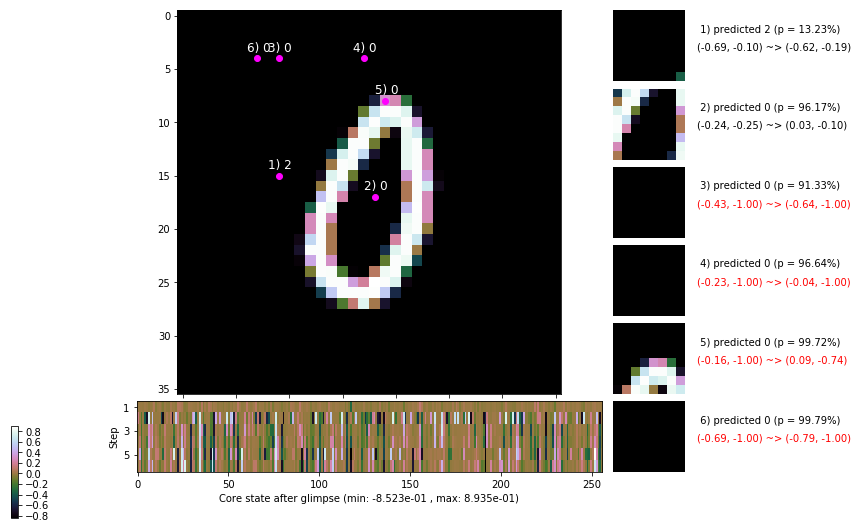

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 147.8 ms/b | lr: 4.95e-04 | grad 2norm: 11.01 | grad inf norm:  3.129
         Weights || abs max:  3.62 ( 5405.35) | mean: -8.25e-04 ( 0.02) | var: 7.56e-02 ( 3033.86)
          Biases || abs max:  1.23 (  178.18) | mean: -1.31e-01 ( 0.14) | var: 8.83e-02 ( 1225.19)
                    class loss: 0.486 | steps: 2.359 | reward:  4.116 | acc.: 83.95%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.1 ms/b | lr: 4.94e-04 | grad 2norm: 11.22 | grad inf norm:  3.204
         Weights || abs max:  3.62 ( 2663.32) | mean: -8.11e-04 ( 0.01) | var: 7.56e-02 (  484.65)
          Biases || abs max:  1.24 (  138.86) | mean: -1.32e-01 ( 0.12) | var: 8.85e-02 (  123.40)
                    class loss: 0.492 | steps: 2.377 | reward:  4.078 | acc.: 84.13%

	Target class: 3 | Discounted rewards: [-0.197, -0.194, -

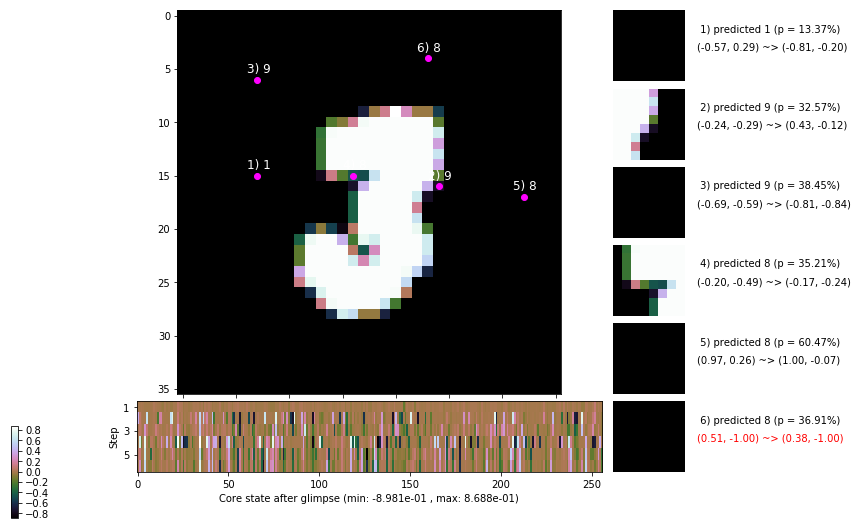

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


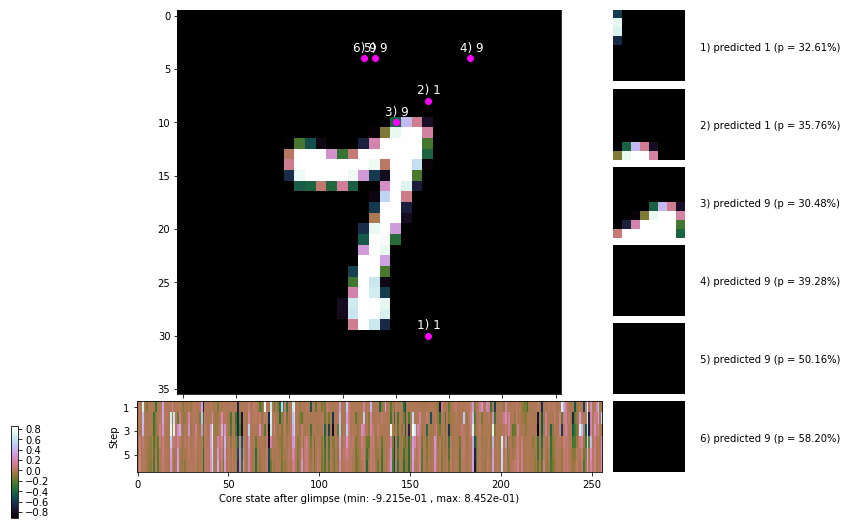


	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


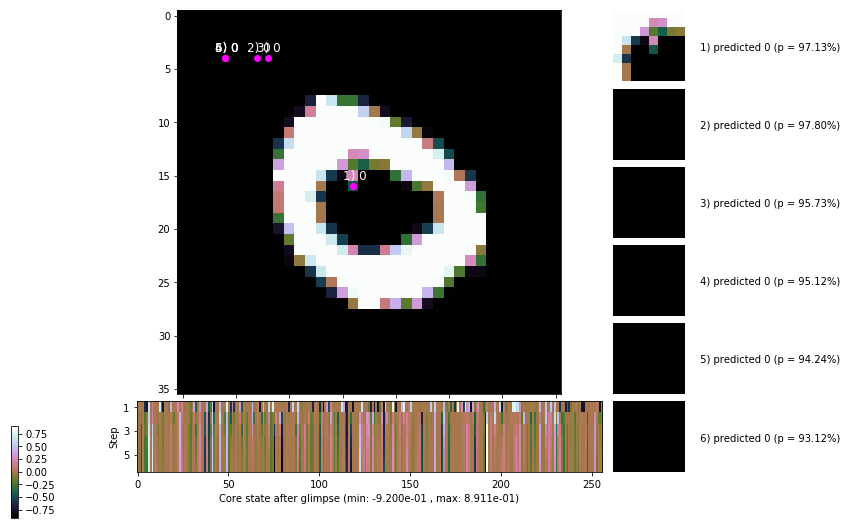

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


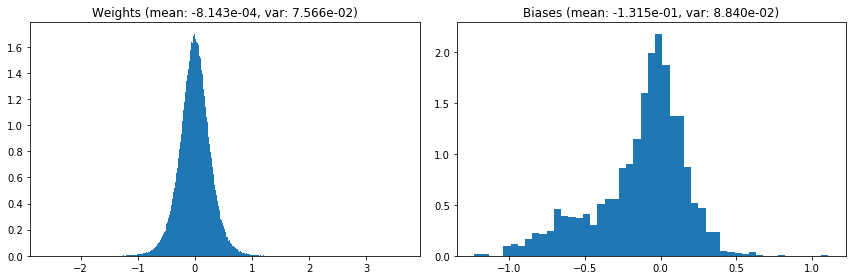

                                      Location network weights and biases


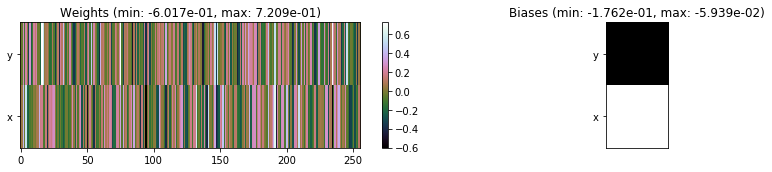

---------------------------------------------------------------------------------------------------------------
Elapsed time:  431.77 sec | TRAIN >> class loss: 0.4998 | steps:  2.380 :( | reward:  4.0578 :( | acc.: 83.022% :(
                          | VAL   >> class loss: 0.4945 | steps:  2.300 :( | reward:  4.1714 :( | acc.: 83.240% :(


Epoch  48/400) lr = 0.0004939
 b    300/  3000 >> 145.6 ms/b | lr: 4.93e-04 | grad 2norm: 11.42 | grad inf norm:  3.467
         Weights || abs max:  3.63 ( 5946.83) | mean: -8.08e-04 ( 0.02) | var: 7.57e-02 ( 2879.69)
          Biases || abs max:  1.24 (  308.48) | mean: -1.32e-01 ( 0.27) | var: 8.85e-02 ( 9781.25)
                    class loss: 0.506 | steps: 2.382 | reward:  4.049 | acc.: 82.32%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.9 ms/b | lr: 4.93e-04 | grad 2norm: 11.50 | grad inf norm:  3.524
         Weights || abs max:  3.63 ( 6745.94) | mean: -7.88e-04 (

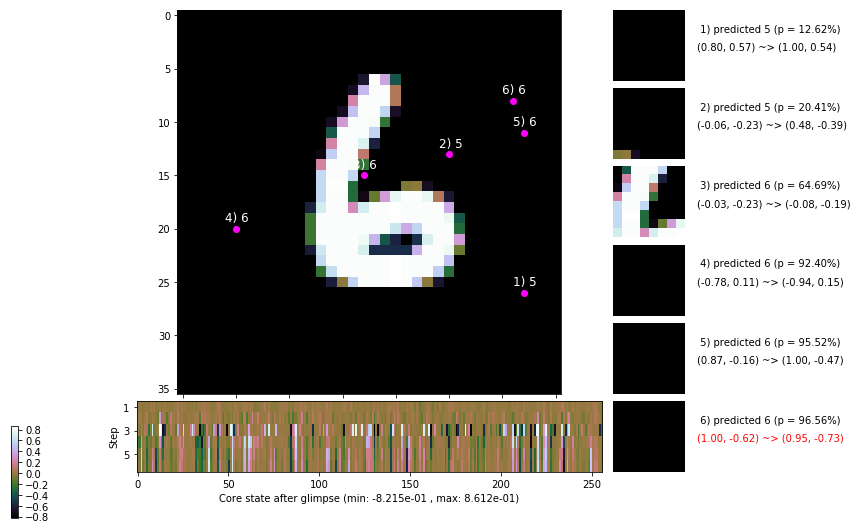

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.6 ms/b | lr: 4.92e-04 | grad 2norm: 11.13 | grad inf norm:  3.140
         Weights || abs max:  3.64 ( 5270.46) | mean: -7.89e-04 ( 0.02) | var: 7.58e-02 ( 3111.73)
          Biases || abs max:  1.25 ( 1351.33) | mean: -1.32e-01 ( 0.60) | var: 8.85e-02 (141407.78)
                    class loss: 0.481 | steps: 2.371 | reward:  4.086 | acc.: 83.20%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 146.3 ms/b | lr: 4.91e-04 | grad 2norm: 11.27 | grad inf norm:  3.198
         Weights || abs max:  3.63 ( 6530.54) | mean: -7.90e-04 ( 0.02) | var: 7.58e-02 ( 5669.99)
          Biases || abs max:  1.25 (  195.77) | mean: -1.32e-01 ( 0.15) | var: 8.85e-02 (  765.60)
                    class loss: 0.491 | steps: 2.351 | reward:  4.090 | acc.: 83.63%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.

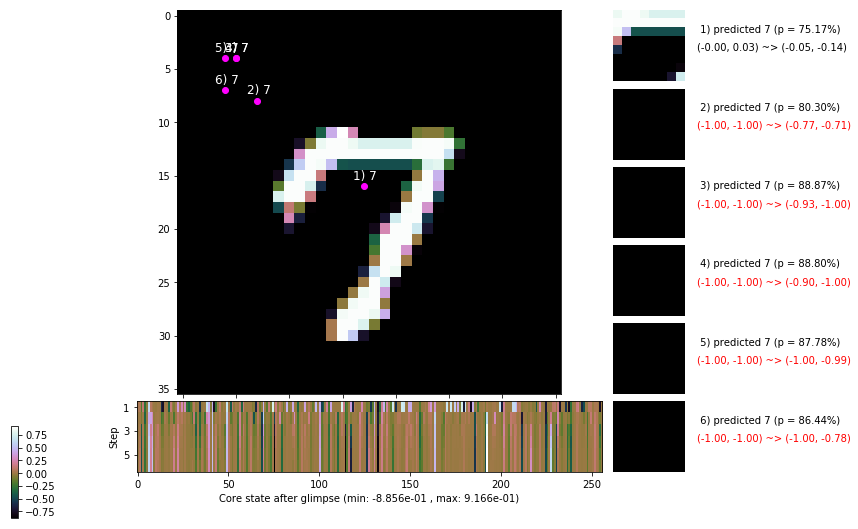

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 145.6 ms/b | lr: 4.90e-04 | grad 2norm: 11.58 | grad inf norm:  3.316
         Weights || abs max:  3.63 ( 2942.06) | mean: -7.89e-04 ( 0.01) | var: 7.59e-02 (  657.29)
          Biases || abs max:  1.24 (   66.17) | mean: -1.32e-01 ( 0.09) | var: 8.87e-02 (   29.35)
                    class loss: 0.537 | steps: 2.406 | reward:  4.016 | acc.: 81.67%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.6 ms/b | lr: 4.90e-04 | grad 2norm: 11.35 | grad inf norm:  3.304
         Weights || abs max:  3.64 ( 2055.77) | mean: -8.01e-04 ( 0.01) | var: 7.59e-02 (   61.37)
          Biases || abs max:  1.25 (  111.94) | mean: -1.32e-01 ( 0.12) | var: 8.90e-02 (   87.04)
                    class loss: 0.513 | steps: 2.372 | reward:  4.073 | acc.: 82.72%

	Target class: 5 | Discounted rewards: [0.869, 1.938, 1.8

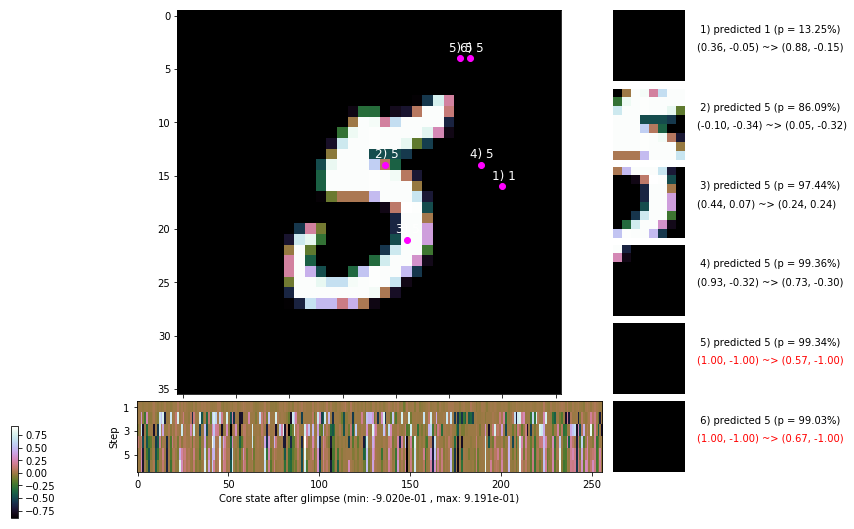

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.3 ms/b | lr: 4.89e-04 | grad 2norm: 11.27 | grad inf norm:  3.172
         Weights || abs max:  3.64 ( 2999.30) | mean: -7.92e-04 ( 0.01) | var: 7.60e-02 (  576.65)
          Biases || abs max:  1.26 (  221.40) | mean: -1.32e-01 ( 0.17) | var: 8.90e-02 (  323.90)
                    class loss: 0.519 | steps: 2.408 | reward:  4.050 | acc.: 83.05%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.4 ms/b | lr: 4.89e-04 | grad 2norm: 11.21 | grad inf norm:  3.211
         Weights || abs max:  3.64 ( 1802.89) | mean: -7.89e-04 ( 0.01) | var: 7.60e-02 (   60.50)
          Biases || abs max:  1.25 (  189.98) | mean: -1.33e-01 ( 0.15) | var: 8.91e-02 (  286.55)
                    class loss: 0.506 | steps: 2.398 | reward:  4.041 | acc.: 82.90%

	Target class: 8 | Discounted rewards: [-0.197, -0.194, -

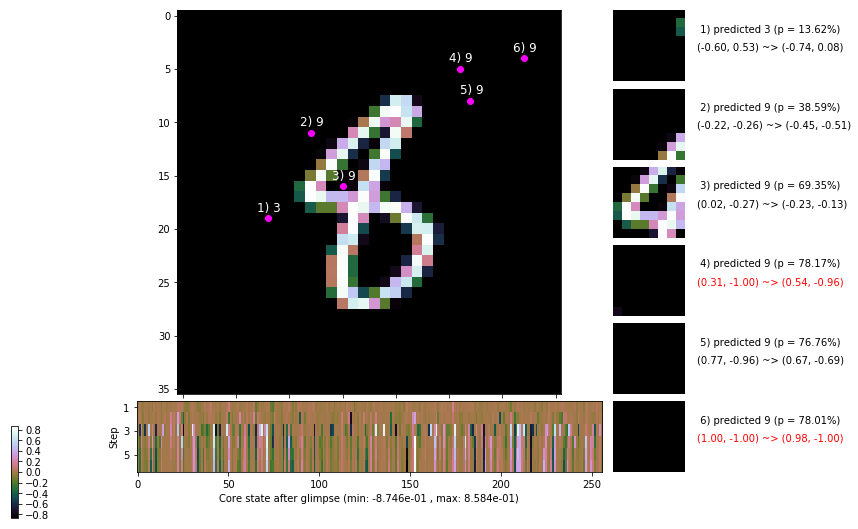

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.3 ms/b | lr: 4.88e-04 | grad 2norm: 10.95 | grad inf norm:  3.068
         Weights || abs max:  3.64 ( 3046.85) | mean: -7.92e-04 ( 0.01) | var: 7.61e-02 (  364.98)
          Biases || abs max:  1.25 (  640.76) | mean: -1.33e-01 ( 0.33) | var: 8.91e-02 (22657.54)
                    class loss: 0.504 | steps: 2.377 | reward:  4.065 | acc.: 82.93%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.2 ms/b | lr: 4.87e-04 | grad 2norm: 11.31 | grad inf norm:  3.279
         Weights || abs max:  3.63 ( 3261.30) | mean: -7.97e-04 ( 0.01) | var: 7.62e-02 (  323.02)
          Biases || abs max:  1.24 (  136.15) | mean: -1.33e-01 ( 0.13) | var: 8.92e-02 (  178.55)
                    class loss: 0.502 | steps: 2.360 | reward:  4.076 | acc.: 82.87%

	Target class: 9 | Discounted rewards: [-0.197, -0.194, -

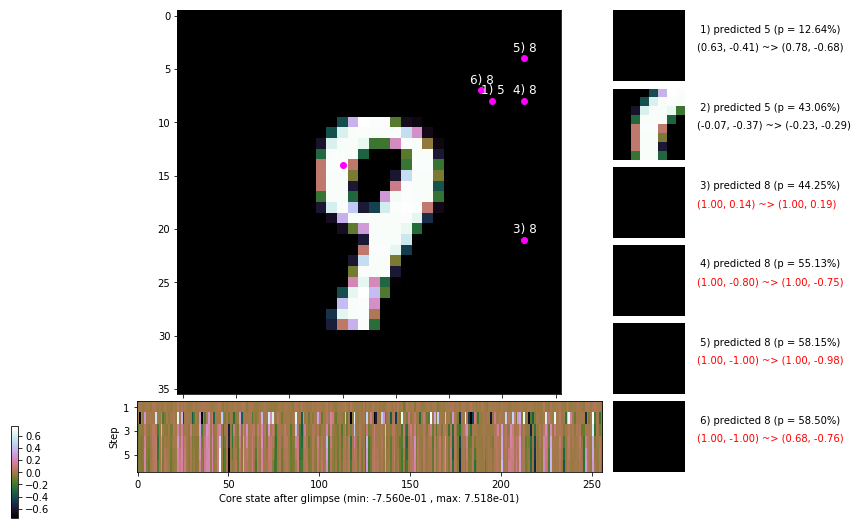

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


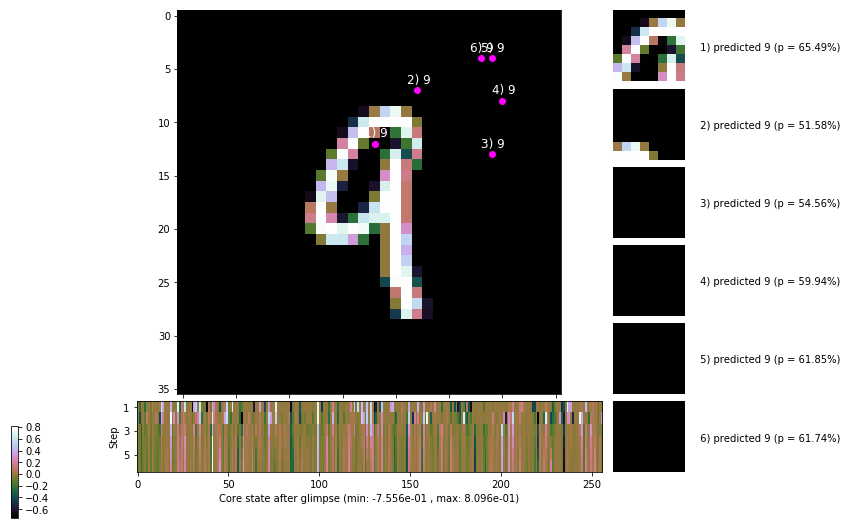


	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


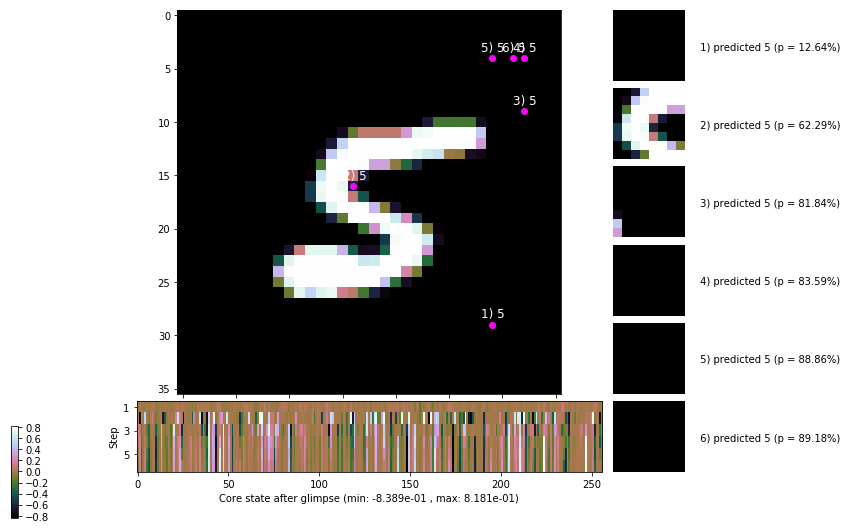

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


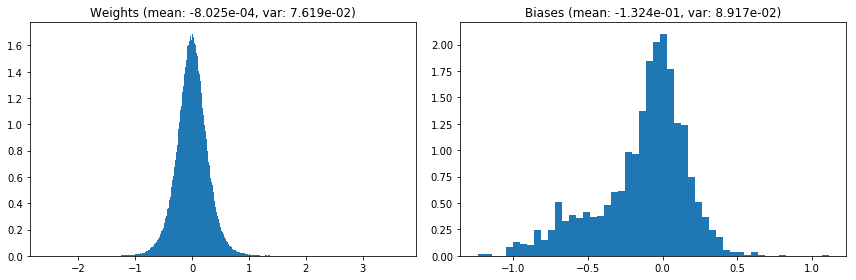

                                      Location network weights and biases


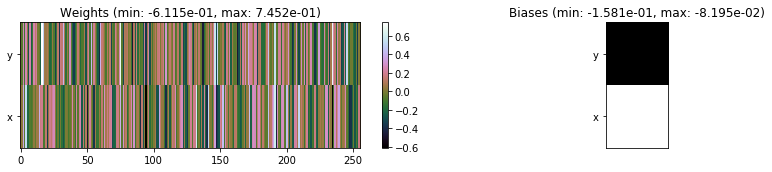

---------------------------------------------------------------------------------------------------------------
Elapsed time:  431.89 sec | TRAIN >> class loss: 0.5055 | steps:  2.378 :( | reward:  4.0648 :( | acc.: 82.863% :(
                          | VAL   >> class loss: 0.4910 | steps:  2.294 :( | reward:  4.1861 :( | acc.: 83.820% :(


Epoch  49/400) lr = 0.0004866
 b    300/  3000 >> 140.8 ms/b | lr: 4.86e-04 | grad 2norm: 11.10 | grad inf norm:  3.219
         Weights || abs max:  3.63 ( 3195.81) | mean: -7.97e-04 ( 0.01) | var: 7.62e-02 (  306.34)
          Biases || abs max:  1.23 (  229.10) | mean: -1.32e-01 ( 0.17) | var: 8.92e-02 (  288.59)
                    class loss: 0.497 | steps: 2.391 | reward:  4.072 | acc.: 83.08%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.4 ms/b | lr: 4.86e-04 | grad 2norm: 11.38 | grad inf norm:  3.334
         Weights || abs max:  3.63 ( 2043.19) | mean: -8.09e-04 (

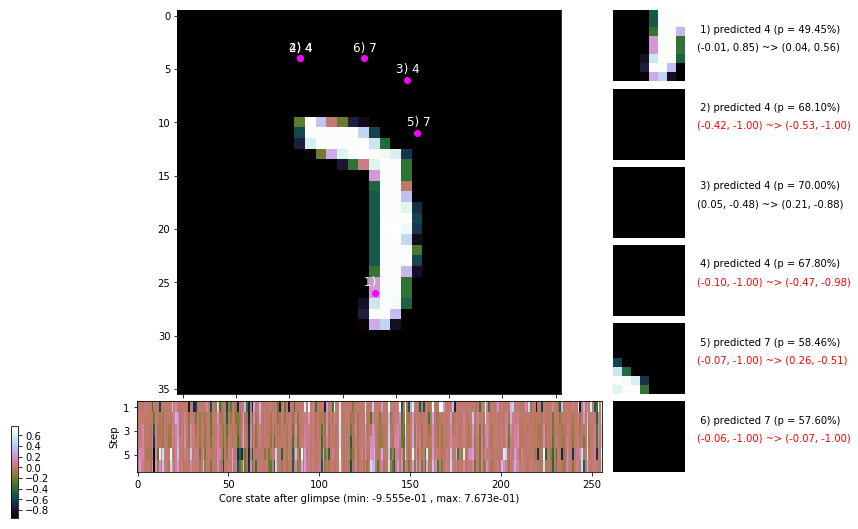

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.7 ms/b | lr: 4.85e-04 | grad 2norm: 11.24 | grad inf norm:  3.200
         Weights || abs max:  3.64 ( 3647.90) | mean: -7.95e-04 ( 0.01) | var: 7.63e-02 ( 1234.52)
          Biases || abs max:  1.24 (  999.42) | mean: -1.33e-01 ( 0.47) | var: 8.93e-02 (85186.38)
                    class loss: 0.490 | steps: 2.386 | reward:  4.057 | acc.: 83.48%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 142.6 ms/b | lr: 4.84e-04 | grad 2norm: 11.34 | grad inf norm:  3.401
         Weights || abs max:  3.65 ( 7296.29) | mean: -8.02e-04 ( 0.02) | var: 7.64e-02 ( 6965.05)
          Biases || abs max:  1.24 (  121.38) | mean: -1.33e-01 ( 0.11) | var: 8.93e-02 (   79.01)
                    class loss: 0.511 | steps: 2.407 | reward:  4.039 | acc.: 82.85%

	Target class: 8 | Discounted rewards: [0.869, 1.938, 1.8

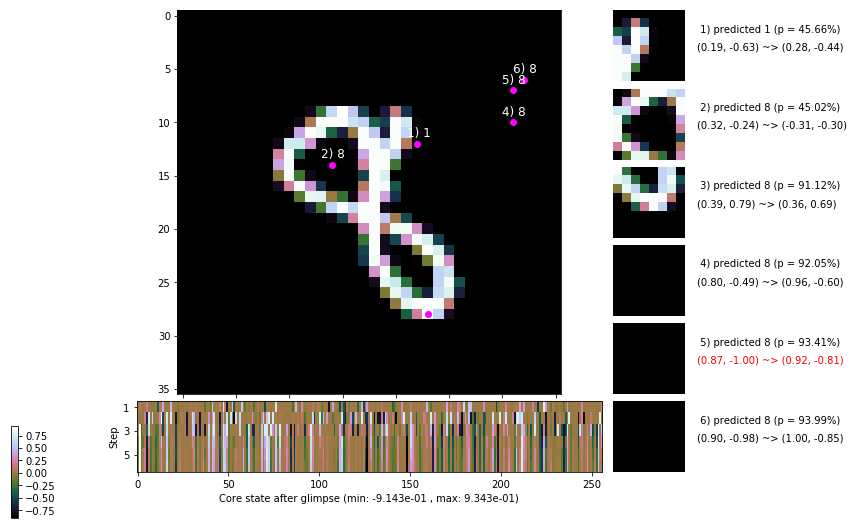

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 151.1 ms/b | lr: 4.83e-04 | grad 2norm: 11.03 | grad inf norm:  3.090
         Weights || abs max:  3.66 ( 2570.10) | mean: -8.08e-04 ( 0.01) | var: 7.64e-02 (  241.89)
          Biases || abs max:  1.24 (   87.80) | mean: -1.33e-01 ( 0.10) | var: 8.93e-02 (   38.11)
                    class loss: 0.506 | steps: 2.401 | reward:  4.032 | acc.: 82.47%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 144.1 ms/b | lr: 4.83e-04 | grad 2norm: 11.01 | grad inf norm:  3.278
         Weights || abs max:  3.66 ( 1778.12) | mean: -8.17e-04 ( 0.01) | var: 7.65e-02 (   84.67)
          Biases || abs max:  1.24 (  125.88) | mean: -1.33e-01 ( 0.13) | var: 8.94e-02 (   57.45)
                    class loss: 0.488 | steps: 2.358 | reward:  4.086 | acc.: 83.75%

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.8

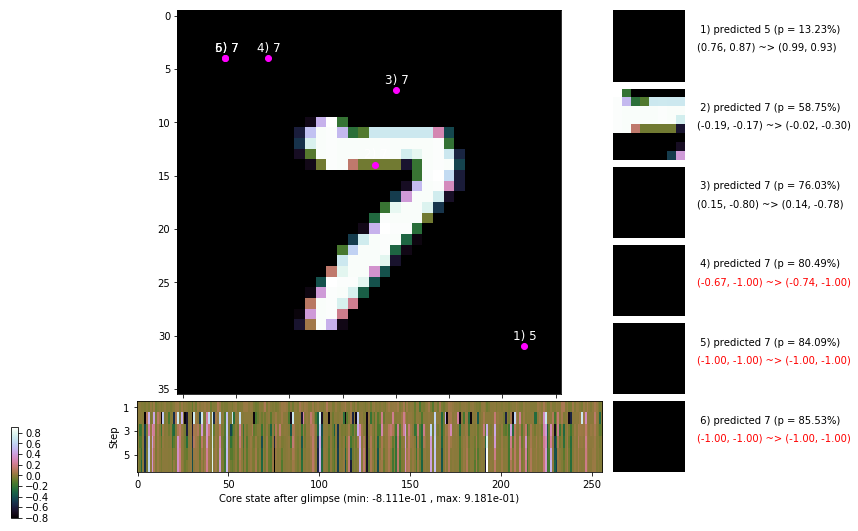

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.8 ms/b | lr: 4.82e-04 | grad 2norm: 11.34 | grad inf norm:  3.370
         Weights || abs max:  3.66 ( 1699.68) | mean: -8.19e-04 ( 0.01) | var: 7.65e-02 (   49.86)
          Biases || abs max:  1.24 (  188.37) | mean: -1.33e-01 ( 0.15) | var: 8.94e-02 (  210.86)
                    class loss: 0.494 | steps: 2.386 | reward:  4.051 | acc.: 82.65%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.8 ms/b | lr: 4.81e-04 | grad 2norm: 11.12 | grad inf norm:  3.278
         Weights || abs max:  3.66 ( 2476.07) | mean: -8.37e-04 ( 0.01) | var: 7.66e-02 (  409.48)
          Biases || abs max:  1.24 (  183.96) | mean: -1.33e-01 ( 0.14) | var: 8.94e-02 (  954.23)
                    class loss: 0.481 | steps: 2.370 | reward:  4.076 | acc.: 83.70%

	Target class: 4 | Discounted rewards: [-0.197, -0.194, -

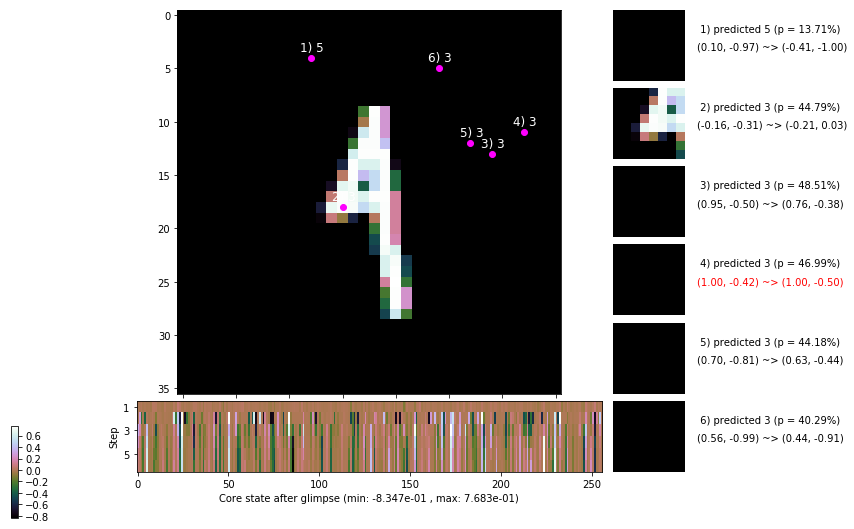

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 146.5 ms/b | lr: 4.80e-04 | grad 2norm: 11.14 | grad inf norm:  3.156
         Weights || abs max:  3.66 ( 2552.63) | mean: -8.24e-04 ( 0.01) | var: 7.66e-02 (  103.34)
          Biases || abs max:  1.25 (  238.71) | mean: -1.33e-01 ( 0.17) | var: 8.95e-02 (  460.77)
                    class loss: 0.474 | steps: 2.385 | reward:  4.079 | acc.: 83.90%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.3 ms/b | lr: 4.80e-04 | grad 2norm: 11.17 | grad inf norm:  3.226
         Weights || abs max:  3.66 ( 3385.22) | mean: -8.37e-04 ( 0.01) | var: 7.67e-02 (  187.98)
          Biases || abs max:  1.25 (  131.42) | mean: -1.34e-01 ( 0.12) | var: 8.95e-02 (   92.22)
                    class loss: 0.495 | steps: 2.402 | reward:  4.050 | acc.: 83.17%

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.8

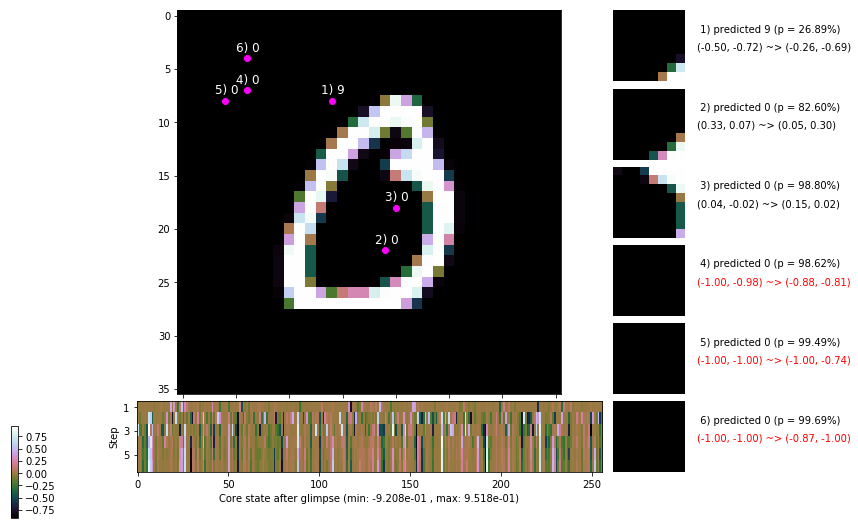

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


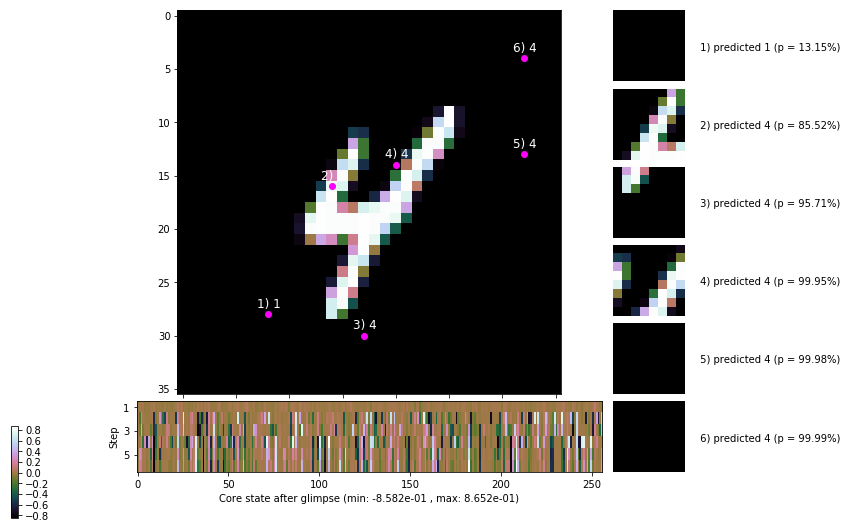


	Target class: 2 | Discounted rewards: [0.319, 0.837, 1.875, 1.750, 1.500, 1.000]


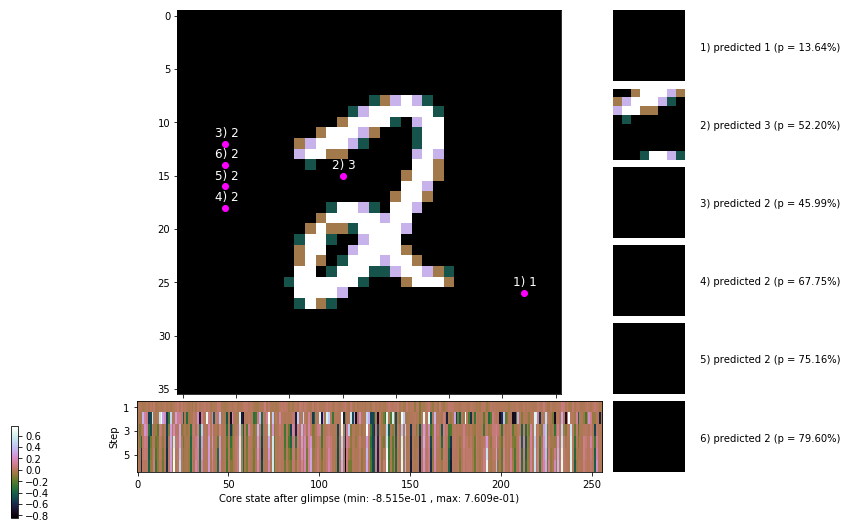

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


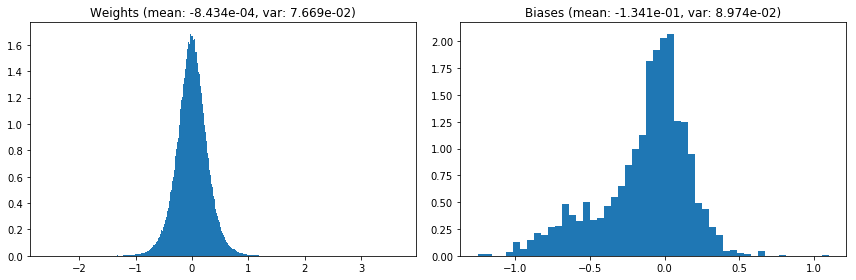

                                      Location network weights and biases


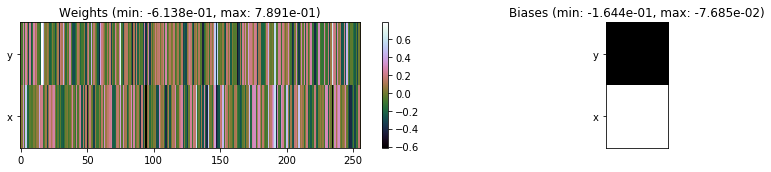

---------------------------------------------------------------------------------------------------------------
Elapsed time:  436.72 sec | TRAIN >> class loss: 0.4946 | steps:  2.390 :( | reward:  4.0568 :( | acc.: 83.220% :(
                          | VAL   >> class loss: 0.4605 | steps:  2.290 :( | reward:  4.2015 :( | acc.: 84.640% :(


Epoch  50/400) lr = 0.0004793
 b    300/  3000 >> 142.0 ms/b | lr: 4.79e-04 | grad 2norm: 11.07 | grad inf norm:  3.135
         Weights || abs max:  3.66 ( 2883.30) | mean: -8.50e-04 ( 0.01) | var: 7.67e-02 (  307.81)
          Biases || abs max:  1.25 (  176.89) | mean: -1.33e-01 ( 0.13) | var: 8.97e-02 (  292.34)
                    class loss: 0.467 | steps: 2.356 | reward:  4.098 | acc.: 84.17%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 139.0 ms/b | lr: 4.78e-04 | grad 2norm: 10.93 | grad inf norm:  3.090
         Weights || abs max:  3.67 ( 3084.64) | mean: -8.31e-04 (

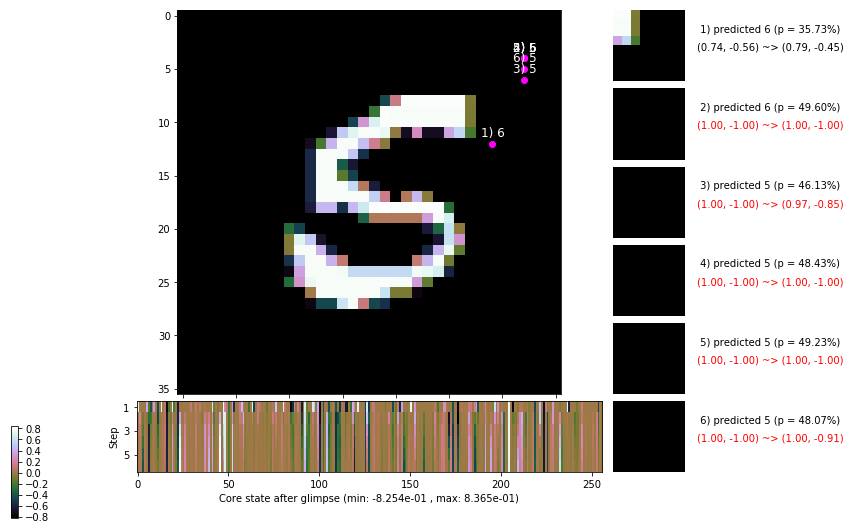

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.6 ms/b | lr: 4.77e-04 | grad 2norm: 11.20 | grad inf norm:  3.325
         Weights || abs max:  3.67 ( 2640.41) | mean: -8.22e-04 ( 0.01) | var: 7.68e-02 (  189.47)
          Biases || abs max:  1.25 (   94.99) | mean: -1.33e-01 ( 0.10) | var: 8.97e-02 (   47.08)
                    class loss: 0.497 | steps: 2.378 | reward:  4.065 | acc.: 83.32%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.2 ms/b | lr: 4.77e-04 | grad 2norm: 11.15 | grad inf norm:  3.218
         Weights || abs max:  3.67 ( 3203.33) | mean: -8.17e-04 ( 0.01) | var: 7.69e-02 (  407.19)
          Biases || abs max:  1.24 (  339.60) | mean: -1.33e-01 ( 0.20) | var: 8.98e-02 ( 4193.38)
                    class loss: 0.494 | steps: 2.398 | reward:  4.058 | acc.: 83.23%

	Target class: 5 | Discounted rewards: [0.869, 1.938, 1.8

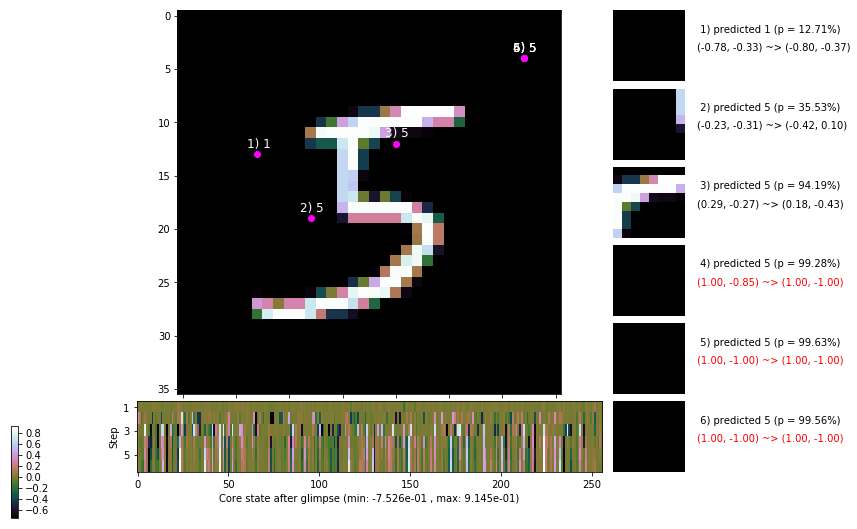

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 146.0 ms/b | lr: 4.76e-04 | grad 2norm: 10.91 | grad inf norm:  3.174
         Weights || abs max:  3.68 ( 6810.27) | mean: -8.10e-04 ( 0.02) | var: 7.69e-02 ( 7472.48)
          Biases || abs max:  1.24 (  217.12) | mean: -1.33e-01 ( 0.16) | var: 8.98e-02 (  512.15)
                    class loss: 0.480 | steps: 2.385 | reward:  4.051 | acc.: 83.20%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 146.6 ms/b | lr: 4.76e-04 | grad 2norm: 11.21 | grad inf norm:  3.161
         Weights || abs max:  3.67 ( 3283.55) | mean: -8.14e-04 ( 0.02) | var: 7.70e-02 (  311.08)
          Biases || abs max:  1.24 (  104.38) | mean: -1.33e-01 ( 0.11) | var: 8.97e-02 (   57.17)
                    class loss: 0.483 | steps: 2.377 | reward:  4.060 | acc.: 83.42%

	Target class: 4 | Discounted rewards: [0.869, 1.938, 1.8

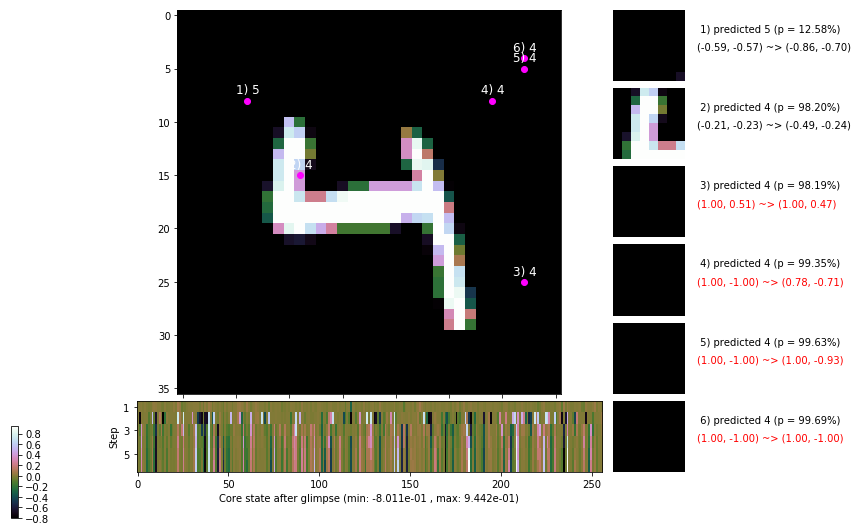

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.4 ms/b | lr: 4.75e-04 | grad 2norm: 11.24 | grad inf norm:  3.334
         Weights || abs max:  3.67 ( 3709.56) | mean: -7.93e-04 ( 0.02) | var: 7.71e-02 (  553.86)
          Biases || abs max:  1.24 (  114.66) | mean: -1.33e-01 ( 0.11) | var: 8.99e-02 (   81.10)
                    class loss: 0.484 | steps: 2.392 | reward:  4.051 | acc.: 83.48%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 149.7 ms/b | lr: 4.74e-04 | grad 2norm: 10.94 | grad inf norm:  2.992
         Weights || abs max:  3.68 ( 2817.47) | mean: -8.19e-04 ( 0.01) | var: 7.71e-02 (  143.62)
          Biases || abs max:  1.24 (  101.28) | mean: -1.33e-01 ( 0.10) | var: 8.98e-02 (   53.62)
                    class loss: 0.480 | steps: 2.363 | reward:  4.091 | acc.: 83.82%

	Target class: 2 | Discounted rewards: [0.594, 1.388, 0.7

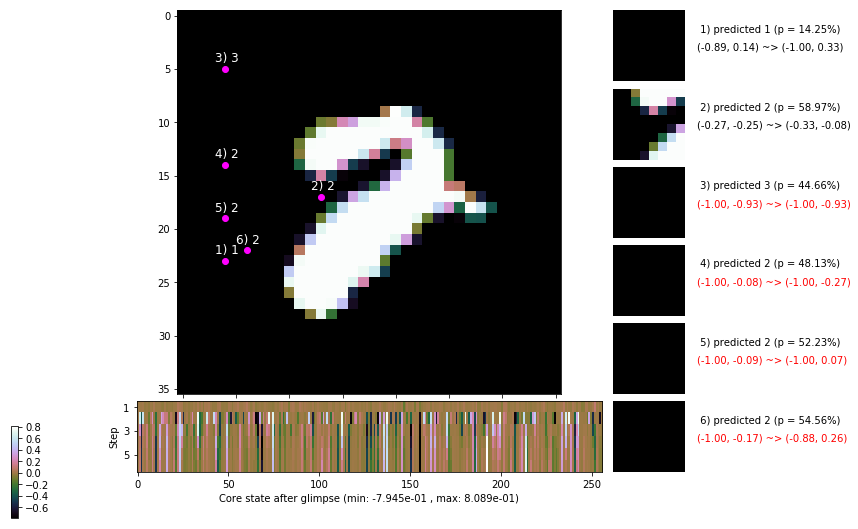

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 148.6 ms/b | lr: 4.73e-04 | grad 2norm: 11.21 | grad inf norm:  3.167
         Weights || abs max:  3.68 ( 5609.80) | mean: -8.48e-04 ( 0.02) | var: 7.72e-02 ( 1834.62)
          Biases || abs max:  1.25 (  310.55) | mean: -1.34e-01 ( 0.19) | var: 8.99e-02 ( 3426.15)
                    class loss: 0.490 | steps: 2.388 | reward:  4.079 | acc.: 83.57%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 147.5 ms/b | lr: 4.73e-04 | grad 2norm: 11.09 | grad inf norm:  3.211
         Weights || abs max:  3.68 ( 2809.49) | mean: -8.45e-04 ( 0.01) | var: 7.72e-02 (  360.22)
          Biases || abs max:  1.26 (  112.90) | mean: -1.33e-01 ( 0.12) | var: 8.99e-02 (   56.82)
                    class loss: 0.476 | steps: 2.393 | reward:  4.066 | acc.: 83.78%

	Target class: 4 | Discounted rewards: [0.044, 0.287, 0.7

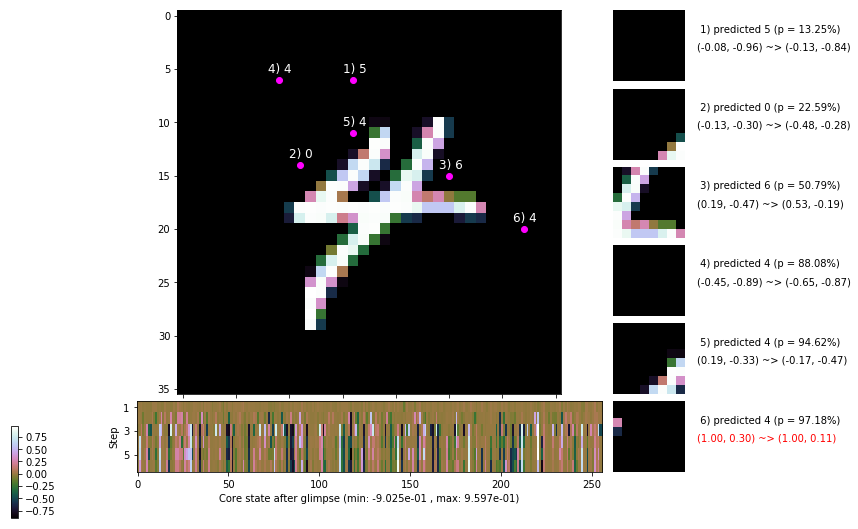

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


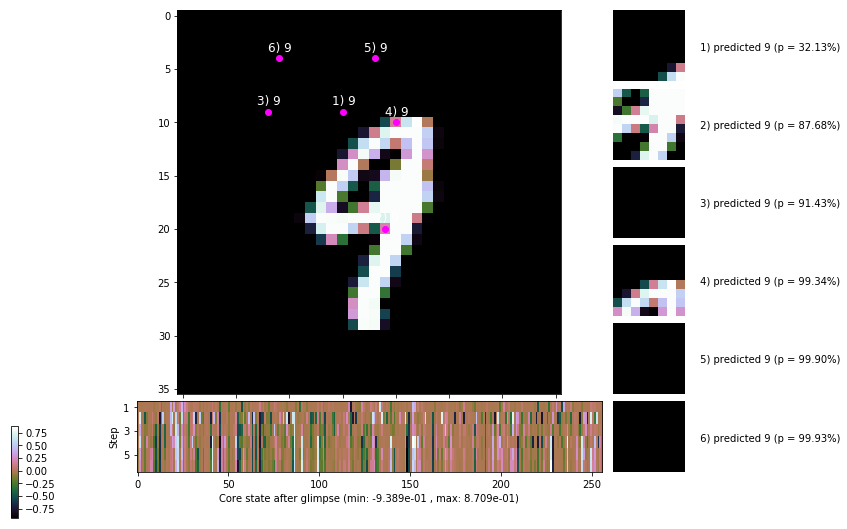


	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


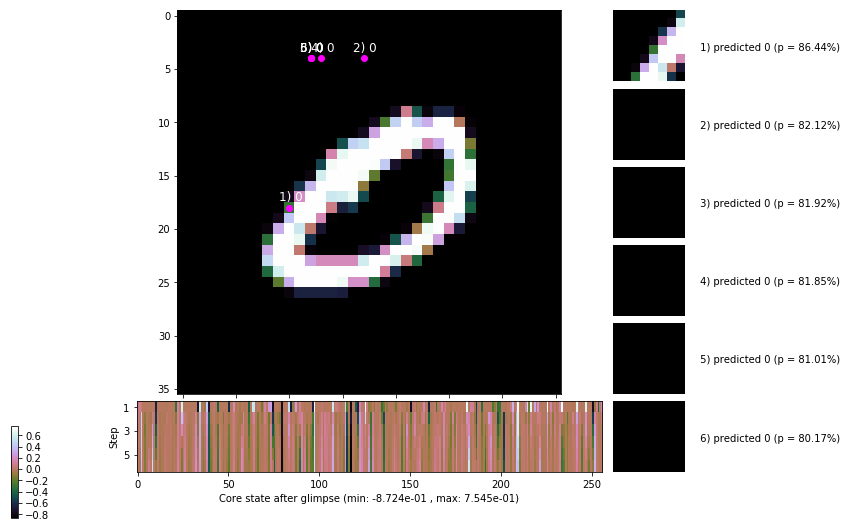

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


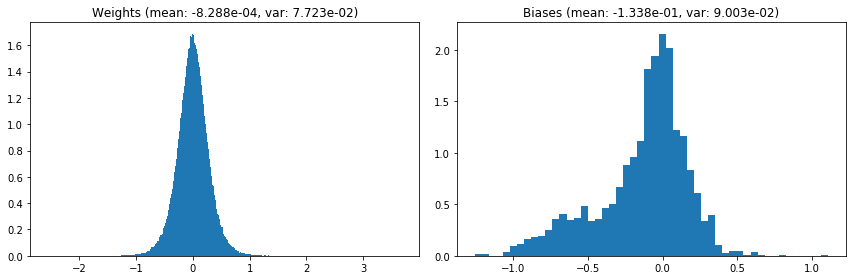

                                      Location network weights and biases


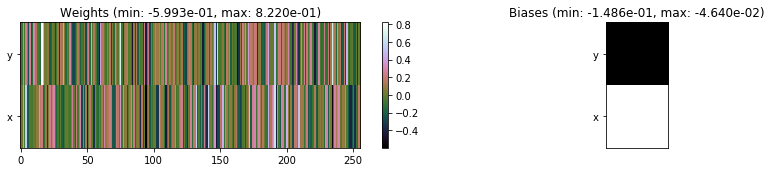

---------------------------------------------------------------------------------------------------------------
Elapsed time:  435.13 sec | TRAIN >> class loss: 0.4813 | steps:  2.381 :( | reward:  4.0701 :( | acc.: 83.630% :(
                          | VAL   >> class loss: 0.4943 | steps:  2.273    | reward:  4.1907 :( | acc.: 83.140% :(


Epoch  51/400) lr = 0.0004722
 b    300/  3000 >> 144.3 ms/b | lr: 4.72e-04 | grad 2norm: 10.94 | grad inf norm:  3.103
         Weights || abs max:  3.68 ( 4544.00) | mean: -8.18e-04 ( 0.02) | var: 7.73e-02 ( 1302.60)
          Biases || abs max:  1.25 (  157.94) | mean: -1.34e-01 ( 0.14) | var: 9.02e-02 (   88.26)
                    class loss: 0.484 | steps: 2.381 | reward:  4.093 | acc.: 83.97%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.5 ms/b | lr: 4.71e-04 | grad 2norm: 10.99 | grad inf norm:  3.264
         Weights || abs max:  3.67 ( 2934.54) | mean: -8.13e-04 (

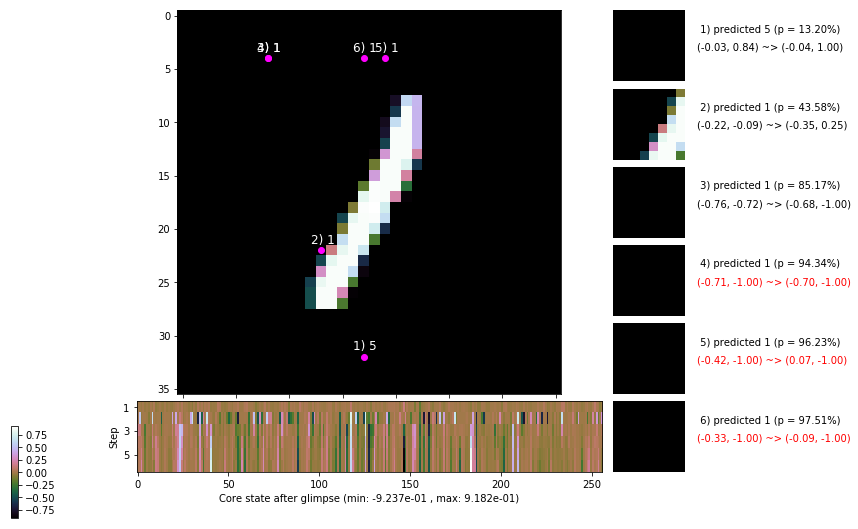

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.0 ms/b | lr: 4.70e-04 | grad 2norm: 11.34 | grad inf norm:  3.238
         Weights || abs max:  3.67 ( 5515.58) | mean: -8.27e-04 ( 0.02) | var: 7.74e-02 ( 3098.27)
          Biases || abs max:  1.25 (   49.83) | mean: -1.34e-01 ( 0.08) | var: 9.05e-02 (    7.10)
                    class loss: 0.494 | steps: 2.408 | reward:  4.039 | acc.: 83.13%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 140.5 ms/b | lr: 4.70e-04 | grad 2norm: 11.09 | grad inf norm:  3.084
         Weights || abs max:  3.67 (10207.57) | mean: -8.41e-04 ( 0.03) | var: 7.74e-02 (18418.54)
          Biases || abs max:  1.25 (  120.96) | mean: -1.34e-01 ( 0.13) | var: 9.05e-02 (  343.48)
                    class loss: 0.496 | steps: 2.388 | reward:  4.066 | acc.: 83.07%

	Target class: 4 | Discounted rewards: [0.869, 1.938, 1.8

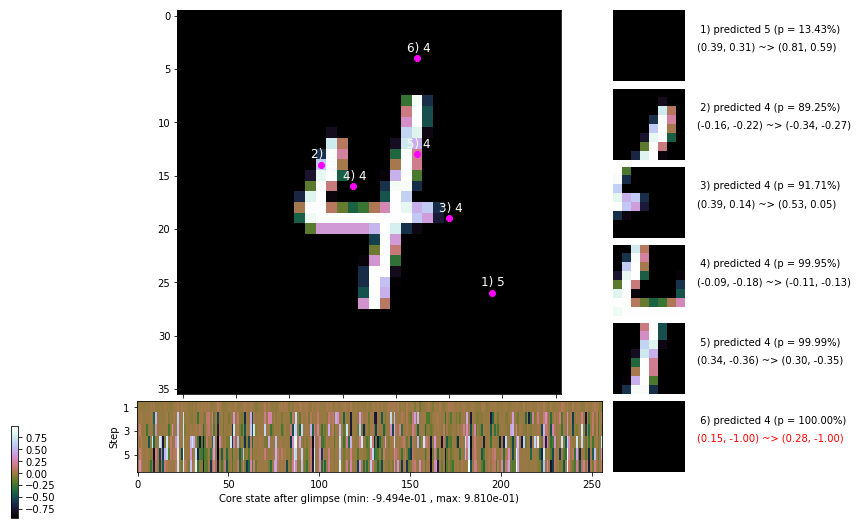

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 139.8 ms/b | lr: 4.69e-04 | grad 2norm: 10.99 | grad inf norm:  3.038
         Weights || abs max:  3.67 ( 3239.51) | mean: -8.46e-04 ( 0.01) | var: 7.75e-02 (  434.80)
          Biases || abs max:  1.25 (   90.76) | mean: -1.34e-01 ( 0.10) | var: 9.05e-02 (   50.81)
                    class loss: 0.455 | steps: 2.334 | reward:  4.130 | acc.: 84.28%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.7 ms/b | lr: 4.68e-04 | grad 2norm: 11.23 | grad inf norm:  3.199
         Weights || abs max:  3.68 ( 2798.64) | mean: -8.38e-04 ( 0.01) | var: 7.75e-02 (  464.11)
          Biases || abs max:  1.26 (  308.15) | mean: -1.34e-01 ( 0.24) | var: 9.07e-02 ( 2676.12)
                    class loss: 0.479 | steps: 2.354 | reward:  4.097 | acc.: 83.72%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

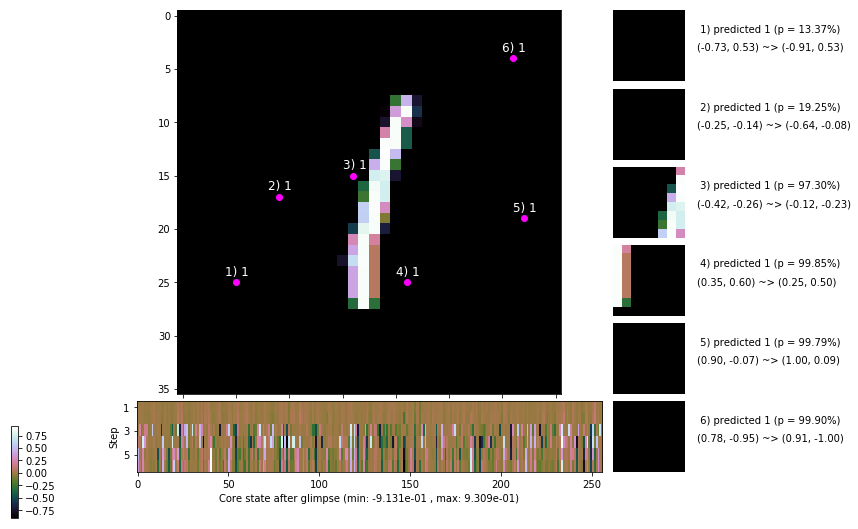

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.8 ms/b | lr: 4.67e-04 | grad 2norm: 10.92 | grad inf norm:  3.201
         Weights || abs max:  3.68 ( 4638.49) | mean: -8.16e-04 ( 0.02) | var: 7.76e-02 (  537.37)
          Biases || abs max:  1.25 (  855.48) | mean: -1.34e-01 ( 0.42) | var: 9.07e-02 (55521.98)
                    class loss: 0.465 | steps: 2.342 | reward:  4.119 | acc.: 84.35%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.6 ms/b | lr: 4.67e-04 | grad 2norm: 11.29 | grad inf norm:  3.253
         Weights || abs max:  3.68 ( 4046.65) | mean: -8.08e-04 ( 0.02) | var: 7.76e-02 (  661.07)
          Biases || abs max:  1.25 (  160.92) | mean: -1.34e-01 ( 0.15) | var: 9.08e-02 (  149.38)
                    class loss: 0.497 | steps: 2.385 | reward:  4.043 | acc.: 82.75%

	Target class: 3 | Discounted rewards: [0.869, 1.938, 1.8

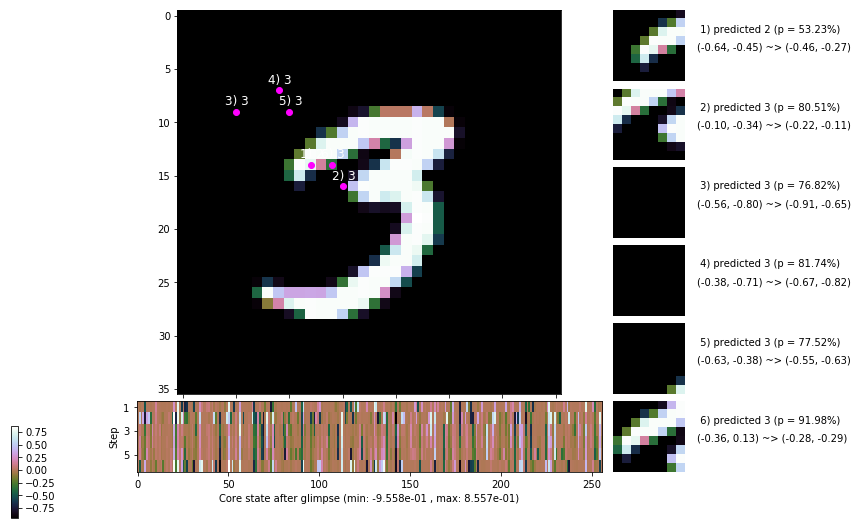

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 146.2 ms/b | lr: 4.66e-04 | grad 2norm: 11.21 | grad inf norm:  3.256
         Weights || abs max:  3.68 ( 2891.97) | mean: -8.27e-04 ( 0.01) | var: 7.77e-02 (  684.85)
          Biases || abs max:  1.25 (  420.71) | mean: -1.34e-01 ( 0.25) | var: 9.08e-02 ( 3349.65)
                    class loss: 0.493 | steps: 2.388 | reward:  4.052 | acc.: 83.08%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.6 ms/b | lr: 4.66e-04 | grad 2norm: 11.10 | grad inf norm:  3.130
         Weights || abs max:  3.69 ( 3041.13) | mean: -8.26e-04 ( 0.01) | var: 7.77e-02 (  181.46)
          Biases || abs max:  1.26 (  106.68) | mean: -1.34e-01 ( 0.11) | var: 9.10e-02 (  148.53)
                    class loss: 0.471 | steps: 2.367 | reward:  4.099 | acc.: 83.98%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

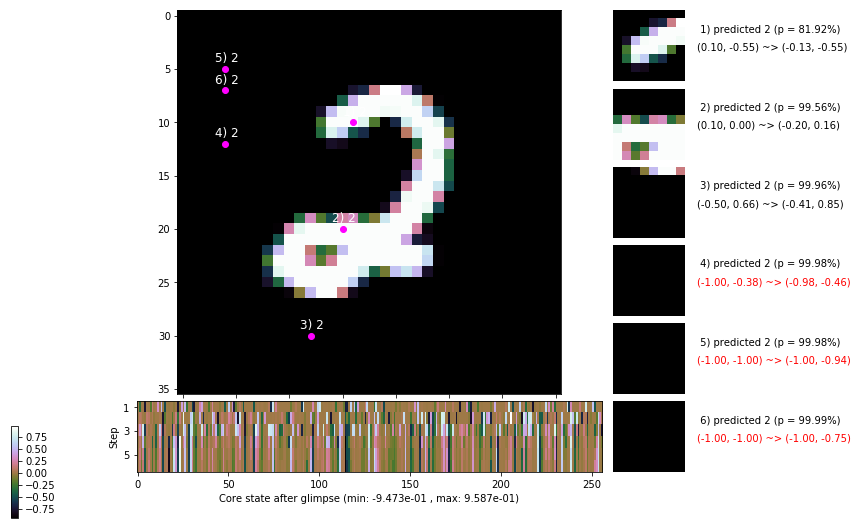

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [0.766, 1.731, 1.462, 0.925, -0.150, -0.100]


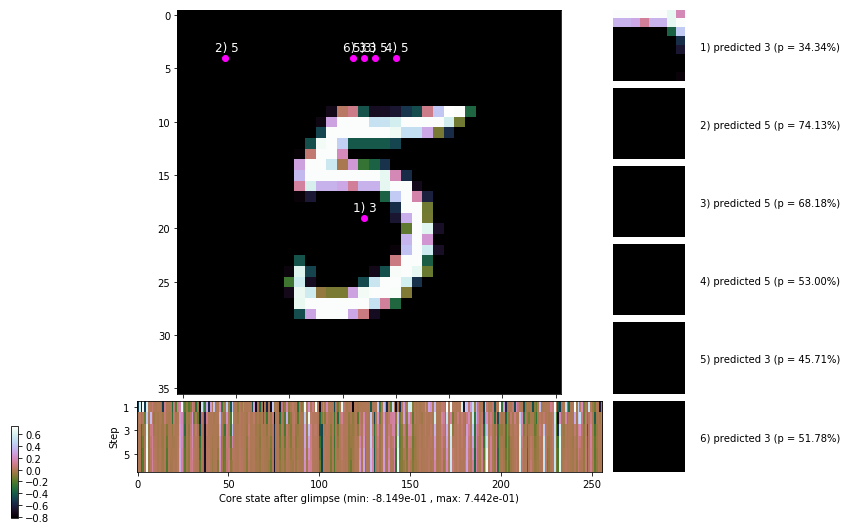


	Target class: 6 | Discounted rewards: [-0.094, 0.012, 0.225, 0.650, 1.500, 1.000]


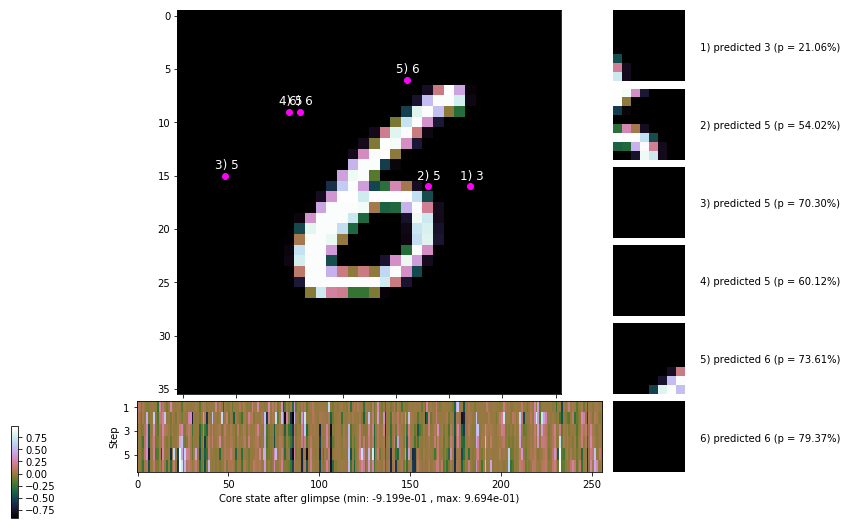

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


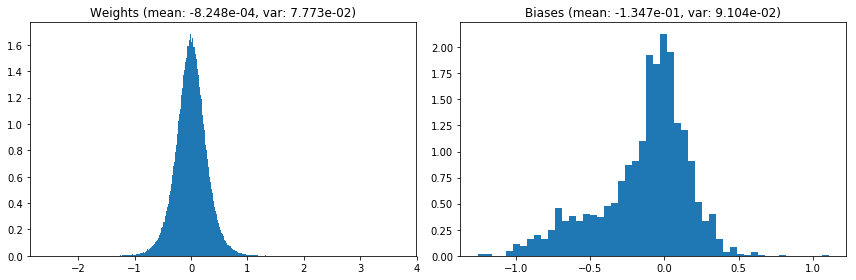

                                      Location network weights and biases


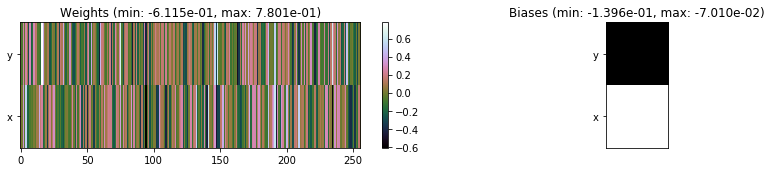

---------------------------------------------------------------------------------------------------------------
Elapsed time:  427.93 sec | TRAIN >> class loss: 0.4812 | steps:  2.370 :( | reward:  4.0829 :( | acc.: 83.582% :(
                          | VAL   >> class loss: 0.4753 | steps:  2.302 :( | reward:  4.1661 :( | acc.: 83.600% :(


Epoch  52/400) lr = 0.0004652
 b    300/  3000 >> 146.4 ms/b | lr: 4.65e-04 | grad 2norm: 10.85 | grad inf norm:  3.071
         Weights || abs max:  3.68 ( 4566.02) | mean: -8.29e-04 ( 0.02) | var: 7.78e-02 ( 1543.84)
          Biases || abs max:  1.26 (  205.38) | mean: -1.34e-01 ( 0.17) | var: 9.09e-02 (  302.80)
                    class loss: 0.456 | steps: 2.358 | reward:  4.115 | acc.: 84.27%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.9 ms/b | lr: 4.64e-04 | grad 2norm: 11.26 | grad inf norm:  3.210
         Weights || abs max:  3.69 ( 3365.96) | mean: -8.31e-04 (

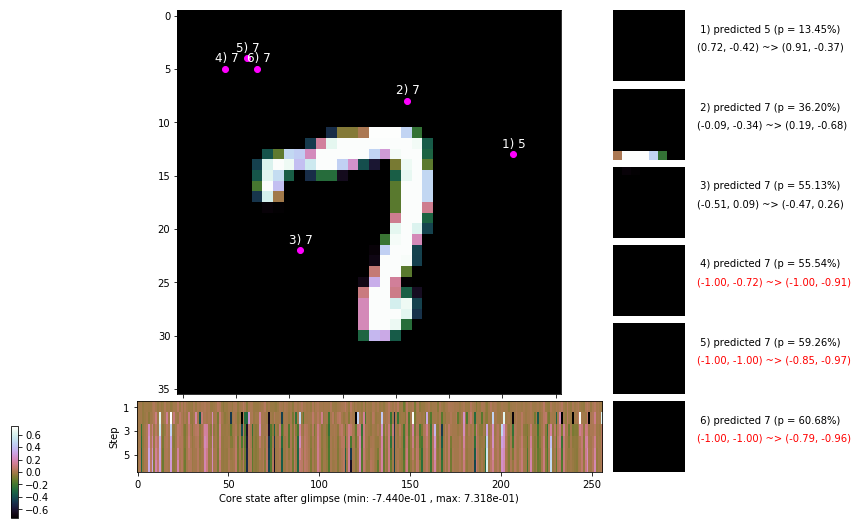

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 148.3 ms/b | lr: 4.63e-04 | grad 2norm: 11.30 | grad inf norm:  3.170
         Weights || abs max:  3.70 (14881.95) | mean: -8.27e-04 ( 0.03) | var: 7.79e-02 (81713.03)
          Biases || abs max:  1.25 (  208.38) | mean: -1.34e-01 ( 0.16) | var: 9.07e-02 (  384.95)
                    class loss: 0.483 | steps: 2.374 | reward:  4.070 | acc.: 83.50%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 144.4 ms/b | lr: 4.63e-04 | grad 2norm: 11.12 | grad inf norm:  3.180
         Weights || abs max:  3.70 ( 2135.60) | mean: -8.28e-04 ( 0.01) | var: 7.79e-02 (   84.29)
          Biases || abs max:  1.26 (   88.45) | mean: -1.35e-01 ( 0.10) | var: 9.06e-02 (   60.31)
                    class loss: 0.463 | steps: 2.362 | reward:  4.089 | acc.: 84.07%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.8

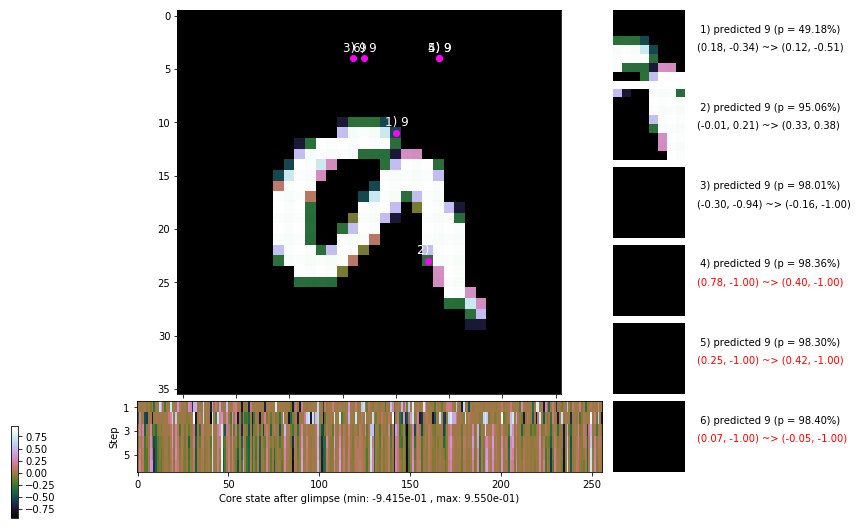

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 148.6 ms/b | lr: 4.62e-04 | grad 2norm: 11.28 | grad inf norm:  3.366
         Weights || abs max:  3.70 ( 4380.64) | mean: -8.30e-04 ( 0.02) | var: 7.80e-02 ( 2862.36)
          Biases || abs max:  1.26 (  131.01) | mean: -1.35e-01 ( 0.12) | var: 9.08e-02 (   59.88)
                    class loss: 0.491 | steps: 2.377 | reward:  4.059 | acc.: 83.47%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.8 ms/b | lr: 4.61e-04 | grad 2norm: 11.29 | grad inf norm:  3.336
         Weights || abs max:  3.70 ( 8478.35) | mean: -8.16e-04 ( 0.02) | var: 7.80e-02 ( 8063.48)
          Biases || abs max:  1.26 (  151.59) | mean: -1.35e-01 ( 0.12) | var: 9.08e-02 (  166.07)
                    class loss: 0.502 | steps: 2.371 | reward:  4.065 | acc.: 83.28%

	Target class: 1 | Discounted rewards: [0.869, 1.938, 1.8

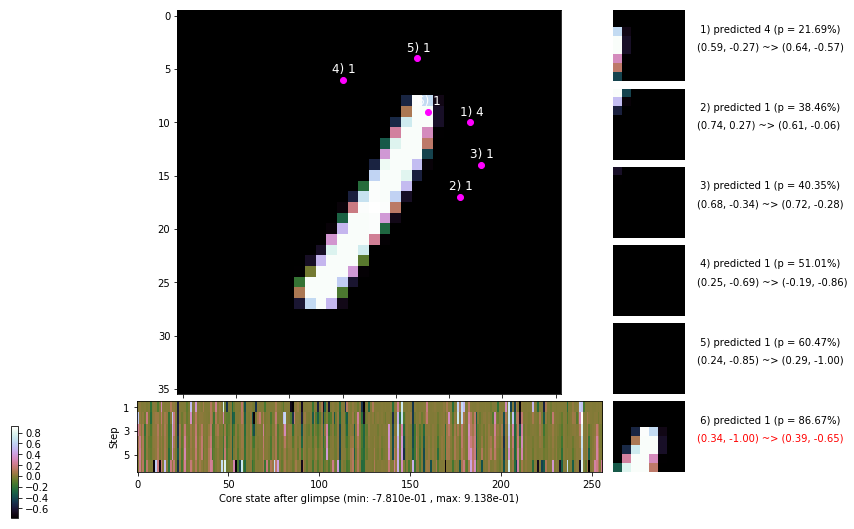

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.0 ms/b | lr: 4.61e-04 | grad 2norm: 11.26 | grad inf norm:  3.203
         Weights || abs max:  3.71 ( 3035.50) | mean: -8.11e-04 ( 0.01) | var: 7.81e-02 (  386.17)
          Biases || abs max:  1.25 (  126.90) | mean: -1.35e-01 ( 0.13) | var: 9.08e-02 (  110.28)
                    class loss: 0.491 | steps: 2.383 | reward:  4.054 | acc.: 83.35%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 140.4 ms/b | lr: 4.60e-04 | grad 2norm: 11.05 | grad inf norm:  3.219
         Weights || abs max:  3.70 ( 2463.10) | mean: -8.22e-04 ( 0.01) | var: 7.81e-02 (   84.97)
          Biases || abs max:  1.25 (  203.57) | mean: -1.35e-01 ( 0.17) | var: 9.09e-02 (  220.27)
                    class loss: 0.470 | steps: 2.350 | reward:  4.104 | acc.: 83.70%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

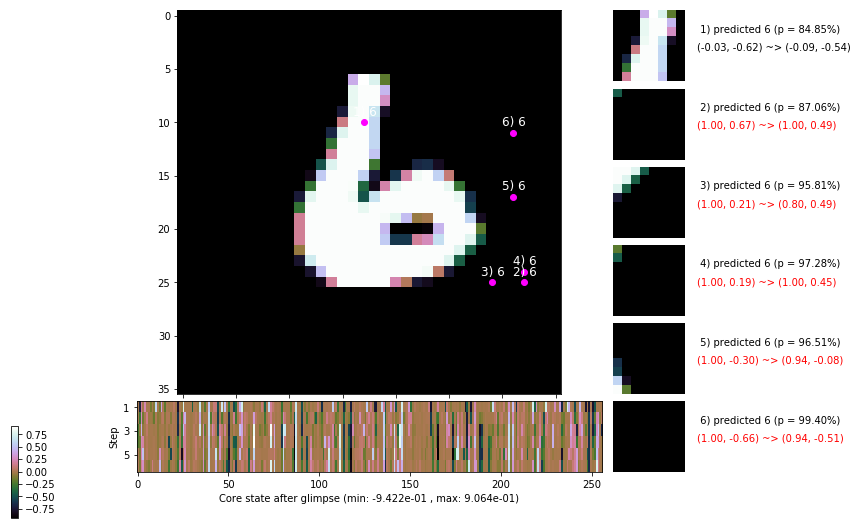

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.3 ms/b | lr: 4.59e-04 | grad 2norm: 11.20 | grad inf norm:  3.313
         Weights || abs max:  3.71 ( 3162.61) | mean: -8.33e-04 ( 0.01) | var: 7.81e-02 (  189.65)
          Biases || abs max:  1.25 (  114.48) | mean: -1.35e-01 ( 0.12) | var: 9.09e-02 (   64.21)
                    class loss: 0.467 | steps: 2.345 | reward:  4.103 | acc.: 84.08%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 139.4 ms/b | lr: 4.59e-04 | grad 2norm: 11.20 | grad inf norm:  3.210
         Weights || abs max:  3.71 ( 3412.50) | mean: -8.50e-04 ( 0.01) | var: 7.82e-02 (  222.80)
          Biases || abs max:  1.26 (  209.33) | mean: -1.35e-01 ( 0.15) | var: 9.10e-02 ( 1649.19)
                    class loss: 0.479 | steps: 2.392 | reward:  4.067 | acc.: 84.05%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.8

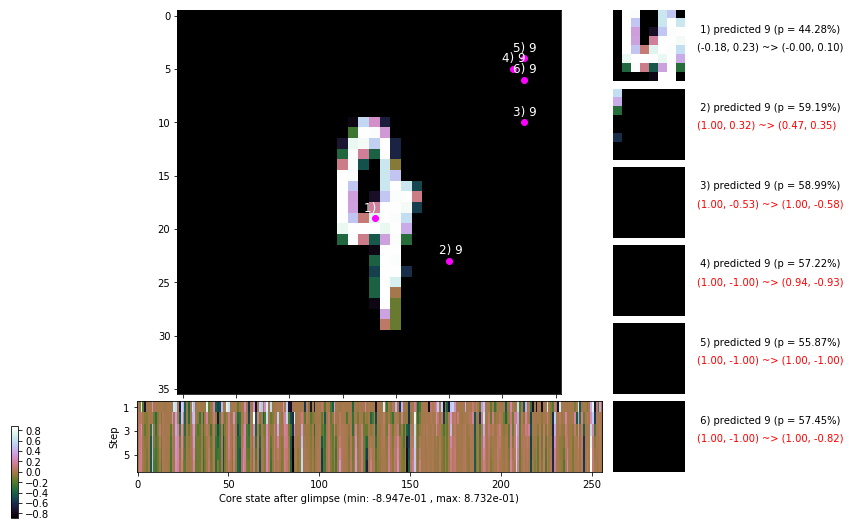

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


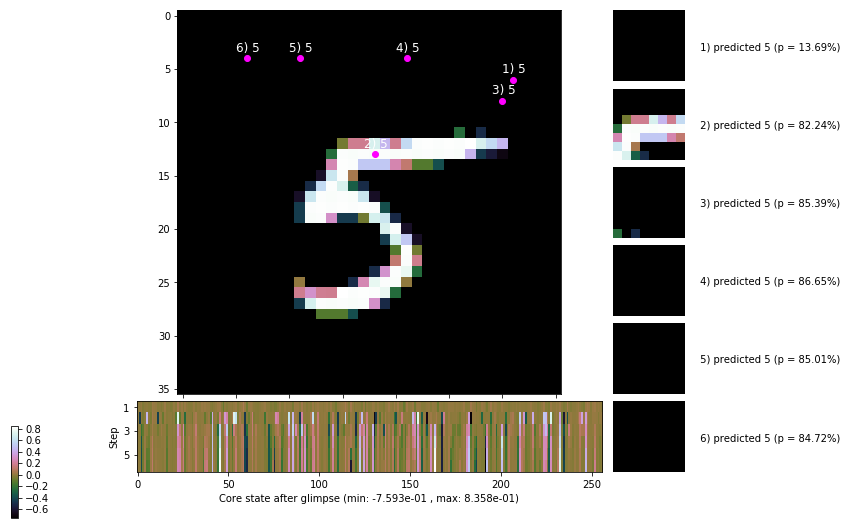


	Target class: 4 | Discounted rewards: [1.728, 1.456, 0.913, -0.175, -0.150, -0.100]


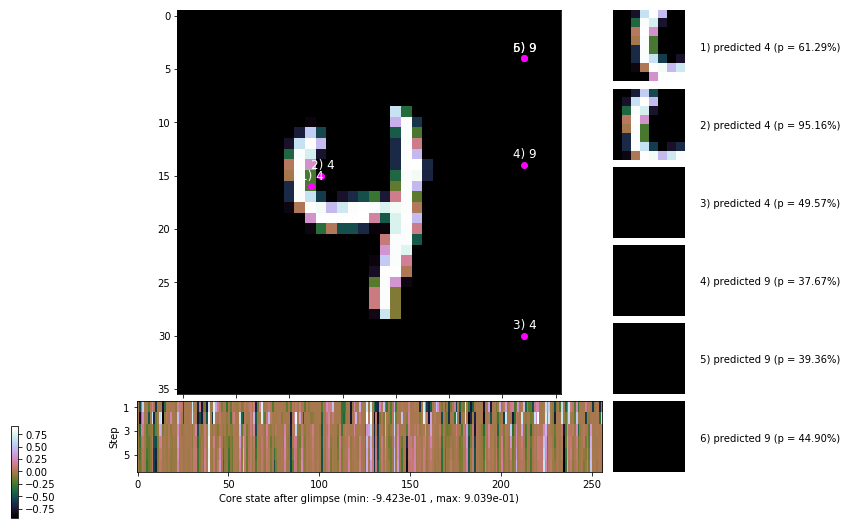

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


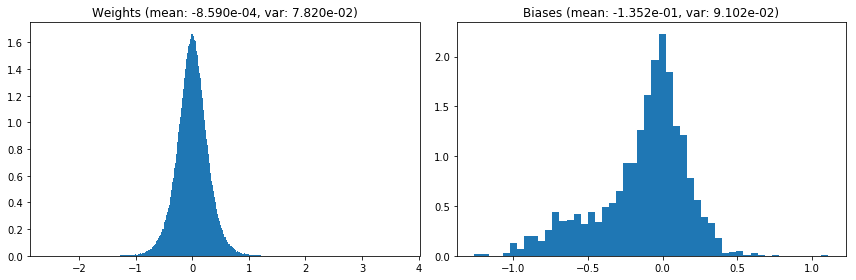

                                      Location network weights and biases


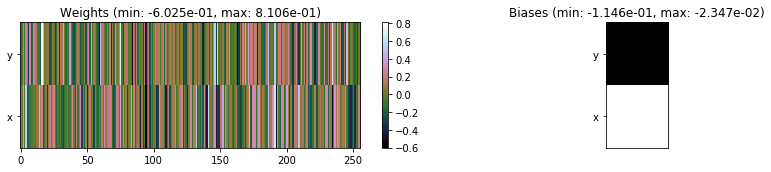

---------------------------------------------------------------------------------------------------------------
Elapsed time:  433.01 sec | TRAIN >> class loss: 0.4772 | steps:  2.365    | reward:  4.0842 :( | acc.: 83.767% :(
                          | VAL   >> class loss: 0.4487 | steps:  2.275 :( | reward:  4.2277    | acc.: 84.700% :(


Epoch  53/400) lr = 0.0004582
 b    300/  3000 >> 140.2 ms/b | lr: 4.58e-04 | grad 2norm: 11.03 | grad inf norm:  3.120
         Weights || abs max:  3.70 ( 2912.71) | mean: -8.65e-04 ( 0.01) | var: 7.82e-02 (  517.71)
          Biases || abs max:  1.26 (  243.98) | mean: -1.35e-01 ( 0.17) | var: 9.10e-02 ( 1872.20)
                    class loss: 0.474 | steps: 2.368 | reward:  4.105 | acc.: 84.33%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.2 ms/b | lr: 4.57e-04 | grad 2norm: 10.97 | grad inf norm:  3.183
         Weights || abs max:  3.71 ( 5728.57) | mean: -8.78e-04 (

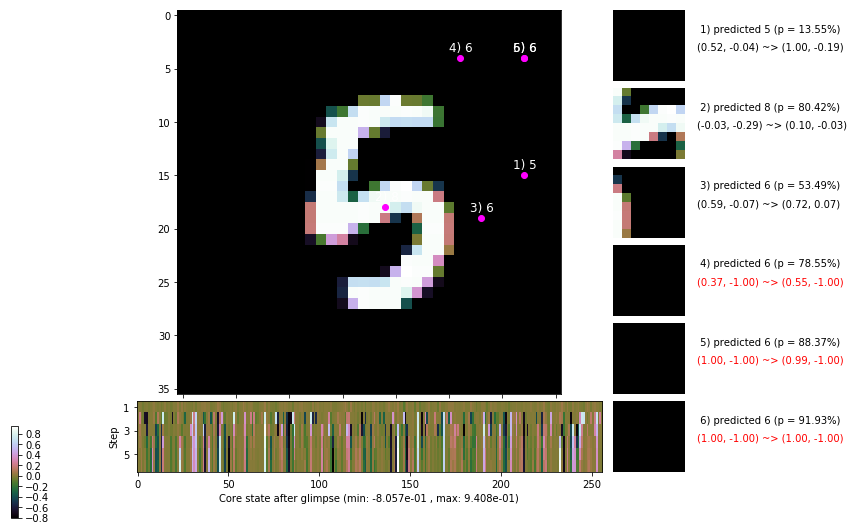

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 149.3 ms/b | lr: 4.56e-04 | grad 2norm: 11.19 | grad inf norm:  3.216
         Weights || abs max:  3.72 ( 4279.78) | mean: -9.08e-04 ( 0.02) | var: 7.83e-02 (  605.50)
          Biases || abs max:  1.27 (  191.38) | mean: -1.35e-01 ( 0.15) | var: 9.09e-02 (  448.98)
                    class loss: 0.476 | steps: 2.352 | reward:  4.120 | acc.: 83.68%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.2 ms/b | lr: 4.56e-04 | grad 2norm: 10.90 | grad inf norm:  3.184
         Weights || abs max:  3.72 ( 3246.72) | mean: -9.11e-04 ( 0.01) | var: 7.84e-02 (  413.20)
          Biases || abs max:  1.28 (  106.17) | mean: -1.35e-01 ( 0.12) | var: 9.10e-02 (   26.13)
                    class loss: 0.459 | steps: 2.324 | reward:  4.146 | acc.: 84.93%

	Target class: 6 | Discounted rewards: [0.869, 1.938, 1.8

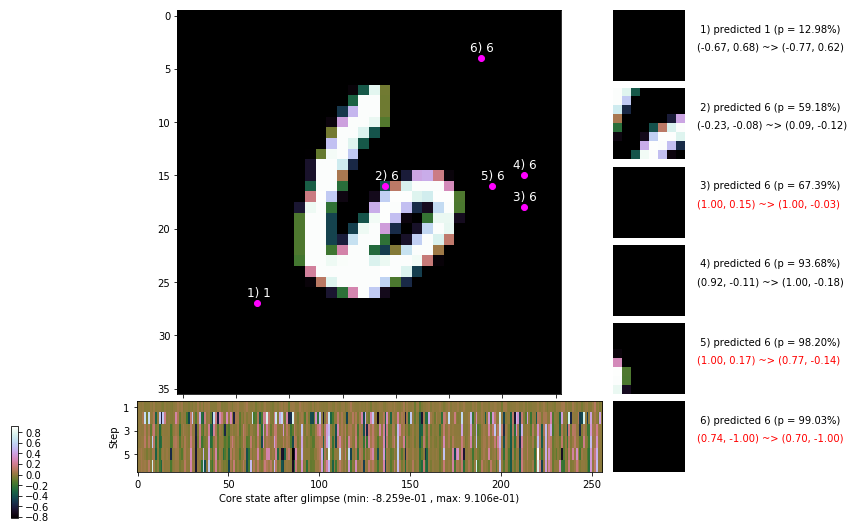

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 150.3 ms/b | lr: 4.55e-04 | grad 2norm: 11.20 | grad inf norm:  3.235
         Weights || abs max:  3.73 ( 3373.50) | mean: -9.27e-04 ( 0.01) | var: 7.84e-02 (  381.50)
          Biases || abs max:  1.29 (  149.22) | mean: -1.35e-01 ( 0.15) | var: 9.10e-02 (  274.64)
                    class loss: 0.451 | steps: 2.335 | reward:  4.127 | acc.: 84.52%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 146.5 ms/b | lr: 4.55e-04 | grad 2norm: 11.08 | grad inf norm:  3.154
         Weights || abs max:  3.73 ( 3099.08) | mean: -9.46e-04 ( 0.01) | var: 7.85e-02 (  384.43)
          Biases || abs max:  1.29 (  384.30) | mean: -1.35e-01 ( 0.22) | var: 9.10e-02 ( 6362.09)
                    class loss: 0.458 | steps: 2.360 | reward:  4.119 | acc.: 84.60%

	Target class: 9 | Discounted rewards: [0.319, 0.837, 1.8

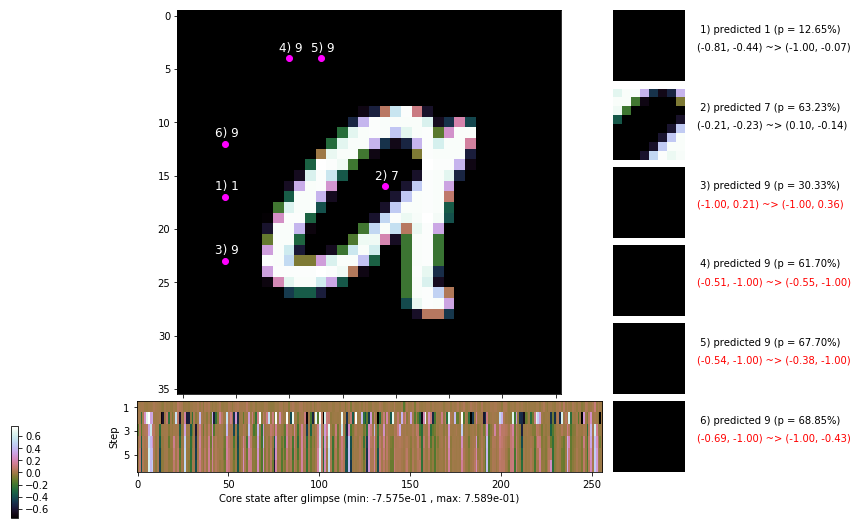

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 148.2 ms/b | lr: 4.54e-04 | grad 2norm: 11.01 | grad inf norm:  3.213
         Weights || abs max:  3.73 ( 7402.21) | mean: -9.55e-04 ( 0.02) | var: 7.85e-02 ( 4820.69)
          Biases || abs max:  1.29 (  143.51) | mean: -1.35e-01 ( 0.12) | var: 9.10e-02 (  103.31)
                    class loss: 0.445 | steps: 2.345 | reward:  4.132 | acc.: 84.32%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 144.8 ms/b | lr: 4.53e-04 | grad 2norm: 11.04 | grad inf norm:  3.251
         Weights || abs max:  3.73 ( 1538.01) | mean: -9.65e-04 ( 0.01) | var: 7.86e-02 (   23.28)
          Biases || abs max:  1.29 (  276.12) | mean: -1.35e-01 ( 0.17) | var: 9.12e-02 ( 3105.76)
                    class loss: 0.474 | steps: 2.375 | reward:  4.086 | acc.: 84.12%

	Target class: 2 | Discounted rewards: [0.903, -0.194, -0

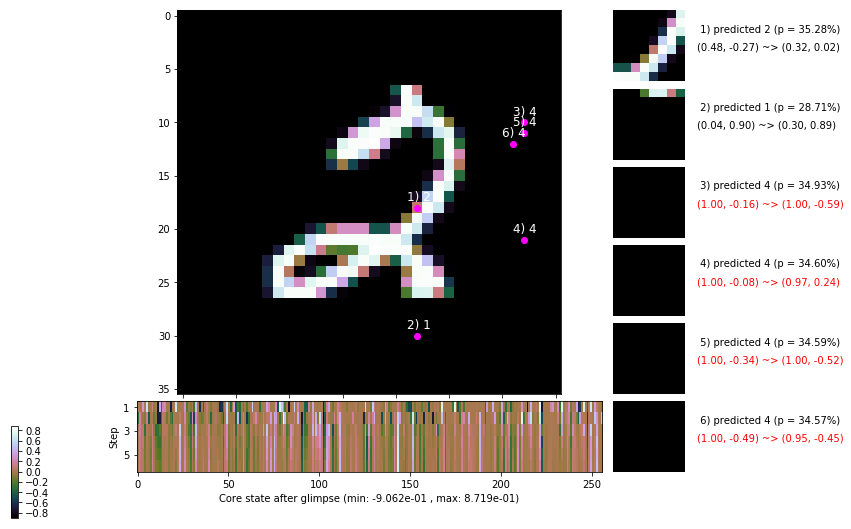

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.1 ms/b | lr: 4.52e-04 | grad 2norm: 11.27 | grad inf norm:  3.286
         Weights || abs max:  3.74 ( 2345.10) | mean: -9.73e-04 ( 0.01) | var: 7.86e-02 (  156.03)
          Biases || abs max:  1.28 (  197.43) | mean: -1.35e-01 ( 0.14) | var: 9.13e-02 (  472.81)
                    class loss: 0.479 | steps: 2.373 | reward:  4.092 | acc.: 83.60%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.6 ms/b | lr: 4.52e-04 | grad 2norm: 10.98 | grad inf norm:  3.238
         Weights || abs max:  3.74 ( 3214.97) | mean: -9.83e-04 ( 0.01) | var: 7.87e-02 (  229.42)
          Biases || abs max:  1.28 (   80.40) | mean: -1.34e-01 ( 0.10) | var: 9.11e-02 (   20.14)
                    class loss: 0.461 | steps: 2.335 | reward:  4.138 | acc.: 84.42%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

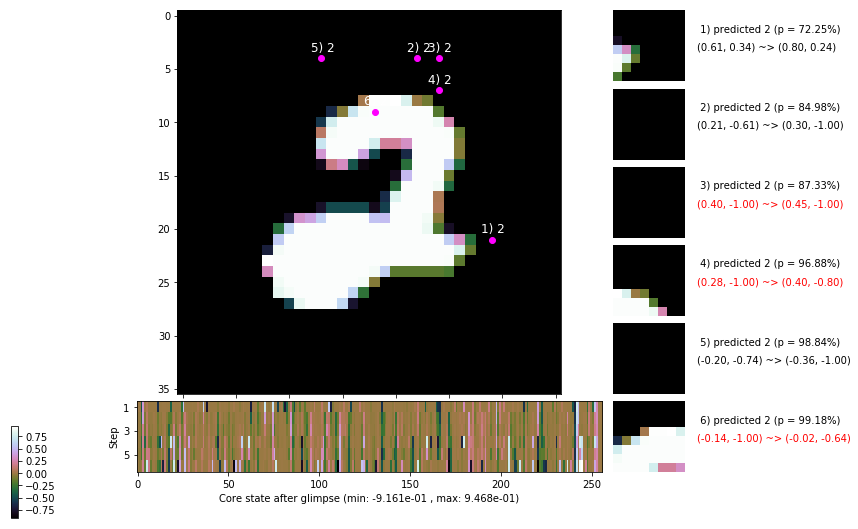

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.319, 0.837, 1.875, 1.750, 1.500, 1.000]


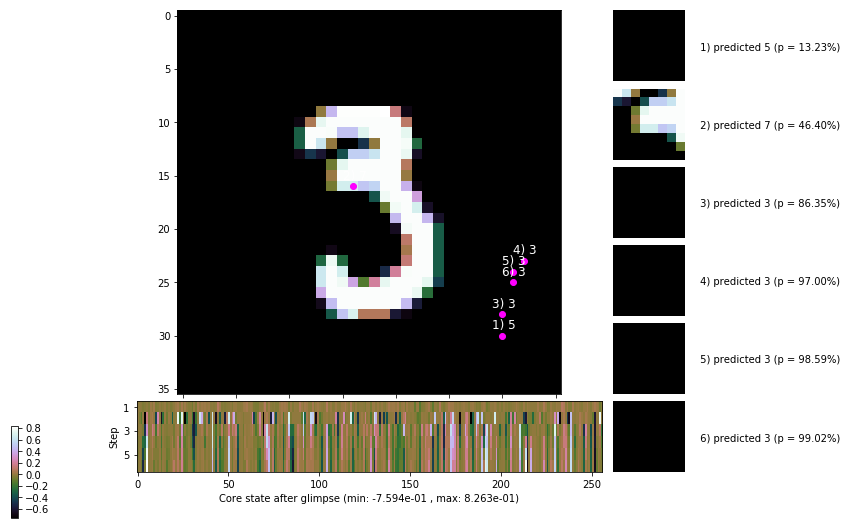


	Target class: 8 | Discounted rewards: [0.456, 1.112, 0.225, 0.650, 1.500, 1.000]


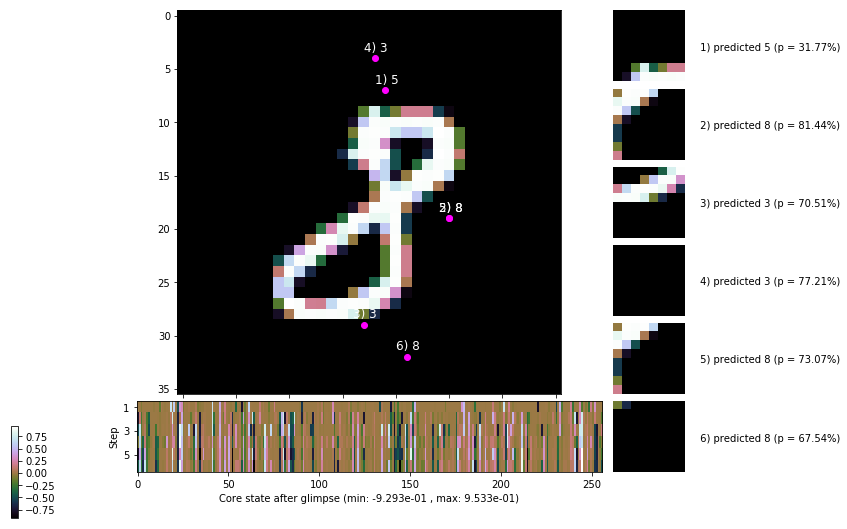

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


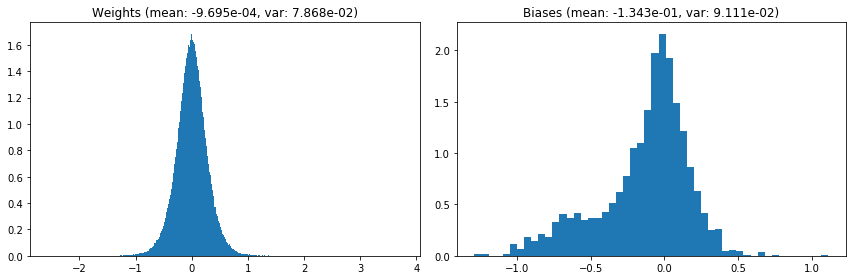

                                      Location network weights and biases


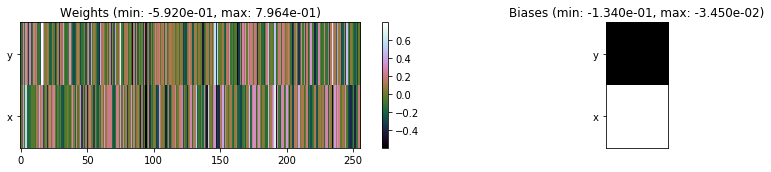

---------------------------------------------------------------------------------------------------------------
Elapsed time:  435.24 sec | TRAIN >> class loss: 0.4636 | steps:  2.347    | reward:  4.1227    | acc.: 84.340% :(
                          | VAL   >> class loss: 0.4710 | steps:  2.266    | reward:  4.1874 :( | acc.: 83.520% :(


Epoch  54/400) lr = 0.0004514
 b    300/  3000 >> 140.0 ms/b | lr: 4.51e-04 | grad 2norm: 11.19 | grad inf norm:  3.239
         Weights || abs max:  3.74 ( 3492.30) | mean: -9.56e-04 ( 0.02) | var: 7.87e-02 (  207.01)
          Biases || abs max:  1.28 (  163.27) | mean: -1.35e-01 ( 0.12) | var: 9.13e-02 (  685.10)
                    class loss: 0.496 | steps: 2.369 | reward:  4.083 | acc.: 83.68%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.5 ms/b | lr: 4.50e-04 | grad 2norm: 10.94 | grad inf norm:  3.190
         Weights || abs max:  3.73 ( 5540.83) | mean: -9.46e-04 (

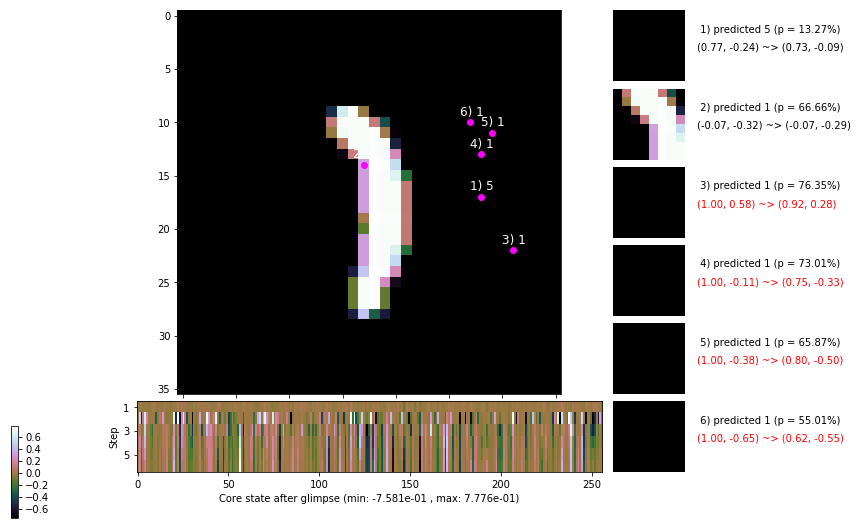

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.8 ms/b | lr: 4.50e-04 | grad 2norm: 11.09 | grad inf norm:  3.200
         Weights || abs max:  3.73 ( 7520.48) | mean: -9.72e-04 ( 0.02) | var: 7.88e-02 ( 4855.39)
          Biases || abs max:  1.27 (  642.92) | mean: -1.34e-01 ( 0.32) | var: 9.15e-02 (30061.23)
                    class loss: 0.450 | steps: 2.337 | reward:  4.147 | acc.: 84.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.4 ms/b | lr: 4.49e-04 | grad 2norm: 10.99 | grad inf norm:  3.246
         Weights || abs max:  3.73 ( 8630.08) | mean: -9.85e-04 ( 0.02) | var: 7.88e-02 ( 7194.25)
          Biases || abs max:  1.27 (  129.13) | mean: -1.35e-01 ( 0.11) | var: 9.15e-02 (  110.87)
                    class loss: 0.457 | steps: 2.350 | reward:  4.135 | acc.: 84.53%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

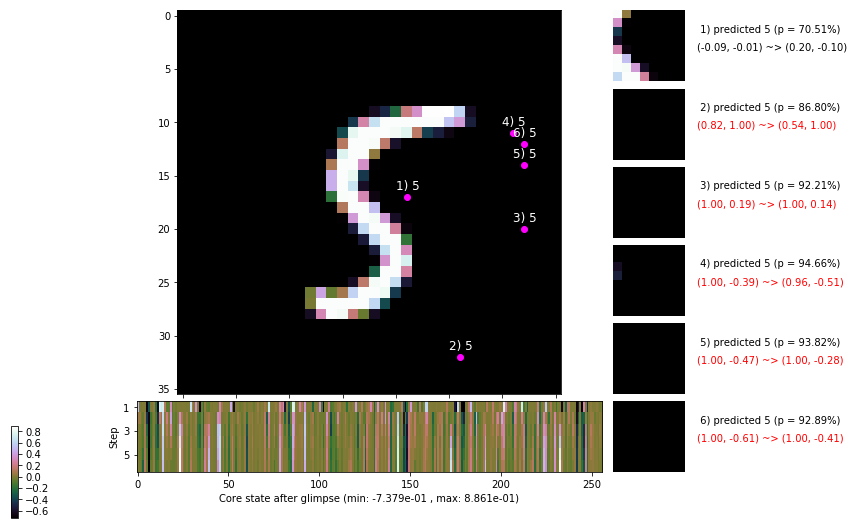

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.5 ms/b | lr: 4.48e-04 | grad 2norm: 11.00 | grad inf norm:  3.172
         Weights || abs max:  3.74 ( 2401.96) | mean: -9.64e-04 ( 0.01) | var: 7.89e-02 (  105.55)
          Biases || abs max:  1.28 (  210.34) | mean: -1.35e-01 ( 0.15) | var: 9.16e-02 (  989.36)
                    class loss: 0.472 | steps: 2.362 | reward:  4.101 | acc.: 83.85%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 148.8 ms/b | lr: 4.48e-04 | grad 2norm: 11.12 | grad inf norm:  3.254
         Weights || abs max:  3.75 ( 4678.75) | mean: -9.55e-04 ( 0.02) | var: 7.89e-02 ( 4228.43)
          Biases || abs max:  1.28 (  440.00) | mean: -1.36e-01 ( 0.26) | var: 9.18e-02 ( 7373.70)
                    class loss: 0.480 | steps: 2.363 | reward:  4.096 | acc.: 83.88%

	Target class: 2 | Discounted rewards: [1.453, 0.906, -0.

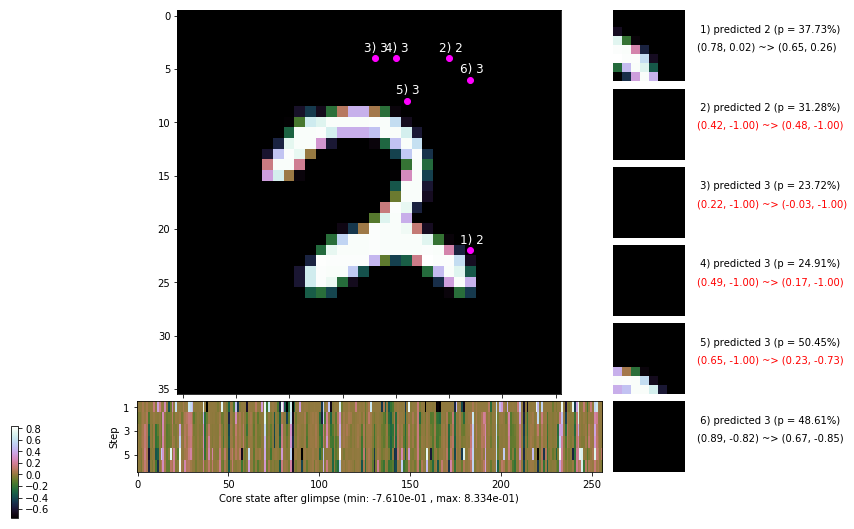

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.5 ms/b | lr: 4.47e-04 | grad 2norm: 11.10 | grad inf norm:  3.235
         Weights || abs max:  3.75 ( 3606.08) | mean: -9.46e-04 ( 0.01) | var: 7.89e-02 ( 1226.72)
          Biases || abs max:  1.28 (  255.10) | mean: -1.35e-01 ( 0.17) | var: 9.17e-02 ( 1180.04)
                    class loss: 0.468 | steps: 2.366 | reward:  4.099 | acc.: 84.17%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 143.6 ms/b | lr: 4.46e-04 | grad 2norm: 11.31 | grad inf norm:  3.245
         Weights || abs max:  3.75 (11490.30) | mean: -9.45e-04 ( 0.03) | var: 7.90e-02 (31237.72)
          Biases || abs max:  1.29 (  284.90) | mean: -1.35e-01 ( 0.24) | var: 9.17e-02 ( 5117.87)
                    class loss: 0.486 | steps: 2.380 | reward:  4.071 | acc.: 83.50%

	Target class: 3 | Discounted rewards: [0.869, 1.938, 1.8

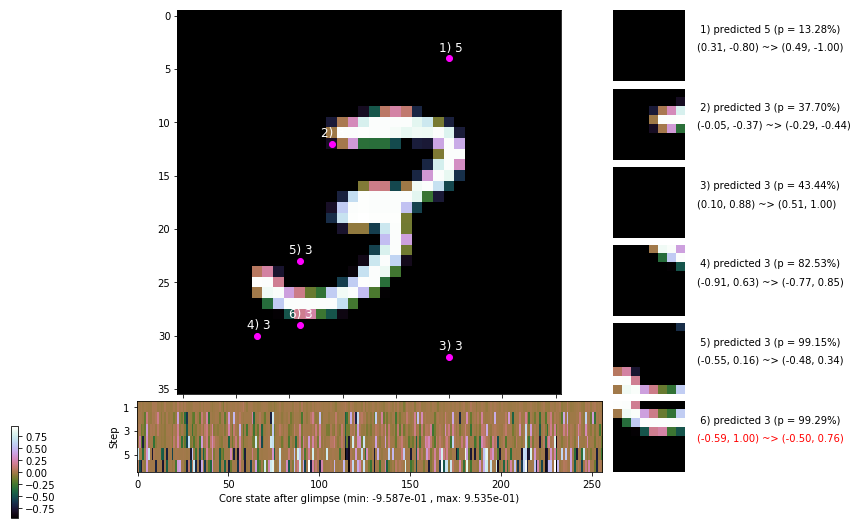

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 151.3 ms/b | lr: 4.46e-04 | grad 2norm: 11.04 | grad inf norm:  3.305
         Weights || abs max:  3.77 ( 3255.60) | mean: -9.45e-04 ( 0.01) | var: 7.90e-02 (  235.91)
          Biases || abs max:  1.29 (  163.79) | mean: -1.36e-01 ( 0.16) | var: 9.17e-02 (  173.77)
                    class loss: 0.492 | steps: 2.377 | reward:  4.060 | acc.: 83.48%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.5 ms/b | lr: 4.45e-04 | grad 2norm: 10.96 | grad inf norm:  3.203
         Weights || abs max:  3.78 ( 2875.37) | mean: -9.43e-04 ( 0.01) | var: 7.91e-02 (  135.04)
          Biases || abs max:  1.29 (  120.91) | mean: -1.36e-01 ( 0.12) | var: 9.19e-02 (  108.24)
                    class loss: 0.474 | steps: 2.374 | reward:  4.089 | acc.: 84.13%

	Target class: 0 | Discounted rewards: [0.044, 0.287, 0.7

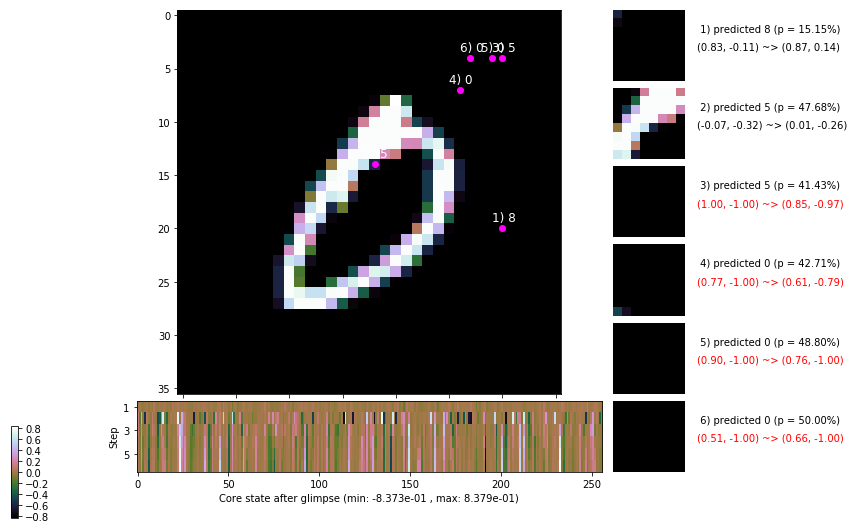

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


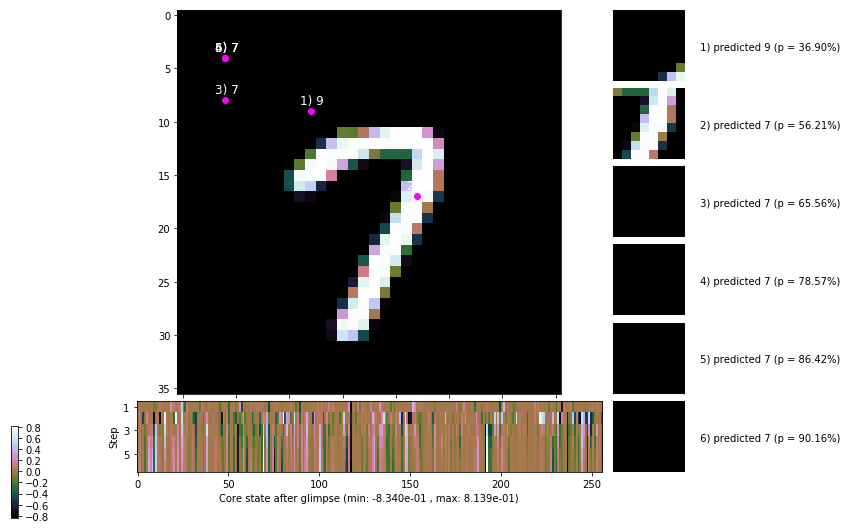


	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


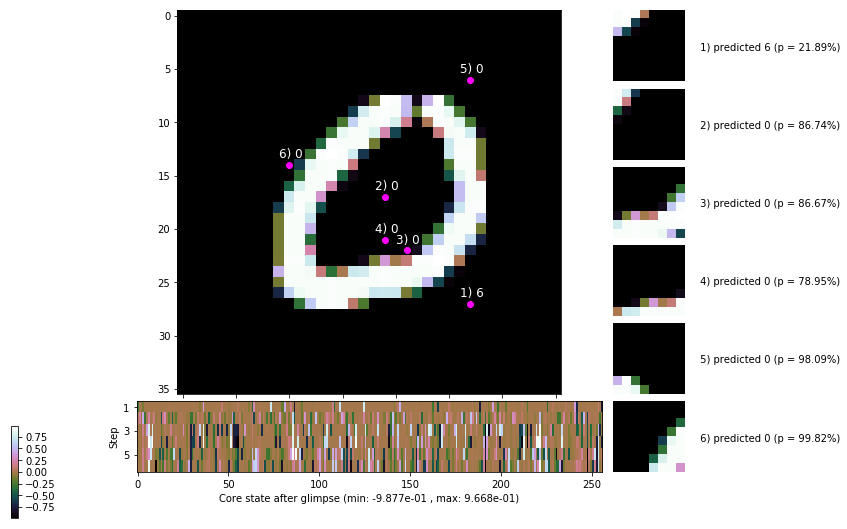

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


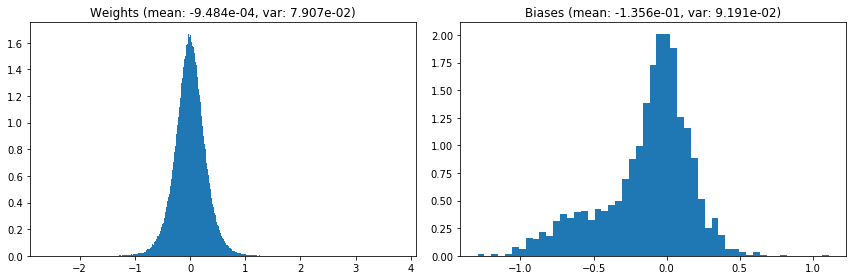

                                      Location network weights and biases


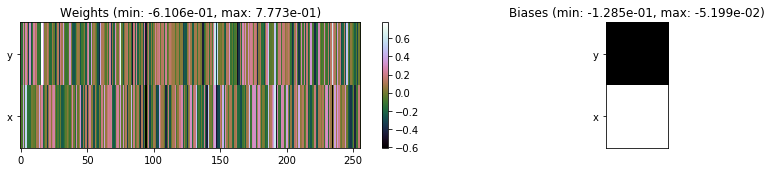

---------------------------------------------------------------------------------------------------------------
Elapsed time:  433.20 sec | TRAIN >> class loss: 0.4725 | steps:  2.360 :( | reward:  4.1021 :( | acc.: 84.015% :(
                          | VAL   >> class loss: 0.4686 | steps:  2.328 :( | reward:  4.1538 :( | acc.: 83.120% :(


Epoch  55/400) lr = 0.0004447
 b    300/  3000 >> 145.6 ms/b | lr: 4.44e-04 | grad 2norm: 11.07 | grad inf norm:  3.221
         Weights || abs max:  3.79 ( 3175.02) | mean: -9.53e-04 ( 0.01) | var: 7.91e-02 (  239.42)
          Biases || abs max:  1.29 (  133.28) | mean: -1.35e-01 ( 0.13) | var: 9.19e-02 (  278.75)
                    class loss: 0.485 | steps: 2.379 | reward:  4.070 | acc.: 83.18%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.7 ms/b | lr: 4.44e-04 | grad 2norm: 10.92 | grad inf norm:  3.224
         Weights || abs max:  3.81 ( 3198.71) | mean: -9.74e-04 (

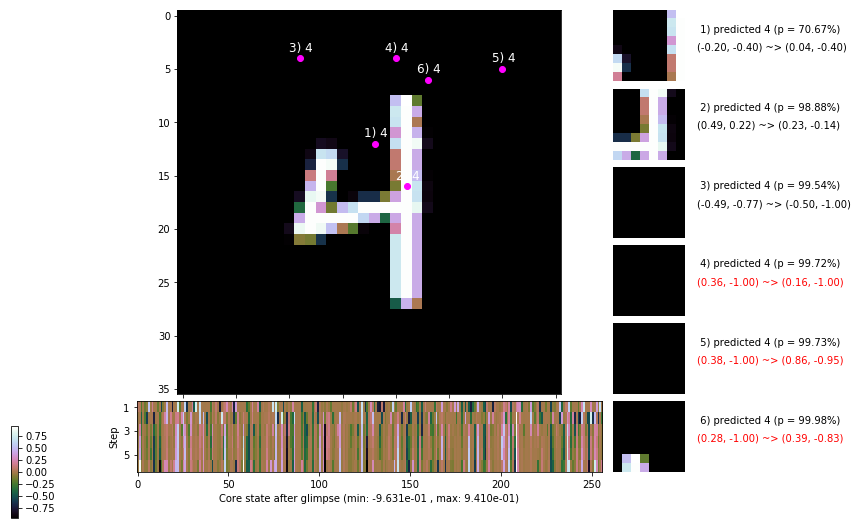

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.3 ms/b | lr: 4.43e-04 | grad 2norm: 10.93 | grad inf norm:  3.295
         Weights || abs max:  3.82 ( 3639.58) | mean: -9.55e-04 ( 0.02) | var: 7.92e-02 (  365.87)
          Biases || abs max:  1.29 (  187.25) | mean: -1.36e-01 ( 0.15) | var: 9.21e-02 (  258.93)
                    class loss: 0.462 | steps: 2.368 | reward:  4.108 | acc.: 84.72%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.0 ms/b | lr: 4.42e-04 | grad 2norm: 10.89 | grad inf norm:  3.320
         Weights || abs max:  3.81 ( 2813.54) | mean: -9.29e-04 ( 0.01) | var: 7.92e-02 (  300.30)
          Biases || abs max:  1.29 (  179.42) | mean: -1.36e-01 ( 0.13) | var: 9.21e-02 ( 1488.79)
                    class loss: 0.470 | steps: 2.349 | reward:  4.097 | acc.: 84.17%

	Target class: 9 | Discounted rewards: [0.869, 1.938, 1.8

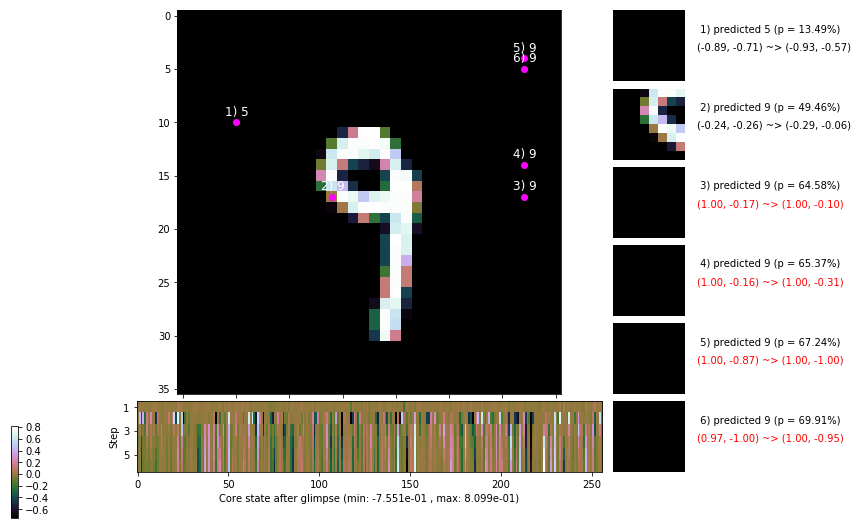

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 140.4 ms/b | lr: 4.42e-04 | grad 2norm: 11.01 | grad inf norm:  3.230
         Weights || abs max:  3.82 ( 2333.47) | mean: -9.34e-04 ( 0.01) | var: 7.93e-02 (   74.79)
          Biases || abs max:  1.29 (  119.66) | mean: -1.36e-01 ( 0.11) | var: 9.22e-02 (  136.54)
                    class loss: 0.463 | steps: 2.384 | reward:  4.080 | acc.: 84.18%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.1 ms/b | lr: 4.41e-04 | grad 2norm: 10.99 | grad inf norm:  3.253
         Weights || abs max:  3.82 ( 2614.30) | mean: -9.45e-04 ( 0.01) | var: 7.93e-02 (  206.04)
          Biases || abs max:  1.28 (  159.59) | mean: -1.36e-01 ( 0.12) | var: 9.22e-02 (  557.57)
                    class loss: 0.475 | steps: 2.354 | reward:  4.096 | acc.: 83.55%

	Target class: 0 | Discounted rewards: [-0.094, 0.012, 0.

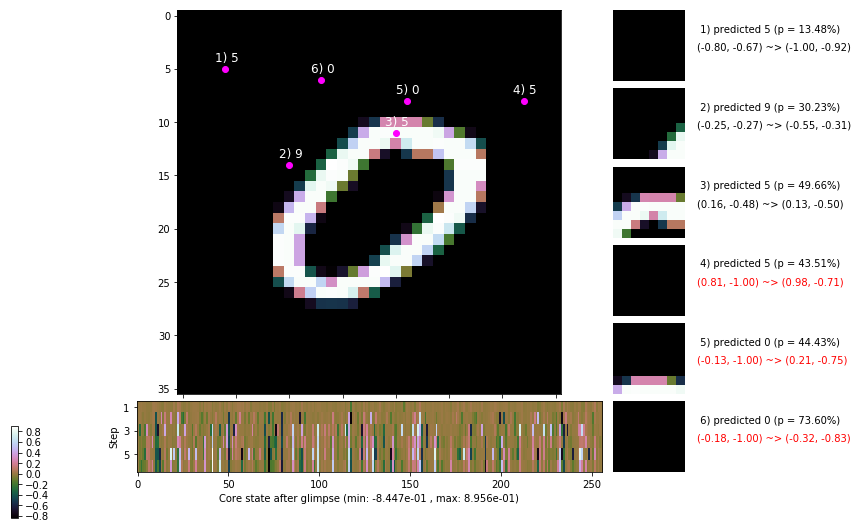

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 143.2 ms/b | lr: 4.40e-04 | grad 2norm: 11.05 | grad inf norm:  3.132
         Weights || abs max:  3.82 ( 5998.80) | mean: -9.17e-04 ( 0.02) | var: 7.93e-02 ( 1872.78)
          Biases || abs max:  1.29 (  158.43) | mean: -1.36e-01 ( 0.12) | var: 9.22e-02 (  341.38)
                    class loss: 0.472 | steps: 2.357 | reward:  4.087 | acc.: 83.77%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 140.4 ms/b | lr: 4.40e-04 | grad 2norm: 11.15 | grad inf norm:  3.243
         Weights || abs max:  3.82 ( 6272.41) | mean: -9.11e-04 ( 0.02) | var: 7.94e-02 ( 2644.23)
          Biases || abs max:  1.29 (  166.57) | mean: -1.36e-01 ( 0.13) | var: 9.22e-02 (  247.37)
                    class loss: 0.473 | steps: 2.360 | reward:  4.105 | acc.: 83.92%

	Target class: 0 | Discounted rewards: [0.869, 1.938, 1.8

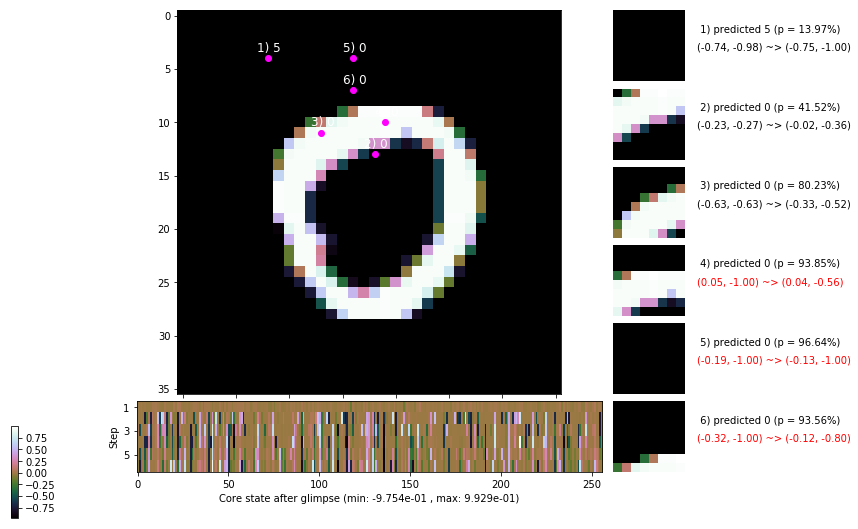

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 141.7 ms/b | lr: 4.39e-04 | grad 2norm: 11.01 | grad inf norm:  3.220
         Weights || abs max:  3.81 ( 2382.19) | mean: -9.12e-04 ( 0.01) | var: 7.94e-02 (   62.01)
          Biases || abs max:  1.28 (  220.67) | mean: -1.36e-01 ( 0.15) | var: 9.22e-02 ( 2619.13)
                    class loss: 0.445 | steps: 2.355 | reward:  4.118 | acc.: 84.80%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.6 ms/b | lr: 4.38e-04 | grad 2norm: 10.89 | grad inf norm:  3.028
         Weights || abs max:  3.81 (36173.85) | mean: -9.05e-04 ( 0.08) | var: 7.95e-02 (477789.50)
          Biases || abs max:  1.28 (  373.38) | mean: -1.36e-01 ( 0.22) | var: 9.24e-02 ( 5606.43)
                    class loss: 0.463 | steps: 2.347 | reward:  4.119 | acc.: 84.03%

	Target class: 9 | Discounted rewards: [0.216, 0.631, 1.

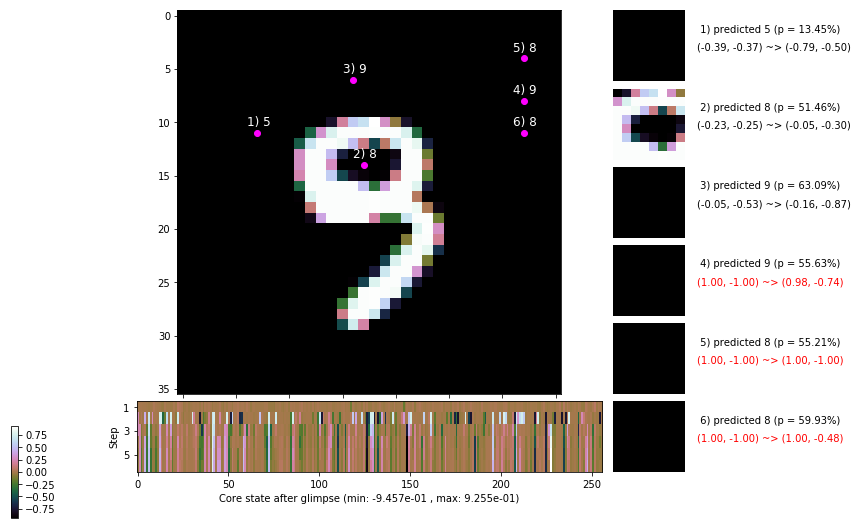

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


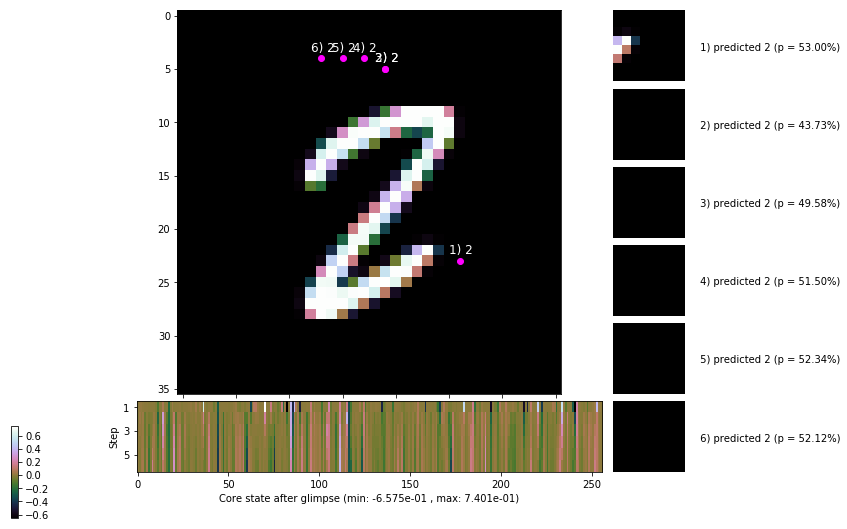


	Target class: 3 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


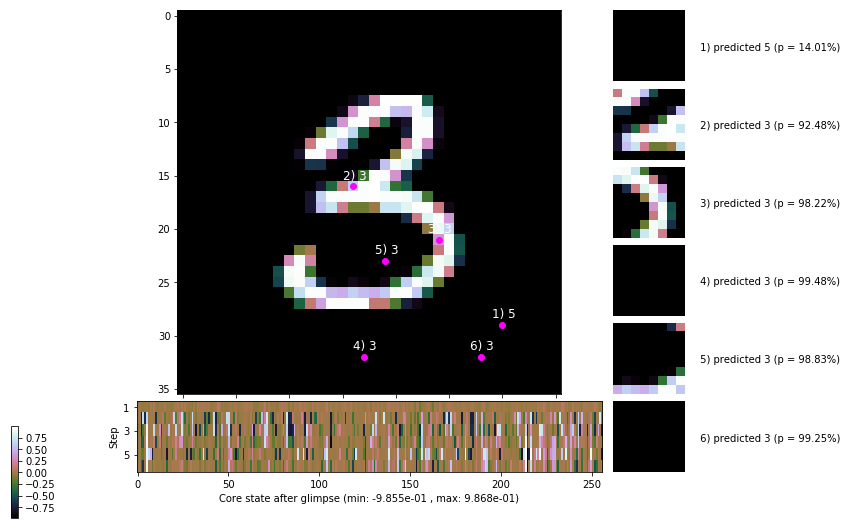

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


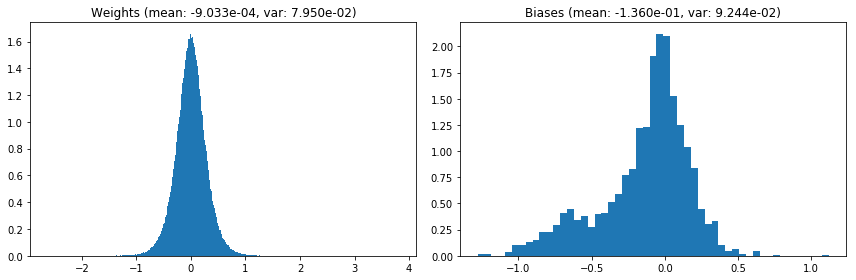

                                      Location network weights and biases


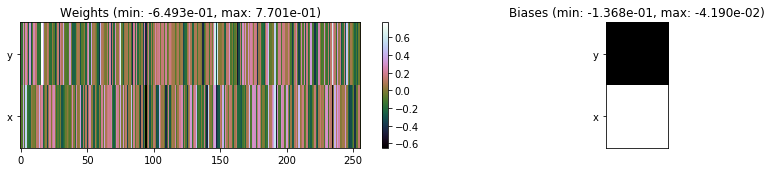

---------------------------------------------------------------------------------------------------------------
Elapsed time:  430.70 sec | TRAIN >> class loss: 0.4691 | steps:  2.364 :( | reward:  4.0958 :( | acc.: 83.990% :(
                          | VAL   >> class loss: 0.4594 | steps:  2.282 :( | reward:  4.2068 :( | acc.: 84.100% :(


Epoch  56/400) lr = 0.0004381
 b    300/  3000 >> 142.1 ms/b | lr: 4.38e-04 | grad 2norm: 10.92 | grad inf norm:  3.218
         Weights || abs max:  3.81 ( 3044.68) | mean: -9.07e-04 ( 0.01) | var: 7.95e-02 (  133.63)
          Biases || abs max:  1.28 (   77.23) | mean: -1.36e-01 ( 0.10) | var: 9.24e-02 (   15.59)
                    class loss: 0.483 | steps: 2.382 | reward:  4.082 | acc.: 83.90%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 148.8 ms/b | lr: 4.37e-04 | grad 2norm: 11.15 | grad inf norm:  3.289
         Weights || abs max:  3.82 ( 4141.99) | mean: -9.10e-04 (

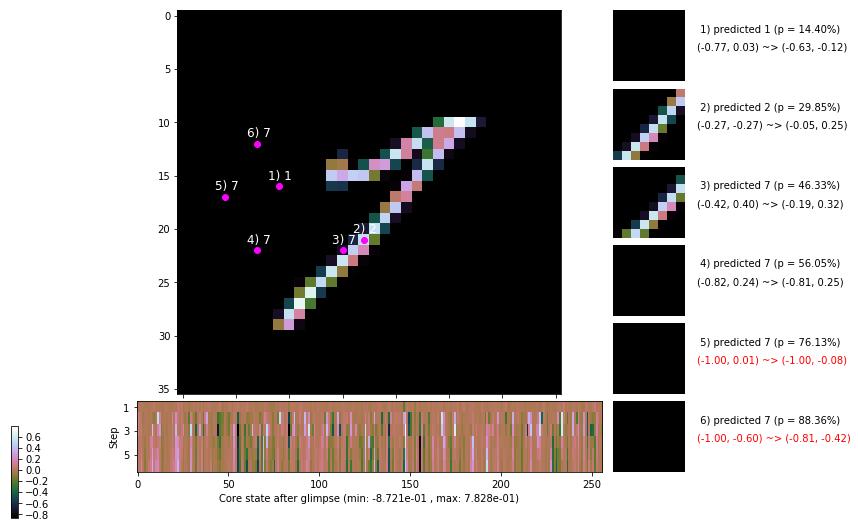

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 149.6 ms/b | lr: 4.36e-04 | grad 2norm: 11.02 | grad inf norm:  3.193
         Weights || abs max:  3.82 ( 2503.84) | mean: -9.10e-04 ( 0.01) | var: 7.96e-02 (   89.67)
          Biases || abs max:  1.28 (  104.47) | mean: -1.36e-01 ( 0.11) | var: 9.26e-02 (   85.29)
                    class loss: 0.492 | steps: 2.379 | reward:  4.056 | acc.: 83.15%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.0 ms/b | lr: 4.36e-04 | grad 2norm: 10.91 | grad inf norm:  3.209
         Weights || abs max:  3.83 ( 4709.23) | mean: -9.29e-04 ( 0.02) | var: 7.96e-02 ( 1420.46)
          Biases || abs max:  1.27 (  183.30) | mean: -1.37e-01 ( 0.14) | var: 9.25e-02 (  161.79)
                    class loss: 0.490 | steps: 2.406 | reward:  4.044 | acc.: 83.48%

	Target class: 5 | Discounted rewards: [0.319, 0.837, 1.8

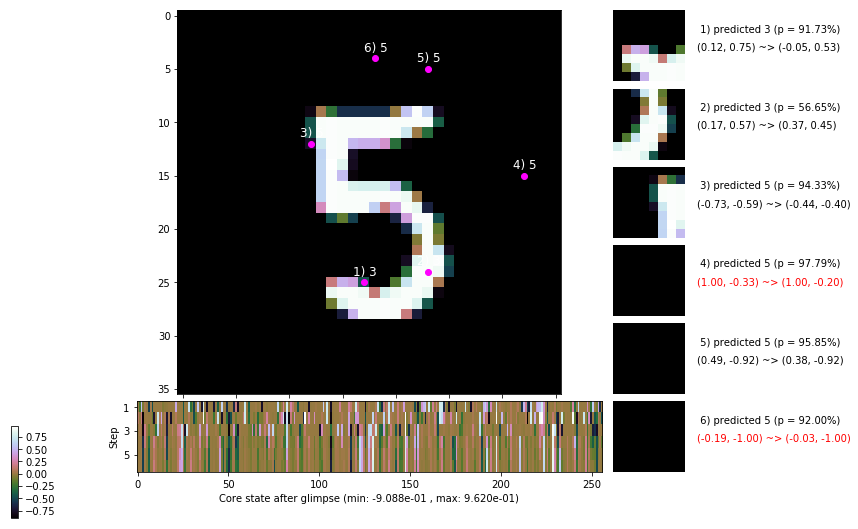

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 146.4 ms/b | lr: 4.35e-04 | grad 2norm: 11.01 | grad inf norm:  3.338
         Weights || abs max:  3.83 ( 1450.24) | mean: -9.31e-04 ( 0.01) | var: 7.97e-02 (   23.37)
          Biases || abs max:  1.27 (  106.21) | mean: -1.36e-01 ( 0.10) | var: 9.24e-02 (   58.18)
                    class loss: 0.467 | steps: 2.363 | reward:  4.100 | acc.: 84.15%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 143.1 ms/b | lr: 4.35e-04 | grad 2norm: 10.90 | grad inf norm:  3.083
         Weights || abs max:  3.83 ( 5716.96) | mean: -9.31e-04 ( 0.02) | var: 7.97e-02 ( 5538.59)
          Biases || abs max:  1.28 (  192.91) | mean: -1.36e-01 ( 0.15) | var: 9.25e-02 (  274.80)
                    class loss: 0.463 | steps: 2.338 | reward:  4.120 | acc.: 83.98%

	Target class: 4 | Discounted rewards: [0.869, 1.938, 1.8

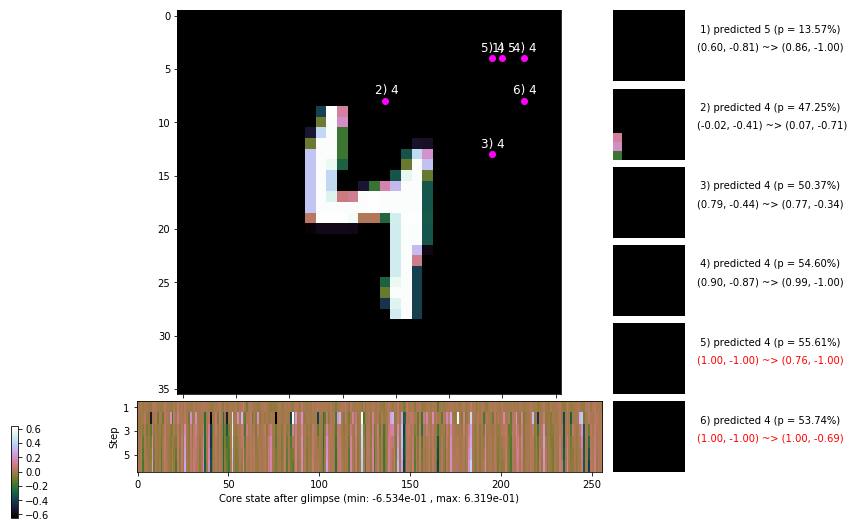

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 145.8 ms/b | lr: 4.34e-04 | grad 2norm: 10.78 | grad inf norm:  3.240
         Weights || abs max:  3.83 (20179.33) | mean: -9.36e-04 ( 0.05) | var: 7.98e-02 (151657.48)
          Biases || abs max:  1.28 (  109.99) | mean: -1.36e-01 ( 0.12) | var: 9.24e-02 (   35.17)
                    class loss: 0.480 | steps: 2.366 | reward:  4.089 | acc.: 84.25%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.2 ms/b | lr: 4.33e-04 | grad 2norm: 10.76 | grad inf norm:  3.188
         Weights || abs max:  3.84 ( 5974.22) | mean: -9.37e-04 ( 0.02) | var: 7.98e-02 ( 3071.61)
          Biases || abs max:  1.28 (  137.47) | mean: -1.37e-01 ( 0.13) | var: 9.25e-02 (  105.09)
                    class loss: 0.469 | steps: 2.362 | reward:  4.103 | acc.: 83.77%

	Target class: 0 | Discounted rewards: [0.319, 0.837, 1.

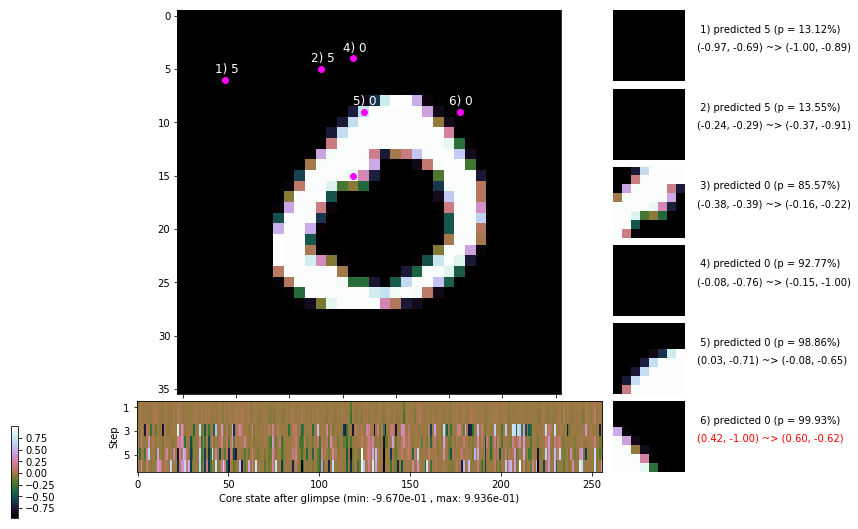

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.6 ms/b | lr: 4.32e-04 | grad 2norm: 10.78 | grad inf norm:  3.228
         Weights || abs max:  3.84 ( 4561.42) | mean: -9.29e-04 ( 0.02) | var: 7.99e-02 ( 1156.83)
          Biases || abs max:  1.29 (  103.32) | mean: -1.36e-01 ( 0.11) | var: 9.25e-02 (   36.39)
                    class loss: 0.464 | steps: 2.366 | reward:  4.092 | acc.: 84.25%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.7 ms/b | lr: 4.32e-04 | grad 2norm: 10.76 | grad inf norm:  3.239
         Weights || abs max:  3.84 ( 4550.81) | mean: -9.31e-04 ( 0.02) | var: 7.99e-02 ( 1015.25)
          Biases || abs max:  1.30 (  170.43) | mean: -1.37e-01 ( 0.13) | var: 9.26e-02 (  609.64)
                    class loss: 0.485 | steps: 2.357 | reward:  4.114 | acc.: 84.02%

	Target class: 6 | Discounted rewards: [0.869, 1.938, 1.8

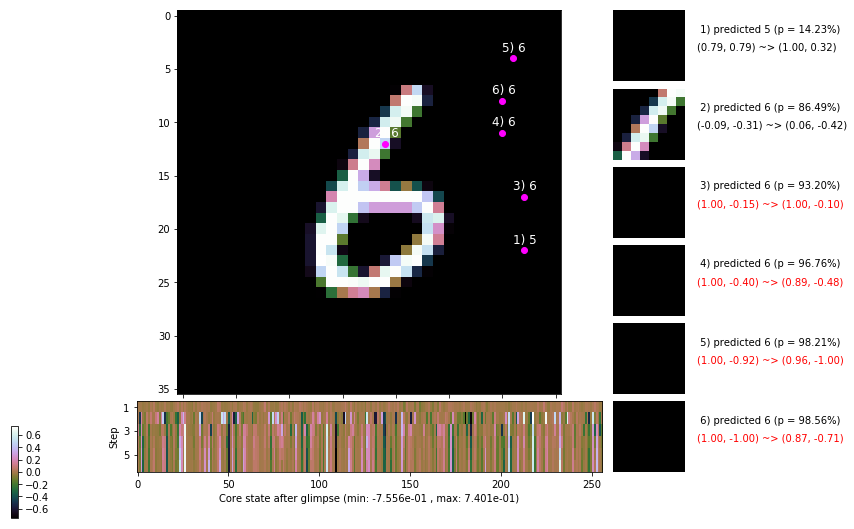

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


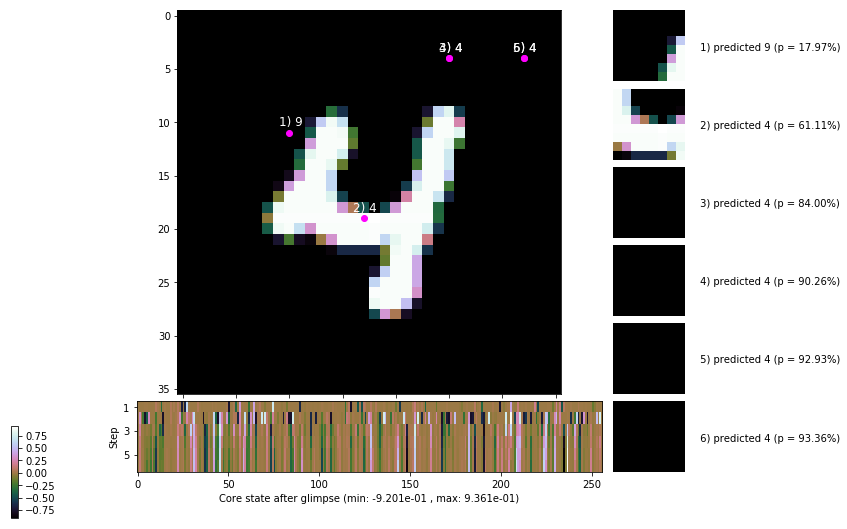


	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


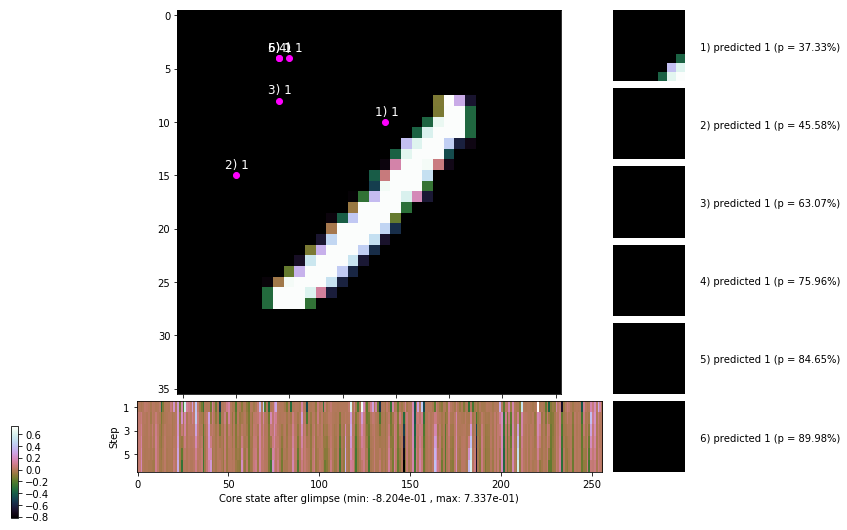

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


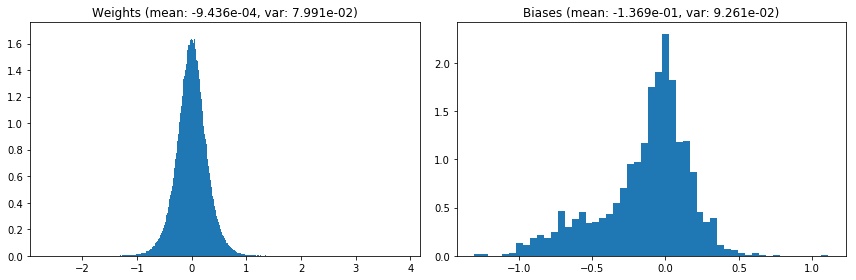

                                      Location network weights and biases


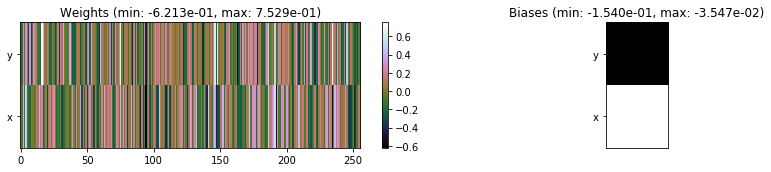

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.90 sec | TRAIN >> class loss: 0.4784 | steps:  2.366 :( | reward:  4.0911 :( | acc.: 83.873% :(
                          | VAL   >> class loss: 0.4656 | steps:  2.290 :( | reward:  4.2132 :( | acc.: 84.220% :(


Epoch  57/400) lr = 0.0004315
 b    300/  3000 >> 135.1 ms/b | lr: 4.31e-04 | grad 2norm: 11.01 | grad inf norm:  3.224
         Weights || abs max:  3.85 ( 3248.47) | mean: -9.38e-04 ( 0.01) | var: 7.99e-02 (  234.28)
          Biases || abs max:  1.29 (  130.38) | mean: -1.37e-01 ( 0.11) | var: 9.26e-02 (  163.20)
                    class loss: 0.490 | steps: 2.390 | reward:  4.071 | acc.: 83.68%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.2 ms/b | lr: 4.31e-04 | grad 2norm: 10.58 | grad inf norm:  2.946
         Weights || abs max:  3.86 ( 3673.52) | mean: -9.36e-04 (

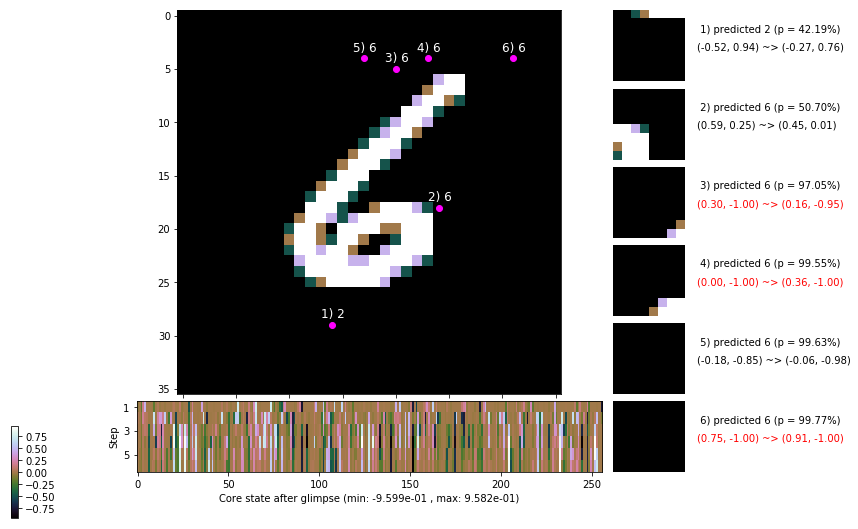

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.4 ms/b | lr: 4.30e-04 | grad 2norm: 11.01 | grad inf norm:  3.204
         Weights || abs max:  3.86 ( 4680.00) | mean: -9.29e-04 ( 0.02) | var: 8.00e-02 ( 1374.73)
          Biases || abs max:  1.30 (  118.93) | mean: -1.37e-01 ( 0.12) | var: 9.29e-02 (   51.14)
                    class loss: 0.485 | steps: 2.385 | reward:  4.067 | acc.: 83.82%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 144.1 ms/b | lr: 4.29e-04 | grad 2norm: 10.98 | grad inf norm:  3.114
         Weights || abs max:  3.87 ( 4000.23) | mean: -9.16e-04 ( 0.02) | var: 8.00e-02 (  986.90)
          Biases || abs max:  1.30 (  243.62) | mean: -1.37e-01 ( 0.15) | var: 9.30e-02 ( 2263.22)
                    class loss: 0.480 | steps: 2.381 | reward:  4.093 | acc.: 83.82%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

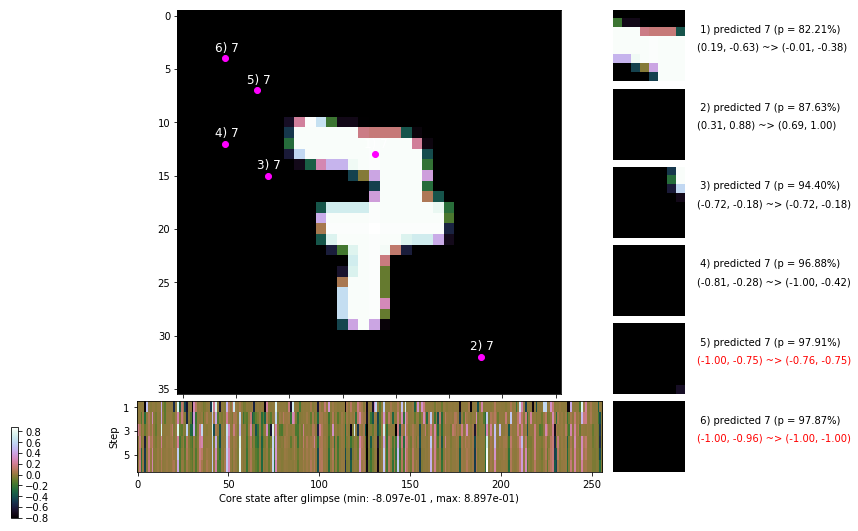

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 145.0 ms/b | lr: 4.29e-04 | grad 2norm: 10.81 | grad inf norm:  3.124
         Weights || abs max:  3.88 ( 2315.95) | mean: -9.12e-04 ( 0.01) | var: 8.01e-02 (   95.52)
          Biases || abs max:  1.30 (   61.93) | mean: -1.37e-01 ( 0.08) | var: 9.29e-02 (   11.62)
                    class loss: 0.455 | steps: 2.364 | reward:  4.108 | acc.: 84.25%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 144.4 ms/b | lr: 4.28e-04 | grad 2norm: 11.03 | grad inf norm:  3.198
         Weights || abs max:  3.88 ( 3659.68) | mean: -9.00e-04 ( 0.02) | var: 8.01e-02 (  317.25)
          Biases || abs max:  1.29 (  482.12) | mean: -1.37e-01 ( 0.26) | var: 9.29e-02 (17840.93)
                    class loss: 0.478 | steps: 2.349 | reward:  4.096 | acc.: 83.23%

	Target class: 7 | Discounted rewards: [-0.197, -0.194, -

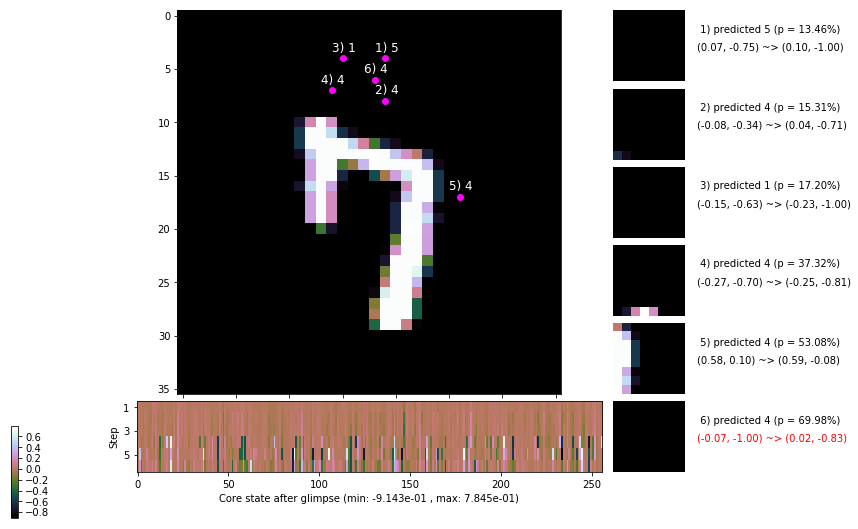

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 149.2 ms/b | lr: 4.27e-04 | grad 2norm: 11.02 | grad inf norm:  3.237
         Weights || abs max:  3.87 ( 2396.27) | mean: -8.96e-04 ( 0.01) | var: 8.02e-02 (   91.26)
          Biases || abs max:  1.29 (  157.29) | mean: -1.37e-01 ( 0.14) | var: 9.29e-02 (  210.83)
                    class loss: 0.479 | steps: 2.377 | reward:  4.076 | acc.: 83.55%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 143.9 ms/b | lr: 4.27e-04 | grad 2norm: 11.02 | grad inf norm:  3.268
         Weights || abs max:  3.87 (18962.12) | mean: -9.01e-04 ( 0.04) | var: 8.02e-02 (112991.55)
          Biases || abs max:  1.29 (  764.21) | mean: -1.37e-01 ( 0.39) | var: 9.29e-02 ( 5804.72)
                    class loss: 0.495 | steps: 2.398 | reward:  4.058 | acc.: 83.08%

	Target class: 8 | Discounted rewards: [0.044, 0.287, 0.

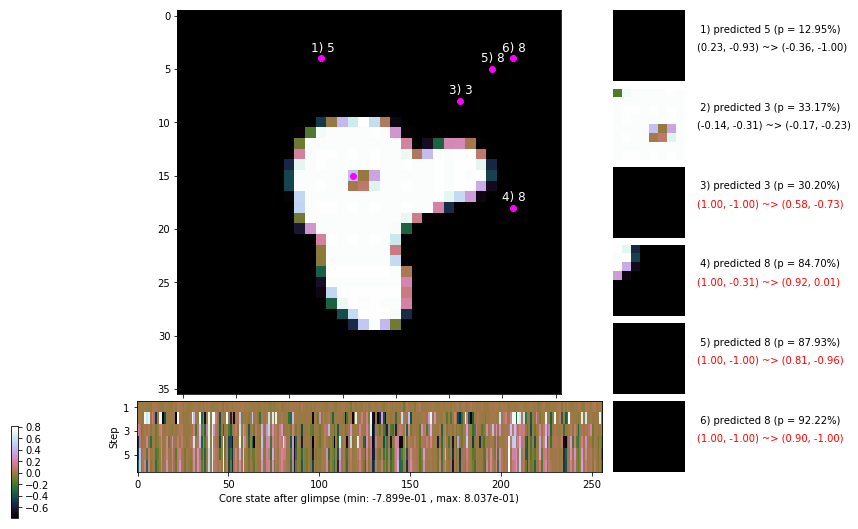

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.5 ms/b | lr: 4.26e-04 | grad 2norm: 10.96 | grad inf norm:  3.259
         Weights || abs max:  3.86 ( 5174.68) | mean: -8.88e-04 ( 0.02) | var: 8.02e-02 ( 5873.41)
          Biases || abs max:  1.29 (  300.38) | mean: -1.37e-01 ( 0.20) | var: 9.30e-02 (  972.60)
                    class loss: 0.477 | steps: 2.372 | reward:  4.094 | acc.: 83.85%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 146.0 ms/b | lr: 4.26e-04 | grad 2norm: 11.18 | grad inf norm:  3.443
         Weights || abs max:  3.87 ( 4263.19) | mean: -8.91e-04 ( 0.02) | var: 8.03e-02 ( 1157.75)
          Biases || abs max:  1.29 (  148.16) | mean: -1.37e-01 ( 0.13) | var: 9.30e-02 (  107.85)
                    class loss: 0.485 | steps: 2.329 | reward:  4.111 | acc.: 83.83%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

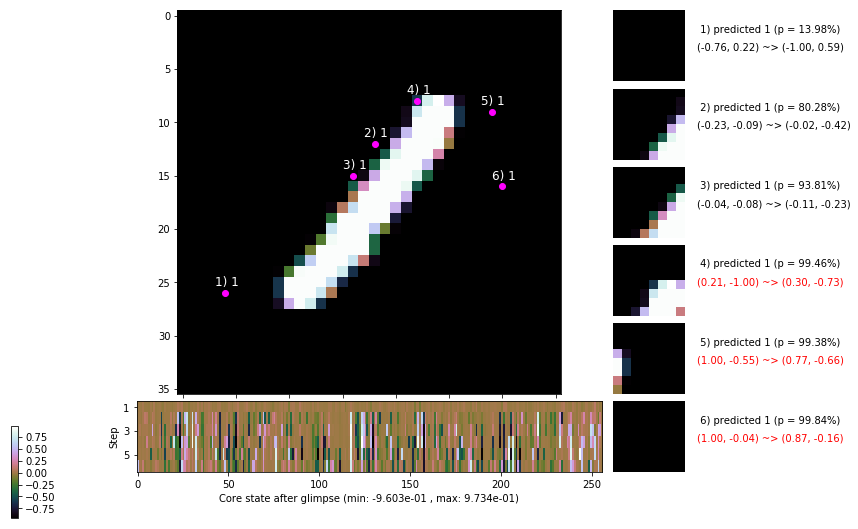

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


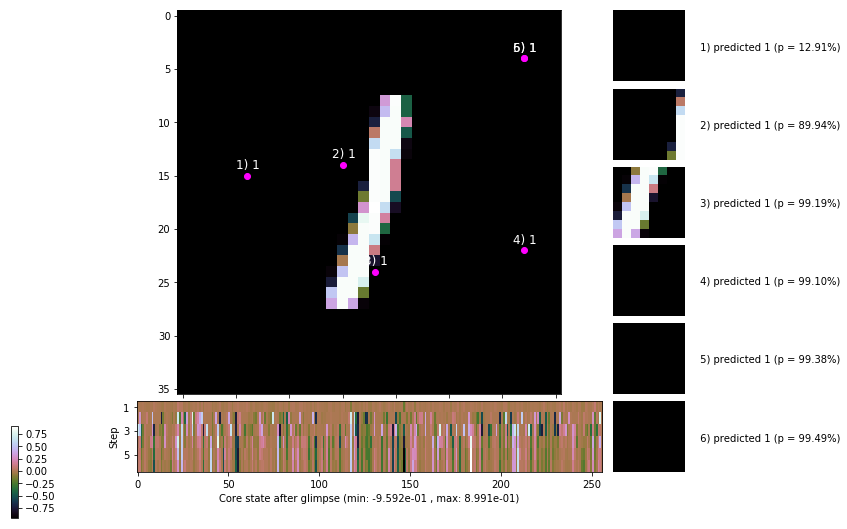


	Target class: 2 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


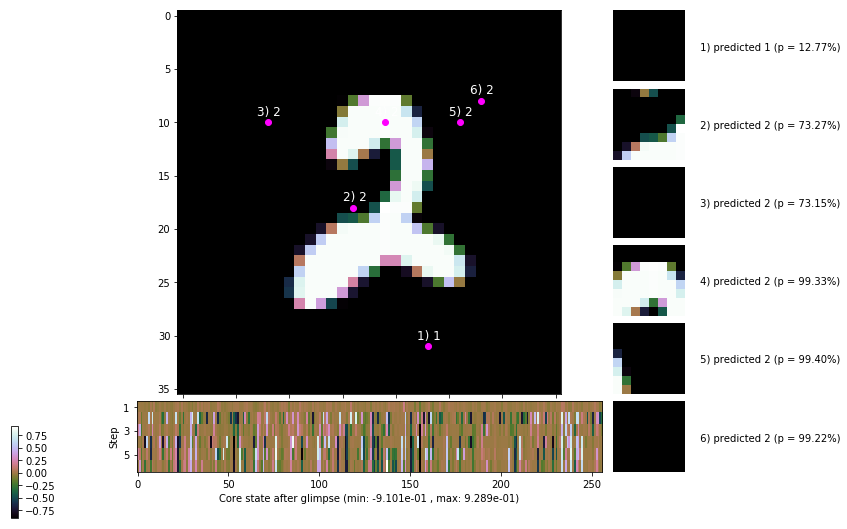

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


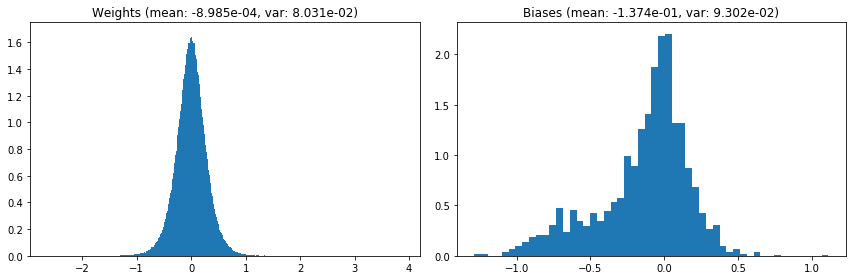

                                      Location network weights and biases


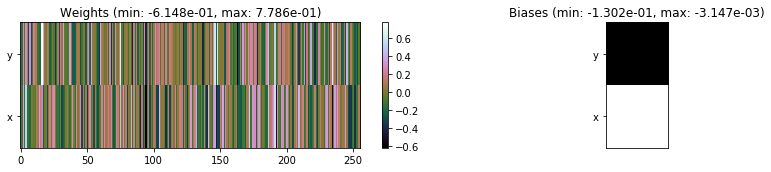

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.15 sec | TRAIN >> class loss: 0.4786 | steps:  2.368 :( | reward:  4.0910 :( | acc.: 83.768% :(
                          | VAL   >> class loss: 0.4487 | steps:  2.271 :( | reward:  4.2193 :( | acc.: 84.140% :(


Epoch  58/400) lr = 0.0004251
 b    300/  3000 >> 142.2 ms/b | lr: 4.25e-04 | grad 2norm: 10.71 | grad inf norm:  3.224
         Weights || abs max:  3.88 ( 3126.11) | mean: -9.02e-04 ( 0.01) | var: 8.03e-02 (  295.85)
          Biases || abs max:  1.29 (  673.96) | mean: -1.38e-01 ( 0.35) | var: 9.32e-02 ( 2954.44)
                    class loss: 0.495 | steps: 2.372 | reward:  4.101 | acc.: 83.92%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.2 ms/b | lr: 4.24e-04 | grad 2norm: 10.77 | grad inf norm:  3.156
         Weights || abs max:  3.89 ( 9211.27) | mean: -9.02e-04 (

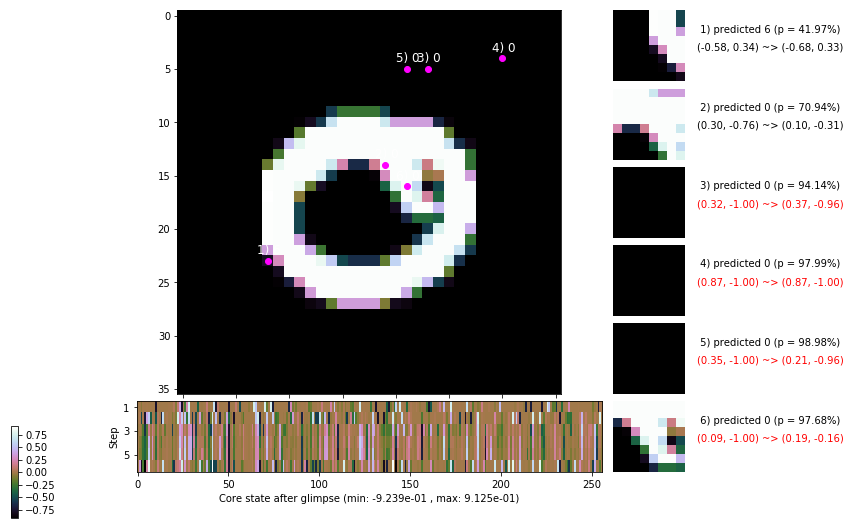

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.6 ms/b | lr: 4.23e-04 | grad 2norm: 11.09 | grad inf norm:  3.240
         Weights || abs max:  3.89 ( 2091.34) | mean: -9.05e-04 ( 0.01) | var: 8.04e-02 (   49.17)
          Biases || abs max:  1.29 (  123.22) | mean: -1.38e-01 ( 0.12) | var: 9.31e-02 (   41.63)
                    class loss: 0.502 | steps: 2.418 | reward:  4.029 | acc.: 82.97%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.8 ms/b | lr: 4.23e-04 | grad 2norm: 10.98 | grad inf norm:  3.315
         Weights || abs max:  3.88 ( 3181.79) | mean: -8.99e-04 ( 0.01) | var: 8.04e-02 (  154.31)
          Biases || abs max:  1.29 (  160.61) | mean: -1.38e-01 ( 0.14) | var: 9.29e-02 (  161.26)
                    class loss: 0.469 | steps: 2.361 | reward:  4.106 | acc.: 83.95%

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.8

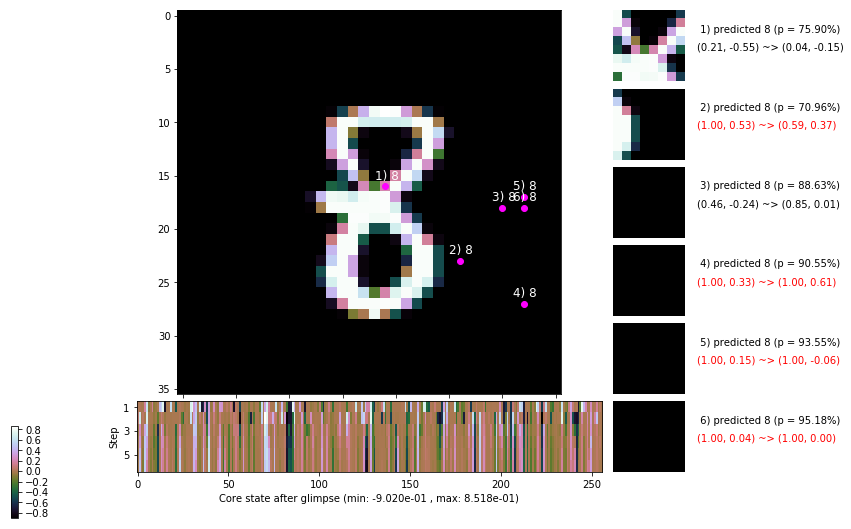

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 141.3 ms/b | lr: 4.22e-04 | grad 2norm: 11.18 | grad inf norm:  3.403
         Weights || abs max:  3.88 ( 4352.60) | mean: -9.04e-04 ( 0.02) | var: 8.05e-02 (  959.34)
          Biases || abs max:  1.29 (  275.95) | mean: -1.37e-01 ( 0.18) | var: 9.29e-02 (  355.03)
                    class loss: 0.469 | steps: 2.367 | reward:  4.100 | acc.: 83.75%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.3 ms/b | lr: 4.22e-04 | grad 2norm: 10.87 | grad inf norm:  3.231
         Weights || abs max:  3.88 ( 1654.25) | mean: -8.98e-04 ( 0.01) | var: 8.05e-02 (   50.15)
          Biases || abs max:  1.28 (   84.70) | mean: -1.38e-01 ( 0.11) | var: 9.30e-02 (   18.26)
                    class loss: 0.469 | steps: 2.360 | reward:  4.116 | acc.: 84.25%

	Target class: 1 | Discounted rewards: [0.869, 1.938, 1.8

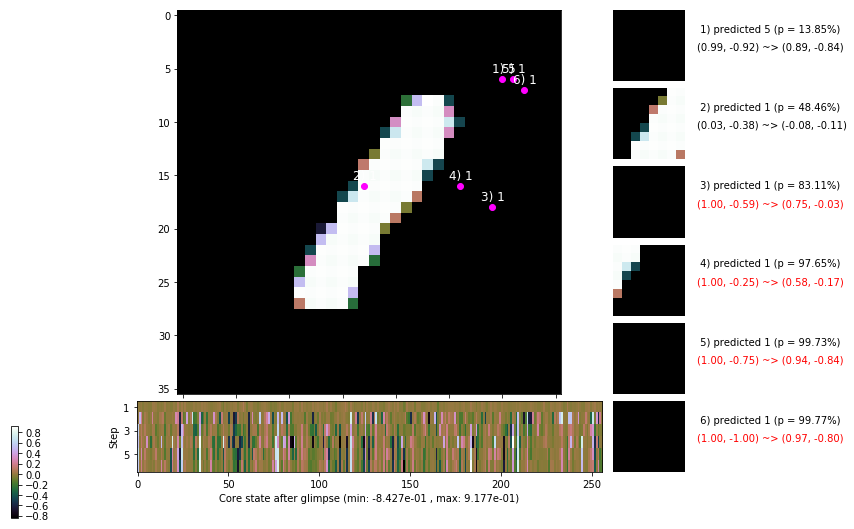

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.6 ms/b | lr: 4.21e-04 | grad 2norm: 10.75 | grad inf norm:  3.101
         Weights || abs max:  3.89 ( 5030.66) | mean: -9.15e-04 ( 0.02) | var: 8.05e-02 ( 1487.39)
          Biases || abs max:  1.28 (  112.86) | mean: -1.38e-01 ( 0.12) | var: 9.30e-02 (   59.43)
                    class loss: 0.449 | steps: 2.349 | reward:  4.134 | acc.: 84.85%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.3 ms/b | lr: 4.20e-04 | grad 2norm: 10.95 | grad inf norm:  3.313
         Weights || abs max:  3.88 ( 2321.60) | mean: -9.25e-04 ( 0.01) | var: 8.06e-02 (  100.86)
          Biases || abs max:  1.29 (  188.38) | mean: -1.38e-01 ( 0.17) | var: 9.30e-02 (  186.12)
                    class loss: 0.483 | steps: 2.342 | reward:  4.116 | acc.: 83.73%

	Target class: 9 | Discounted rewards: [-0.197, -0.194, -

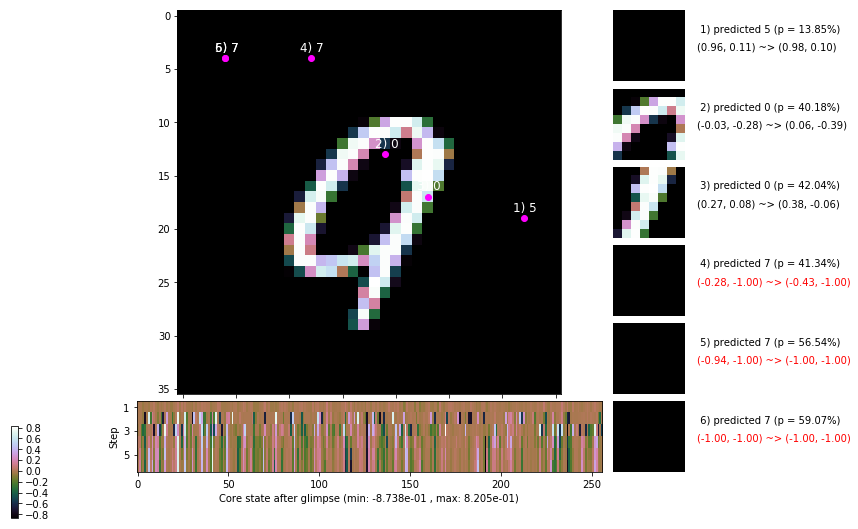

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 148.2 ms/b | lr: 4.20e-04 | grad 2norm: 10.97 | grad inf norm:  3.168
         Weights || abs max:  3.88 ( 7978.49) | mean: -9.23e-04 ( 0.02) | var: 8.06e-02 ( 9468.86)
          Biases || abs max:  1.29 ( 1727.40) | mean: -1.37e-01 ( 0.75) | var: 9.29e-02 (298563.59)
                    class loss: 0.465 | steps: 2.380 | reward:  4.099 | acc.: 84.22%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 147.1 ms/b | lr: 4.19e-04 | grad 2norm: 10.80 | grad inf norm:  3.129
         Weights || abs max:  3.89 ( 2781.02) | mean: -9.38e-04 ( 0.01) | var: 8.07e-02 (  290.57)
          Biases || abs max:  1.29 (   95.11) | mean: -1.38e-01 ( 0.10) | var: 9.30e-02 (   58.53)
                    class loss: 0.482 | steps: 2.384 | reward:  4.086 | acc.: 83.92%

	Target class: 1 | Discounted rewards: [0.869, 1.938, 1.

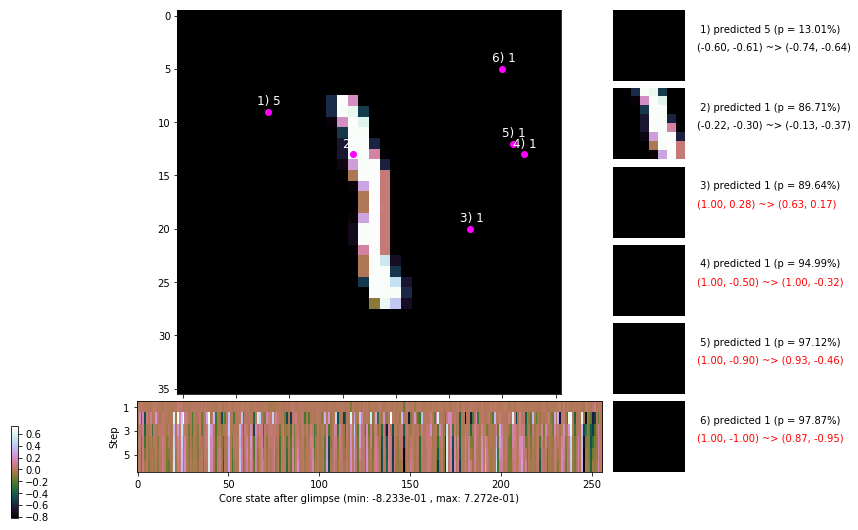

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


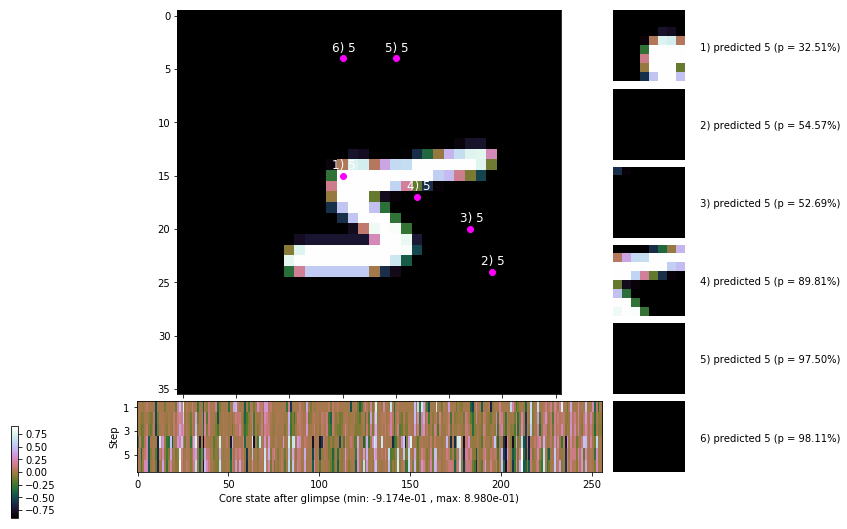


	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


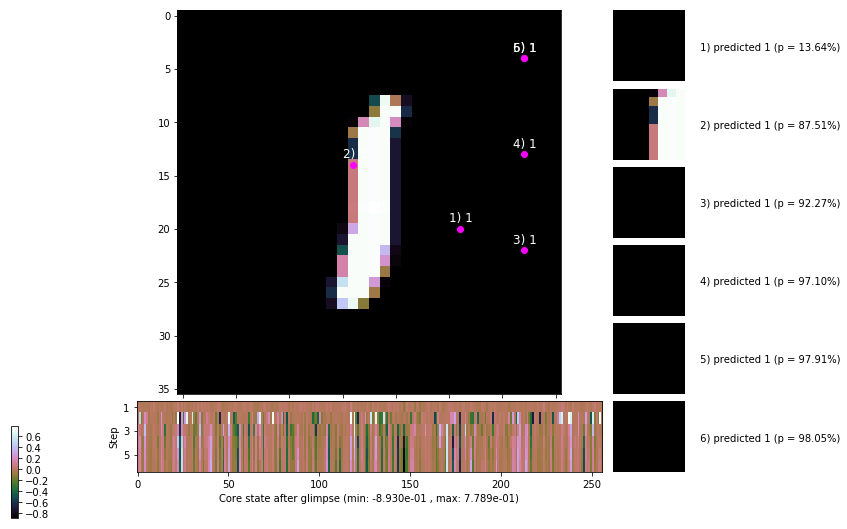

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


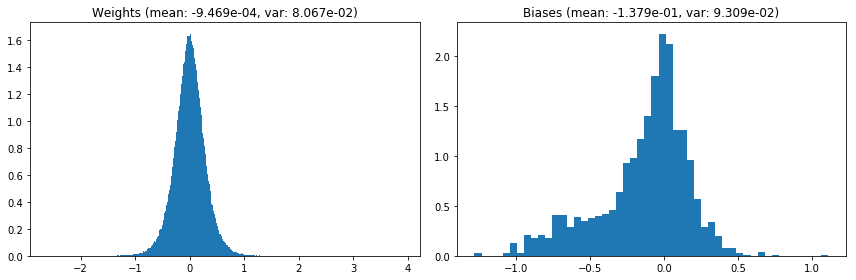

                                      Location network weights and biases


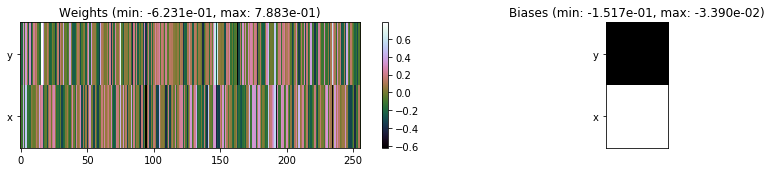

---------------------------------------------------------------------------------------------------------------
Elapsed time:  430.43 sec | TRAIN >> class loss: 0.4750 | steps:  2.372 :( | reward:  4.0984 :( | acc.: 83.953% :(
                          | VAL   >> class loss: 0.4817 | steps:  2.276 :( | reward:  4.2035 :( | acc.: 83.800% :(


Epoch  59/400) lr = 0.0004188
 b    300/  3000 >> 144.6 ms/b | lr: 4.18e-04 | grad 2norm: 10.93 | grad inf norm:  3.208
         Weights || abs max:  3.89 ( 2279.97) | mean: -9.37e-04 ( 0.01) | var: 8.07e-02 (  181.99)
          Biases || abs max:  1.29 ( 3003.82) | mean: -1.38e-01 ( 1.23) | var: 9.31e-02 (950798.38)
                    class loss: 0.483 | steps: 2.350 | reward:  4.103 | acc.: 83.35%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 145.2 ms/b | lr: 4.18e-04 | grad 2norm: 10.80 | grad inf norm:  3.204
         Weights || abs max:  3.88 ( 6730.58) | mean: -9.39e-04 

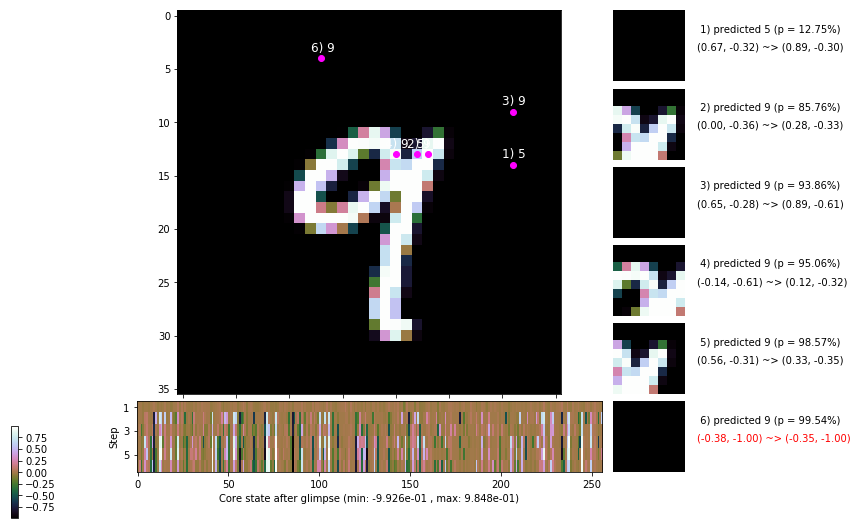

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.9 ms/b | lr: 4.17e-04 | grad 2norm: 10.65 | grad inf norm:  3.219
         Weights || abs max:  3.89 ( 5972.49) | mean: -9.20e-04 ( 0.02) | var: 8.08e-02 ( 2205.44)
          Biases || abs max:  1.29 (  168.49) | mean: -1.37e-01 ( 0.15) | var: 9.31e-02 (  371.04)
                    class loss: 0.458 | steps: 2.321 | reward:  4.164 | acc.: 84.70%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.0 ms/b | lr: 4.17e-04 | grad 2norm: 10.85 | grad inf norm:  3.220
         Weights || abs max:  3.89 ( 5753.00) | mean: -9.06e-04 ( 0.02) | var: 8.08e-02 ( 3746.34)
          Biases || abs max:  1.30 (  176.81) | mean: -1.37e-01 ( 0.16) | var: 9.32e-02 (  226.56)
                    class loss: 0.487 | steps: 2.386 | reward:  4.074 | acc.: 83.50%

	Target class: 7 | Discounted rewards: [0.250, 0.700, 1.6

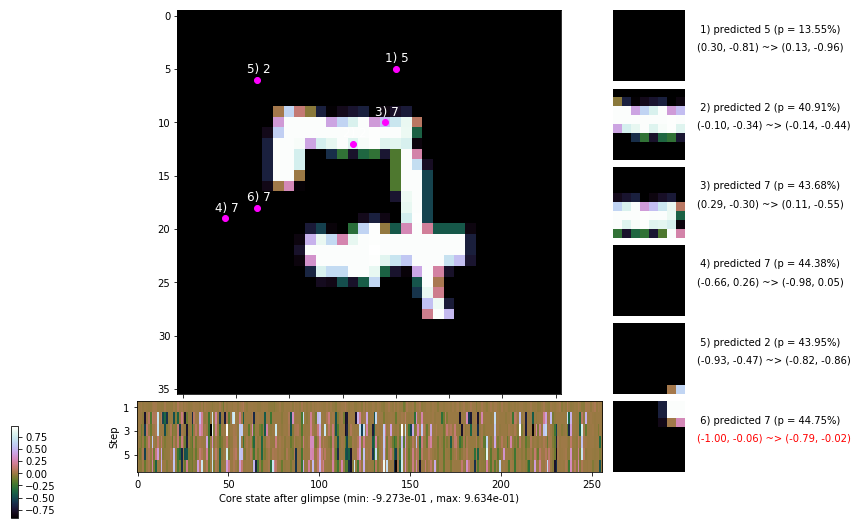

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 141.5 ms/b | lr: 4.16e-04 | grad 2norm: 11.08 | grad inf norm:  3.199
         Weights || abs max:  3.89 ( 3428.13) | mean: -9.07e-04 ( 0.01) | var: 8.09e-02 (  316.21)
          Biases || abs max:  1.30 (  117.96) | mean: -1.38e-01 ( 0.12) | var: 9.33e-02 (  129.24)
                    class loss: 0.483 | steps: 2.363 | reward:  4.086 | acc.: 83.82%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 136.9 ms/b | lr: 4.15e-04 | grad 2norm: 10.89 | grad inf norm:  3.276
         Weights || abs max:  3.89 ( 3916.51) | mean: -9.21e-04 ( 0.01) | var: 8.09e-02 ( 2754.77)
          Biases || abs max:  1.31 (  152.59) | mean: -1.37e-01 ( 0.13) | var: 9.32e-02 (  107.81)
                    class loss: 0.470 | steps: 2.358 | reward:  4.096 | acc.: 83.97%

	Target class: 8 | Discounted rewards: [0.869, 1.938, 1.8

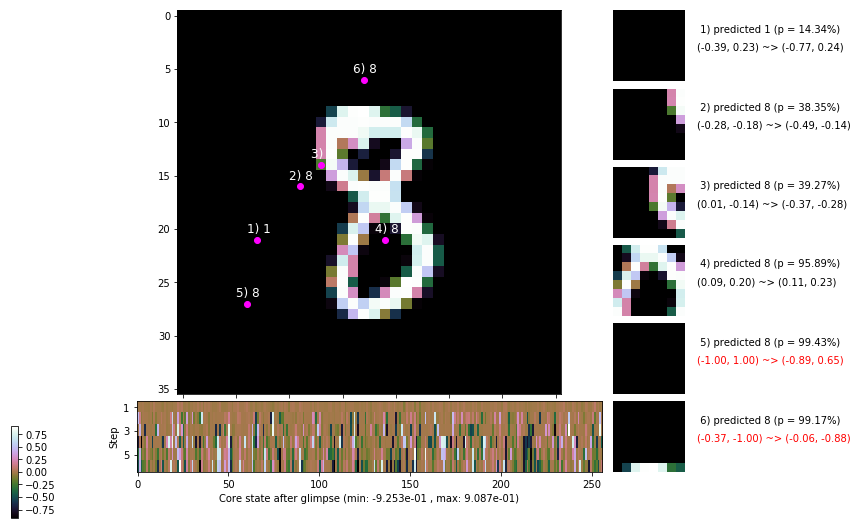

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 141.1 ms/b | lr: 4.15e-04 | grad 2norm: 10.87 | grad inf norm:  3.187
         Weights || abs max:  3.88 ( 4170.96) | mean: -9.37e-04 ( 0.01) | var: 8.10e-02 ( 1387.64)
          Biases || abs max:  1.31 (  158.56) | mean: -1.37e-01 ( 0.14) | var: 9.32e-02 (  301.55)
                    class loss: 0.450 | steps: 2.335 | reward:  4.138 | acc.: 84.98%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.3 ms/b | lr: 4.14e-04 | grad 2norm: 11.02 | grad inf norm:  3.198
         Weights || abs max:  3.87 ( 3394.37) | mean: -9.46e-04 ( 0.01) | var: 8.10e-02 (  177.36)
          Biases || abs max:  1.30 (  136.46) | mean: -1.37e-01 ( 0.13) | var: 9.32e-02 (  134.82)
                    class loss: 0.464 | steps: 2.362 | reward:  4.112 | acc.: 84.78%

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.8

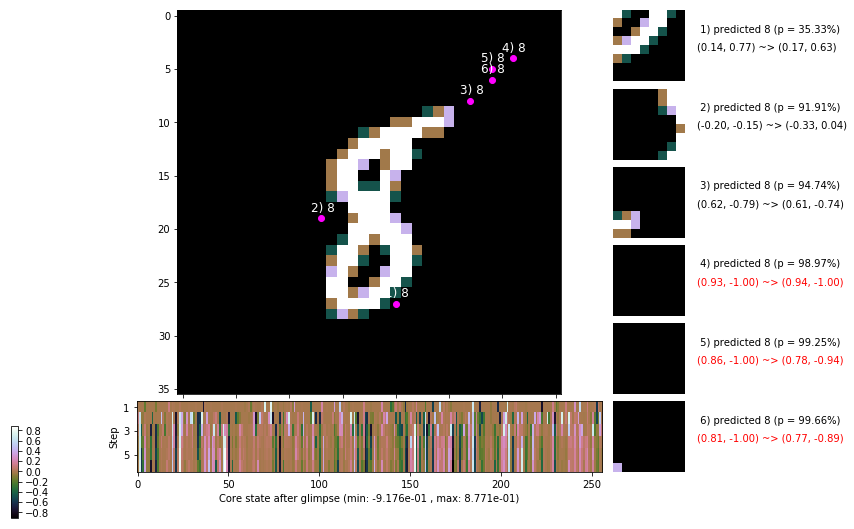

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.4 ms/b | lr: 4.13e-04 | grad 2norm: 11.01 | grad inf norm:  3.245
         Weights || abs max:  3.87 ( 5593.07) | mean: -9.51e-04 ( 0.02) | var: 8.10e-02 ( 4592.76)
          Biases || abs max:  1.30 (  120.44) | mean: -1.37e-01 ( 0.12) | var: 9.32e-02 (  116.89)
                    class loss: 0.475 | steps: 2.395 | reward:  4.059 | acc.: 83.93%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.5 ms/b | lr: 4.13e-04 | grad 2norm: 10.85 | grad inf norm:  3.044
         Weights || abs max:  3.87 ( 6219.31) | mean: -9.62e-04 ( 0.02) | var: 8.11e-02 ( 2193.76)
          Biases || abs max:  1.30 (  111.36) | mean: -1.38e-01 ( 0.13) | var: 9.31e-02 (   50.70)
                    class loss: 0.483 | steps: 2.352 | reward:  4.098 | acc.: 83.93%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

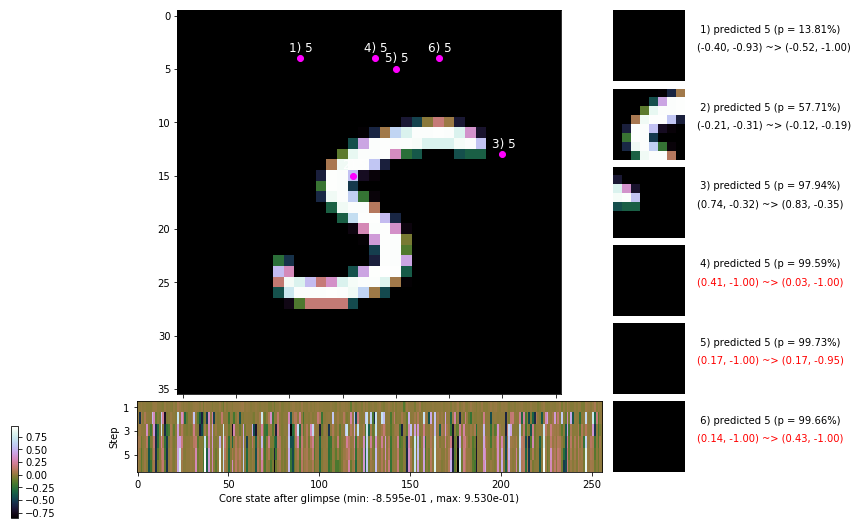

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.009, 0.219, 0.637, 1.475, 0.950, -0.100]


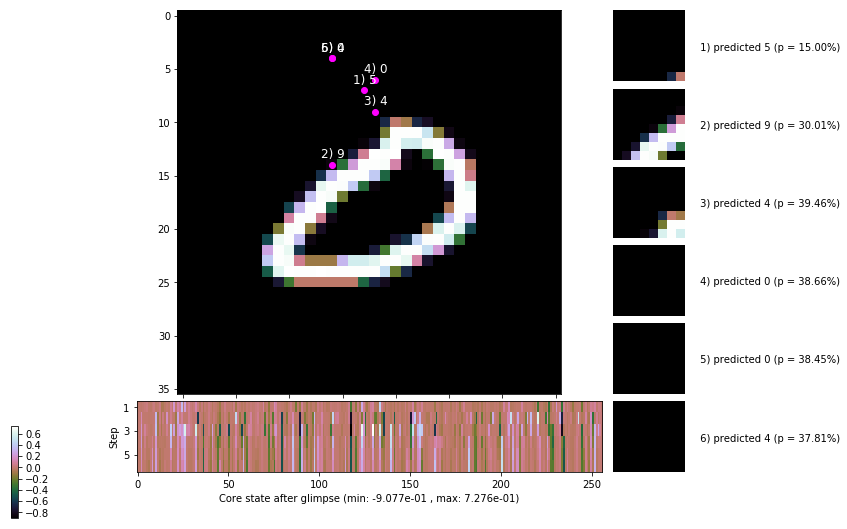


	Target class: 9 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


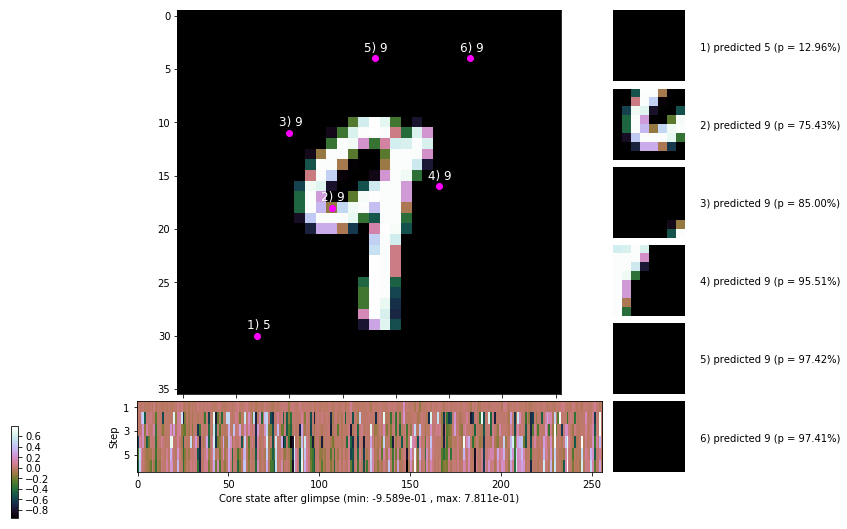

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


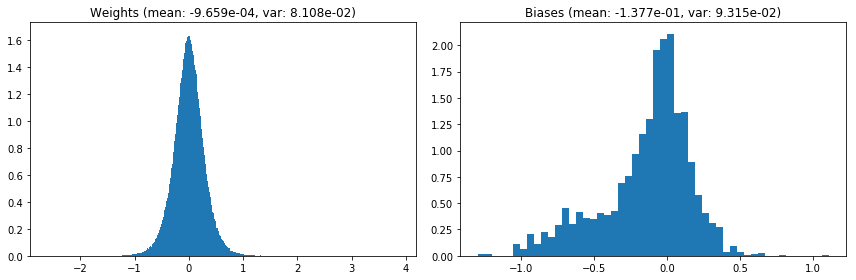

                                      Location network weights and biases


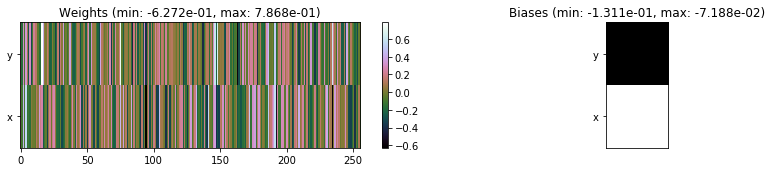

---------------------------------------------------------------------------------------------------------------
Elapsed time:  426.62 sec | TRAIN >> class loss: 0.4737 | steps:  2.358 :( | reward:  4.1042 :( | acc.: 84.082% :(
                          | VAL   >> class loss: 0.4813 | steps:  2.283 :( | reward:  4.1874 :( | acc.: 83.340% :(


Epoch  60/400) lr = 0.0004125
 b    300/  3000 >> 146.6 ms/b | lr: 4.12e-04 | grad 2norm: 10.78 | grad inf norm:  3.217
         Weights || abs max:  3.88 ( 2744.49) | mean: -9.90e-04 ( 0.01) | var: 8.11e-02 (  282.92)
          Biases || abs max:  1.30 (  105.22) | mean: -1.38e-01 ( 0.12) | var: 9.33e-02 (   56.99)
                    class loss: 0.478 | steps: 2.371 | reward:  4.076 | acc.: 84.25%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.3 ms/b | lr: 4.12e-04 | grad 2norm: 10.84 | grad inf norm:  3.220
         Weights || abs max:  3.88 ( 6966.05) | mean: -1.00e-03 (

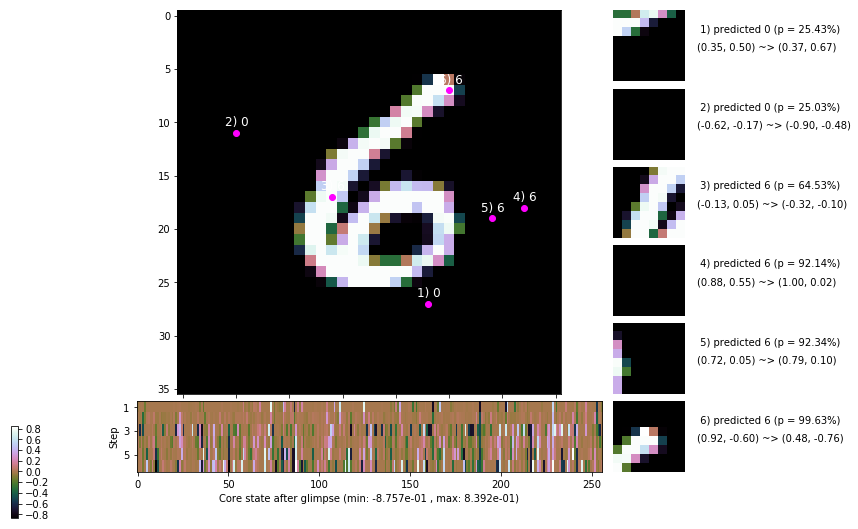

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 150.5 ms/b | lr: 4.11e-04 | grad 2norm: 10.83 | grad inf norm:  3.166
         Weights || abs max:  3.88 (14238.69) | mean: -9.92e-04 ( 0.04) | var: 8.12e-02 (22353.89)
          Biases || abs max:  1.31 (  139.36) | mean: -1.38e-01 ( 0.13) | var: 9.35e-02 (  121.55)
                    class loss: 0.467 | steps: 2.329 | reward:  4.142 | acc.: 84.03%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 144.8 ms/b | lr: 4.10e-04 | grad 2norm: 10.76 | grad inf norm:  3.197
         Weights || abs max:  3.87 ( 2639.62) | mean: -9.89e-04 ( 0.01) | var: 8.12e-02 (  253.33)
          Biases || abs max:  1.31 (  110.59) | mean: -1.38e-01 ( 0.12) | var: 9.36e-02 (   35.40)
                    class loss: 0.468 | steps: 2.358 | reward:  4.121 | acc.: 84.12%

	Target class: 4 | Discounted rewards: [0.078, 0.356, 0.9

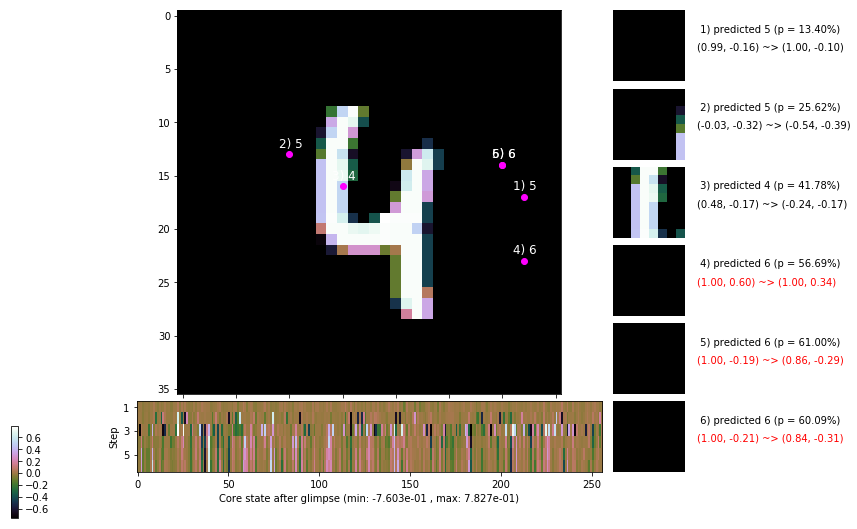

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 147.3 ms/b | lr: 4.10e-04 | grad 2norm: 11.07 | grad inf norm:  3.325
         Weights || abs max:  3.87 ( 3584.34) | mean: -9.98e-04 ( 0.02) | var: 8.12e-02 (  364.22)
          Biases || abs max:  1.32 (  131.05) | mean: -1.38e-01 ( 0.12) | var: 9.37e-02 (  140.78)
                    class loss: 0.472 | steps: 2.345 | reward:  4.115 | acc.: 83.72%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 144.9 ms/b | lr: 4.09e-04 | grad 2norm: 11.19 | grad inf norm:  3.245
         Weights || abs max:  3.87 ( 3525.18) | mean: -9.93e-04 ( 0.01) | var: 8.13e-02 ( 1094.25)
          Biases || abs max:  1.31 (  159.92) | mean: -1.38e-01 ( 0.13) | var: 9.37e-02 (  440.98)
                    class loss: 0.488 | steps: 2.364 | reward:  4.066 | acc.: 83.48%

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.8

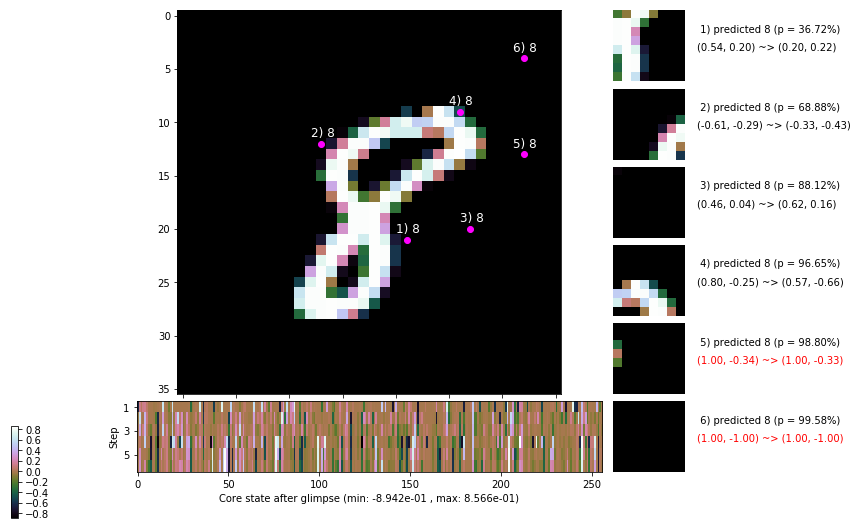

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 147.1 ms/b | lr: 4.08e-04 | grad 2norm: 10.93 | grad inf norm:  3.162
         Weights || abs max:  3.87 ( 3222.27) | mean: -1.03e-03 ( 0.01) | var: 8.13e-02 (  166.13)
          Biases || abs max:  1.31 (  274.16) | mean: -1.38e-01 ( 0.18) | var: 9.38e-02 (  436.01)
                    class loss: 0.458 | steps: 2.347 | reward:  4.138 | acc.: 84.53%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 144.3 ms/b | lr: 4.08e-04 | grad 2norm: 11.02 | grad inf norm:  3.328
         Weights || abs max:  3.86 ( 2728.95) | mean: -1.03e-03 ( 0.01) | var: 8.13e-02 (  210.93)
          Biases || abs max:  1.31 (  253.34) | mean: -1.38e-01 ( 0.20) | var: 9.39e-02 (  549.85)
                    class loss: 0.486 | steps: 2.369 | reward:  4.085 | acc.: 83.25%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

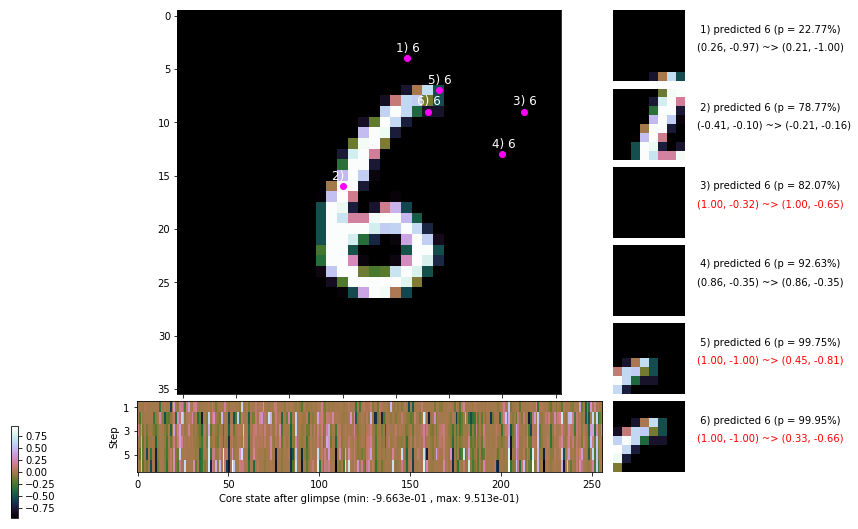

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.2 ms/b | lr: 4.07e-04 | grad 2norm: 10.80 | grad inf norm:  3.215
         Weights || abs max:  3.87 ( 2781.26) | mean: -1.05e-03 ( 0.01) | var: 8.14e-02 (  161.39)
          Biases || abs max:  1.30 (  390.74) | mean: -1.38e-01 ( 0.22) | var: 9.39e-02 ( 5389.82)
                    class loss: 0.479 | steps: 2.384 | reward:  4.066 | acc.: 83.25%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 140.1 ms/b | lr: 4.07e-04 | grad 2norm: 10.97 | grad inf norm:  3.259
         Weights || abs max:  3.87 ( 3167.94) | mean: -1.05e-03 ( 0.01) | var: 8.14e-02 (  316.69)
          Biases || abs max:  1.30 (   92.76) | mean: -1.38e-01 ( 0.11) | var: 9.38e-02 (   45.51)
                    class loss: 0.483 | steps: 2.328 | reward:  4.112 | acc.: 84.02%

	Target class: 3 | Discounted rewards: [1.419, 0.837, 1.8

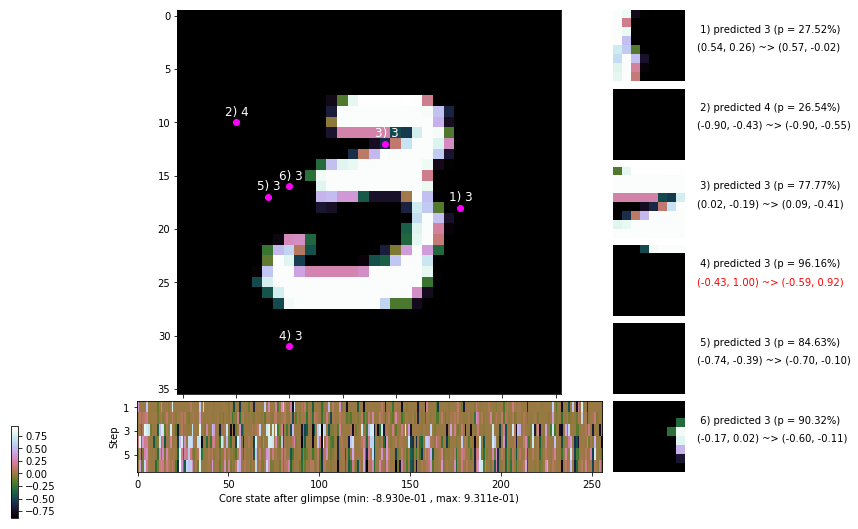

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


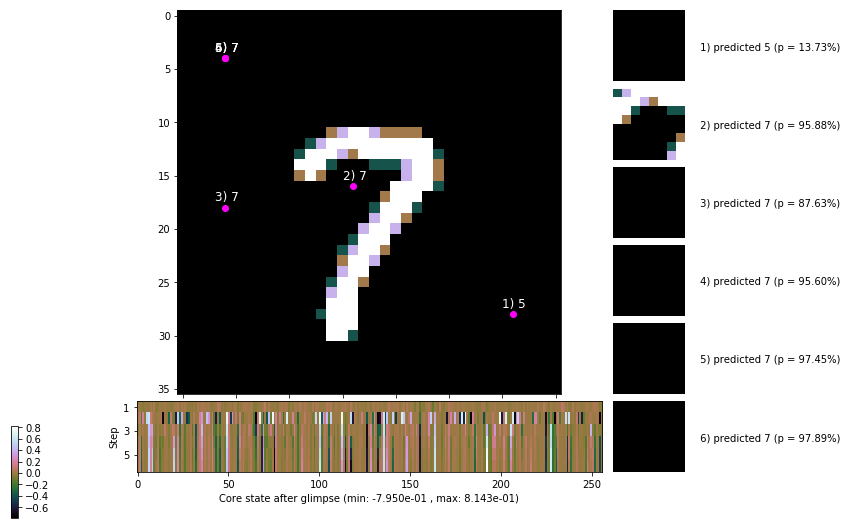


	Target class: 1 | Discounted rewards: [0.869, 1.938, 1.875, 1.750, 1.500, 1.000]


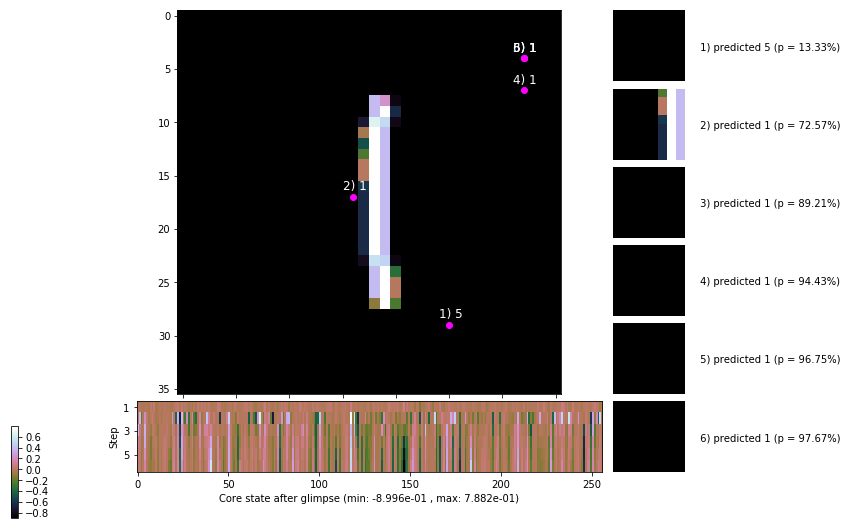

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


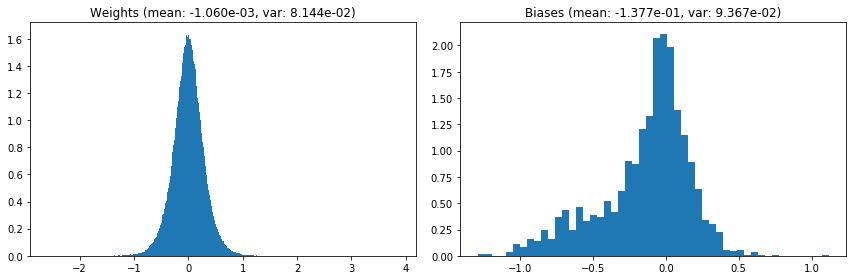

                                      Location network weights and biases


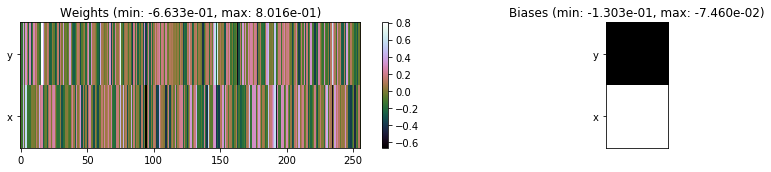

---------------------------------------------------------------------------------------------------------------
Elapsed time:  435.92 sec | TRAIN >> class loss: 0.4769 | steps:  2.356 :( | reward:  4.0998 :( | acc.: 83.808% :(
                          | VAL   >> class loss: 0.4909 | steps:  2.278 :( | reward:  4.1637 :( | acc.: 82.660% :(


Epoch  61/400) lr = 0.0004064
 b    300/  3000 >> 140.2 ms/b | lr: 4.06e-04 | grad 2norm: 10.96 | grad inf norm:  3.262
         Weights || abs max:  3.88 ( 6773.94) | mean: -1.05e-03 ( 0.02) | var: 8.15e-02 ( 8580.74)
          Biases || abs max:  1.29 (  251.90) | mean: -1.38e-01 ( 0.19) | var: 9.37e-02 (  953.06)
                    class loss: 0.476 | steps: 2.350 | reward:  4.110 | acc.: 84.08%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 138.8 ms/b | lr: 4.06e-04 | grad 2norm: 10.82 | grad inf norm:  3.045
         Weights || abs max:  3.89 ( 5533.99) | mean: -1.03e-03 (

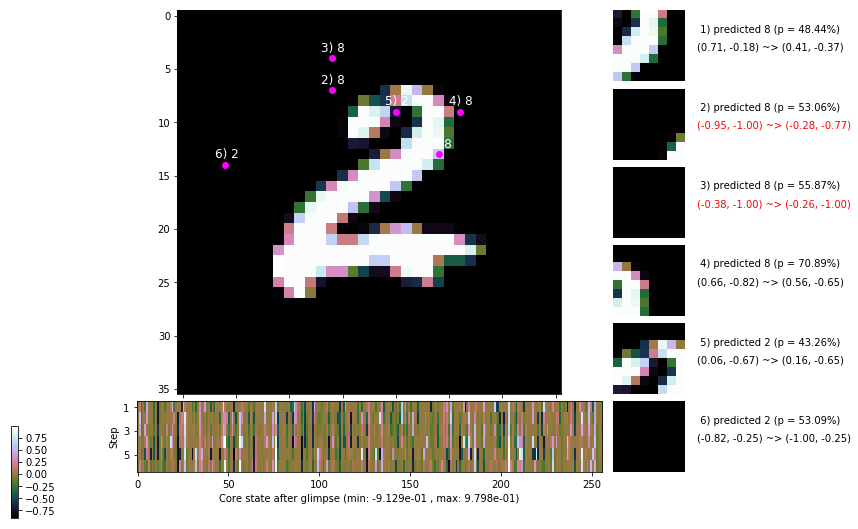

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 141.6 ms/b | lr: 4.05e-04 | grad 2norm: 10.77 | grad inf norm:  3.239
         Weights || abs max:  3.90 ( 3497.12) | mean: -1.04e-03 ( 0.02) | var: 8.15e-02 (  557.97)
          Biases || abs max:  1.30 (  204.96) | mean: -1.38e-01 ( 0.15) | var: 9.38e-02 (  590.93)
                    class loss: 0.476 | steps: 2.382 | reward:  4.077 | acc.: 83.83%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 142.3 ms/b | lr: 4.04e-04 | grad 2norm: 10.78 | grad inf norm:  3.042
         Weights || abs max:  3.89 ( 3138.71) | mean: -1.05e-03 ( 0.01) | var: 8.16e-02 (  127.40)
          Biases || abs max:  1.30 (  143.24) | mean: -1.38e-01 ( 0.14) | var: 9.40e-02 (  111.76)
                    class loss: 0.454 | steps: 2.342 | reward:  4.139 | acc.: 84.72%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

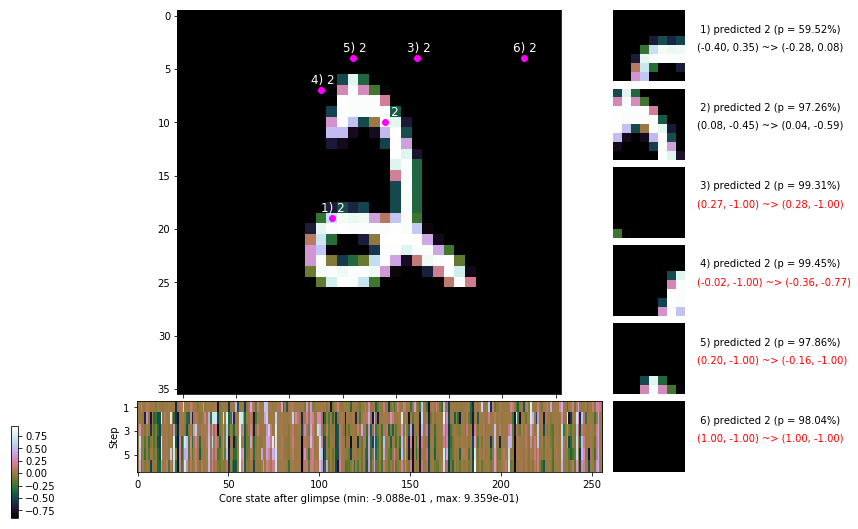

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 145.6 ms/b | lr: 4.04e-04 | grad 2norm: 10.71 | grad inf norm:  3.228
         Weights || abs max:  3.90 ( 3823.19) | mean: -1.07e-03 ( 0.01) | var: 8.16e-02 (  818.18)
          Biases || abs max:  1.30 (   69.08) | mean: -1.39e-01 ( 0.10) | var: 9.41e-02 (   11.17)
                    class loss: 0.467 | steps: 2.365 | reward:  4.094 | acc.: 84.22%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.5 ms/b | lr: 4.03e-04 | grad 2norm: 10.90 | grad inf norm:  3.228
         Weights || abs max:  3.89 ( 3287.06) | mean: -1.08e-03 ( 0.01) | var: 8.16e-02 (  167.89)
          Biases || abs max:  1.30 (  102.76) | mean: -1.39e-01 ( 0.11) | var: 9.41e-02 (   31.90)
                    class loss: 0.476 | steps: 2.340 | reward:  4.127 | acc.: 84.40%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

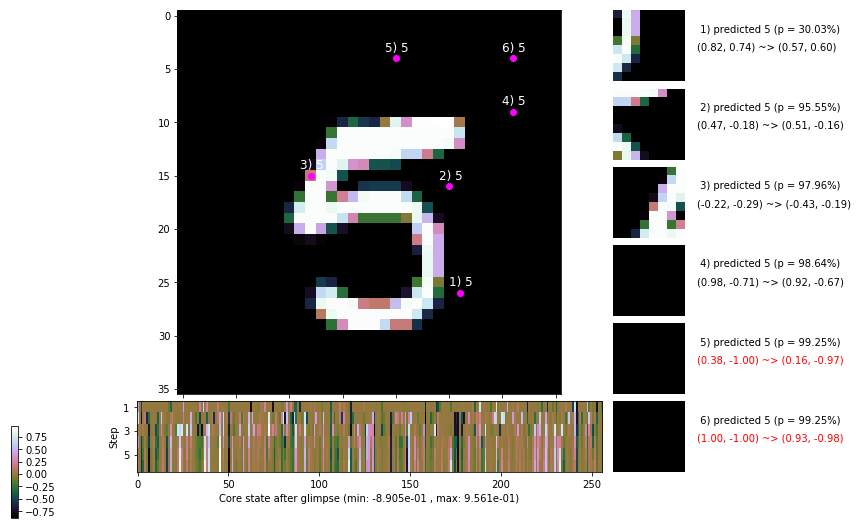

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 147.7 ms/b | lr: 4.02e-04 | grad 2norm: 11.02 | grad inf norm:  3.144
         Weights || abs max:  3.89 ( 3665.44) | mean: -1.06e-03 ( 0.02) | var: 8.17e-02 (  307.34)
          Biases || abs max:  1.30 (  301.86) | mean: -1.39e-01 ( 0.19) | var: 9.44e-02 ( 3452.17)
                    class loss: 0.450 | steps: 2.333 | reward:  4.158 | acc.: 84.55%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.5 ms/b | lr: 4.02e-04 | grad 2norm: 10.76 | grad inf norm:  3.035
         Weights || abs max:  3.90 ( 2120.81) | mean: -1.06e-03 ( 0.01) | var: 8.17e-02 (   66.73)
          Biases || abs max:  1.31 (  256.82) | mean: -1.39e-01 ( 0.17) | var: 9.45e-02 (  861.82)
                    class loss: 0.478 | steps: 2.351 | reward:  4.105 | acc.: 83.98%

	Target class: 6 | Discounted rewards: [0.044, 0.287, 0.7

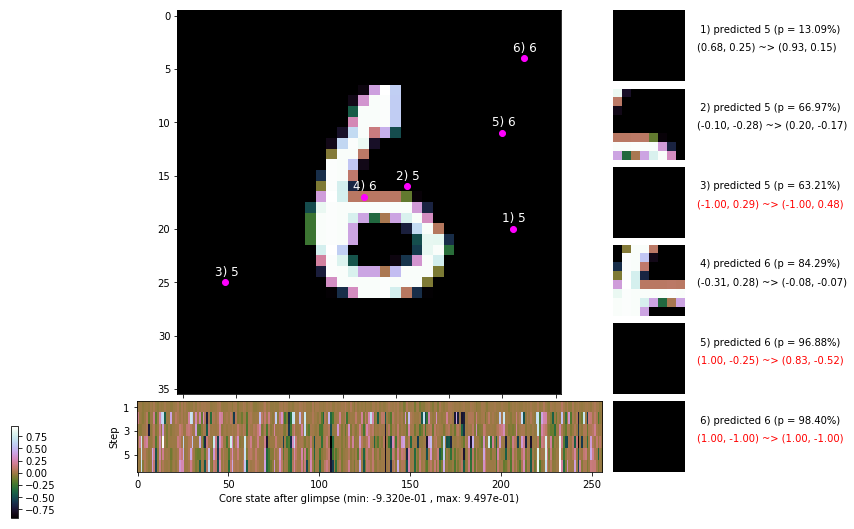

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 144.3 ms/b | lr: 4.01e-04 | grad 2norm: 10.99 | grad inf norm:  3.270
         Weights || abs max:  3.91 ( 6704.96) | mean: -1.06e-03 ( 0.02) | var: 8.17e-02 ( 5158.04)
          Biases || abs max:  1.31 (  325.90) | mean: -1.39e-01 ( 0.19) | var: 9.44e-02 ( 5879.53)
                    class loss: 0.474 | steps: 2.363 | reward:  4.091 | acc.: 83.68%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.1 ms/b | lr: 4.01e-04 | grad 2norm: 10.86 | grad inf norm:  3.319
         Weights || abs max:  3.91 ( 2878.56) | mean: -1.06e-03 ( 0.01) | var: 8.18e-02 (  492.45)
          Biases || abs max:  1.31 (   83.01) | mean: -1.39e-01 ( 0.10) | var: 9.44e-02 (   16.89)
                    class loss: 0.459 | steps: 2.362 | reward:  4.104 | acc.: 84.18%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

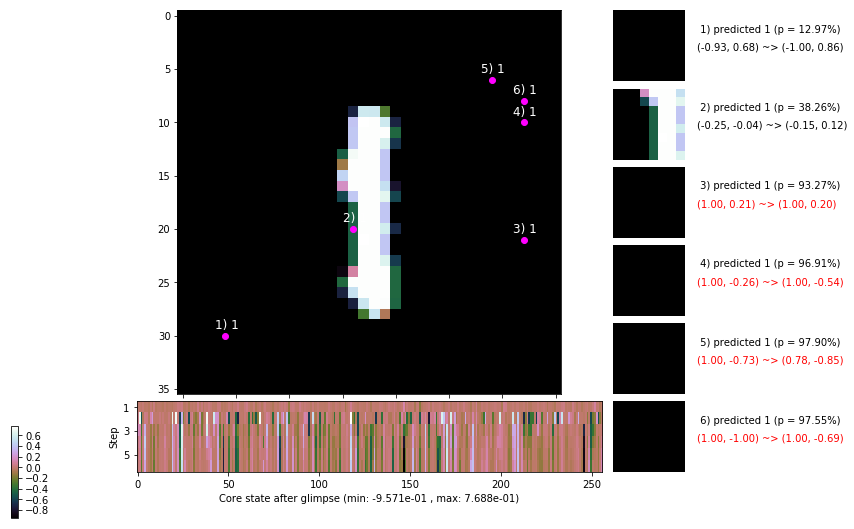

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.078, 0.356, 0.913, -0.175, -0.150, -0.100]


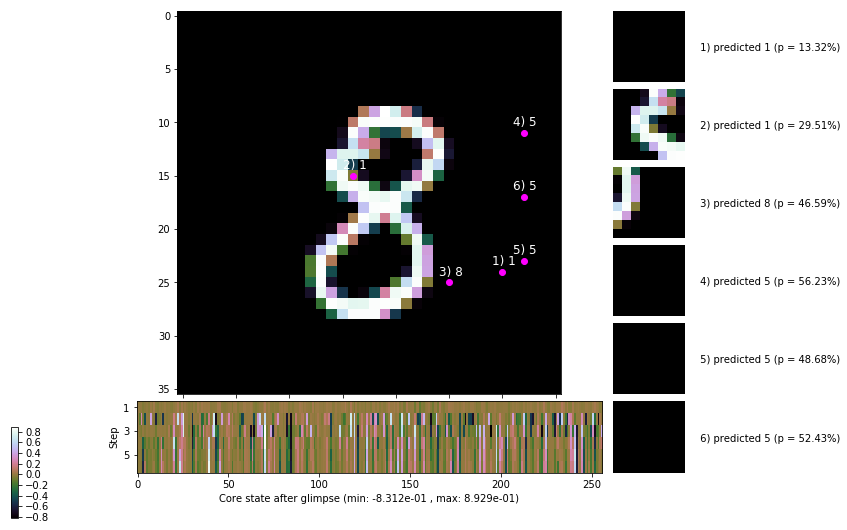


	Target class: 6 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


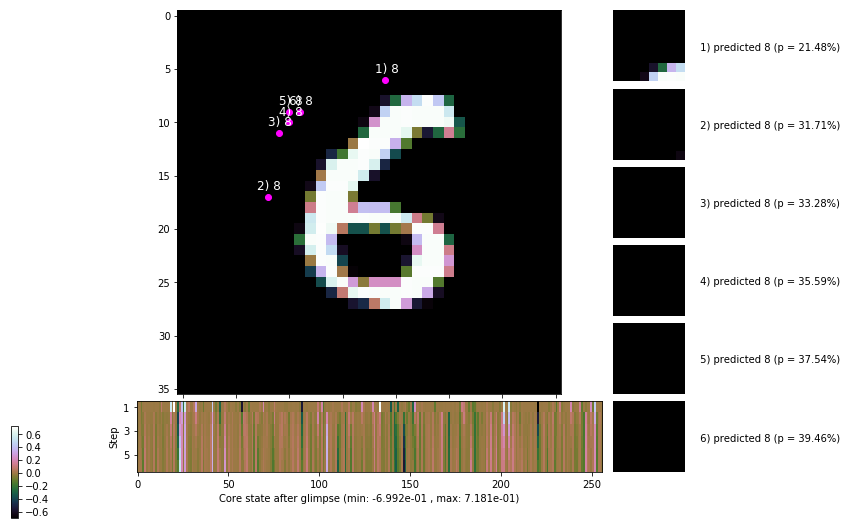

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


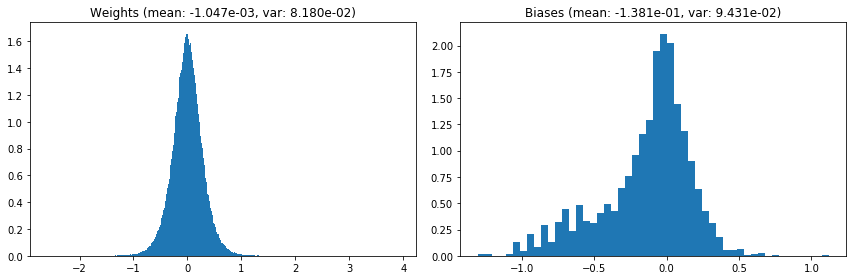

                                      Location network weights and biases


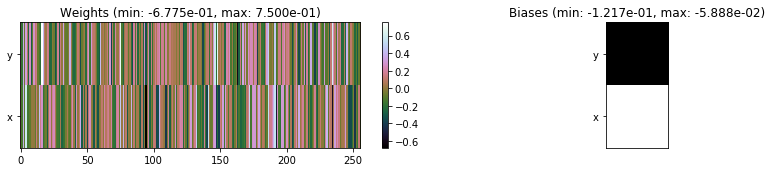

---------------------------------------------------------------------------------------------------------------
Elapsed time:  429.62 sec | TRAIN >> class loss: 0.4694 | steps:  2.357 :( | reward:  4.1077 :( | acc.: 84.120% :(
                          | VAL   >> class loss: 0.4699 | steps:  2.278 :( | reward:  4.2180 :( | acc.: 84.020% :(



			---~~~=== End of training ===~~~---

Evaluating on the TEST dataset...

	Target class: 8 | Discounted rewards: [-0.197, -0.194, -0.188, -0.175, -0.150, -0.100]


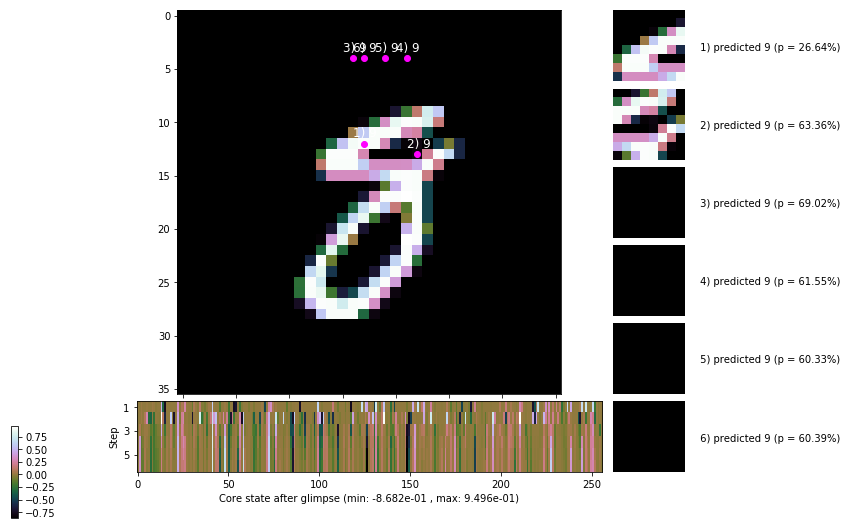


	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


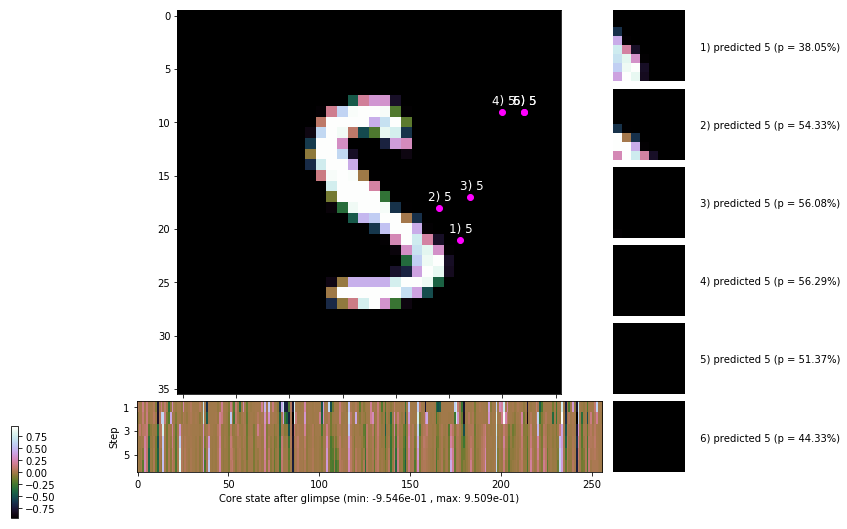

	>> class loss: 0.4713 | steps:  2.230 | reward:  4.2545 | acc.: 84.140%


In [7]:
model_info, train_info, val_info, test_info, epochs = train_eval_loop(
    model = model, epochs = num_epochs, image_size = image_size,
    train_data = train_data, val_data = val_data, test_data = test_data,
    padding = padding, optimizer = optimizer, lr_scheduler = lr_scheduler,
    class_criterion = class_criterion, error_penalty = error_penalty,
    loc_std = loc_std, random_start_loc = random_start_loc, gamma = gamma,
    grad_clip = grad_clip, steps_per_epoch = steps_per_epoch,
    max_ep_len = max_ep_len, log_freq = log_freq, viz_freq = viz_freq,
    early_stopping = early_stopping, eval_viz_freq = eval_viz_freq,
    reward_all_correct = True
)

In [8]:
print('Trained over %d epochs\n' % epochs)

for name, best_stats in zip(['train', 'val'], [train_info['bests'], val_info['bests']]):
    print('Best %s stats:' % name)
    for k, v in best_stats.items():
        print('    %s: %.2f (epoch %d)' % (k, v[k], v['epoch']))
    print('')

Trained over 61 epochs

Best train stats:
    steps: 2.35 (epoch 53)
    reward: 4.12 (epoch 53)
    accuracy: 0.85 (epoch 17)

Best val stats:
    steps: 2.27 (epoch 53)
    reward: 4.23 (epoch 52)
    accuracy: 0.86 (epoch 17)



### Training curves

In [9]:
epoch_range = range(1, epochs+1)
train_col = (1, 0, 0); train_err_col = (1, 0.1, 0.1)
val_col = (0, 0, 1); val_err_col = (0.1, 0.1, 1)

Text(0.5,1,'Weight and bias values over training time')

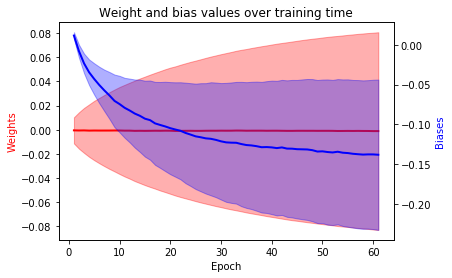

In [10]:
wts_mean = np.array(model_info['weights']['mean'])
wts_var = np.array(model_info['weights']['var'])
bias_mean = np.array(model_info['biases']['mean'])
bias_var = np.array(model_info['biases']['var'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_mean, color = train_col, linewidth = 2)
wts_ax.fill_between(epoch_range,
    wts_mean - wts_var, wts_mean + wts_var,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_mean, color = val_col, linewidth = 2)
bias_ax.fill_between(epoch_range,
    bias_mean - bias_var, bias_mean + bias_var,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Weight and bias values over training time')

Text(0.5,1,'Max absolute weight and bias values over training time')

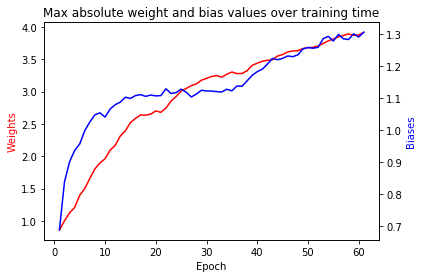

In [11]:
wts_absmax = np.array(model_info['weights']['abs max'])
bias_absmax = np.array(model_info['biases']['abs max'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_absmax, color = train_col)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_absmax, color = val_col)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Max absolute weight and bias values over training time')

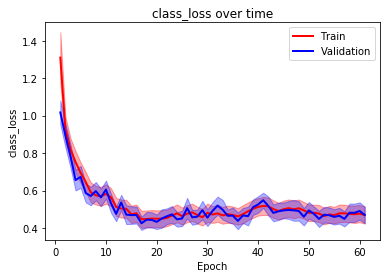

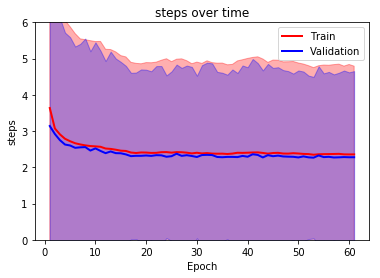

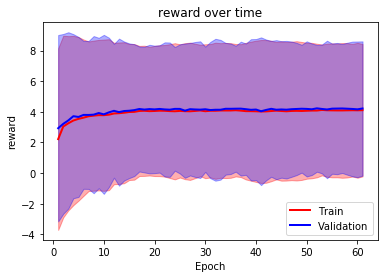

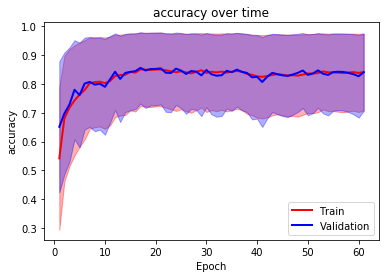

In [12]:
things_to_plot = ['class_loss', 'steps', 'reward', 'accuracy']
for thing in things_to_plot:
    train_avg = np.array([info['averages'][thing] for info in train_info['stats']])
    train_err = np.array([np.var(info['histories'][thing]) for info in train_info['stats']])
    
    val_avg = np.array([info['averages'][thing] for info in val_info['stats']])
    val_err = np.array([np.var(info['histories'][thing]) for info in val_info['stats']])
    
    plt.plot(epoch_range, train_avg, color = train_col, linewidth = 2)
    plt.plot(epoch_range, val_avg, color = val_col, linewidth = 2)
    plt.fill_between(epoch_range,
        train_avg - train_err, train_avg + train_err, alpha = 0.35,
        edgecolor = train_col, facecolor = train_err_col
    )
    plt.fill_between(epoch_range,
        val_avg - val_err, val_avg + val_err, alpha = 0.35,
        edgecolor = val_col, facecolor = val_err_col
    )
    if thing == 'steps':
        plt.ylim([0, 6])
    plt.legend(['Train', 'Validation'], loc = 'upper right' if thing in ['class_loss', 'steps'] else 'lower right')
    plt.xlabel('Epoch'); plt.ylabel(thing)
    plt.title('%s over time' % thing)
    plt.show()
    print('')

Text(0.5,1,'Gradient norms over training time')

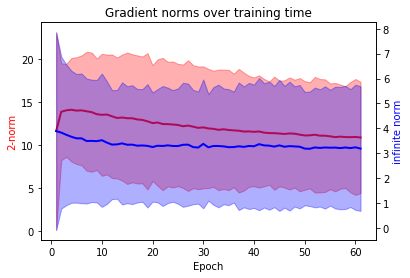

In [13]:
# Gradient stats
grad_2norm = np.array([info['averages']['grad_2norm'] for info in train_info['stats']])
grad_inf_norm = np.array([info['averages']['grad_inf_norm'] for info in train_info['stats']])
grad_2norm_err = np.array([np.var(info['histories']['grad_2norm']) for info in train_info['stats']])
grad_inf_norm_err = np.array([np.var(info['histories']['grad_inf_norm']) for info in train_info['stats']])

fig, pnorm_ax = plt.subplots()
pnorm_ax.plot(epoch_range, grad_2norm, color = train_col, linewidth = 2)
pnorm_ax.fill_between(epoch_range,
    grad_2norm - grad_2norm_err, grad_2norm + grad_2norm_err,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
pnorm_ax.set_xlabel('Epoch');
pnorm_ax.set_ylabel('2-norm', color = train_col)

infnorm_ax = pnorm_ax.twinx()
infnorm_ax.plot(epoch_range, grad_inf_norm, color = val_col, linewidth = 2)
infnorm_ax.fill_between(epoch_range,
    grad_inf_norm - grad_inf_norm_err, grad_inf_norm + grad_inf_norm_err,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
infnorm_ax.set_ylabel('infinite norm', color = val_col)

plt.title('Gradient norms over training time')